<a href="https://colab.research.google.com/github/mjhoover1/Robust_MAML/blob/main/Optimized_Watermark_Attack.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Download test.csv from Neel Google colab drive in Mini-ImageNetSplits

In [1]:
from google.colab import drive
drive.mount('/content/drive/')

Mounted at /content/drive/


In [2]:
%mkdir miniimagenet/

In [3]:
%mkdir images/

In [4]:
%mv images/ miniimagenet/

In [5]:
!unzip drive/MyDrive/temp/mini-imagenet.zip -d miniimagenet/ # using -d to unzip to a different directory

Streaming output truncated to the last 5000 lines.
  inflating: miniimagenet/images/n0679411000000879.jpg  
  inflating: miniimagenet/images/n0679411000000880.jpg  
  inflating: miniimagenet/images/n0679411000000881.jpg  
  inflating: miniimagenet/images/n0679411000000882.jpg  
  inflating: miniimagenet/images/n0679411000000885.jpg  
  inflating: miniimagenet/images/n0679411000000894.jpg  
  inflating: miniimagenet/images/n0679411000000895.jpg  
  inflating: miniimagenet/images/n0679411000000897.jpg  
  inflating: miniimagenet/images/n0679411000000898.jpg  
  inflating: miniimagenet/images/n0679411000000899.jpg  
  inflating: miniimagenet/images/n0679411000000900.jpg  
  inflating: miniimagenet/images/n0679411000000901.jpg  
  inflating: miniimagenet/images/n0679411000000902.jpg  
  inflating: miniimagenet/images/n0679411000000904.jpg  
  inflating: miniimagenet/images/n0679411000000905.jpg  
  inflating: miniimagenet/images/n0679411000000909.jpg  
  inflating: miniimagenet/images/n067

In [6]:
# !unzip images/mini-imagenet.zip

In [7]:
# %mkdir miniimagenet

In [8]:
%cp drive/MyDrive/miniimagenet/test.csv miniimagenet/

In [9]:
# %mv images/ miniimagenet/

In [10]:
%%writefile MiniImagenet.py

import os
import torch
from torch.utils.data import Dataset
from torchvision.transforms import transforms
import numpy as np
import collections
from PIL import Image
import csv
import random


class MiniImagenet(Dataset):
    """
    put mini-imagenet files as :
    root :
        |- images/*.jpg includes all imgeas
        |- train.csv
        |- test.csv
        |- val.csv
    NOTICE: meta-learning is different from general supervised learning, especially the concept of batch and set.
    batch: contains several sets
    sets: conains n_way * k_shot for meta-train set, n_way * n_query for meta-test set.
    """

    def __init__(self, root, mode, batchsz, n_way, k_shot, k_query, resize, startidx=0):
        """
        :param root: root path of mini-imagenet
        :param mode: train, val or test
        :param batchsz: batch size of sets, not batch of imgs
        :param n_way:
        :param k_shot:
        :param k_query: num of qeruy imgs per class
        :param resize: resize to
        :param startidx: start to index label from startidx
        """

        self.batchsz = batchsz  # batch of set, not batch of imgs
        self.n_way = n_way  # n-way
        self.k_shot = k_shot  # k-shot
        self.k_query = k_query  # for evaluation
        self.setsz = self.n_way * self.k_shot  # num of samples per set
        self.querysz = self.n_way * self.k_query  # number of samples per set for evaluation
        self.resize = resize  # resize to
        self.startidx = startidx  # index label not from 0, but from startidx
        print('shuffle DB :%s, b:%d, %d-way, %d-shot, %d-query, resize:%d' % (
        mode, batchsz, n_way, k_shot, k_query, resize))

        if mode == 'train':
            self.transform = transforms.Compose([lambda x: Image.open(x).convert('RGB'),
                                                 transforms.Resize((self.resize, self.resize)),
                                                 # transforms.RandomHorizontalFlip(),
                                                 # transforms.RandomRotation(5),
                                                 transforms.ToTensor(),
                                                 transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
                                                 ])
        else:
            self.transform = transforms.Compose([lambda x: Image.open(x).convert('RGB'),
                                                 transforms.Resize((self.resize, self.resize)),
                                                 transforms.ToTensor(),
                                                 transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))
                                                 ])

        self.path = os.path.join(root, 'images')  # image path
        csvdata = self.loadCSV(os.path.join(root, mode + '.csv'))  # csv path
        self.data = []
        self.img2label = {}
        for i, (k, v) in enumerate(csvdata.items()):
            self.data.append(v)  # [[img1, img2, ...], [img111, ...]]
            self.img2label[k] = i + self.startidx  # {"img_name[:9]":label}
        self.cls_num = len(self.data)

        self.create_batch(self.batchsz)

    def loadCSV(self, csvf):
        """
        return a dict saving the information of csv
        :param splitFile: csv file name
        :return: {label:[file1, file2 ...]}
        """
        dictLabels = {}
        with open(csvf) as csvfile:
            csvreader = csv.reader(csvfile, delimiter=',')
            next(csvreader, None)  # skip (filename, label)
            for i, row in enumerate(csvreader):
                filename = row[0]
                label = row[1]
                # append filename to current label
                if label in dictLabels.keys():
                    dictLabels[label].append(filename)
                else:
                    dictLabels[label] = [filename]
        return dictLabels

    def create_batch(self, batchsz):
        """
        create batch for meta-learning.
        ×episode× here means batch, and it means how many sets we want to retain.
        :param episodes: batch size
        :return:
        """
        self.support_x_batch = []  # support set batch
        self.query_x_batch = []  # query set batch
        for b in range(batchsz):  # for each batch
            # 1.select n_way classes randomly
            selected_cls = np.random.choice(self.cls_num, self.n_way, False)  # no duplicate
            np.random.shuffle(selected_cls)
            support_x = []
            query_x = []
            for cls in selected_cls:
                # 2. select k_shot + k_query for each class

                selected_imgs_idx = np.random.choice(len(self.data[cls]), self.k_shot + self.k_query, False)
                np.random.shuffle(selected_imgs_idx)
                indexDtrain = np.array(selected_imgs_idx[:self.k_shot])  # idx for Dtrain
                indexDtest = np.array(selected_imgs_idx[self.k_shot:])  # idx for Dtest
                support_x.append(
                    np.array(self.data[cls])[indexDtrain].tolist())  # get all images filename for current Dtrain
                query_x.append(np.array(self.data[cls])[indexDtest].tolist())

            # shuffle the correponding relation between support set and query set
            random.shuffle(support_x)
            random.shuffle(query_x)

            self.support_x_batch.append(support_x)  # append set to current sets
            self.query_x_batch.append(query_x)  # append sets to current sets

    def __getitem__(self, index):
        """
        index means index of sets, 0<= index <= batchsz-1
        :param index:
        :return:
        """
        # [setsz, 3, resize, resize]
        support_x = torch.FloatTensor(self.setsz, 3, self.resize, self.resize)
        # [setsz]
        support_y = np.zeros((self.setsz), dtype=np.int)
        # [querysz, 3, resize, resize]
        query_x = torch.FloatTensor(self.querysz, 3, self.resize, self.resize)
        # [querysz]
        query_y = np.zeros((self.querysz), dtype=np.int)

        flatten_support_x = [os.path.join(self.path, item) for sublist in self.support_x_batch[index] for item in sublist]
        # filename:n0153282900000005.jpg, the first 9 characters treated as label

        support_y = np.array([self.img2label[item[:9]] for sublist in self.support_x_batch[index] for item in sublist]).astype(np.int32)

        flatten_query_x = [os.path.join(self.path, item) for sublist in self.query_x_batch[index] for item in sublist]
        query_y = np.array([self.img2label[item[:9]] for sublist in self.query_x_batch[index] for item in sublist]).astype(np.int32)

        # print('global:', support_y, query_y)
        # support_y: [setsz]
        # query_y: [querysz]
        # unique: [n-way], sorted
        unique = np.unique(support_y)
        random.shuffle(unique)
        # relative means the label ranges from 0 to n-way
        support_y_relative = np.zeros(self.setsz)
        query_y_relative = np.zeros(self.querysz)
        for idx, l in enumerate(unique):
            support_y_relative[support_y == l] = idx
            query_y_relative[query_y == l] = idx

        # print('relative:', support_y_relative, query_y_relative)

        for i, path in enumerate(flatten_support_x):
            support_x[i] = self.transform(path)

        for i, path in enumerate(flatten_query_x):
            query_x[i] = self.transform(path)
        # print(support_set_y)
        # return support_x, torch.LongTensor(support_y), query_x, torch.LongTensor(query_y)

        return support_x, torch.LongTensor(support_y_relative), query_x, torch.LongTensor(query_y_relative)

    def __len__(self):
        # as we have built up to batchsz of sets, you can sample some small batch size of sets.
        return self.batchsz


if __name__ == '__main__':
    # the following episode is to view one set of images via tensorboard.
    from torchvision.utils import make_grid
    from matplotlib import pyplot as plt
    from tensorboardX import SummaryWriter
    import time

    plt.ion()

    tb = SummaryWriter('runs', 'mini-imagenet')
    mini = MiniImagenet('../mini-imagenet/', mode='train', n_way=5, k_shot=1, k_query=1, batchsz=1000, resize=168)

    for i, set_ in enumerate(mini):
        # support_x: [k_shot*n_way, 3, 84, 84]
        support_x, support_y, query_x, query_y = set_

        support_x = make_grid(support_x, nrow=2)
        query_x = make_grid(query_x, nrow=2)

        plt.figure(1)
        plt.imshow(support_x.transpose(2, 0).numpy())
        plt.pause(0.5)
        plt.figure(2)
        plt.imshow(query_x.transpose(2, 0).numpy())
        plt.pause(0.5)

        tb.add_image('support_x', support_x)
        tb.add_image('query_x', query_x)

        time.sleep(5)

    tb.close()

Writing MiniImagenet.py


In [11]:
import torch
from    torch import nn
from    torch.nn import functional as F
import  numpy as np
from MiniImagenet import MiniImagenet
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
%matplotlib inline
from torchvision.utils import make_grid

## Create the config and get the model

### Learner

In [12]:
class Learner(nn.Module):
    """

    """

    def __init__(self, config, imgc, imgsz):
        """

        :param config: network config file, type:list of (string, list)
        :param imgc: 1 or 3
        :param imgsz:  28 or 84
        """
        super(Learner, self).__init__()


        self.config = config

        # this dict contains all tensors needed to be optimized
        self.vars = nn.ParameterList()
        # running_mean and running_var
        self.vars_bn = nn.ParameterList()

        for i, (name, param) in enumerate(self.config):
            if name is 'conv2d':
                # [ch_out, ch_in, kernelsz, kernelsz]
                w = nn.Parameter(torch.ones(*param[:4]))
                # gain=1 according to cbfin's implementation
                torch.nn.init.kaiming_normal_(w)
                self.vars.append(w)
                # [ch_out]
                self.vars.append(nn.Parameter(torch.zeros(param[0])))

            elif name is 'convt2d':
                # [ch_in, ch_out, kernelsz, kernelsz, stride, padding]
                w = nn.Parameter(torch.ones(*param[:4]))
                # gain=1 according to cbfin's implementation
                torch.nn.init.kaiming_normal_(w)
                self.vars.append(w)
                # [ch_in, ch_out]
                self.vars.append(nn.Parameter(torch.zeros(param[1])))

            elif name is 'linear':
                # [ch_out, ch_in]
                w = nn.Parameter(torch.ones(*param))
                # gain=1 according to cbfinn's implementation
                torch.nn.init.kaiming_normal_(w)
                self.vars.append(w)
                # [ch_out]
                self.vars.append(nn.Parameter(torch.zeros(param[0])))

            elif name is 'bn':
                # [ch_out]
                w = nn.Parameter(torch.ones(param[0]))
                self.vars.append(w)
                # [ch_out]
                self.vars.append(nn.Parameter(torch.zeros(param[0])))

                # must set requires_grad=False
                running_mean = nn.Parameter(torch.zeros(param[0]), requires_grad=False)
                running_var = nn.Parameter(torch.ones(param[0]), requires_grad=False)
                self.vars_bn.extend([running_mean, running_var])


            elif name in ['tanh', 'relu', 'upsample', 'avg_pool2d', 'max_pool2d',
                          'flatten', 'reshape', 'leakyrelu', 'sigmoid']:
                continue
            else:
                raise NotImplementedError






    def extra_repr(self):
        info = ''

        for name, param in self.config:
            if name is 'conv2d':
                tmp = 'conv2d:(ch_in:%d, ch_out:%d, k:%dx%d, stride:%d, padding:%d)'\
                      %(param[1], param[0], param[2], param[3], param[4], param[5],)
                info += tmp + '\n'

            elif name is 'convt2d':
                tmp = 'convTranspose2d:(ch_in:%d, ch_out:%d, k:%dx%d, stride:%d, padding:%d)'\
                      %(param[0], param[1], param[2], param[3], param[4], param[5],)
                info += tmp + '\n'

            elif name is 'linear':
                tmp = 'linear:(in:%d, out:%d)'%(param[1], param[0])
                info += tmp + '\n'

            elif name is 'leakyrelu':
                tmp = 'leakyrelu:(slope:%f)'%(param[0])
                info += tmp + '\n'


            elif name is 'avg_pool2d':
                tmp = 'avg_pool2d:(k:%d, stride:%d, padding:%d)'%(param[0], param[1], param[2])
                info += tmp + '\n'
            elif name is 'max_pool2d':
                tmp = 'max_pool2d:(k:%d, stride:%d, padding:%d)'%(param[0], param[1], param[2])
                info += tmp + '\n'
            elif name in ['flatten', 'tanh', 'relu', 'upsample', 'reshape', 'sigmoid', 'use_logits', 'bn']:
                tmp = name + ':' + str(tuple(param))
                info += tmp + '\n'
            else:
                raise NotImplementedError

        return info



    def forward(self, x, vars=None, bn_training=True):
        """
        This function can be called by finetunning, however, in finetunning, we dont wish to update
        running_mean/running_var. Thought weights/bias of bn is updated, it has been separated by fast_weights.
        Indeed, to not update running_mean/running_var, we need set update_bn_statistics=False
        but weight/bias will be updated and not dirty initial theta parameters via fast_weiths.
        :param x: [b, 1, 28, 28]
        :param vars:
        :param bn_training: set False to not update
        :return: x, loss, likelihood, kld
        """

        if vars is None:
            vars = self.vars

        idx = 0
        bn_idx = 0

        for name, param in self.config:
            if name is 'conv2d':
                w, b = vars[idx], vars[idx + 1]
                # remember to keep synchrozied of forward_encoder and forward_decoder!
                x = F.conv2d(x, w, b, stride=param[4], padding=param[5])
                idx += 2
                # print(name, param, '\tout:', x.shape)
            elif name is 'convt2d':
                w, b = vars[idx], vars[idx + 1]
                # remember to keep synchrozied of forward_encoder and forward_decoder!
                x = F.conv_transpose2d(x, w, b, stride=param[4], padding=param[5])
                idx += 2
                # print(name, param, '\tout:', x.shape)
            elif name is 'linear':
                w, b = vars[idx], vars[idx + 1]
                x = F.linear(x, w, b)
                idx += 2
                # print('forward:', idx, x.norm().item())
            elif name is 'bn':
                w, b = vars[idx], vars[idx + 1]
                running_mean, running_var = self.vars_bn[bn_idx], self.vars_bn[bn_idx+1]
                x = F.batch_norm(x, running_mean, running_var, weight=w, bias=b, training=bn_training)
                idx += 2
                bn_idx += 2

            elif name is 'flatten':
                # print(x.shape)
                x = x.view(x.size(0), -1)
            elif name is 'reshape':
                # [b, 8] => [b, 2, 2, 2]
                x = x.view(x.size(0), *param)
            elif name is 'relu':
                x = F.relu(x, inplace=param[0])
            elif name is 'leakyrelu':
                x = F.leaky_relu(x, negative_slope=param[0], inplace=param[1])
            elif name is 'tanh':
                x = F.tanh(x)
            elif name is 'sigmoid':
                x = torch.sigmoid(x)
            elif name is 'upsample':
                x = F.upsample_nearest(x, scale_factor=param[0])
            elif name is 'max_pool2d':
                x = F.max_pool2d(x, param[0], param[1], param[2])
            elif name is 'avg_pool2d':
                x = F.avg_pool2d(x, param[0], param[1], param[2])

            else:
                raise NotImplementedError

        # make sure variable is used properly
        assert idx == len(vars)
        assert bn_idx == len(self.vars_bn)


        return x


    def zero_grad(self, vars=None):
        """

        :param vars:
        :return:
        """
        with torch.no_grad():
            if vars is None:
                for p in self.vars:
                    if p.grad is not None:
                        p.grad.zero_()
            else:
                for p in vars:
                    if p.grad is not None:
                        p.grad.zero_()

    def parameters(self):
        """
        override this function since initial parameters will return with a generator.
        :return:
        """
        return self.vars

In [13]:
n_way = 5
miniImgNet_config = [
        ('conv2d', [32, 3, 3, 3, 1, 0]),
        ('relu', [True]),
        ('bn', [32]),
        ('max_pool2d', [2, 2, 0]),
        ('conv2d', [32, 32, 3, 3, 1, 0]),
        ('relu', [True]),
        ('bn', [32]),
        ('max_pool2d', [2, 2, 0]),
        ('conv2d', [32, 32, 3, 3, 1, 0]),
        ('relu', [True]),
        ('bn', [32]),
        ('max_pool2d', [2, 2, 0]),
        ('conv2d', [32, 32, 3, 3, 1, 0]),
        ('relu', [True]),
        ('bn', [32]),
        ('max_pool2d', [2, 1, 0]),
        ('flatten', []),
        ('linear', [n_way, 32 * 5 * 5])
    ]

In [14]:
import  torch
from    torch import nn
from    torch import optim
from    torch.nn import functional as F
from    torch.utils.data import TensorDataset, DataLoader
from    torch import optim
import  numpy as np

# from    learner import Learner
from    copy import deepcopy



class Meta(nn.Module):
    """
    Meta Learner
    """
    def __init__(self,config):
        """

        :param args:
        """
        super(Meta, self).__init__()

        self.update_lr = 0.01 #args.update_lr
        self.meta_lr = 0.001 #args.meta_lr
        self.n_way = 5 #args.n_way
        self.k_spt = 5 #args.k_spt
        self.k_qry = 5 #args.k_qry
        self.task_num = 4 #args.task_num
        self.update_step = 5 #args.update_step
        self.update_step_test = 10 #args.update_step_test


        self.net = Learner(config, 3, 84)
        self.meta_optim = optim.Adam(self.net.parameters(), lr=self.meta_lr)




    def clip_grad_by_norm_(self, grad, max_norm):
        """
        in-place gradient clipping.
        :param grad: list of gradients
        :param max_norm: maximum norm allowable
        :return:
        """

        total_norm = 0
        counter = 0
        for g in grad:
            param_norm = g.data.norm(2)
            total_norm += param_norm.item() ** 2
            counter += 1
        total_norm = total_norm ** (1. / 2)

        clip_coef = max_norm / (total_norm + 1e-6)
        if clip_coef < 1:
            for g in grad:
                g.data.mul_(clip_coef)

        return total_norm/counter


    def forward(self, x_spt, y_spt, x_qry, y_qry):
        """

        :param x_spt:   [b, setsz, c_, h, w]
        :param y_spt:   [b, setsz]
        :param x_qry:   [b, querysz, c_, h, w]
        :param y_qry:   [b, querysz]
        :return:
        """
        task_num, setsz, c_, h, w = x_spt.size()
        querysz = x_qry.size(1)

        losses_q = [0 for _ in range(self.update_step + 1)]  # losses_q[i] is the loss on step i
        corrects = [0 for _ in range(self.update_step + 1)]


        for i in range(task_num):

            # 1. run the i-th task and compute loss for k=0
            logits = self.net(x_spt[i], vars=None, bn_training=True)
            loss = F.cross_entropy(logits, y_spt[i])
            grad = torch.autograd.grad(loss, self.net.parameters())
            fast_weights = list(map(lambda p: p[1] - self.update_lr * p[0], zip(grad, self.net.parameters())))

            # this is the loss and accuracy before first update
            with torch.no_grad():
                # [setsz, nway]
                logits_q = self.net(x_qry[i], self.net.parameters(), bn_training=True)
                loss_q = F.cross_entropy(logits_q, y_qry[i])
                losses_q[0] += loss_q

                pred_q = F.softmax(logits_q, dim=1).argmax(dim=1)
                correct = torch.eq(pred_q, y_qry[i]).sum().item()
                corrects[0] = corrects[0] + correct

            # this is the loss and accuracy after the first update
            with torch.no_grad():
                # [setsz, nway]
                logits_q = self.net(x_qry[i], fast_weights, bn_training=True)
                loss_q = F.cross_entropy(logits_q, y_qry[i])
                losses_q[1] += loss_q
                # [setsz]
                pred_q = F.softmax(logits_q, dim=1).argmax(dim=1)
                correct = torch.eq(pred_q, y_qry[i]).sum().item()
                corrects[1] = corrects[1] + correct

            for k in range(1, self.update_step):
                # 1. run the i-th task and compute loss for k=1~K-1
                logits = self.net(x_spt[i], fast_weights, bn_training=True)
                loss = F.cross_entropy(logits, y_spt[i])
                # 2. compute grad on theta_pi
                grad = torch.autograd.grad(loss, fast_weights)
                # 3. theta_pi = theta_pi - train_lr * grad
                fast_weights = list(map(lambda p: p[1] - self.update_lr * p[0], zip(grad, fast_weights)))

                logits_q = self.net(x_qry[i], fast_weights, bn_training=True)
                # loss_q will be overwritten and just keep the loss_q on last update step.
                loss_q = F.cross_entropy(logits_q, y_qry[i])
                losses_q[k + 1] += loss_q

                with torch.no_grad():
                    pred_q = F.softmax(logits_q, dim=1).argmax(dim=1)
                    correct = torch.eq(pred_q, y_qry[i]).sum().item()  # convert to numpy
                    corrects[k + 1] = corrects[k + 1] + correct



        # end of all tasks
        # sum over all losses on query set across all tasks
        loss_q = losses_q[-1] / task_num

        # optimize theta parameters
        self.meta_optim.zero_grad()
        loss_q.backward()
        # print('meta update')
        # for p in self.net.parameters()[:5]:
        # 	print(torch.norm(p).item())
        self.meta_optim.step()


        accs = np.array(corrects) / (querysz * task_num)

        return accs


    def finetunning(self, x_spt, y_spt, x_qry, y_qry):
        """

        :param x_spt:   [setsz, c_, h, w]
        :param y_spt:   [setsz]
        :param x_qry:   [querysz, c_, h, w]
        :param y_qry:   [querysz]
        :return:
        """
        assert len(x_spt.shape) == 4

        querysz = x_qry.size(0)

        corrects = [0 for _ in range(self.update_step_test + 1)]

        # in order to not ruin the state of running_mean/variance and bn_weight/bias
        # we finetunning on the copied model instead of self.net
        net = deepcopy(self.net)

        # 1. run the i-th task and compute loss for k=0
        logits = net(x_spt)
        loss = F.cross_entropy(logits, y_spt)
        grad = torch.autograd.grad(loss, net.parameters())
        fast_weights = list(map(lambda p: p[1] - self.update_lr * p[0], zip(grad, net.parameters())))

        # this is the loss and accuracy before first update
        with torch.no_grad():
            # [setsz, nway]
            logits_q = net(x_qry, net.parameters(), bn_training=True)
            # [setsz]
            pred_q = F.softmax(logits_q, dim=1).argmax(dim=1)
            # scalar
            correct = torch.eq(pred_q, y_qry).sum().item()
            corrects[0] = corrects[0] + correct

        # this is the loss and accuracy after the first update
        with torch.no_grad():
            # [setsz, nway]
            logits_q = net(x_qry, fast_weights, bn_training=True)
            # [setsz]
            pred_q = F.softmax(logits_q, dim=1).argmax(dim=1)
            # scalar
            correct = torch.eq(pred_q, y_qry).sum().item()
            corrects[1] = corrects[1] + correct

        for k in range(1, self.update_step_test):
            # 1. run the i-th task and compute loss for k=1~K-1
            logits = net(x_spt, fast_weights, bn_training=True)
            loss = F.cross_entropy(logits, y_spt)
            # 2. compute grad on theta_pi
            grad = torch.autograd.grad(loss, fast_weights)
            # 3. theta_pi = theta_pi - train_lr * grad
            fast_weights = list(map(lambda p: p[1] - self.update_lr * p[0], zip(grad, fast_weights)))

            logits_q = net(x_qry, fast_weights, bn_training=True)
            # loss_q will be overwritten and just keep the loss_q on last update step.
            loss_q = F.cross_entropy(logits_q, y_qry)

            with torch.no_grad():
                pred_q = F.softmax(logits_q, dim=1).argmax(dim=1)
                correct = torch.eq(pred_q, y_qry).sum().item()  # convert to numpy
                corrects[k + 1] = corrects[k + 1] + correct


        del net

        accs = np.array(corrects) / querysz

        return accs

    def finetuning_ww(self, x_spt, y_spt, x_qry, y_qry): # finetuning with weights
        """

        :param x_spt:   [setsz, c_, h, w]
        :param y_spt:   [setsz]
        :param x_qry:   [querysz, c_, h, w]
        :param y_qry:   [querysz]
        :return:
        """
        assert len(x_spt.shape) == 4

        querysz = x_qry.size(0)

        corrects = [0 for _ in range(self.update_step_test + 1)]

        # in order to not ruin the state of running_mean/variance and bn_weight/bias
        # we finetuning on the copied model instead of self.net
        net = deepcopy(self.net)

        # 1. run the i-th task and compute loss for k=0
        logits = net(x_spt)
        loss = F.cross_entropy(logits, y_spt)
        grad = torch.autograd.grad(loss, net.parameters())
        fast_weights = list(map(lambda p: p[1] - self.update_lr * p[0], zip(grad, net.parameters())))

        # this is the loss and accuracy before first update
        with torch.no_grad():
            # [setsz, nway]
            logits_q = net(x_qry, net.parameters(), bn_training=True)
            # [setsz]
            pred_q = F.softmax(logits_q, dim=1).argmax(dim=1)
            # scalar
            correct = torch.eq(pred_q, y_qry).sum().item()
            corrects[0] = corrects[0] + correct

        # this is the loss and accuracy after the first update
        with torch.no_grad():
            # [setsz, nway]
            logits_q = net(x_qry, fast_weights, bn_training=True)
            # [setsz]
            pred_q = F.softmax(logits_q, dim=1).argmax(dim=1)
            # scalar
            correct = torch.eq(pred_q, y_qry).sum().item()
            corrects[1] = corrects[1] + correct

        for k in range(1, self.update_step_test):
            # 1. run the i-th task and compute loss for k=1~K-1
            logits = net(x_spt, fast_weights, bn_training=True)
            loss = F.cross_entropy(logits, y_spt)
            # 2. compute grad on theta_pi
            grad = torch.autograd.grad(loss, fast_weights)
            # 3. theta_pi = theta_pi - train_lr * grad
            fast_weights = list(map(lambda p: p[1] - self.update_lr * p[0], zip(grad, fast_weights)))

            logits_q = net(x_qry, fast_weights, bn_training=True)
            # loss_q will be overwritten and just keep the loss_q on last update step.
            loss_q = F.cross_entropy(logits_q, y_qry)

            with torch.no_grad():
                pred_q = F.softmax(logits_q, dim=1).argmax(dim=1)
                correct = torch.eq(pred_q, y_qry).sum().item()  # convert to numpy
                corrects[k + 1] = corrects[k + 1] + correct


#         del net

        accs = np.array(corrects) / querysz

        return accs, pred_q, fast_weights



        # This finetunning also takes the target idx to get the prediction for it so it can be returned.
    def finetunning_more_detail(self, x_spt, y_spt, x_qry, y_qry, target_idx, target_class):
        """

        :param x_spt:   [setsz, c_, h, w]
        :param y_spt:   [setsz]
        :param x_qry:   [querysz, c_, h, w]
        :param y_qry:   [querysz]
        :return:
        """
        assert len(x_spt.shape) == 4 # Throw exception if the support set isn't 
        pred_correct = 0

        querysz = x_qry.size(0) # Returns the number 
        # print("querysz ", querysz)

        corrects = [0 for _ in range(self.update_step_test + 1)] 
        # print("corrects ", corrects)

        # in order to not ruin the state of running_mean/variance and bn_weight/bias
        # we finetunning on the copied model instead of self.net
        net = deepcopy(self.net)

        # 1. run the i-th task and compute loss for k=0
        logits = net(x_spt) # predictions for the support set
        # print("logits ", logits)
        loss = F.cross_entropy(logits, y_spt) # loss for the support predictions and class labels
        grad = torch.autograd.grad(loss, net.parameters()) # The gradient of the loss for the support set
        fast_weights = list(map(lambda p: p[1] - self.update_lr * p[0], zip(grad, net.parameters()))) # Take gradient step from the loss on the support set on copied net.

        # this is the loss and accuracy before first update
        with torch.no_grad():
            # [setsz, nway]
            logits_q = net(x_qry, net.parameters(), bn_training=True)
            # [setsz]
            pred_q = F.softmax(logits_q, dim=1).argmax(dim=1)
            # scalar
            correct = torch.eq(pred_q, y_qry).sum().item()
            corrects[0] = corrects[0] + correct

        # this is the loss and accuracy after the first update
        with torch.no_grad():
            # [setsz, nway]
            logits_q = net(x_qry, fast_weights, bn_training=True)
            # [setsz]
            pred_q = F.softmax(logits_q, dim=1).argmax(dim=1)
            # scalar
            correct = torch.eq(pred_q, y_qry).sum().item()
            corrects[1] = corrects[1] + correct

        for k in range(1, self.update_step_test):
            # 1. run the i-th task and compute loss for k=1~K-1
            logits = net(x_spt, fast_weights, bn_training=True)
            loss = F.cross_entropy(logits, y_spt)
            # 2. compute grad on theta_pi
            grad = torch.autograd.grad(loss, fast_weights)
            # 3. theta_pi = theta_pi - train_lr * grad
            fast_weights = list(map(lambda p: p[1] - self.update_lr * p[0], zip(grad, fast_weights)))

            logits_q = net(x_qry, fast_weights, bn_training=True)
            # loss_q will be overwritten and just keep the loss_q on last update step.
            loss_q = F.cross_entropy(logits_q, y_qry)

            with torch.no_grad():
                pred_q = F.softmax(logits_q, dim=1)
                target_pred_percentage = pred_q[target_idx]
                # print("target_pred_percentage", target_pred_percentage, "target_class", target_class)
                pred_q = pred_q.argmax(dim=1)
                # If it's the last update step and target class is equal to the predicted target
                if k == self.update_step_test - 1 and target_class == int(pred_q[target_idx]):
                  pred_correct = 1
                actual_pred = int(pred_q[target_idx]) # Actual prediction

                correct = torch.eq(pred_q, y_qry).sum().item()  # convert to numpy
                corrects[k + 1] = corrects[k + 1] + correct


        del net

        accs = np.array(corrects) / querysz
        # print("corrects ", corrects[-1])

        return accs, pred_correct, actual_pred, target_pred_percentage




def main():
    pass


if __name__ == '__main__':
    main()


-----

### Here start Poisoning

Download model_test_empty from Github and place in local files.

In [15]:
model = Learner(miniImgNet_config,3,84)
maml = Meta(miniImgNet_config)
# model.load_state_dict(torch.load(f"Leaner_OBJ_MiniImagenet_n_way_5_k_shot_5_acc_0.60546875_dateMMDDYYY_10272021",map_location=torch.device('cpu')))
model.load_state_dict(torch.load(f"/content/drive/MyDrive/miniimagenet/Leaner_OBJ_MiniImagenet_n_way_5_k_shot_5_acc_0.60546875_dateMMDDYYY_10272021",map_location=torch.device('cpu')))
maml.net = model
# model_small.train()

In [16]:
# mini_test = MiniImagenet('miniimagenet/', mode='test', n_way=5, k_shot=5,
#                          k_query=15,
#                          batchsz=100, resize=84)
mini_test = MiniImagenet('/content/miniimagenet/', mode='test', n_way=5, k_shot=5,
                         k_query=15,
                         batchsz=100, resize=84)

shuffle DB :test, b:100, 5-way, 5-shot, 15-query, resize:84


In [17]:
# this function poisons a specific support image using a target query image
def poison_image(support_img, target_img, opacity, show=False):
    """
    Recursively retrieves the autograd graph for a particular tensor.
    # Arguments
        support_img: Image from the support set.
        target_img: Specific img from the query set, the target img to be misclassified.
        opacity: Amount of opacity to for target image, so base opacity is 1-opacity.
        show: If true will show support, target, and poisoned image.
    # Returns
        poisoned_img: A poisoned support img with target watermark
    """ 
    # Testing with 50%
    poisoned_img = opacity*target_img + (1-opacity)*support_img # opacity of target image for overlay on base images
    if show:
      show_img(support_img, 'Support Img')
      show_img(target_img, 'Target Img')
      show_img(poisoned_img, 'Poisoned Img')
    return poisoned_img

In [18]:
# Shows a given image 
def show_img(img, title, fig_dim = [10, 10]):
    """
    Recursively retrieves the autograd graph for a particular tensor.
    # Arguments
        img: Given image to show.
        fig_dim: Dimensions of the figure for examples [10, 10].
        title: The title desired for the shown image.
    # Returns
        Void
    # Side effect
        Shows a given image
    """ 
    plt.figure(figsize=fig_dim)
    plt.axis('off')
    plt.title(title)
    plt.imshow(img.permute(1, 2, 0))
    plt.show()

In [19]:
# Shows a given image group on a grid 
def show_grid(img_group, title, row_size, debug = False, fig_dim = [10, 10]):
    """
    Recursively retrieves the autograd graph for a particular tensor.
    # Arguments
        img: Given image group to show.
        title: The title desired for the shown image.
        fig_dim: Dimensions of the figure for examples [10, 10].
    # Returns
        Void
    # Side effect
        Shows a given image
    """ 
    grid_img = make_grid(img_group.squeeze(), nrow=row_size) # make grid (row_size and as many columns as possible) to display our n images
    if debug:
      print('images.shape:', img_group.shape)
      print('grid shape: ', grid_img.shape)
    show_img(grid_img, title, fig_dim)

In [20]:
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print('Using {} device'.format(device))

Using cuda device


In [21]:
class CNN_pre(nn.Module):

    def __init__(self):
        super(CNN_pre, self).__init__()
        self.layer1 = nn.Sequential(
            nn.Conv2d(3,20,5),
            nn.ReLU(),
            nn.MaxPool2d(kernel_size=2, stride=2))
        self.layer2 = nn.Sequential(
            nn.Conv2d(20,50, 5),
            nn.ReLU(),
           nn.MaxPool2d(kernel_size=2, stride=2) )
        self.fc1 = nn.Linear(5*5*50,100)
        self.fc2 = nn.Linear(100,2)
        self.epoch = 0
        
    def forward(self, x):
        out = self.layer1(x)
        out = self.layer2(out)
        out = out.view(-1, 5*5*50)
        out = F.relu(self.fc1(out))
        out = self.fc2(out)
        return out
    
        
class CNN(nn.Module):
             
    def __init__(self, num_classes=2):
        super(CNN, self).__init__()    
        self.alex_net = torch.hub.load('pytorch/vision', 'alexnet', pretrained=True)
        self.fc1 = nn.Linear(256 * 7 * 7,2)
        self.epoch = 0
        
    def forward(self, x):
        x = self.alex_net.features(x)
        x = x.view(x.size(0), 256 * 7 * 7)
        out = self.fc1(x)
        return out
    
    def forward_feature_space(self,x):
        
        x = self.alex_net.features(x)
        
        #print(x.size())
        x = x.view(x.size(0), 256 * 7 * 7)
       
        return x

In [22]:
#Forward pass
def forward_e2e(img,target,lr,model, base_class, target_class, momentum, prev_grad, display = False):
  base_tensor = img.reshape(-1,3,84,84) # Reshape (#)
  target_tensor = target.reshape(-1,3,84,84)
  base_tensor.requires_grad = True # Turning on gradients so we can take a gradient step towards target
  target_tensor.requires_grad = False # Turning off gradients don't need to be computed
  # Get the predictions of the model for the target and base image
  f_t = model.forward(target_tensor) # Take forward step of target image to get logits
  indices = torch.tensor([base_class, target_class])  # Create an indice Tensor for the base and target class
  new_ft = torch.index_select(f_t, 1, indices)  # Select only the base prediction and target prediction for output
  f_x = model.forward(base_tensor) # Take forward step of base image to get logits
  new_fx = torch.index_select(f_x, 1, indices) # Select only the base prediction and target prediction for output
  # Getting the L2 norm of the difference in predictions for the target and base image
  loss = torch.norm(new_ft-new_fx, 2)**2 # Get the difference in the gradients of target and base image
  if display:
    print("loss:", loss)
  # Taking a backward step to get the gradient in the direction to minimize the difference in 
  # loss of the two images
  loss.backward() # Taking the gradient of the difference in the target and base img
  # Taking a step in the direction to minimize the L2 norm difference between the target and base image
  prev_grad = momentum * prev_grad - lr*base_tensor.grad.data 
  base_tensor_step = prev_grad + base_tensor 

  # Zeroing out the grad since were done with the optimization step
  base_tensor.grad.data.zero_() # reseting the gradient 
  return base_tensor_step.reshape(3,84,84).detach(), base_tensor.grad.data

def backward(img,base_img,beta,lr):
    # img  -= beta*(img - base_img)
    img = (img + lr*beta*base_img)/(1+beta*lr)
    return img 

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


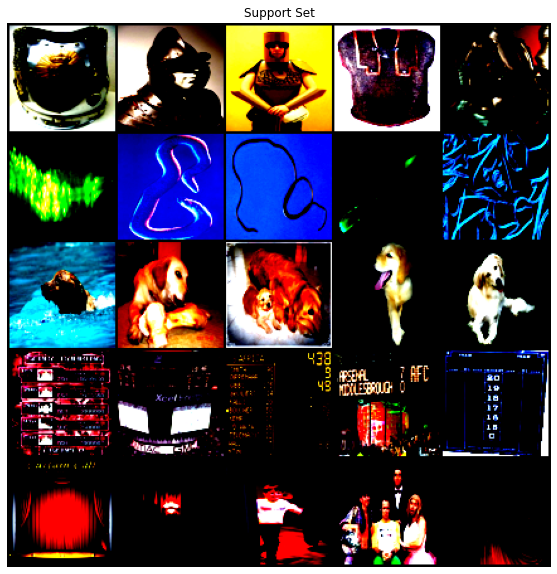

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 4, 4, 4, 4,
         4]])


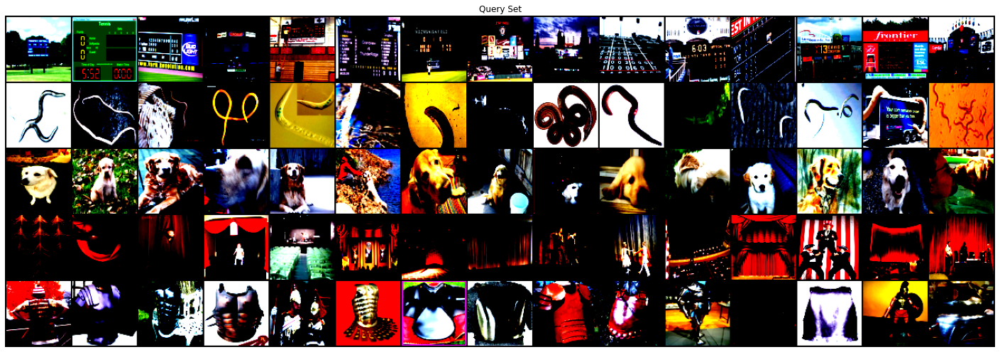

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3,
         3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 4,
         4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
         2, 2, 2]])
target_class 3
unique_classes [0, 1, 2, 4]
base_class 4
target_indices [15 16 17 18 19 20 21 22 23 24 25 26 27 28 29]
target_index 23
base_indices [20 21 22 23 24]
base_index 20


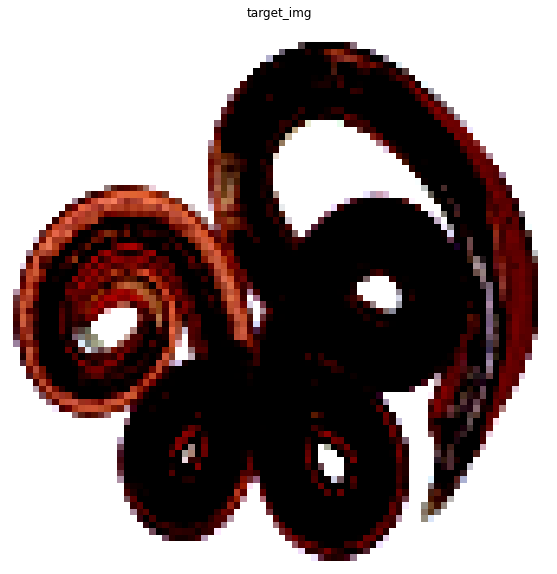

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


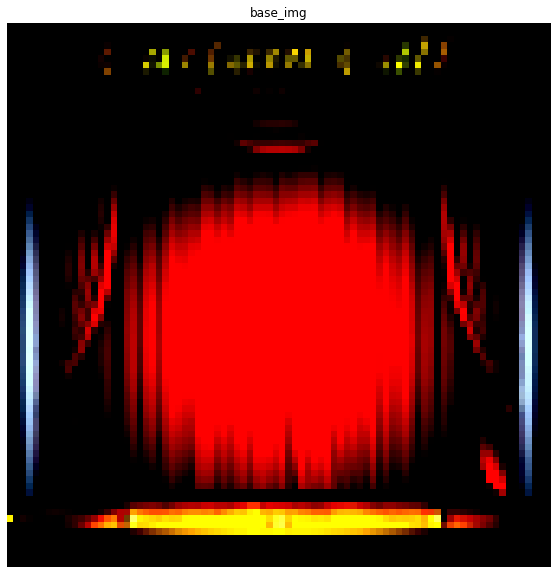

  0%|          | 4/1000 [00:00<00:26, 36.94it/s]

Iteration 0
loss: tensor(35.5719, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(1.1217, grad_fn=<PowBackward0>)
Iteration 2
loss: tensor(0.7959, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(1.9800, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(3.4188, grad_fn=<PowBackward0>)
Iteration 5
loss: tensor(91.2754, grad_fn=<PowBackward0>)
Iteration 6
loss: tensor(0.8536, grad_fn=<PowBackward0>)


  1%|          | 12/1000 [00:00<00:30, 32.66it/s]

Iteration 7
loss: tensor(0.8008, grad_fn=<PowBackward0>)
Iteration 8
loss: tensor(22.6336, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(0.4307, grad_fn=<PowBackward0>)
Iteration 10
loss: tensor(8.1622, grad_fn=<PowBackward0>)
Iteration 11
loss: tensor(73.0235, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(2.9399, grad_fn=<PowBackward0>)
Iteration 13
loss: tensor(4.5836, grad_fn=<PowBackward0>)


  2%|▏         | 20/1000 [00:00<00:29, 33.46it/s]

Iteration 14
loss: tensor(58.6158, grad_fn=<PowBackward0>)
Iteration 15
loss: tensor(1.7017, grad_fn=<PowBackward0>)
Iteration 16
loss: tensor(3.2044, grad_fn=<PowBackward0>)
Iteration 17
loss: tensor(57.7855, grad_fn=<PowBackward0>)
Iteration 18
loss: tensor(0.4761, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(4.9178, grad_fn=<PowBackward0>)
Iteration 20
loss: tensor(3.9720, grad_fn=<PowBackward0>)


  3%|▎         | 28/1000 [00:00<00:29, 32.77it/s]

Iteration 21
loss: tensor(14.4347, grad_fn=<PowBackward0>)
Iteration 22
loss: tensor(64.5014, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(5.9209, grad_fn=<PowBackward0>)
Iteration 24
loss: tensor(0.5291, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(29.0927, grad_fn=<PowBackward0>)
Iteration 26
loss: tensor(3.3811, grad_fn=<PowBackward0>)
Iteration 27
loss: tensor(15.8147, grad_fn=<PowBackward0>)
Iteration 28


  3%|▎         | 32/1000 [00:00<00:29, 33.02it/s]

loss: tensor(75.1977, grad_fn=<PowBackward0>)
Iteration 29
loss: tensor(3.1754, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(3.1426, grad_fn=<PowBackward0>)
Iteration 31
loss: tensor(93.7551, grad_fn=<PowBackward0>)
Iteration 32
loss: tensor(16.5319, grad_fn=<PowBackward0>)
Iteration 33
loss: tensor(4.3039, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(45.6614, grad_fn=<PowBackward0>)
Iteration 35
loss: tensor(0.8438, grad_fn=<PowBackward0>)


  4%|▍         | 40/1000 [00:01<00:28, 33.37it/s]

Iteration 36
loss: tensor(1.8597, grad_fn=<PowBackward0>)
Iteration 37
loss: tensor(64.5304, grad_fn=<PowBackward0>)
Iteration 38
loss: tensor(12.9061, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(0.8467, grad_fn=<PowBackward0>)
Iteration 40
loss: tensor(21.3780, grad_fn=<PowBackward0>)
Iteration 41
loss: tensor(0.4882, grad_fn=<PowBackward0>)
Iteration 42
loss: tensor(6.3670, grad_fn=<PowBackward0>)


  5%|▍         | 48/1000 [00:01<00:29, 32.67it/s]

Iteration 43
loss: tensor(81.3260, grad_fn=<PowBackward0>)
Iteration 44
loss: tensor(15.0606, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(3.5886, grad_fn=<PowBackward0>)
Iteration 46
loss: tensor(38.2626, grad_fn=<PowBackward0>)
Iteration 47
loss: tensor(3.1737, grad_fn=<PowBackward0>)
Iteration 48
loss: tensor(2.1939, grad_fn=<PowBackward0>)
Iteration 49


  6%|▌         | 56/1000 [00:01<00:28, 32.76it/s]

loss: tensor(69.0883, grad_fn=<PowBackward0>)
Iteration 50
loss: tensor(2.2047, grad_fn=<PowBackward0>)
Iteration 51
loss: tensor(0.8121, grad_fn=<PowBackward0>)
Iteration 52
loss: tensor(43.2951, grad_fn=<PowBackward0>)
Iteration 53
loss: tensor(0.5825, grad_fn=<PowBackward0>)
Iteration 54
loss: tensor(1.1406, grad_fn=<PowBackward0>)
Iteration 55
loss: tensor(0.9449, grad_fn=<PowBackward0>)
Iteration 56


  6%|▌         | 60/1000 [00:01<00:28, 32.74it/s]

loss: tensor(79.9474, grad_fn=<PowBackward0>)
Iteration 57
loss: tensor(8.4513, grad_fn=<PowBackward0>)
Iteration 58
loss: tensor(7.5333, grad_fn=<PowBackward0>)
Iteration 59
loss: tensor(59.9530, grad_fn=<PowBackward0>)
Iteration 60
loss: tensor(4.9920, grad_fn=<PowBackward0>)
Iteration 61
loss: tensor(12.8678, grad_fn=<PowBackward0>)
Iteration 62
loss: tensor(61.6252, grad_fn=<PowBackward0>)
Iteration 63
loss: 

  7%|▋         | 68/1000 [00:02<00:28, 32.30it/s]

tensor(1.2231, grad_fn=<PowBackward0>)
Iteration 64
loss: tensor(16.9919, grad_fn=<PowBackward0>)
Iteration 65
loss: tensor(0.4529, grad_fn=<PowBackward0>)
Iteration 66
loss: tensor(2.3488, grad_fn=<PowBackward0>)
Iteration 67
loss: tensor(5.8305, grad_fn=<PowBackward0>)
Iteration 68
loss: tensor(58.3632, grad_fn=<PowBackward0>)
Iteration 69
loss: tensor(4.1199, grad_fn=<PowBackward0>)
Iteration 70


  8%|▊         | 76/1000 [00:02<00:27, 33.47it/s]

loss: tensor(5.4467, grad_fn=<PowBackward0>)
Iteration 71
loss: tensor(80.9173, grad_fn=<PowBackward0>)
Iteration 72
loss: tensor(3.1793, grad_fn=<PowBackward0>)
Iteration 73
loss: tensor(7.8541, grad_fn=<PowBackward0>)
Iteration 74
loss: tensor(65.8864, grad_fn=<PowBackward0>)
Iteration 75
loss: tensor(8.7013, grad_fn=<PowBackward0>)
Iteration 76
loss: tensor(8.4989, grad_fn=<PowBackward0>)
Iteration 77
loss: tensor(56.0392, grad_fn=<PowBackward0>)


  8%|▊         | 84/1000 [00:02<00:26, 34.18it/s]

Iteration 78
loss: tensor(16.2231, grad_fn=<PowBackward0>)
Iteration 79
loss: tensor(1.2108, grad_fn=<PowBackward0>)
Iteration 80
loss: tensor(46.9780, grad_fn=<PowBackward0>)
Iteration 81
loss: tensor(8.4888, grad_fn=<PowBackward0>)
Iteration 82
loss: tensor(5.4192, grad_fn=<PowBackward0>)
Iteration 83
loss: tensor(59.9990, grad_fn=<PowBackward0>)
Iteration 84
loss: tensor(3.0979, grad_fn=<PowBackward0>)
Iteration 85


  9%|▉         | 92/1000 [00:02<00:27, 33.43it/s]

loss: tensor(0.9641, grad_fn=<PowBackward0>)
Iteration 86
loss: tensor(38.2025, grad_fn=<PowBackward0>)
Iteration 87
loss: tensor(9.7461, grad_fn=<PowBackward0>)
Iteration 88
loss: tensor(1.4614, grad_fn=<PowBackward0>)
Iteration 89
loss: tensor(44.3872, grad_fn=<PowBackward0>)
Iteration 90
loss: tensor(6.6223, grad_fn=<PowBackward0>)
Iteration 91
loss: tensor(14.4467, grad_fn=<PowBackward0>)
Iteration 92


 10%|▉         | 96/1000 [00:02<00:27, 32.89it/s]

loss: tensor(70.5678, grad_fn=<PowBackward0>)
Iteration 93
loss: tensor(10.7785, grad_fn=<PowBackward0>)
Iteration 94
loss: tensor(0.9027, grad_fn=<PowBackward0>)
Iteration 95
loss: tensor(2.1741, grad_fn=<PowBackward0>)
Iteration 96
loss: tensor(10.9442, grad_fn=<PowBackward0>)
Iteration 97
loss: tensor(85.9970, grad_fn=<PowBackward0>)
Iteration 98
loss: tensor(13.3357, grad_fn=<PowBackward0>)
Iteration 99
loss: tensor(7.5296, grad_fn=<PowBackward0>)

 10%|█         | 104/1000 [00:03<00:27, 33.06it/s]


Iteration 100
loss: tensor(58.1032, grad_fn=<PowBackward0>)
Iteration 101
loss: tensor(1.2518, grad_fn=<PowBackward0>)
Iteration 102
loss: tensor(5.8005, grad_fn=<PowBackward0>)
Iteration 103
loss: tensor(38.9388, grad_fn=<PowBackward0>)
Iteration 104
loss: tensor(1.0428, grad_fn=<PowBackward0>)
Iteration 105
loss: tensor(29.7390, grad_fn=<PowBackward0>)
Iteration 106


 11%|█         | 112/1000 [00:03<00:26, 33.82it/s]

loss: tensor(0.0075, grad_fn=<PowBackward0>)
Iteration 107
loss: tensor(4.7375, grad_fn=<PowBackward0>)
Iteration 108
loss: tensor(28.1998, grad_fn=<PowBackward0>)
Iteration 109
loss: tensor(49.3868, grad_fn=<PowBackward0>)
Iteration 110
loss: tensor(1.1294, grad_fn=<PowBackward0>)
Iteration 111
loss: tensor(12.8572, grad_fn=<PowBackward0>)
Iteration 112
loss: tensor(58.1273, grad_fn=<PowBackward0>)
Iteration 113


 12%|█▏        | 120/1000 [00:03<00:25, 33.85it/s]

loss: tensor(0.5375, grad_fn=<PowBackward0>)
Iteration 114
loss: tensor(7.7644, grad_fn=<PowBackward0>)
Iteration 115
loss: tensor(4.7542, grad_fn=<PowBackward0>)
Iteration 116
loss: tensor(48.2984, grad_fn=<PowBackward0>)
Iteration 117
loss: tensor(0.3607, grad_fn=<PowBackward0>)
Iteration 118
loss: tensor(2.2208, grad_fn=<PowBackward0>)
Iteration 119
loss: tensor(59.6264, grad_fn=<PowBackward0>)
Iteration 120
loss: tensor(0.6727, grad_fn=<PowBackward0>)


 12%|█▏        | 124/1000 [00:03<00:26, 32.81it/s]

Iteration 121
loss: tensor(10.0990, grad_fn=<PowBackward0>)
Iteration 122
loss: tensor(5.6182, grad_fn=<PowBackward0>)
Iteration 123
loss: tensor(67.2787, grad_fn=<PowBackward0>)
Iteration 124
loss: tensor(3.3495, grad_fn=<PowBackward0>)
Iteration 125
loss: tensor(35.0205, grad_fn=<PowBackward0>)
Iteration 126
loss: tensor(44.4671, grad_fn=<PowBackward0>)
Iteration 127
loss: tensor(0.4821, grad_fn=<PowBackward0>)


 13%|█▎        | 132/1000 [00:03<00:25, 33.67it/s]

Iteration 128
loss: tensor(18.4086, grad_fn=<PowBackward0>)
Iteration 129
loss: tensor(5.1512, grad_fn=<PowBackward0>)
Iteration 130
loss: tensor(78.7503, grad_fn=<PowBackward0>)
Iteration 131
loss: tensor(1.9073, grad_fn=<PowBackward0>)
Iteration 132
loss: tensor(10.6545, grad_fn=<PowBackward0>)
Iteration 133
loss: tensor(57.3356, grad_fn=<PowBackward0>)
Iteration 134
loss: tensor(4.5616, grad_fn=<PowBackward0>)
Iteration 135
loss: tensor(56.7832, grad_fn=<PowBackward0>)


 14%|█▍        | 140/1000 [00:04<00:25, 33.78it/s]

Iteration 136
loss: tensor(1.5299, grad_fn=<PowBackward0>)
Iteration 137
loss: tensor(10.5603, grad_fn=<PowBackward0>)
Iteration 138
loss: tensor(81.1809, grad_fn=<PowBackward0>)
Iteration 139
loss: tensor(0.1402, grad_fn=<PowBackward0>)
Iteration 140
loss: tensor(1.2515, grad_fn=<PowBackward0>)
Iteration 141
loss: tensor(15.8766, grad_fn=<PowBackward0>)
Iteration 142
loss: tensor(55.7898, grad_fn=<PowBackward0>)
Iteration 143


 15%|█▍        | 148/1000 [00:04<00:25, 33.69it/s]

loss: tensor(1.0007, grad_fn=<PowBackward0>)
Iteration 144
loss: tensor(16.1195, grad_fn=<PowBackward0>)
Iteration 145
loss: tensor(84.7595, grad_fn=<PowBackward0>)
Iteration 146
loss: tensor(0.5372, grad_fn=<PowBackward0>)
Iteration 147
loss: tensor(7.9351, grad_fn=<PowBackward0>)
Iteration 148
loss: tensor(3.7139, grad_fn=<PowBackward0>)
Iteration 149
loss: tensor(59.5878, grad_fn=<PowBackward0>)
Iteration 150
loss: tensor(3.5088, grad_fn=<PowBackward0>)


 16%|█▌        | 156/1000 [00:04<00:24, 34.44it/s]

Iteration 151
loss: tensor(4.8369, grad_fn=<PowBackward0>)
Iteration 152
loss: tensor(38.8058, grad_fn=<PowBackward0>)
Iteration 153
loss: tensor(3.1662, grad_fn=<PowBackward0>)
Iteration 154
loss: tensor(6.2399, grad_fn=<PowBackward0>)
Iteration 155
loss: tensor(65.3401, grad_fn=<PowBackward0>)
Iteration 156
loss: tensor(0.7539, grad_fn=<PowBackward0>)
Iteration 157
loss: tensor(14.6144, grad_fn=<PowBackward0>)


 16%|█▋        | 164/1000 [00:04<00:24, 34.04it/s]

Iteration 158
loss: tensor(7.6081, grad_fn=<PowBackward0>)
Iteration 159
loss: tensor(48.9326, grad_fn=<PowBackward0>)
Iteration 160
loss: tensor(0.3546, grad_fn=<PowBackward0>)
Iteration 161
loss: tensor(1.5874, grad_fn=<PowBackward0>)
Iteration 162
loss: tensor(0.3238, grad_fn=<PowBackward0>)
Iteration 163
loss: tensor(46.5235, grad_fn=<PowBackward0>)
Iteration 164
loss: tensor(0.9456, grad_fn=<PowBackward0>)
Iteration 165


 17%|█▋        | 172/1000 [00:05<00:24, 34.00it/s]

loss: tensor(4.5903, grad_fn=<PowBackward0>)
Iteration 166
loss: tensor(73.1831, grad_fn=<PowBackward0>)
Iteration 167
loss: tensor(0.1227, grad_fn=<PowBackward0>)
Iteration 168
loss: tensor(0.4542, grad_fn=<PowBackward0>)
Iteration 169
loss: tensor(44.0376, grad_fn=<PowBackward0>)
Iteration 170
loss: tensor(1.6493, grad_fn=<PowBackward0>)
Iteration 171
loss: tensor(17.5125, grad_fn=<PowBackward0>)
Iteration 172
loss:

 18%|█▊        | 176/1000 [00:05<00:24, 33.78it/s]

 tensor(87.8847, grad_fn=<PowBackward0>)
Iteration 173
loss: tensor(0.0632, grad_fn=<PowBackward0>)
Iteration 174
loss: tensor(0.0872, grad_fn=<PowBackward0>)
Iteration 175
loss: tensor(18.7862, grad_fn=<PowBackward0>)
Iteration 176
loss: tensor(3.8993, grad_fn=<PowBackward0>)
Iteration 177
loss: tensor(43.0408, grad_fn=<PowBackward0>)
Iteration 178
loss: tensor(0.0975, grad_fn=<PowBackward0>)
Iteration 179
loss: tensor(7.8134, grad_fn=<PowBackward0>)


 18%|█▊        | 184/1000 [00:05<00:24, 33.78it/s]

Iteration 180
loss: tensor(11.3716, grad_fn=<PowBackward0>)
Iteration 181
loss: tensor(56.5672, grad_fn=<PowBackward0>)
Iteration 182
loss: tensor(8.0135, grad_fn=<PowBackward0>)
Iteration 183
loss: tensor(45.1867, grad_fn=<PowBackward0>)
Iteration 184
loss: tensor(1.0620, grad_fn=<PowBackward0>)
Iteration 185
loss: tensor(7.9694, grad_fn=<PowBackward0>)
Iteration 186
loss: tensor(49.8202, grad_fn=<PowBackward0>)
Iteration 187


 19%|█▉        | 192/1000 [00:05<00:24, 33.11it/s]

loss: tensor(0.3610, grad_fn=<PowBackward0>)
Iteration 188
loss: tensor(1.7089, grad_fn=<PowBackward0>)
Iteration 189
loss: tensor(34.7933, grad_fn=<PowBackward0>)
Iteration 190
loss: tensor(0.0906, grad_fn=<PowBackward0>)
Iteration 191
loss: tensor(0.8531, grad_fn=<PowBackward0>)
Iteration 192
loss: tensor(6.9682, grad_fn=<PowBackward0>)
Iteration 193
loss: tensor(81.5918, grad_fn=<PowBackward0>)
Iteration 194


 20%|██        | 200/1000 [00:06<00:23, 33.72it/s]

loss: tensor(4.3590, grad_fn=<PowBackward0>)
Iteration 195
loss: tensor(8.7914, grad_fn=<PowBackward0>)
Iteration 196
loss: tensor(66.8900, grad_fn=<PowBackward0>)
Iteration 197
loss: tensor(21.3018, grad_fn=<PowBackward0>)
Iteration 198
loss: tensor(2.3564, grad_fn=<PowBackward0>)
Iteration 199
loss: tensor(29.6210, grad_fn=<PowBackward0>)
Iteration 200
loss: tensor(1.6162, grad_fn=<PowBackward0>)
Iteration 201


 21%|██        | 208/1000 [00:06<00:23, 33.48it/s]

loss: tensor(31.3703, grad_fn=<PowBackward0>)
Iteration 202
loss: tensor(47.4094, grad_fn=<PowBackward0>)
Iteration 203
loss: tensor(8.3114, grad_fn=<PowBackward0>)
Iteration 204
loss: tensor(39.8003, grad_fn=<PowBackward0>)
Iteration 205
loss: tensor(4.6520, grad_fn=<PowBackward0>)
Iteration 206
loss: tensor(32.9407, grad_fn=<PowBackward0>)
Iteration 207
loss: tensor(2.5854, grad_fn=<PowBackward0>)
Iteration 208


 21%|██        | 212/1000 [00:06<00:24, 31.64it/s]

loss: tensor(21.2838, grad_fn=<PowBackward0>)
Iteration 209
loss: tensor(5.2969, grad_fn=<PowBackward0>)
Iteration 210
loss: tensor(63.5213, grad_fn=<PowBackward0>)
Iteration 211
loss: tensor(1.0081, grad_fn=<PowBackward0>)
Iteration 212
loss: tensor(20.5834, grad_fn=<PowBackward0>)
Iteration 213
loss: tensor(3.3326, grad_fn=<PowBackward0>)
Iteration 214
loss: tensor(39.6927, grad_fn=<PowBackward0>)
Iteration 215


 22%|██▏       | 220/1000 [00:06<00:23, 33.30it/s]

loss: tensor(2.9096, grad_fn=<PowBackward0>)
Iteration 216
loss: tensor(31.1204, grad_fn=<PowBackward0>)
Iteration 217
loss: tensor(8.2266, grad_fn=<PowBackward0>)
Iteration 218
loss: tensor(44.9641, grad_fn=<PowBackward0>)
Iteration 219
loss: tensor(5.2341, grad_fn=<PowBackward0>)
Iteration 220
loss: tensor(25.3239, grad_fn=<PowBackward0>)
Iteration 221
loss: tensor(3.3148, grad_fn=<PowBackward0>)
Iteration 222
loss: tensor(28.5036, grad_fn=<PowBackward0>)


 23%|██▎       | 228/1000 [00:06<00:23, 32.89it/s]

Iteration 223
loss: tensor(1.9391, grad_fn=<PowBackward0>)
Iteration 224
loss: tensor(34.8014, grad_fn=<PowBackward0>)
Iteration 225
loss: tensor(3.5760, grad_fn=<PowBackward0>)
Iteration 226
loss: tensor(16.6917, grad_fn=<PowBackward0>)
Iteration 227
loss: tensor(10.6338, grad_fn=<PowBackward0>)
Iteration 228
loss: tensor(36.1159, grad_fn=<PowBackward0>)
Iteration 229
loss: tensor(15.1966, grad_fn=<PowBackward0>)


 24%|██▎       | 236/1000 [00:07<00:22, 33.80it/s]

Iteration 230
loss: tensor(67.4528, grad_fn=<PowBackward0>)
Iteration 231
loss: tensor(1.6615, grad_fn=<PowBackward0>)
Iteration 232
loss: tensor(33.1837, grad_fn=<PowBackward0>)
Iteration 233
loss: tensor(0.2176, grad_fn=<PowBackward0>)
Iteration 234
loss: tensor(2.9226, grad_fn=<PowBackward0>)
Iteration 235
loss: tensor(16.4017, grad_fn=<PowBackward0>)
Iteration 236
loss: tensor(51.3120, grad_fn=<PowBackward0>)


 24%|██▍       | 240/1000 [00:07<00:22, 33.41it/s]

Iteration 237
loss: tensor(6.7316, grad_fn=<PowBackward0>)
Iteration 238
loss: tensor(55.4521, grad_fn=<PowBackward0>)
Iteration 239
loss: tensor(0.3066, grad_fn=<PowBackward0>)
Iteration 240
loss: tensor(0.8447, grad_fn=<PowBackward0>)
Iteration 241
loss: tensor(7.4876, grad_fn=<PowBackward0>)
Iteration 242
loss: tensor(61.8322, grad_fn=<PowBackward0>)
Iteration 243
loss: tensor(0.4768, grad_fn=<PowBackward0>)


 25%|██▍       | 248/1000 [00:07<00:23, 32.64it/s]

Iteration 244
loss: tensor(3.4828, grad_fn=<PowBackward0>)
Iteration 245
loss: tensor(27.6015, grad_fn=<PowBackward0>)
Iteration 246
loss: tensor(5.4034, grad_fn=<PowBackward0>)
Iteration 247
loss: tensor(44.1800, grad_fn=<PowBackward0>)
Iteration 248
loss: tensor(12.6339, grad_fn=<PowBackward0>)
Iteration 249
loss: tensor(44.1664, grad_fn=<PowBackward0>)


 26%|██▌       | 256/1000 [00:07<00:23, 32.09it/s]

Iteration 250
loss: tensor(3.3797, grad_fn=<PowBackward0>)
Iteration 251
loss: tensor(32.7765, grad_fn=<PowBackward0>)
Iteration 252
loss: tensor(0.8721, grad_fn=<PowBackward0>)
Iteration 253
loss: tensor(24.9281, grad_fn=<PowBackward0>)
Iteration 254
loss: tensor(13.9603, grad_fn=<PowBackward0>)
Iteration 255
loss: tensor(60.2861, grad_fn=<PowBackward0>)
Iteration 256
loss: tensor(0.2946, grad_fn=<PowBackward0>)
Iteration 

 26%|██▌       | 260/1000 [00:07<00:24, 30.25it/s]

257
loss: tensor(3.3314, grad_fn=<PowBackward0>)
Iteration 258
loss: tensor(30.7673, grad_fn=<PowBackward0>)
Iteration 259
loss: tensor(7.1914, grad_fn=<PowBackward0>)
Iteration 260
loss: tensor(67.5276, grad_fn=<PowBackward0>)
Iteration 261
loss: tensor(0.4762, grad_fn=<PowBackward0>)
Iteration 262
loss: tensor(15.7081, grad_fn=<PowBackward0>)
Iteration 263


 27%|██▋       | 268/1000 [00:08<00:22, 32.21it/s]

loss: tensor(7.8545, grad_fn=<PowBackward0>)
Iteration 264
loss: tensor(63.1254, grad_fn=<PowBackward0>)
Iteration 265
loss: tensor(3.2930, grad_fn=<PowBackward0>)
Iteration 266
loss: tensor(23.9719, grad_fn=<PowBackward0>)
Iteration 267
loss: tensor(4.8502, grad_fn=<PowBackward0>)
Iteration 268
loss: tensor(24.4690, grad_fn=<PowBackward0>)
Iteration 269
loss: tensor(7.5610, grad_fn=<PowBackward0>)
Iteration 270
loss: tensor(34.5257, grad_fn=<PowBackward0>)


 28%|██▊       | 276/1000 [00:08<00:21, 33.11it/s]

Iteration 271
loss: tensor(0.7468, grad_fn=<PowBackward0>)
Iteration 272
loss: tensor(10.8765, grad_fn=<PowBackward0>)
Iteration 273
loss: tensor(59.6026, grad_fn=<PowBackward0>)
Iteration 274
loss: tensor(0.0404, grad_fn=<PowBackward0>)
Iteration 275
loss: tensor(0.0477, grad_fn=<PowBackward0>)
Iteration 276
loss: tensor(4.1112, grad_fn=<PowBackward0>)
Iteration 277
loss: 

 28%|██▊       | 284/1000 [00:08<00:21, 33.20it/s]

tensor(10.8784, grad_fn=<PowBackward0>)
Iteration 278
loss: tensor(39.3222, grad_fn=<PowBackward0>)
Iteration 279
loss: tensor(0.1864, grad_fn=<PowBackward0>)
Iteration 280
loss: tensor(0.5524, grad_fn=<PowBackward0>)
Iteration 281
loss: tensor(12.8153, grad_fn=<PowBackward0>)
Iteration 282
loss: tensor(9.2314, grad_fn=<PowBackward0>)
Iteration 283
loss: tensor(62.3071, grad_fn=<PowBackward0>)
Iteration 284


 29%|██▉       | 288/1000 [00:08<00:21, 32.39it/s]

loss: tensor(1.0329, grad_fn=<PowBackward0>)
Iteration 285
loss: tensor(11.9784, grad_fn=<PowBackward0>)
Iteration 286
loss: tensor(12.2401, grad_fn=<PowBackward0>)
Iteration 287
loss: tensor(53.0004, grad_fn=<PowBackward0>)
Iteration 288
loss: tensor(9.8179, grad_fn=<PowBackward0>)
Iteration 289
loss: tensor(30.0167, grad_fn=<PowBackward0>)
Iteration 290
loss: tensor(9.5204, grad_fn=<PowBackward0>)
Iteration 291


 30%|██▉       | 296/1000 [00:08<00:21, 32.71it/s]

loss: tensor(50.0205, grad_fn=<PowBackward0>)
Iteration 292
loss: tensor(0.7917, grad_fn=<PowBackward0>)
Iteration 293
loss: tensor(17.1848, grad_fn=<PowBackward0>)
Iteration 294
loss: tensor(16.7944, grad_fn=<PowBackward0>)
Iteration 295
loss: tensor(32.9651, grad_fn=<PowBackward0>)
Iteration 296
loss: tensor(5.2891, grad_fn=<PowBackward0>)
Iteration 297
loss: tensor(42.9783, grad_fn=<PowBackward0>)
Iteration 298


 30%|███       | 304/1000 [00:09<00:20, 33.79it/s]

loss: tensor(5.1872, grad_fn=<PowBackward0>)
Iteration 299
loss: tensor(36.7916, grad_fn=<PowBackward0>)
Iteration 300
loss: tensor(1.0654, grad_fn=<PowBackward0>)
Iteration 301
loss: tensor(23.6405, grad_fn=<PowBackward0>)
Iteration 302
loss: tensor(2.4301, grad_fn=<PowBackward0>)
Iteration 303
loss: tensor(6.1449, grad_fn=<PowBackward0>)
Iteration 304
loss: tensor(9.1735, grad_fn=<PowBackward0>)
Iteration 305
loss: tensor(31.7446, grad_fn=<PowBackward0>)


 31%|███       | 312/1000 [00:09<00:20, 34.13it/s]

Iteration 306
loss: tensor(6.3212, grad_fn=<PowBackward0>)
Iteration 307
loss: tensor(20.1153, grad_fn=<PowBackward0>)
Iteration 308
loss: tensor(7.5231, grad_fn=<PowBackward0>)
Iteration 309
loss: tensor(9.3569, grad_fn=<PowBackward0>)
Iteration 310
loss: tensor(12.5004, grad_fn=<PowBackward0>)
Iteration 311
loss: tensor(18.8848, grad_fn=<PowBackward0>)
Iteration 312
loss: tensor(6.0911, grad_fn=<PowBackward0>)


 32%|███▏      | 320/1000 [00:09<00:20, 33.67it/s]

Iteration 313
loss: tensor(9.9730, grad_fn=<PowBackward0>)
Iteration 314
loss: tensor(4.7418, grad_fn=<PowBackward0>)
Iteration 315
loss: tensor(16.4160, grad_fn=<PowBackward0>)
Iteration 316
loss: tensor(3.2990, grad_fn=<PowBackward0>)
Iteration 317
loss: tensor(15.3996, grad_fn=<PowBackward0>)
Iteration 318
loss: tensor(5.1651, grad_fn=<PowBackward0>)
Iteration 319
loss: tensor(7.3019, grad_fn=<PowBackward0>)
Iteration 320


 32%|███▏      | 324/1000 [00:09<00:20, 33.46it/s]

loss: tensor(6.8404, grad_fn=<PowBackward0>)
Iteration 321
loss: tensor(22.4700, grad_fn=<PowBackward0>)
Iteration 322
loss: tensor(2.7155, grad_fn=<PowBackward0>)
Iteration 323
loss: tensor(8.7392, grad_fn=<PowBackward0>)
Iteration 324
loss: tensor(3.2006, grad_fn=<PowBackward0>)
Iteration 325
loss: tensor(6.7210, grad_fn=<PowBackward0>)
Iteration 326
loss: tensor(3.5875, grad_fn=<PowBackward0>)
Iteration 327


 33%|███▎      | 332/1000 [00:10<00:19, 33.48it/s]

loss: tensor(24.5157, grad_fn=<PowBackward0>)
Iteration 328
loss: tensor(7.9923, grad_fn=<PowBackward0>)
Iteration 329
loss: tensor(13.8027, grad_fn=<PowBackward0>)
Iteration 330
loss: tensor(2.7203, grad_fn=<PowBackward0>)
Iteration 331
loss: tensor(6.7543, grad_fn=<PowBackward0>)
Iteration 332
loss: tensor(2.7956, grad_fn=<PowBackward0>)
Iteration 333
loss: tensor(7.0072, grad_fn=<PowBackward0>)
Iteration 334


 34%|███▍      | 340/1000 [00:10<00:19, 33.49it/s]

loss: tensor(6.0128, grad_fn=<PowBackward0>)
Iteration 335
loss: tensor(11.8113, grad_fn=<PowBackward0>)
Iteration 336
loss: tensor(2.7293, grad_fn=<PowBackward0>)
Iteration 337
loss: tensor(9.9182, grad_fn=<PowBackward0>)
Iteration 338
loss: tensor(3.7184, grad_fn=<PowBackward0>)
Iteration 339
loss: tensor(14.2476, grad_fn=<PowBackward0>)
Iteration 340
loss: tensor(2.2634, grad_fn=<PowBackward0>)
Iteration 341
loss: 

 35%|███▍      | 348/1000 [00:10<00:19, 34.03it/s]

tensor(7.9065, grad_fn=<PowBackward0>)
Iteration 342
loss: tensor(3.1224, grad_fn=<PowBackward0>)
Iteration 343
loss: tensor(18.0464, grad_fn=<PowBackward0>)
Iteration 344
loss: tensor(3.4050, grad_fn=<PowBackward0>)
Iteration 345
loss: tensor(11.4654, grad_fn=<PowBackward0>)
Iteration 346
loss: tensor(2.2260, grad_fn=<PowBackward0>)
Iteration 347
loss: tensor(10.7678, grad_fn=<PowBackward0>)
Iteration 348
loss: tensor(7.2887, grad_fn=<PowBackward0>)


 35%|███▌      | 352/1000 [00:10<00:19, 33.19it/s]

Iteration 349
loss: tensor(18.7597, grad_fn=<PowBackward0>)
Iteration 350
loss: tensor(9.4107, grad_fn=<PowBackward0>)
Iteration 351
loss: tensor(30.0071, grad_fn=<PowBackward0>)
Iteration 352
loss: tensor(5.2795, grad_fn=<PowBackward0>)
Iteration 353
loss: tensor(11.6948, grad_fn=<PowBackward0>)
Iteration 354
loss: tensor(3.2930, grad_fn=<PowBackward0>)
Iteration 355
loss: tensor(8.4935, grad_fn=<PowBackward0>)


 36%|███▌      | 360/1000 [00:10<00:19, 32.77it/s]

Iteration 356
loss: tensor(1.7646, grad_fn=<PowBackward0>)
Iteration 357
loss: tensor(14.4008, grad_fn=<PowBackward0>)
Iteration 358
loss: tensor(4.8619, grad_fn=<PowBackward0>)
Iteration 359
loss: tensor(9.5895, grad_fn=<PowBackward0>)
Iteration 360
loss: tensor(7.4581, grad_fn=<PowBackward0>)
Iteration 361
loss: tensor(20.6122, grad_fn=<PowBackward0>)
Iteration 362
loss: tensor(4.2933, grad_fn=<PowBackward0>)


 37%|███▋      | 368/1000 [00:11<00:18, 33.74it/s]

Iteration 363
loss: tensor(23.6837, grad_fn=<PowBackward0>)
Iteration 364
loss: tensor(13.2150, grad_fn=<PowBackward0>)
Iteration 365
loss: tensor(24.4824, grad_fn=<PowBackward0>)
Iteration 366
loss: tensor(4.5692, grad_fn=<PowBackward0>)
Iteration 367
loss: tensor(22.9744, grad_fn=<PowBackward0>)
Iteration 368
loss: tensor(9.4493, grad_fn=<PowBackward0>)
Iteration 369
loss: tensor(18.2560, grad_fn=<PowBackward0>)


 38%|███▊      | 376/1000 [00:11<00:18, 34.07it/s]

Iteration 370
loss: tensor(6.9985, grad_fn=<PowBackward0>)
Iteration 371
loss: tensor(21.4103, grad_fn=<PowBackward0>)
Iteration 372
loss: tensor(3.8390, grad_fn=<PowBackward0>)
Iteration 373
loss: tensor(24.0282, grad_fn=<PowBackward0>)
Iteration 374
loss: tensor(2.7774, grad_fn=<PowBackward0>)
Iteration 375
loss: tensor(10.0734, grad_fn=<PowBackward0>)
Iteration 376
loss: tensor(9.1106, grad_fn=<PowBackward0>)


 38%|███▊      | 380/1000 [00:11<00:18, 33.14it/s]

Iteration 377
loss: tensor(30.1261, grad_fn=<PowBackward0>)
Iteration 378
loss: tensor(7.4772, grad_fn=<PowBackward0>)
Iteration 379
loss: tensor(14.5733, grad_fn=<PowBackward0>)
Iteration 380
loss: tensor(8.2539, grad_fn=<PowBackward0>)
Iteration 381
loss: tensor(21.0185, grad_fn=<PowBackward0>)
Iteration 382
loss: tensor(11.8272, grad_fn=<PowBackward0>)
Iteration 383
loss: tensor(14.9920, grad_fn=<PowBackward0>)


 39%|███▉      | 388/1000 [00:11<00:18, 32.72it/s]

Iteration 384
loss: tensor(3.7511, grad_fn=<PowBackward0>)
Iteration 385
loss: tensor(18.6321, grad_fn=<PowBackward0>)
Iteration 386
loss: tensor(6.1440, grad_fn=<PowBackward0>)
Iteration 387
loss: tensor(15.6149, grad_fn=<PowBackward0>)
Iteration 388
loss: tensor(1.6651, grad_fn=<PowBackward0>)
Iteration 389
loss: tensor(23.0733, grad_fn=<PowBackward0>)
Iteration 390
loss: tensor(1.0872, grad_fn=<PowBackward0>)


 40%|███▉      | 396/1000 [00:11<00:18, 32.36it/s]

Iteration 391
loss: tensor(4.2970, grad_fn=<PowBackward0>)
Iteration 392
loss: tensor(8.7713, grad_fn=<PowBackward0>)
Iteration 393
loss: tensor(18.5526, grad_fn=<PowBackward0>)
Iteration 394
loss: tensor(3.7914, grad_fn=<PowBackward0>)
Iteration 395
loss: tensor(12.3920, grad_fn=<PowBackward0>)
Iteration 396
loss: tensor(3.9252, grad_fn=<PowBackward0>)
Iteration 397


 40%|████      | 404/1000 [00:12<00:17, 33.37it/s]

loss: tensor(17.5613, grad_fn=<PowBackward0>)
Iteration 398
loss: tensor(7.5868, grad_fn=<PowBackward0>)
Iteration 399
loss: tensor(29.8697, grad_fn=<PowBackward0>)
Iteration 400
loss: tensor(4.5516, grad_fn=<PowBackward0>)
Iteration 401
loss: tensor(10.0856, grad_fn=<PowBackward0>)
Iteration 402
loss: tensor(1.3501, grad_fn=<PowBackward0>)
Iteration 403
loss: tensor(1.2227, grad_fn=<PowBackward0>)
Iteration 404
loss: tensor(0.5354, grad_fn=<PowBackward0>)


 41%|████      | 412/1000 [00:12<00:17, 33.92it/s]

Iteration 405
loss: tensor(0.8015, grad_fn=<PowBackward0>)
Iteration 406
loss: tensor(0.5863, grad_fn=<PowBackward0>)
Iteration 407
loss: tensor(2.2214, grad_fn=<PowBackward0>)
Iteration 408
loss: tensor(1.5449, grad_fn=<PowBackward0>)
Iteration 409
loss: tensor(4.3865, grad_fn=<PowBackward0>)
Iteration 410
loss: tensor(1.9959, grad_fn=<PowBackward0>)
Iteration 411
loss: tensor(3.9063, grad_fn=<PowBackward0>)
Iteration 412


 42%|████▏     | 416/1000 [00:12<00:17, 33.33it/s]

loss: tensor(1.8459, grad_fn=<PowBackward0>)
Iteration 413
loss: tensor(2.9931, grad_fn=<PowBackward0>)
Iteration 414
loss: tensor(1.1487, grad_fn=<PowBackward0>)
Iteration 415
loss: tensor(1.8459, grad_fn=<PowBackward0>)
Iteration 416
loss: tensor(0.9994, grad_fn=<PowBackward0>)
Iteration 417
loss: tensor(2.4956, grad_fn=<PowBackward0>)
Iteration 418
loss: tensor(1.2138, grad_fn=<PowBackward0>)
Iteration 419
loss: 

 42%|████▏     | 424/1000 [00:12<00:16, 33.93it/s]

tensor(2.5623, grad_fn=<PowBackward0>)
Iteration 420
loss: tensor(2.1400, grad_fn=<PowBackward0>)
Iteration 421
loss: tensor(4.6502, grad_fn=<PowBackward0>)
Iteration 422
loss: tensor(0.9605, grad_fn=<PowBackward0>)
Iteration 423
loss: tensor(15.5333, grad_fn=<PowBackward0>)
Iteration 424
loss: tensor(11.5096, grad_fn=<PowBackward0>)
Iteration 425
loss: tensor(15.8881, grad_fn=<PowBackward0>)
Iteration 426
loss: tensor(4.3877, grad_fn=<PowBackward0>)


 43%|████▎     | 432/1000 [00:13<00:17, 33.10it/s]

Iteration 427
loss: tensor(7.1827, grad_fn=<PowBackward0>)
Iteration 428
loss: tensor(2.8155, grad_fn=<PowBackward0>)
Iteration 429
loss: tensor(3.3675, grad_fn=<PowBackward0>)
Iteration 430
loss: tensor(1.3700, grad_fn=<PowBackward0>)
Iteration 431
loss: tensor(1.5087, grad_fn=<PowBackward0>)
Iteration 432
loss: tensor(0.8205, grad_fn=<PowBackward0>)
Iteration 433
loss: tensor(1.4021, grad_fn=<PowBackward0>)


 44%|████▍     | 440/1000 [00:13<00:16, 33.42it/s]

Iteration 434
loss: tensor(0.6277, grad_fn=<PowBackward0>)
Iteration 435
loss: tensor(1.8762, grad_fn=<PowBackward0>)
Iteration 436
loss: tensor(1.6385, grad_fn=<PowBackward0>)
Iteration 437
loss: tensor(2.9393, grad_fn=<PowBackward0>)
Iteration 438
loss: tensor(2.3193, grad_fn=<PowBackward0>)
Iteration 439
loss: tensor(6.9252, grad_fn=<PowBackward0>)
Iteration 440
loss: tensor(4.0224, grad_fn=<PowBackward0>)


 45%|████▍     | 448/1000 [00:13<00:16, 34.13it/s]

Iteration 441
loss: tensor(4.6459, grad_fn=<PowBackward0>)
Iteration 442
loss: tensor(1.6289, grad_fn=<PowBackward0>)
Iteration 443
loss: tensor(3.0179, grad_fn=<PowBackward0>)
Iteration 444
loss: tensor(1.2485, grad_fn=<PowBackward0>)
Iteration 445
loss: tensor(1.9856, grad_fn=<PowBackward0>)
Iteration 446
loss: tensor(0.6632, grad_fn=<PowBackward0>)
Iteration 447
loss: tensor(3.3137, grad_fn=<PowBackward0>)
Iteration 448


 45%|████▌     | 452/1000 [00:13<00:16, 33.15it/s]

loss: tensor(3.2292, grad_fn=<PowBackward0>)
Iteration 449
loss: tensor(7.4233, grad_fn=<PowBackward0>)
Iteration 450
loss: tensor(2.5811, grad_fn=<PowBackward0>)
Iteration 451
loss: tensor(3.9737, grad_fn=<PowBackward0>)
Iteration 452
loss: tensor(3.5914, grad_fn=<PowBackward0>)
Iteration 453
loss: tensor(3.5714, grad_fn=<PowBackward0>)
Iteration 454
loss: tensor(1.5848, grad_fn=<PowBackward0>)
Iteration 455
loss: tensor(1.1373, grad_fn=<PowBackward0>)


 46%|████▌     | 460/1000 [00:13<00:16, 33.56it/s]

Iteration 456
loss: tensor(0.5090, grad_fn=<PowBackward0>)
Iteration 457
loss: tensor(0.5957, grad_fn=<PowBackward0>)
Iteration 458
loss: tensor(0.2632, grad_fn=<PowBackward0>)
Iteration 459
loss: tensor(0.7562, grad_fn=<PowBackward0>)
Iteration 460
loss: tensor(0.4027, grad_fn=<PowBackward0>)
Iteration 461
loss: tensor(2.4013, grad_fn=<PowBackward0>)
Iteration 462
loss: tensor(1.5264, grad_fn=<PowBackward0>)


 47%|████▋     | 468/1000 [00:14<00:15, 33.34it/s]

Iteration 463
loss: tensor(5.7368, grad_fn=<PowBackward0>)
Iteration 464
loss: tensor(2.1928, grad_fn=<PowBackward0>)
Iteration 465
loss: tensor(11.9768, grad_fn=<PowBackward0>)
Iteration 466
loss: tensor(6.9230, grad_fn=<PowBackward0>)
Iteration 467
loss: tensor(17.7105, grad_fn=<PowBackward0>)
Iteration 468
loss: tensor(5.5951, grad_fn=<PowBackward0>)
Iteration 469
loss: tensor(8.4234, grad_fn=<PowBackward0>)


 48%|████▊     | 476/1000 [00:14<00:15, 33.46it/s]

Iteration 470
loss: tensor(1.8662, grad_fn=<PowBackward0>)
Iteration 471
loss: tensor(5.9899, grad_fn=<PowBackward0>)
Iteration 472
loss: tensor(2.1270, grad_fn=<PowBackward0>)
Iteration 473
loss: tensor(4.3646, grad_fn=<PowBackward0>)
Iteration 474
loss: tensor(5.5132, grad_fn=<PowBackward0>)
Iteration 475
loss: tensor(8.7250, grad_fn=<PowBackward0>)
Iteration 476
loss: tensor(4.0341, grad_fn=<PowBackward0>)


 48%|████▊     | 484/1000 [00:14<00:14, 34.40it/s]

Iteration 477
loss: tensor(4.1741, grad_fn=<PowBackward0>)
Iteration 478
loss: tensor(1.5071, grad_fn=<PowBackward0>)
Iteration 479
loss: tensor(1.3783, grad_fn=<PowBackward0>)
Iteration 480
loss: tensor(0.5985, grad_fn=<PowBackward0>)
Iteration 481
loss: tensor(1.0360, grad_fn=<PowBackward0>)
Iteration 482
loss: tensor(0.4998, grad_fn=<PowBackward0>)
Iteration 483
loss: tensor(1.4213, grad_fn=<PowBackward0>)
Iteration 484


 49%|████▉     | 488/1000 [00:14<00:15, 33.62it/s]

loss: tensor(0.8494, grad_fn=<PowBackward0>)
Iteration 485
loss: tensor(4.7901, grad_fn=<PowBackward0>)
Iteration 486
loss: tensor(4.0770, grad_fn=<PowBackward0>)
Iteration 487
loss: tensor(4.1047, grad_fn=<PowBackward0>)
Iteration 488
loss: tensor(1.4577, grad_fn=<PowBackward0>)
Iteration 489
loss: tensor(6.6990, grad_fn=<PowBackward0>)
Iteration 490
loss: tensor(2.3137, grad_fn=<PowBackward0>)
Iteration 491
loss: tensor(3.6251, grad_fn=<PowBackward0>)


 50%|████▉     | 496/1000 [00:14<00:15, 32.48it/s]

Iteration 492
loss: tensor(2.3966, grad_fn=<PowBackward0>)
Iteration 493
loss: tensor(4.2599, grad_fn=<PowBackward0>)
Iteration 494
loss: tensor(3.2997, grad_fn=<PowBackward0>)
Iteration 495
loss: tensor(4.7751, grad_fn=<PowBackward0>)
Iteration 496
loss: tensor(1.9900, grad_fn=<PowBackward0>)
Iteration 497
loss: tensor(2.9538, grad_fn=<PowBackward0>)
Iteration 498
loss: tensor(1.9939, grad_fn=<PowBackward0>)


 50%|█████     | 504/1000 [00:15<00:14, 33.39it/s]

Iteration 499
loss: tensor(3.5262, grad_fn=<PowBackward0>)
Iteration 500
loss: tensor(1.1298, grad_fn=<PowBackward0>)
Iteration 501
loss: tensor(2.9425, grad_fn=<PowBackward0>)
Iteration 502
loss: tensor(0.1515, grad_fn=<PowBackward0>)
Iteration 503
loss: tensor(0.0893, grad_fn=<PowBackward0>)
Iteration 504
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 505
loss: tensor(0.0318, grad_fn=<PowBackward0>)


 51%|█████     | 512/1000 [00:15<00:14, 33.41it/s]

Iteration 506
loss: tensor(0.0162, grad_fn=<PowBackward0>)
Iteration 507
loss: tensor(0.0245, grad_fn=<PowBackward0>)
Iteration 508
loss: tensor(0.0178, grad_fn=<PowBackward0>)
Iteration 509
loss: tensor(0.0209, grad_fn=<PowBackward0>)
Iteration 510
loss: tensor(0.0179, grad_fn=<PowBackward0>)
Iteration 511
loss: tensor(0.0107, grad_fn=<PowBackward0>)
Iteration 512
loss: tensor(0.0076, grad_fn=<PowBackward0>)
Iteration 513


 52%|█████▏    | 520/1000 [00:15<00:14, 33.66it/s]

loss: tensor(0.3365, grad_fn=<PowBackward0>)
Iteration 514
loss: tensor(0.9175, grad_fn=<PowBackward0>)
Iteration 515
loss: tensor(4.1396, grad_fn=<PowBackward0>)
Iteration 516
loss: tensor(1.1918, grad_fn=<PowBackward0>)
Iteration 517
loss: tensor(1.9526, grad_fn=<PowBackward0>)
Iteration 518
loss: tensor(1.1264, grad_fn=<PowBackward0>)
Iteration 519
loss: tensor(0.9880, grad_fn=<PowBackward0>)
Iteration 520
loss: tensor(0.4316, grad_fn=<PowBackward0>)


 53%|█████▎    | 528/1000 [00:15<00:14, 33.59it/s]

Iteration 521
loss: tensor(0.5446, grad_fn=<PowBackward0>)
Iteration 522
loss: tensor(0.2304, grad_fn=<PowBackward0>)
Iteration 523
loss: tensor(0.4309, grad_fn=<PowBackward0>)
Iteration 524
loss: tensor(0.2876, grad_fn=<PowBackward0>)
Iteration 525
loss: tensor(0.5998, grad_fn=<PowBackward0>)
Iteration 526
loss: tensor(0.4129, grad_fn=<PowBackward0>)
Iteration 527
loss: tensor(0.7782, grad_fn=<PowBackward0>)


 53%|█████▎    | 532/1000 [00:16<00:14, 32.34it/s]

Iteration 528
loss: tensor(0.5019, grad_fn=<PowBackward0>)
Iteration 529
loss: tensor(0.7830, grad_fn=<PowBackward0>)
Iteration 530
loss: tensor(0.4221, grad_fn=<PowBackward0>)
Iteration 531
loss: tensor(0.6435, grad_fn=<PowBackward0>)
Iteration 532
loss: tensor(0.2872, grad_fn=<PowBackward0>)
Iteration 533
loss: tensor(0.6796, grad_fn=<PowBackward0>)
Iteration 534


 54%|█████▍    | 540/1000 [00:16<00:14, 32.68it/s]

loss: tensor(0.3173, grad_fn=<PowBackward0>)
Iteration 535
loss: tensor(1.2035, grad_fn=<PowBackward0>)
Iteration 536
loss: tensor(0.2659, grad_fn=<PowBackward0>)
Iteration 537
loss: tensor(0.9106, grad_fn=<PowBackward0>)
Iteration 538
loss: tensor(1.0530, grad_fn=<PowBackward0>)
Iteration 539
loss: tensor(1.6291, grad_fn=<PowBackward0>)
Iteration 540
loss: tensor(1.0591, grad_fn=<PowBackward0>)
Iteration 

 55%|█████▍    | 548/1000 [00:16<00:13, 33.63it/s]

541
loss: tensor(1.0704, grad_fn=<PowBackward0>)
Iteration 542
loss: tensor(0.4866, grad_fn=<PowBackward0>)
Iteration 543
loss: tensor(0.7263, grad_fn=<PowBackward0>)
Iteration 544
loss: tensor(0.3557, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(0.5147, grad_fn=<PowBackward0>)
Iteration 546
loss: tensor(0.2491, grad_fn=<PowBackward0>)
Iteration 547
loss: tensor(0.4548, grad_fn=<PowBackward0>)
Iteration 548


 55%|█████▌    | 552/1000 [00:16<00:13, 32.82it/s]

loss: tensor(0.2560, grad_fn=<PowBackward0>)
Iteration 549
loss: tensor(0.4857, grad_fn=<PowBackward0>)
Iteration 550
loss: tensor(0.1933, grad_fn=<PowBackward0>)
Iteration 551
loss: tensor(0.5795, grad_fn=<PowBackward0>)
Iteration 552
loss: tensor(0.0376, grad_fn=<PowBackward0>)
Iteration 553
loss: tensor(0.3113, grad_fn=<PowBackward0>)
Iteration 554
loss: tensor(0.5631, grad_fn=<PowBackward0>)
Iteration 555


 56%|█████▌    | 560/1000 [00:16<00:13, 32.64it/s]

loss: tensor(1.0077, grad_fn=<PowBackward0>)
Iteration 556
loss: tensor(0.5171, grad_fn=<PowBackward0>)
Iteration 557
loss: tensor(1.6170, grad_fn=<PowBackward0>)
Iteration 558
loss: tensor(1.1172, grad_fn=<PowBackward0>)
Iteration 559
loss: tensor(1.5647, grad_fn=<PowBackward0>)
Iteration 560
loss: tensor(0.4066, grad_fn=<PowBackward0>)
Iteration 561
loss: tensor(1.7130, grad_fn=<PowBackward0>)


 57%|█████▋    | 568/1000 [00:17<00:13, 32.99it/s]

Iteration 562
loss: tensor(1.2285, grad_fn=<PowBackward0>)
Iteration 563
loss: tensor(2.2300, grad_fn=<PowBackward0>)
Iteration 564
loss: tensor(1.3296, grad_fn=<PowBackward0>)
Iteration 565
loss: tensor(1.0065, grad_fn=<PowBackward0>)
Iteration 566
loss: tensor(0.5223, grad_fn=<PowBackward0>)
Iteration 567
loss: tensor(0.5162, grad_fn=<PowBackward0>)
Iteration 568
loss: tensor(0.1999, grad_fn=<PowBackward0>)


 57%|█████▋    | 572/1000 [00:17<00:13, 32.74it/s]

Iteration 569
loss: tensor(0.2264, grad_fn=<PowBackward0>)
Iteration 570
loss: tensor(0.0429, grad_fn=<PowBackward0>)
Iteration 571
loss: tensor(0.1152, grad_fn=<PowBackward0>)
Iteration 572
loss: tensor(0.0144, grad_fn=<PowBackward0>)
Iteration 573
loss: tensor(0.1050, grad_fn=<PowBackward0>)
Iteration 574
loss: tensor(0.0253, grad_fn=<PowBackward0>)
Iteration 575
loss: tensor(0.1511, grad_fn=<PowBackward0>)


 58%|█████▊    | 580/1000 [00:17<00:12, 32.86it/s]

Iteration 576
loss: tensor(0.0501, grad_fn=<PowBackward0>)
Iteration 577
loss: tensor(0.2695, grad_fn=<PowBackward0>)
Iteration 578
loss: tensor(0.1190, grad_fn=<PowBackward0>)
Iteration 579
loss: tensor(0.7030, grad_fn=<PowBackward0>)
Iteration 580
loss: tensor(0.2311, grad_fn=<PowBackward0>)
Iteration 581
loss: tensor(0.9781, grad_fn=<PowBackward0>)
Iteration 582


 59%|█████▉    | 588/1000 [00:17<00:12, 32.16it/s]

loss: tensor(0.7226, grad_fn=<PowBackward0>)
Iteration 583
loss: tensor(1.0112, grad_fn=<PowBackward0>)
Iteration 584
loss: tensor(0.7170, grad_fn=<PowBackward0>)
Iteration 585
loss: tensor(2.2149, grad_fn=<PowBackward0>)
Iteration 586
loss: tensor(1.5120, grad_fn=<PowBackward0>)
Iteration 587
loss: tensor(2.0100, grad_fn=<PowBackward0>)
Iteration 588
loss: tensor(1.0936, grad_fn=<PowBackward0>)


 59%|█████▉    | 592/1000 [00:17<00:12, 31.90it/s]

Iteration 589
loss: tensor(0.9590, grad_fn=<PowBackward0>)
Iteration 590
loss: tensor(0.3362, grad_fn=<PowBackward0>)
Iteration 591
loss: tensor(0.3732, grad_fn=<PowBackward0>)
Iteration 592
loss: tensor(0.1285, grad_fn=<PowBackward0>)
Iteration 593
loss: tensor(0.1934, grad_fn=<PowBackward0>)
Iteration 594
loss: tensor(0.0345, grad_fn=<PowBackward0>)
Iteration 595
loss: tensor(0.1240, grad_fn=<PowBackward0>)


 60%|██████    | 600/1000 [00:18<00:12, 32.13it/s]

Iteration 596
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 597
loss: tensor(0.1240, grad_fn=<PowBackward0>)
Iteration 598
loss: tensor(0.0388, grad_fn=<PowBackward0>)
Iteration 599
loss: tensor(0.1998, grad_fn=<PowBackward0>)
Iteration 600
loss: tensor(0.0705, grad_fn=<PowBackward0>)
Iteration 601
loss: tensor(0.2673, grad_fn=<PowBackward0>)
Iteration 602
loss: tensor(0.0091, grad_fn=<PowBackward0>)
Iteration 603


 61%|██████    | 608/1000 [00:18<00:12, 32.32it/s]

loss: tensor(0.0186, grad_fn=<PowBackward0>)
Iteration 604
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 605
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 606
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 607
loss: tensor(0.0075, grad_fn=<PowBackward0>)
Iteration 608
loss: tensor(0.0080, grad_fn=<PowBackward0>)
Iteration 609
loss: tensor(0.0084, grad_fn=<PowBackward0>)
Iteration 610


 62%|██████▏   | 616/1000 [00:18<00:11, 32.88it/s]

loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 611
loss: tensor(0.0100, grad_fn=<PowBackward0>)
Iteration 612
loss: tensor(0.0065, grad_fn=<PowBackward0>)
Iteration 613
loss: tensor(0.0075, grad_fn=<PowBackward0>)
Iteration 614
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 615
loss: tensor(0.0095, grad_fn=<PowBackward0>)
Iteration 616
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 617


 62%|██████▏   | 624/1000 [00:18<00:11, 33.70it/s]

loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 618
loss: tensor(0.0077, grad_fn=<PowBackward0>)
Iteration 619
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 620
loss: tensor(0.0106, grad_fn=<PowBackward0>)
Iteration 621
loss: tensor(0.0039, grad_fn=<PowBackward0>)
Iteration 622
loss: tensor(0.0091, grad_fn=<PowBackward0>)
Iteration 623
loss: tensor(0.0034, grad_fn=<PowBackward0>)
Iteration 624
loss:

 63%|██████▎   | 628/1000 [00:19<00:11, 32.90it/s]

 tensor(0.0076, grad_fn=<PowBackward0>)
Iteration 625
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 626
loss: tensor(0.0115, grad_fn=<PowBackward0>)
Iteration 627
loss: tensor(0.0024, grad_fn=<PowBackward0>)
Iteration 628
loss: tensor(0.0103, grad_fn=<PowBackward0>)
Iteration 629
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 630
loss: tensor(0.0102, grad_fn=<PowBackward0>)


 64%|██████▎   | 636/1000 [00:19<00:11, 32.82it/s]

Iteration 631
loss: tensor(0.0024, grad_fn=<PowBackward0>)
Iteration 632
loss: tensor(0.0102, grad_fn=<PowBackward0>)
Iteration 633
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 634
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 635
loss: tensor(0.0032, grad_fn=<PowBackward0>)
Iteration 636
loss: tensor(0.0085, grad_fn=<PowBackward0>)
Iteration 637
loss: tensor(0.0048, grad_fn=<PowBackward0>)


 64%|██████▍   | 644/1000 [00:19<00:10, 33.60it/s]

Iteration 638
loss: tensor(0.0084, grad_fn=<PowBackward0>)
Iteration 639
loss: tensor(0.0070, grad_fn=<PowBackward0>)
Iteration 640
loss: tensor(0.0065, grad_fn=<PowBackward0>)
Iteration 641
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 642
loss: tensor(0.0039, grad_fn=<PowBackward0>)
Iteration 643
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 644
loss: tensor(0.0053, grad_fn=<PowBackward0>)


 65%|██████▌   | 652/1000 [00:19<00:10, 33.88it/s]

Iteration 645
loss: tensor(0.0081, grad_fn=<PowBackward0>)
Iteration 646
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 647
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 648
loss: tensor(0.0085, grad_fn=<PowBackward0>)
Iteration 649
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 650
loss: tensor(0.0077, grad_fn=<PowBackward0>)
Iteration 651
loss: tensor(0.0039, grad_fn=<PowBackward0>)
Iteration 652
loss: tensor(0.0097, grad_fn=<PowBackward0>)


 66%|██████▌   | 660/1000 [00:19<00:09, 34.23it/s]

Iteration 653
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 654
loss: tensor(0.0076, grad_fn=<PowBackward0>)
Iteration 655
loss: tensor(0.0027, grad_fn=<PowBackward0>)
Iteration 656
loss: tensor(0.0123, grad_fn=<PowBackward0>)
Iteration 657
loss: tensor(0.0029, grad_fn=<PowBackward0>)
Iteration 658
loss: tensor(0.0107, grad_fn=<PowBackward0>)
Iteration 659
loss: tensor(0.0038, grad_fn=<PowBackward0>)
Iteration 660
loss: tensor(0.0073, grad_fn=<PowBackward0>)


 66%|██████▋   | 664/1000 [00:20<00:10, 33.10it/s]

Iteration 661
loss: tensor(0.0032, grad_fn=<PowBackward0>)
Iteration 662
loss: tensor(0.0151, grad_fn=<PowBackward0>)
Iteration 663
loss: tensor(0.0018, grad_fn=<PowBackward0>)
Iteration 664
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 665
loss: tensor(0.0033, grad_fn=<PowBackward0>)
Iteration 666
loss: tensor(0.0077, grad_fn=<PowBackward0>)
Iteration 667
loss: tensor(0.0025, grad_fn=<PowBackward0>)


 67%|██████▋   | 672/1000 [00:20<00:09, 33.10it/s]

Iteration 668
loss: tensor(0.0110, grad_fn=<PowBackward0>)
Iteration 669
loss: tensor(0.0022, grad_fn=<PowBackward0>)
Iteration 670
loss: tensor(0.0105, grad_fn=<PowBackward0>)
Iteration 671
loss: tensor(0.0019, grad_fn=<PowBackward0>)
Iteration 672
loss: tensor(0.0108, grad_fn=<PowBackward0>)
Iteration 673
loss: tensor(0.0034, grad_fn=<PowBackward0>)
Iteration 674
loss: tensor(0.0077, grad_fn=<PowBackward0>)


 68%|██████▊   | 680/1000 [00:20<00:09, 33.66it/s]

Iteration 675
loss: tensor(0.0032, grad_fn=<PowBackward0>)
Iteration 676
loss: tensor(0.0081, grad_fn=<PowBackward0>)
Iteration 677
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 678
loss: tensor(0.0117, grad_fn=<PowBackward0>)
Iteration 679
loss: tensor(0.0017, grad_fn=<PowBackward0>)
Iteration 680
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 681
loss: tensor(0.0021, grad_fn=<PowBackward0>)


 69%|██████▉   | 688/1000 [00:20<00:09, 33.34it/s]

Iteration 682
loss: tensor(0.0171, grad_fn=<PowBackward0>)
Iteration 683
loss: tensor(0.0015, grad_fn=<PowBackward0>)
Iteration 684
loss: tensor(0.0090, grad_fn=<PowBackward0>)
Iteration 685
loss: tensor(0.0017, grad_fn=<PowBackward0>)
Iteration 686
loss: tensor(0.0115, grad_fn=<PowBackward0>)
Iteration 687
loss: tensor(0.0026, grad_fn=<PowBackward0>)
Iteration 688
loss: tensor(0.0075, grad_fn=<PowBackward0>)


 70%|██████▉   | 696/1000 [00:21<00:09, 33.71it/s]

Iteration 689
loss: tensor(0.0037, grad_fn=<PowBackward0>)
Iteration 690
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 691
loss: tensor(0.0091, grad_fn=<PowBackward0>)
Iteration 692
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 693
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 694
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 695
loss: tensor(0.0035, grad_fn=<PowBackward0>)
Iteration 696


 70%|███████   | 700/1000 [00:21<00:09, 32.65it/s]

loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 697
loss: tensor(0.0021, grad_fn=<PowBackward0>)
Iteration 698
loss: tensor(0.0111, grad_fn=<PowBackward0>)
Iteration 699
loss: tensor(0.0029, grad_fn=<PowBackward0>)
Iteration 700
loss: tensor(0.0069, grad_fn=<PowBackward0>)
Iteration 701
loss: tensor(0.0004, grad_fn=<PowBackward0>)
Iteration 702
loss: tensor(0.0022, grad_fn=<PowBackward0>)
Iteration 703


 71%|███████   | 708/1000 [00:21<00:08, 32.83it/s]

loss: tensor(0.0038, grad_fn=<PowBackward0>)
Iteration 704
loss: tensor(0.0042, grad_fn=<PowBackward0>)
Iteration 705
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 706
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 707
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 708
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 709
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 710


 72%|███████▏  | 716/1000 [00:21<00:08, 32.87it/s]

loss: tensor(0.0035, grad_fn=<PowBackward0>)
Iteration 711
loss: tensor(0.0065, grad_fn=<PowBackward0>)
Iteration 712
loss: tensor(0.0034, grad_fn=<PowBackward0>)
Iteration 713
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 714
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 715
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 716
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 717


 72%|███████▏  | 724/1000 [00:21<00:08, 33.05it/s]

loss: tensor(0.0040, grad_fn=<PowBackward0>)
Iteration 718
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 719
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 720
loss: tensor(0.0039, grad_fn=<PowBackward0>)
Iteration 721
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 722
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 723
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 724


 73%|███████▎  | 728/1000 [00:22<00:08, 32.41it/s]

loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 725
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 726
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 727
loss: tensor(0.0040, grad_fn=<PowBackward0>)
Iteration 728
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 729
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 730
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 731


 74%|███████▎  | 736/1000 [00:22<00:08, 32.92it/s]

loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 732
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 733
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 734
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 735
loss: tensor(0.0066, grad_fn=<PowBackward0>)
Iteration 736
loss: tensor(0.0029, grad_fn=<PowBackward0>)
Iteration 737
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 738
loss: 

 74%|███████▍  | 744/1000 [00:22<00:07, 33.55it/s]

tensor(0.0035, grad_fn=<PowBackward0>)
Iteration 739
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 740
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(0.0068, grad_fn=<PowBackward0>)
Iteration 742
loss: tensor(0.0025, grad_fn=<PowBackward0>)
Iteration 743
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 744
loss: tensor(0.0038, grad_fn=<PowBackward0>)
Iteration 745
loss: tensor(0.0057, grad_fn=<PowBackward0>)


 75%|███████▌  | 752/1000 [00:22<00:07, 33.48it/s]

Iteration 746
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 747
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 748
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 749
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 750
loss: tensor(0.0040, grad_fn=<PowBackward0>)
Iteration 751
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 752
loss: tensor(0.0043, grad_fn=<PowBackward0>)


 76%|███████▌  | 760/1000 [00:23<00:07, 33.95it/s]

Iteration 753
loss: tensor(0.0078, grad_fn=<PowBackward0>)
Iteration 754
loss: tensor(0.0036, grad_fn=<PowBackward0>)
Iteration 755
loss: tensor(0.0042, grad_fn=<PowBackward0>)
Iteration 756
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 757
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 758
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 759
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 760


 76%|███████▋  | 764/1000 [00:23<00:07, 32.95it/s]

loss: tensor(0.0040, grad_fn=<PowBackward0>)
Iteration 761
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 762
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 763
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 764
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 765
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 766
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 767


 77%|███████▋  | 772/1000 [00:23<00:06, 32.95it/s]

loss: tensor(0.0066, grad_fn=<PowBackward0>)
Iteration 768
loss: tensor(0.0039, grad_fn=<PowBackward0>)
Iteration 769
loss: tensor(0.0036, grad_fn=<PowBackward0>)
Iteration 770
loss: tensor(0.0066, grad_fn=<PowBackward0>)
Iteration 771
loss: tensor(0.0034, grad_fn=<PowBackward0>)
Iteration 772
loss: tensor(0.0038, grad_fn=<PowBackward0>)
Iteration 773
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 774


 78%|███████▊  | 780/1000 [00:23<00:06, 32.86it/s]

loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 775
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 776
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 777
loss: tensor(0.0031, grad_fn=<PowBackward0>)
Iteration 778
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 779
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 780
loss: tensor(0.0042, grad_fn=<PowBackward0>)


 79%|███████▉  | 788/1000 [00:23<00:06, 32.06it/s]

Iteration 781
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 782
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 783
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 784
loss: tensor(0.0100, grad_fn=<PowBackward0>)
Iteration 785
loss: tensor(0.0025, grad_fn=<PowBackward0>)
Iteration 786
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 787
loss: tensor(0.0035, grad_fn=<PowBackward0>)
Iteration 788


 79%|███████▉  | 792/1000 [00:24<00:06, 31.99it/s]

loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 789
loss: tensor(0.0037, grad_fn=<PowBackward0>)
Iteration 790
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 791
loss: tensor(0.0040, grad_fn=<PowBackward0>)
Iteration 792
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 793
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 794
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 795


 80%|████████  | 800/1000 [00:24<00:06, 32.56it/s]

loss: tensor(0.0034, grad_fn=<PowBackward0>)
Iteration 796
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 797
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 798
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 799
loss: tensor(0.0039, grad_fn=<PowBackward0>)
Iteration 800
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 801
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 802
loss: tensor(0.0023, grad_fn=<PowBackward0>)


 81%|████████  | 808/1000 [00:24<00:05, 32.68it/s]

Iteration 803
loss: tensor(0.0035, grad_fn=<PowBackward0>)
Iteration 804
loss: tensor(0.0039, grad_fn=<PowBackward0>)
Iteration 805
loss: tensor(0.0038, grad_fn=<PowBackward0>)
Iteration 806
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 807
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 808
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 809


 82%|████████▏ | 816/1000 [00:24<00:05, 32.96it/s]

loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 810
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 811
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 812
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 813
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 814
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 815
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration

 82%|████████▏ | 820/1000 [00:24<00:05, 31.73it/s]

 816
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 817
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 818
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 819
loss: tensor(0.0042, grad_fn=<PowBackward0>)
Iteration 820
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 821
loss: tensor(0.0037, grad_fn=<PowBackward0>)
Iteration 822
loss: tensor(0.0043, grad_fn=<PowBackward0>)


 83%|████████▎ | 828/1000 [00:25<00:05, 32.65it/s]

Iteration 823
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 824
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 825
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 826
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 827
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 828
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 829


 84%|████████▎ | 836/1000 [00:25<00:04, 32.82it/s]

loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 830
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 831
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 833
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 834
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 835
loss: tensor(0.0040, grad_fn=<PowBackward0>)
Iteration 836
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration

 84%|████████▍ | 840/1000 [00:25<00:04, 32.48it/s]

 837
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 838
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 839
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 840
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 841
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 842
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 843
loss: tensor(0.0056, grad_fn=<PowBackward0>)


 85%|████████▍ | 848/1000 [00:25<00:04, 32.61it/s]

Iteration 844
loss: tensor(0.0038, grad_fn=<PowBackward0>)
Iteration 845
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 846
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 847
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 848
loss: tensor(0.0077, grad_fn=<PowBackward0>)
Iteration 849
loss: tensor(0.0035, grad_fn=<PowBackward0>)
Iteration 850
loss: tensor(0.0036, grad_fn=<PowBackward0>)


 86%|████████▌ | 856/1000 [00:25<00:04, 33.41it/s]

Iteration 851
loss: tensor(0.0039, grad_fn=<PowBackward0>)
Iteration 852
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 853
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 854
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 855
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 856
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 857
loss: tensor(0.0049, grad_fn=<PowBackward0>)


 86%|████████▋ | 864/1000 [00:26<00:04, 33.34it/s]

Iteration 858
loss: tensor(0.0040, grad_fn=<PowBackward0>)
Iteration 859
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 860
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 861
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 862
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 863
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 864
loss: tensor(0.0045, grad_fn=<PowBackward0>)


 87%|████████▋ | 872/1000 [00:26<00:03, 33.20it/s]

Iteration 865
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 866
loss: tensor(0.0067, grad_fn=<PowBackward0>)
Iteration 867
loss: tensor(0.0040, grad_fn=<PowBackward0>)
Iteration 868
loss: tensor(0.0039, grad_fn=<PowBackward0>)
Iteration 869
loss: tensor(0.0040, grad_fn=<PowBackward0>)
Iteration 870
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 871
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 872
loss: tensor(0.0047, grad_fn=<PowBackward0>)


 88%|████████▊ | 880/1000 [00:26<00:03, 34.00it/s]

Iteration 873
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 874
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 875
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 876
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 877
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 878
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 879
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 880


 88%|████████▊ | 884/1000 [00:26<00:03, 33.36it/s]

loss: tensor(0.0042, grad_fn=<PowBackward0>)
Iteration 881
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 882
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 883
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 884
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 885
loss: tensor(0.0067, grad_fn=<PowBackward0>)
Iteration 886
loss: tensor(0.0036, grad_fn=<PowBackward0>)
Iteration 887


 89%|████████▉ | 892/1000 [00:27<00:03, 33.50it/s]

loss: tensor(0.0035, grad_fn=<PowBackward0>)
Iteration 888
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 889
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 890
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 891
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 892
loss: tensor(0.0040, grad_fn=<PowBackward0>)
Iteration 893
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 894
loss: tensor(0.0045, grad_fn=<PowBackward0>)


 90%|█████████ | 900/1000 [00:27<00:03, 33.06it/s]

Iteration 895
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 896
loss: tensor(0.0042, grad_fn=<PowBackward0>)
Iteration 897
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 898
loss: tensor(0.0040, grad_fn=<PowBackward0>)
Iteration 899
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 900
loss: tensor(0.0042, grad_fn=<PowBackward0>)
Iteration 901
loss: tensor(0.0029, grad_fn=<PowBackward0>)


 91%|█████████ | 908/1000 [00:27<00:02, 33.34it/s]

Iteration 902
loss: tensor(0.0032, grad_fn=<PowBackward0>)
Iteration 903
loss: tensor(0.0031, grad_fn=<PowBackward0>)
Iteration 904
loss: tensor(0.0033, grad_fn=<PowBackward0>)
Iteration 905
loss: tensor(0.0037, grad_fn=<PowBackward0>)
Iteration 906
loss: tensor(0.0037, grad_fn=<PowBackward0>)
Iteration 907
loss: tensor(0.0040, grad_fn=<PowBackward0>)
Iteration 908
loss: tensor(0.0040, grad_fn=<PowBackward0>)


 91%|█████████ | 912/1000 [00:27<00:02, 32.79it/s]

Iteration 909
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 910
loss: tensor(0.0040, grad_fn=<PowBackward0>)
Iteration 911
loss: tensor(0.0042, grad_fn=<PowBackward0>)
Iteration 912
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 913
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 914
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 915
loss: 

 92%|█████████▏| 920/1000 [00:27<00:02, 32.05it/s]

tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 916
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 917
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 918
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 919
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 920
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 921
loss: tensor(0.0044, grad_fn=<PowBackward0>)


 93%|█████████▎| 928/1000 [00:28<00:02, 33.01it/s]

Iteration 922
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 923
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 924
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 925
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 926
loss: tensor(0.0042, grad_fn=<PowBackward0>)
Iteration 927
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 928
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 929


 94%|█████████▎| 936/1000 [00:28<00:01, 33.24it/s]

loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 930
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 931
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 932
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 933
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 934
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 935
loss: tensor(0.0042, grad_fn=<PowBackward0>)
Iteration 936
loss: tensor(0.0047, grad_fn=<PowBackward0>)


 94%|█████████▍| 940/1000 [00:28<00:01, 33.12it/s]

Iteration 937
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 938
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 939
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 940
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 941
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 942
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 943
loss: tensor(0.0045, grad_fn=<PowBackward0>)


 95%|█████████▍| 948/1000 [00:28<00:01, 32.63it/s]

Iteration 944
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 945
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 946
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 947
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 948
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 949
loss: tensor(0.0042, grad_fn=<PowBackward0>)
Iteration 950
loss: tensor(0.0045, grad_fn=<PowBackward0>)


 96%|█████████▌| 956/1000 [00:29<00:01, 33.40it/s]

Iteration 951
loss: tensor(0.0042, grad_fn=<PowBackward0>)
Iteration 952
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 953
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 954
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 955
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 956
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 957
loss: tensor(0.0042, grad_fn=<PowBackward0>)
Iteration 958


 96%|█████████▋| 964/1000 [00:29<00:01, 32.72it/s]

loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 959
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 960
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 961
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 962
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 963
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 964
loss: tensor(0.0042, grad_fn=<PowBackward0>)


 97%|█████████▋| 972/1000 [00:29<00:00, 33.01it/s]

Iteration 965
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 966
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 967
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 968
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 969
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 970
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 971
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 972


 98%|█████████▊| 976/1000 [00:29<00:00, 33.08it/s]

loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 973
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 974
loss: tensor(0.0042, grad_fn=<PowBackward0>)
Iteration 975
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 976
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 977
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 978
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 979
loss: tensor(0.0045, grad_fn=<PowBackward0>)


 98%|█████████▊| 984/1000 [00:29<00:00, 33.06it/s]

Iteration 980
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 981
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 982
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 983
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 984
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 985
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 986
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 987


 99%|█████████▉| 992/1000 [00:30<00:00, 33.50it/s]

loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 988
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 989
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 990
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 991
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 992
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 993
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 994


100%|██████████| 1000/1000 [00:30<00:00, 32.92it/s]


loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 995
loss: tensor(0.0042, grad_fn=<PowBackward0>)
Iteration 996
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 997
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 998
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 999
loss: tensor(0.0044, grad_fn=<PowBackward0>)


  0%|          | 0/11 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


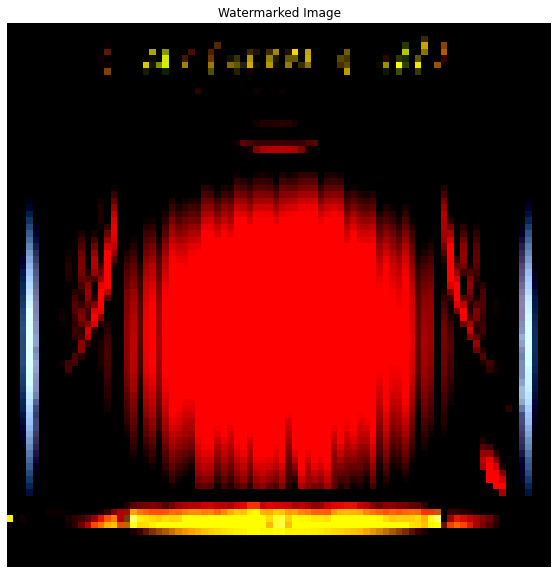

  9%|▉         | 1/11 [00:05<00:55,  5.57s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 1: Target opacity: 0, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: False, Base class predicted: False


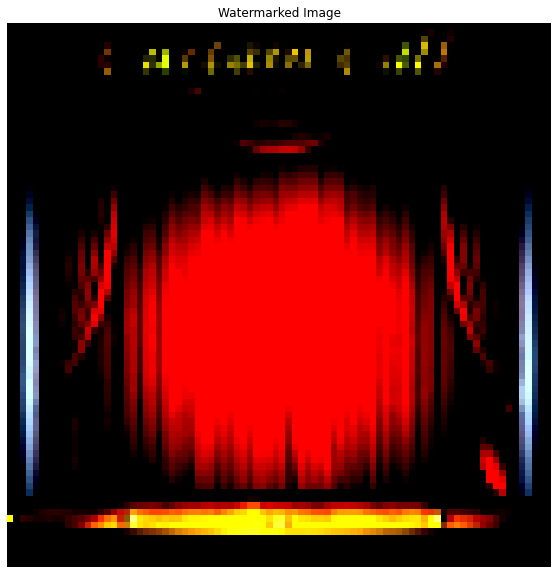

 18%|█▊        | 2/11 [00:11<00:49,  5.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 1: Target opacity: 0.05, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: False, Base class predicted: False


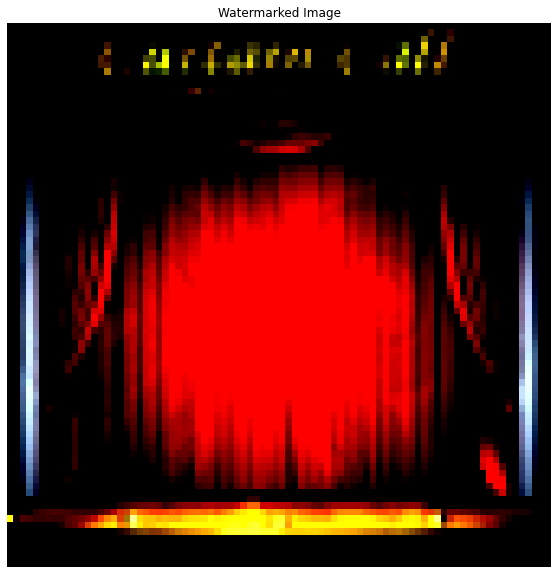

 27%|██▋       | 3/11 [00:16<00:44,  5.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 1: Target opacity: 0.1, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: False, Base class predicted: False


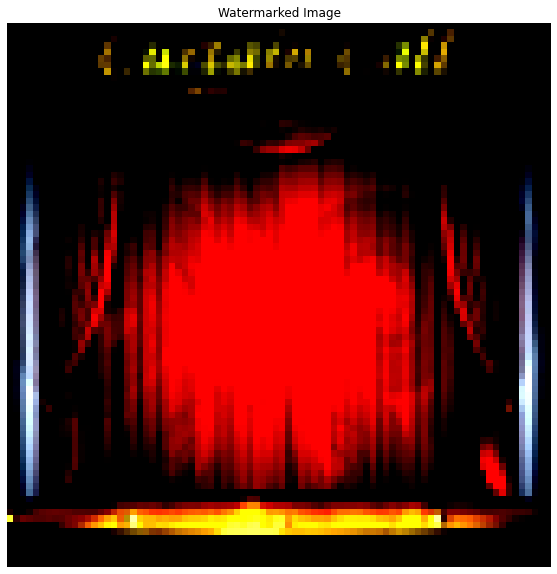

 36%|███▋      | 4/11 [00:21<00:38,  5.48s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 1: Target opacity: 0.15, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: False, Base class predicted: False


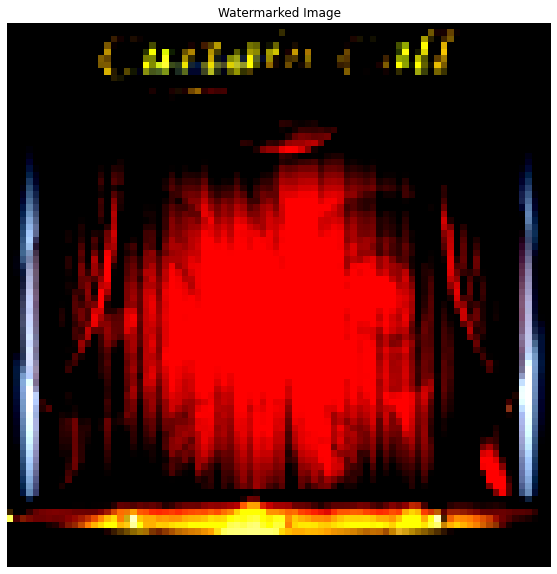

 45%|████▌     | 5/11 [00:27<00:32,  5.40s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 1: Target opacity: 0.2, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: False, Base class predicted: False


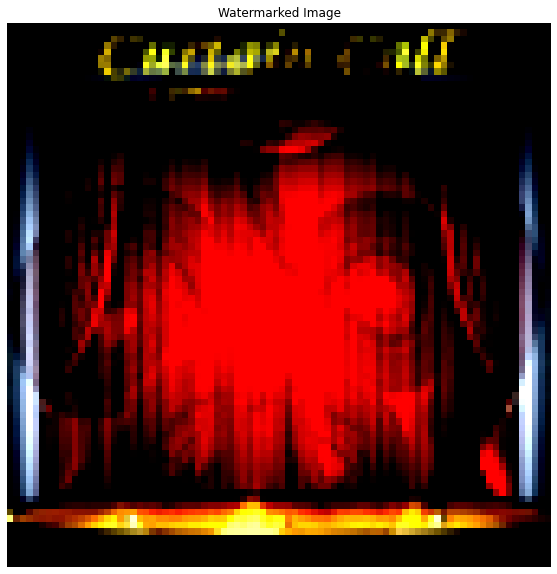

 55%|█████▍    | 6/11 [00:32<00:26,  5.36s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 1: Target opacity: 0.25, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: False, Base class predicted: False


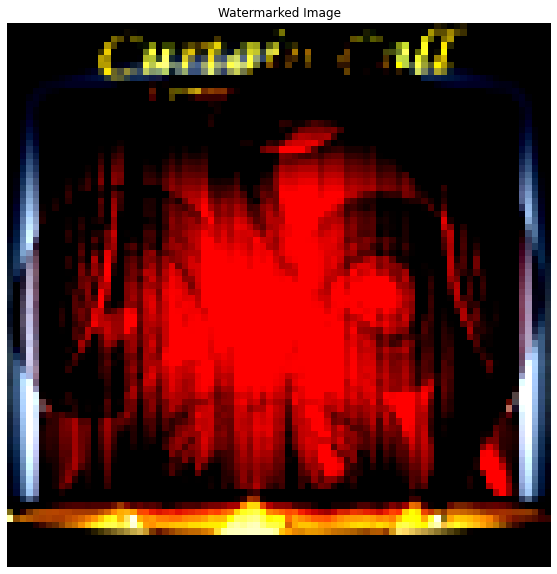

 64%|██████▎   | 7/11 [00:37<00:21,  5.33s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 1: Target opacity: 0.3, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: False, Base class predicted: False


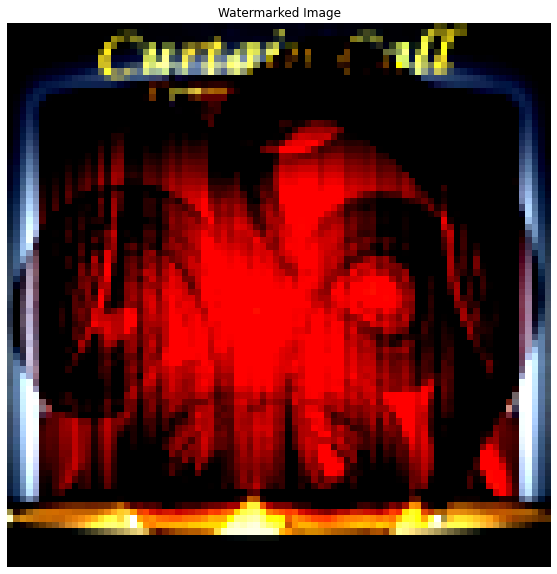

 73%|███████▎  | 8/11 [00:43<00:15,  5.31s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 1: Target opacity: 0.35, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: False, Base class predicted: False


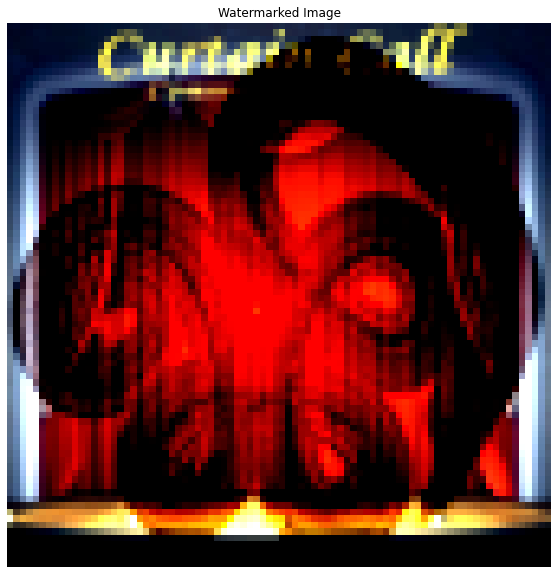

 82%|████████▏ | 9/11 [00:48<00:10,  5.32s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 1: Target opacity: 0.4, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: False, Base class predicted: False


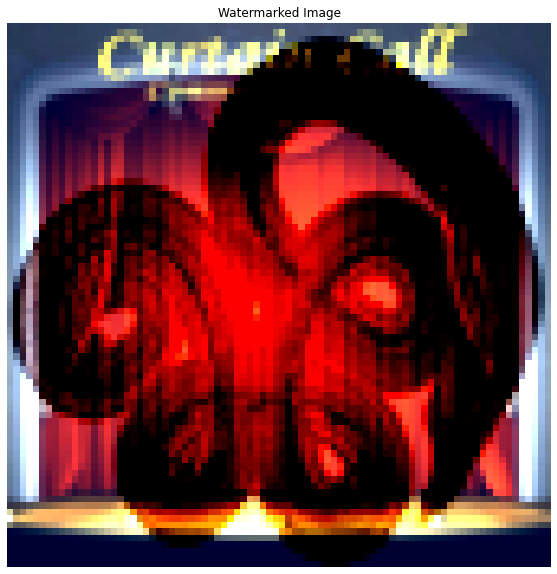

 91%|█████████ | 10/11 [00:53<00:05,  5.30s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 1: Target opacity: 0.45, Labeled correctly: 0.6, Correctly Predicted Target: False, Base class predicted: False


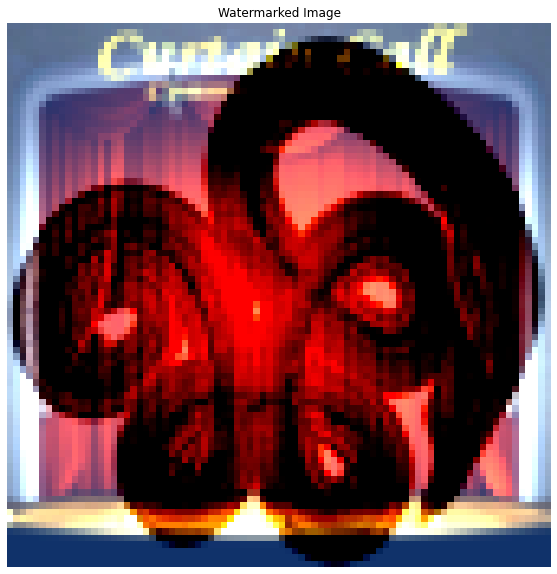

100%|██████████| 11/11 [00:58<00:00,  5.36s/it]

Iteration 1: Target opacity: 0.5, Labeled correctly: 0.6, Correctly Predicted Target: False, Base class predicted: False



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


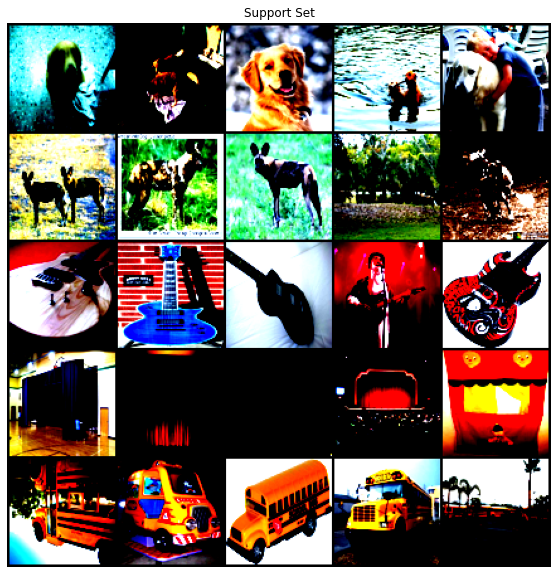

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[4, 4, 4, 4, 4, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 2, 2, 2, 2,
         2]])


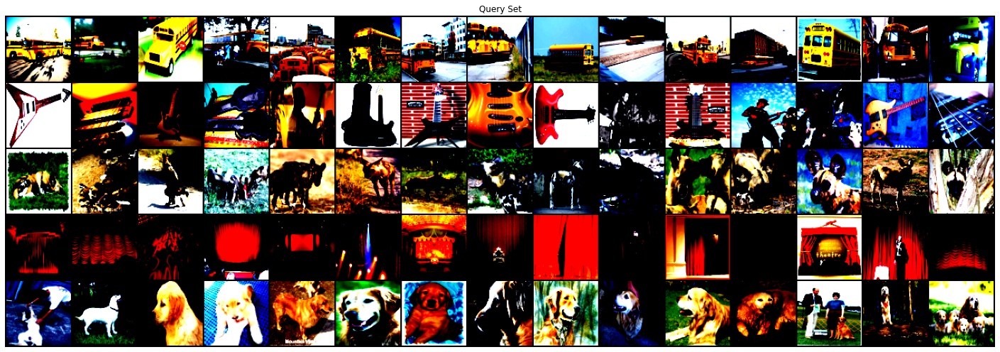

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1,
         1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
         4, 4, 4]])
target_class 2
unique_classes [0, 1, 3, 4]
base_class 1
target_indices [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14]
target_index 13
base_indices [15 16 17 18 19]
base_index 16


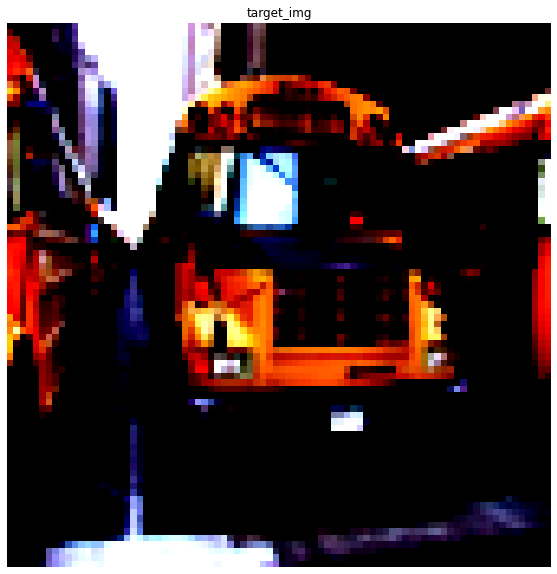

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


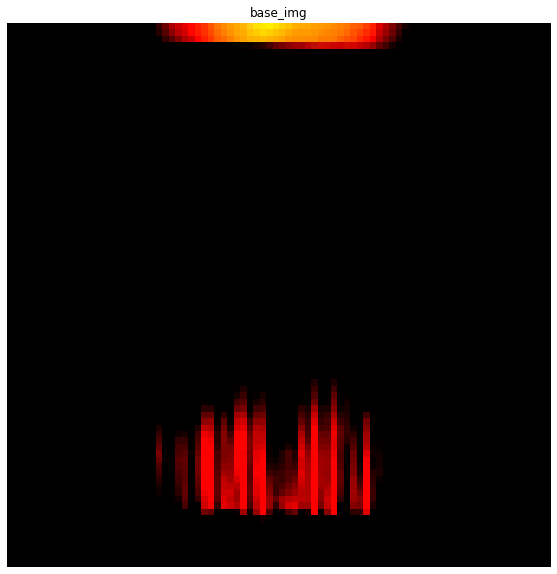

  0%|          | 3/1000 [00:00<00:34, 28.99it/s]

Iteration 0
loss: tensor(7.8924, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(0.2661, grad_fn=<PowBackward0>)
Iteration 2
loss: tensor(0.5578, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(5.3108, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(10.9711, grad_fn=<PowBackward0>)
Iteration 5
loss: tensor(10.9948, grad_fn=<PowBackward0>)


  1%|          | 10/1000 [00:00<00:34, 28.65it/s]

Iteration 6
loss: tensor(17.2325, grad_fn=<PowBackward0>)
Iteration 7
loss: tensor(5.3464, grad_fn=<PowBackward0>)
Iteration 8
loss: tensor(6.0415, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(4.5276, grad_fn=<PowBackward0>)
Iteration 10
loss: tensor(29.7491, grad_fn=<PowBackward0>)
Iteration 11
loss: 

  2%|▏         | 17/1000 [00:00<00:33, 29.16it/s]

tensor(7.8223, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(28.7881, grad_fn=<PowBackward0>)
Iteration 13
loss: tensor(0.9616, grad_fn=<PowBackward0>)
Iteration 14
loss: tensor(33.8101, grad_fn=<PowBackward0>)
Iteration 15
loss: tensor(0.5068, grad_fn=<PowBackward0>)
Iteration 16
loss: tensor(22.7548, grad_fn=<PowBackward0>)
Iteration 17


  2%|▏         | 20/1000 [00:00<00:35, 27.90it/s]

loss: tensor(1.1572, grad_fn=<PowBackward0>)
Iteration 18
loss: tensor(26.4459, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(30.2979, grad_fn=<PowBackward0>)
Iteration 20
loss: tensor(14.5002, grad_fn=<PowBackward0>)
Iteration 21
loss: tensor(5.3259, grad_fn=<PowBackward0>)
Iteration 22
loss: tensor(0.8091, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(1.7178, grad_fn=<PowBackward0>)


  3%|▎         | 27/1000 [00:00<00:35, 27.72it/s]

Iteration 24
loss: tensor(27.5957, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(2.4162, grad_fn=<PowBackward0>)
Iteration 26
loss: tensor(26.1892, grad_fn=<PowBackward0>)
Iteration 27
loss: tensor(1.0011, grad_fn=<PowBackward0>)
Iteration 28
loss: tensor(8.0162, grad_fn=<PowBackward0>)
Iteration 29


  3%|▎         | 33/1000 [00:01<00:35, 27.60it/s]

loss: tensor(6.8745, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(17.8429, grad_fn=<PowBackward0>)
Iteration 31
loss: tensor(1.4060, grad_fn=<PowBackward0>)
Iteration 32
loss: tensor(29.4425, grad_fn=<PowBackward0>)
Iteration 33
loss: tensor(0.5936, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(1.2789, grad_fn=<PowBackward0>)
Iteration 35


  4%|▍         | 39/1000 [00:01<00:34, 27.83it/s]

loss: tensor(24.6241, grad_fn=<PowBackward0>)
Iteration 36
loss: tensor(0.9326, grad_fn=<PowBackward0>)
Iteration 37
loss: tensor(8.8797, grad_fn=<PowBackward0>)
Iteration 38
loss: tensor(6.9568, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(36.6292, grad_fn=<PowBackward0>)
Iteration 40
loss: tensor(8.4442, grad_fn=<PowBackward0>)
Iteration 41


  4%|▍         | 45/1000 [00:01<00:34, 28.02it/s]

loss: tensor(4.5387, grad_fn=<PowBackward0>)
Iteration 42
loss: tensor(6.9248, grad_fn=<PowBackward0>)
Iteration 43
loss: tensor(18.5353, grad_fn=<PowBackward0>)
Iteration 44
loss: tensor(1.6198, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(38.5137, grad_fn=<PowBackward0>)
Iteration 46
loss: tensor(0.2576, grad_fn=<PowBackward0>)
Iteration 47


  5%|▌         | 51/1000 [00:01<00:33, 28.03it/s]

loss: tensor(0.1698, grad_fn=<PowBackward0>)
Iteration 48
loss: tensor(13.1970, grad_fn=<PowBackward0>)
Iteration 49
loss: tensor(0.3137, grad_fn=<PowBackward0>)
Iteration 50
loss: tensor(2.5583, grad_fn=<PowBackward0>)
Iteration 51
loss: tensor(35.6858, grad_fn=<PowBackward0>)
Iteration 52
loss: tensor(0.1033, grad_fn=<PowBackward0>)
Iteration 53


  6%|▌         | 57/1000 [00:02<00:34, 27.12it/s]

loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 54
loss: tensor(7.0817, grad_fn=<PowBackward0>)
Iteration 55
loss: tensor(2.5478, grad_fn=<PowBackward0>)
Iteration 56
loss: tensor(17.0711, grad_fn=<PowBackward0>)
Iteration 57
loss: tensor(0.3945, grad_fn=<PowBackward0>)
Iteration 58
loss: tensor(2.3562, grad_fn=<PowBackward0>)


  6%|▋         | 63/1000 [00:02<00:34, 26.79it/s]

Iteration 59
loss: tensor(40.2486, grad_fn=<PowBackward0>)
Iteration 60
loss: tensor(12.1737, grad_fn=<PowBackward0>)
Iteration 61
loss: tensor(6.6143, grad_fn=<PowBackward0>)
Iteration 62
loss: tensor(5.7059, grad_fn=<PowBackward0>)
Iteration 63
loss: tensor(7.8633, grad_fn=<PowBackward0>)
Iteration 64


  7%|▋         | 69/1000 [00:02<00:34, 27.24it/s]

loss: tensor(26.9149, grad_fn=<PowBackward0>)
Iteration 65
loss: tensor(7.1564, grad_fn=<PowBackward0>)
Iteration 66
loss: tensor(15.4643, grad_fn=<PowBackward0>)
Iteration 67
loss: tensor(0.0114, grad_fn=<PowBackward0>)
Iteration 68
loss: tensor(6.8073, grad_fn=<PowBackward0>)
Iteration 69
loss: tensor(26.2967, grad_fn=<PowBackward0>)


  8%|▊         | 75/1000 [00:02<00:34, 27.10it/s]

Iteration 70
loss: tensor(0.8228, grad_fn=<PowBackward0>)
Iteration 71
loss: tensor(9.5923, grad_fn=<PowBackward0>)
Iteration 72
loss: tensor(15.2326, grad_fn=<PowBackward0>)
Iteration 73
loss: tensor(9.4045, grad_fn=<PowBackward0>)
Iteration 74
loss: tensor(3.9026, grad_fn=<PowBackward0>)
Iteration 75
loss: tensor(1.4409, grad_fn=<PowBackward0>)


  8%|▊         | 78/1000 [00:02<00:35, 26.31it/s]

Iteration 76
loss: tensor(24.0344, grad_fn=<PowBackward0>)
Iteration 77
loss: tensor(3.0312, grad_fn=<PowBackward0>)
Iteration 78
loss: tensor(2.0608, grad_fn=<PowBackward0>)
Iteration 79
loss: tensor(41.8944, grad_fn=<PowBackward0>)
Iteration 80
loss: tensor(4.7407, grad_fn=<PowBackward0>)
Iteration 81
loss: tensor(23.8867, grad_fn=<PowBackward0>)


  8%|▊         | 85/1000 [00:03<00:33, 27.00it/s]

Iteration 82
loss: tensor(28.1815, grad_fn=<PowBackward0>)
Iteration 83
loss: tensor(0.5037, grad_fn=<PowBackward0>)
Iteration 84
loss: tensor(15.8971, grad_fn=<PowBackward0>)
Iteration 85
loss: tensor(2.6142, grad_fn=<PowBackward0>)
Iteration 86
loss: tensor(14.3238, grad_fn=<PowBackward0>)
Iteration 87
loss: 

  9%|▉         | 91/1000 [00:03<00:33, 26.92it/s]

tensor(16.6580, grad_fn=<PowBackward0>)
Iteration 88
loss: tensor(10.1524, grad_fn=<PowBackward0>)
Iteration 89
loss: tensor(5.4119, grad_fn=<PowBackward0>)
Iteration 90
loss: tensor(2.3281, grad_fn=<PowBackward0>)
Iteration 91
loss: tensor(35.2295, grad_fn=<PowBackward0>)
Iteration 92
loss: tensor(0.3856, grad_fn=<PowBackward0>)
Iteration 93


 10%|▉         | 97/1000 [00:03<00:33, 27.18it/s]

loss: tensor(33.6165, grad_fn=<PowBackward0>)
Iteration 94
loss: tensor(13.5877, grad_fn=<PowBackward0>)
Iteration 95
loss: tensor(7.5745, grad_fn=<PowBackward0>)
Iteration 96
loss: tensor(9.6212, grad_fn=<PowBackward0>)
Iteration 97
loss: tensor(1.0146, grad_fn=<PowBackward0>)
Iteration 98
loss: tensor(13.7549, grad_fn=<PowBackward0>)
Iteration 99


 10%|█         | 103/1000 [00:03<00:32, 27.48it/s]

loss: tensor(12.3960, grad_fn=<PowBackward0>)
Iteration 100
loss: tensor(16.6665, grad_fn=<PowBackward0>)
Iteration 101
loss: tensor(2.7010, grad_fn=<PowBackward0>)
Iteration 102
loss: tensor(56.7256, grad_fn=<PowBackward0>)
Iteration 103
loss: tensor(6.4076, grad_fn=<PowBackward0>)
Iteration 104
loss: tensor(10.7438, grad_fn=<PowBackward0>)
Iteration 105


 11%|█         | 109/1000 [00:03<00:32, 27.03it/s]

loss: tensor(46.9052, grad_fn=<PowBackward0>)
Iteration 106
loss: tensor(0.6796, grad_fn=<PowBackward0>)
Iteration 107
loss: tensor(13.6350, grad_fn=<PowBackward0>)
Iteration 108
loss: tensor(22.2490, grad_fn=<PowBackward0>)
Iteration 109
loss: tensor(14.6343, grad_fn=<PowBackward0>)
Iteration 110


 12%|█▏        | 115/1000 [00:04<00:33, 26.04it/s]

loss: tensor(27.1860, grad_fn=<PowBackward0>)
Iteration 111
loss: tensor(13.5634, grad_fn=<PowBackward0>)
Iteration 112
loss: tensor(33.1134, grad_fn=<PowBackward0>)
Iteration 113
loss: tensor(34.3363, grad_fn=<PowBackward0>)
Iteration 114
loss: tensor(8.3809, grad_fn=<PowBackward0>)
Iteration 115
loss: tensor(33.2317, grad_fn=<PowBackward0>)


 12%|█▏        | 121/1000 [00:04<00:33, 26.61it/s]

Iteration 116
loss: tensor(3.2410, grad_fn=<PowBackward0>)
Iteration 117
loss: tensor(22.2140, grad_fn=<PowBackward0>)
Iteration 118
loss: tensor(16.4921, grad_fn=<PowBackward0>)
Iteration 119
loss: tensor(34.5650, grad_fn=<PowBackward0>)
Iteration 120
loss: tensor(0.2569, grad_fn=<PowBackward0>)
Iteration 121
loss: tensor(13.4356, grad_fn=<PowBackward0>)


 13%|█▎        | 127/1000 [00:04<00:32, 27.23it/s]

Iteration 122
loss: tensor(16.3697, grad_fn=<PowBackward0>)
Iteration 123
loss: tensor(12.3645, grad_fn=<PowBackward0>)
Iteration 124
loss: tensor(30.0380, grad_fn=<PowBackward0>)
Iteration 125
loss: tensor(11.9474, grad_fn=<PowBackward0>)
Iteration 126
loss: tensor(13.8508, grad_fn=<PowBackward0>)
Iteration 127
loss: tensor(3.2896, grad_fn=<PowBackward0>)


 13%|█▎        | 134/1000 [00:04<00:30, 28.68it/s]

Iteration 128
loss: tensor(28.5796, grad_fn=<PowBackward0>)
Iteration 129
loss: tensor(0.0324, grad_fn=<PowBackward0>)
Iteration 130
loss: tensor(3.0208, grad_fn=<PowBackward0>)
Iteration 131
loss: tensor(112.3690, grad_fn=<PowBackward0>)
Iteration 132
loss: tensor(3.9132, grad_fn=<PowBackward0>)
Iteration 133
loss: tensor(12.0752, grad_fn=<PowBackward0>)
Iteration 134


 14%|█▎        | 137/1000 [00:05<00:31, 27.01it/s]

loss: tensor(18.3462, grad_fn=<PowBackward0>)
Iteration 135
loss: tensor(15.0656, grad_fn=<PowBackward0>)
Iteration 136
loss: tensor(19.4375, grad_fn=<PowBackward0>)
Iteration 137
loss: tensor(19.7786, grad_fn=<PowBackward0>)
Iteration 138
loss: tensor(44.3828, grad_fn=<PowBackward0>)
Iteration 139
loss: tensor(14.2383, grad_fn=<PowBackward0>)


 14%|█▍        | 143/1000 [00:05<00:32, 26.76it/s]

Iteration 140
loss: tensor(2.8910, grad_fn=<PowBackward0>)
Iteration 141
loss: tensor(46.3748, grad_fn=<PowBackward0>)
Iteration 142
loss: tensor(20.0477, grad_fn=<PowBackward0>)
Iteration 143
loss: tensor(14.7936, grad_fn=<PowBackward0>)
Iteration 144
loss: tensor(24.4030, grad_fn=<PowBackward0>)
Iteration 145
loss: tensor(2.5365, grad_fn=<PowBackward0>)
Iteration 146


 15%|█▌        | 150/1000 [00:05<00:30, 27.58it/s]

loss: tensor(48.7565, grad_fn=<PowBackward0>)
Iteration 147
loss: tensor(0.4406, grad_fn=<PowBackward0>)
Iteration 148
loss: tensor(5.7355, grad_fn=<PowBackward0>)
Iteration 149
loss: tensor(46.4144, grad_fn=<PowBackward0>)
Iteration 150
loss: tensor(5.0748, grad_fn=<PowBackward0>)
Iteration 151
loss: tensor(31.0785, grad_fn=<PowBackward0>)
Iteration 152


 16%|█▌        | 156/1000 [00:05<00:30, 27.50it/s]

loss: tensor(18.0237, grad_fn=<PowBackward0>)
Iteration 153
loss: tensor(36.2359, grad_fn=<PowBackward0>)
Iteration 154
loss: tensor(3.0042, grad_fn=<PowBackward0>)
Iteration 155
loss: tensor(46.0357, grad_fn=<PowBackward0>)
Iteration 156
loss: tensor(0.3907, grad_fn=<PowBackward0>)
Iteration 157
loss: tensor(10.1146, grad_fn=<PowBackward0>)


 16%|█▌        | 162/1000 [00:05<00:30, 27.37it/s]

Iteration 158
loss: tensor(22.3833, grad_fn=<PowBackward0>)
Iteration 159
loss: tensor(33.2294, grad_fn=<PowBackward0>)
Iteration 160
loss: tensor(11.4045, grad_fn=<PowBackward0>)
Iteration 161
loss: tensor(14.5324, grad_fn=<PowBackward0>)
Iteration 162
loss: tensor(26.9628, grad_fn=<PowBackward0>)
Iteration 163
loss: tensor(3.7139, grad_fn=<PowBackward0>)


 17%|█▋        | 168/1000 [00:06<00:30, 27.06it/s]

Iteration 164
loss: tensor(33.4711, grad_fn=<PowBackward0>)
Iteration 165
loss: tensor(13.8900, grad_fn=<PowBackward0>)
Iteration 166
loss: tensor(16.2256, grad_fn=<PowBackward0>)
Iteration 167
loss: tensor(33.3711, grad_fn=<PowBackward0>)
Iteration 168
loss: tensor(19.9226, grad_fn=<PowBackward0>)
Iteration 169


 18%|█▊        | 175/1000 [00:06<00:29, 27.75it/s]

loss: tensor(17.4821, grad_fn=<PowBackward0>)
Iteration 170
loss: tensor(24.8870, grad_fn=<PowBackward0>)
Iteration 171
loss: tensor(6.0829, grad_fn=<PowBackward0>)
Iteration 172
loss: tensor(21.9585, grad_fn=<PowBackward0>)
Iteration 173
loss: tensor(12.3293, grad_fn=<PowBackward0>)
Iteration 174
loss: tensor(30.5160, grad_fn=<PowBackward0>)
Iteration 175


 18%|█▊        | 178/1000 [00:06<00:31, 26.46it/s]

loss: tensor(2.9488, grad_fn=<PowBackward0>)
Iteration 176
loss: tensor(56.8609, grad_fn=<PowBackward0>)
Iteration 177
loss: tensor(0.7294, grad_fn=<PowBackward0>)
Iteration 178
loss: tensor(15.6861, grad_fn=<PowBackward0>)
Iteration 179
loss: tensor(13.6516, grad_fn=<PowBackward0>)
Iteration 180
loss: tensor(7.9803, grad_fn=<PowBackward0>)
Iteration 181


 18%|█▊        | 185/1000 [00:06<00:29, 27.19it/s]

loss: tensor(0.1464, grad_fn=<PowBackward0>)
Iteration 182
loss: tensor(18.6219, grad_fn=<PowBackward0>)
Iteration 183
loss: tensor(11.3361, grad_fn=<PowBackward0>)
Iteration 184
loss: tensor(18.4619, grad_fn=<PowBackward0>)
Iteration 185
loss: tensor(8.8966, grad_fn=<PowBackward0>)
Iteration 186
loss: tensor(15.8527, grad_fn=<PowBackward0>)


 19%|█▉        | 192/1000 [00:07<00:28, 28.56it/s]

Iteration 187
loss: tensor(8.7278, grad_fn=<PowBackward0>)
Iteration 188
loss: tensor(30.8072, grad_fn=<PowBackward0>)
Iteration 189
loss: tensor(11.7493, grad_fn=<PowBackward0>)
Iteration 190
loss: tensor(14.4977, grad_fn=<PowBackward0>)
Iteration 191
loss: tensor(10.4220, grad_fn=<PowBackward0>)
Iteration 192
loss: tensor(23.5815, grad_fn=<PowBackward0>)


 20%|█▉        | 199/1000 [00:07<00:27, 28.74it/s]

Iteration 193
loss: tensor(1.2191, grad_fn=<PowBackward0>)
Iteration 194
loss: tensor(44.2526, grad_fn=<PowBackward0>)
Iteration 195
loss: tensor(8.0410, grad_fn=<PowBackward0>)
Iteration 196
loss: tensor(12.7265, grad_fn=<PowBackward0>)
Iteration 197
loss: tensor(30.0882, grad_fn=<PowBackward0>)
Iteration 198
loss: tensor(10.0922, grad_fn=<PowBackward0>)


 20%|██        | 202/1000 [00:07<00:30, 26.37it/s]

Iteration 199
loss: tensor(24.2245, grad_fn=<PowBackward0>)
Iteration 200
loss: tensor(3.2263, grad_fn=<PowBackward0>)
Iteration 201
loss: tensor(36.5551, grad_fn=<PowBackward0>)
Iteration 202
loss: tensor(50.8097, grad_fn=<PowBackward0>)
Iteration 203
loss: tensor(18.7317, grad_fn=<PowBackward0>)


 21%|██        | 208/1000 [00:07<00:29, 27.17it/s]

Iteration 204
loss: tensor(34.0280, grad_fn=<PowBackward0>)
Iteration 205
loss: tensor(7.2156, grad_fn=<PowBackward0>)
Iteration 206
loss: tensor(26.6153, grad_fn=<PowBackward0>)
Iteration 207
loss: tensor(3.9460, grad_fn=<PowBackward0>)
Iteration 208
loss: tensor(40.5062, grad_fn=<PowBackward0>)
Iteration 209


 21%|██▏       | 214/1000 [00:07<00:28, 27.29it/s]

loss: tensor(26.1040, grad_fn=<PowBackward0>)
Iteration 210
loss: tensor(15.5140, grad_fn=<PowBackward0>)
Iteration 211
loss: tensor(45.7845, grad_fn=<PowBackward0>)
Iteration 212
loss: tensor(5.9610, grad_fn=<PowBackward0>)
Iteration 213
loss: tensor(51.6392, grad_fn=<PowBackward0>)
Iteration 214
loss: tensor(18.9479, grad_fn=<PowBackward0>)
Iteration 215


 22%|██▏       | 221/1000 [00:08<00:27, 28.45it/s]

loss: tensor(27.7314, grad_fn=<PowBackward0>)
Iteration 216
loss: tensor(2.7329, grad_fn=<PowBackward0>)
Iteration 217
loss: tensor(65.8841, grad_fn=<PowBackward0>)
Iteration 218
loss: tensor(1.2521, grad_fn=<PowBackward0>)
Iteration 219
loss: tensor(24.9761, grad_fn=<PowBackward0>)
Iteration 220
loss: tensor(40.0691, grad_fn=<PowBackward0>)
Iteration 221


 23%|██▎       | 227/1000 [00:08<00:27, 27.86it/s]

loss: tensor(22.8496, grad_fn=<PowBackward0>)
Iteration 222
loss: tensor(23.4405, grad_fn=<PowBackward0>)
Iteration 223
loss: tensor(29.6222, grad_fn=<PowBackward0>)
Iteration 224
loss: tensor(21.3838, grad_fn=<PowBackward0>)
Iteration 225
loss: tensor(30.1877, grad_fn=<PowBackward0>)
Iteration 226
loss: tensor(34.5666, grad_fn=<PowBackward0>)
Iteration 227


 23%|██▎       | 233/1000 [00:08<00:27, 27.54it/s]

loss: tensor(12.2681, grad_fn=<PowBackward0>)
Iteration 228
loss: tensor(34.3941, grad_fn=<PowBackward0>)
Iteration 229
loss: tensor(2.3979, grad_fn=<PowBackward0>)
Iteration 230
loss: tensor(27.8223, grad_fn=<PowBackward0>)
Iteration 231
loss: tensor(11.6174, grad_fn=<PowBackward0>)
Iteration 232
loss: tensor(23.4768, grad_fn=<PowBackward0>)
Iteration 233


 24%|██▍       | 239/1000 [00:08<00:27, 27.66it/s]

loss: tensor(52.1156, grad_fn=<PowBackward0>)
Iteration 234
loss: tensor(5.7009, grad_fn=<PowBackward0>)
Iteration 235
loss: tensor(18.4917, grad_fn=<PowBackward0>)
Iteration 236
loss: tensor(26.2817, grad_fn=<PowBackward0>)
Iteration 237
loss: tensor(6.4106, grad_fn=<PowBackward0>)
Iteration 238
loss: tensor(31.8550, grad_fn=<PowBackward0>)
Iteration 239


 24%|██▍       | 245/1000 [00:08<00:27, 27.57it/s]

loss: tensor(28.9872, grad_fn=<PowBackward0>)
Iteration 240
loss: tensor(15.2870, grad_fn=<PowBackward0>)
Iteration 241
loss: tensor(34.9875, grad_fn=<PowBackward0>)
Iteration 242
loss: tensor(10.0816, grad_fn=<PowBackward0>)
Iteration 243
loss: tensor(26.7129, grad_fn=<PowBackward0>)
Iteration 244
loss: tensor(24.6289, grad_fn=<PowBackward0>)
Iteration 245


 25%|██▍       | 248/1000 [00:09<00:27, 27.24it/s]

loss: tensor(27.2498, grad_fn=<PowBackward0>)
Iteration 246
loss: tensor(20.5787, grad_fn=<PowBackward0>)
Iteration 247
loss: tensor(4.7208, grad_fn=<PowBackward0>)
Iteration 248
loss: tensor(13.9313, grad_fn=<PowBackward0>)
Iteration 249
loss: tensor(37.0822, grad_fn=<PowBackward0>)
Iteration 250
loss: tensor(17.7284, grad_fn=<PowBackward0>)


 25%|██▌       | 254/1000 [00:09<00:28, 26.03it/s]

Iteration 251
loss: tensor(15.7384, grad_fn=<PowBackward0>)
Iteration 252
loss: tensor(12.5115, grad_fn=<PowBackward0>)
Iteration 253
loss: tensor(3.2422, grad_fn=<PowBackward0>)
Iteration 254
loss: tensor(45.3988, grad_fn=<PowBackward0>)
Iteration 255
loss: tensor(3.7366, grad_fn=<PowBackward0>)
Iteration 256


 26%|██▌       | 260/1000 [00:09<00:28, 25.95it/s]

loss: tensor(44.0513, grad_fn=<PowBackward0>)
Iteration 257
loss: tensor(0.6359, grad_fn=<PowBackward0>)
Iteration 258
loss: tensor(27.2116, grad_fn=<PowBackward0>)
Iteration 259
loss: tensor(28.4678, grad_fn=<PowBackward0>)
Iteration 260
loss: tensor(24.8417, grad_fn=<PowBackward0>)
Iteration 261


 27%|██▋       | 267/1000 [00:09<00:26, 27.94it/s]

loss: tensor(16.4245, grad_fn=<PowBackward0>)
Iteration 262
loss: tensor(49.9043, grad_fn=<PowBackward0>)
Iteration 263
loss: tensor(10.3778, grad_fn=<PowBackward0>)
Iteration 264
loss: tensor(13.1415, grad_fn=<PowBackward0>)
Iteration 265
loss: tensor(36.6058, grad_fn=<PowBackward0>)
Iteration 266
loss: tensor(18.3570, grad_fn=<PowBackward0>)
Iteration 267
loss: tensor(7.5999, grad_fn=<PowBackward0>)


 27%|██▋       | 273/1000 [00:10<00:25, 27.98it/s]

Iteration 268
loss: tensor(11.3894, grad_fn=<PowBackward0>)
Iteration 269
loss: tensor(26.4625, grad_fn=<PowBackward0>)
Iteration 270
loss: tensor(8.5046, grad_fn=<PowBackward0>)
Iteration 271
loss: tensor(35.8709, grad_fn=<PowBackward0>)
Iteration 272
loss: tensor(22.8301, grad_fn=<PowBackward0>)
Iteration 273
loss: tensor(8.1206, grad_fn=<PowBackward0>)


 28%|██▊       | 279/1000 [00:10<00:26, 27.55it/s]

Iteration 274
loss: tensor(37.0176, grad_fn=<PowBackward0>)
Iteration 275
loss: tensor(0.1564, grad_fn=<PowBackward0>)
Iteration 276
loss: tensor(11.9258, grad_fn=<PowBackward0>)
Iteration 277
loss: tensor(16.9542, grad_fn=<PowBackward0>)
Iteration 278
loss: tensor(18.5220, grad_fn=<PowBackward0>)
Iteration 279


 28%|██▊       | 282/1000 [00:10<00:26, 26.92it/s]

loss: tensor(11.5607, grad_fn=<PowBackward0>)
Iteration 280
loss: tensor(41.4046, grad_fn=<PowBackward0>)
Iteration 281
loss: tensor(6.8136, grad_fn=<PowBackward0>)
Iteration 282
loss: tensor(21.2395, grad_fn=<PowBackward0>)
Iteration 283
loss: tensor(22.6596, grad_fn=<PowBackward0>)
Iteration 284
loss: tensor(25.3218, grad_fn=<PowBackward0>)
Iteration 285
loss: tensor(8.9516, grad_fn=<PowBackward0>)


 29%|██▉       | 289/1000 [00:10<00:25, 28.11it/s]

Iteration 286
loss: tensor(14.0751, grad_fn=<PowBackward0>)
Iteration 287
loss: tensor(30.2163, grad_fn=<PowBackward0>)
Iteration 288
loss: tensor(20.9437, grad_fn=<PowBackward0>)
Iteration 289
loss: tensor(24.5370, grad_fn=<PowBackward0>)
Iteration 290
loss: tensor(6.4841, grad_fn=<PowBackward0>)
Iteration 291
loss: tensor(24.5630, grad_fn=<PowBackward0>)


 30%|██▉       | 295/1000 [00:10<00:25, 27.33it/s]

Iteration 292
loss: tensor(35.5436, grad_fn=<PowBackward0>)
Iteration 293
loss: tensor(19.2821, grad_fn=<PowBackward0>)
Iteration 294
loss: tensor(24.6138, grad_fn=<PowBackward0>)
Iteration 295
loss: tensor(35.5220, grad_fn=<PowBackward0>)
Iteration 296
loss: tensor(17.5649, grad_fn=<PowBackward0>)
Iteration 297
loss: tensor(42.9684, grad_fn=<PowBackward0>)
Iteration 298


 30%|███       | 302/1000 [00:11<00:24, 28.23it/s]

loss: tensor(8.0483, grad_fn=<PowBackward0>)
Iteration 299
loss: tensor(23.5263, grad_fn=<PowBackward0>)
Iteration 300
loss: tensor(23.2941, grad_fn=<PowBackward0>)
Iteration 301
loss: tensor(30.4289, grad_fn=<PowBackward0>)
Iteration 302
loss: tensor(14.7958, grad_fn=<PowBackward0>)
Iteration 303
loss: tensor(21.4269, grad_fn=<PowBackward0>)
Iteration 304


 31%|███       | 308/1000 [00:11<00:25, 27.53it/s]

loss: tensor(33.0690, grad_fn=<PowBackward0>)
Iteration 305
loss: tensor(18.2661, grad_fn=<PowBackward0>)
Iteration 306
loss: tensor(30.1862, grad_fn=<PowBackward0>)
Iteration 307
loss: tensor(4.9021, grad_fn=<PowBackward0>)
Iteration 308
loss: tensor(25.1812, grad_fn=<PowBackward0>)
Iteration 309
loss: tensor(15.1181, grad_fn=<PowBackward0>)


 31%|███▏      | 314/1000 [00:11<00:25, 27.22it/s]

Iteration 310
loss: tensor(26.9256, grad_fn=<PowBackward0>)
Iteration 311
loss: tensor(7.5309, grad_fn=<PowBackward0>)
Iteration 312
loss: tensor(22.9963, grad_fn=<PowBackward0>)
Iteration 313
loss: tensor(11.5029, grad_fn=<PowBackward0>)
Iteration 314
loss: tensor(17.5664, grad_fn=<PowBackward0>)
Iteration 315
loss: tensor(20.1799, grad_fn=<PowBackward0>)


 32%|███▏      | 320/1000 [00:11<00:25, 27.13it/s]

Iteration 316
loss: tensor(31.3884, grad_fn=<PowBackward0>)
Iteration 317
loss: tensor(12.3009, grad_fn=<PowBackward0>)
Iteration 318
loss: tensor(20.1744, grad_fn=<PowBackward0>)
Iteration 319
loss: tensor(12.1421, grad_fn=<PowBackward0>)
Iteration 320
loss: tensor(31.3817, grad_fn=<PowBackward0>)
Iteration 321


 33%|███▎      | 326/1000 [00:11<00:24, 27.15it/s]

loss: tensor(0.5793, grad_fn=<PowBackward0>)
Iteration 322
loss: tensor(14.9741, grad_fn=<PowBackward0>)
Iteration 323
loss: tensor(36.9728, grad_fn=<PowBackward0>)
Iteration 324
loss: tensor(10.8504, grad_fn=<PowBackward0>)
Iteration 325
loss: tensor(34.9112, grad_fn=<PowBackward0>)
Iteration 326
loss: tensor(26.8505, grad_fn=<PowBackward0>)
Iteration 327


 33%|███▎      | 333/1000 [00:12<00:23, 28.37it/s]

loss: tensor(18.4515, grad_fn=<PowBackward0>)
Iteration 328
loss: tensor(15.7825, grad_fn=<PowBackward0>)
Iteration 329
loss: tensor(26.2779, grad_fn=<PowBackward0>)
Iteration 330
loss: tensor(10.5425, grad_fn=<PowBackward0>)
Iteration 331
loss: tensor(6.1836, grad_fn=<PowBackward0>)
Iteration 332
loss: tensor(25.5750, grad_fn=<PowBackward0>)
Iteration 333


 34%|███▎      | 336/1000 [00:12<00:24, 27.15it/s]

loss: tensor(18.0344, grad_fn=<PowBackward0>)
Iteration 334
loss: tensor(20.7038, grad_fn=<PowBackward0>)
Iteration 335
loss: tensor(16.7594, grad_fn=<PowBackward0>)
Iteration 336
loss: tensor(6.5538, grad_fn=<PowBackward0>)
Iteration 337
loss: tensor(20.8741, grad_fn=<PowBackward0>)
Iteration 338
loss: tensor(15.6533, grad_fn=<PowBackward0>)


 34%|███▍      | 342/1000 [00:12<00:24, 26.34it/s]

Iteration 339
loss: tensor(14.9606, grad_fn=<PowBackward0>)
Iteration 340
loss: tensor(31.1817, grad_fn=<PowBackward0>)
Iteration 341
loss: tensor(14.3082, grad_fn=<PowBackward0>)
Iteration 342
loss: tensor(21.2691, grad_fn=<PowBackward0>)
Iteration 343
loss: tensor(31.9144, grad_fn=<PowBackward0>)
Iteration 344
loss: tensor(7.3176, grad_fn=<PowBackward0>)


 35%|███▍      | 348/1000 [00:12<00:24, 26.57it/s]

Iteration 345
loss: tensor(26.0652, grad_fn=<PowBackward0>)
Iteration 346
loss: tensor(20.6884, grad_fn=<PowBackward0>)
Iteration 347
loss: tensor(8.7265, grad_fn=<PowBackward0>)
Iteration 348
loss: tensor(22.5723, grad_fn=<PowBackward0>)
Iteration 349
loss: tensor(13.3044, grad_fn=<PowBackward0>)
Iteration 350
loss: tensor(19.9033, grad_fn=<PowBackward0>)


 35%|███▌      | 354/1000 [00:12<00:23, 27.17it/s]

Iteration 351
loss: tensor(7.2038, grad_fn=<PowBackward0>)
Iteration 352
loss: tensor(30.7289, grad_fn=<PowBackward0>)
Iteration 353
loss: tensor(19.9400, grad_fn=<PowBackward0>)
Iteration 354
loss: tensor(9.2789, grad_fn=<PowBackward0>)
Iteration 355
loss: tensor(26.8475, grad_fn=<PowBackward0>)
Iteration 356
loss: tensor(23.4888, grad_fn=<PowBackward0>)
Iteration 357


 36%|███▌      | 361/1000 [00:13<00:22, 27.85it/s]

loss: tensor(11.3888, grad_fn=<PowBackward0>)
Iteration 358
loss: tensor(7.8598, grad_fn=<PowBackward0>)
Iteration 359
loss: tensor(25.1786, grad_fn=<PowBackward0>)
Iteration 360
loss: tensor(24.1025, grad_fn=<PowBackward0>)
Iteration 361
loss: tensor(8.4762, grad_fn=<PowBackward0>)
Iteration 362
loss: tensor(30.4139, grad_fn=<PowBackward0>)


 37%|███▋      | 367/1000 [00:13<00:23, 26.95it/s]

Iteration 363
loss: tensor(17.3637, grad_fn=<PowBackward0>)
Iteration 364
loss: tensor(14.7419, grad_fn=<PowBackward0>)
Iteration 365
loss: tensor(33.2388, grad_fn=<PowBackward0>)
Iteration 366
loss: tensor(20.9380, grad_fn=<PowBackward0>)
Iteration 367
loss: tensor(21.1798, grad_fn=<PowBackward0>)
Iteration 368


 37%|███▋      | 374/1000 [00:13<00:22, 28.43it/s]

loss: tensor(11.0969, grad_fn=<PowBackward0>)
Iteration 369
loss: tensor(32.1899, grad_fn=<PowBackward0>)
Iteration 370
loss: tensor(13.8183, grad_fn=<PowBackward0>)
Iteration 371
loss: tensor(13.5551, grad_fn=<PowBackward0>)
Iteration 372
loss: tensor(25.1524, grad_fn=<PowBackward0>)
Iteration 373
loss: tensor(7.1564, grad_fn=<PowBackward0>)
Iteration 374


 38%|███▊      | 377/1000 [00:13<00:22, 27.54it/s]

loss: tensor(22.0291, grad_fn=<PowBackward0>)
Iteration 375
loss: tensor(10.4000, grad_fn=<PowBackward0>)
Iteration 376
loss: tensor(18.7876, grad_fn=<PowBackward0>)
Iteration 377
loss: tensor(18.1175, grad_fn=<PowBackward0>)
Iteration 378
loss: tensor(13.5769, grad_fn=<PowBackward0>)
Iteration 379
loss: tensor(45.4950, grad_fn=<PowBackward0>)
Iteration 380
loss: 

 38%|███▊      | 384/1000 [00:14<00:22, 27.44it/s]

tensor(25.9958, grad_fn=<PowBackward0>)
Iteration 381
loss: tensor(14.2780, grad_fn=<PowBackward0>)
Iteration 382
loss: tensor(36.5785, grad_fn=<PowBackward0>)
Iteration 383
loss: tensor(13.2260, grad_fn=<PowBackward0>)
Iteration 384
loss: tensor(36.2178, grad_fn=<PowBackward0>)
Iteration 385
loss: tensor(12.4917, grad_fn=<PowBackward0>)


 39%|███▉      | 390/1000 [00:14<00:23, 26.34it/s]

Iteration 386
loss: tensor(16.2037, grad_fn=<PowBackward0>)
Iteration 387
loss: tensor(22.0245, grad_fn=<PowBackward0>)
Iteration 388
loss: tensor(12.7618, grad_fn=<PowBackward0>)
Iteration 389
loss: tensor(21.6956, grad_fn=<PowBackward0>)
Iteration 390
loss: tensor(19.9782, grad_fn=<PowBackward0>)


 40%|███▉      | 396/1000 [00:14<00:23, 26.05it/s]

Iteration 391
loss: tensor(6.6315, grad_fn=<PowBackward0>)
Iteration 392
loss: tensor(29.7258, grad_fn=<PowBackward0>)
Iteration 393
loss: tensor(8.3723, grad_fn=<PowBackward0>)
Iteration 394
loss: tensor(9.0839, grad_fn=<PowBackward0>)
Iteration 395
loss: tensor(14.5945, grad_fn=<PowBackward0>)
Iteration 396


 40%|███▉      | 399/1000 [00:14<00:23, 25.58it/s]

loss: tensor(18.2116, grad_fn=<PowBackward0>)
Iteration 397
loss: tensor(21.5926, grad_fn=<PowBackward0>)
Iteration 398
loss: tensor(15.3825, grad_fn=<PowBackward0>)
Iteration 399
loss: tensor(15.7321, grad_fn=<PowBackward0>)
Iteration 400
loss: tensor(21.4675, grad_fn=<PowBackward0>)
Iteration 401
loss: tensor(30.3900, grad_fn=<PowBackward0>)


 40%|████      | 405/1000 [00:14<00:23, 25.72it/s]

Iteration 402
loss: tensor(18.3082, grad_fn=<PowBackward0>)
Iteration 403
loss: tensor(10.5791, grad_fn=<PowBackward0>)
Iteration 404
loss: tensor(15.4549, grad_fn=<PowBackward0>)
Iteration 405
loss: tensor(11.8216, grad_fn=<PowBackward0>)
Iteration 406
loss: tensor(7.2235, grad_fn=<PowBackward0>)
Iteration 407
loss: tensor(5.6102, grad_fn=<PowBackward0>)


 41%|████      | 412/1000 [00:15<00:21, 27.15it/s]

Iteration 408
loss: tensor(8.8840, grad_fn=<PowBackward0>)
Iteration 409
loss: tensor(12.2081, grad_fn=<PowBackward0>)
Iteration 410
loss: tensor(6.8359, grad_fn=<PowBackward0>)
Iteration 411
loss: tensor(9.2147, grad_fn=<PowBackward0>)
Iteration 412
loss: tensor(15.4246, grad_fn=<PowBackward0>)
Iteration 413
loss: 

 42%|████▏     | 418/1000 [00:15<00:21, 26.49it/s]

tensor(10.0964, grad_fn=<PowBackward0>)
Iteration 414
loss: tensor(13.8264, grad_fn=<PowBackward0>)
Iteration 415
loss: tensor(24.8420, grad_fn=<PowBackward0>)
Iteration 416
loss: tensor(9.8138, grad_fn=<PowBackward0>)
Iteration 417
loss: tensor(16.2968, grad_fn=<PowBackward0>)
Iteration 418
loss: tensor(32.8979, grad_fn=<PowBackward0>)


 42%|████▏     | 424/1000 [00:15<00:21, 26.59it/s]

Iteration 419
loss: tensor(8.8805, grad_fn=<PowBackward0>)
Iteration 420
loss: tensor(10.7668, grad_fn=<PowBackward0>)
Iteration 421
loss: tensor(12.9777, grad_fn=<PowBackward0>)
Iteration 422
loss: tensor(9.4149, grad_fn=<PowBackward0>)
Iteration 423
loss: tensor(9.8554, grad_fn=<PowBackward0>)
Iteration 424


 43%|████▎     | 430/1000 [00:15<00:21, 26.81it/s]

loss: tensor(10.5184, grad_fn=<PowBackward0>)
Iteration 425
loss: tensor(5.9308, grad_fn=<PowBackward0>)
Iteration 426
loss: tensor(8.6771, grad_fn=<PowBackward0>)
Iteration 427
loss: tensor(3.5766, grad_fn=<PowBackward0>)
Iteration 428
loss: tensor(16.2489, grad_fn=<PowBackward0>)
Iteration 429
loss: tensor(20.0590, grad_fn=<PowBackward0>)
Iteration 430


 44%|████▎     | 436/1000 [00:16<00:20, 27.18it/s]

loss: tensor(10.1413, grad_fn=<PowBackward0>)
Iteration 431
loss: tensor(18.1262, grad_fn=<PowBackward0>)
Iteration 432
loss: tensor(9.6676, grad_fn=<PowBackward0>)
Iteration 433
loss: tensor(14.1327, grad_fn=<PowBackward0>)
Iteration 434
loss: tensor(14.6066, grad_fn=<PowBackward0>)
Iteration 435
loss: tensor(30.1555, grad_fn=<PowBackward0>)
Iteration 436


 44%|████▍     | 439/1000 [00:16<00:20, 26.77it/s]

loss: tensor(11.1446, grad_fn=<PowBackward0>)
Iteration 437
loss: tensor(14.0788, grad_fn=<PowBackward0>)
Iteration 438
loss: tensor(20.6538, grad_fn=<PowBackward0>)
Iteration 439
loss: tensor(13.5003, grad_fn=<PowBackward0>)
Iteration 440
loss: tensor(13.4681, grad_fn=<PowBackward0>)
Iteration 441


 44%|████▍     | 445/1000 [00:16<00:21, 25.67it/s]

loss: tensor(16.9390, grad_fn=<PowBackward0>)
Iteration 442
loss: tensor(10.7870, grad_fn=<PowBackward0>)
Iteration 443
loss: tensor(6.8435, grad_fn=<PowBackward0>)
Iteration 444
loss: tensor(14.5683, grad_fn=<PowBackward0>)
Iteration 445
loss: tensor(17.5701, grad_fn=<PowBackward0>)
Iteration 446
loss: tensor(22.9372, grad_fn=<PowBackward0>)


 45%|████▌     | 451/1000 [00:16<00:20, 26.63it/s]

Iteration 447
loss: tensor(12.9979, grad_fn=<PowBackward0>)
Iteration 448
loss: tensor(10.0392, grad_fn=<PowBackward0>)
Iteration 449
loss: tensor(14.7509, grad_fn=<PowBackward0>)
Iteration 450
loss: tensor(7.5606, grad_fn=<PowBackward0>)
Iteration 451
loss: tensor(5.0144, grad_fn=<PowBackward0>)
Iteration 452
loss: tensor(7.3043, grad_fn=<PowBackward0>)


 46%|████▌     | 457/1000 [00:16<00:20, 27.06it/s]

Iteration 453
loss: tensor(6.8537, grad_fn=<PowBackward0>)
Iteration 454
loss: tensor(8.9162, grad_fn=<PowBackward0>)
Iteration 455
loss: tensor(7.9581, grad_fn=<PowBackward0>)
Iteration 456
loss: tensor(4.9011, grad_fn=<PowBackward0>)
Iteration 457
loss: tensor(9.6053, grad_fn=<PowBackward0>)
Iteration 458
loss: tensor(11.5658, grad_fn=<PowBackward0>)


 46%|████▋     | 463/1000 [00:17<00:19, 27.03it/s]

Iteration 459
loss: tensor(6.3860, grad_fn=<PowBackward0>)
Iteration 460
loss: tensor(16.2588, grad_fn=<PowBackward0>)
Iteration 461
loss: tensor(12.1209, grad_fn=<PowBackward0>)
Iteration 462
loss: tensor(14.6205, grad_fn=<PowBackward0>)
Iteration 463
loss: tensor(5.9284, grad_fn=<PowBackward0>)
Iteration 464


 47%|████▋     | 469/1000 [00:17<00:20, 26.28it/s]

loss: tensor(18.1729, grad_fn=<PowBackward0>)
Iteration 465
loss: tensor(12.3852, grad_fn=<PowBackward0>)
Iteration 466
loss: tensor(8.4133, grad_fn=<PowBackward0>)
Iteration 467
loss: tensor(11.4349, grad_fn=<PowBackward0>)
Iteration 468
loss: tensor(7.8372, grad_fn=<PowBackward0>)
Iteration 469
loss: tensor(20.2319, grad_fn=<PowBackward0>)


 48%|████▊     | 475/1000 [00:17<00:20, 25.44it/s]

Iteration 470
loss: tensor(8.7743, grad_fn=<PowBackward0>)
Iteration 471
loss: tensor(10.8943, grad_fn=<PowBackward0>)
Iteration 472
loss: tensor(14.9883, grad_fn=<PowBackward0>)
Iteration 473
loss: tensor(5.6429, grad_fn=<PowBackward0>)
Iteration 474
loss: tensor(10.3664, grad_fn=<PowBackward0>)
Iteration 475


 48%|████▊     | 481/1000 [00:17<00:19, 26.02it/s]

loss: tensor(6.2705, grad_fn=<PowBackward0>)
Iteration 476
loss: tensor(9.5100, grad_fn=<PowBackward0>)
Iteration 477
loss: tensor(6.5276, grad_fn=<PowBackward0>)
Iteration 478
loss: tensor(5.3261, grad_fn=<PowBackward0>)
Iteration 479
loss: tensor(6.7578, grad_fn=<PowBackward0>)
Iteration 480
loss: tensor(5.0244, grad_fn=<PowBackward0>)


 48%|████▊     | 484/1000 [00:17<00:20, 25.23it/s]

Iteration 481
loss: tensor(9.0124, grad_fn=<PowBackward0>)
Iteration 482
loss: tensor(10.2943, grad_fn=<PowBackward0>)
Iteration 483
loss: tensor(5.7917, grad_fn=<PowBackward0>)
Iteration 484
loss: tensor(7.9703, grad_fn=<PowBackward0>)
Iteration 485
loss: tensor(6.9543, grad_fn=<PowBackward0>)
Iteration 486
loss: tensor(9.8098, grad_fn=<PowBackward0>)


 49%|████▉     | 490/1000 [00:18<00:19, 26.15it/s]

Iteration 487
loss: tensor(10.3381, grad_fn=<PowBackward0>)
Iteration 488
loss: tensor(9.0956, grad_fn=<PowBackward0>)
Iteration 489
loss: tensor(7.9340, grad_fn=<PowBackward0>)
Iteration 490
loss: tensor(10.8662, grad_fn=<PowBackward0>)
Iteration 491
loss: tensor(9.6681, grad_fn=<PowBackward0>)
Iteration 492
loss: tensor(11.6492, grad_fn=<PowBackward0>)


 50%|████▉     | 496/1000 [00:18<00:20, 25.04it/s]

Iteration 493
loss: tensor(10.4906, grad_fn=<PowBackward0>)
Iteration 494
loss: tensor(9.3911, grad_fn=<PowBackward0>)
Iteration 495
loss: tensor(2.5229, grad_fn=<PowBackward0>)
Iteration 496
loss: tensor(15.8219, grad_fn=<PowBackward0>)
Iteration 497
loss: tensor(4.8256, grad_fn=<PowBackward0>)


 50%|█████     | 502/1000 [00:18<00:18, 26.22it/s]

Iteration 498
loss: tensor(6.7762, grad_fn=<PowBackward0>)
Iteration 499
loss: tensor(6.7804, grad_fn=<PowBackward0>)
Iteration 500
loss: tensor(18.8747, grad_fn=<PowBackward0>)
Iteration 501
loss: tensor(5.0540, grad_fn=<PowBackward0>)
Iteration 502
loss: tensor(2.9146, grad_fn=<PowBackward0>)
Iteration 503


 51%|█████     | 508/1000 [00:18<00:18, 26.93it/s]

loss: tensor(2.6942, grad_fn=<PowBackward0>)
Iteration 504
loss: tensor(1.9650, grad_fn=<PowBackward0>)
Iteration 505
loss: tensor(0.8196, grad_fn=<PowBackward0>)
Iteration 506
loss: tensor(0.4890, grad_fn=<PowBackward0>)
Iteration 507
loss: tensor(0.2598, grad_fn=<PowBackward0>)
Iteration 508
loss: tensor(0.3277, grad_fn=<PowBackward0>)


 51%|█████▏    | 514/1000 [00:19<00:18, 26.92it/s]

Iteration 509
loss: tensor(0.3420, grad_fn=<PowBackward0>)
Iteration 510
loss: tensor(0.7115, grad_fn=<PowBackward0>)
Iteration 511
loss: tensor(1.1487, grad_fn=<PowBackward0>)
Iteration 512
loss: tensor(4.0045, grad_fn=<PowBackward0>)
Iteration 513
loss: tensor(4.3786, grad_fn=<PowBackward0>)
Iteration 514
loss: tensor(5.1600, grad_fn=<PowBackward0>)


 52%|█████▏    | 520/1000 [00:19<00:17, 27.34it/s]

Iteration 515
loss: tensor(3.9830, grad_fn=<PowBackward0>)
Iteration 516
loss: tensor(4.9328, grad_fn=<PowBackward0>)
Iteration 517
loss: tensor(3.0335, grad_fn=<PowBackward0>)
Iteration 518
loss: tensor(4.2871, grad_fn=<PowBackward0>)
Iteration 519
loss: tensor(3.1357, grad_fn=<PowBackward0>)
Iteration 520
loss:

 52%|█████▏    | 523/1000 [00:19<00:17, 26.59it/s]

 tensor(3.3677, grad_fn=<PowBackward0>)
Iteration 521
loss: tensor(1.3351, grad_fn=<PowBackward0>)
Iteration 522
loss: tensor(1.6617, grad_fn=<PowBackward0>)
Iteration 523
loss: tensor(1.4893, grad_fn=<PowBackward0>)
Iteration 524
loss: tensor(2.3596, grad_fn=<PowBackward0>)
Iteration 525
loss: tensor(2.9339, grad_fn=<PowBackward0>)


 53%|█████▎    | 529/1000 [00:19<00:18, 25.56it/s]

Iteration 526
loss: tensor(6.1988, grad_fn=<PowBackward0>)
Iteration 527
loss: tensor(3.4367, grad_fn=<PowBackward0>)
Iteration 528
loss: tensor(4.3129, grad_fn=<PowBackward0>)
Iteration 529
loss: tensor(3.4943, grad_fn=<PowBackward0>)
Iteration 530
loss: tensor(3.3414, grad_fn=<PowBackward0>)
Iteration 531


 54%|█████▎    | 535/1000 [00:19<00:17, 26.58it/s]

loss: tensor(2.1809, grad_fn=<PowBackward0>)
Iteration 532
loss: tensor(2.3960, grad_fn=<PowBackward0>)
Iteration 533
loss: tensor(1.7761, grad_fn=<PowBackward0>)
Iteration 534
loss: tensor(1.8827, grad_fn=<PowBackward0>)
Iteration 535
loss: tensor(1.8718, grad_fn=<PowBackward0>)
Iteration 536
loss: tensor(1.2938, grad_fn=<PowBackward0>)
Iteration 537


 54%|█████▍    | 541/1000 [00:20<00:17, 26.25it/s]

loss: tensor(0.7999, grad_fn=<PowBackward0>)
Iteration 538
loss: tensor(1.0417, grad_fn=<PowBackward0>)
Iteration 539
loss: tensor(0.9799, grad_fn=<PowBackward0>)
Iteration 540
loss: tensor(1.6828, grad_fn=<PowBackward0>)
Iteration 541
loss: tensor(2.3563, grad_fn=<PowBackward0>)
Iteration 542
loss: tensor(3.9366, grad_fn=<PowBackward0>)


 55%|█████▍    | 547/1000 [00:20<00:16, 26.90it/s]

Iteration 543
loss: tensor(2.9681, grad_fn=<PowBackward0>)
Iteration 544
loss: tensor(2.8902, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(2.3113, grad_fn=<PowBackward0>)
Iteration 546
loss: tensor(3.2274, grad_fn=<PowBackward0>)
Iteration 547
loss: tensor(1.0955, grad_fn=<PowBackward0>)
Iteration 548
loss: tensor(1.3674, grad_fn=<PowBackward0>)


 55%|█████▌    | 553/1000 [00:20<00:16, 26.63it/s]

Iteration 549
loss: tensor(1.2175, grad_fn=<PowBackward0>)
Iteration 550
loss: tensor(1.2389, grad_fn=<PowBackward0>)
Iteration 551
loss: tensor(0.9968, grad_fn=<PowBackward0>)
Iteration 552
loss: tensor(1.1682, grad_fn=<PowBackward0>)
Iteration 553
loss: tensor(0.7517, grad_fn=<PowBackward0>)
Iteration 554
loss: tensor(1.2893, grad_fn=<PowBackward0>)


 56%|█████▌    | 559/1000 [00:20<00:16, 26.62it/s]

Iteration 555
loss: tensor(1.0530, grad_fn=<PowBackward0>)
Iteration 556
loss: tensor(1.7842, grad_fn=<PowBackward0>)
Iteration 557
loss: tensor(2.3391, grad_fn=<PowBackward0>)
Iteration 558
loss: tensor(5.3490, grad_fn=<PowBackward0>)
Iteration 559
loss: tensor(2.8479, grad_fn=<PowBackward0>)
Iteration 560
loss: tensor(4.4856, grad_fn=<PowBackward0>)


 56%|█████▋    | 565/1000 [00:20<00:15, 27.22it/s]

Iteration 561
loss: tensor(3.1514, grad_fn=<PowBackward0>)
Iteration 562
loss: tensor(5.2147, grad_fn=<PowBackward0>)
Iteration 563
loss: tensor(2.9168, grad_fn=<PowBackward0>)
Iteration 564
loss: tensor(3.0607, grad_fn=<PowBackward0>)
Iteration 565
loss: tensor(1.2351, grad_fn=<PowBackward0>)
Iteration 566
loss: 

 57%|█████▋    | 571/1000 [00:21<00:15, 27.37it/s]

tensor(1.8042, grad_fn=<PowBackward0>)
Iteration 567
loss: tensor(1.8365, grad_fn=<PowBackward0>)
Iteration 568
loss: tensor(1.2632, grad_fn=<PowBackward0>)
Iteration 569
loss: tensor(0.8665, grad_fn=<PowBackward0>)
Iteration 570
loss: tensor(1.7690, grad_fn=<PowBackward0>)
Iteration 571
loss: tensor(2.6617, grad_fn=<PowBackward0>)
Iteration 572


 58%|█████▊    | 577/1000 [00:21<00:16, 26.38it/s]

loss: tensor(2.0373, grad_fn=<PowBackward0>)
Iteration 573
loss: tensor(1.7902, grad_fn=<PowBackward0>)
Iteration 574
loss: tensor(3.8536, grad_fn=<PowBackward0>)
Iteration 575
loss: tensor(1.8107, grad_fn=<PowBackward0>)
Iteration 576
loss: tensor(2.9886, grad_fn=<PowBackward0>)
Iteration 577


 58%|█████▊    | 583/1000 [00:21<00:15, 26.85it/s]

loss: tensor(1.9264, grad_fn=<PowBackward0>)
Iteration 578
loss: tensor(3.5552, grad_fn=<PowBackward0>)
Iteration 579
loss: tensor(1.8871, grad_fn=<PowBackward0>)
Iteration 580
loss: tensor(3.8702, grad_fn=<PowBackward0>)
Iteration 581
loss: tensor(3.3576, grad_fn=<PowBackward0>)
Iteration 582
loss: tensor(2.3725, grad_fn=<PowBackward0>)
Iteration 583


 59%|█████▉    | 589/1000 [00:21<00:15, 26.83it/s]

loss: tensor(1.3168, grad_fn=<PowBackward0>)
Iteration 584
loss: tensor(2.7831, grad_fn=<PowBackward0>)
Iteration 585
loss: tensor(2.2900, grad_fn=<PowBackward0>)
Iteration 586
loss: tensor(3.2484, grad_fn=<PowBackward0>)
Iteration 587
loss: tensor(2.2942, grad_fn=<PowBackward0>)
Iteration 588
loss: tensor(3.3607, grad_fn=<PowBackward0>)
Iteration 589


 60%|█████▉    | 595/1000 [00:22<00:15, 26.85it/s]

loss: tensor(2.5656, grad_fn=<PowBackward0>)
Iteration 590
loss: tensor(3.4312, grad_fn=<PowBackward0>)
Iteration 591
loss: tensor(2.6335, grad_fn=<PowBackward0>)
Iteration 592
loss: tensor(3.6185, grad_fn=<PowBackward0>)
Iteration 593
loss: tensor(1.8847, grad_fn=<PowBackward0>)
Iteration 594
loss: tensor(1.5904, grad_fn=<PowBackward0>)
Iteration 595


 60%|█████▉    | 598/1000 [00:22<00:15, 25.63it/s]

loss: tensor(1.1964, grad_fn=<PowBackward0>)
Iteration 596
loss: tensor(1.3372, grad_fn=<PowBackward0>)
Iteration 597
loss: tensor(0.7441, grad_fn=<PowBackward0>)
Iteration 598
loss: tensor(1.3551, grad_fn=<PowBackward0>)
Iteration 599
loss: tensor(1.6244, grad_fn=<PowBackward0>)
Iteration 600
loss: tensor(3.4829, grad_fn=<PowBackward0>)
Iteration 601


 60%|██████    | 605/1000 [00:22<00:15, 26.16it/s]

loss: tensor(3.9487, grad_fn=<PowBackward0>)
Iteration 602
loss: tensor(0.9152, grad_fn=<PowBackward0>)
Iteration 603
loss: tensor(0.3547, grad_fn=<PowBackward0>)
Iteration 604
loss: tensor(0.1074, grad_fn=<PowBackward0>)
Iteration 605
loss: tensor(0.0323, grad_fn=<PowBackward0>)
Iteration 606
loss:

 61%|██████    | 611/1000 [00:22<00:14, 26.84it/s]

 tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 607
loss: tensor(0.0088, grad_fn=<PowBackward0>)
Iteration 608
loss: tensor(0.0082, grad_fn=<PowBackward0>)
Iteration 609
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 610
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 611
loss: tensor(0.0033, grad_fn=<PowBackward0>)


 62%|██████▏   | 617/1000 [00:22<00:14, 27.32it/s]

Iteration 612
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 613
loss: tensor(0.0027, grad_fn=<PowBackward0>)
Iteration 614
loss: tensor(0.0091, grad_fn=<PowBackward0>)
Iteration 615
loss: tensor(0.0086, grad_fn=<PowBackward0>)
Iteration 616
loss: tensor(0.0429, grad_fn=<PowBackward0>)
Iteration 617
loss: tensor(0.0988, grad_fn=<PowBackward0>)


 62%|██████▏   | 623/1000 [00:23<00:14, 26.30it/s]

Iteration 618
loss: tensor(0.3370, grad_fn=<PowBackward0>)
Iteration 619
loss: tensor(0.5733, grad_fn=<PowBackward0>)
Iteration 620
loss: tensor(0.8888, grad_fn=<PowBackward0>)
Iteration 621
loss: tensor(1.0549, grad_fn=<PowBackward0>)
Iteration 622
loss: tensor(1.1222, grad_fn=<PowBackward0>)
Iteration 623


 63%|██████▎   | 629/1000 [00:23<00:13, 26.78it/s]

loss: tensor(0.5903, grad_fn=<PowBackward0>)
Iteration 624
loss: tensor(0.8946, grad_fn=<PowBackward0>)
Iteration 625
loss: tensor(0.8034, grad_fn=<PowBackward0>)
Iteration 626
loss: tensor(0.3712, grad_fn=<PowBackward0>)
Iteration 627
loss: tensor(0.1061, grad_fn=<PowBackward0>)
Iteration 628
loss: tensor(0.0571, grad_fn=<PowBackward0>)
Iteration 629


 63%|██████▎   | 632/1000 [00:23<00:14, 25.74it/s]

loss: tensor(0.0167, grad_fn=<PowBackward0>)
Iteration 630
loss: tensor(0.0190, grad_fn=<PowBackward0>)
Iteration 631
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 632
loss: tensor(0.0169, grad_fn=<PowBackward0>)
Iteration 633
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 634
loss: tensor(0.0372, grad_fn=<PowBackward0>)


 64%|██████▍   | 638/1000 [00:23<00:14, 25.30it/s]

Iteration 635
loss: tensor(0.0503, grad_fn=<PowBackward0>)
Iteration 636
loss: tensor(0.1825, grad_fn=<PowBackward0>)
Iteration 637
loss: tensor(0.3468, grad_fn=<PowBackward0>)
Iteration 638
loss: tensor(1.0262, grad_fn=<PowBackward0>)
Iteration 639
loss: tensor(1.2843, grad_fn=<PowBackward0>)
Iteration 640
loss: 

 64%|██████▍   | 644/1000 [00:23<00:13, 26.00it/s]

tensor(1.1430, grad_fn=<PowBackward0>)
Iteration 641
loss: tensor(0.7648, grad_fn=<PowBackward0>)
Iteration 642
loss: tensor(1.5304, grad_fn=<PowBackward0>)
Iteration 643
loss: tensor(1.5261, grad_fn=<PowBackward0>)
Iteration 644
loss: tensor(1.0236, grad_fn=<PowBackward0>)
Iteration 645
loss: tensor(0.5064, grad_fn=<PowBackward0>)


 65%|██████▌   | 650/1000 [00:24<00:13, 26.21it/s]

Iteration 646
loss: tensor(0.2751, grad_fn=<PowBackward0>)
Iteration 647
loss: tensor(0.1221, grad_fn=<PowBackward0>)
Iteration 648
loss: tensor(0.0616, grad_fn=<PowBackward0>)
Iteration 649
loss: tensor(0.0178, grad_fn=<PowBackward0>)
Iteration 650
loss: tensor(0.0161, grad_fn=<PowBackward0>)
Iteration 651
loss: 

 66%|██████▌   | 656/1000 [00:24<00:12, 26.89it/s]

tensor(0.0040, grad_fn=<PowBackward0>)
Iteration 652
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 653
loss: tensor(0.0107, grad_fn=<PowBackward0>)
Iteration 654
loss: tensor(0.0290, grad_fn=<PowBackward0>)
Iteration 655
loss: tensor(0.0292, grad_fn=<PowBackward0>)
Iteration 656
loss: tensor(0.0984, grad_fn=<PowBackward0>)
Iteration 657


 66%|██████▋   | 663/1000 [00:24<00:12, 27.84it/s]

loss: tensor(0.1713, grad_fn=<PowBackward0>)
Iteration 658
loss: tensor(0.3538, grad_fn=<PowBackward0>)
Iteration 659
loss: tensor(0.4328, grad_fn=<PowBackward0>)
Iteration 660
loss: tensor(1.3121, grad_fn=<PowBackward0>)
Iteration 661
loss: tensor(1.4611, grad_fn=<PowBackward0>)
Iteration 662
loss: tensor(2.7624, grad_fn=<PowBackward0>)
Iteration 663


 67%|██████▋   | 666/1000 [00:24<00:12, 26.79it/s]

loss: tensor(1.8671, grad_fn=<PowBackward0>)
Iteration 664
loss: tensor(1.1667, grad_fn=<PowBackward0>)
Iteration 665
loss: tensor(0.8504, grad_fn=<PowBackward0>)
Iteration 666
loss: tensor(0.4259, grad_fn=<PowBackward0>)
Iteration 667
loss: tensor(0.2040, grad_fn=<PowBackward0>)
Iteration 668
loss: tensor(0.1162, grad_fn=<PowBackward0>)


 67%|██████▋   | 672/1000 [00:25<00:12, 26.77it/s]

Iteration 669
loss: tensor(0.0525, grad_fn=<PowBackward0>)
Iteration 670
loss: tensor(0.0361, grad_fn=<PowBackward0>)
Iteration 671
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 672
loss: tensor(0.0175, grad_fn=<PowBackward0>)
Iteration 673
loss: tensor(0.0094, grad_fn=<PowBackward0>)
Iteration 674
loss: tensor(0.0169, grad_fn=<PowBackward0>)


 68%|██████▊   | 678/1000 [00:25<00:12, 26.48it/s]

Iteration 675
loss: tensor(0.0102, grad_fn=<PowBackward0>)
Iteration 676
loss: tensor(0.0297, grad_fn=<PowBackward0>)
Iteration 677
loss: tensor(0.0362, grad_fn=<PowBackward0>)
Iteration 678
loss: tensor(0.1229, grad_fn=<PowBackward0>)
Iteration 679
loss: tensor(0.2252, grad_fn=<PowBackward0>)


 68%|██████▊   | 684/1000 [00:25<00:12, 25.44it/s]

Iteration 680
loss: tensor(0.4158, grad_fn=<PowBackward0>)
Iteration 681
loss: tensor(0.4068, grad_fn=<PowBackward0>)
Iteration 682
loss: tensor(0.6034, grad_fn=<PowBackward0>)
Iteration 683
loss: tensor(0.6011, grad_fn=<PowBackward0>)
Iteration 684
loss: tensor(0.8953, grad_fn=<PowBackward0>)
Iteration 685


 69%|██████▉   | 690/1000 [00:25<00:11, 26.30it/s]

loss: tensor(0.9554, grad_fn=<PowBackward0>)
Iteration 686
loss: tensor(0.7887, grad_fn=<PowBackward0>)
Iteration 687
loss: tensor(0.7814, grad_fn=<PowBackward0>)
Iteration 688
loss: tensor(0.6776, grad_fn=<PowBackward0>)
Iteration 689
loss: tensor(0.3542, grad_fn=<PowBackward0>)
Iteration 690
loss: tensor(0.3294, grad_fn=<PowBackward0>)
Iteration 691


 70%|██████▉   | 696/1000 [00:25<00:11, 25.96it/s]

loss: tensor(0.2673, grad_fn=<PowBackward0>)
Iteration 692
loss: tensor(0.1896, grad_fn=<PowBackward0>)
Iteration 693
loss: tensor(0.0937, grad_fn=<PowBackward0>)
Iteration 694
loss: tensor(0.0848, grad_fn=<PowBackward0>)
Iteration 695
loss: tensor(0.0519, grad_fn=<PowBackward0>)
Iteration 696
loss: tensor(0.0523, grad_fn=<PowBackward0>)


 70%|███████   | 702/1000 [00:26<00:11, 26.44it/s]

Iteration 697
loss: tensor(0.0283, grad_fn=<PowBackward0>)
Iteration 698
loss: tensor(0.0439, grad_fn=<PowBackward0>)
Iteration 699
loss: tensor(0.0389, grad_fn=<PowBackward0>)
Iteration 700
loss: tensor(0.0827, grad_fn=<PowBackward0>)
Iteration 701
loss: tensor(0.1273, grad_fn=<PowBackward0>)
Iteration 702


 70%|███████   | 705/1000 [00:26<00:11, 26.03it/s]

loss: tensor(0.0083, grad_fn=<PowBackward0>)
Iteration 703
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 704
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 705
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 706
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 707
loss: tensor(0.0009, grad_fn=<PowBackward0>)


 71%|███████   | 711/1000 [00:26<00:11, 24.65it/s]

Iteration 708
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 709
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 710
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 711
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 712
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 713


 72%|███████▏  | 717/1000 [00:26<00:11, 25.32it/s]

loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 714
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 715
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 716
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 717
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 718
loss: tensor(0.0014, grad_fn=<PowBackward0>)


 72%|███████▏  | 723/1000 [00:27<00:10, 25.69it/s]

Iteration 719
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 720
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 721
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 722
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 723
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 724


 73%|███████▎  | 729/1000 [00:27<00:10, 26.32it/s]

loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 725
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 726
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 727
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 728
loss: tensor(0.0015, grad_fn=<PowBackward0>)
Iteration 729
loss: tensor(0.0012, grad_fn=<PowBackward0>)


 74%|███████▎  | 735/1000 [00:27<00:09, 26.70it/s]

Iteration 730
loss: tensor(0.0016, grad_fn=<PowBackward0>)
Iteration 731
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 732
loss: tensor(0.0025, grad_fn=<PowBackward0>)
Iteration 733
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 734
loss: tensor(0.0080, grad_fn=<PowBackward0>)
Iteration 735
loss: tensor(0.0115, grad_fn=<PowBackward0>)


 74%|███████▍  | 738/1000 [00:27<00:10, 25.39it/s]

Iteration 736
loss: tensor(0.0564, grad_fn=<PowBackward0>)
Iteration 737
loss: tensor(0.1168, grad_fn=<PowBackward0>)
Iteration 738
loss: tensor(0.3040, grad_fn=<PowBackward0>)
Iteration 739
loss: tensor(0.4367, grad_fn=<PowBackward0>)
Iteration 740


 74%|███████▍  | 744/1000 [00:27<00:10, 25.32it/s]

loss: tensor(0.6756, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(0.6492, grad_fn=<PowBackward0>)
Iteration 742
loss: tensor(0.6826, grad_fn=<PowBackward0>)
Iteration 743
loss: tensor(0.4812, grad_fn=<PowBackward0>)
Iteration 744
loss: tensor(0.3635, grad_fn=<PowBackward0>)
Iteration 745
loss: tensor(0.2093, grad_fn=<PowBackward0>)


 75%|███████▌  | 750/1000 [00:28<00:09, 25.84it/s]

Iteration 746
loss: tensor(0.1357, grad_fn=<PowBackward0>)
Iteration 747
loss: tensor(0.0645, grad_fn=<PowBackward0>)
Iteration 748
loss: tensor(0.0395, grad_fn=<PowBackward0>)
Iteration 749
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 750
loss: tensor(0.0110, grad_fn=<PowBackward0>)
Iteration 751


 76%|███████▌  | 756/1000 [00:28<00:09, 25.90it/s]

loss: tensor(0.0030, grad_fn=<PowBackward0>)
Iteration 752
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 753
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 754
loss: tensor(0.0028, grad_fn=<PowBackward0>)
Iteration 755
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 756
loss: tensor(0.0023, grad_fn=<PowBackward0>)


 76%|███████▌  | 762/1000 [00:28<00:09, 25.55it/s]

Iteration 757
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 758
loss: tensor(0.0021, grad_fn=<PowBackward0>)
Iteration 759
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 760
loss: tensor(0.0023, grad_fn=<PowBackward0>)
Iteration 761
loss: tensor(0.0009, grad_fn=<PowBackward0>)


 76%|███████▋  | 765/1000 [00:28<00:09, 25.44it/s]

Iteration 762
loss: tensor(0.0027, grad_fn=<PowBackward0>)
Iteration 763
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 764
loss: tensor(0.0034, grad_fn=<PowBackward0>)
Iteration 765
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 766
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 767
loss: tensor(0.0028, grad_fn=<PowBackward0>)


 77%|███████▋  | 771/1000 [00:28<00:09, 25.38it/s]

Iteration 768
loss: tensor(0.0092, grad_fn=<PowBackward0>)
Iteration 769
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 770
loss: tensor(0.0150, grad_fn=<PowBackward0>)
Iteration 771
loss: tensor(0.0110, grad_fn=<PowBackward0>)
Iteration 772
loss: tensor(0.0238, grad_fn=<PowBackward0>)
Iteration 773


 78%|███████▊  | 777/1000 [00:29<00:08, 26.13it/s]

loss: tensor(0.0187, grad_fn=<PowBackward0>)
Iteration 774
loss: tensor(0.0316, grad_fn=<PowBackward0>)
Iteration 775
loss: tensor(0.0269, grad_fn=<PowBackward0>)
Iteration 776
loss: tensor(0.0634, grad_fn=<PowBackward0>)
Iteration 777
loss: tensor(0.0656, grad_fn=<PowBackward0>)
Iteration 778
loss: tensor(0.1418, grad_fn=<PowBackward0>)
Iteration 779


 78%|███████▊  | 783/1000 [00:29<00:08, 26.78it/s]

loss: tensor(0.1736, grad_fn=<PowBackward0>)
Iteration 780
loss: tensor(0.2122, grad_fn=<PowBackward0>)
Iteration 781
loss: tensor(0.1742, grad_fn=<PowBackward0>)
Iteration 782
loss: tensor(0.2189, grad_fn=<PowBackward0>)
Iteration 783
loss: tensor(0.1876, grad_fn=<PowBackward0>)
Iteration 784
loss: tensor(0.2587, grad_fn=<PowBackward0>)


 79%|███████▉  | 789/1000 [00:29<00:07, 27.36it/s]

Iteration 785
loss: tensor(0.2416, grad_fn=<PowBackward0>)
Iteration 786
loss: tensor(0.2535, grad_fn=<PowBackward0>)
Iteration 787
loss: tensor(0.1856, grad_fn=<PowBackward0>)
Iteration 788
loss: tensor(0.1545, grad_fn=<PowBackward0>)
Iteration 789
loss: tensor(0.0914, grad_fn=<PowBackward0>)
Iteration 790


 80%|███████▉  | 795/1000 [00:29<00:07, 26.77it/s]

loss: tensor(0.0814, grad_fn=<PowBackward0>)
Iteration 791
loss: tensor(0.0464, grad_fn=<PowBackward0>)
Iteration 792
loss: tensor(0.0475, grad_fn=<PowBackward0>)
Iteration 793
loss: tensor(0.0259, grad_fn=<PowBackward0>)
Iteration 794
loss: tensor(0.0295, grad_fn=<PowBackward0>)
Iteration 795
loss: tensor(0.0142, grad_fn=<PowBackward0>)
Iteration 796


 80%|████████  | 801/1000 [00:30<00:07, 26.92it/s]

loss: tensor(0.0203, grad_fn=<PowBackward0>)
Iteration 797
loss: tensor(0.0107, grad_fn=<PowBackward0>)
Iteration 798
loss: tensor(0.0166, grad_fn=<PowBackward0>)
Iteration 799
loss: tensor(0.0087, grad_fn=<PowBackward0>)
Iteration 800
loss: tensor(0.0152, grad_fn=<PowBackward0>)
Iteration 801
loss: tensor(0.0110, grad_fn=<PowBackward0>)


 81%|████████  | 807/1000 [00:30<00:07, 27.38it/s]

Iteration 802
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 803
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 804
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 805
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 806
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 807
loss: tensor(0.0011, grad_fn=<PowBackward0>)


 81%|████████▏ | 813/1000 [00:30<00:06, 27.67it/s]

Iteration 808
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 809
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 810
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 811
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 812
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 813
loss: tensor(0.0011, grad_fn=<PowBackward0>)


 82%|████████▏ | 819/1000 [00:30<00:06, 26.80it/s]

Iteration 814
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 815
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 816
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 817
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 818
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 819


 82%|████████▎ | 825/1000 [00:30<00:06, 26.86it/s]

loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 820
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 821
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 822
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 823
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 824
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 825


 83%|████████▎ | 831/1000 [00:31<00:06, 26.88it/s]

loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 826
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 827
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 828
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 829
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 830
loss: tensor(0.0011, grad_fn=<PowBackward0>)


 83%|████████▎ | 834/1000 [00:31<00:06, 26.65it/s]

Iteration 831
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 833
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 834
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 835
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 836
loss: tensor(0.0011, grad_fn=<PowBackward0>)


 84%|████████▍ | 840/1000 [00:31<00:06, 26.51it/s]

Iteration 837
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 838
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 839
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 840
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 841
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 842
loss: tensor(0.0011, grad_fn=<PowBackward0>)


 85%|████████▍ | 846/1000 [00:31<00:05, 26.85it/s]

Iteration 843
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 844
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 845
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 846
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 847
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 848


 85%|████████▌ | 852/1000 [00:31<00:05, 26.17it/s]

loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 849
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 850
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 851
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 852
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 853
loss: tensor(0.0010, grad_fn=<PowBackward0>)


 86%|████████▌ | 858/1000 [00:32<00:05, 27.01it/s]

Iteration 854
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 855
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 856
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 857
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 858
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 859
loss: tensor(0.0010, grad_fn=<PowBackward0>)


 86%|████████▋ | 864/1000 [00:32<00:04, 27.46it/s]

Iteration 860
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 861
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 862
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 863
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 864
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 865
loss: tensor(0.0010, grad_fn=<PowBackward0>)


 87%|████████▋ | 870/1000 [00:32<00:04, 27.64it/s]

Iteration 866
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 867
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 868
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 869
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 870
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 871
loss: tensor(0.0010, grad_fn=<PowBackward0>)


 88%|████████▊ | 876/1000 [00:32<00:04, 27.18it/s]

Iteration 872
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 873
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 874
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 875
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 876
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 877
loss: tensor(0.0010, grad_fn=<PowBackward0>)


 88%|████████▊ | 882/1000 [00:33<00:04, 27.35it/s]

Iteration 878
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 879
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 880
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 881
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 882
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 883
loss:

 89%|████████▉ | 888/1000 [00:33<00:04, 27.14it/s]

 tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 884
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 885
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 886
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 887
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 888
loss: tensor(0.0010, grad_fn=<PowBackward0>)


 89%|████████▉ | 894/1000 [00:33<00:03, 26.77it/s]

Iteration 889
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 890
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 891
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 892
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 893
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 894


 90%|████████▉ | 897/1000 [00:33<00:03, 26.27it/s]

loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 895
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 896
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 897
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 898
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 899
loss: tensor(0.0010, grad_fn=<PowBackward0>)


 90%|█████████ | 903/1000 [00:33<00:03, 26.32it/s]

Iteration 900
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 901
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 902
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 903
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 904
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 905
loss: tensor(0.0009, grad_fn=<PowBackward0>)


 91%|█████████ | 909/1000 [00:34<00:03, 26.72it/s]

Iteration 906
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 907
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 908
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 909
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 910
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 911
loss: tensor(0.0009, grad_fn=<PowBackward0>)


 92%|█████████▏| 915/1000 [00:34<00:03, 27.19it/s]

Iteration 912
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 913
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 914
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 915
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 916
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 917
loss: tensor(0.0010, grad_fn=<PowBackward0>)


 92%|█████████▏| 921/1000 [00:34<00:02, 26.97it/s]

Iteration 918
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 919
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 920
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 921
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 922
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 923
loss: tensor(0.0010, grad_fn=<PowBackward0>)


 93%|█████████▎| 927/1000 [00:34<00:02, 25.32it/s]

Iteration 924
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 925
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 926
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 927
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 928
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 929


 93%|█████████▎| 933/1000 [00:34<00:02, 26.15it/s]

loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 930
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 931
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 932
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 933
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 934
loss: tensor(0.0010, grad_fn=<PowBackward0>)


 94%|█████████▍| 939/1000 [00:35<00:02, 26.89it/s]

Iteration 935
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 936
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 937
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 938
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 939
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 940
loss: tensor(0.0010, grad_fn=<PowBackward0>)


 94%|█████████▍| 945/1000 [00:35<00:02, 25.39it/s]

Iteration 941
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 942
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 943
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 944
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 945
loss: tensor(0.0010, grad_fn=<PowBackward0>)


 95%|█████████▌| 951/1000 [00:35<00:01, 25.45it/s]

Iteration 946
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 947
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 948
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 949
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 950
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 951


 95%|█████████▌| 954/1000 [00:35<00:01, 25.25it/s]

loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 952
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 953
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 954
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 955
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 956
loss: tensor(0.0009, grad_fn=<PowBackward0>)


 96%|█████████▌| 960/1000 [00:36<00:01, 25.20it/s]

Iteration 957
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 958
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 959
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 960
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 961
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 962


 97%|█████████▋| 966/1000 [00:36<00:01, 25.17it/s]

loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 963
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 964
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 965
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 966
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 967


 97%|█████████▋| 973/1000 [00:36<00:01, 26.50it/s]

loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 968
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 969
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 970
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 971
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 972
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 973


 98%|█████████▊| 976/1000 [00:36<00:00, 25.48it/s]

loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 974
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 975
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 976
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 977
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 978
loss: tensor(0.0009, grad_fn=<PowBackward0>)


 98%|█████████▊| 982/1000 [00:36<00:00, 24.71it/s]

Iteration 979
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 980
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 981
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 982
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 983
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 984


 99%|█████████▉| 988/1000 [00:37<00:00, 25.95it/s]

loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 985
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 986
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 987
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 988
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 989
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 990


 99%|█████████▉| 994/1000 [00:37<00:00, 26.27it/s]

loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 991
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 992
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 993
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 994
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 995
loss: tensor(0.0009, grad_fn=<PowBackward0>)


100%|██████████| 1000/1000 [00:37<00:00, 26.63it/s]


Iteration 996
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 997
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 998
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 999
loss: tensor(0.0009, grad_fn=<PowBackward0>)


  0%|          | 0/11 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


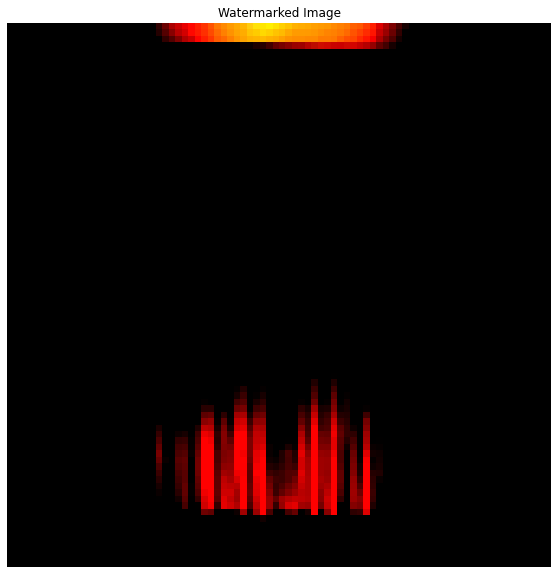

  9%|▉         | 1/11 [00:05<00:54,  5.44s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 2: Target opacity: 0, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


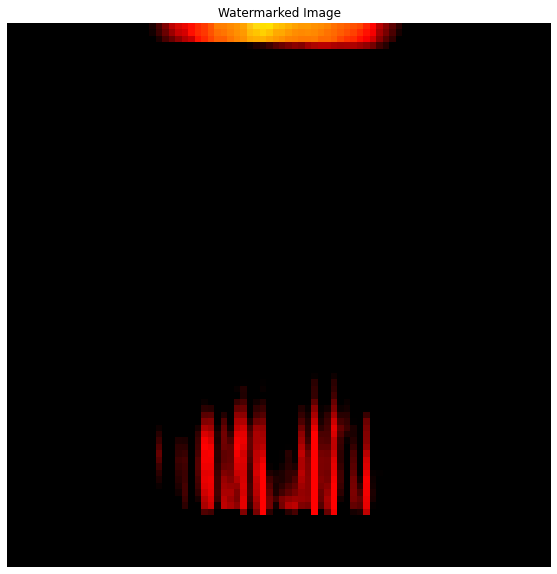

 18%|█▊        | 2/11 [00:10<00:48,  5.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 2: Target opacity: 0.05, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


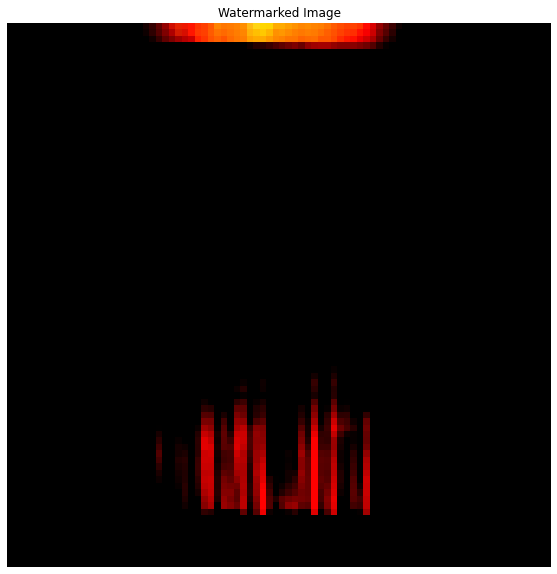

 27%|██▋       | 3/11 [00:16<00:42,  5.36s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 2: Target opacity: 0.1, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: True, Base class predicted: False


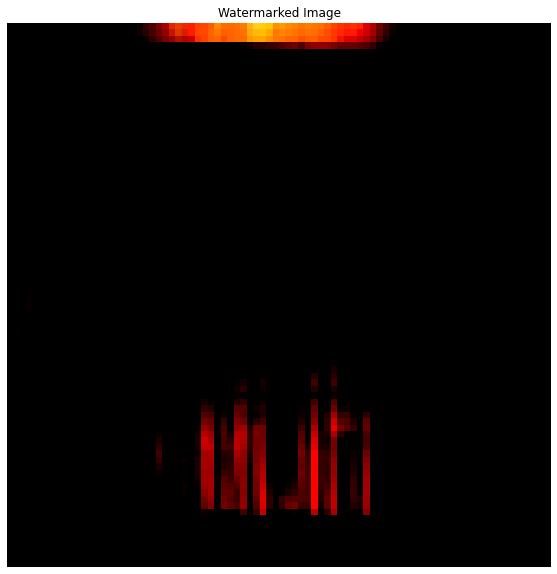

 36%|███▋      | 4/11 [00:21<00:37,  5.35s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 2: Target opacity: 0.15, Labeled correctly: 0.6666666666666666, Correctly Predicted Target: True, Base class predicted: False


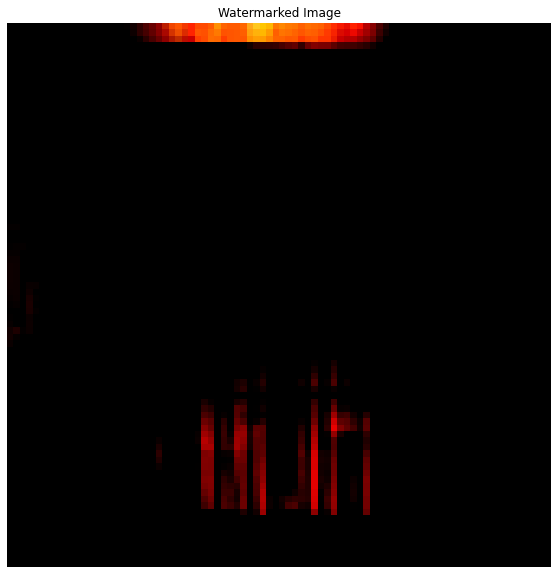

 45%|████▌     | 5/11 [00:26<00:32,  5.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 2: Target opacity: 0.2, Labeled correctly: 0.6666666666666666, Correctly Predicted Target: True, Base class predicted: False


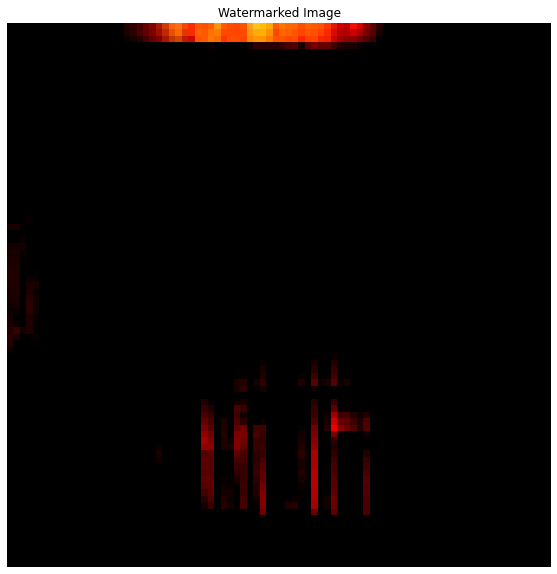

 55%|█████▍    | 6/11 [00:32<00:26,  5.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 2: Target opacity: 0.25, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: True, Base class predicted: False


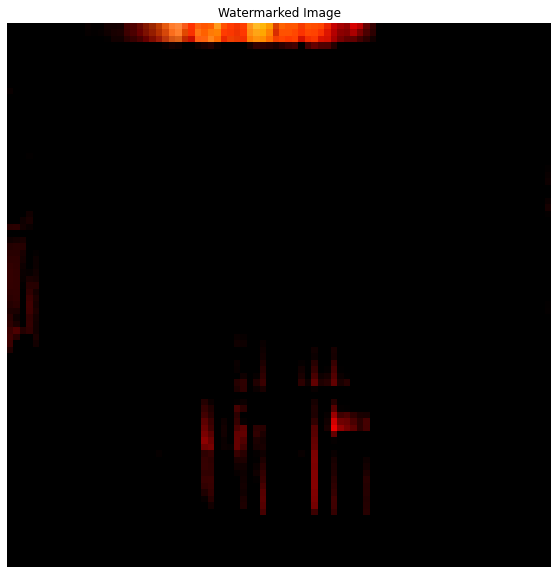

 64%|██████▎   | 7/11 [00:37<00:21,  5.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 2: Target opacity: 0.3, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: True, Base class predicted: False


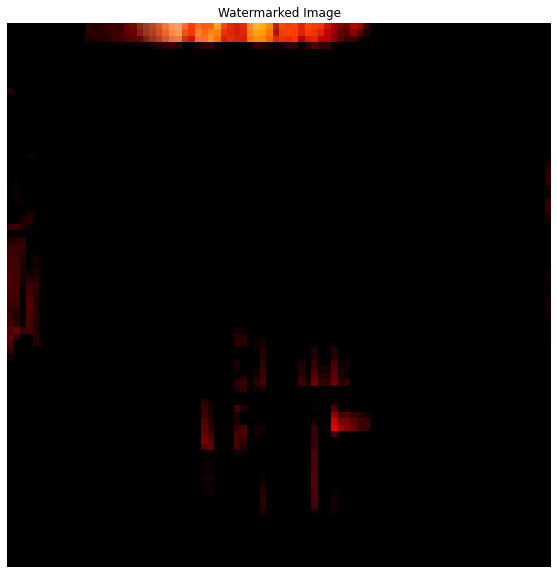

 73%|███████▎  | 8/11 [00:43<00:16,  5.39s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 2: Target opacity: 0.35, Labeled correctly: 0.6666666666666666, Correctly Predicted Target: True, Base class predicted: False


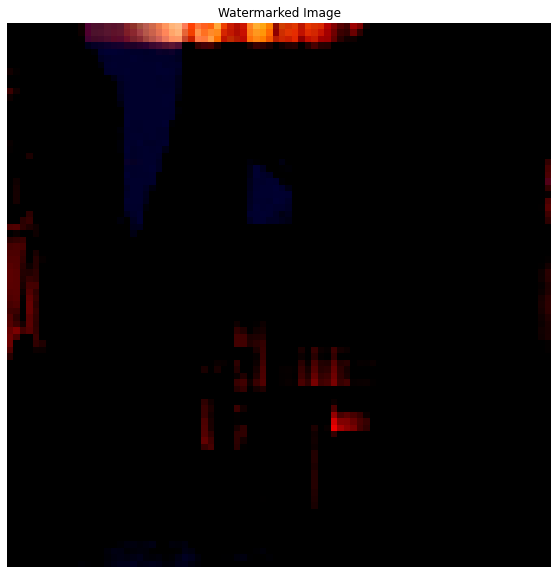

 82%|████████▏ | 9/11 [00:48<00:10,  5.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 2: Target opacity: 0.4, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: True, Base class predicted: False


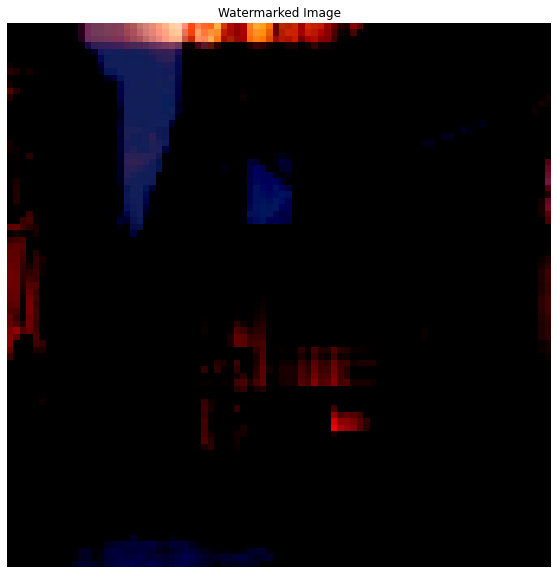

 91%|█████████ | 10/11 [00:53<00:05,  5.38s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 2: Target opacity: 0.45, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: True, Base class predicted: False


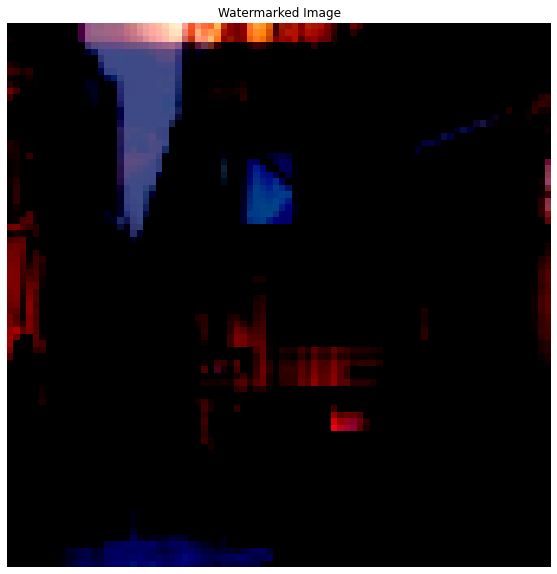

100%|██████████| 11/11 [00:59<00:00,  5.38s/it]

Iteration 2: Target opacity: 0.5, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: True, Base class predicted: False



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


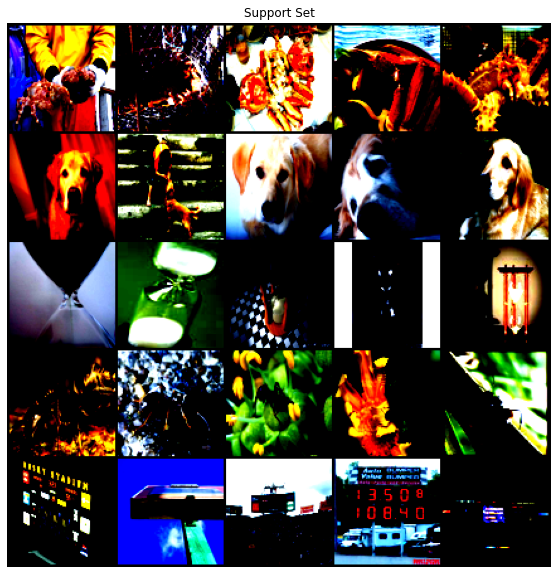

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 2, 2, 2, 2,
         2]])


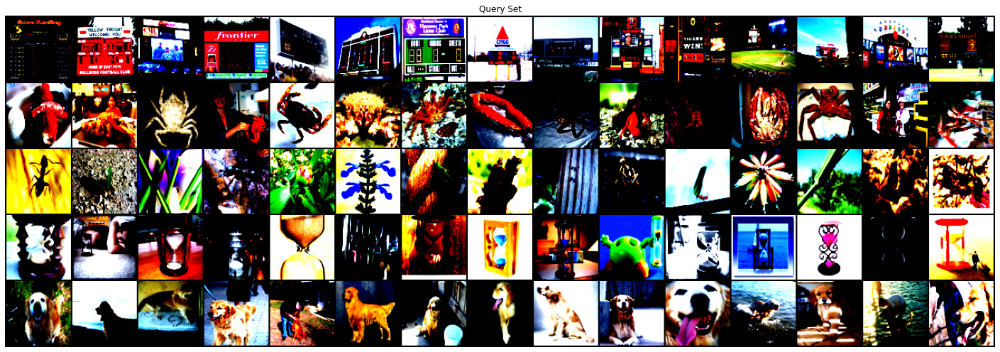

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1,
         1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
         4, 4, 4]])
target_class 4
unique_classes [0, 1, 2, 3]
base_class 0
target_indices [60 61 62 63 64 65 66 67 68 69 70 71 72 73 74]
target_index 73
base_indices [0 1 2 3 4]
base_index 4


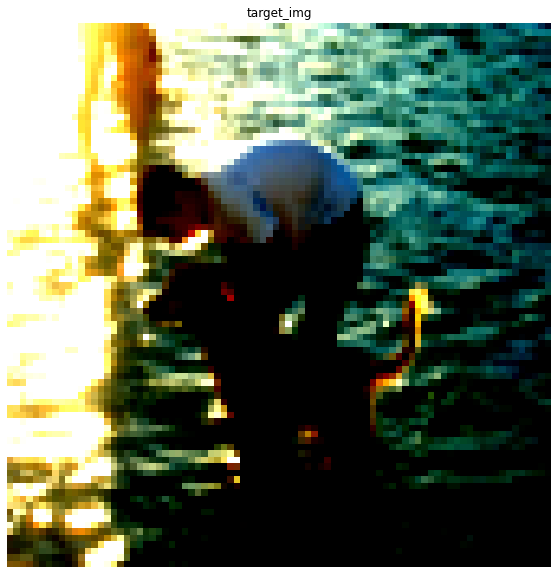

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


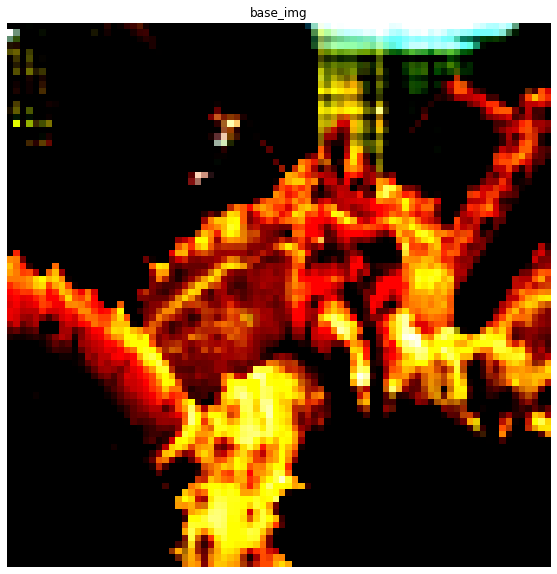

  0%|          | 3/1000 [00:00<00:37, 26.86it/s]

Iteration 0
loss: tensor(14.3448, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(16.1573, grad_fn=<PowBackward0>)
Iteration 2
loss: tensor(8.6136, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(9.7275, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(93.3923, grad_fn=<PowBackward0>)
Iteration 5


  1%|          | 9/1000 [00:00<00:38, 25.88it/s]

loss: tensor(13.6070, grad_fn=<PowBackward0>)
Iteration 6
loss: tensor(18.6610, grad_fn=<PowBackward0>)
Iteration 7
loss: tensor(28.2312, grad_fn=<PowBackward0>)
Iteration 8
loss: tensor(39.1935, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(33.0484, grad_fn=<PowBackward0>)
Iteration 10
loss: tensor(41.6479, grad_fn=<PowBackward0>)


  2%|▏         | 15/1000 [00:00<00:38, 25.44it/s]

Iteration 11
loss: tensor(20.6984, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(37.4873, grad_fn=<PowBackward0>)
Iteration 13
loss: tensor(7.2700, grad_fn=<PowBackward0>)
Iteration 14
loss: tensor(35.2530, grad_fn=<PowBackward0>)
Iteration 15
loss: tensor(27.8533, grad_fn=<PowBackward0>)
Iteration

  2%|▏         | 18/1000 [00:00<00:39, 25.04it/s]

 16
loss: tensor(58.3880, grad_fn=<PowBackward0>)
Iteration 17
loss: tensor(29.7466, grad_fn=<PowBackward0>)
Iteration 18
loss: tensor(34.6010, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(44.1886, grad_fn=<PowBackward0>)
Iteration 20
loss: tensor(59.5412, grad_fn=<PowBackward0>)


  2%|▏         | 24/1000 [00:00<00:41, 23.30it/s]

Iteration 21
loss: tensor(10.8703, grad_fn=<PowBackward0>)
Iteration 22
loss: tensor(33.2159, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(17.6389, grad_fn=<PowBackward0>)
Iteration 24
loss: tensor(52.7640, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(9.6784, grad_fn=<PowBackward0>)


  3%|▎         | 30/1000 [00:01<00:39, 24.30it/s]

Iteration 26
loss: tensor(19.1659, grad_fn=<PowBackward0>)
Iteration 27
loss: tensor(4.3439, grad_fn=<PowBackward0>)
Iteration 28
loss: tensor(54.1110, grad_fn=<PowBackward0>)
Iteration 29
loss: tensor(17.1057, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(41.1845, grad_fn=<PowBackward0>)
Iteration 31


  4%|▎         | 36/1000 [00:01<00:39, 24.58it/s]

loss: tensor(9.9192, grad_fn=<PowBackward0>)
Iteration 32
loss: tensor(68.5625, grad_fn=<PowBackward0>)
Iteration 33
loss: tensor(24.1592, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(42.8808, grad_fn=<PowBackward0>)
Iteration 35
loss: tensor(19.6598, grad_fn=<PowBackward0>)
Iteration 36


  4%|▍         | 39/1000 [00:01<00:38, 24.94it/s]

loss: tensor(28.5959, grad_fn=<PowBackward0>)
Iteration 37
loss: tensor(37.8735, grad_fn=<PowBackward0>)
Iteration 38
loss: tensor(50.4665, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(24.6108, grad_fn=<PowBackward0>)
Iteration 40
loss: tensor(24.3016, grad_fn=<PowBackward0>)
Iteration 41
loss: tensor(26.8585, grad_fn=<PowBackward0>)


  4%|▍         | 45/1000 [00:01<00:39, 24.25it/s]

Iteration 42
loss: tensor(80.7248, grad_fn=<PowBackward0>)
Iteration 43
loss: tensor(16.9237, grad_fn=<PowBackward0>)
Iteration 44
loss: tensor(28.0212, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(12.8598, grad_fn=<PowBackward0>)
Iteration 46


  5%|▌         | 51/1000 [00:02<00:38, 24.35it/s]

loss: tensor(121.0016, grad_fn=<PowBackward0>)
Iteration 47
loss: tensor(13.8905, grad_fn=<PowBackward0>)
Iteration 48
loss: tensor(17.5159, grad_fn=<PowBackward0>)
Iteration 49
loss: tensor(25.7972, grad_fn=<PowBackward0>)
Iteration 50
loss: tensor(45.9115, grad_fn=<PowBackward0>)
Iteration 51
loss: tensor(20.3347, grad_fn=<PowBackward0>)


  6%|▌         | 57/1000 [00:02<00:37, 25.15it/s]

Iteration 52
loss: tensor(50.1439, grad_fn=<PowBackward0>)
Iteration 53
loss: tensor(8.5680, grad_fn=<PowBackward0>)
Iteration 54
loss: tensor(52.3083, grad_fn=<PowBackward0>)
Iteration 55
loss: tensor(24.3301, grad_fn=<PowBackward0>)
Iteration 56
loss: tensor(21.2713, grad_fn=<PowBackward0>)
Iteration 57


  6%|▌         | 60/1000 [00:02<00:38, 24.20it/s]

loss: tensor(11.8840, grad_fn=<PowBackward0>)
Iteration 58
loss: tensor(55.5780, grad_fn=<PowBackward0>)
Iteration 59
loss: tensor(18.6700, grad_fn=<PowBackward0>)
Iteration 60
loss: tensor(66.3078, grad_fn=<PowBackward0>)
Iteration 61
loss: tensor(11.5619, grad_fn=<PowBackward0>)
Iteration 62


  7%|▋         | 66/1000 [00:02<00:38, 24.45it/s]

loss: tensor(21.3179, grad_fn=<PowBackward0>)
Iteration 63
loss: tensor(24.1383, grad_fn=<PowBackward0>)
Iteration 64
loss: tensor(61.2197, grad_fn=<PowBackward0>)
Iteration 65
loss: tensor(7.7895, grad_fn=<PowBackward0>)
Iteration 66
loss: tensor(30.1902, grad_fn=<PowBackward0>)
Iteration 67


  7%|▋         | 69/1000 [00:02<00:39, 23.49it/s]

loss: tensor(11.8815, grad_fn=<PowBackward0>)
Iteration 68
loss: tensor(79.9986, grad_fn=<PowBackward0>)
Iteration 69
loss: tensor(27.4538, grad_fn=<PowBackward0>)
Iteration 70
loss: tensor(15.3380, grad_fn=<PowBackward0>)
Iteration 71
loss: tensor(14.5054, grad_fn=<PowBackward0>)


  8%|▊         | 75/1000 [00:03<00:39, 23.63it/s]

Iteration 72
loss: tensor(67.7899, grad_fn=<PowBackward0>)
Iteration 73
loss: tensor(16.9130, grad_fn=<PowBackward0>)
Iteration 74
loss: tensor(40.9854, grad_fn=<PowBackward0>)
Iteration 75
loss: tensor(7.8380, grad_fn=<PowBackward0>)
Iteration 76
loss: tensor(78.7257, grad_fn=<PowBackward0>)
Iteration 77


  8%|▊         | 81/1000 [00:03<00:37, 24.66it/s]

loss: tensor(17.7272, grad_fn=<PowBackward0>)
Iteration 78
loss: tensor(24.8019, grad_fn=<PowBackward0>)
Iteration 79
loss: tensor(22.5969, grad_fn=<PowBackward0>)
Iteration 80
loss: tensor(79.1100, grad_fn=<PowBackward0>)
Iteration 81
loss: tensor(40.3125, grad_fn=<PowBackward0>)
Iteration 82
loss: tensor(66.6710, grad_fn=<PowBackward0>)


  9%|▊         | 87/1000 [00:03<00:38, 23.89it/s]

Iteration 83
loss: tensor(23.2657, grad_fn=<PowBackward0>)
Iteration 84
loss: tensor(27.3880, grad_fn=<PowBackward0>)
Iteration 85
loss: tensor(12.7140, grad_fn=<PowBackward0>)
Iteration 86
loss: tensor(48.9415, grad_fn=<PowBackward0>)
Iteration 87
loss: tensor(13.6004, grad_fn=<PowBackward0>)


  9%|▉         | 93/1000 [00:03<00:36, 24.53it/s]

Iteration 88
loss: tensor(33.6401, grad_fn=<PowBackward0>)
Iteration 89
loss: tensor(2.9669, grad_fn=<PowBackward0>)
Iteration 90
loss: tensor(15.8258, grad_fn=<PowBackward0>)
Iteration 91
loss: tensor(41.7892, grad_fn=<PowBackward0>)
Iteration 92
loss: tensor(82.9782, grad_fn=<PowBackward0>)
Iteration 93


 10%|▉         | 96/1000 [00:03<00:36, 24.54it/s]

loss: tensor(16.3663, grad_fn=<PowBackward0>)
Iteration 94
loss: tensor(52.3963, grad_fn=<PowBackward0>)
Iteration 95
loss: tensor(14.9761, grad_fn=<PowBackward0>)
Iteration 96
loss: tensor(24.2759, grad_fn=<PowBackward0>)
Iteration 97
loss: tensor(23.3447, grad_fn=<PowBackward0>)
Iteration 98
loss: tensor(56.7649, grad_fn=<PowBackward0>)


 10%|█         | 102/1000 [00:04<00:35, 25.61it/s]

Iteration 99
loss: tensor(24.3356, grad_fn=<PowBackward0>)
Iteration 100
loss: tensor(32.7799, grad_fn=<PowBackward0>)
Iteration 101
loss: tensor(14.9970, grad_fn=<PowBackward0>)
Iteration 102
loss: tensor(12.6667, grad_fn=<PowBackward0>)
Iteration 103
loss: tensor(27.7658, grad_fn=<PowBackward0>)
Iteration 104


 11%|█         | 108/1000 [00:04<00:33, 26.24it/s]

loss: tensor(42.4395, grad_fn=<PowBackward0>)
Iteration 105
loss: tensor(26.5251, grad_fn=<PowBackward0>)
Iteration 106
loss: tensor(37.5639, grad_fn=<PowBackward0>)
Iteration 107
loss: tensor(15.6591, grad_fn=<PowBackward0>)
Iteration 108
loss: tensor(42.3145, grad_fn=<PowBackward0>)
Iteration 109
loss: tensor(17.1537, grad_fn=<PowBackward0>)
Iteration

 11%|█▏        | 114/1000 [00:04<00:33, 26.43it/s]

 110
loss: tensor(40.5125, grad_fn=<PowBackward0>)
Iteration 111
loss: tensor(21.0762, grad_fn=<PowBackward0>)
Iteration 112
loss: tensor(48.9408, grad_fn=<PowBackward0>)
Iteration 113
loss: tensor(23.2294, grad_fn=<PowBackward0>)
Iteration 114
loss: tensor(18.8886, grad_fn=<PowBackward0>)
Iteration 115


 12%|█▏        | 120/1000 [00:04<00:33, 26.55it/s]

loss: tensor(21.8003, grad_fn=<PowBackward0>)
Iteration 116
loss: tensor(44.8650, grad_fn=<PowBackward0>)
Iteration 117
loss: tensor(10.1001, grad_fn=<PowBackward0>)
Iteration 118
loss: tensor(22.0067, grad_fn=<PowBackward0>)
Iteration 119
loss: tensor(5.3046, grad_fn=<PowBackward0>)
Iteration 120
loss: tensor(43.5323, grad_fn=<PowBackward0>)


 13%|█▎        | 126/1000 [00:05<00:33, 26.23it/s]

Iteration 121
loss: tensor(23.9985, grad_fn=<PowBackward0>)
Iteration 122
loss: tensor(50.3085, grad_fn=<PowBackward0>)
Iteration 123
loss: tensor(40.7155, grad_fn=<PowBackward0>)
Iteration 124
loss: tensor(55.1234, grad_fn=<PowBackward0>)
Iteration 125
loss: tensor(21.5419, grad_fn=<PowBackward0>)
Iteration 126
loss: tensor(34.7779, grad_fn=<PowBackward0>)

 13%|█▎        | 129/1000 [00:05<00:33, 25.90it/s]


Iteration 127
loss: tensor(5.8805, grad_fn=<PowBackward0>)
Iteration 128
loss: tensor(23.5736, grad_fn=<PowBackward0>)
Iteration 129
loss: tensor(39.9175, grad_fn=<PowBackward0>)
Iteration 130
loss: tensor(50.3987, grad_fn=<PowBackward0>)
Iteration 131
loss: tensor(6.3160, grad_fn=<PowBackward0>)


 14%|█▎        | 135/1000 [00:05<00:33, 25.76it/s]

Iteration 132
loss: tensor(27.3772, grad_fn=<PowBackward0>)
Iteration 133
loss: tensor(21.4521, grad_fn=<PowBackward0>)
Iteration 134
loss: tensor(42.8456, grad_fn=<PowBackward0>)
Iteration 135
loss: tensor(11.2231, grad_fn=<PowBackward0>)
Iteration 136
loss: tensor(37.5325, grad_fn=<PowBackward0>)
Iteration 137


 14%|█▍        | 141/1000 [00:05<00:33, 25.56it/s]

loss: tensor(24.4381, grad_fn=<PowBackward0>)
Iteration 138
loss: tensor(38.4246, grad_fn=<PowBackward0>)
Iteration 139
loss: tensor(25.6597, grad_fn=<PowBackward0>)
Iteration 140
loss: tensor(38.3644, grad_fn=<PowBackward0>)
Iteration 141
loss: tensor(11.8958, grad_fn=<PowBackward0>)
Iteration 142
loss: tensor(18.7831, grad_fn=<PowBackward0>)


 15%|█▍        | 147/1000 [00:05<00:33, 25.13it/s]

Iteration 143
loss: tensor(42.7348, grad_fn=<PowBackward0>)
Iteration 144
loss: tensor(34.9374, grad_fn=<PowBackward0>)
Iteration 145
loss: tensor(9.9329, grad_fn=<PowBackward0>)
Iteration 146
loss: tensor(58.4538, grad_fn=<PowBackward0>)
Iteration 147
loss: tensor(8.0432, grad_fn=<PowBackward0>)


 15%|█▌        | 153/1000 [00:06<00:33, 25.63it/s]

Iteration 148
loss: tensor(18.6694, grad_fn=<PowBackward0>)
Iteration 149
loss: tensor(16.4479, grad_fn=<PowBackward0>)
Iteration 150
loss: tensor(52.9378, grad_fn=<PowBackward0>)
Iteration 151
loss: tensor(37.3746, grad_fn=<PowBackward0>)
Iteration 152
loss: tensor(22.4147, grad_fn=<PowBackward0>)
Iteration 153


 16%|█▌        | 156/1000 [00:06<00:32, 25.99it/s]

loss: tensor(8.9763, grad_fn=<PowBackward0>)
Iteration 154
loss: tensor(44.4589, grad_fn=<PowBackward0>)
Iteration 155
loss: tensor(12.3003, grad_fn=<PowBackward0>)
Iteration 156
loss: tensor(30.6685, grad_fn=<PowBackward0>)
Iteration 157
loss: tensor(30.2640, grad_fn=<PowBackward0>)
Iteration 158
loss: tensor(48.2558, grad_fn=<PowBackward0>)


 16%|█▌        | 162/1000 [00:06<00:33, 25.19it/s]

Iteration 159
loss: tensor(16.8588, grad_fn=<PowBackward0>)
Iteration 160
loss: tensor(33.0692, grad_fn=<PowBackward0>)
Iteration 161
loss: tensor(11.5542, grad_fn=<PowBackward0>)
Iteration 162
loss: tensor(27.0760, grad_fn=<PowBackward0>)
Iteration 163
loss: tensor(8.8981, grad_fn=<PowBackward0>)
Iteration 164


 17%|█▋        | 168/1000 [00:06<00:32, 25.35it/s]

loss: tensor(45.8947, grad_fn=<PowBackward0>)
Iteration 165
loss: tensor(29.1409, grad_fn=<PowBackward0>)
Iteration 166
loss: tensor(54.4280, grad_fn=<PowBackward0>)
Iteration 167
loss: tensor(16.1980, grad_fn=<PowBackward0>)
Iteration 168
loss: tensor(14.7866, grad_fn=<PowBackward0>)
Iteration 169
loss: tensor(35.0723, grad_fn=<PowBackward0>)


 17%|█▋        | 174/1000 [00:06<00:34, 24.29it/s]

Iteration 170
loss: tensor(81.0659, grad_fn=<PowBackward0>)
Iteration 171
loss: tensor(13.1546, grad_fn=<PowBackward0>)
Iteration 172
loss: tensor(14.7471, grad_fn=<PowBackward0>)
Iteration 173
loss: tensor(15.1961, grad_fn=<PowBackward0>)
Iteration 174
loss: tensor(52.0891, grad_fn=<PowBackward0>)


 18%|█▊        | 180/1000 [00:07<00:33, 24.85it/s]

Iteration 175
loss: tensor(16.8065, grad_fn=<PowBackward0>)
Iteration 176
loss: tensor(22.4679, grad_fn=<PowBackward0>)
Iteration 177
loss: tensor(15.8592, grad_fn=<PowBackward0>)
Iteration 178
loss: tensor(52.2474, grad_fn=<PowBackward0>)
Iteration 179
loss: tensor(17.6052, grad_fn=<PowBackward0>)
Iteration 180


 18%|█▊        | 183/1000 [00:07<00:32, 25.08it/s]

loss: tensor(37.4326, grad_fn=<PowBackward0>)
Iteration 181
loss: tensor(8.7735, grad_fn=<PowBackward0>)
Iteration 182
loss: tensor(25.2343, grad_fn=<PowBackward0>)
Iteration 183
loss: tensor(24.5338, grad_fn=<PowBackward0>)
Iteration 184
loss: tensor(61.0968, grad_fn=<PowBackward0>)
Iteration 185
loss: tensor(6.5875, grad_fn=<PowBackward0>)


 19%|█▉        | 189/1000 [00:07<00:32, 24.81it/s]

Iteration 186
loss: tensor(19.5975, grad_fn=<PowBackward0>)
Iteration 187
loss: tensor(29.1629, grad_fn=<PowBackward0>)
Iteration 188
loss: tensor(76.0741, grad_fn=<PowBackward0>)
Iteration 189
loss: tensor(13.1009, grad_fn=<PowBackward0>)
Iteration 190
loss: tensor(26.7440, grad_fn=<PowBackward0>)
Iteration 191


 20%|█▉        | 195/1000 [00:07<00:32, 25.12it/s]

loss: tensor(9.1336, grad_fn=<PowBackward0>)
Iteration 192
loss: tensor(23.4952, grad_fn=<PowBackward0>)
Iteration 193
loss: tensor(6.5491, grad_fn=<PowBackward0>)
Iteration 194
loss: tensor(25.1146, grad_fn=<PowBackward0>)
Iteration 195
loss: tensor(4.5852, grad_fn=<PowBackward0>)
Iteration 196
loss: tensor(65.3526, grad_fn=<PowBackward0>)


 20%|██        | 201/1000 [00:08<00:32, 24.51it/s]

Iteration 197
loss: tensor(19.0599, grad_fn=<PowBackward0>)
Iteration 198
loss: tensor(27.5609, grad_fn=<PowBackward0>)
Iteration 199
loss: tensor(29.6257, grad_fn=<PowBackward0>)
Iteration 200
loss: tensor(52.2003, grad_fn=<PowBackward0>)
Iteration 201
loss: tensor(25.5603, grad_fn=<PowBackward0>)


 21%|██        | 207/1000 [00:08<00:31, 25.30it/s]

Iteration 202
loss: tensor(7.0351, grad_fn=<PowBackward0>)
Iteration 203
loss: tensor(7.3637, grad_fn=<PowBackward0>)
Iteration 204
loss: tensor(10.6296, grad_fn=<PowBackward0>)
Iteration 205
loss: tensor(11.3523, grad_fn=<PowBackward0>)
Iteration 206
loss: tensor(34.8292, grad_fn=<PowBackward0>)
Iteration 207


 21%|██        | 210/1000 [00:08<00:31, 25.34it/s]

loss: tensor(13.9999, grad_fn=<PowBackward0>)
Iteration 208
loss: tensor(8.5125, grad_fn=<PowBackward0>)
Iteration 209
loss: tensor(4.1994, grad_fn=<PowBackward0>)
Iteration 210
loss: tensor(16.8336, grad_fn=<PowBackward0>)
Iteration 211
loss: tensor(9.6822, grad_fn=<PowBackward0>)
Iteration 212
loss: tensor(35.3707, grad_fn=<PowBackward0>)


 22%|██▏       | 216/1000 [00:08<00:32, 24.05it/s]

Iteration 213
loss: tensor(8.9973, grad_fn=<PowBackward0>)
Iteration 214
loss: tensor(21.2273, grad_fn=<PowBackward0>)
Iteration 215
loss: tensor(13.2705, grad_fn=<PowBackward0>)
Iteration 216
loss: tensor(24.5564, grad_fn=<PowBackward0>)
Iteration 217
loss: tensor(12.7804, grad_fn=<PowBackward0>)


 22%|██▏       | 222/1000 [00:08<00:31, 24.70it/s]

Iteration 218
loss: tensor(16.1611, grad_fn=<PowBackward0>)
Iteration 219
loss: tensor(15.6702, grad_fn=<PowBackward0>)
Iteration 220
loss: tensor(29.0969, grad_fn=<PowBackward0>)
Iteration 221
loss: tensor(16.1956, grad_fn=<PowBackward0>)
Iteration 222
loss: tensor(13.4041, grad_fn=<PowBackward0>)


 22%|██▎       | 225/1000 [00:09<00:32, 23.96it/s]

Iteration 223
loss: tensor(7.9491, grad_fn=<PowBackward0>)
Iteration 224
loss: tensor(28.9026, grad_fn=<PowBackward0>)
Iteration 225
loss: tensor(8.7560, grad_fn=<PowBackward0>)
Iteration 226
loss: tensor(7.9167, grad_fn=<PowBackward0>)
Iteration 227
loss: tensor(9.8266, grad_fn=<PowBackward0>)


 23%|██▎       | 231/1000 [00:09<00:31, 24.24it/s]

Iteration 228
loss: tensor(37.0045, grad_fn=<PowBackward0>)
Iteration 229
loss: tensor(26.7318, grad_fn=<PowBackward0>)
Iteration 230
loss: tensor(16.8916, grad_fn=<PowBackward0>)
Iteration 231
loss: tensor(12.0628, grad_fn=<PowBackward0>)
Iteration 232
loss: tensor(17.5213, grad_fn=<PowBackward0>)
Iteration 233


 24%|██▎       | 237/1000 [00:09<00:31, 24.35it/s]

loss: tensor(10.5246, grad_fn=<PowBackward0>)
Iteration 234
loss: tensor(16.6466, grad_fn=<PowBackward0>)
Iteration 235
loss: tensor(6.8859, grad_fn=<PowBackward0>)
Iteration 236
loss: tensor(17.7006, grad_fn=<PowBackward0>)
Iteration 237
loss: tensor(8.0469, grad_fn=<PowBackward0>)
Iteration 238
loss: 

 24%|██▍       | 243/1000 [00:09<00:31, 23.88it/s]

tensor(20.2986, grad_fn=<PowBackward0>)
Iteration 239
loss: tensor(18.9650, grad_fn=<PowBackward0>)
Iteration 240
loss: tensor(14.4043, grad_fn=<PowBackward0>)
Iteration 241
loss: tensor(12.6681, grad_fn=<PowBackward0>)
Iteration 242
loss: tensor(15.3726, grad_fn=<PowBackward0>)
Iteration 

 25%|██▍       | 246/1000 [00:09<00:33, 22.20it/s]

243
loss: tensor(12.8462, grad_fn=<PowBackward0>)
Iteration 244
loss: tensor(28.6112, grad_fn=<PowBackward0>)
Iteration 245
loss: tensor(10.6314, grad_fn=<PowBackward0>)
Iteration 246
loss: tensor(12.0401, grad_fn=<PowBackward0>)


 25%|██▌       | 252/1000 [00:10<00:31, 23.45it/s]

Iteration 247
loss: tensor(19.7341, grad_fn=<PowBackward0>)
Iteration 248
loss: tensor(26.0827, grad_fn=<PowBackward0>)
Iteration 249
loss: tensor(8.2643, grad_fn=<PowBackward0>)
Iteration 250
loss: tensor(14.4411, grad_fn=<PowBackward0>)
Iteration 251
loss: tensor(8.3168, grad_fn=<PowBackward0>)
Iteration 252


 26%|██▌       | 255/1000 [00:10<00:31, 23.62it/s]

loss: tensor(26.2810, grad_fn=<PowBackward0>)
Iteration 253
loss: tensor(21.5368, grad_fn=<PowBackward0>)
Iteration 254
loss: tensor(9.4763, grad_fn=<PowBackward0>)
Iteration 255
loss: tensor(13.6098, grad_fn=<PowBackward0>)
Iteration 256
loss: tensor(13.5200, grad_fn=<PowBackward0>)
Iteration 257
loss: tensor(12.6228, grad_fn=<PowBackward0>)


 26%|██▌       | 261/1000 [00:10<00:30, 24.22it/s]

Iteration 258
loss: tensor(14.4277, grad_fn=<PowBackward0>)
Iteration 259
loss: tensor(5.4235, grad_fn=<PowBackward0>)
Iteration 260
loss: tensor(13.3744, grad_fn=<PowBackward0>)
Iteration 261
loss: tensor(8.0897, grad_fn=<PowBackward0>)
Iteration 262
loss: tensor(32.2565, grad_fn=<PowBackward0>)
Iteration 263


 27%|██▋       | 267/1000 [00:10<00:30, 23.97it/s]

loss: tensor(16.8765, grad_fn=<PowBackward0>)
Iteration 264
loss: tensor(24.1767, grad_fn=<PowBackward0>)
Iteration 265
loss: tensor(6.8459, grad_fn=<PowBackward0>)
Iteration 266
loss: tensor(14.9211, grad_fn=<PowBackward0>)
Iteration 267
loss: tensor(22.7454, grad_fn=<PowBackward0>)
Iteration 268


 27%|██▋       | 273/1000 [00:11<00:31, 22.99it/s]

loss: tensor(30.9522, grad_fn=<PowBackward0>)
Iteration 269
loss: tensor(4.9237, grad_fn=<PowBackward0>)
Iteration 270
loss: tensor(7.5509, grad_fn=<PowBackward0>)
Iteration 271
loss: tensor(8.0130, grad_fn=<PowBackward0>)
Iteration 272
loss: tensor(24.3246, grad_fn=<PowBackward0>)


 28%|██▊       | 276/1000 [00:11<00:31, 22.71it/s]

Iteration 273
loss: tensor(12.6557, grad_fn=<PowBackward0>)
Iteration 274
loss: tensor(26.4799, grad_fn=<PowBackward0>)
Iteration 275
loss: tensor(6.9009, grad_fn=<PowBackward0>)
Iteration 276
loss: tensor(17.2576, grad_fn=<PowBackward0>)
Iteration 277
loss: tensor(12.0632, grad_fn=<PowBackward0>)


 28%|██▊       | 282/1000 [00:11<00:30, 23.42it/s]

Iteration 278
loss: tensor(28.2964, grad_fn=<PowBackward0>)
Iteration 279
loss: tensor(9.5727, grad_fn=<PowBackward0>)
Iteration 280
loss: tensor(17.1300, grad_fn=<PowBackward0>)
Iteration 281
loss: tensor(10.2983, grad_fn=<PowBackward0>)
Iteration 282
loss: tensor(22.0828, grad_fn=<PowBackward0>)
Iteration 283


 29%|██▉       | 288/1000 [00:11<00:29, 24.02it/s]

loss: tensor(11.9216, grad_fn=<PowBackward0>)
Iteration 284
loss: tensor(13.1628, grad_fn=<PowBackward0>)
Iteration 285
loss: tensor(8.1976, grad_fn=<PowBackward0>)
Iteration 286
loss: tensor(11.9625, grad_fn=<PowBackward0>)
Iteration 287
loss: tensor(16.1775, grad_fn=<PowBackward0>)
Iteration 288


 29%|██▉       | 294/1000 [00:11<00:28, 24.53it/s]

loss: tensor(41.3432, grad_fn=<PowBackward0>)
Iteration 289
loss: tensor(15.9044, grad_fn=<PowBackward0>)
Iteration 290
loss: tensor(11.6683, grad_fn=<PowBackward0>)
Iteration 291
loss: tensor(10.9852, grad_fn=<PowBackward0>)
Iteration 292
loss: tensor(18.8385, grad_fn=<PowBackward0>)
Iteration 293
loss: tensor(11.5941, grad_fn=<PowBackward0>)
Iteration 294


 30%|██▉       | 297/1000 [00:12<00:29, 24.15it/s]

loss: tensor(13.5440, grad_fn=<PowBackward0>)
Iteration 295
loss: tensor(9.0389, grad_fn=<PowBackward0>)
Iteration 296
loss: tensor(19.5552, grad_fn=<PowBackward0>)
Iteration 297
loss: tensor(16.3503, grad_fn=<PowBackward0>)
Iteration 298
loss: tensor(38.2919, grad_fn=<PowBackward0>)
Iteration 299


 30%|███       | 303/1000 [00:12<00:28, 24.63it/s]

loss: tensor(30.5292, grad_fn=<PowBackward0>)
Iteration 300
loss: tensor(17.2974, grad_fn=<PowBackward0>)
Iteration 301
loss: tensor(4.1304, grad_fn=<PowBackward0>)
Iteration 302
loss: tensor(1.7304, grad_fn=<PowBackward0>)
Iteration 303
loss: tensor(1.0496, grad_fn=<PowBackward0>)
Iteration 304


 31%|███       | 309/1000 [00:12<00:28, 24.06it/s]

loss: tensor(3.1205, grad_fn=<PowBackward0>)
Iteration 305
loss: tensor(4.1020, grad_fn=<PowBackward0>)
Iteration 306
loss: tensor(8.3905, grad_fn=<PowBackward0>)
Iteration 307
loss: tensor(8.3269, grad_fn=<PowBackward0>)
Iteration 308
loss: tensor(14.8813, grad_fn=<PowBackward0>)
Iteration 309


 31%|███       | 312/1000 [00:12<00:28, 23.99it/s]

loss: tensor(16.5044, grad_fn=<PowBackward0>)
Iteration 310
loss: tensor(7.1759, grad_fn=<PowBackward0>)
Iteration 311
loss: tensor(3.3298, grad_fn=<PowBackward0>)
Iteration 312
loss: tensor(2.5569, grad_fn=<PowBackward0>)
Iteration 313
loss: tensor(1.1735, grad_fn=<PowBackward0>)
Iteration 314


 32%|███▏      | 318/1000 [00:12<00:28, 23.97it/s]

loss: tensor(2.5967, grad_fn=<PowBackward0>)
Iteration 315
loss: tensor(3.6894, grad_fn=<PowBackward0>)
Iteration 316
loss: tensor(5.5872, grad_fn=<PowBackward0>)
Iteration 317
loss: tensor(5.5729, grad_fn=<PowBackward0>)
Iteration 318
loss: tensor(19.8835, grad_fn=<PowBackward0>)
Iteration 

 32%|███▏      | 321/1000 [00:13<00:29, 22.82it/s]

319
loss: tensor(11.3571, grad_fn=<PowBackward0>)
Iteration 320
loss: tensor(9.3946, grad_fn=<PowBackward0>)
Iteration 321
loss: tensor(3.8191, grad_fn=<PowBackward0>)
Iteration 322
loss: tensor(2.2263, grad_fn=<PowBackward0>)
Iteration 323
loss: tensor(1.3206, grad_fn=<PowBackward0>)


 33%|███▎      | 327/1000 [00:13<00:28, 23.50it/s]

Iteration 324
loss: tensor(2.6855, grad_fn=<PowBackward0>)
Iteration 325
loss: tensor(3.5505, grad_fn=<PowBackward0>)
Iteration 326
loss: tensor(8.7382, grad_fn=<PowBackward0>)
Iteration 327
loss: tensor(10.9632, grad_fn=<PowBackward0>)
Iteration 328
loss: tensor(16.7007, grad_fn=<PowBackward0>)


 33%|███▎      | 333/1000 [00:13<00:28, 23.31it/s]

Iteration 329
loss: tensor(8.9097, grad_fn=<PowBackward0>)
Iteration 330
loss: tensor(6.4902, grad_fn=<PowBackward0>)
Iteration 331
loss: tensor(3.5181, grad_fn=<PowBackward0>)
Iteration 332
loss: tensor(4.1651, grad_fn=<PowBackward0>)
Iteration 333
loss: tensor(3.6052, grad_fn=<PowBackward0>)


 34%|███▎      | 336/1000 [00:13<00:28, 23.35it/s]

Iteration 334
loss: tensor(4.6794, grad_fn=<PowBackward0>)
Iteration 335
loss: tensor(5.6505, grad_fn=<PowBackward0>)
Iteration 336
loss: tensor(12.3509, grad_fn=<PowBackward0>)
Iteration 337
loss: tensor(8.0183, grad_fn=<PowBackward0>)
Iteration 338
loss: tensor(5.8219, grad_fn=<PowBackward0>)


 34%|███▍      | 342/1000 [00:14<00:28, 22.83it/s]

Iteration 339
loss: tensor(4.5220, grad_fn=<PowBackward0>)
Iteration 340
loss: tensor(4.2495, grad_fn=<PowBackward0>)
Iteration 341
loss: tensor(2.5710, grad_fn=<PowBackward0>)
Iteration 342
loss: tensor(3.4828, grad_fn=<PowBackward0>)
Iteration 343


 35%|███▍      | 348/1000 [00:14<00:28, 22.77it/s]

loss: tensor(2.7224, grad_fn=<PowBackward0>)
Iteration 344
loss: tensor(8.4169, grad_fn=<PowBackward0>)
Iteration 345
loss: tensor(8.3425, grad_fn=<PowBackward0>)
Iteration 346
loss: tensor(8.6842, grad_fn=<PowBackward0>)
Iteration 347
loss: tensor(5.0280, grad_fn=<PowBackward0>)
Iteration 348


 35%|███▌      | 351/1000 [00:14<00:28, 23.17it/s]

loss: tensor(12.7928, grad_fn=<PowBackward0>)
Iteration 349
loss: tensor(10.6310, grad_fn=<PowBackward0>)
Iteration 350
loss: tensor(3.8349, grad_fn=<PowBackward0>)
Iteration 351
loss: tensor(2.4550, grad_fn=<PowBackward0>)
Iteration 352
loss: tensor(3.6526, grad_fn=<PowBackward0>)
Iteration 353
loss: tensor(2.5322, grad_fn=<PowBackward0>)


 36%|███▌      | 357/1000 [00:14<00:27, 23.49it/s]

Iteration 354
loss: tensor(2.5770, grad_fn=<PowBackward0>)
Iteration 355
loss: tensor(2.7234, grad_fn=<PowBackward0>)
Iteration 356
loss: tensor(14.4041, grad_fn=<PowBackward0>)
Iteration 357
loss: tensor(15.8329, grad_fn=<PowBackward0>)
Iteration 358
loss: tensor(8.6763, grad_fn=<PowBackward0>)
Iteration 

 36%|███▋      | 363/1000 [00:14<00:26, 23.90it/s]

359
loss: tensor(5.9546, grad_fn=<PowBackward0>)
Iteration 360
loss: tensor(5.8026, grad_fn=<PowBackward0>)
Iteration 361
loss: tensor(2.4016, grad_fn=<PowBackward0>)
Iteration 362
loss: tensor(4.3139, grad_fn=<PowBackward0>)
Iteration 363
loss: tensor(3.1559, grad_fn=<PowBackward0>)
Iteration 364


 37%|███▋      | 369/1000 [00:15<00:26, 24.02it/s]

loss: tensor(5.3718, grad_fn=<PowBackward0>)
Iteration 365
loss: tensor(4.8781, grad_fn=<PowBackward0>)
Iteration 366
loss: tensor(13.0207, grad_fn=<PowBackward0>)
Iteration 367
loss: tensor(4.8959, grad_fn=<PowBackward0>)
Iteration 368
loss: tensor(6.0416, grad_fn=<PowBackward0>)


 37%|███▋      | 372/1000 [00:15<00:27, 22.88it/s]

Iteration 369
loss: tensor(6.6173, grad_fn=<PowBackward0>)
Iteration 370
loss: tensor(5.8149, grad_fn=<PowBackward0>)
Iteration 371
loss: tensor(6.5083, grad_fn=<PowBackward0>)
Iteration 372
loss: tensor(6.3217, grad_fn=<PowBackward0>)
Iteration 373
loss: tensor(3.2773, grad_fn=<PowBackward0>)


 38%|███▊      | 378/1000 [00:15<00:25, 24.12it/s]

Iteration 374
loss: tensor(4.6434, grad_fn=<PowBackward0>)
Iteration 375
loss: tensor(3.7438, grad_fn=<PowBackward0>)
Iteration 376
loss: tensor(7.9054, grad_fn=<PowBackward0>)
Iteration 377
loss: tensor(9.7871, grad_fn=<PowBackward0>)
Iteration 378
loss: tensor(14.2222, grad_fn=<PowBackward0>)
Iteration 379


 38%|███▊      | 384/1000 [00:15<00:24, 24.67it/s]

loss: tensor(5.5226, grad_fn=<PowBackward0>)
Iteration 380
loss: tensor(6.2353, grad_fn=<PowBackward0>)
Iteration 381
loss: tensor(2.8114, grad_fn=<PowBackward0>)
Iteration 382
loss: tensor(5.0309, grad_fn=<PowBackward0>)
Iteration 383
loss: tensor(5.3628, grad_fn=<PowBackward0>)
Iteration 384
loss: tensor(10.1696, grad_fn=<PowBackward0>)


 39%|███▊      | 387/1000 [00:15<00:25, 24.50it/s]

Iteration 385
loss: tensor(6.4287, grad_fn=<PowBackward0>)
Iteration 386
loss: tensor(12.1145, grad_fn=<PowBackward0>)
Iteration 387
loss: tensor(4.0572, grad_fn=<PowBackward0>)
Iteration 388
loss: tensor(4.6290, grad_fn=<PowBackward0>)
Iteration 389
loss: tensor(2.4539, grad_fn=<PowBackward0>)


 39%|███▉      | 393/1000 [00:16<00:25, 24.21it/s]

Iteration 390
loss: tensor(4.3003, grad_fn=<PowBackward0>)
Iteration 391
loss: tensor(3.8153, grad_fn=<PowBackward0>)
Iteration 392
loss: tensor(8.7266, grad_fn=<PowBackward0>)
Iteration 393
loss: tensor(7.4402, grad_fn=<PowBackward0>)
Iteration 394
loss: tensor(14.8404, grad_fn=<PowBackward0>)
Iteration 395


 40%|███▉      | 399/1000 [00:16<00:24, 24.19it/s]

loss: tensor(3.3459, grad_fn=<PowBackward0>)
Iteration 396
loss: tensor(5.1067, grad_fn=<PowBackward0>)
Iteration 397
loss: tensor(6.7596, grad_fn=<PowBackward0>)
Iteration 398
loss: tensor(9.9819, grad_fn=<PowBackward0>)
Iteration 399
loss: tensor(6.6781, grad_fn=<PowBackward0>)
Iteration 400


 40%|████      | 405/1000 [00:16<00:24, 24.45it/s]

loss: tensor(11.1428, grad_fn=<PowBackward0>)
Iteration 401
loss: tensor(7.4995, grad_fn=<PowBackward0>)
Iteration 402
loss: tensor(0.9131, grad_fn=<PowBackward0>)
Iteration 403
loss: tensor(0.2689, grad_fn=<PowBackward0>)
Iteration 404
loss: tensor(0.2171, grad_fn=<PowBackward0>)
Iteration 405
loss: tensor(0.1957, grad_fn=<PowBackward0>)


 41%|████      | 411/1000 [00:16<00:22, 26.13it/s]

Iteration 406
loss: tensor(0.2042, grad_fn=<PowBackward0>)
Iteration 407
loss: tensor(0.2032, grad_fn=<PowBackward0>)
Iteration 408
loss: tensor(0.2150, grad_fn=<PowBackward0>)
Iteration 409
loss: tensor(0.1907, grad_fn=<PowBackward0>)
Iteration 410
loss: tensor(0.2497, grad_fn=<PowBackward0>)
Iteration 411
loss: tensor(0.2368, grad_fn=<PowBackward0>)


 42%|████▏     | 417/1000 [00:17<00:22, 26.10it/s]

Iteration 412
loss: tensor(0.6982, grad_fn=<PowBackward0>)
Iteration 413
loss: tensor(1.4617, grad_fn=<PowBackward0>)
Iteration 414
loss: tensor(3.0553, grad_fn=<PowBackward0>)
Iteration 415
loss: tensor(3.6630, grad_fn=<PowBackward0>)
Iteration 416
loss: tensor(7.0659, grad_fn=<PowBackward0>)
Iteration 417


 42%|████▏     | 420/1000 [00:17<00:22, 25.52it/s]

loss: tensor(5.0813, grad_fn=<PowBackward0>)
Iteration 418
loss: tensor(3.2438, grad_fn=<PowBackward0>)
Iteration 419
loss: tensor(0.7342, grad_fn=<PowBackward0>)
Iteration 420
loss: tensor(0.7791, grad_fn=<PowBackward0>)
Iteration 421
loss: tensor(0.4905, grad_fn=<PowBackward0>)
Iteration 422
loss: tensor(0.7608, grad_fn=<PowBackward0>)


 43%|████▎     | 426/1000 [00:17<00:22, 25.85it/s]

Iteration 423
loss: tensor(0.5042, grad_fn=<PowBackward0>)
Iteration 424
loss: tensor(0.7376, grad_fn=<PowBackward0>)
Iteration 425
loss: tensor(0.6263, grad_fn=<PowBackward0>)
Iteration 426
loss: tensor(1.7050, grad_fn=<PowBackward0>)
Iteration 427
loss: tensor(1.8365, grad_fn=<PowBackward0>)
Iteration 428
loss:

 43%|████▎     | 432/1000 [00:17<00:22, 25.62it/s]

 tensor(2.3032, grad_fn=<PowBackward0>)
Iteration 429
loss: tensor(1.8484, grad_fn=<PowBackward0>)
Iteration 430
loss: tensor(3.4903, grad_fn=<PowBackward0>)
Iteration 431
loss: tensor(2.5529, grad_fn=<PowBackward0>)
Iteration 432
loss: tensor(2.9022, grad_fn=<PowBackward0>)
Iteration 433


 44%|████▍     | 438/1000 [00:17<00:22, 25.20it/s]

loss: tensor(1.9159, grad_fn=<PowBackward0>)
Iteration 434
loss: tensor(1.5986, grad_fn=<PowBackward0>)
Iteration 435
loss: tensor(0.8461, grad_fn=<PowBackward0>)
Iteration 436
loss: tensor(0.8340, grad_fn=<PowBackward0>)
Iteration 437
loss: tensor(0.4945, grad_fn=<PowBackward0>)
Iteration 438


 44%|████▍     | 441/1000 [00:18<00:22, 24.59it/s]

loss: tensor(0.7873, grad_fn=<PowBackward0>)
Iteration 439
loss: tensor(0.7018, grad_fn=<PowBackward0>)
Iteration 440
loss: tensor(1.1346, grad_fn=<PowBackward0>)
Iteration 441
loss: tensor(1.0587, grad_fn=<PowBackward0>)
Iteration 442
loss: tensor(2.4760, grad_fn=<PowBackward0>)
Iteration 443


 45%|████▍     | 447/1000 [00:18<00:22, 24.28it/s]

loss: tensor(3.0121, grad_fn=<PowBackward0>)
Iteration 444
loss: tensor(2.9153, grad_fn=<PowBackward0>)
Iteration 445
loss: tensor(1.5763, grad_fn=<PowBackward0>)
Iteration 446
loss: tensor(1.5595, grad_fn=<PowBackward0>)
Iteration 447
loss: tensor(0.8929, grad_fn=<PowBackward0>)
Iteration 448


 45%|████▌     | 453/1000 [00:18<00:21, 24.91it/s]

loss: tensor(1.2337, grad_fn=<PowBackward0>)
Iteration 449
loss: tensor(1.1303, grad_fn=<PowBackward0>)
Iteration 450
loss: tensor(1.2879, grad_fn=<PowBackward0>)
Iteration 451
loss: tensor(0.8479, grad_fn=<PowBackward0>)
Iteration 452
loss: tensor(2.2866, grad_fn=<PowBackward0>)
Iteration 453
loss: tensor(2.2748, grad_fn=<PowBackward0>)


 46%|████▌     | 459/1000 [00:18<00:21, 25.40it/s]

Iteration 454
loss: tensor(2.4931, grad_fn=<PowBackward0>)
Iteration 455
loss: tensor(1.9162, grad_fn=<PowBackward0>)
Iteration 456
loss: tensor(1.9225, grad_fn=<PowBackward0>)
Iteration 457
loss: tensor(1.0633, grad_fn=<PowBackward0>)
Iteration 458
loss: tensor(1.0536, grad_fn=<PowBackward0>)
Iteration 459


 46%|████▌     | 462/1000 [00:18<00:21, 25.13it/s]

loss: tensor(0.6569, grad_fn=<PowBackward0>)
Iteration 460
loss: tensor(0.8684, grad_fn=<PowBackward0>)
Iteration 461
loss: tensor(0.7026, grad_fn=<PowBackward0>)
Iteration 462
loss: tensor(0.9998, grad_fn=<PowBackward0>)
Iteration 463
loss: tensor(0.9885, grad_fn=<PowBackward0>)
Iteration 464
loss: tensor(1.1903, grad_fn=<PowBackward0>)


 47%|████▋     | 468/1000 [00:19<00:22, 24.10it/s]

Iteration 465
loss: tensor(0.8723, grad_fn=<PowBackward0>)
Iteration 466
loss: tensor(1.0937, grad_fn=<PowBackward0>)
Iteration 467
loss: tensor(0.6516, grad_fn=<PowBackward0>)
Iteration 468
loss: tensor(2.3308, grad_fn=<PowBackward0>)
Iteration 469
loss: tensor(3.1087, grad_fn=<PowBackward0>)


 47%|████▋     | 474/1000 [00:19<00:21, 23.97it/s]

Iteration 470
loss: tensor(2.6578, grad_fn=<PowBackward0>)
Iteration 471
loss: tensor(1.1103, grad_fn=<PowBackward0>)
Iteration 472
loss: tensor(1.4124, grad_fn=<PowBackward0>)
Iteration 473
loss: tensor(0.8347, grad_fn=<PowBackward0>)
Iteration 474
loss: tensor(0.9120, grad_fn=<PowBackward0>)


 48%|████▊     | 480/1000 [00:19<00:21, 24.47it/s]

Iteration 475
loss: tensor(0.5804, grad_fn=<PowBackward0>)
Iteration 476
loss: tensor(0.6621, grad_fn=<PowBackward0>)
Iteration 477
loss: tensor(0.4276, grad_fn=<PowBackward0>)
Iteration 478
loss: tensor(0.9283, grad_fn=<PowBackward0>)
Iteration 479
loss: tensor(1.1036, grad_fn=<PowBackward0>)
Iteration 480


 48%|████▊     | 483/1000 [00:19<00:21, 23.65it/s]

loss: tensor(1.3208, grad_fn=<PowBackward0>)
Iteration 481
loss: tensor(1.0663, grad_fn=<PowBackward0>)
Iteration 482
loss: tensor(1.1814, grad_fn=<PowBackward0>)
Iteration 483
loss: tensor(0.5996, grad_fn=<PowBackward0>)
Iteration 484
loss: tensor(1.3075, grad_fn=<PowBackward0>)
Iteration 485


 49%|████▉     | 489/1000 [00:20<00:22, 23.21it/s]

loss: tensor(1.9744, grad_fn=<PowBackward0>)
Iteration 486
loss: tensor(1.8541, grad_fn=<PowBackward0>)
Iteration 487
loss: tensor(1.3658, grad_fn=<PowBackward0>)
Iteration 488
loss: tensor(2.0526, grad_fn=<PowBackward0>)
Iteration 489
loss: tensor(1.5427, grad_fn=<PowBackward0>)


 49%|████▉     | 492/1000 [00:20<00:22, 23.05it/s]

Iteration 490
loss: tensor(3.1440, grad_fn=<PowBackward0>)
Iteration 491
loss: tensor(2.5431, grad_fn=<PowBackward0>)
Iteration 492
loss: tensor(3.0360, grad_fn=<PowBackward0>)
Iteration 493
loss: tensor(2.7490, grad_fn=<PowBackward0>)
Iteration 494
loss: tensor(2.7816, grad_fn=<PowBackward0>)


 50%|████▉     | 498/1000 [00:20<00:20, 24.07it/s]

Iteration 495
loss: tensor(1.7169, grad_fn=<PowBackward0>)
Iteration 496
loss: tensor(1.0632, grad_fn=<PowBackward0>)
Iteration 497
loss: tensor(0.4749, grad_fn=<PowBackward0>)
Iteration 498
loss: tensor(0.8173, grad_fn=<PowBackward0>)
Iteration 499
loss: tensor(0.5782, grad_fn=<PowBackward0>)
Iteration 500


 50%|█████     | 504/1000 [00:20<00:20, 24.33it/s]

loss: tensor(0.8374, grad_fn=<PowBackward0>)
Iteration 501
loss: tensor(0.8776, grad_fn=<PowBackward0>)
Iteration 502
loss: tensor(0.3195, grad_fn=<PowBackward0>)
Iteration 503
loss: tensor(0.2122, grad_fn=<PowBackward0>)
Iteration 504
loss: tensor(0.2134, grad_fn=<PowBackward0>)
Iteration 505
loss: tensor(0.1932, grad_fn=<PowBackward0>)

 51%|█████     | 510/1000 [00:20<00:19, 24.92it/s]


Iteration 506
loss: tensor(0.1862, grad_fn=<PowBackward0>)
Iteration 507
loss: tensor(0.1778, grad_fn=<PowBackward0>)
Iteration 508
loss: tensor(0.1743, grad_fn=<PowBackward0>)
Iteration 509
loss: tensor(0.1977, grad_fn=<PowBackward0>)
Iteration 510
loss: tensor(0.1726, grad_fn=<PowBackward0>)


 51%|█████▏    | 513/1000 [00:21<00:19, 25.42it/s]

Iteration 511
loss: tensor(0.2060, grad_fn=<PowBackward0>)
Iteration 512
loss: tensor(0.1715, grad_fn=<PowBackward0>)
Iteration 513
loss: tensor(0.2086, grad_fn=<PowBackward0>)
Iteration 514
loss: tensor(0.1767, grad_fn=<PowBackward0>)
Iteration 515
loss: tensor(0.2262, grad_fn=<PowBackward0>)


 52%|█████▏    | 519/1000 [00:21<00:19, 24.14it/s]

Iteration 516
loss: tensor(0.2035, grad_fn=<PowBackward0>)
Iteration 517
loss: tensor(0.2918, grad_fn=<PowBackward0>)
Iteration 518
loss: tensor(0.2547, grad_fn=<PowBackward0>)
Iteration 519
loss: tensor(0.3059, grad_fn=<PowBackward0>)
Iteration 520
loss: tensor(0.2331, grad_fn=<PowBackward0>)


 52%|█████▎    | 525/1000 [00:21<00:18, 25.01it/s]

Iteration 521
loss: tensor(0.3431, grad_fn=<PowBackward0>)
Iteration 522
loss: tensor(0.2241, grad_fn=<PowBackward0>)
Iteration 523
loss: tensor(0.2532, grad_fn=<PowBackward0>)
Iteration 524
loss: tensor(0.1939, grad_fn=<PowBackward0>)
Iteration 525
loss: tensor(0.2688, grad_fn=<PowBackward0>)
Iteration 526


 53%|█████▎    | 531/1000 [00:21<00:18, 25.40it/s]

loss: tensor(0.1888, grad_fn=<PowBackward0>)
Iteration 527
loss: tensor(0.2365, grad_fn=<PowBackward0>)
Iteration 528
loss: tensor(0.1916, grad_fn=<PowBackward0>)
Iteration 529
loss: tensor(0.2623, grad_fn=<PowBackward0>)
Iteration 530
loss: tensor(0.1800, grad_fn=<PowBackward0>)
Iteration 531
loss: tensor(0.2331, grad_fn=<PowBackward0>)


 54%|█████▎    | 537/1000 [00:21<00:17, 26.30it/s]

Iteration 532
loss: tensor(0.1994, grad_fn=<PowBackward0>)
Iteration 533
loss: tensor(0.2610, grad_fn=<PowBackward0>)
Iteration 534
loss: tensor(0.1847, grad_fn=<PowBackward0>)
Iteration 535
loss: tensor(0.2353, grad_fn=<PowBackward0>)
Iteration 536
loss: tensor(0.1983, grad_fn=<PowBackward0>)
Iteration 537
loss: 

 54%|█████▍    | 543/1000 [00:22<00:16, 26.98it/s]

tensor(0.2553, grad_fn=<PowBackward0>)
Iteration 538
loss: tensor(0.1829, grad_fn=<PowBackward0>)
Iteration 539
loss: tensor(0.2282, grad_fn=<PowBackward0>)
Iteration 540
loss: tensor(0.1952, grad_fn=<PowBackward0>)
Iteration 541
loss: tensor(0.2342, grad_fn=<PowBackward0>)
Iteration 542
loss: tensor(0.1747, grad_fn=<PowBackward0>)


 55%|█████▍    | 546/1000 [00:22<00:17, 26.00it/s]

Iteration 543
loss: tensor(0.2166, grad_fn=<PowBackward0>)
Iteration 544
loss: tensor(0.1893, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(0.2253, grad_fn=<PowBackward0>)
Iteration 546
loss: tensor(0.1704, grad_fn=<PowBackward0>)
Iteration 547
loss: tensor(0.2122, grad_fn=<PowBackward0>)
Iteration 548


 55%|█████▌    | 552/1000 [00:22<00:16, 26.76it/s]

loss: tensor(0.1934, grad_fn=<PowBackward0>)
Iteration 549
loss: tensor(0.2267, grad_fn=<PowBackward0>)
Iteration 550
loss: tensor(0.1713, grad_fn=<PowBackward0>)
Iteration 551
loss: tensor(0.2206, grad_fn=<PowBackward0>)
Iteration 552
loss: tensor(0.2100, grad_fn=<PowBackward0>)
Iteration 553
loss: tensor(0.2477, grad_fn=<PowBackward0>)


 56%|█████▌    | 558/1000 [00:22<00:16, 26.97it/s]

Iteration 554
loss: tensor(0.1920, grad_fn=<PowBackward0>)
Iteration 555
loss: tensor(0.1715, grad_fn=<PowBackward0>)
Iteration 556
loss: tensor(0.1916, grad_fn=<PowBackward0>)
Iteration 557
loss: tensor(0.1569, grad_fn=<PowBackward0>)
Iteration 558
loss: tensor(0.1737, grad_fn=<PowBackward0>)
Iteration 559


 56%|█████▋    | 564/1000 [00:23<00:17, 25.17it/s]

loss: tensor(0.1826, grad_fn=<PowBackward0>)
Iteration 560
loss: tensor(0.1942, grad_fn=<PowBackward0>)
Iteration 561
loss: tensor(0.1967, grad_fn=<PowBackward0>)
Iteration 562
loss: tensor(0.1879, grad_fn=<PowBackward0>)
Iteration 563
loss: tensor(0.1604, grad_fn=<PowBackward0>)
Iteration 564


 57%|█████▋    | 567/1000 [00:23<00:17, 24.65it/s]

loss: tensor(0.2019, grad_fn=<PowBackward0>)
Iteration 565
loss: tensor(0.1897, grad_fn=<PowBackward0>)
Iteration 566
loss: tensor(0.2942, grad_fn=<PowBackward0>)
Iteration 567
loss: tensor(0.2199, grad_fn=<PowBackward0>)
Iteration 568
loss: tensor(0.4042, grad_fn=<PowBackward0>)
Iteration 569
loss: tensor(0.4473, grad_fn=<PowBackward0>)


 57%|█████▋    | 573/1000 [00:23<00:17, 24.01it/s]

Iteration 570
loss: tensor(0.4277, grad_fn=<PowBackward0>)
Iteration 571
loss: tensor(0.2364, grad_fn=<PowBackward0>)
Iteration 572
loss: tensor(0.2977, grad_fn=<PowBackward0>)
Iteration 573
loss: tensor(0.2149, grad_fn=<PowBackward0>)


 58%|█████▊    | 579/1000 [00:23<00:17, 23.57it/s]

Iteration 574
loss: tensor(0.2351, grad_fn=<PowBackward0>)
Iteration 575
loss: tensor(0.1612, grad_fn=<PowBackward0>)
Iteration 576
loss: tensor(0.2008, grad_fn=<PowBackward0>)
Iteration 577
loss: tensor(0.1614, grad_fn=<PowBackward0>)
Iteration 578
loss: tensor(0.1989, grad_fn=<PowBackward0>)


 58%|█████▊    | 582/1000 [00:23<00:17, 24.31it/s]

Iteration 579
loss: tensor(0.1662, grad_fn=<PowBackward0>)
Iteration 580
loss: tensor(0.2280, grad_fn=<PowBackward0>)
Iteration 581
loss: tensor(0.1714, grad_fn=<PowBackward0>)
Iteration 582
loss: tensor(0.2433, grad_fn=<PowBackward0>)
Iteration 583
loss: tensor(0.2302, grad_fn=<PowBackward0>)
Iteration 584
loss:

 59%|█████▉    | 588/1000 [00:24<00:16, 24.62it/s]

 tensor(0.2909, grad_fn=<PowBackward0>)
Iteration 585
loss: tensor(0.1997, grad_fn=<PowBackward0>)
Iteration 586
loss: tensor(0.2806, grad_fn=<PowBackward0>)
Iteration 587
loss: tensor(0.2587, grad_fn=<PowBackward0>)
Iteration 588
loss: tensor(0.2689, grad_fn=<PowBackward0>)
Iteration 589


 59%|█████▉    | 594/1000 [00:24<00:16, 25.03it/s]

loss: tensor(0.1680, grad_fn=<PowBackward0>)
Iteration 590
loss: tensor(0.2037, grad_fn=<PowBackward0>)
Iteration 591
loss: tensor(0.1520, grad_fn=<PowBackward0>)
Iteration 592
loss: tensor(0.1896, grad_fn=<PowBackward0>)
Iteration 593
loss: tensor(0.1678, grad_fn=<PowBackward0>)
Iteration 594
loss: tensor(0.2275, grad_fn=<PowBackward0>)


 60%|█████▉    | 597/1000 [00:24<00:16, 24.28it/s]

Iteration 595
loss: tensor(0.1670, grad_fn=<PowBackward0>)
Iteration 596
loss: tensor(0.2348, grad_fn=<PowBackward0>)
Iteration 597
loss: tensor(0.2296, grad_fn=<PowBackward0>)
Iteration 598
loss: tensor(0.3070, grad_fn=<PowBackward0>)
Iteration 599
loss: tensor(0.2090, grad_fn=<PowBackward0>)


 60%|██████    | 603/1000 [00:24<00:16, 24.48it/s]

Iteration 600
loss: tensor(0.3001, grad_fn=<PowBackward0>)
Iteration 601
loss: tensor(0.3061, grad_fn=<PowBackward0>)
Iteration 602
loss: tensor(0.1567, grad_fn=<PowBackward0>)
Iteration 603
loss: tensor(0.1546, grad_fn=<PowBackward0>)
Iteration 604
loss: tensor(0.1528, grad_fn=<PowBackward0>)
Iteration 605


 61%|██████    | 609/1000 [00:24<00:15, 25.08it/s]

loss: tensor(0.1513, grad_fn=<PowBackward0>)
Iteration 606
loss: tensor(0.1511, grad_fn=<PowBackward0>)
Iteration 607
loss: tensor(0.1656, grad_fn=<PowBackward0>)
Iteration 608
loss: tensor(0.1461, grad_fn=<PowBackward0>)
Iteration 609
loss: tensor(0.1497, grad_fn=<PowBackward0>)
Iteration 610
loss: tensor(0.1586, grad_fn=<PowBackward0>)


 62%|██████▏   | 615/1000 [00:25<00:15, 24.87it/s]

Iteration 611
loss: tensor(0.1482, grad_fn=<PowBackward0>)
Iteration 612
loss: tensor(0.1507, grad_fn=<PowBackward0>)
Iteration 613
loss: tensor(0.1589, grad_fn=<PowBackward0>)
Iteration 614
loss: tensor(0.1487, grad_fn=<PowBackward0>)
Iteration 615
loss: tensor(0.1503, grad_fn=<PowBackward0>)


 62%|██████▏   | 621/1000 [00:25<00:15, 24.64it/s]

Iteration 616
loss: tensor(0.1574, grad_fn=<PowBackward0>)
Iteration 617
loss: tensor(0.1468, grad_fn=<PowBackward0>)
Iteration 618
loss: tensor(0.1491, grad_fn=<PowBackward0>)
Iteration 619
loss: tensor(0.1544, grad_fn=<PowBackward0>)
Iteration 620
loss: tensor(0.1452, grad_fn=<PowBackward0>)
Iteration 621


 62%|██████▏   | 624/1000 [00:25<00:15, 25.01it/s]

loss: tensor(0.1461, grad_fn=<PowBackward0>)
Iteration 622
loss: tensor(0.1546, grad_fn=<PowBackward0>)
Iteration 623
loss: tensor(0.1436, grad_fn=<PowBackward0>)
Iteration 624
loss: tensor(0.1462, grad_fn=<PowBackward0>)
Iteration 625
loss: tensor(0.1540, grad_fn=<PowBackward0>)
Iteration 626
loss: tensor(0.1416, grad_fn=<PowBackward0>)


 63%|██████▎   | 630/1000 [00:25<00:14, 24.84it/s]

Iteration 627
loss: tensor(0.1437, grad_fn=<PowBackward0>)
Iteration 628
loss: tensor(0.1555, grad_fn=<PowBackward0>)
Iteration 629
loss: tensor(0.1397, grad_fn=<PowBackward0>)
Iteration 630
loss: tensor(0.1437, grad_fn=<PowBackward0>)
Iteration 631
loss: tensor(0.1539, grad_fn=<PowBackward0>)
Iteration 632


 64%|██████▎   | 636/1000 [00:25<00:14, 24.69it/s]

loss: tensor(0.1391, grad_fn=<PowBackward0>)
Iteration 633
loss: tensor(0.1425, grad_fn=<PowBackward0>)
Iteration 634
loss: tensor(0.1552, grad_fn=<PowBackward0>)
Iteration 635
loss: tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 636
loss: tensor(0.1435, grad_fn=<PowBackward0>)
Iteration 637
loss: tensor(0.1385, grad_fn=<PowBackward0>)


 64%|██████▍   | 642/1000 [00:26<00:14, 24.75it/s]

Iteration 638
loss: tensor(0.1430, grad_fn=<PowBackward0>)
Iteration 639
loss: tensor(0.1452, grad_fn=<PowBackward0>)
Iteration 640
loss: tensor(0.1417, grad_fn=<PowBackward0>)
Iteration 641
loss: tensor(0.1386, grad_fn=<PowBackward0>)
Iteration 642
loss: tensor(0.1612, grad_fn=<PowBackward0>)


 65%|██████▍   | 648/1000 [00:26<00:13, 25.19it/s]

Iteration 643
loss: tensor(0.1383, grad_fn=<PowBackward0>)
Iteration 644
loss: tensor(0.1540, grad_fn=<PowBackward0>)
Iteration 645
loss: tensor(0.1476, grad_fn=<PowBackward0>)
Iteration 646
loss: tensor(0.1490, grad_fn=<PowBackward0>)
Iteration 647
loss: tensor(0.1478, grad_fn=<PowBackward0>)
Iteration 648


 65%|██████▌   | 651/1000 [00:26<00:13, 25.19it/s]

loss: tensor(0.1422, grad_fn=<PowBackward0>)
Iteration 649
loss: tensor(0.1466, grad_fn=<PowBackward0>)
Iteration 650
loss: tensor(0.1393, grad_fn=<PowBackward0>)
Iteration 651
loss: tensor(0.1386, grad_fn=<PowBackward0>)
Iteration 652
loss: tensor(0.1588, grad_fn=<PowBackward0>)
Iteration 653


 66%|██████▌   | 657/1000 [00:26<00:13, 25.24it/s]

loss: tensor(0.1375, grad_fn=<PowBackward0>)
Iteration 654
loss: tensor(0.1493, grad_fn=<PowBackward0>)
Iteration 655
loss: tensor(0.1490, grad_fn=<PowBackward0>)
Iteration 656
loss: tensor(0.1417, grad_fn=<PowBackward0>)
Iteration 657
loss: tensor(0.1466, grad_fn=<PowBackward0>)
Iteration 658
loss: tensor(0.1384, grad_fn=<PowBackward0>)


 66%|██████▋   | 663/1000 [00:27<00:13, 25.75it/s]

Iteration 659
loss: tensor(0.1419, grad_fn=<PowBackward0>)
Iteration 660
loss: tensor(0.1387, grad_fn=<PowBackward0>)
Iteration 661
loss: tensor(0.1388, grad_fn=<PowBackward0>)
Iteration 662
loss: tensor(0.1504, grad_fn=<PowBackward0>)
Iteration 663
loss: tensor(0.1368, grad_fn=<PowBackward0>)
Iteration 664


 67%|██████▋   | 669/1000 [00:27<00:12, 25.96it/s]

loss: tensor(0.1430, grad_fn=<PowBackward0>)
Iteration 665
loss: tensor(0.1484, grad_fn=<PowBackward0>)
Iteration 666
loss: tensor(0.1388, grad_fn=<PowBackward0>)
Iteration 667
loss: tensor(0.1418, grad_fn=<PowBackward0>)
Iteration 668
loss: tensor(0.1387, grad_fn=<PowBackward0>)
Iteration 669
loss: tensor(0.1396, grad_fn=<PowBackward0>)


 68%|██████▊   | 675/1000 [00:27<00:12, 25.36it/s]

Iteration 670
loss: tensor(0.1527, grad_fn=<PowBackward0>)
Iteration 671
loss: tensor(0.1366, grad_fn=<PowBackward0>)
Iteration 672
loss: tensor(0.1444, grad_fn=<PowBackward0>)
Iteration 673
loss: tensor(0.1481, grad_fn=<PowBackward0>)
Iteration 674
loss: tensor(0.1395, grad_fn=<PowBackward0>)
Iteration

 68%|██████▊   | 678/1000 [00:27<00:12, 25.60it/s]

 675
loss: tensor(0.1422, grad_fn=<PowBackward0>)
Iteration 676
loss: tensor(0.1386, grad_fn=<PowBackward0>)
Iteration 677
loss: tensor(0.1388, grad_fn=<PowBackward0>)
Iteration 678
loss: tensor(0.1553, grad_fn=<PowBackward0>)
Iteration 679
loss: tensor(0.1364, grad_fn=<PowBackward0>)


 68%|██████▊   | 684/1000 [00:27<00:12, 24.58it/s]

Iteration 680
loss: tensor(0.1468, grad_fn=<PowBackward0>)
Iteration 681
loss: tensor(0.1478, grad_fn=<PowBackward0>)
Iteration 682
loss: tensor(0.1406, grad_fn=<PowBackward0>)
Iteration 683
loss: tensor(0.1441, grad_fn=<PowBackward0>)
Iteration 684
loss: tensor(0.1386, grad_fn=<PowBackward0>)


 69%|██████▉   | 690/1000 [00:28<00:12, 25.17it/s]

Iteration 685
loss: tensor(0.1411, grad_fn=<PowBackward0>)
Iteration 686
loss: tensor(0.1387, grad_fn=<PowBackward0>)
Iteration 687
loss: tensor(0.1375, grad_fn=<PowBackward0>)
Iteration 688
loss: tensor(0.1509, grad_fn=<PowBackward0>)
Iteration 689
loss: tensor(0.1363, grad_fn=<PowBackward0>)
Iteration 690


 69%|██████▉   | 693/1000 [00:28<00:11, 25.75it/s]

loss: tensor(0.1446, grad_fn=<PowBackward0>)
Iteration 691
loss: tensor(0.1465, grad_fn=<PowBackward0>)
Iteration 692
loss: tensor(0.1396, grad_fn=<PowBackward0>)
Iteration 693
loss: tensor(0.1417, grad_fn=<PowBackward0>)
Iteration 694
loss: tensor(0.1388, grad_fn=<PowBackward0>)
Iteration 695
loss: tensor(0.1377, grad_fn=<PowBackward0>)


 70%|██████▉   | 699/1000 [00:28<00:11, 25.54it/s]

Iteration 696
loss: tensor(0.1422, grad_fn=<PowBackward0>)
Iteration 697
loss: tensor(0.1364, grad_fn=<PowBackward0>)
Iteration 698
loss: tensor(0.1589, grad_fn=<PowBackward0>)
Iteration 699
loss: tensor(0.1379, grad_fn=<PowBackward0>)
Iteration 700
loss: tensor(0.1550, grad_fn=<PowBackward0>)
Iteration 701


 70%|███████   | 705/1000 [00:28<00:11, 24.95it/s]

loss: tensor(0.1431, grad_fn=<PowBackward0>)
Iteration 702
loss: tensor(0.1396, grad_fn=<PowBackward0>)
Iteration 703
loss: tensor(0.1335, grad_fn=<PowBackward0>)
Iteration 704
loss: tensor(0.1348, grad_fn=<PowBackward0>)
Iteration 705
loss: tensor(0.1348, grad_fn=<PowBackward0>)
Iteration 706


 71%|███████   | 711/1000 [00:28<00:11, 24.85it/s]

loss: tensor(0.1344, grad_fn=<PowBackward0>)
Iteration 707
loss: tensor(0.1398, grad_fn=<PowBackward0>)
Iteration 708
loss: tensor(0.1345, grad_fn=<PowBackward0>)
Iteration 709
loss: tensor(0.1350, grad_fn=<PowBackward0>)
Iteration 710
loss: tensor(0.1434, grad_fn=<PowBackward0>)
Iteration 711
loss: tensor(0.1341, grad_fn=<PowBackward0>)


 72%|███████▏  | 717/1000 [00:29<00:11, 25.46it/s]

Iteration 712
loss: tensor(0.1376, grad_fn=<PowBackward0>)
Iteration 713
loss: tensor(0.1355, grad_fn=<PowBackward0>)
Iteration 714
loss: tensor(0.1356, grad_fn=<PowBackward0>)
Iteration 715
loss: tensor(0.1418, grad_fn=<PowBackward0>)
Iteration 716
loss: tensor(0.1352, grad_fn=<PowBackward0>)
Iteration 717


 72%|███████▏  | 720/1000 [00:29<00:10, 25.68it/s]

loss: tensor(0.1359, grad_fn=<PowBackward0>)
Iteration 718
loss: tensor(0.1447, grad_fn=<PowBackward0>)
Iteration 719
loss: tensor(0.1350, grad_fn=<PowBackward0>)
Iteration 720
loss: tensor(0.1380, grad_fn=<PowBackward0>)
Iteration 721
loss: tensor(0.1362, grad_fn=<PowBackward0>)
Iteration 722
loss: tensor(0.1364, grad_fn=<PowBackward0>)


 73%|███████▎  | 726/1000 [00:29<00:10, 25.12it/s]

Iteration 723
loss: tensor(0.1427, grad_fn=<PowBackward0>)
Iteration 724
loss: tensor(0.1360, grad_fn=<PowBackward0>)
Iteration 725
loss: tensor(0.1367, grad_fn=<PowBackward0>)
Iteration 726
loss: tensor(0.1447, grad_fn=<PowBackward0>)
Iteration 727
loss: tensor(0.1359, grad_fn=<PowBackward0>)


 73%|███████▎  | 732/1000 [00:29<00:11, 24.07it/s]

Iteration 728
loss: tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 729
loss: tensor(0.1367, grad_fn=<PowBackward0>)
Iteration 730
loss: tensor(0.1370, grad_fn=<PowBackward0>)
Iteration 731
loss: tensor(0.1437, grad_fn=<PowBackward0>)
Iteration 732
loss: tensor(0.1363, grad_fn=<PowBackward0>)


 74%|███████▍  | 738/1000 [00:30<00:10, 24.94it/s]

Iteration 733
loss: tensor(0.1368, grad_fn=<PowBackward0>)
Iteration 734
loss: tensor(0.1455, grad_fn=<PowBackward0>)
Iteration 735
loss: tensor(0.1362, grad_fn=<PowBackward0>)
Iteration 736
loss: tensor(0.1381, grad_fn=<PowBackward0>)
Iteration 737
loss: tensor(0.1373, grad_fn=<PowBackward0>)
Iteration 738


 74%|███████▍  | 741/1000 [00:30<00:10, 25.20it/s]

loss: tensor(0.1373, grad_fn=<PowBackward0>)
Iteration 739
loss: tensor(0.1432, grad_fn=<PowBackward0>)
Iteration 740
loss: tensor(0.1367, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(0.1375, grad_fn=<PowBackward0>)
Iteration 742
loss: tensor(0.1458, grad_fn=<PowBackward0>)


 75%|███████▍  | 747/1000 [00:30<00:10, 23.49it/s]

Iteration 743
loss: tensor(0.1365, grad_fn=<PowBackward0>)
Iteration 744
loss: tensor(0.1380, grad_fn=<PowBackward0>)
Iteration 745
loss: tensor(0.1380, grad_fn=<PowBackward0>)
Iteration 746
loss: tensor(0.1373, grad_fn=<PowBackward0>)
Iteration 747
loss: tensor(0.1427, grad_fn=<PowBackward0>)


 75%|███████▌  | 753/1000 [00:30<00:10, 23.79it/s]

Iteration 748
loss: tensor(0.1374, grad_fn=<PowBackward0>)
Iteration 749
loss: tensor(0.1377, grad_fn=<PowBackward0>)
Iteration 750
loss: tensor(0.1454, grad_fn=<PowBackward0>)
Iteration 751
loss: tensor(0.1370, grad_fn=<PowBackward0>)
Iteration 752
loss: tensor(0.1389, grad_fn=<PowBackward0>)
Iteration 753


 76%|███████▌  | 756/1000 [00:30<00:10, 23.97it/s]

loss: tensor(0.1380, grad_fn=<PowBackward0>)
Iteration 754
loss: tensor(0.1377, grad_fn=<PowBackward0>)
Iteration 755
loss: tensor(0.1428, grad_fn=<PowBackward0>)
Iteration 756
loss: tensor(0.1373, grad_fn=<PowBackward0>)
Iteration 757
loss: tensor(0.1379, grad_fn=<PowBackward0>)
Iteration 758
loss: tensor(0.1452, grad_fn=<PowBackward0>)


 76%|███████▌  | 762/1000 [00:31<00:09, 24.87it/s]

Iteration 759
loss: tensor(0.1370, grad_fn=<PowBackward0>)
Iteration 760
loss: tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 761
loss: tensor(0.1385, grad_fn=<PowBackward0>)
Iteration 762
loss: tensor(0.1378, grad_fn=<PowBackward0>)
Iteration 763
loss: tensor(0.1433, grad_fn=<PowBackward0>)
Iteration 764


 77%|███████▋  | 768/1000 [00:31<00:09, 24.98it/s]

loss: tensor(0.1377, grad_fn=<PowBackward0>)
Iteration 765
loss: tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 766
loss: tensor(0.1457, grad_fn=<PowBackward0>)
Iteration 767
loss: tensor(0.1374, grad_fn=<PowBackward0>)
Iteration 768
loss: tensor(0.1381, grad_fn=<PowBackward0>)
Iteration 769
loss: 

 77%|███████▋  | 774/1000 [00:31<00:09, 24.54it/s]

tensor(0.1469, grad_fn=<PowBackward0>)
Iteration 770
loss: tensor(0.1371, grad_fn=<PowBackward0>)
Iteration 771
loss: tensor(0.1387, grad_fn=<PowBackward0>)
Iteration 772
loss: tensor(0.1384, grad_fn=<PowBackward0>)
Iteration 773
loss: tensor(0.1381, grad_fn=<PowBackward0>)
Iteration 774
loss: tensor(0.1436, grad_fn=<PowBackward0>)


 78%|███████▊  | 777/1000 [00:31<00:09, 24.41it/s]

Iteration 775
loss: tensor(0.1378, grad_fn=<PowBackward0>)
Iteration 776
loss: tensor(0.1381, grad_fn=<PowBackward0>)
Iteration 777
loss: tensor(0.1455, grad_fn=<PowBackward0>)
Iteration 778
loss: tensor(0.1376, grad_fn=<PowBackward0>)
Iteration 779
loss: tensor(0.1385, grad_fn=<PowBackward0>)


 78%|███████▊  | 783/1000 [00:31<00:09, 23.93it/s]

Iteration 780
loss: tensor(0.1384, grad_fn=<PowBackward0>)
Iteration 781
loss: tensor(0.1386, grad_fn=<PowBackward0>)
Iteration 782
loss: tensor(0.1435, grad_fn=<PowBackward0>)
Iteration 783
loss: tensor(0.1378, grad_fn=<PowBackward0>)
Iteration 784
loss: tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 785


 79%|███████▉  | 789/1000 [00:32<00:08, 24.65it/s]

loss: tensor(0.1456, grad_fn=<PowBackward0>)
Iteration 786
loss: tensor(0.1375, grad_fn=<PowBackward0>)
Iteration 787
loss: tensor(0.1383, grad_fn=<PowBackward0>)
Iteration 788
loss: tensor(0.1468, grad_fn=<PowBackward0>)
Iteration 789
loss: tensor(0.1373, grad_fn=<PowBackward0>)
Iteration 790
loss: tensor(0.1387, grad_fn=<PowBackward0>)


 80%|███████▉  | 795/1000 [00:32<00:08, 24.71it/s]

Iteration 791
loss: tensor(0.1386, grad_fn=<PowBackward0>)
Iteration 792
loss: tensor(0.1385, grad_fn=<PowBackward0>)
Iteration 793
loss: tensor(0.1439, grad_fn=<PowBackward0>)
Iteration 794
loss: tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 795
loss: tensor(0.1386, grad_fn=<PowBackward0>)


 80%|████████  | 801/1000 [00:32<00:08, 24.70it/s]

Iteration 796
loss: tensor(0.1457, grad_fn=<PowBackward0>)
Iteration 797
loss: tensor(0.1377, grad_fn=<PowBackward0>)
Iteration 798
loss: tensor(0.1384, grad_fn=<PowBackward0>)
Iteration 799
loss: tensor(0.1472, grad_fn=<PowBackward0>)
Iteration 800
loss: tensor(0.1372, grad_fn=<PowBackward0>)
Iteration

 80%|████████  | 804/1000 [00:32<00:07, 24.74it/s]

 801
loss: tensor(0.1341, grad_fn=<PowBackward0>)
Iteration 802
loss: tensor(0.1355, grad_fn=<PowBackward0>)
Iteration 803
loss: tensor(0.1354, grad_fn=<PowBackward0>)
Iteration 804
loss: tensor(0.1359, grad_fn=<PowBackward0>)
Iteration 805
loss: tensor(0.1391, grad_fn=<PowBackward0>)
Iteration 806


 81%|████████  | 810/1000 [00:32<00:07, 25.45it/s]

loss: tensor(0.1359, grad_fn=<PowBackward0>)
Iteration 807
loss: tensor(0.1368, grad_fn=<PowBackward0>)
Iteration 808
loss: tensor(0.1364, grad_fn=<PowBackward0>)
Iteration 809
loss: tensor(0.1365, grad_fn=<PowBackward0>)
Iteration 810
loss: tensor(0.1390, grad_fn=<PowBackward0>)
Iteration 811
loss: tensor(0.1366, grad_fn=<PowBackward0>)


 82%|████████▏ | 816/1000 [00:33<00:07, 25.95it/s]

Iteration 812
loss: tensor(0.1366, grad_fn=<PowBackward0>)
Iteration 813
loss: tensor(0.1404, grad_fn=<PowBackward0>)
Iteration 814
loss: tensor(0.1364, grad_fn=<PowBackward0>)
Iteration 815
loss: tensor(0.1376, grad_fn=<PowBackward0>)
Iteration 816
loss: tensor(0.1367, grad_fn=<PowBackward0>)
Iteration 817


 82%|████████▏ | 822/1000 [00:33<00:06, 25.55it/s]

loss: tensor(0.1368, grad_fn=<PowBackward0>)
Iteration 818
loss: tensor(0.1401, grad_fn=<PowBackward0>)
Iteration 819
loss: tensor(0.1368, grad_fn=<PowBackward0>)
Iteration 820
loss: tensor(0.1368, grad_fn=<PowBackward0>)
Iteration 821
loss: tensor(0.1415, grad_fn=<PowBackward0>)
Iteration 822


 82%|████████▎ | 825/1000 [00:33<00:07, 24.23it/s]

loss: tensor(0.1367, grad_fn=<PowBackward0>)
Iteration 823
loss: tensor(0.1379, grad_fn=<PowBackward0>)
Iteration 824
loss: tensor(0.1371, grad_fn=<PowBackward0>)
Iteration 825
loss: tensor(0.1370, grad_fn=<PowBackward0>)
Iteration 826
loss: tensor(0.1404, grad_fn=<PowBackward0>)
Iteration 827


 83%|████████▎ | 831/1000 [00:33<00:06, 24.38it/s]

loss: tensor(0.1372, grad_fn=<PowBackward0>)
Iteration 828
loss: tensor(0.1372, grad_fn=<PowBackward0>)
Iteration 829
loss: tensor(0.1373, grad_fn=<PowBackward0>)
Iteration 830
loss: tensor(0.1373, grad_fn=<PowBackward0>)
Iteration 831
loss: tensor(0.1395, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(0.1373, grad_fn=<PowBackward0>)


 84%|████████▎ | 837/1000 [00:34<00:06, 25.26it/s]

Iteration 833
loss: tensor(0.1372, grad_fn=<PowBackward0>)
Iteration 834
loss: tensor(0.1410, grad_fn=<PowBackward0>)
Iteration 835
loss: tensor(0.1372, grad_fn=<PowBackward0>)
Iteration 836
loss: tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 837
loss: tensor(0.1376, grad_fn=<PowBackward0>)
Iteration 838


 84%|████████▍ | 843/1000 [00:34<00:06, 25.73it/s]

loss: tensor(0.1375, grad_fn=<PowBackward0>)
Iteration 839
loss: tensor(0.1400, grad_fn=<PowBackward0>)
Iteration 840
loss: tensor(0.1376, grad_fn=<PowBackward0>)
Iteration 841
loss: tensor(0.1375, grad_fn=<PowBackward0>)
Iteration 842
loss: tensor(0.1415, grad_fn=<PowBackward0>)
Iteration 843
loss: tensor(0.1375, grad_fn=<PowBackward0>)


 85%|████████▍ | 849/1000 [00:34<00:05, 25.96it/s]

Iteration 844
loss: tensor(0.1381, grad_fn=<PowBackward0>)
Iteration 845
loss: tensor(0.1376, grad_fn=<PowBackward0>)
Iteration 846
loss: tensor(0.1377, grad_fn=<PowBackward0>)
Iteration 847
loss: tensor(0.1407, grad_fn=<PowBackward0>)
Iteration 848
loss: tensor(0.1377, grad_fn=<PowBackward0>)
Iteration 849


 85%|████████▌ | 852/1000 [00:34<00:05, 24.94it/s]

loss: tensor(0.1377, grad_fn=<PowBackward0>)
Iteration 850
loss: tensor(0.1418, grad_fn=<PowBackward0>)
Iteration 851
loss: tensor(0.1377, grad_fn=<PowBackward0>)
Iteration 852
loss: tensor(0.1384, grad_fn=<PowBackward0>)
Iteration 853
loss: tensor(0.1379, grad_fn=<PowBackward0>)
Iteration 854
loss: tensor(0.1380, grad_fn=<PowBackward0>)


 86%|████████▌ | 858/1000 [00:34<00:05, 25.56it/s]

Iteration 855
loss: tensor(0.1407, grad_fn=<PowBackward0>)
Iteration 856
loss: tensor(0.1379, grad_fn=<PowBackward0>)
Iteration 857
loss: tensor(0.1379, grad_fn=<PowBackward0>)
Iteration 858
loss: tensor(0.1420, grad_fn=<PowBackward0>)
Iteration 859
loss: tensor(0.1378, grad_fn=<PowBackward0>)
Iteration 860


 86%|████████▋ | 864/1000 [00:35<00:05, 24.13it/s]

loss: tensor(0.1384, grad_fn=<PowBackward0>)
Iteration 861
loss: tensor(0.1380, grad_fn=<PowBackward0>)
Iteration 862
loss: tensor(0.1380, grad_fn=<PowBackward0>)
Iteration 863
loss: tensor(0.1410, grad_fn=<PowBackward0>)
Iteration 864
loss: tensor(0.1379, grad_fn=<PowBackward0>)
Iteration 865


 87%|████████▋ | 870/1000 [00:35<00:05, 24.72it/s]

loss: tensor(0.1380, grad_fn=<PowBackward0>)
Iteration 866
loss: tensor(0.1422, grad_fn=<PowBackward0>)
Iteration 867
loss: tensor(0.1378, grad_fn=<PowBackward0>)
Iteration 868
loss: tensor(0.1384, grad_fn=<PowBackward0>)
Iteration 869
loss: tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 870
loss: tensor(0.1382, grad_fn=<PowBackward0>)


 87%|████████▋ | 873/1000 [00:35<00:05, 24.66it/s]

Iteration 871
loss: tensor(0.1407, grad_fn=<PowBackward0>)
Iteration 872
loss: tensor(0.1380, grad_fn=<PowBackward0>)
Iteration 873
loss: tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 874
loss: tensor(0.1423, grad_fn=<PowBackward0>)
Iteration 875
loss: tensor(0.1381, grad_fn=<PowBackward0>)


 88%|████████▊ | 879/1000 [00:35<00:04, 24.54it/s]

Iteration 876
loss: tensor(0.1387, grad_fn=<PowBackward0>)
Iteration 877
loss: tensor(0.1383, grad_fn=<PowBackward0>)
Iteration 878
loss: tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 879
loss: tensor(0.1407, grad_fn=<PowBackward0>)
Iteration 880
loss: tensor(0.1383, grad_fn=<PowBackward0>)
Iteration 881


 88%|████████▊ | 885/1000 [00:35<00:04, 24.64it/s]

loss: tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 882
loss: tensor(0.1419, grad_fn=<PowBackward0>)
Iteration 883
loss: tensor(0.1380, grad_fn=<PowBackward0>)
Iteration 884
loss: tensor(0.1390, grad_fn=<PowBackward0>)
Iteration 885
loss: tensor(0.1384, grad_fn=<PowBackward0>)
Iteration 886
loss:

 89%|████████▉ | 891/1000 [00:36<00:04, 24.79it/s]

 tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 887
loss: tensor(0.1409, grad_fn=<PowBackward0>)
Iteration 888
loss: tensor(0.1383, grad_fn=<PowBackward0>)
Iteration 889
loss: tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 890
loss: tensor(0.1421, grad_fn=<PowBackward0>)
Iteration 891
loss:

 89%|████████▉ | 894/1000 [00:36<00:04, 24.49it/s]

 tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 892
loss: tensor(0.1386, grad_fn=<PowBackward0>)
Iteration 893
loss: tensor(0.1385, grad_fn=<PowBackward0>)
Iteration 894
loss: tensor(0.1385, grad_fn=<PowBackward0>)
Iteration 895
loss: tensor(0.1410, grad_fn=<PowBackward0>)
Iteration 896
loss: tensor(0.1384, grad_fn=<PowBackward0>)


 90%|█████████ | 900/1000 [00:36<00:04, 24.81it/s]

Iteration 897
loss: tensor(0.1384, grad_fn=<PowBackward0>)
Iteration 898
loss: tensor(0.1422, grad_fn=<PowBackward0>)
Iteration 899
loss: tensor(0.1383, grad_fn=<PowBackward0>)
Iteration 900
loss: tensor(0.1386, grad_fn=<PowBackward0>)
Iteration 901
loss: tensor(0.1363, grad_fn=<PowBackward0>)


 91%|█████████ | 906/1000 [00:36<00:03, 24.69it/s]

Iteration 902
loss: tensor(0.1365, grad_fn=<PowBackward0>)
Iteration 903
loss: tensor(0.1367, grad_fn=<PowBackward0>)
Iteration 904
loss: tensor(0.1369, grad_fn=<PowBackward0>)
Iteration 905
loss: tensor(0.1373, grad_fn=<PowBackward0>)
Iteration 906
loss: tensor(0.1373, grad_fn=<PowBackward0>)


 91%|█████████ | 912/1000 [00:37<00:03, 25.40it/s]

Iteration 907
loss: tensor(0.1373, grad_fn=<PowBackward0>)
Iteration 908
loss: tensor(0.1385, grad_fn=<PowBackward0>)
Iteration 909
loss: tensor(0.1375, grad_fn=<PowBackward0>)
Iteration 910
loss: tensor(0.1374, grad_fn=<PowBackward0>)
Iteration 911
loss: tensor(0.1393, grad_fn=<PowBackward0>)
Iteration 912


 92%|█████████▏| 915/1000 [00:37<00:03, 25.14it/s]

loss: tensor(0.1375, grad_fn=<PowBackward0>)
Iteration 913
loss: tensor(0.1377, grad_fn=<PowBackward0>)
Iteration 914
loss: tensor(0.1376, grad_fn=<PowBackward0>)
Iteration 915
loss: tensor(0.1375, grad_fn=<PowBackward0>)
Iteration 916
loss: tensor(0.1387, grad_fn=<PowBackward0>)
Iteration 917
loss: tensor(0.1376, grad_fn=<PowBackward0>)


 92%|█████████▏| 921/1000 [00:37<00:03, 25.43it/s]

Iteration 918
loss: tensor(0.1376, grad_fn=<PowBackward0>)
Iteration 919
loss: tensor(0.1395, grad_fn=<PowBackward0>)
Iteration 920
loss: tensor(0.1376, grad_fn=<PowBackward0>)
Iteration 921
loss: tensor(0.1381, grad_fn=<PowBackward0>)
Iteration 922
loss: tensor(0.1377, grad_fn=<PowBackward0>)
Iteration 923
loss: tensor(0.1377, grad_fn=<PowBackward0>)


 93%|█████████▎| 927/1000 [00:37<00:02, 24.47it/s]

Iteration 924
loss: tensor(0.1390, grad_fn=<PowBackward0>)
Iteration 925
loss: tensor(0.1377, grad_fn=<PowBackward0>)
Iteration 926
loss: tensor(0.1378, grad_fn=<PowBackward0>)
Iteration 927
loss: tensor(0.1397, grad_fn=<PowBackward0>)
Iteration 928
loss:

 93%|█████████▎| 933/1000 [00:37<00:02, 24.85it/s]

 tensor(0.1377, grad_fn=<PowBackward0>)
Iteration 929
loss: tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 930
loss: tensor(0.1378, grad_fn=<PowBackward0>)
Iteration 931
loss: tensor(0.1378, grad_fn=<PowBackward0>)
Iteration 932
loss: tensor(0.1392, grad_fn=<PowBackward0>)
Iteration 933
loss: tensor(0.1378, grad_fn=<PowBackward0>)


 94%|█████████▎| 936/1000 [00:38<00:02, 24.24it/s]

Iteration 934
loss: tensor(0.1378, grad_fn=<PowBackward0>)
Iteration 935
loss: tensor(0.1399, grad_fn=<PowBackward0>)
Iteration 936
loss: tensor(0.1378, grad_fn=<PowBackward0>)
Iteration 937
loss: tensor(0.1383, grad_fn=<PowBackward0>)
Iteration 938
loss: tensor(0.1379, grad_fn=<PowBackward0>)


 94%|█████████▍| 942/1000 [00:38<00:02, 23.81it/s]

Iteration 939
loss: tensor(0.1378, grad_fn=<PowBackward0>)
Iteration 940
loss: tensor(0.1394, grad_fn=<PowBackward0>)
Iteration 941
loss: tensor(0.1380, grad_fn=<PowBackward0>)
Iteration 942
loss: tensor(0.1379, grad_fn=<PowBackward0>)
Iteration 943
loss: tensor(0.1400, grad_fn=<PowBackward0>)


 95%|█████████▍| 948/1000 [00:38<00:02, 23.99it/s]

Iteration 944
loss: tensor(0.1379, grad_fn=<PowBackward0>)
Iteration 945
loss: tensor(0.1385, grad_fn=<PowBackward0>)
Iteration 946
loss: tensor(0.1380, grad_fn=<PowBackward0>)
Iteration 947
loss: tensor(0.1380, grad_fn=<PowBackward0>)
Iteration 948
loss: tensor(0.1395, grad_fn=<PowBackward0>)


 95%|█████████▌| 951/1000 [00:38<00:02, 23.33it/s]

Iteration 949
loss: tensor(0.1380, grad_fn=<PowBackward0>)
Iteration 950
loss: tensor(0.1380, grad_fn=<PowBackward0>)
Iteration 951
loss: tensor(0.1402, grad_fn=<PowBackward0>)
Iteration 952
loss: tensor(0.1380, grad_fn=<PowBackward0>)
Iteration 953
loss: tensor(0.1385, grad_fn=<PowBackward0>)


 96%|█████████▌| 957/1000 [00:38<00:01, 23.58it/s]

Iteration 954
loss: tensor(0.1381, grad_fn=<PowBackward0>)
Iteration 955
loss: tensor(0.1381, grad_fn=<PowBackward0>)
Iteration 956
loss: tensor(0.1395, grad_fn=<PowBackward0>)
Iteration 957
loss: tensor(0.1381, grad_fn=<PowBackward0>)
Iteration 958
loss: tensor(0.1381, grad_fn=<PowBackward0>)
Iteration 959


 96%|█████████▋| 963/1000 [00:39<00:01, 24.34it/s]

loss: tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 960
loss: tensor(0.1381, grad_fn=<PowBackward0>)
Iteration 961
loss: tensor(0.1391, grad_fn=<PowBackward0>)
Iteration 962
loss: tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 963
loss: tensor(0.1381, grad_fn=<PowBackward0>)
Iteration 964


 97%|█████████▋| 969/1000 [00:39<00:01, 24.76it/s]

loss: tensor(0.1398, grad_fn=<PowBackward0>)
Iteration 965
loss: tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 966
loss: tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 967
loss: tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 968
loss: tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 969
loss: tensor(0.1393, grad_fn=<PowBackward0>)


 98%|█████████▊| 975/1000 [00:39<00:00, 25.15it/s]

Iteration 970
loss: tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 971
loss: tensor(0.1382, grad_fn=<PowBackward0>)
Iteration 972
loss: tensor(0.1399, grad_fn=<PowBackward0>)
Iteration 973
loss: tensor(0.1383, grad_fn=<PowBackward0>)
Iteration 974
loss: tensor(0.1384, grad_fn=<PowBackward0>)


 98%|█████████▊| 978/1000 [00:39<00:00, 24.53it/s]

Iteration 975
loss: tensor(0.1383, grad_fn=<PowBackward0>)
Iteration 976
loss: tensor(0.1383, grad_fn=<PowBackward0>)
Iteration 977
loss: tensor(0.1394, grad_fn=<PowBackward0>)
Iteration 978
loss: tensor(0.1384, grad_fn=<PowBackward0>)
Iteration 979
loss: tensor(0.1383, grad_fn=<PowBackward0>)
Iteration 980


 98%|█████████▊| 984/1000 [00:40<00:00, 23.89it/s]

loss: tensor(0.1400, grad_fn=<PowBackward0>)
Iteration 981
loss: tensor(0.1383, grad_fn=<PowBackward0>)
Iteration 982
loss: tensor(0.1384, grad_fn=<PowBackward0>)
Iteration 983
loss: tensor(0.1383, grad_fn=<PowBackward0>)
Iteration 984
loss: tensor(0.1383, grad_fn=<PowBackward0>)
Iteration 985


 99%|█████████▉| 990/1000 [00:40<00:00, 24.36it/s]

loss: tensor(0.1396, grad_fn=<PowBackward0>)
Iteration 986
loss: tensor(0.1384, grad_fn=<PowBackward0>)
Iteration 987
loss: tensor(0.1383, grad_fn=<PowBackward0>)
Iteration 988
loss: tensor(0.1403, grad_fn=<PowBackward0>)
Iteration 989
loss: tensor(0.1384, grad_fn=<PowBackward0>)
Iteration 990


 99%|█████████▉| 993/1000 [00:40<00:00, 21.47it/s]

loss: tensor(0.1385, grad_fn=<PowBackward0>)
Iteration 991
loss: tensor(0.1384, grad_fn=<PowBackward0>)
Iteration 992
loss: tensor(0.1384, grad_fn=<PowBackward0>)
Iteration 993
loss: tensor(0.1394, grad_fn=<PowBackward0>)
Iteration 994
loss: tensor(0.1384, grad_fn=<PowBackward0>)
Iteration 995


100%|██████████| 1000/1000 [00:40<00:00, 24.54it/s]

loss: tensor(0.1384, grad_fn=<PowBackward0>)
Iteration 996
loss: tensor(0.1402, grad_fn=<PowBackward0>)
Iteration 997
loss: tensor(0.1385, grad_fn=<PowBackward0>)
Iteration 998
loss: tensor(0.1387, grad_fn=<PowBackward0>)
Iteration 999
loss: tensor(0.1385, grad_fn=<PowBackward0>)



  0%|          | 0/11 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


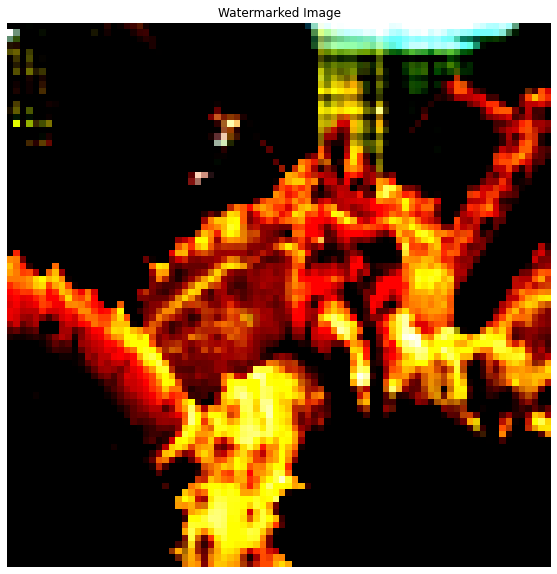

  9%|▉         | 1/11 [00:07<01:16,  7.61s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 3: Target opacity: 0, Labeled correctly: 0.7466666666666667, Correctly Predicted Target: True, Base class predicted: False


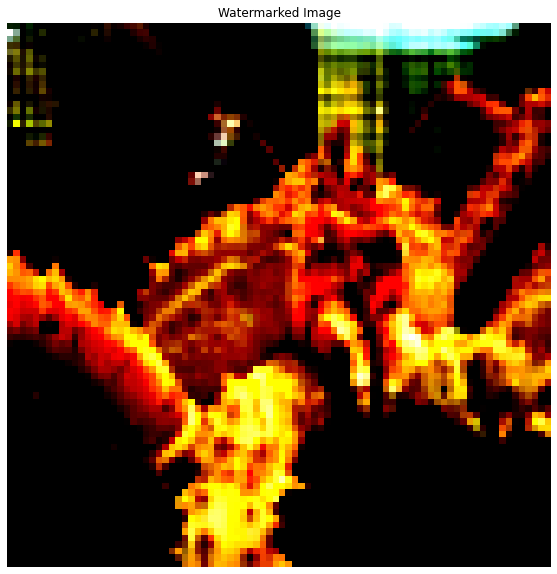

 18%|█▊        | 2/11 [00:13<00:58,  6.46s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 3: Target opacity: 0.05, Labeled correctly: 0.76, Correctly Predicted Target: True, Base class predicted: False


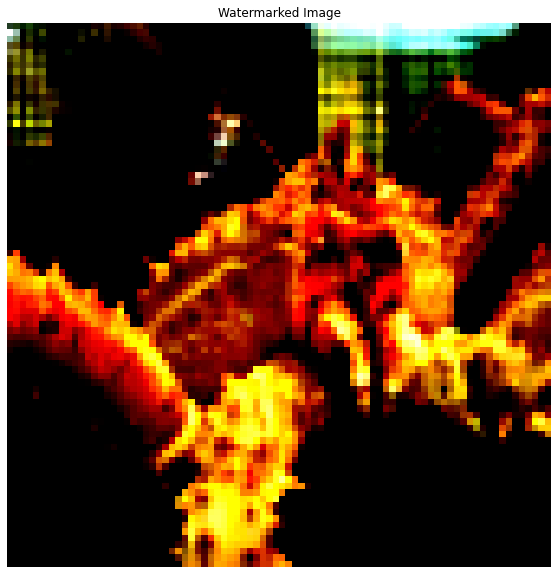

 27%|██▋       | 3/11 [00:18<00:48,  6.08s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 3: Target opacity: 0.1, Labeled correctly: 0.76, Correctly Predicted Target: True, Base class predicted: False


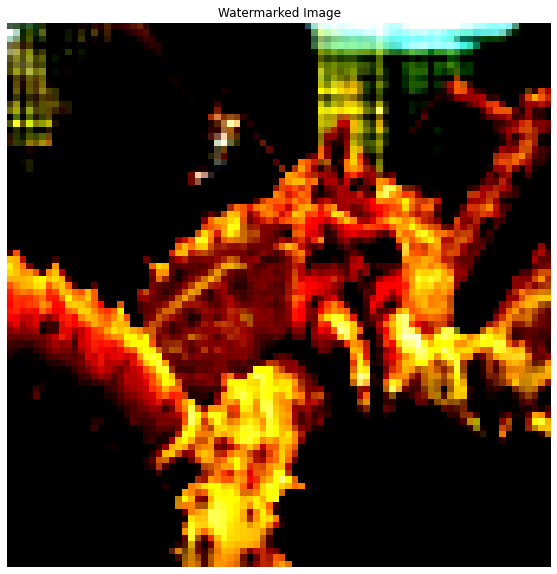

 36%|███▋      | 4/11 [00:24<00:41,  5.90s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 3: Target opacity: 0.15, Labeled correctly: 0.76, Correctly Predicted Target: True, Base class predicted: False


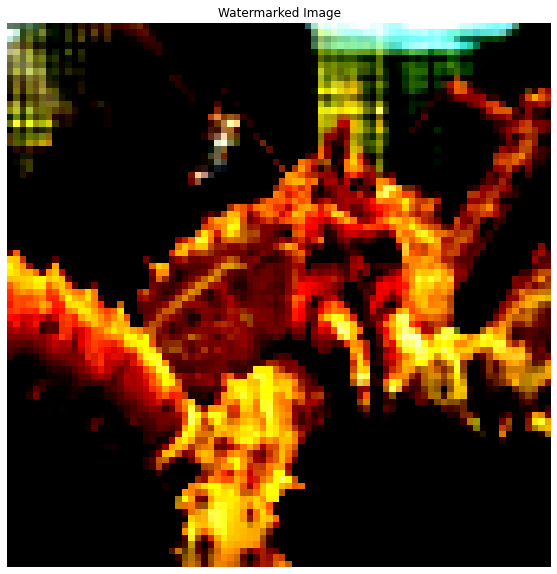

 45%|████▌     | 5/11 [00:30<00:34,  5.79s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 3: Target opacity: 0.2, Labeled correctly: 0.76, Correctly Predicted Target: True, Base class predicted: False


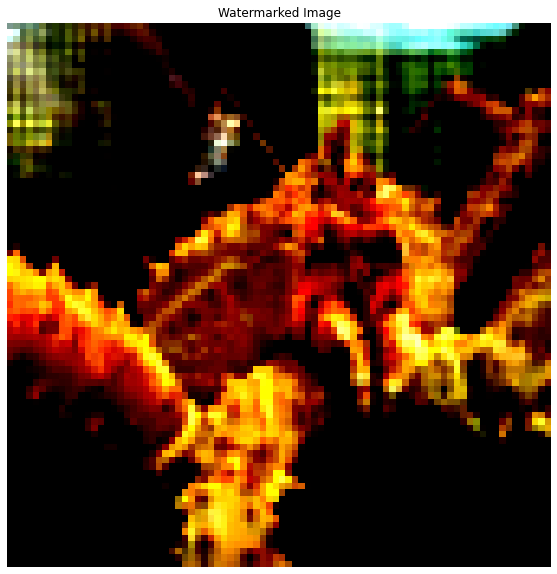

 55%|█████▍    | 6/11 [00:35<00:28,  5.69s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 3: Target opacity: 0.25, Labeled correctly: 0.76, Correctly Predicted Target: True, Base class predicted: False


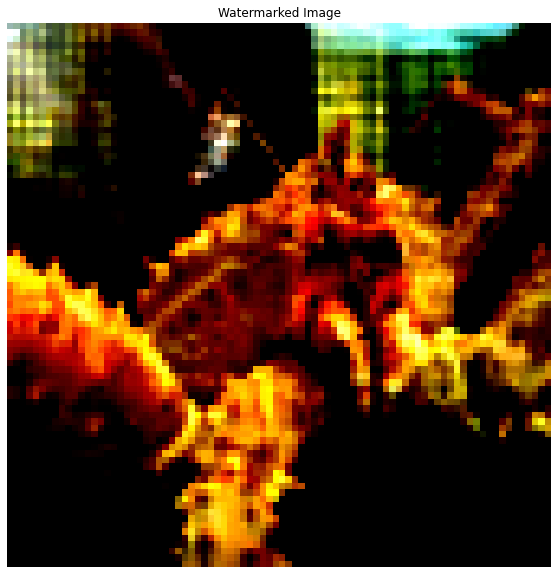

 64%|██████▎   | 7/11 [00:41<00:22,  5.61s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 3: Target opacity: 0.3, Labeled correctly: 0.7466666666666667, Correctly Predicted Target: True, Base class predicted: False


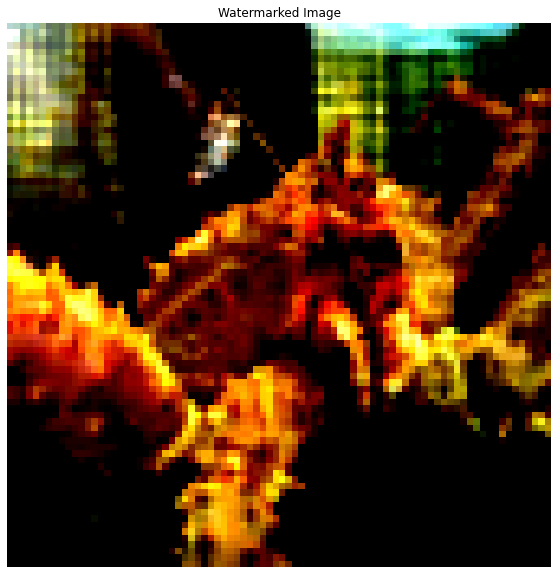

 73%|███████▎  | 8/11 [00:46<00:16,  5.56s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 3: Target opacity: 0.35, Labeled correctly: 0.7466666666666667, Correctly Predicted Target: True, Base class predicted: False


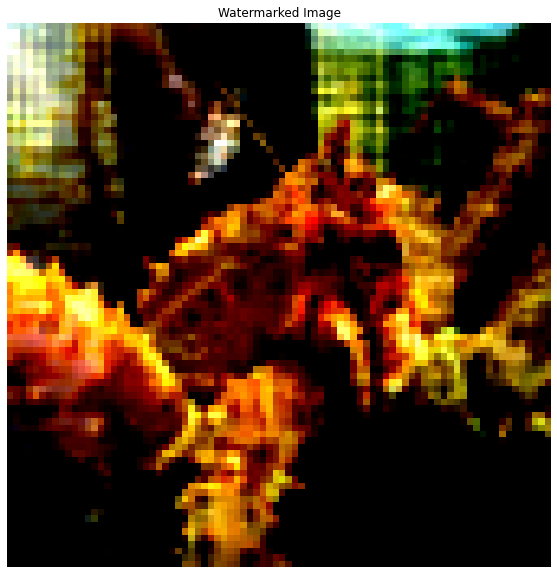

 82%|████████▏ | 9/11 [00:51<00:11,  5.53s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 3: Target opacity: 0.4, Labeled correctly: 0.7066666666666667, Correctly Predicted Target: True, Base class predicted: False


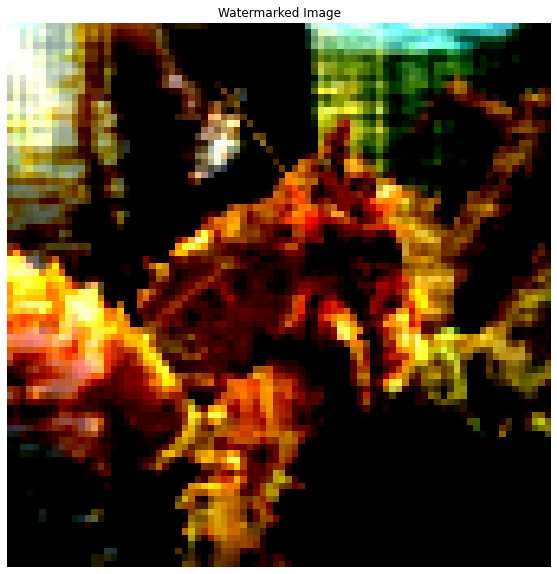

 91%|█████████ | 10/11 [00:57<00:05,  5.50s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 3: Target opacity: 0.45, Labeled correctly: 0.72, Correctly Predicted Target: True, Base class predicted: False


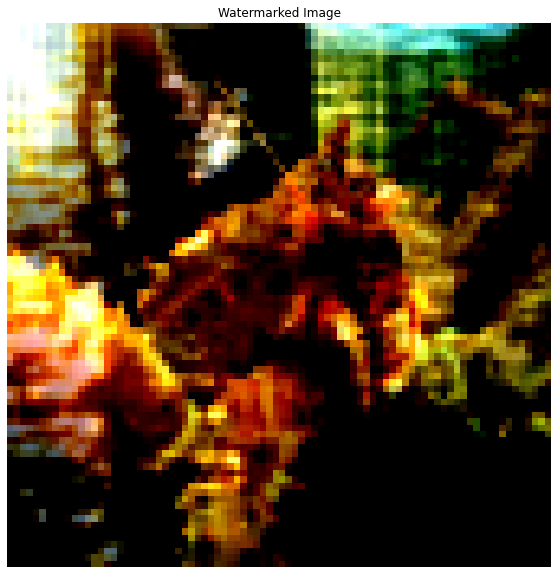

100%|██████████| 11/11 [01:02<00:00,  5.71s/it]

Iteration 3: Target opacity: 0.5, Labeled correctly: 0.6933333333333334, Correctly Predicted Target: False, Base class predicted: True



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


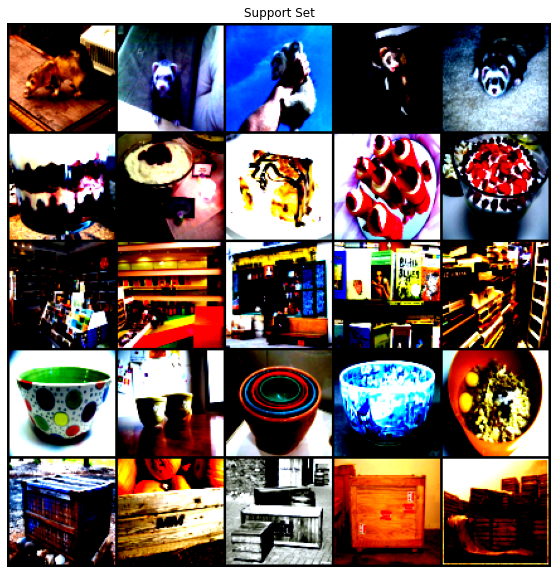

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 3, 3, 3, 3, 3, 1, 1, 1, 1,
         1]])


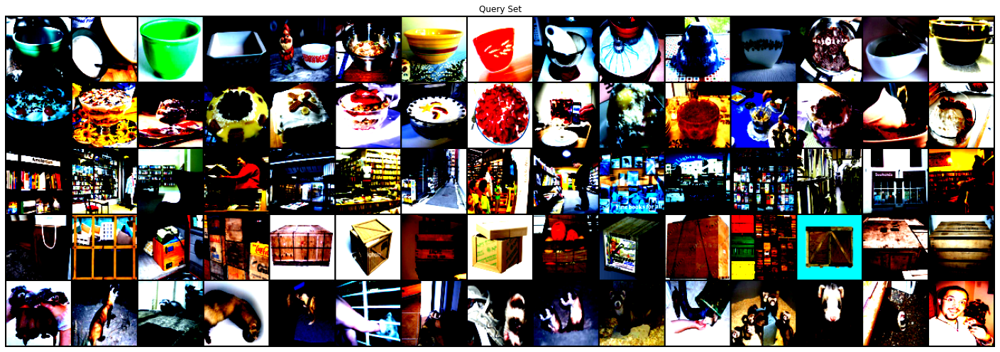

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 1, 1, 1,
         1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
         2, 2, 2]])
target_class 4
unique_classes [0, 1, 2, 3]
base_class 1
target_indices [30 31 32 33 34 35 36 37 38 39 40 41 42 43 44]
target_index 41
base_indices [20 21 22 23 24]
base_index 23


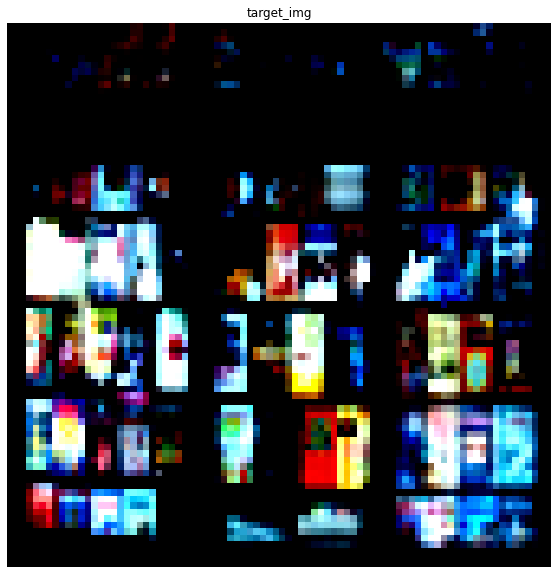

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


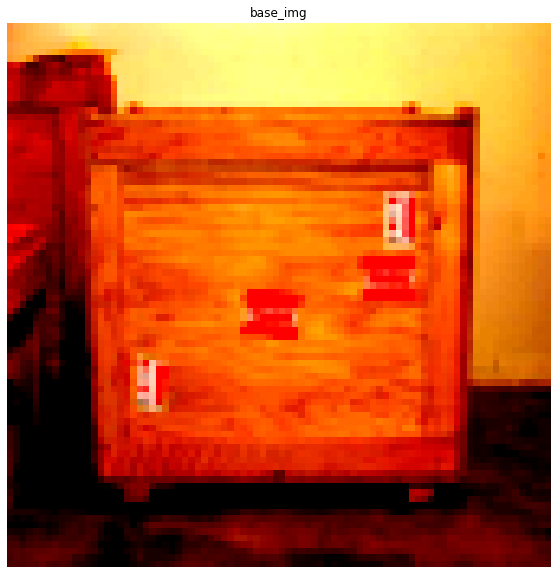

  0%|          | 3/1000 [00:00<00:36, 26.97it/s]

Iteration 0
loss: tensor(19.5278, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(1.2927, grad_fn=<PowBackward0>)
Iteration 2
loss: tensor(19.0347, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(59.2414, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(1.6785, grad_fn=<PowBackward0>)
Iteration 5


  1%|          | 9/1000 [00:00<00:37, 26.42it/s]

loss: tensor(10.6474, grad_fn=<PowBackward0>)
Iteration 6
loss: tensor(0.0201, grad_fn=<PowBackward0>)
Iteration 7
loss: tensor(5.5377, grad_fn=<PowBackward0>)
Iteration 8
loss: tensor(8.6746, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(40.5417, grad_fn=<PowBackward0>)
Iteration 10
loss: tensor(0.0794, grad_fn=<PowBackward0>)


  2%|▏         | 15/1000 [00:00<00:38, 25.39it/s]

Iteration 11
loss: tensor(1.9294, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(7.1339, grad_fn=<PowBackward0>)
Iteration 13
loss: tensor(76.7916, grad_fn=<PowBackward0>)
Iteration 14
loss: tensor(1.6592, grad_fn=<PowBackward0>)
Iteration 15
loss: tensor(22.2172, grad_fn=<PowBackward0>)


  2%|▏         | 21/1000 [00:00<00:38, 25.41it/s]

Iteration 16
loss: tensor(3.0279, grad_fn=<PowBackward0>)
Iteration 17
loss: tensor(66.7094, grad_fn=<PowBackward0>)
Iteration 18
loss: tensor(3.2511, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(8.4170, grad_fn=<PowBackward0>)
Iteration 20
loss: tensor(90.2079, grad_fn=<PowBackward0>)
Iteration 21


  2%|▏         | 24/1000 [00:00<00:38, 25.22it/s]

loss: tensor(0.1875, grad_fn=<PowBackward0>)
Iteration 22
loss: tensor(0.3316, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(1.0841, grad_fn=<PowBackward0>)
Iteration 24
loss: tensor(64.1957, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(0.4039, grad_fn=<PowBackward0>)
Iteration 26
loss: tensor(0.6400, grad_fn=<PowBackward0>)


  3%|▎         | 30/1000 [00:01<00:39, 24.72it/s]

Iteration 27
loss: tensor(18.1666, grad_fn=<PowBackward0>)
Iteration 28
loss: tensor(1.5571, grad_fn=<PowBackward0>)
Iteration 29
loss: tensor(63.6366, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(0.7225, grad_fn=<PowBackward0>)
Iteration 31
loss: tensor(8.7356, grad_fn=<PowBackward0>)
Iteration 32


  4%|▎         | 36/1000 [00:01<00:38, 24.92it/s]

loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 33
loss: tensor(1.3929, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(7.8547, grad_fn=<PowBackward0>)
Iteration 35
loss: tensor(65.3988, grad_fn=<PowBackward0>)
Iteration 36
loss: tensor(1.6349, grad_fn=<PowBackward0>)
Iteration 37
loss: tensor(3.7798, grad_fn=<PowBackward0>)


  4%|▍         | 42/1000 [00:01<00:37, 25.73it/s]

Iteration 38
loss: tensor(63.9076, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(1.4243, grad_fn=<PowBackward0>)
Iteration 40
loss: tensor(8.1765, grad_fn=<PowBackward0>)
Iteration 41
loss: tensor(74.1428, grad_fn=<PowBackward0>)
Iteration 42
loss: tensor(1.0991, grad_fn=<PowBackward0>)
Iteration 43


  5%|▍         | 48/1000 [00:01<00:37, 25.31it/s]

loss: tensor(19.8438, grad_fn=<PowBackward0>)
Iteration 44
loss: tensor(5.5961, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(51.6980, grad_fn=<PowBackward0>)
Iteration 46
loss: tensor(0.5201, grad_fn=<PowBackward0>)
Iteration 47
loss: tensor(5.7134, grad_fn=<PowBackward0>)
Iteration 48


  5%|▌         | 51/1000 [00:02<00:38, 24.34it/s]

loss: tensor(79.0683, grad_fn=<PowBackward0>)
Iteration 49
loss: tensor(4.7129, grad_fn=<PowBackward0>)
Iteration 50
loss: tensor(6.7490, grad_fn=<PowBackward0>)
Iteration 51
loss: tensor(43.1268, grad_fn=<PowBackward0>)
Iteration 52
loss: tensor(2.5823, grad_fn=<PowBackward0>)
Iteration 53
loss: tensor(12.1694, grad_fn=<PowBackward0>)


  6%|▌         | 57/1000 [00:02<00:38, 24.66it/s]

Iteration 54
loss: tensor(48.4259, grad_fn=<PowBackward0>)
Iteration 55
loss: tensor(10.4594, grad_fn=<PowBackward0>)
Iteration 56
loss: tensor(41.8724, grad_fn=<PowBackward0>)
Iteration 57
loss: tensor(5.5545, grad_fn=<PowBackward0>)
Iteration 58
loss: tensor(33.7709, grad_fn=<PowBackward0>)
Iteration 59


  6%|▋         | 63/1000 [00:02<00:38, 24.54it/s]

loss: tensor(1.3553, grad_fn=<PowBackward0>)
Iteration 60
loss: tensor(2.0549, grad_fn=<PowBackward0>)
Iteration 61
loss: tensor(117.0640, grad_fn=<PowBackward0>)
Iteration 62
loss: tensor(11.3586, grad_fn=<PowBackward0>)
Iteration 63
loss: tensor(2.8316, grad_fn=<PowBackward0>)
Iteration 64


  7%|▋         | 69/1000 [00:02<00:37, 24.72it/s]

loss: tensor(38.7390, grad_fn=<PowBackward0>)
Iteration 65
loss: tensor(6.8451, grad_fn=<PowBackward0>)
Iteration 66
loss: tensor(7.8058, grad_fn=<PowBackward0>)
Iteration 67
loss: tensor(88.6016, grad_fn=<PowBackward0>)
Iteration 68
loss: tensor(0.0812, grad_fn=<PowBackward0>)
Iteration 69
loss:

  7%|▋         | 72/1000 [00:02<00:37, 24.57it/s]

 tensor(3.1989, grad_fn=<PowBackward0>)
Iteration 70
loss: tensor(61.5863, grad_fn=<PowBackward0>)
Iteration 71
loss: tensor(0.3448, grad_fn=<PowBackward0>)
Iteration 72
loss: tensor(1.8480, grad_fn=<PowBackward0>)
Iteration 73
loss: tensor(17.8105, grad_fn=<PowBackward0>)
Iteration 74
loss: tensor(78.1337, grad_fn=<PowBackward0>)


  8%|▊         | 78/1000 [00:03<00:38, 24.19it/s]

Iteration 75
loss: tensor(2.9053, grad_fn=<PowBackward0>)
Iteration 76
loss: tensor(7.6974, grad_fn=<PowBackward0>)
Iteration 77
loss: tensor(86.2057, grad_fn=<PowBackward0>)
Iteration 78
loss: tensor(3.2574, grad_fn=<PowBackward0>)
Iteration 79
loss: tensor(13.8154, grad_fn=<PowBackward0>)


  8%|▊         | 84/1000 [00:03<00:37, 24.18it/s]

Iteration 80
loss: tensor(30.6514, grad_fn=<PowBackward0>)
Iteration 81
loss: tensor(1.2265, grad_fn=<PowBackward0>)
Iteration 82
loss: tensor(37.6339, grad_fn=<PowBackward0>)
Iteration 83
loss: tensor(0.6032, grad_fn=<PowBackward0>)
Iteration 84
loss: tensor(18.1953, grad_fn=<PowBackward0>)


  9%|▊         | 87/1000 [00:03<00:38, 23.85it/s]

Iteration 85
loss: tensor(0.3855, grad_fn=<PowBackward0>)
Iteration 86
loss: tensor(8.9005, grad_fn=<PowBackward0>)
Iteration 87
loss: tensor(136.8974, grad_fn=<PowBackward0>)
Iteration 88
loss: tensor(3.0263, grad_fn=<PowBackward0>)
Iteration 89
loss: tensor(4.8486, grad_fn=<PowBackward0>)


  9%|▉         | 93/1000 [00:03<00:38, 23.83it/s]

Iteration 90
loss: tensor(54.2695, grad_fn=<PowBackward0>)
Iteration 91
loss: tensor(0.0088, grad_fn=<PowBackward0>)
Iteration 92
loss: tensor(0.5179, grad_fn=<PowBackward0>)
Iteration 93
loss: tensor(5.8858, grad_fn=<PowBackward0>)
Iteration 94
loss: tensor(95.3057, grad_fn=<PowBackward0>)


 10%|▉         | 99/1000 [00:04<00:37, 24.09it/s]

Iteration 95
loss: tensor(0.0597, grad_fn=<PowBackward0>)
Iteration 96
loss: tensor(0.4965, grad_fn=<PowBackward0>)
Iteration 97
loss: tensor(3.3299, grad_fn=<PowBackward0>)
Iteration 98
loss: tensor(99.1675, grad_fn=<PowBackward0>)
Iteration 99
loss: tensor(1.3913, grad_fn=<PowBackward0>)


 10%|█         | 105/1000 [00:04<00:37, 23.60it/s]

Iteration 100
loss: tensor(7.7153, grad_fn=<PowBackward0>)
Iteration 101
loss: tensor(50.9337, grad_fn=<PowBackward0>)
Iteration 102
loss: tensor(0.7362, grad_fn=<PowBackward0>)
Iteration 103
loss: tensor(18.4258, grad_fn=<PowBackward0>)
Iteration 104
loss: tensor(1.4660, grad_fn=<PowBackward0>)


 11%|█         | 108/1000 [00:04<00:37, 24.10it/s]

Iteration 105
loss: tensor(41.7522, grad_fn=<PowBackward0>)
Iteration 106
loss: tensor(11.1937, grad_fn=<PowBackward0>)
Iteration 107
loss: tensor(42.5382, grad_fn=<PowBackward0>)
Iteration 108
loss: tensor(3.7950, grad_fn=<PowBackward0>)
Iteration 109
loss: tensor(27.7534, grad_fn=<PowBackward0>)
Iteration 110


 11%|█▏        | 114/1000 [00:04<00:36, 24.45it/s]

loss: tensor(10.1019, grad_fn=<PowBackward0>)
Iteration 111
loss: tensor(37.0485, grad_fn=<PowBackward0>)
Iteration 112
loss: tensor(1.4549, grad_fn=<PowBackward0>)
Iteration 113
loss: tensor(30.5432, grad_fn=<PowBackward0>)
Iteration 114
loss: tensor(0.7524, grad_fn=<PowBackward0>)
Iteration 115
loss: tensor(10.6314, grad_fn=<PowBackward0>)


 12%|█▏        | 120/1000 [00:04<00:34, 25.15it/s]

Iteration 116
loss: tensor(84.3149, grad_fn=<PowBackward0>)
Iteration 117
loss: tensor(3.0145, grad_fn=<PowBackward0>)
Iteration 118
loss: tensor(11.9500, grad_fn=<PowBackward0>)
Iteration 119
loss: tensor(48.7772, grad_fn=<PowBackward0>)
Iteration 120
loss: tensor(2.0262, grad_fn=<PowBackward0>)
Iteration 121


 13%|█▎        | 126/1000 [00:05<00:35, 24.63it/s]

loss: tensor(21.4889, grad_fn=<PowBackward0>)
Iteration 122
loss: tensor(2.8315, grad_fn=<PowBackward0>)
Iteration 123
loss: tensor(60.5852, grad_fn=<PowBackward0>)
Iteration 124
loss: tensor(0.5260, grad_fn=<PowBackward0>)
Iteration 125
loss: tensor(14.0847, grad_fn=<PowBackward0>)
Iteration 126


 13%|█▎        | 129/1000 [00:05<00:35, 24.69it/s]

loss: tensor(9.1164, grad_fn=<PowBackward0>)
Iteration 127
loss: tensor(48.8089, grad_fn=<PowBackward0>)
Iteration 128
loss: tensor(1.6310, grad_fn=<PowBackward0>)
Iteration 129
loss: tensor(31.1173, grad_fn=<PowBackward0>)
Iteration 130
loss: tensor(6.7343, grad_fn=<PowBackward0>)
Iteration 131
loss: tensor(44.3609, grad_fn=<PowBackward0>)


 14%|█▎        | 135/1000 [00:05<00:37, 22.78it/s]

Iteration 132
loss: tensor(3.4488, grad_fn=<PowBackward0>)
Iteration 133
loss: tensor(51.4981, grad_fn=<PowBackward0>)
Iteration 134
loss: tensor(0.7678, grad_fn=<PowBackward0>)
Iteration 135
loss: tensor(11.8226, grad_fn=<PowBackward0>)
Iteration 136


 14%|█▍        | 141/1000 [00:05<00:35, 24.12it/s]

loss: tensor(20.3675, grad_fn=<PowBackward0>)
Iteration 137
loss: tensor(42.1806, grad_fn=<PowBackward0>)
Iteration 138
loss: tensor(1.0637, grad_fn=<PowBackward0>)
Iteration 139
loss: tensor(27.6304, grad_fn=<PowBackward0>)
Iteration 140
loss: tensor(2.1393, grad_fn=<PowBackward0>)
Iteration 141


 14%|█▍        | 144/1000 [00:05<00:37, 23.11it/s]

loss: tensor(36.4564, grad_fn=<PowBackward0>)
Iteration 142
loss: tensor(5.8926, grad_fn=<PowBackward0>)
Iteration 143
loss: tensor(107.2193, grad_fn=<PowBackward0>)
Iteration 144
loss: tensor(6.6245, grad_fn=<PowBackward0>)
Iteration 145
loss: tensor(9.6906, grad_fn=<PowBackward0>)
Iteration 146
loss:

 15%|█▌        | 150/1000 [00:06<00:36, 23.29it/s]

 tensor(53.6741, grad_fn=<PowBackward0>)
Iteration 147
loss: tensor(2.1344, grad_fn=<PowBackward0>)
Iteration 148
loss: tensor(18.0648, grad_fn=<PowBackward0>)
Iteration 149
loss: tensor(3.4474, grad_fn=<PowBackward0>)
Iteration 150
loss: tensor(68.9372, grad_fn=<PowBackward0>)
Iteration 151


 16%|█▌        | 156/1000 [00:06<00:35, 23.92it/s]

loss: tensor(1.7614, grad_fn=<PowBackward0>)
Iteration 152
loss: tensor(10.7340, grad_fn=<PowBackward0>)
Iteration 153
loss: tensor(6.0702, grad_fn=<PowBackward0>)
Iteration 154
loss: tensor(48.5409, grad_fn=<PowBackward0>)
Iteration 155
loss: tensor(6.9530, grad_fn=<PowBackward0>)
Iteration 156


 16%|█▌        | 159/1000 [00:06<00:34, 24.08it/s]

loss: tensor(45.7436, grad_fn=<PowBackward0>)
Iteration 157
loss: tensor(0.7958, grad_fn=<PowBackward0>)
Iteration 158
loss: tensor(24.3009, grad_fn=<PowBackward0>)
Iteration 159
loss: tensor(10.7869, grad_fn=<PowBackward0>)
Iteration 160
loss: tensor(59.0970, grad_fn=<PowBackward0>)
Iteration 161
loss: tensor(0.5903, grad_fn=<PowBackward0>)


 16%|█▋        | 165/1000 [00:06<00:33, 24.87it/s]

Iteration 162
loss: tensor(3.8160, grad_fn=<PowBackward0>)
Iteration 163
loss: tensor(46.2972, grad_fn=<PowBackward0>)
Iteration 164
loss: tensor(0.1801, grad_fn=<PowBackward0>)
Iteration 165
loss: tensor(3.5996, grad_fn=<PowBackward0>)
Iteration 166
loss: tensor(12.7337, grad_fn=<PowBackward0>)
Iteration 167


 17%|█▋        | 171/1000 [00:07<00:33, 24.83it/s]

loss: tensor(70.2503, grad_fn=<PowBackward0>)
Iteration 168
loss: tensor(0.4528, grad_fn=<PowBackward0>)
Iteration 169
loss: tensor(3.9954, grad_fn=<PowBackward0>)
Iteration 170
loss: tensor(10.5163, grad_fn=<PowBackward0>)
Iteration 171
loss: tensor(54.8212, grad_fn=<PowBackward0>)
Iteration 172


 18%|█▊        | 177/1000 [00:07<00:33, 24.72it/s]

loss: tensor(0.2257, grad_fn=<PowBackward0>)
Iteration 173
loss: tensor(0.9764, grad_fn=<PowBackward0>)
Iteration 174
loss: tensor(9.6170, grad_fn=<PowBackward0>)
Iteration 175
loss: tensor(70.6291, grad_fn=<PowBackward0>)
Iteration 176
loss: tensor(2.0953, grad_fn=<PowBackward0>)
Iteration 177


 18%|█▊        | 180/1000 [00:07<00:32, 24.89it/s]

loss: tensor(13.8957, grad_fn=<PowBackward0>)
Iteration 178
loss: tensor(5.3015, grad_fn=<PowBackward0>)
Iteration 179
loss: tensor(52.6572, grad_fn=<PowBackward0>)
Iteration 180
loss: tensor(0.2274, grad_fn=<PowBackward0>)
Iteration 181
loss: tensor(9.8123, grad_fn=<PowBackward0>)
Iteration 182
loss: tensor(3.7958, grad_fn=<PowBackward0>)


 19%|█▊        | 186/1000 [00:07<00:31, 25.81it/s]

Iteration 183
loss: tensor(59.5175, grad_fn=<PowBackward0>)
Iteration 184
loss: tensor(8.0145, grad_fn=<PowBackward0>)
Iteration 185
loss: tensor(50.5659, grad_fn=<PowBackward0>)
Iteration 186
loss: tensor(5.0825, grad_fn=<PowBackward0>)
Iteration 187
loss: tensor(26.1764, grad_fn=<PowBackward0>)
Iteration 188


 19%|█▉        | 192/1000 [00:07<00:32, 25.11it/s]

loss: tensor(3.8652, grad_fn=<PowBackward0>)
Iteration 189
loss: tensor(37.1614, grad_fn=<PowBackward0>)
Iteration 190
loss: tensor(3.2987, grad_fn=<PowBackward0>)
Iteration 191
loss: tensor(26.4079, grad_fn=<PowBackward0>)
Iteration 192
loss: tensor(6.5984, grad_fn=<PowBackward0>)
Iteration 193
loss: tensor(33.2161, grad_fn=<PowBackward0>)


 20%|█▉        | 198/1000 [00:08<00:32, 24.95it/s]

Iteration 194
loss: tensor(0.6187, grad_fn=<PowBackward0>)
Iteration 195
loss: tensor(14.0424, grad_fn=<PowBackward0>)
Iteration 196
loss: tensor(18.1250, grad_fn=<PowBackward0>)
Iteration 197
loss: tensor(70.3129, grad_fn=<PowBackward0>)
Iteration 198
loss: tensor(0.0370, grad_fn=<PowBackward0>)


 20%|██        | 201/1000 [00:08<00:33, 24.11it/s]

Iteration 199
loss: tensor(0.2707, grad_fn=<PowBackward0>)
Iteration 200
loss: tensor(3.2931, grad_fn=<PowBackward0>)
Iteration 201
loss: tensor(99.9850, grad_fn=<PowBackward0>)
Iteration 202
loss: tensor(3.9555, grad_fn=<PowBackward0>)
Iteration 203
loss: tensor(11.7837, grad_fn=<PowBackward0>)


 21%|██        | 207/1000 [00:08<00:32, 24.16it/s]

Iteration 204
loss: tensor(6.8212, grad_fn=<PowBackward0>)
Iteration 205
loss: tensor(19.7419, grad_fn=<PowBackward0>)
Iteration 206
loss: tensor(7.0704, grad_fn=<PowBackward0>)
Iteration 207
loss: tensor(30.3503, grad_fn=<PowBackward0>)
Iteration 208
loss: tensor(4.2803, grad_fn=<PowBackward0>)
Iteration 209


 21%|██▏       | 213/1000 [00:08<00:31, 25.15it/s]

loss: tensor(21.6698, grad_fn=<PowBackward0>)
Iteration 210
loss: tensor(8.2938, grad_fn=<PowBackward0>)
Iteration 211
loss: tensor(24.1946, grad_fn=<PowBackward0>)
Iteration 212
loss: tensor(7.0033, grad_fn=<PowBackward0>)
Iteration 213
loss: tensor(36.8400, grad_fn=<PowBackward0>)
Iteration 214
loss: tensor(7.9778, grad_fn=<PowBackward0>)


 22%|██▏       | 219/1000 [00:08<00:31, 25.18it/s]

Iteration 215
loss: tensor(43.2126, grad_fn=<PowBackward0>)
Iteration 216
loss: tensor(6.6207, grad_fn=<PowBackward0>)
Iteration 217
loss: tensor(33.8818, grad_fn=<PowBackward0>)
Iteration 218
loss: tensor(9.0521, grad_fn=<PowBackward0>)
Iteration 219
loss: tensor(25.4748, grad_fn=<PowBackward0>)
Iteration 

 22%|██▏       | 222/1000 [00:09<00:31, 24.96it/s]

220
loss: tensor(9.0576, grad_fn=<PowBackward0>)
Iteration 221
loss: tensor(40.4465, grad_fn=<PowBackward0>)
Iteration 222
loss: tensor(6.2162, grad_fn=<PowBackward0>)
Iteration 223
loss: tensor(26.5009, grad_fn=<PowBackward0>)
Iteration 224
loss: tensor(13.6481, grad_fn=<PowBackward0>)


 23%|██▎       | 228/1000 [00:09<00:32, 23.97it/s]

Iteration 225
loss: tensor(29.0803, grad_fn=<PowBackward0>)
Iteration 226
loss: tensor(8.3899, grad_fn=<PowBackward0>)
Iteration 227
loss: tensor(46.6652, grad_fn=<PowBackward0>)
Iteration 228
loss: tensor(0.0198, grad_fn=<PowBackward0>)
Iteration 229
loss: tensor(1.1842, grad_fn=<PowBackward0>)
Iteration 230


 23%|██▎       | 234/1000 [00:09<00:31, 24.30it/s]

loss: tensor(13.9880, grad_fn=<PowBackward0>)
Iteration 231
loss: tensor(52.8954, grad_fn=<PowBackward0>)
Iteration 232
loss: tensor(5.2399, grad_fn=<PowBackward0>)
Iteration 233
loss: tensor(26.1243, grad_fn=<PowBackward0>)
Iteration 234
loss: tensor(5.7784, grad_fn=<PowBackward0>)
Iteration 235


 24%|██▍       | 240/1000 [00:09<00:30, 25.33it/s]

loss: tensor(30.5605, grad_fn=<PowBackward0>)
Iteration 236
loss: tensor(1.2094, grad_fn=<PowBackward0>)
Iteration 237
loss: tensor(14.5006, grad_fn=<PowBackward0>)
Iteration 238
loss: tensor(16.8559, grad_fn=<PowBackward0>)
Iteration 239
loss: tensor(42.2650, grad_fn=<PowBackward0>)
Iteration 240
loss: tensor(7.8128, grad_fn=<PowBackward0>)


 25%|██▍       | 246/1000 [00:10<00:28, 26.47it/s]

Iteration 241
loss: tensor(39.6323, grad_fn=<PowBackward0>)
Iteration 242
loss: tensor(1.6114, grad_fn=<PowBackward0>)
Iteration 243
loss: tensor(22.0482, grad_fn=<PowBackward0>)
Iteration 244
loss: tensor(10.2647, grad_fn=<PowBackward0>)
Iteration 245
loss: tensor(34.6571, grad_fn=<PowBackward0>)
Iteration 246
loss: 

 25%|██▍       | 249/1000 [00:10<00:29, 25.68it/s]

tensor(3.6213, grad_fn=<PowBackward0>)
Iteration 247
loss: tensor(27.3878, grad_fn=<PowBackward0>)
Iteration 248
loss: tensor(12.5392, grad_fn=<PowBackward0>)
Iteration 249
loss: tensor(28.4286, grad_fn=<PowBackward0>)
Iteration 250
loss: tensor(4.2390, grad_fn=<PowBackward0>)
Iteration 251


 26%|██▌       | 255/1000 [00:10<00:29, 25.15it/s]

loss: tensor(20.5780, grad_fn=<PowBackward0>)
Iteration 252
loss: tensor(10.3557, grad_fn=<PowBackward0>)
Iteration 253
loss: tensor(31.5227, grad_fn=<PowBackward0>)
Iteration 254
loss: tensor(5.5102, grad_fn=<PowBackward0>)
Iteration 255
loss: tensor(28.6935, grad_fn=<PowBackward0>)
Iteration 256
loss: tensor(5.4114, grad_fn=<PowBackward0>)


 26%|██▌       | 261/1000 [00:10<00:28, 26.20it/s]

Iteration 257
loss: tensor(27.4653, grad_fn=<PowBackward0>)
Iteration 258
loss: tensor(6.5570, grad_fn=<PowBackward0>)
Iteration 259
loss: tensor(27.4545, grad_fn=<PowBackward0>)
Iteration 260
loss: tensor(0.7378, grad_fn=<PowBackward0>)
Iteration 261
loss: tensor(9.8597, grad_fn=<PowBackward0>)
Iteration 262
loss:

 27%|██▋       | 267/1000 [00:10<00:28, 25.54it/s]

 tensor(16.3172, grad_fn=<PowBackward0>)
Iteration 263
loss: tensor(44.6452, grad_fn=<PowBackward0>)
Iteration 264
loss: tensor(7.1539, grad_fn=<PowBackward0>)
Iteration 265
loss: tensor(50.0164, grad_fn=<PowBackward0>)
Iteration 266
loss: tensor(0.0874, grad_fn=<PowBackward0>)
Iteration 267


 27%|██▋       | 270/1000 [00:10<00:30, 24.26it/s]

loss: tensor(0.9205, grad_fn=<PowBackward0>)
Iteration 268
loss: tensor(13.1562, grad_fn=<PowBackward0>)
Iteration 269
loss: tensor(50.1027, grad_fn=<PowBackward0>)
Iteration 270
loss: tensor(1.0102, grad_fn=<PowBackward0>)
Iteration 271
loss: tensor(14.6070, grad_fn=<PowBackward0>)
Iteration 272


 28%|██▊       | 276/1000 [00:11<00:29, 24.58it/s]

loss: tensor(48.9679, grad_fn=<PowBackward0>)
Iteration 273
loss: tensor(0.1712, grad_fn=<PowBackward0>)
Iteration 274
loss: tensor(2.1194, grad_fn=<PowBackward0>)
Iteration 275
loss: tensor(7.4357, grad_fn=<PowBackward0>)
Iteration 276
loss: tensor(49.4203, grad_fn=<PowBackward0>)


 28%|██▊       | 282/1000 [00:11<00:30, 23.51it/s]

Iteration 277
loss: tensor(2.9502, grad_fn=<PowBackward0>)
Iteration 278
loss: tensor(34.0746, grad_fn=<PowBackward0>)
Iteration 279
loss: tensor(5.6724, grad_fn=<PowBackward0>)
Iteration 280
loss: tensor(47.7766, grad_fn=<PowBackward0>)
Iteration 281
loss: tensor(3.2817, grad_fn=<PowBackward0>)


 28%|██▊       | 285/1000 [00:11<00:29, 24.32it/s]

Iteration 282
loss: tensor(35.5503, grad_fn=<PowBackward0>)
Iteration 283
loss: tensor(6.1434, grad_fn=<PowBackward0>)
Iteration 284
loss: tensor(27.3831, grad_fn=<PowBackward0>)
Iteration 285
loss: tensor(1.4017, grad_fn=<PowBackward0>)
Iteration 286
loss: tensor(19.2182, grad_fn=<PowBackward0>)
Iteration 287


 29%|██▉       | 291/1000 [00:11<00:30, 23.43it/s]

loss: tensor(15.8895, grad_fn=<PowBackward0>)
Iteration 288
loss: tensor(31.8220, grad_fn=<PowBackward0>)
Iteration 289
loss: tensor(4.9018, grad_fn=<PowBackward0>)
Iteration 290
loss: tensor(29.3575, grad_fn=<PowBackward0>)
Iteration 291
loss: tensor(5.9655, grad_fn=<PowBackward0>)


 29%|██▉       | 294/1000 [00:11<00:30, 22.99it/s]

Iteration 292
loss: tensor(21.8899, grad_fn=<PowBackward0>)
Iteration 293
loss: tensor(12.7223, grad_fn=<PowBackward0>)
Iteration 294
loss: tensor(45.1742, grad_fn=<PowBackward0>)
Iteration 295
loss: tensor(5.4678, grad_fn=<PowBackward0>)
Iteration 296
loss: tensor(20.0287, grad_fn=<PowBackward0>)


 30%|███       | 300/1000 [00:12<00:30, 22.67it/s]

Iteration 297
loss: tensor(7.5946, grad_fn=<PowBackward0>)
Iteration 298
loss: tensor(34.7933, grad_fn=<PowBackward0>)
Iteration 299
loss: tensor(1.2202, grad_fn=<PowBackward0>)
Iteration 300
loss: tensor(18.3196, grad_fn=<PowBackward0>)
Iteration 301


 31%|███       | 306/1000 [00:12<00:30, 22.59it/s]

loss: tensor(11.1253, grad_fn=<PowBackward0>)
Iteration 302
loss: tensor(19.9442, grad_fn=<PowBackward0>)
Iteration 303
loss: tensor(7.1117, grad_fn=<PowBackward0>)
Iteration 304
loss: tensor(7.5059, grad_fn=<PowBackward0>)
Iteration 305
loss: tensor(7.3012, grad_fn=<PowBackward0>)
Iteration 306


 31%|███       | 309/1000 [00:12<00:29, 23.26it/s]

loss: tensor(9.5874, grad_fn=<PowBackward0>)
Iteration 307
loss: tensor(5.5469, grad_fn=<PowBackward0>)
Iteration 308
loss: tensor(19.1502, grad_fn=<PowBackward0>)
Iteration 309
loss: tensor(4.5354, grad_fn=<PowBackward0>)
Iteration 310
loss: tensor(18.7197, grad_fn=<PowBackward0>)
Iteration 311
loss: tensor(7.4229, grad_fn=<PowBackward0>)


 32%|███▏      | 315/1000 [00:12<00:27, 24.65it/s]

Iteration 312
loss: tensor(11.3147, grad_fn=<PowBackward0>)
Iteration 313
loss: tensor(5.8076, grad_fn=<PowBackward0>)
Iteration 314
loss: tensor(7.5031, grad_fn=<PowBackward0>)
Iteration 315
loss: tensor(3.2200, grad_fn=<PowBackward0>)
Iteration 316
loss: tensor(11.7947, grad_fn=<PowBackward0>)
Iteration 317


 32%|███▏      | 321/1000 [00:13<00:27, 24.34it/s]

loss: tensor(5.6785, grad_fn=<PowBackward0>)
Iteration 318
loss: tensor(29.8534, grad_fn=<PowBackward0>)
Iteration 319
loss: tensor(6.4656, grad_fn=<PowBackward0>)
Iteration 320
loss: tensor(13.6455, grad_fn=<PowBackward0>)
Iteration 321
loss: tensor(5.4527, grad_fn=<PowBackward0>)
Iteration 322


 33%|███▎      | 327/1000 [00:13<00:28, 23.95it/s]

loss: tensor(8.3967, grad_fn=<PowBackward0>)
Iteration 323
loss: tensor(4.2943, grad_fn=<PowBackward0>)
Iteration 324
loss: tensor(13.0751, grad_fn=<PowBackward0>)
Iteration 325
loss: tensor(4.8055, grad_fn=<PowBackward0>)
Iteration 326
loss: tensor(16.4973, grad_fn=<PowBackward0>)
Iteration 327


 33%|███▎      | 330/1000 [00:13<00:27, 24.01it/s]

loss: tensor(7.3880, grad_fn=<PowBackward0>)
Iteration 328
loss: tensor(11.7463, grad_fn=<PowBackward0>)
Iteration 329
loss: tensor(5.1900, grad_fn=<PowBackward0>)
Iteration 330
loss: tensor(5.0703, grad_fn=<PowBackward0>)
Iteration 331
loss: tensor(3.7412, grad_fn=<PowBackward0>)
Iteration 332


 34%|███▎      | 336/1000 [00:13<00:26, 24.80it/s]

loss: tensor(3.9907, grad_fn=<PowBackward0>)
Iteration 333
loss: tensor(5.7247, grad_fn=<PowBackward0>)
Iteration 334
loss: tensor(37.5101, grad_fn=<PowBackward0>)
Iteration 335
loss: tensor(9.5514, grad_fn=<PowBackward0>)
Iteration 336
loss: tensor(12.8883, grad_fn=<PowBackward0>)
Iteration 337
loss: tensor(13.8327, grad_fn=<PowBackward0>)


 34%|███▍      | 342/1000 [00:13<00:26, 25.29it/s]

Iteration 338
loss: tensor(18.5590, grad_fn=<PowBackward0>)
Iteration 339
loss: tensor(6.9726, grad_fn=<PowBackward0>)
Iteration 340
loss: tensor(10.9225, grad_fn=<PowBackward0>)
Iteration 341
loss: tensor(3.7235, grad_fn=<PowBackward0>)
Iteration 342
loss: tensor(5.5054, grad_fn=<PowBackward0>)
Iteration 343


 35%|███▍      | 348/1000 [00:14<00:26, 24.98it/s]

loss: tensor(2.1712, grad_fn=<PowBackward0>)
Iteration 344
loss: tensor(17.2863, grad_fn=<PowBackward0>)
Iteration 345
loss: tensor(9.0461, grad_fn=<PowBackward0>)
Iteration 346
loss: tensor(23.3254, grad_fn=<PowBackward0>)
Iteration 347
loss: tensor(13.2336, grad_fn=<PowBackward0>)
Iteration 348


 35%|███▌      | 351/1000 [00:14<00:26, 24.68it/s]

loss: tensor(28.5919, grad_fn=<PowBackward0>)
Iteration 349
loss: tensor(1.6867, grad_fn=<PowBackward0>)
Iteration 350
loss: tensor(5.8018, grad_fn=<PowBackward0>)
Iteration 351
loss: tensor(9.3467, grad_fn=<PowBackward0>)
Iteration 352
loss: tensor(14.8304, grad_fn=<PowBackward0>)
Iteration 353
loss: tensor(3.1017, grad_fn=<PowBackward0>)


 36%|███▌      | 357/1000 [00:14<00:25, 25.28it/s]

Iteration 354
loss: tensor(12.8009, grad_fn=<PowBackward0>)
Iteration 355
loss: tensor(3.4488, grad_fn=<PowBackward0>)
Iteration 356
loss: tensor(13.8159, grad_fn=<PowBackward0>)
Iteration 357
loss: tensor(8.3699, grad_fn=<PowBackward0>)
Iteration 358
loss: tensor(13.2980, grad_fn=<PowBackward0>)
Iteration 359


 36%|███▋      | 363/1000 [00:14<00:24, 25.66it/s]

loss: tensor(3.8083, grad_fn=<PowBackward0>)
Iteration 360
loss: tensor(12.6069, grad_fn=<PowBackward0>)
Iteration 361
loss: tensor(2.6114, grad_fn=<PowBackward0>)
Iteration 362
loss: tensor(12.9415, grad_fn=<PowBackward0>)
Iteration 363
loss: tensor(5.4490, grad_fn=<PowBackward0>)
Iteration 364
loss: tensor(22.1756, grad_fn=<PowBackward0>)


 37%|███▋      | 369/1000 [00:15<00:24, 25.75it/s]

Iteration 365
loss: tensor(8.4508, grad_fn=<PowBackward0>)
Iteration 366
loss: tensor(16.6249, grad_fn=<PowBackward0>)
Iteration 367
loss: tensor(9.9465, grad_fn=<PowBackward0>)
Iteration 368
loss: tensor(17.9323, grad_fn=<PowBackward0>)
Iteration 369
loss: tensor(4.2068, grad_fn=<PowBackward0>)
Iteration 370


 38%|███▊      | 375/1000 [00:15<00:24, 25.51it/s]

loss: tensor(7.3299, grad_fn=<PowBackward0>)
Iteration 371
loss: tensor(5.4127, grad_fn=<PowBackward0>)
Iteration 372
loss: tensor(6.5559, grad_fn=<PowBackward0>)
Iteration 373
loss: tensor(2.9316, grad_fn=<PowBackward0>)
Iteration 374
loss: tensor(9.4840, grad_fn=<PowBackward0>)
Iteration 375
loss: 

 38%|███▊      | 378/1000 [00:15<00:26, 23.79it/s]

tensor(2.6125, grad_fn=<PowBackward0>)
Iteration 376
loss: tensor(25.9093, grad_fn=<PowBackward0>)
Iteration 377
loss: tensor(10.7814, grad_fn=<PowBackward0>)
Iteration 378
loss: tensor(9.6543, grad_fn=<PowBackward0>)
Iteration 379
loss: tensor(3.9120, grad_fn=<PowBackward0>)
Iteration 380
loss:

 38%|███▊      | 384/1000 [00:15<00:26, 23.05it/s]

 tensor(10.3578, grad_fn=<PowBackward0>)
Iteration 381
loss: tensor(6.5824, grad_fn=<PowBackward0>)
Iteration 382
loss: tensor(17.3255, grad_fn=<PowBackward0>)
Iteration 383
loss: tensor(8.8470, grad_fn=<PowBackward0>)
Iteration 384
loss: tensor(13.6239, grad_fn=<PowBackward0>)


 39%|███▉      | 390/1000 [00:15<00:25, 24.02it/s]

Iteration 385
loss: tensor(3.9084, grad_fn=<PowBackward0>)
Iteration 386
loss: tensor(6.9354, grad_fn=<PowBackward0>)
Iteration 387
loss: tensor(2.6048, grad_fn=<PowBackward0>)
Iteration 388
loss: tensor(8.2156, grad_fn=<PowBackward0>)
Iteration 389
loss: tensor(3.3526, grad_fn=<PowBackward0>)
Iteration 390


 39%|███▉      | 393/1000 [00:16<00:25, 23.55it/s]

loss: tensor(11.4580, grad_fn=<PowBackward0>)
Iteration 391
loss: tensor(6.6130, grad_fn=<PowBackward0>)
Iteration 392
loss: tensor(25.0934, grad_fn=<PowBackward0>)
Iteration 393
loss: tensor(2.3152, grad_fn=<PowBackward0>)
Iteration 394
loss: tensor(16.8412, grad_fn=<PowBackward0>)
Iteration 395


 40%|███▉      | 399/1000 [00:16<00:23, 25.09it/s]

loss: tensor(8.0539, grad_fn=<PowBackward0>)
Iteration 396
loss: tensor(20.7108, grad_fn=<PowBackward0>)
Iteration 397
loss: tensor(10.7354, grad_fn=<PowBackward0>)
Iteration 398
loss: tensor(9.3691, grad_fn=<PowBackward0>)
Iteration 399
loss: tensor(4.1208, grad_fn=<PowBackward0>)
Iteration 400


 40%|████      | 405/1000 [00:16<00:24, 24.67it/s]

loss: tensor(5.3544, grad_fn=<PowBackward0>)
Iteration 401
loss: tensor(5.9869, grad_fn=<PowBackward0>)
Iteration 402
loss: tensor(4.8574, grad_fn=<PowBackward0>)
Iteration 403
loss: tensor(1.3471, grad_fn=<PowBackward0>)
Iteration 404
loss: tensor(0.9156, grad_fn=<PowBackward0>)
Iteration 405
loss: tensor(0.2571, grad_fn=<PowBackward0>)


 41%|████      | 411/1000 [00:16<00:23, 24.74it/s]

Iteration 406
loss: tensor(0.4055, grad_fn=<PowBackward0>)
Iteration 407
loss: tensor(0.4480, grad_fn=<PowBackward0>)
Iteration 408
loss: tensor(1.9164, grad_fn=<PowBackward0>)
Iteration 409
loss: tensor(2.4548, grad_fn=<PowBackward0>)
Iteration 410
loss: tensor(9.0205, grad_fn=<PowBackward0>)
Iteration 411


 41%|████▏     | 414/1000 [00:16<00:23, 24.95it/s]

loss: tensor(4.0529, grad_fn=<PowBackward0>)
Iteration 412
loss: tensor(12.5188, grad_fn=<PowBackward0>)
Iteration 413
loss: tensor(10.1981, grad_fn=<PowBackward0>)
Iteration 414
loss: tensor(8.2567, grad_fn=<PowBackward0>)
Iteration 415
loss: tensor(3.8550, grad_fn=<PowBackward0>)
Iteration 416


 42%|████▏     | 420/1000 [00:17<00:22, 25.61it/s]

loss: tensor(5.5013, grad_fn=<PowBackward0>)
Iteration 417
loss: tensor(3.7294, grad_fn=<PowBackward0>)
Iteration 418
loss: tensor(3.5589, grad_fn=<PowBackward0>)
Iteration 419
loss: tensor(2.6131, grad_fn=<PowBackward0>)
Iteration 420
loss: tensor(4.8624, grad_fn=<PowBackward0>)
Iteration 421
loss: tensor(4.4842, grad_fn=<PowBackward0>)


 43%|████▎     | 426/1000 [00:17<00:24, 23.63it/s]

Iteration 422
loss: tensor(5.6129, grad_fn=<PowBackward0>)
Iteration 423
loss: tensor(2.4783, grad_fn=<PowBackward0>)
Iteration 424
loss: tensor(5.7724, grad_fn=<PowBackward0>)
Iteration 425
loss: tensor(4.0676, grad_fn=<PowBackward0>)
Iteration 426


 43%|████▎     | 429/1000 [00:17<00:23, 23.83it/s]

loss: tensor(8.1010, grad_fn=<PowBackward0>)
Iteration 427
loss: tensor(4.6470, grad_fn=<PowBackward0>)
Iteration 428
loss: tensor(1.8625, grad_fn=<PowBackward0>)
Iteration 429
loss: tensor(0.5681, grad_fn=<PowBackward0>)
Iteration 430
loss: tensor(0.4792, grad_fn=<PowBackward0>)
Iteration 431
loss: tensor(0.2027, grad_fn=<PowBackward0>)


 44%|████▎     | 435/1000 [00:17<00:23, 24.46it/s]

Iteration 432
loss: tensor(0.6525, grad_fn=<PowBackward0>)
Iteration 433
loss: tensor(0.6173, grad_fn=<PowBackward0>)
Iteration 434
loss: tensor(1.6343, grad_fn=<PowBackward0>)
Iteration 435
loss: tensor(1.7023, grad_fn=<PowBackward0>)
Iteration 436
loss: tensor(8.1597, grad_fn=<PowBackward0>)
Iteration 437
loss: 

 44%|████▍     | 441/1000 [00:18<00:22, 24.89it/s]

tensor(3.4619, grad_fn=<PowBackward0>)
Iteration 438
loss: tensor(11.1937, grad_fn=<PowBackward0>)
Iteration 439
loss: tensor(7.1108, grad_fn=<PowBackward0>)
Iteration 440
loss: tensor(8.8479, grad_fn=<PowBackward0>)
Iteration 441
loss: tensor(6.9154, grad_fn=<PowBackward0>)
Iteration 442
loss: tensor(5.5080, grad_fn=<PowBackward0>)


 45%|████▍     | 447/1000 [00:18<00:21, 26.22it/s]

Iteration 443
loss: tensor(2.7995, grad_fn=<PowBackward0>)
Iteration 444
loss: tensor(2.3790, grad_fn=<PowBackward0>)
Iteration 445
loss: tensor(1.5573, grad_fn=<PowBackward0>)
Iteration 446
loss: tensor(2.3110, grad_fn=<PowBackward0>)
Iteration 447
loss: tensor(1.4356, grad_fn=<PowBackward0>)
Iteration 448


 45%|████▌     | 453/1000 [00:18<00:22, 24.41it/s]

loss: tensor(2.2619, grad_fn=<PowBackward0>)
Iteration 449
loss: tensor(1.7160, grad_fn=<PowBackward0>)
Iteration 450
loss: tensor(4.2103, grad_fn=<PowBackward0>)
Iteration 451
loss: tensor(2.6949, grad_fn=<PowBackward0>)
Iteration 452
loss: tensor(9.5380, grad_fn=<PowBackward0>)


 46%|████▌     | 456/1000 [00:18<00:22, 23.95it/s]

Iteration 453
loss: tensor(4.0528, grad_fn=<PowBackward0>)
Iteration 454
loss: tensor(8.9351, grad_fn=<PowBackward0>)
Iteration 455
loss: tensor(5.2225, grad_fn=<PowBackward0>)
Iteration 456
loss: tensor(2.1225, grad_fn=<PowBackward0>)
Iteration 457
loss: tensor(0.8113, grad_fn=<PowBackward0>)
Iteration 458


 46%|████▌     | 462/1000 [00:18<00:21, 25.27it/s]

loss: tensor(1.0103, grad_fn=<PowBackward0>)
Iteration 459
loss: tensor(0.4910, grad_fn=<PowBackward0>)
Iteration 460
loss: tensor(1.0182, grad_fn=<PowBackward0>)
Iteration 461
loss: tensor(0.6761, grad_fn=<PowBackward0>)
Iteration 462
loss: tensor(1.4649, grad_fn=<PowBackward0>)
Iteration 463
loss: tensor(1.3750, grad_fn=<PowBackward0>)


 47%|████▋     | 468/1000 [00:19<00:20, 25.49it/s]

Iteration 464
loss: tensor(2.4491, grad_fn=<PowBackward0>)
Iteration 465
loss: tensor(2.4991, grad_fn=<PowBackward0>)
Iteration 466
loss: tensor(3.4299, grad_fn=<PowBackward0>)
Iteration 467
loss: tensor(2.7541, grad_fn=<PowBackward0>)
Iteration 468
loss: tensor(5.0556, grad_fn=<PowBackward0>)
Iteration 469


 47%|████▋     | 474/1000 [00:19<00:21, 24.60it/s]

loss: tensor(2.1199, grad_fn=<PowBackward0>)
Iteration 470
loss: tensor(4.9848, grad_fn=<PowBackward0>)
Iteration 471
loss: tensor(2.0748, grad_fn=<PowBackward0>)
Iteration 472
loss: tensor(3.1743, grad_fn=<PowBackward0>)
Iteration 473
loss: tensor(2.8067, grad_fn=<PowBackward0>)
Iteration 474


 48%|████▊     | 477/1000 [00:19<00:21, 24.45it/s]

loss: tensor(1.9422, grad_fn=<PowBackward0>)
Iteration 475
loss: tensor(1.0949, grad_fn=<PowBackward0>)
Iteration 476
loss: tensor(0.9866, grad_fn=<PowBackward0>)
Iteration 477
loss: tensor(0.4086, grad_fn=<PowBackward0>)
Iteration 478
loss: tensor(0.5472, grad_fn=<PowBackward0>)
Iteration 479
loss: tensor(0.2873, grad_fn=<PowBackward0>)


 48%|████▊     | 483/1000 [00:19<00:21, 24.54it/s]

Iteration 480
loss: tensor(0.5613, grad_fn=<PowBackward0>)
Iteration 481
loss: tensor(0.4158, grad_fn=<PowBackward0>)
Iteration 482
loss: tensor(1.9393, grad_fn=<PowBackward0>)
Iteration 483
loss: tensor(2.3186, grad_fn=<PowBackward0>)
Iteration 484
loss: tensor(8.4775, grad_fn=<PowBackward0>)
Iteration 485


 49%|████▉     | 489/1000 [00:19<00:19, 25.58it/s]

loss: tensor(2.5382, grad_fn=<PowBackward0>)
Iteration 486
loss: tensor(6.8083, grad_fn=<PowBackward0>)
Iteration 487
loss: tensor(6.9965, grad_fn=<PowBackward0>)
Iteration 488
loss: tensor(10.4798, grad_fn=<PowBackward0>)
Iteration 489
loss: tensor(4.6238, grad_fn=<PowBackward0>)
Iteration 490
loss: tensor(3.1836, grad_fn=<PowBackward0>)


 50%|████▉     | 495/1000 [00:20<00:19, 26.44it/s]

Iteration 491
loss: tensor(2.9900, grad_fn=<PowBackward0>)
Iteration 492
loss: tensor(2.4717, grad_fn=<PowBackward0>)
Iteration 493
loss: tensor(1.2750, grad_fn=<PowBackward0>)
Iteration 494
loss: tensor(1.3901, grad_fn=<PowBackward0>)
Iteration 495
loss: tensor(0.9429, grad_fn=<PowBackward0>)
Iteration 496
loss: tensor(1.2166, grad_fn=<PowBackward0>)


 50%|█████     | 501/1000 [00:20<00:19, 25.80it/s]

Iteration 497
loss: tensor(0.4932, grad_fn=<PowBackward0>)
Iteration 498
loss: tensor(1.7585, grad_fn=<PowBackward0>)
Iteration 499
loss: tensor(2.2307, grad_fn=<PowBackward0>)
Iteration 500
loss: tensor(10.8080, grad_fn=<PowBackward0>)
Iteration 501
loss: tensor(4.9375, grad_fn=<PowBackward0>)
Iteration 502


 51%|█████     | 507/1000 [00:20<00:19, 25.87it/s]

loss: tensor(0.1624, grad_fn=<PowBackward0>)
Iteration 503
loss: tensor(0.0357, grad_fn=<PowBackward0>)
Iteration 504
loss: tensor(0.0107, grad_fn=<PowBackward0>)
Iteration 505
loss: tensor(0.0083, grad_fn=<PowBackward0>)
Iteration 506
loss: tensor(0.0075, grad_fn=<PowBackward0>)
Iteration 507
loss: tensor(0.0073, grad_fn=<PowBackward0>)


 51%|█████▏    | 513/1000 [00:20<00:18, 26.00it/s]

Iteration 508
loss: tensor(0.0073, grad_fn=<PowBackward0>)
Iteration 509
loss: tensor(0.0075, grad_fn=<PowBackward0>)
Iteration 510
loss: tensor(0.0092, grad_fn=<PowBackward0>)
Iteration 511
loss: tensor(0.0086, grad_fn=<PowBackward0>)
Iteration 512
loss: tensor(0.0107, grad_fn=<PowBackward0>)
Iteration 513


 52%|█████▏    | 516/1000 [00:20<00:18, 25.88it/s]

loss: tensor(0.0090, grad_fn=<PowBackward0>)
Iteration 514
loss: tensor(0.0110, grad_fn=<PowBackward0>)
Iteration 515
loss: tensor(0.0095, grad_fn=<PowBackward0>)
Iteration 516
loss: tensor(0.0102, grad_fn=<PowBackward0>)
Iteration 517
loss: tensor(0.0105, grad_fn=<PowBackward0>)
Iteration 518
loss: tensor(0.0103, grad_fn=<PowBackward0>)


 52%|█████▏    | 522/1000 [00:21<00:19, 25.05it/s]

Iteration 519
loss: tensor(0.0102, grad_fn=<PowBackward0>)
Iteration 520
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 521
loss: tensor(0.0125, grad_fn=<PowBackward0>)
Iteration 522
loss: tensor(0.0087, grad_fn=<PowBackward0>)
Iteration 523
loss: tensor(0.0153, grad_fn=<PowBackward0>)
Iteration 524


 53%|█████▎    | 528/1000 [00:21<00:18, 25.02it/s]

loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 525
loss: tensor(0.0365, grad_fn=<PowBackward0>)
Iteration 526
loss: tensor(0.0257, grad_fn=<PowBackward0>)
Iteration 527
loss: tensor(0.1753, grad_fn=<PowBackward0>)
Iteration 528
loss: tensor(0.2719, grad_fn=<PowBackward0>)
Iteration 529


 53%|█████▎    | 534/1000 [00:21<00:18, 24.95it/s]

loss: tensor(1.1589, grad_fn=<PowBackward0>)
Iteration 530
loss: tensor(1.6529, grad_fn=<PowBackward0>)
Iteration 531
loss: tensor(2.7157, grad_fn=<PowBackward0>)
Iteration 532
loss: tensor(1.6924, grad_fn=<PowBackward0>)
Iteration 533
loss: tensor(0.9901, grad_fn=<PowBackward0>)
Iteration 534
loss: tensor(0.4317, grad_fn=<PowBackward0>)


 54%|█████▍    | 540/1000 [00:21<00:18, 24.93it/s]

Iteration 535
loss: tensor(0.3827, grad_fn=<PowBackward0>)
Iteration 536
loss: tensor(0.1350, grad_fn=<PowBackward0>)
Iteration 537
loss: tensor(0.1876, grad_fn=<PowBackward0>)
Iteration 538
loss: tensor(0.0812, grad_fn=<PowBackward0>)
Iteration 539
loss: tensor(0.1299, grad_fn=<PowBackward0>)
Iteration 540


 54%|█████▍    | 543/1000 [00:22<00:18, 24.92it/s]

loss: tensor(0.0417, grad_fn=<PowBackward0>)
Iteration 541
loss: tensor(0.1257, grad_fn=<PowBackward0>)
Iteration 542
loss: tensor(0.0838, grad_fn=<PowBackward0>)
Iteration 543
loss: tensor(0.1581, grad_fn=<PowBackward0>)
Iteration 544
loss: tensor(0.0678, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(0.1748, grad_fn=<PowBackward0>)


 55%|█████▍    | 549/1000 [00:22<00:18, 24.80it/s]

Iteration 546
loss: tensor(0.0999, grad_fn=<PowBackward0>)
Iteration 547
loss: tensor(0.2408, grad_fn=<PowBackward0>)
Iteration 548
loss: tensor(0.2028, grad_fn=<PowBackward0>)
Iteration 549
loss: tensor(0.6151, grad_fn=<PowBackward0>)
Iteration 550
loss: tensor(0.7171, grad_fn=<PowBackward0>)
Iteration 551


 56%|█████▌    | 555/1000 [00:22<00:18, 23.76it/s]

loss: tensor(0.7146, grad_fn=<PowBackward0>)
Iteration 552
loss: tensor(0.4694, grad_fn=<PowBackward0>)
Iteration 553
loss: tensor(0.5117, grad_fn=<PowBackward0>)
Iteration 554
loss: tensor(0.3420, grad_fn=<PowBackward0>)
Iteration 555
loss: tensor(0.3197, grad_fn=<PowBackward0>)


 56%|█████▌    | 561/1000 [00:22<00:17, 24.72it/s]

Iteration 556
loss: tensor(0.1602, grad_fn=<PowBackward0>)
Iteration 557
loss: tensor(0.2016, grad_fn=<PowBackward0>)
Iteration 558
loss: tensor(0.0909, grad_fn=<PowBackward0>)
Iteration 559
loss: tensor(0.1877, grad_fn=<PowBackward0>)
Iteration 560
loss: tensor(0.1005, grad_fn=<PowBackward0>)
Iteration 561


 56%|█████▋    | 564/1000 [00:22<00:17, 24.99it/s]

loss: tensor(0.3631, grad_fn=<PowBackward0>)
Iteration 562
loss: tensor(0.3698, grad_fn=<PowBackward0>)
Iteration 563
loss: tensor(0.5593, grad_fn=<PowBackward0>)
Iteration 564
loss: tensor(0.4411, grad_fn=<PowBackward0>)
Iteration 565
loss: tensor(0.8252, grad_fn=<PowBackward0>)
Iteration 566
loss: tensor(0.7870, grad_fn=<PowBackward0>)


 57%|█████▋    | 570/1000 [00:23<00:17, 25.26it/s]

Iteration 567
loss: tensor(0.7667, grad_fn=<PowBackward0>)
Iteration 568
loss: tensor(0.4314, grad_fn=<PowBackward0>)
Iteration 569
loss: tensor(0.5742, grad_fn=<PowBackward0>)
Iteration 570
loss: tensor(0.3901, grad_fn=<PowBackward0>)
Iteration 571
loss: tensor(0.9819, grad_fn=<PowBackward0>)
Iteration 572
loss: tensor(0.9328, grad_fn=<PowBackward0>)


 58%|█████▊    | 576/1000 [00:23<00:15, 26.58it/s]

Iteration 573
loss: tensor(1.1706, grad_fn=<PowBackward0>)
Iteration 574
loss: tensor(0.8838, grad_fn=<PowBackward0>)
Iteration 575
loss: tensor(1.0240, grad_fn=<PowBackward0>)
Iteration 576
loss: tensor(0.7767, grad_fn=<PowBackward0>)
Iteration 577
loss: tensor(0.5995, grad_fn=<PowBackward0>)
Iteration 578
loss: tensor(0.2729, grad_fn=<PowBackward0>)


 58%|█████▊    | 582/1000 [00:23<00:16, 25.09it/s]

Iteration 579
loss: tensor(0.3656, grad_fn=<PowBackward0>)
Iteration 580
loss: tensor(0.2111, grad_fn=<PowBackward0>)
Iteration 581
loss: tensor(0.2527, grad_fn=<PowBackward0>)
Iteration 582
loss: tensor(0.1047, grad_fn=<PowBackward0>)
Iteration 583
loss: tensor(0.3005, grad_fn=<PowBackward0>)


 59%|█████▉    | 588/1000 [00:23<00:16, 25.59it/s]

Iteration 584
loss: tensor(0.2240, grad_fn=<PowBackward0>)
Iteration 585
loss: tensor(0.5068, grad_fn=<PowBackward0>)
Iteration 586
loss: tensor(0.5372, grad_fn=<PowBackward0>)
Iteration 587
loss: tensor(0.5378, grad_fn=<PowBackward0>)
Iteration 588
loss: tensor(0.3138, grad_fn=<PowBackward0>)
Iteration 589


 59%|█████▉    | 594/1000 [00:24<00:15, 26.43it/s]

loss: tensor(0.2727, grad_fn=<PowBackward0>)
Iteration 590
loss: tensor(0.0804, grad_fn=<PowBackward0>)
Iteration 591
loss: tensor(0.1269, grad_fn=<PowBackward0>)
Iteration 592
loss: tensor(0.0419, grad_fn=<PowBackward0>)
Iteration 593
loss: tensor(0.1410, grad_fn=<PowBackward0>)
Iteration 594
loss: tensor(0.0902, grad_fn=<PowBackward0>)


 60%|██████    | 600/1000 [00:24<00:15, 25.98it/s]

Iteration 595
loss: tensor(0.1918, grad_fn=<PowBackward0>)
Iteration 596
loss: tensor(0.1323, grad_fn=<PowBackward0>)
Iteration 597
loss: tensor(0.2583, grad_fn=<PowBackward0>)
Iteration 598
loss: tensor(0.1747, grad_fn=<PowBackward0>)
Iteration 599
loss: tensor(0.5988, grad_fn=<PowBackward0>)
Iteration 600


 60%|██████    | 603/1000 [00:24<00:15, 25.83it/s]

loss: tensor(0.5621, grad_fn=<PowBackward0>)
Iteration 601
loss: tensor(0.8902, grad_fn=<PowBackward0>)
Iteration 602
loss: tensor(0.0452, grad_fn=<PowBackward0>)
Iteration 603
loss: tensor(0.0075, grad_fn=<PowBackward0>)
Iteration 604
loss: tensor(0.0073, grad_fn=<PowBackward0>)
Iteration 605
loss: tensor(0.0070, grad_fn=<PowBackward0>)


 61%|██████    | 609/1000 [00:24<00:15, 25.63it/s]

Iteration 606
loss: tensor(0.0066, grad_fn=<PowBackward0>)
Iteration 607
loss: tensor(0.0065, grad_fn=<PowBackward0>)
Iteration 608
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 609
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 610
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 611
loss: 

 62%|██████▏   | 615/1000 [00:24<00:14, 26.30it/s]

tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 612
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 613
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 614
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 615
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 616
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 617


 62%|██████▏   | 621/1000 [00:25<00:14, 26.93it/s]

loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 618
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 619
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 620
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 621
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 622
loss: tensor(0.0051, grad_fn=<PowBackward0>)

 63%|██████▎   | 627/1000 [00:25<00:13, 26.70it/s]


Iteration 623
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 624
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 625
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 626
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 627
loss: tensor(0.0072, grad_fn=<PowBackward0>)


 63%|██████▎   | 633/1000 [00:25<00:14, 26.06it/s]

Iteration 628
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 629
loss: tensor(0.0070, grad_fn=<PowBackward0>)
Iteration 630
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 631
loss: tensor(0.0072, grad_fn=<PowBackward0>)
Iteration 632
loss: tensor(0.0048, grad_fn=<PowBackward0>)


 64%|██████▎   | 636/1000 [00:25<00:14, 25.80it/s]

Iteration 633
loss: tensor(0.0074, grad_fn=<PowBackward0>)
Iteration 634
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 635
loss: tensor(0.0071, grad_fn=<PowBackward0>)
Iteration 636
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 637
loss: tensor(0.0057, grad_fn=<PowBackward0>)


 64%|██████▍   | 642/1000 [00:25<00:14, 24.15it/s]

Iteration 638
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 639
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 640
loss: tensor(0.0068, grad_fn=<PowBackward0>)
Iteration 641
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 642
loss: tensor(0.0072, grad_fn=<PowBackward0>)


 65%|██████▍   | 648/1000 [00:26<00:13, 25.50it/s]

Iteration 643
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 644
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 645
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 646
loss: tensor(0.0070, grad_fn=<PowBackward0>)
Iteration 647
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 648
loss: tensor(0.0071, grad_fn=<PowBackward0>)


 65%|██████▌   | 654/1000 [00:26<00:13, 25.93it/s]

Iteration 649
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 650
loss: tensor(0.0067, grad_fn=<PowBackward0>)
Iteration 651
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 652
loss: tensor(0.0073, grad_fn=<PowBackward0>)
Iteration 653
loss: tensor(0.0040, grad_fn=<PowBackward0>)
Iteration 654


 66%|██████▌   | 657/1000 [00:26<00:13, 25.45it/s]

loss: tensor(0.0076, grad_fn=<PowBackward0>)
Iteration 655
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 656
loss: tensor(0.0078, grad_fn=<PowBackward0>)
Iteration 657
loss: tensor(0.0040, grad_fn=<PowBackward0>)
Iteration 658
loss: tensor(0.0080, grad_fn=<PowBackward0>)
Iteration 659
loss: tensor(0.0037, grad_fn=<PowBackward0>)

 66%|██████▋   | 663/1000 [00:26<00:13, 25.45it/s]


Iteration 660
loss: tensor(0.0080, grad_fn=<PowBackward0>)
Iteration 661
loss: tensor(0.0036, grad_fn=<PowBackward0>)
Iteration 662
loss: tensor(0.0086, grad_fn=<PowBackward0>)
Iteration 663
loss: tensor(0.0035, grad_fn=<PowBackward0>)
Iteration 664
loss: tensor(0.0090, grad_fn=<PowBackward0>)


 67%|██████▋   | 669/1000 [00:26<00:12, 26.30it/s]

Iteration 665
loss: tensor(0.0032, grad_fn=<PowBackward0>)
Iteration 666
loss: tensor(0.0093, grad_fn=<PowBackward0>)
Iteration 667
loss: tensor(0.0033, grad_fn=<PowBackward0>)
Iteration 668
loss: tensor(0.0093, grad_fn=<PowBackward0>)
Iteration 669
loss: tensor(0.0032, grad_fn=<PowBackward0>)
Iteration 670


 68%|██████▊   | 675/1000 [00:27<00:12, 25.66it/s]

loss: tensor(0.0090, grad_fn=<PowBackward0>)
Iteration 671
loss: tensor(0.0031, grad_fn=<PowBackward0>)
Iteration 672
loss: tensor(0.0093, grad_fn=<PowBackward0>)
Iteration 673
loss: tensor(0.0032, grad_fn=<PowBackward0>)
Iteration 674
loss: tensor(0.0084, grad_fn=<PowBackward0>)
Iteration 675
loss: tensor(0.0035, grad_fn=<PowBackward0>)


 68%|██████▊   | 681/1000 [00:27<00:12, 25.65it/s]

Iteration 676
loss: tensor(0.0084, grad_fn=<PowBackward0>)
Iteration 677
loss: tensor(0.0033, grad_fn=<PowBackward0>)
Iteration 678
loss: tensor(0.0092, grad_fn=<PowBackward0>)
Iteration 679
loss: tensor(0.0032, grad_fn=<PowBackward0>)
Iteration 680
loss: tensor(0.0090, grad_fn=<PowBackward0>)
Iteration 681


 68%|██████▊   | 684/1000 [00:27<00:12, 25.65it/s]

loss: tensor(0.0032, grad_fn=<PowBackward0>)
Iteration 682
loss: tensor(0.0087, grad_fn=<PowBackward0>)
Iteration 683
loss: tensor(0.0034, grad_fn=<PowBackward0>)
Iteration 684
loss: tensor(0.0085, grad_fn=<PowBackward0>)
Iteration 685
loss: tensor(0.0032, grad_fn=<PowBackward0>)
Iteration 686
loss: tensor(0.0089, grad_fn=<PowBackward0>)


 69%|██████▉   | 690/1000 [00:27<00:12, 24.96it/s]

Iteration 687
loss: tensor(0.0032, grad_fn=<PowBackward0>)
Iteration 688
loss: tensor(0.0099, grad_fn=<PowBackward0>)
Iteration 689
loss: tensor(0.0028, grad_fn=<PowBackward0>)
Iteration 690
loss: tensor(0.0099, grad_fn=<PowBackward0>)
Iteration 691
loss: tensor(0.0029, grad_fn=<PowBackward0>)
Iteration 692


 70%|██████▉   | 696/1000 [00:28<00:11, 26.04it/s]

loss: tensor(0.0086, grad_fn=<PowBackward0>)
Iteration 693
loss: tensor(0.0033, grad_fn=<PowBackward0>)
Iteration 694
loss: tensor(0.0093, grad_fn=<PowBackward0>)
Iteration 695
loss: tensor(0.0030, grad_fn=<PowBackward0>)
Iteration 696
loss: tensor(0.0093, grad_fn=<PowBackward0>)
Iteration 697
loss: tensor(0.0031, grad_fn=<PowBackward0>)
Iteration 698


 70%|███████   | 702/1000 [00:28<00:11, 25.66it/s]

loss: tensor(0.0089, grad_fn=<PowBackward0>)
Iteration 699
loss: tensor(0.0032, grad_fn=<PowBackward0>)
Iteration 700
loss: tensor(0.0087, grad_fn=<PowBackward0>)
Iteration 701
loss: tensor(0.0023, grad_fn=<PowBackward0>)
Iteration 702
loss: tensor(0.0037, grad_fn=<PowBackward0>)
Iteration 703


 71%|███████   | 708/1000 [00:28<00:11, 26.16it/s]

loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 704
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 705
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 706
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 707
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 708
loss: tensor(0.0050, grad_fn=<PowBackward0>)


 71%|███████▏  | 714/1000 [00:28<00:11, 25.59it/s]

Iteration 709
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 710
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 711
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 712
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 713
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 714


 72%|███████▏  | 717/1000 [00:28<00:11, 25.29it/s]

loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 715
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 716
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 717
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 718
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 719
loss: tensor(0.0055, grad_fn=<PowBackward0>)


 72%|███████▏  | 723/1000 [00:29<00:10, 25.21it/s]

Iteration 720
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 721
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 722
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 723
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 724
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 725
loss: tensor(0.0049, grad_fn=<PowBackward0>)


 73%|███████▎  | 729/1000 [00:29<00:10, 26.38it/s]

Iteration 726
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 727
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 728
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 729
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 730
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 731
loss: tensor(0.0057, grad_fn=<PowBackward0>)


 74%|███████▎  | 735/1000 [00:29<00:09, 26.71it/s]

Iteration 732
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 733
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 734
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 735
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 736
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 737
loss: tensor(0.0050, grad_fn=<PowBackward0>)


 74%|███████▍  | 741/1000 [00:29<00:09, 26.72it/s]

Iteration 738
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 739
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 740
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 742
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 743
loss: tensor(0.0057, grad_fn=<PowBackward0>)


 75%|███████▍  | 747/1000 [00:29<00:09, 26.79it/s]

Iteration 744
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 745
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 746
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 747
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 748
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 749
loss: tensor(0.0055, grad_fn=<PowBackward0>)


 75%|███████▌  | 753/1000 [00:30<00:09, 26.76it/s]

Iteration 750
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 751
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 752
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 753
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 754
loss: tensor(0.0065, grad_fn=<PowBackward0>)
Iteration 755


 76%|███████▌  | 759/1000 [00:30<00:09, 26.42it/s]

loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 756
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 757
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 758
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 759
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 760
loss: tensor(0.0052, grad_fn=<PowBackward0>)


 76%|███████▋  | 765/1000 [00:30<00:09, 24.60it/s]

Iteration 761
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 762
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 763
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 764
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 765
loss: tensor(0.0053, grad_fn=<PowBackward0>)


 77%|███████▋  | 771/1000 [00:30<00:08, 25.66it/s]

Iteration 766
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 767
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 768
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 769
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 770
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 771
loss: 

 78%|███████▊  | 777/1000 [00:31<00:08, 26.78it/s]

tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 772
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 773
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 774
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 775
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 776
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 777


 78%|███████▊  | 780/1000 [00:31<00:08, 26.29it/s]

loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 778
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 779
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 780
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 781
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 782
loss: tensor(0.0053, grad_fn=<PowBackward0>)


 79%|███████▊  | 786/1000 [00:31<00:08, 25.99it/s]

Iteration 783
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 784
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 785
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 786
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 787
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 788


 79%|███████▉  | 792/1000 [00:31<00:07, 26.11it/s]

loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 789
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 790
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 791
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 792
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 793
loss: tensor(0.0055, grad_fn=<PowBackward0>)


 80%|███████▉  | 798/1000 [00:31<00:07, 26.22it/s]

Iteration 794
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 795
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 796
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 797
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 798
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 799


 80%|████████  | 804/1000 [00:32<00:07, 25.54it/s]

loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 800
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 801
loss: tensor(0.0031, grad_fn=<PowBackward0>)
Iteration 802
loss: tensor(0.0039, grad_fn=<PowBackward0>)
Iteration 803
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 804
loss: tensor(0.0046, grad_fn=<PowBackward0>)


 81%|████████  | 810/1000 [00:32<00:07, 26.59it/s]

Iteration 805
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 806
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 807
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 808
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 809
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 810
loss: tensor(0.0050, grad_fn=<PowBackward0>)


 82%|████████▏ | 816/1000 [00:32<00:06, 26.33it/s]

Iteration 811
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 812
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 813
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 814
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 815
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 816


 82%|████████▏ | 819/1000 [00:32<00:07, 25.44it/s]

loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 817
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 818
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 819
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 820
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 821
loss: tensor(0.0050, grad_fn=<PowBackward0>)


 82%|████████▎ | 825/1000 [00:32<00:06, 26.49it/s]

Iteration 822
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 823
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 824
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 825
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 826
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 827
loss: tensor(0.0052, grad_fn=<PowBackward0>)


 83%|████████▎ | 831/1000 [00:33<00:06, 27.16it/s]

Iteration 828
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 829
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 830
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 831
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 833
loss: tensor(0.0049, grad_fn=<PowBackward0>)

 84%|████████▎ | 837/1000 [00:33<00:06, 26.56it/s]


Iteration 834
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 835
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 836
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 837
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 838
loss: tensor(0.0051, grad_fn=<PowBackward0>)


 84%|████████▍ | 843/1000 [00:33<00:05, 26.62it/s]

Iteration 839
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 840
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 841
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 842
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 843
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 844


 85%|████████▍ | 849/1000 [00:33<00:05, 26.52it/s]

loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 845
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 846
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 847
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 848
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 849
loss: tensor(0.0051, grad_fn=<PowBackward0>)


 86%|████████▌ | 855/1000 [00:34<00:05, 26.26it/s]

Iteration 850
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 851
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 852
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 853
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 854
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 855


 86%|████████▌ | 858/1000 [00:34<00:05, 25.93it/s]

loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 856
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 857
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 858
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 859
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 860
loss: tensor(0.0051, grad_fn=<PowBackward0>)


 86%|████████▋ | 864/1000 [00:34<00:05, 26.10it/s]

Iteration 861
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 862
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 863
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 864
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 865
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 866


 87%|████████▋ | 870/1000 [00:34<00:05, 25.75it/s]

loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 867
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 868
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 869
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 870
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 871


 88%|████████▊ | 876/1000 [00:34<00:04, 26.18it/s]

loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 872
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 873
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 874
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 875
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 876
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 877


 88%|████████▊ | 882/1000 [00:35<00:04, 25.60it/s]

loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 878
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 879
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 880
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 881
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 882


 88%|████████▊ | 885/1000 [00:35<00:04, 25.07it/s]

loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 883
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 884
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 885
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 886
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 887
loss: tensor(0.0050, grad_fn=<PowBackward0>)


 89%|████████▉ | 891/1000 [00:35<00:04, 25.05it/s]

Iteration 888
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 889
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 890
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 891
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 892
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 893


 90%|████████▉ | 897/1000 [00:35<00:03, 26.04it/s]

loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 894
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 895
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 896
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 897
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 898
loss: tensor(0.0050, grad_fn=<PowBackward0>)


 90%|█████████ | 903/1000 [00:36<00:04, 23.99it/s]

Iteration 899
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 900
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 901
loss: tensor(0.0039, grad_fn=<PowBackward0>)
Iteration 902
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 903
loss: tensor(0.0043, grad_fn=<PowBackward0>)


 91%|█████████ | 909/1000 [00:36<00:03, 25.27it/s]

Iteration 904
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 905
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 906
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 907
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 908
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 909


 91%|█████████ | 912/1000 [00:36<00:03, 25.57it/s]

loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 910
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 911
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 912
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 913
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 914
loss: tensor(0.0049, grad_fn=<PowBackward0>)


 92%|█████████▏| 918/1000 [00:36<00:03, 26.43it/s]

Iteration 915
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 916
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 917
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 918
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 919
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 920
loss: tensor(0.0050, grad_fn=<PowBackward0>)


 92%|█████████▏| 924/1000 [00:36<00:02, 26.89it/s]

Iteration 921
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 922
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 923
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 924
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 925
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 926
loss: tensor(0.0050, grad_fn=<PowBackward0>)


 93%|█████████▎| 930/1000 [00:37<00:02, 27.31it/s]

Iteration 927
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 928
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 929
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 930
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 931
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 932
loss: tensor(0.0049, grad_fn=<PowBackward0>)


 94%|█████████▎| 936/1000 [00:37<00:02, 26.74it/s]

Iteration 933
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 934
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 935
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 936
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 937
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 938


 94%|█████████▍| 942/1000 [00:37<00:02, 26.10it/s]

loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 939
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 940
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 941
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 942
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 943
loss: tensor(0.0051, grad_fn=<PowBackward0>)


 95%|█████████▍| 948/1000 [00:37<00:01, 26.58it/s]

Iteration 944
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 945
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 946
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 947
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 948
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 949
loss: tensor(0.0050, grad_fn=<PowBackward0>)


 95%|█████████▌| 954/1000 [00:37<00:01, 25.90it/s]

Iteration 950
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 951
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 952
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 953
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 954
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 955


 96%|█████████▌| 960/1000 [00:38<00:01, 25.77it/s]

loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 956
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 957
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 958
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 959
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 960
loss: tensor(0.0050, grad_fn=<PowBackward0>)

 96%|█████████▋| 963/1000 [00:38<00:01, 25.59it/s]


Iteration 961
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 962
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 963
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 964
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 965
loss: tensor(0.0052, grad_fn=<PowBackward0>)


 97%|█████████▋| 969/1000 [00:38<00:01, 25.70it/s]

Iteration 966
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 967
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 968
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 969
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 970
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 971


 98%|█████████▊| 975/1000 [00:38<00:00, 25.48it/s]

loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 972
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 973
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 974
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 975
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 976


 98%|█████████▊| 981/1000 [00:39<00:00, 25.17it/s]

loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 977
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 978
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 979
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 980
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 981
loss: tensor(0.0050, grad_fn=<PowBackward0>)


 99%|█████████▊| 987/1000 [00:39<00:00, 25.36it/s]

Iteration 982
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 983
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 984
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 985
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 986
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 987


 99%|█████████▉| 990/1000 [00:39<00:00, 25.32it/s]

loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 988
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 989
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 990
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 991
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 992
loss: tensor(0.0050, grad_fn=<PowBackward0>)


100%|█████████▉| 996/1000 [00:39<00:00, 25.82it/s]

Iteration 993
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 994
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 995
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 996
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 997
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 998
loss: tensor(0.0052, grad_fn=<PowBackward0>)


100%|██████████| 1000/1000 [00:39<00:00, 25.14it/s]


Iteration 999
loss: tensor(0.0051, grad_fn=<PowBackward0>)


  0%|          | 0/11 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


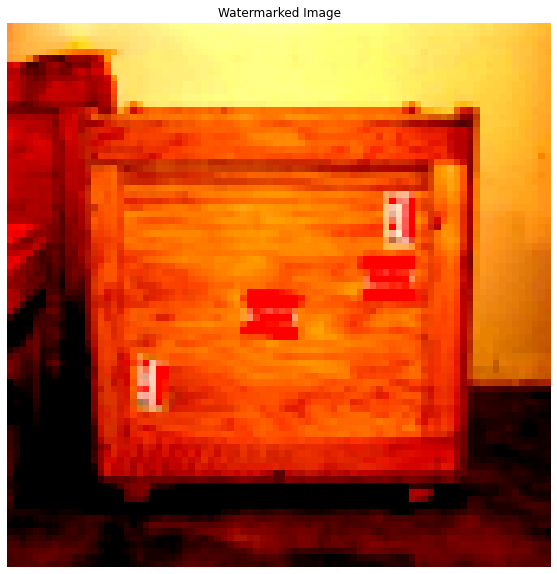

  9%|▉         | 1/11 [00:08<01:20,  8.06s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 4: Target opacity: 0, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


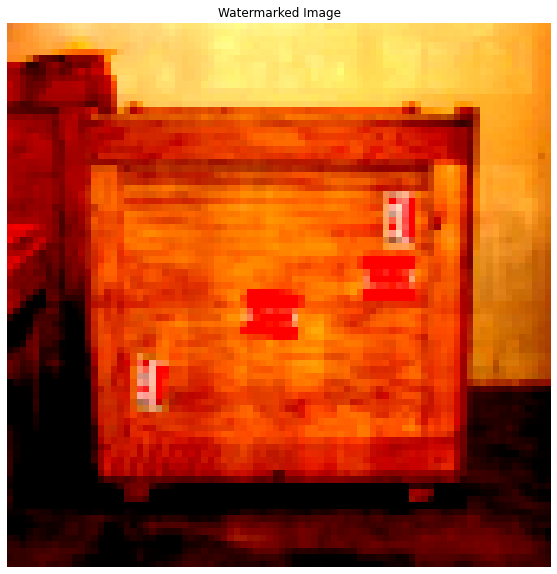

 18%|█▊        | 2/11 [00:15<01:11,  7.99s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 4: Target opacity: 0.05, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


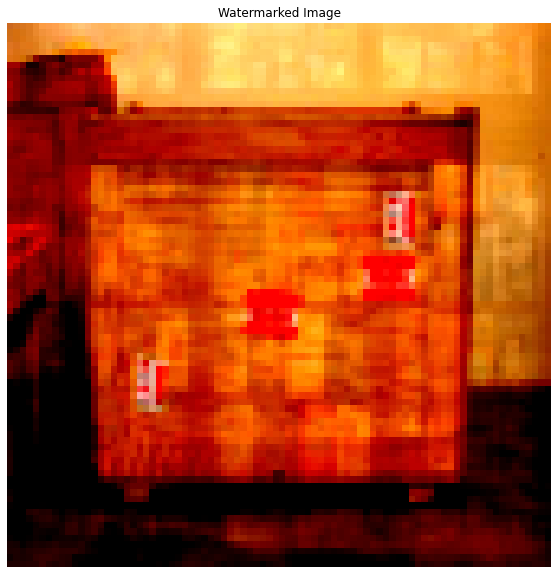

 27%|██▋       | 3/11 [00:24<01:03,  8.00s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 4: Target opacity: 0.1, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


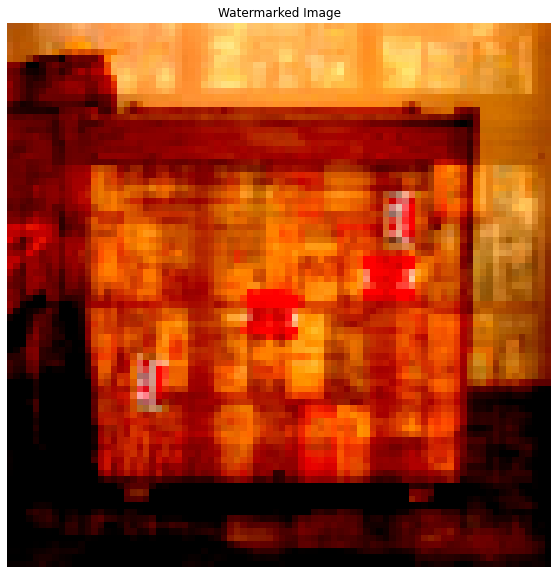

 36%|███▋      | 4/11 [00:30<00:50,  7.22s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 4: Target opacity: 0.15, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


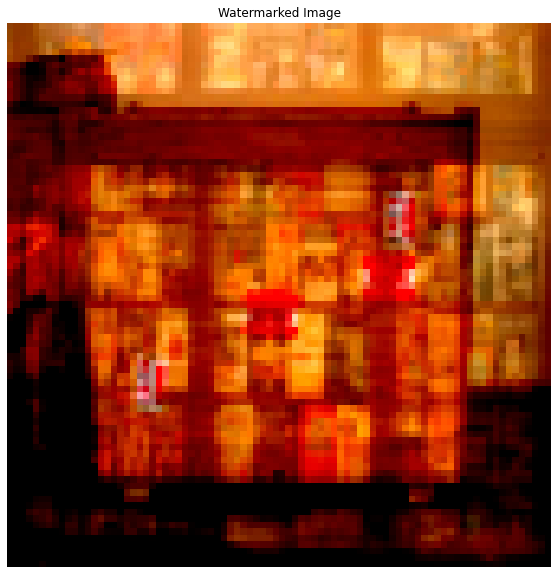

 45%|████▌     | 5/11 [00:35<00:39,  6.60s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 4: Target opacity: 0.2, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


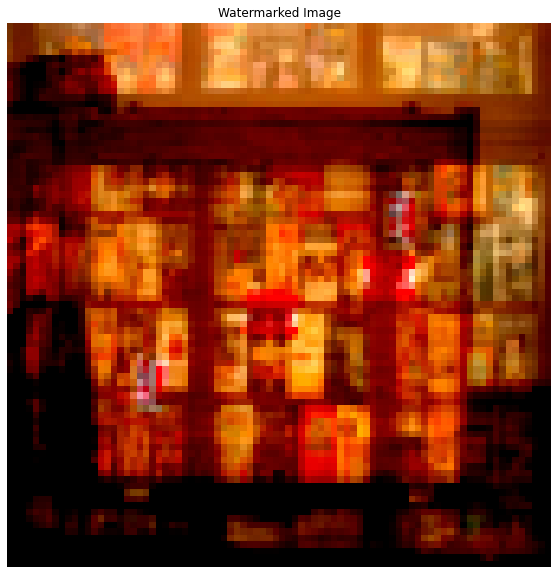

 55%|█████▍    | 6/11 [00:41<00:31,  6.25s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 4: Target opacity: 0.25, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


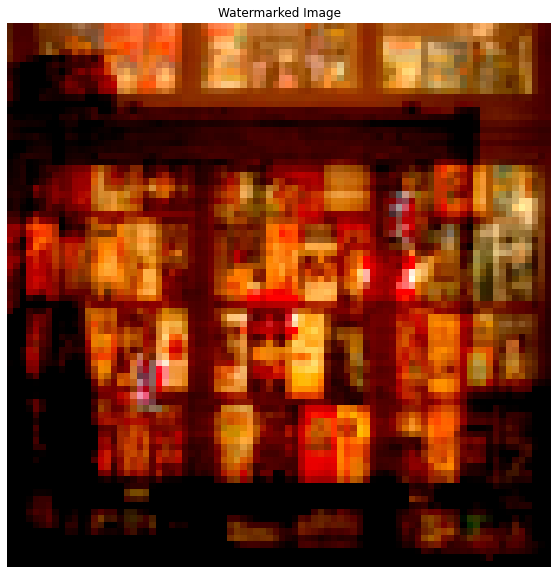

 64%|██████▎   | 7/11 [00:46<00:24,  6.02s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 4: Target opacity: 0.3, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


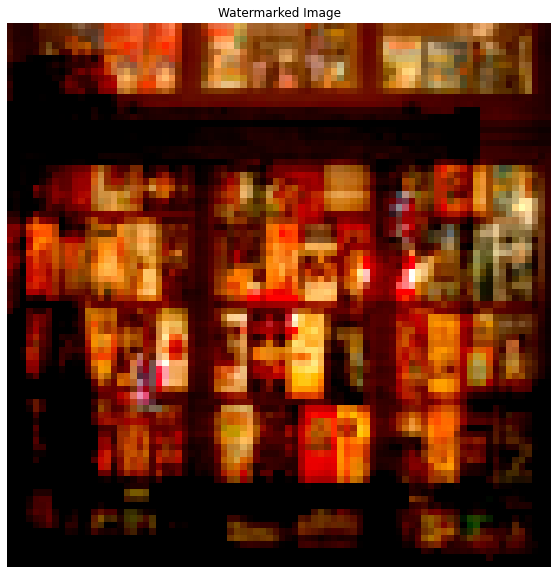

 73%|███████▎  | 8/11 [00:52<00:17,  5.83s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 4: Target opacity: 0.35, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


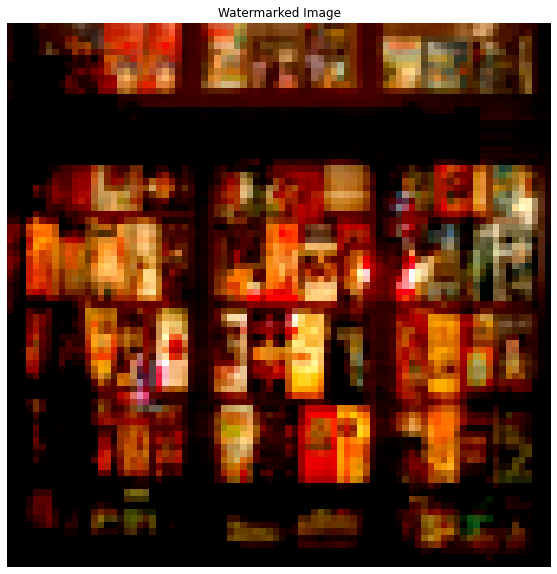

 82%|████████▏ | 9/11 [00:57<00:11,  5.70s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 4: Target opacity: 0.4, Labeled correctly: 0.6266666666666667, Correctly Predicted Target: True, Base class predicted: False


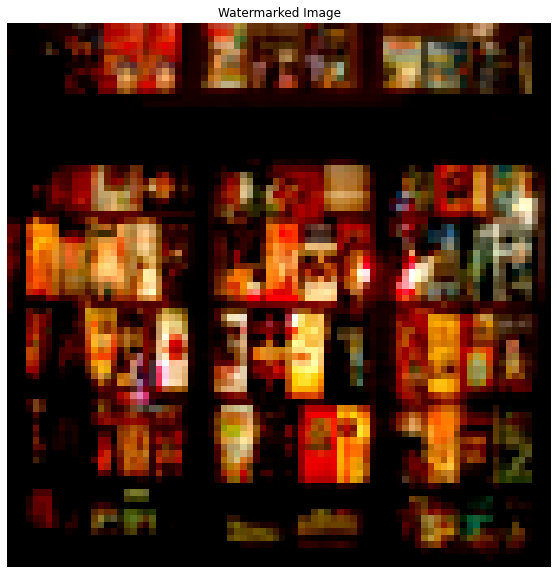

 91%|█████████ | 10/11 [01:02<00:05,  5.64s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 4: Target opacity: 0.45, Labeled correctly: 0.6266666666666667, Correctly Predicted Target: True, Base class predicted: False


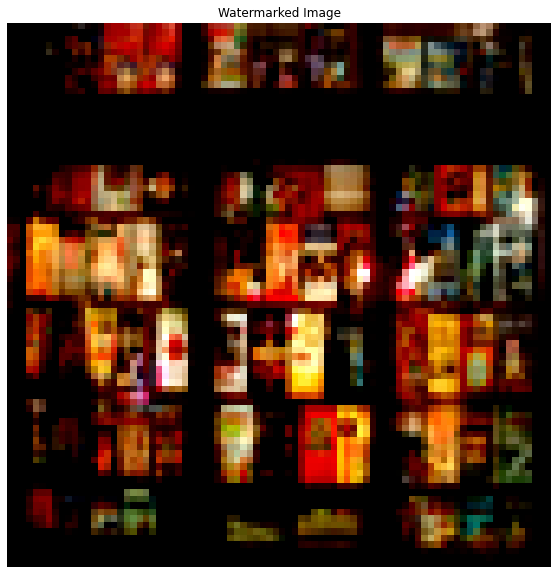

100%|██████████| 11/11 [01:08<00:00,  6.22s/it]

Iteration 4: Target opacity: 0.5, Labeled correctly: 0.6266666666666667, Correctly Predicted Target: True, Base class predicted: False



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


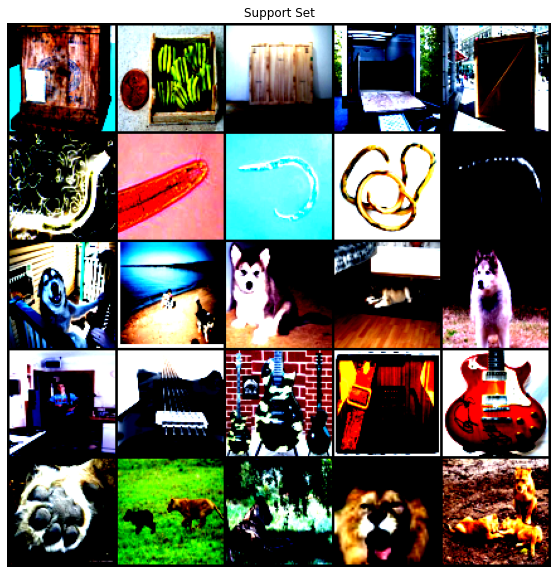

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 4, 4, 4, 4,
         4]])


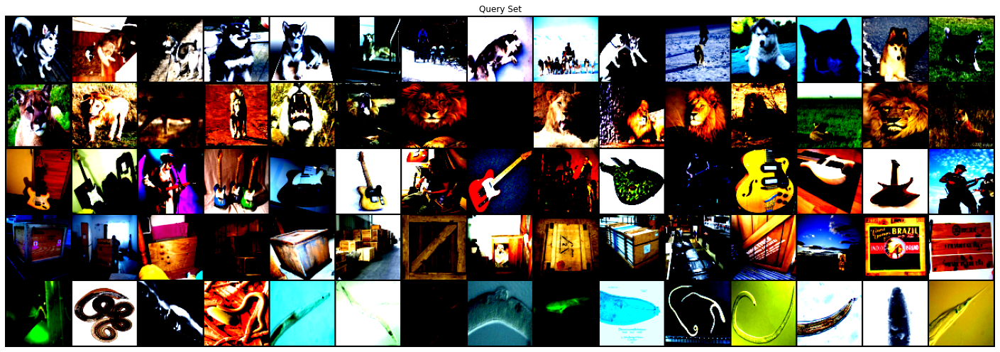

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4,
         4, 4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1,
         1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
         2, 2, 2]])
target_class 2
unique_classes [0, 1, 3, 4]
base_class 3
target_indices [60 61 62 63 64 65 66 67 68 69 70 71 72 73 74]
target_index 68
base_indices [10 11 12 13 14]
base_index 13


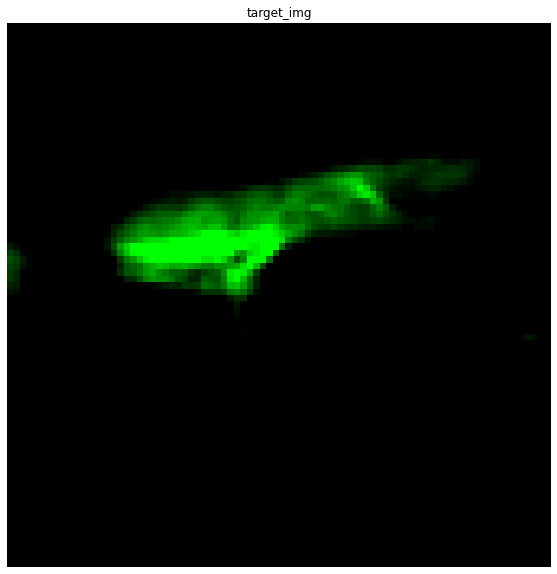

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


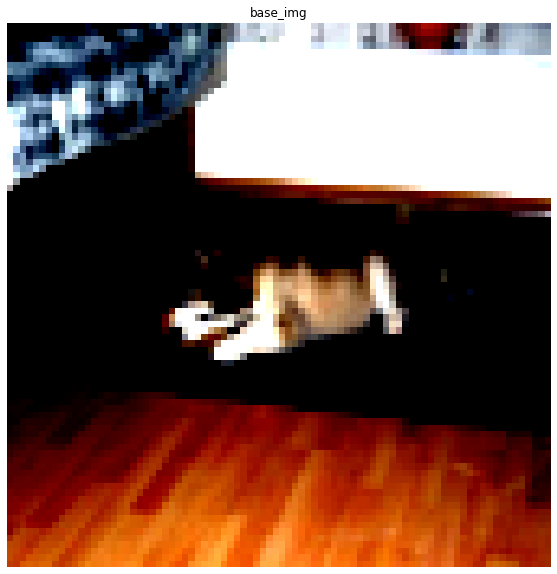

  0%|          | 3/1000 [00:00<00:36, 27.56it/s]

Iteration 0
loss: tensor(0.7211, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(66.5476, grad_fn=<PowBackward0>)
Iteration 2
loss: tensor(62.1198, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(0.4585, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(10.9468, grad_fn=<PowBackward0>)
Iteration 5


  1%|          | 9/1000 [00:00<00:39, 25.22it/s]

loss: tensor(29.8521, grad_fn=<PowBackward0>)
Iteration 6
loss: tensor(127.0766, grad_fn=<PowBackward0>)
Iteration 7
loss: tensor(1.6167, grad_fn=<PowBackward0>)
Iteration 8
loss: tensor(4.8781, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(9.1254, grad_fn=<PowBackward0>)
Iteration 10
loss:

  2%|▏         | 15/1000 [00:00<00:38, 25.39it/s]

 tensor(73.3636, grad_fn=<PowBackward0>)
Iteration 11
loss: tensor(4.1751, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(33.7669, grad_fn=<PowBackward0>)
Iteration 13
loss: tensor(24.2824, grad_fn=<PowBackward0>)
Iteration 14
loss: tensor(74.3854, grad_fn=<PowBackward0>)
Iteration 15


  2%|▏         | 18/1000 [00:00<00:40, 24.35it/s]

loss: tensor(1.9981, grad_fn=<PowBackward0>)
Iteration 16
loss: tensor(21.6360, grad_fn=<PowBackward0>)
Iteration 17
loss: tensor(99.2803, grad_fn=<PowBackward0>)
Iteration 18
loss: tensor(9.1654, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(32.3433, grad_fn=<PowBackward0>)
Iteration 20
loss: tensor(35.1905, grad_fn=<PowBackward0>)


  2%|▏         | 24/1000 [00:00<00:38, 25.07it/s]

Iteration 21
loss: tensor(81.3687, grad_fn=<PowBackward0>)
Iteration 22
loss: tensor(4.6607, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(16.4146, grad_fn=<PowBackward0>)
Iteration 24
loss: tensor(38.8828, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(106.7394, grad_fn=<PowBackward0>)
Iteration 26


  3%|▎         | 30/1000 [00:01<00:37, 26.09it/s]

loss: tensor(13.1699, grad_fn=<PowBackward0>)
Iteration 27
loss: tensor(28.9437, grad_fn=<PowBackward0>)
Iteration 28
loss: tensor(14.6525, grad_fn=<PowBackward0>)
Iteration 29
loss: tensor(64.6052, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(16.7005, grad_fn=<PowBackward0>)
Iteration 31
loss: tensor(69.0147, grad_fn=<PowBackward0>)


  4%|▎         | 36/1000 [00:01<00:37, 25.65it/s]

Iteration 32
loss: tensor(12.2624, grad_fn=<PowBackward0>)
Iteration 33
loss: tensor(48.5046, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(7.1879, grad_fn=<PowBackward0>)
Iteration 35
loss: tensor(33.5023, grad_fn=<PowBackward0>)
Iteration 36
loss: tensor(18.4057, grad_fn=<PowBackward0>)
Iteration 37


  4%|▍         | 42/1000 [00:01<00:39, 24.50it/s]

loss: tensor(95.3869, grad_fn=<PowBackward0>)
Iteration 38
loss: tensor(1.2716, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(3.6210, grad_fn=<PowBackward0>)
Iteration 40
loss: tensor(28.4182, grad_fn=<PowBackward0>)
Iteration 41
loss: tensor(78.9678, grad_fn=<PowBackward0>)
Iteration 42


  4%|▍         | 45/1000 [00:01<00:38, 24.69it/s]

loss: tensor(5.9637, grad_fn=<PowBackward0>)
Iteration 43
loss: tensor(64.3719, grad_fn=<PowBackward0>)
Iteration 44
loss: tensor(13.2757, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(27.1712, grad_fn=<PowBackward0>)
Iteration 46
loss: tensor(32.4755, grad_fn=<PowBackward0>)
Iteration 47
loss: tensor(91.0166, grad_fn=<PowBackward0>)


  5%|▌         | 51/1000 [00:02<00:38, 24.86it/s]

Iteration 48
loss: tensor(12.4161, grad_fn=<PowBackward0>)
Iteration 49
loss: tensor(35.8219, grad_fn=<PowBackward0>)
Iteration 50
loss: tensor(6.2085, grad_fn=<PowBackward0>)
Iteration 51
loss: tensor(76.5847, grad_fn=<PowBackward0>)
Iteration 52
loss: tensor(28.3092, grad_fn=<PowBackward0>)
Iteration 53


  6%|▌         | 57/1000 [00:02<00:37, 25.08it/s]

loss: tensor(42.6943, grad_fn=<PowBackward0>)
Iteration 54
loss: tensor(6.3818, grad_fn=<PowBackward0>)
Iteration 55
loss: tensor(31.3655, grad_fn=<PowBackward0>)
Iteration 56
loss: tensor(13.1072, grad_fn=<PowBackward0>)
Iteration 57
loss: tensor(46.0990, grad_fn=<PowBackward0>)
Iteration 58
loss: tensor(34.4192, grad_fn=<PowBackward0>)


  6%|▋         | 63/1000 [00:02<00:36, 25.41it/s]

Iteration 59
loss: tensor(30.6300, grad_fn=<PowBackward0>)
Iteration 60
loss: tensor(12.3329, grad_fn=<PowBackward0>)
Iteration 61
loss: tensor(77.7509, grad_fn=<PowBackward0>)
Iteration 62
loss: tensor(5.3807, grad_fn=<PowBackward0>)
Iteration 63
loss: tensor(38.9780, grad_fn=<PowBackward0>)
Iteration 64


  7%|▋         | 69/1000 [00:02<00:36, 25.40it/s]

loss: tensor(17.1375, grad_fn=<PowBackward0>)
Iteration 65
loss: tensor(62.0948, grad_fn=<PowBackward0>)
Iteration 66
loss: tensor(12.7642, grad_fn=<PowBackward0>)
Iteration 67
loss: tensor(106.5729, grad_fn=<PowBackward0>)
Iteration 68
loss: tensor(0.4386, grad_fn=<PowBackward0>)
Iteration 69
loss: tensor(0.4290, grad_fn=<PowBackward0>)


  8%|▊         | 75/1000 [00:02<00:35, 25.76it/s]

Iteration 70
loss: tensor(14.3934, grad_fn=<PowBackward0>)
Iteration 71
loss: tensor(101.0919, grad_fn=<PowBackward0>)
Iteration 72
loss: tensor(0.8569, grad_fn=<PowBackward0>)
Iteration 73
loss: tensor(3.6801, grad_fn=<PowBackward0>)
Iteration 74
loss: tensor(11.9885, grad_fn=<PowBackward0>)
Iteration 75


  8%|▊         | 78/1000 [00:03<00:35, 26.11it/s]

loss: tensor(77.1126, grad_fn=<PowBackward0>)
Iteration 76
loss: tensor(3.9305, grad_fn=<PowBackward0>)
Iteration 77
loss: tensor(12.0034, grad_fn=<PowBackward0>)
Iteration 78
loss: tensor(17.7699, grad_fn=<PowBackward0>)
Iteration 79
loss: tensor(103.1607, grad_fn=<PowBackward0>)
Iteration 80
loss: tensor(5.1170, grad_fn=<PowBackward0>)


  8%|▊         | 84/1000 [00:03<00:34, 26.25it/s]

Iteration 81
loss: tensor(15.0252, grad_fn=<PowBackward0>)
Iteration 82
loss: tensor(11.3122, grad_fn=<PowBackward0>)
Iteration 83
loss: tensor(68.7503, grad_fn=<PowBackward0>)
Iteration 84
loss: tensor(18.1841, grad_fn=<PowBackward0>)
Iteration 85
loss: tensor(19.5549, grad_fn=<PowBackward0>)
Iteration 86
loss: tensor(23.0070, grad_fn=<PowBackward0>)


  9%|▉         | 90/1000 [00:03<00:34, 26.49it/s]

Iteration 87
loss: tensor(100.7361, grad_fn=<PowBackward0>)
Iteration 88
loss: tensor(10.2269, grad_fn=<PowBackward0>)
Iteration 89
loss: tensor(20.3620, grad_fn=<PowBackward0>)
Iteration 90
loss: tensor(25.3830, grad_fn=<PowBackward0>)
Iteration 91
loss: tensor(82.4034, grad_fn=<PowBackward0>)
Iteration 92


 10%|▉         | 96/1000 [00:03<00:35, 25.20it/s]

loss: tensor(14.9582, grad_fn=<PowBackward0>)
Iteration 93
loss: tensor(34.9897, grad_fn=<PowBackward0>)
Iteration 94
loss: tensor(32.6612, grad_fn=<PowBackward0>)
Iteration 95
loss: tensor(56.8564, grad_fn=<PowBackward0>)
Iteration 96
loss: tensor(10.2070, grad_fn=<PowBackward0>)
Iteration 97
loss:

 10%|█         | 102/1000 [00:04<00:35, 25.33it/s]

 tensor(62.1644, grad_fn=<PowBackward0>)
Iteration 98
loss: tensor(0.0204, grad_fn=<PowBackward0>)
Iteration 99
loss: tensor(0.4984, grad_fn=<PowBackward0>)
Iteration 100
loss: tensor(57.8982, grad_fn=<PowBackward0>)
Iteration 101
loss: tensor(0.9302, grad_fn=<PowBackward0>)
Iteration 102
loss: tensor(33.2752, grad_fn=<PowBackward0>)


 11%|█         | 108/1000 [00:04<00:34, 25.95it/s]

Iteration 103
loss: tensor(56.5480, grad_fn=<PowBackward0>)
Iteration 104
loss: tensor(11.6476, grad_fn=<PowBackward0>)
Iteration 105
loss: tensor(45.3683, grad_fn=<PowBackward0>)
Iteration 106
loss: tensor(13.7045, grad_fn=<PowBackward0>)
Iteration 107
loss: tensor(79.6664, grad_fn=<PowBackward0>)
Iteration 108


 11%|█▏        | 114/1000 [00:04<00:33, 26.57it/s]

loss: tensor(26.7602, grad_fn=<PowBackward0>)
Iteration 109
loss: tensor(37.5184, grad_fn=<PowBackward0>)
Iteration 110
loss: tensor(32.8252, grad_fn=<PowBackward0>)
Iteration 111
loss: tensor(66.6880, grad_fn=<PowBackward0>)
Iteration 112
loss: tensor(2.9971, grad_fn=<PowBackward0>)
Iteration 113
loss: tensor(25.6208, grad_fn=<PowBackward0>)


 12%|█▏        | 117/1000 [00:04<00:33, 26.33it/s]

Iteration 114
loss: tensor(30.1537, grad_fn=<PowBackward0>)
Iteration 115
loss: tensor(62.2232, grad_fn=<PowBackward0>)
Iteration 116
loss: tensor(10.6765, grad_fn=<PowBackward0>)
Iteration 117
loss: tensor(65.9553, grad_fn=<PowBackward0>)
Iteration 118
loss: tensor(13.6792, grad_fn=<PowBackward0>)
Iteration 119


 12%|█▏        | 123/1000 [00:04<00:34, 25.78it/s]

loss: tensor(39.7073, grad_fn=<PowBackward0>)
Iteration 120
loss: tensor(12.2234, grad_fn=<PowBackward0>)
Iteration 121
loss: tensor(74.5350, grad_fn=<PowBackward0>)
Iteration 122
loss: tensor(1.2776, grad_fn=<PowBackward0>)
Iteration 123
loss: tensor(7.4633, grad_fn=<PowBackward0>)
Iteration 124
loss: tensor(49.3279, grad_fn=<PowBackward0>)


 13%|█▎        | 129/1000 [00:05<00:34, 25.43it/s]

Iteration 125
loss: tensor(71.2758, grad_fn=<PowBackward0>)
Iteration 126
loss: tensor(16.7750, grad_fn=<PowBackward0>)
Iteration 127
loss: tensor(63.9759, grad_fn=<PowBackward0>)
Iteration 128
loss: tensor(11.6109, grad_fn=<PowBackward0>)
Iteration 129
loss: tensor(74.4225, grad_fn=<PowBackward0>)
Iteration 130


 14%|█▎        | 135/1000 [00:05<00:35, 24.71it/s]

loss: tensor(20.1085, grad_fn=<PowBackward0>)
Iteration 131
loss: tensor(44.8947, grad_fn=<PowBackward0>)
Iteration 132
loss: tensor(1.1410, grad_fn=<PowBackward0>)
Iteration 133
loss: tensor(16.0042, grad_fn=<PowBackward0>)
Iteration 134
loss: tensor(26.0305, grad_fn=<PowBackward0>)
Iteration 135
loss:

 14%|█▍        | 138/1000 [00:05<00:34, 24.78it/s]

 tensor(68.5229, grad_fn=<PowBackward0>)
Iteration 136
loss: tensor(6.8724, grad_fn=<PowBackward0>)
Iteration 137
loss: tensor(20.6402, grad_fn=<PowBackward0>)
Iteration 138
loss: tensor(11.2281, grad_fn=<PowBackward0>)
Iteration 139
loss: tensor(65.7695, grad_fn=<PowBackward0>)
Iteration 140
loss: tensor(4.0539, grad_fn=<PowBackward0>)


 14%|█▍        | 144/1000 [00:05<00:33, 25.60it/s]

Iteration 141
loss: tensor(28.8216, grad_fn=<PowBackward0>)
Iteration 142
loss: tensor(14.1337, grad_fn=<PowBackward0>)
Iteration 143
loss: tensor(62.8076, grad_fn=<PowBackward0>)
Iteration 144
loss: tensor(14.5395, grad_fn=<PowBackward0>)
Iteration 145
loss: tensor(52.4433, grad_fn=<PowBackward0>)
Iteration 146


 15%|█▌        | 150/1000 [00:05<00:33, 25.19it/s]

loss: tensor(15.9050, grad_fn=<PowBackward0>)
Iteration 147
loss: tensor(80.7523, grad_fn=<PowBackward0>)
Iteration 148
loss: tensor(25.1724, grad_fn=<PowBackward0>)
Iteration 149
loss: tensor(41.5780, grad_fn=<PowBackward0>)
Iteration 150
loss: tensor(16.7232, grad_fn=<PowBackward0>)
Iteration 151
loss: tensor(41.2150, grad_fn=<PowBackward0>)


 16%|█▌        | 156/1000 [00:06<00:32, 26.24it/s]

Iteration 152
loss: tensor(7.3219, grad_fn=<PowBackward0>)
Iteration 153
loss: tensor(51.8308, grad_fn=<PowBackward0>)
Iteration 154
loss: tensor(15.3048, grad_fn=<PowBackward0>)
Iteration 155
loss: tensor(60.8825, grad_fn=<PowBackward0>)
Iteration 156
loss: tensor(30.7950, grad_fn=<PowBackward0>)
Iteration 157


 16%|█▌        | 159/1000 [00:06<00:32, 26.23it/s]

loss: tensor(61.7286, grad_fn=<PowBackward0>)
Iteration 158
loss: tensor(7.6869, grad_fn=<PowBackward0>)
Iteration 159
loss: tensor(23.4898, grad_fn=<PowBackward0>)
Iteration 160
loss: tensor(12.5264, grad_fn=<PowBackward0>)
Iteration 161
loss: tensor(73.3380, grad_fn=<PowBackward0>)


 16%|█▋        | 165/1000 [00:06<00:34, 23.86it/s]

Iteration 162
loss: tensor(4.2656, grad_fn=<PowBackward0>)
Iteration 163
loss: tensor(53.0472, grad_fn=<PowBackward0>)
Iteration 164
loss: tensor(20.1963, grad_fn=<PowBackward0>)
Iteration 165
loss: tensor(52.0445, grad_fn=<PowBackward0>)
Iteration 166
loss: tensor(28.8720, grad_fn=<PowBackward0>)
Iteration 167


 17%|█▋        | 171/1000 [00:06<00:34, 23.97it/s]

loss: tensor(44.9904, grad_fn=<PowBackward0>)
Iteration 168
loss: tensor(14.2451, grad_fn=<PowBackward0>)
Iteration 169
loss: tensor(50.8374, grad_fn=<PowBackward0>)
Iteration 170
loss: tensor(3.2652, grad_fn=<PowBackward0>)
Iteration 171
loss: tensor(24.9744, grad_fn=<PowBackward0>)
Iteration 172


 18%|█▊        | 177/1000 [00:07<00:33, 24.67it/s]

loss: tensor(8.3963, grad_fn=<PowBackward0>)
Iteration 173
loss: tensor(60.9357, grad_fn=<PowBackward0>)
Iteration 174
loss: tensor(12.0259, grad_fn=<PowBackward0>)
Iteration 175
loss: tensor(66.1229, grad_fn=<PowBackward0>)
Iteration 176
loss: tensor(13.7332, grad_fn=<PowBackward0>)
Iteration 177
loss: tensor(56.7929, grad_fn=<PowBackward0>)


 18%|█▊        | 183/1000 [00:07<00:32, 25.01it/s]

Iteration 178
loss: tensor(54.6684, grad_fn=<PowBackward0>)
Iteration 179
loss: tensor(69.9860, grad_fn=<PowBackward0>)
Iteration 180
loss: tensor(31.1178, grad_fn=<PowBackward0>)
Iteration 181
loss: tensor(33.2165, grad_fn=<PowBackward0>)
Iteration 182
loss: tensor(19.4873, grad_fn=<PowBackward0>)
Iteration 183


 19%|█▊        | 186/1000 [00:07<00:32, 25.37it/s]

loss: tensor(63.2656, grad_fn=<PowBackward0>)
Iteration 184
loss: tensor(6.8021, grad_fn=<PowBackward0>)
Iteration 185
loss: tensor(65.0940, grad_fn=<PowBackward0>)
Iteration 186
loss: tensor(25.1126, grad_fn=<PowBackward0>)
Iteration 187
loss: tensor(45.5124, grad_fn=<PowBackward0>)
Iteration 188
loss: tensor(16.6144, grad_fn=<PowBackward0>)


 19%|█▉        | 192/1000 [00:07<00:31, 25.98it/s]

Iteration 189
loss: tensor(54.4242, grad_fn=<PowBackward0>)
Iteration 190
loss: tensor(12.2104, grad_fn=<PowBackward0>)
Iteration 191
loss: tensor(54.8096, grad_fn=<PowBackward0>)
Iteration 192
loss: tensor(23.7714, grad_fn=<PowBackward0>)
Iteration 193
loss: tensor(27.9367, grad_fn=<PowBackward0>)
Iteration 194
loss: tensor(7.1318, grad_fn=<PowBackward0>)


 20%|█▉        | 198/1000 [00:07<00:31, 25.42it/s]

Iteration 195
loss: tensor(81.8227, grad_fn=<PowBackward0>)
Iteration 196
loss: tensor(14.2560, grad_fn=<PowBackward0>)
Iteration 197
loss: tensor(53.6422, grad_fn=<PowBackward0>)
Iteration 198
loss: tensor(21.5462, grad_fn=<PowBackward0>)
Iteration 199
loss: tensor(38.7190, grad_fn=<PowBackward0>)


 20%|██        | 204/1000 [00:08<00:31, 25.47it/s]

Iteration 200
loss: tensor(20.3528, grad_fn=<PowBackward0>)
Iteration 201
loss: tensor(52.1129, grad_fn=<PowBackward0>)
Iteration 202
loss: tensor(27.9098, grad_fn=<PowBackward0>)
Iteration 203
loss: tensor(25.5484, grad_fn=<PowBackward0>)
Iteration 204
loss: tensor(25.2484, grad_fn=<PowBackward0>)
Iteration 205


 21%|██        | 210/1000 [00:08<00:30, 25.96it/s]

loss: tensor(33.0028, grad_fn=<PowBackward0>)
Iteration 206
loss: tensor(23.8613, grad_fn=<PowBackward0>)
Iteration 207
loss: tensor(35.2481, grad_fn=<PowBackward0>)
Iteration 208
loss: tensor(16.3697, grad_fn=<PowBackward0>)
Iteration 209
loss: tensor(33.9532, grad_fn=<PowBackward0>)
Iteration 210
loss: tensor(17.3837, grad_fn=<PowBackward0>)


 22%|██▏       | 216/1000 [00:08<00:30, 25.58it/s]

Iteration 211
loss: tensor(29.4547, grad_fn=<PowBackward0>)
Iteration 212
loss: tensor(5.5249, grad_fn=<PowBackward0>)
Iteration 213
loss: tensor(26.6211, grad_fn=<PowBackward0>)
Iteration 214
loss: tensor(17.5629, grad_fn=<PowBackward0>)
Iteration 215
loss: tensor(24.6789, grad_fn=<PowBackward0>)
Iteration 216


 22%|██▏       | 219/1000 [00:08<00:31, 24.90it/s]

loss: tensor(30.8310, grad_fn=<PowBackward0>)
Iteration 217
loss: tensor(18.6429, grad_fn=<PowBackward0>)
Iteration 218
loss: tensor(15.6275, grad_fn=<PowBackward0>)
Iteration 219
loss: tensor(30.3590, grad_fn=<PowBackward0>)
Iteration 220
loss: tensor(15.1098, grad_fn=<PowBackward0>)
Iteration 221


 22%|██▎       | 225/1000 [00:08<00:31, 24.40it/s]

loss: tensor(28.1712, grad_fn=<PowBackward0>)
Iteration 222
loss: tensor(17.6009, grad_fn=<PowBackward0>)
Iteration 223
loss: tensor(40.4784, grad_fn=<PowBackward0>)
Iteration 224
loss: tensor(16.3562, grad_fn=<PowBackward0>)
Iteration 225
loss: tensor(30.4523, grad_fn=<PowBackward0>)
Iteration 226


 23%|██▎       | 231/1000 [00:09<00:30, 25.08it/s]

loss: tensor(15.2670, grad_fn=<PowBackward0>)
Iteration 227
loss: tensor(37.7695, grad_fn=<PowBackward0>)
Iteration 228
loss: tensor(11.6369, grad_fn=<PowBackward0>)
Iteration 229
loss: tensor(24.2653, grad_fn=<PowBackward0>)
Iteration 230
loss: tensor(22.1143, grad_fn=<PowBackward0>)
Iteration 231
loss: tensor(66.4304, grad_fn=<PowBackward0>)


 24%|██▎       | 237/1000 [00:09<00:30, 25.16it/s]

Iteration 232
loss: tensor(26.2795, grad_fn=<PowBackward0>)
Iteration 233
loss: tensor(29.6912, grad_fn=<PowBackward0>)
Iteration 234
loss: tensor(22.9784, grad_fn=<PowBackward0>)
Iteration 235
loss: tensor(28.1769, grad_fn=<PowBackward0>)
Iteration 236
loss: tensor(18.3347, grad_fn=<PowBackward0>)


 24%|██▍       | 240/1000 [00:09<00:30, 25.06it/s]

Iteration 237
loss: tensor(45.9277, grad_fn=<PowBackward0>)
Iteration 238
loss: tensor(19.4789, grad_fn=<PowBackward0>)
Iteration 239
loss: tensor(17.5472, grad_fn=<PowBackward0>)
Iteration 240
loss: tensor(28.5509, grad_fn=<PowBackward0>)
Iteration 241
loss: tensor(32.6719, grad_fn=<PowBackward0>)
Iteration 242
loss: tensor(14.2457, grad_fn=<PowBackward0>)


 25%|██▍       | 246/1000 [00:09<00:29, 25.82it/s]

Iteration 243
loss: tensor(39.7362, grad_fn=<PowBackward0>)
Iteration 244
loss: tensor(22.2126, grad_fn=<PowBackward0>)
Iteration 245
loss: tensor(31.0596, grad_fn=<PowBackward0>)
Iteration 246
loss: tensor(18.9557, grad_fn=<PowBackward0>)
Iteration 247
loss: tensor(28.1409, grad_fn=<PowBackward0>)
Iteration 248


 25%|██▌       | 252/1000 [00:09<00:29, 25.71it/s]

loss: tensor(9.4314, grad_fn=<PowBackward0>)
Iteration 249
loss: tensor(37.3495, grad_fn=<PowBackward0>)
Iteration 250
loss: tensor(25.9211, grad_fn=<PowBackward0>)
Iteration 251
loss: tensor(31.4153, grad_fn=<PowBackward0>)
Iteration 252
loss: tensor(21.7413, grad_fn=<PowBackward0>)
Iteration 253
loss: tensor(28.5743, grad_fn=<PowBackward0>)


 26%|██▌       | 258/1000 [00:10<00:28, 26.10it/s]

Iteration 254
loss: tensor(16.2856, grad_fn=<PowBackward0>)
Iteration 255
loss: tensor(37.4282, grad_fn=<PowBackward0>)
Iteration 256
loss: tensor(12.8238, grad_fn=<PowBackward0>)
Iteration 257
loss: tensor(49.4930, grad_fn=<PowBackward0>)
Iteration 258
loss: tensor(13.9631, grad_fn=<PowBackward0>)
Iteration 259


 26%|██▋       | 264/1000 [00:10<00:27, 26.67it/s]

loss: tensor(14.4831, grad_fn=<PowBackward0>)
Iteration 260
loss: tensor(10.8806, grad_fn=<PowBackward0>)
Iteration 261
loss: tensor(34.7664, grad_fn=<PowBackward0>)
Iteration 262
loss: tensor(24.3843, grad_fn=<PowBackward0>)
Iteration 263
loss: tensor(34.2887, grad_fn=<PowBackward0>)
Iteration 264
loss: tensor(5.1996, grad_fn=<PowBackward0>)


 27%|██▋       | 270/1000 [00:10<00:27, 26.27it/s]

Iteration 265
loss: tensor(15.3278, grad_fn=<PowBackward0>)
Iteration 266
loss: tensor(22.6187, grad_fn=<PowBackward0>)
Iteration 267
loss: tensor(68.9018, grad_fn=<PowBackward0>)
Iteration 268
loss: tensor(9.5590, grad_fn=<PowBackward0>)
Iteration 269
loss: tensor(26.5662, grad_fn=<PowBackward0>)
Iteration 270


 27%|██▋       | 273/1000 [00:10<00:28, 25.92it/s]

loss: tensor(15.1231, grad_fn=<PowBackward0>)
Iteration 271
loss: tensor(24.7145, grad_fn=<PowBackward0>)
Iteration 272
loss: tensor(3.5557, grad_fn=<PowBackward0>)
Iteration 273
loss: tensor(14.0278, grad_fn=<PowBackward0>)
Iteration 274
loss: tensor(20.4290, grad_fn=<PowBackward0>)
Iteration 275
loss:

 28%|██▊       | 279/1000 [00:11<00:28, 25.73it/s]

 tensor(37.1047, grad_fn=<PowBackward0>)
Iteration 276
loss: tensor(6.9752, grad_fn=<PowBackward0>)
Iteration 277
loss: tensor(17.3531, grad_fn=<PowBackward0>)
Iteration 278
loss: tensor(12.9482, grad_fn=<PowBackward0>)
Iteration 279
loss: tensor(21.6710, grad_fn=<PowBackward0>)
Iteration 280
loss: tensor(12.2419, grad_fn=<PowBackward0>)


 28%|██▊       | 285/1000 [00:11<00:27, 25.75it/s]

Iteration 281
loss: tensor(32.0513, grad_fn=<PowBackward0>)
Iteration 282
loss: tensor(21.6213, grad_fn=<PowBackward0>)
Iteration 283
loss: tensor(39.9362, grad_fn=<PowBackward0>)
Iteration 284
loss: tensor(13.6621, grad_fn=<PowBackward0>)
Iteration 285
loss: tensor(13.5244, grad_fn=<PowBackward0>)
Iteration 286


 29%|██▉       | 291/1000 [00:11<00:28, 25.18it/s]

loss: tensor(13.0912, grad_fn=<PowBackward0>)
Iteration 287
loss: tensor(31.5221, grad_fn=<PowBackward0>)
Iteration 288
loss: tensor(20.5163, grad_fn=<PowBackward0>)
Iteration 289
loss: tensor(34.7942, grad_fn=<PowBackward0>)
Iteration 290
loss: tensor(20.0500, grad_fn=<PowBackward0>)
Iteration 291


 29%|██▉       | 294/1000 [00:11<00:28, 24.41it/s]

loss: tensor(35.7977, grad_fn=<PowBackward0>)
Iteration 292
loss: tensor(33.4387, grad_fn=<PowBackward0>)
Iteration 293
loss: tensor(19.4139, grad_fn=<PowBackward0>)
Iteration 294
loss: tensor(15.5984, grad_fn=<PowBackward0>)
Iteration 295
loss: tensor(28.8180, grad_fn=<PowBackward0>)
Iteration 296
loss: tensor(20.1662, grad_fn=<PowBackward0>)


 30%|███       | 300/1000 [00:11<00:28, 24.75it/s]

Iteration 297
loss: tensor(29.7315, grad_fn=<PowBackward0>)
Iteration 298
loss: tensor(15.4705, grad_fn=<PowBackward0>)
Iteration 299
loss: tensor(55.0931, grad_fn=<PowBackward0>)
Iteration 300
loss: tensor(10.2634, grad_fn=<PowBackward0>)
Iteration 301
loss: tensor(58.2855, grad_fn=<PowBackward0>)
Iteration 302


 31%|███       | 306/1000 [00:12<00:26, 25.77it/s]

loss: tensor(10.0729, grad_fn=<PowBackward0>)
Iteration 303
loss: tensor(6.6325, grad_fn=<PowBackward0>)
Iteration 304
loss: tensor(5.3898, grad_fn=<PowBackward0>)
Iteration 305
loss: tensor(7.1185, grad_fn=<PowBackward0>)
Iteration 306
loss: tensor(10.6178, grad_fn=<PowBackward0>)
Iteration 307
loss: tensor(22.2676, grad_fn=<PowBackward0>)


 31%|███       | 312/1000 [00:12<00:26, 26.37it/s]

Iteration 308
loss: tensor(8.5523, grad_fn=<PowBackward0>)
Iteration 309
loss: tensor(11.9732, grad_fn=<PowBackward0>)
Iteration 310
loss: tensor(11.5451, grad_fn=<PowBackward0>)
Iteration 311
loss: tensor(16.8998, grad_fn=<PowBackward0>)
Iteration 312
loss: tensor(10.1892, grad_fn=<PowBackward0>)
Iteration 313


 32%|███▏      | 318/1000 [00:12<00:26, 25.62it/s]

loss: tensor(8.1461, grad_fn=<PowBackward0>)
Iteration 314
loss: tensor(9.1966, grad_fn=<PowBackward0>)
Iteration 315
loss: tensor(8.9830, grad_fn=<PowBackward0>)
Iteration 316
loss: tensor(6.8902, grad_fn=<PowBackward0>)
Iteration 317
loss: tensor(9.7714, grad_fn=<PowBackward0>)
Iteration 318


 32%|███▏      | 321/1000 [00:12<00:26, 25.42it/s]

loss: tensor(10.6647, grad_fn=<PowBackward0>)
Iteration 319
loss: tensor(8.7625, grad_fn=<PowBackward0>)
Iteration 320
loss: tensor(7.6306, grad_fn=<PowBackward0>)
Iteration 321
loss: tensor(13.4140, grad_fn=<PowBackward0>)
Iteration 322
loss: tensor(9.9291, grad_fn=<PowBackward0>)
Iteration 323
loss: tensor(16.1009, grad_fn=<PowBackward0>)


 33%|███▎      | 327/1000 [00:12<00:27, 24.89it/s]

Iteration 324
loss: tensor(7.5888, grad_fn=<PowBackward0>)
Iteration 325
loss: tensor(7.9326, grad_fn=<PowBackward0>)
Iteration 326
loss: tensor(10.4008, grad_fn=<PowBackward0>)
Iteration 327
loss: tensor(15.7203, grad_fn=<PowBackward0>)
Iteration 328
loss: tensor(11.3878, grad_fn=<PowBackward0>)
Iteration 329


 33%|███▎      | 333/1000 [00:13<00:26, 25.39it/s]

loss: tensor(12.6277, grad_fn=<PowBackward0>)
Iteration 330
loss: tensor(6.9929, grad_fn=<PowBackward0>)
Iteration 331
loss: tensor(7.0789, grad_fn=<PowBackward0>)
Iteration 332
loss: tensor(5.0163, grad_fn=<PowBackward0>)
Iteration 333
loss: tensor(8.7917, grad_fn=<PowBackward0>)
Iteration 334
loss: tensor(8.9444, grad_fn=<PowBackward0>)


 34%|███▍      | 339/1000 [00:13<00:25, 25.72it/s]

Iteration 335
loss: tensor(11.8246, grad_fn=<PowBackward0>)
Iteration 336
loss: tensor(9.3982, grad_fn=<PowBackward0>)
Iteration 337
loss: tensor(7.8418, grad_fn=<PowBackward0>)
Iteration 338
loss: tensor(7.1744, grad_fn=<PowBackward0>)
Iteration 339
loss: tensor(12.8818, grad_fn=<PowBackward0>)
Iteration 340


 34%|███▍      | 345/1000 [00:13<00:25, 25.43it/s]

loss: tensor(10.6536, grad_fn=<PowBackward0>)
Iteration 341
loss: tensor(15.1250, grad_fn=<PowBackward0>)
Iteration 342
loss: tensor(9.5740, grad_fn=<PowBackward0>)
Iteration 343
loss: tensor(9.6200, grad_fn=<PowBackward0>)
Iteration 344
loss: tensor(6.6112, grad_fn=<PowBackward0>)
Iteration 345
loss: tensor(9.7363, grad_fn=<PowBackward0>)


 35%|███▌      | 351/1000 [00:13<00:25, 25.95it/s]

Iteration 346
loss: tensor(12.7296, grad_fn=<PowBackward0>)
Iteration 347
loss: tensor(13.6913, grad_fn=<PowBackward0>)
Iteration 348
loss: tensor(7.5354, grad_fn=<PowBackward0>)
Iteration 349
loss: tensor(5.6370, grad_fn=<PowBackward0>)
Iteration 350
loss: tensor(5.7731, grad_fn=<PowBackward0>)
Iteration 351


 35%|███▌      | 354/1000 [00:13<00:25, 24.87it/s]

loss: tensor(10.7024, grad_fn=<PowBackward0>)
Iteration 352
loss: tensor(7.7399, grad_fn=<PowBackward0>)
Iteration 353
loss: tensor(6.9188, grad_fn=<PowBackward0>)
Iteration 354
loss: tensor(6.7722, grad_fn=<PowBackward0>)
Iteration 355
loss: tensor(14.3819, grad_fn=<PowBackward0>)
Iteration 356
loss: 

 36%|███▌      | 360/1000 [00:14<00:25, 25.28it/s]

tensor(7.8754, grad_fn=<PowBackward0>)
Iteration 357
loss: tensor(13.5454, grad_fn=<PowBackward0>)
Iteration 358
loss: tensor(9.7815, grad_fn=<PowBackward0>)
Iteration 359
loss: tensor(8.0283, grad_fn=<PowBackward0>)
Iteration 360
loss: tensor(7.2614, grad_fn=<PowBackward0>)
Iteration 361
loss: tensor(5.5998, grad_fn=<PowBackward0>)


 37%|███▋      | 366/1000 [00:14<00:24, 25.89it/s]

Iteration 362
loss: tensor(7.3778, grad_fn=<PowBackward0>)
Iteration 363
loss: tensor(9.9816, grad_fn=<PowBackward0>)
Iteration 364
loss: tensor(6.7771, grad_fn=<PowBackward0>)
Iteration 365
loss: tensor(17.9953, grad_fn=<PowBackward0>)
Iteration 366
loss: tensor(14.3645, grad_fn=<PowBackward0>)
Iteration 367


 37%|███▋      | 372/1000 [00:14<00:24, 26.02it/s]

loss: tensor(20.1307, grad_fn=<PowBackward0>)
Iteration 368
loss: tensor(8.4161, grad_fn=<PowBackward0>)
Iteration 369
loss: tensor(5.4372, grad_fn=<PowBackward0>)
Iteration 370
loss: tensor(4.7501, grad_fn=<PowBackward0>)
Iteration 371
loss: tensor(5.3022, grad_fn=<PowBackward0>)
Iteration 372
loss: tensor(4.9510, grad_fn=<PowBackward0>)


 38%|███▊      | 375/1000 [00:14<00:24, 25.60it/s]

Iteration 373
loss: tensor(8.2621, grad_fn=<PowBackward0>)
Iteration 374
loss: tensor(6.4982, grad_fn=<PowBackward0>)
Iteration 375
loss: tensor(9.0821, grad_fn=<PowBackward0>)
Iteration 376
loss: tensor(6.0498, grad_fn=<PowBackward0>)
Iteration 377
loss: tensor(7.0851, grad_fn=<PowBackward0>)


 38%|███▊      | 381/1000 [00:15<00:24, 25.09it/s]

Iteration 378
loss: tensor(6.4197, grad_fn=<PowBackward0>)
Iteration 379
loss: tensor(9.0260, grad_fn=<PowBackward0>)
Iteration 380
loss: tensor(8.1041, grad_fn=<PowBackward0>)
Iteration 381
loss: tensor(13.3628, grad_fn=<PowBackward0>)
Iteration 382
loss: tensor(11.2261, grad_fn=<PowBackward0>)
Iteration 383
loss: tensor(17.0244, grad_fn=<PowBackward0>)


 39%|███▊      | 387/1000 [00:15<00:24, 25.52it/s]

Iteration 384
loss: tensor(13.1805, grad_fn=<PowBackward0>)
Iteration 385
loss: tensor(20.8145, grad_fn=<PowBackward0>)
Iteration 386
loss: tensor(10.4083, grad_fn=<PowBackward0>)
Iteration 387
loss: tensor(15.8363, grad_fn=<PowBackward0>)
Iteration 388
loss: tensor(10.4115, grad_fn=<PowBackward0>)
Iteration 389
loss: tensor(7.4534, grad_fn=<PowBackward0>)


 39%|███▉      | 393/1000 [00:15<00:23, 26.23it/s]

Iteration 390
loss: tensor(4.7618, grad_fn=<PowBackward0>)
Iteration 391
loss: tensor(6.2369, grad_fn=<PowBackward0>)
Iteration 392
loss: tensor(8.3326, grad_fn=<PowBackward0>)
Iteration 393
loss: tensor(11.2055, grad_fn=<PowBackward0>)
Iteration 394
loss: tensor(8.6585, grad_fn=<PowBackward0>)
Iteration 395
loss:

 40%|███▉      | 399/1000 [00:15<00:22, 26.71it/s]

 tensor(12.9535, grad_fn=<PowBackward0>)
Iteration 396
loss: tensor(10.2412, grad_fn=<PowBackward0>)
Iteration 397
loss: tensor(13.3445, grad_fn=<PowBackward0>)
Iteration 398
loss: tensor(6.7686, grad_fn=<PowBackward0>)
Iteration 399
loss: tensor(6.3880, grad_fn=<PowBackward0>)
Iteration 400
loss: tensor(5.9291, grad_fn=<PowBackward0>)
Iteration 401


 40%|████      | 405/1000 [00:15<00:22, 26.62it/s]

loss: tensor(6.3494, grad_fn=<PowBackward0>)
Iteration 402
loss: tensor(0.1628, grad_fn=<PowBackward0>)
Iteration 403
loss: tensor(0.0175, grad_fn=<PowBackward0>)
Iteration 404
loss: tensor(0.0083, grad_fn=<PowBackward0>)
Iteration 405
loss: tensor(0.0081, grad_fn=<PowBackward0>)
Iteration 406
loss: tensor(0.0065, grad_fn=<PowBackward0>)


 41%|████      | 411/1000 [00:16<00:22, 26.56it/s]

Iteration 407
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 408
loss: tensor(0.0021, grad_fn=<PowBackward0>)
Iteration 409
loss: tensor(0.0111, grad_fn=<PowBackward0>)
Iteration 410
loss: tensor(0.0307, grad_fn=<PowBackward0>)
Iteration 411
loss: tensor(0.2972, grad_fn=<PowBackward0>)
Iteration 412


 42%|████▏     | 417/1000 [00:16<00:22, 26.10it/s]

loss: tensor(1.7402, grad_fn=<PowBackward0>)
Iteration 413
loss: tensor(10.9104, grad_fn=<PowBackward0>)
Iteration 414
loss: tensor(9.5896, grad_fn=<PowBackward0>)
Iteration 415
loss: tensor(8.0811, grad_fn=<PowBackward0>)
Iteration 416
loss: tensor(4.7194, grad_fn=<PowBackward0>)
Iteration 417


 42%|████▏     | 420/1000 [00:16<00:24, 23.64it/s]

loss: tensor(1.6632, grad_fn=<PowBackward0>)
Iteration 418
loss: tensor(0.8877, grad_fn=<PowBackward0>)
Iteration 419
loss: tensor(0.5059, grad_fn=<PowBackward0>)
Iteration 420
loss: tensor(0.3726, grad_fn=<PowBackward0>)
Iteration 421
loss: tensor(0.3834, grad_fn=<PowBackward0>)
Iteration 422


 43%|████▎     | 426/1000 [00:16<00:23, 24.70it/s]

loss: tensor(0.4248, grad_fn=<PowBackward0>)
Iteration 423
loss: tensor(0.7521, grad_fn=<PowBackward0>)
Iteration 424
loss: tensor(1.2208, grad_fn=<PowBackward0>)
Iteration 425
loss: tensor(2.8018, grad_fn=<PowBackward0>)
Iteration 426
loss: tensor(2.8174, grad_fn=<PowBackward0>)
Iteration 427
loss: tensor(3.9683, grad_fn=<PowBackward0>)


 43%|████▎     | 432/1000 [00:17<00:22, 24.79it/s]

Iteration 428
loss: tensor(3.7372, grad_fn=<PowBackward0>)
Iteration 429
loss: tensor(4.6938, grad_fn=<PowBackward0>)
Iteration 430
loss: tensor(3.3404, grad_fn=<PowBackward0>)
Iteration 431
loss: tensor(2.8257, grad_fn=<PowBackward0>)
Iteration 432
loss: tensor(1.8728, grad_fn=<PowBackward0>)
Iteration

 44%|████▍     | 438/1000 [00:17<00:22, 25.08it/s]

 433
loss: tensor(1.5205, grad_fn=<PowBackward0>)
Iteration 434
loss: tensor(0.8856, grad_fn=<PowBackward0>)
Iteration 435
loss: tensor(0.8034, grad_fn=<PowBackward0>)
Iteration 436
loss: tensor(0.5602, grad_fn=<PowBackward0>)
Iteration 437
loss: tensor(1.0352, grad_fn=<PowBackward0>)
Iteration 438


 44%|████▍     | 441/1000 [00:17<00:22, 25.18it/s]

loss: tensor(1.3723, grad_fn=<PowBackward0>)
Iteration 439
loss: tensor(2.3916, grad_fn=<PowBackward0>)
Iteration 440
loss: tensor(2.7441, grad_fn=<PowBackward0>)
Iteration 441
loss: tensor(3.3208, grad_fn=<PowBackward0>)
Iteration 442
loss: tensor(2.4927, grad_fn=<PowBackward0>)
Iteration 443
loss: tensor(3.9900, grad_fn=<PowBackward0>)


 45%|████▍     | 447/1000 [00:17<00:22, 24.77it/s]

Iteration 444
loss: tensor(4.4400, grad_fn=<PowBackward0>)
Iteration 445
loss: tensor(6.3583, grad_fn=<PowBackward0>)
Iteration 446
loss: tensor(4.3949, grad_fn=<PowBackward0>)
Iteration 447
loss: tensor(3.9533, grad_fn=<PowBackward0>)
Iteration 448
loss: tensor(3.4440, grad_fn=<PowBackward0>)
Iteration 449


 45%|████▌     | 453/1000 [00:17<00:22, 24.41it/s]

loss: tensor(3.5785, grad_fn=<PowBackward0>)
Iteration 450
loss: tensor(1.9356, grad_fn=<PowBackward0>)
Iteration 451
loss: tensor(1.1413, grad_fn=<PowBackward0>)
Iteration 452
loss: tensor(0.5780, grad_fn=<PowBackward0>)
Iteration 453
loss: tensor(0.5101, grad_fn=<PowBackward0>)


 46%|████▌     | 459/1000 [00:18<00:22, 24.47it/s]

Iteration 454
loss: tensor(0.3026, grad_fn=<PowBackward0>)
Iteration 455
loss: tensor(0.4067, grad_fn=<PowBackward0>)
Iteration 456
loss: tensor(0.4324, grad_fn=<PowBackward0>)
Iteration 457
loss: tensor(0.8915, grad_fn=<PowBackward0>)
Iteration 458
loss: tensor(1.2519, grad_fn=<PowBackward0>)


 46%|████▌     | 462/1000 [00:18<00:21, 24.98it/s]

Iteration 459
loss: tensor(2.5122, grad_fn=<PowBackward0>)
Iteration 460
loss: tensor(3.3609, grad_fn=<PowBackward0>)
Iteration 461
loss: tensor(4.5562, grad_fn=<PowBackward0>)
Iteration 462
loss: tensor(3.4948, grad_fn=<PowBackward0>)
Iteration 463
loss: tensor(5.3681, grad_fn=<PowBackward0>)
Iteration 464
loss: tensor(3.5963, grad_fn=<PowBackward0>)


 47%|████▋     | 468/1000 [00:18<00:20, 25.52it/s]

Iteration 465
loss: tensor(3.4468, grad_fn=<PowBackward0>)
Iteration 466
loss: tensor(2.8347, grad_fn=<PowBackward0>)
Iteration 467
loss: tensor(1.6962, grad_fn=<PowBackward0>)
Iteration 468
loss: tensor(1.0903, grad_fn=<PowBackward0>)
Iteration 469
loss: tensor(1.4042, grad_fn=<PowBackward0>)
Iteration 470


 47%|████▋     | 474/1000 [00:18<00:20, 25.76it/s]

loss: tensor(1.3980, grad_fn=<PowBackward0>)
Iteration 471
loss: tensor(2.0556, grad_fn=<PowBackward0>)
Iteration 472
loss: tensor(2.1198, grad_fn=<PowBackward0>)
Iteration 473
loss: tensor(2.3901, grad_fn=<PowBackward0>)
Iteration 474
loss: tensor(2.0152, grad_fn=<PowBackward0>)
Iteration 475
loss: tensor(2.6346, grad_fn=<PowBackward0>)


 48%|████▊     | 480/1000 [00:18<00:19, 26.25it/s]

Iteration 476
loss: tensor(2.9846, grad_fn=<PowBackward0>)
Iteration 477
loss: tensor(4.0828, grad_fn=<PowBackward0>)
Iteration 478
loss: tensor(3.7017, grad_fn=<PowBackward0>)
Iteration 479
loss: tensor(3.7093, grad_fn=<PowBackward0>)
Iteration 480
loss: tensor(2.5294, grad_fn=<PowBackward0>)
Iteration 481


 49%|████▊     | 486/1000 [00:19<00:20, 25.49it/s]

loss: tensor(2.0283, grad_fn=<PowBackward0>)
Iteration 482
loss: tensor(1.2673, grad_fn=<PowBackward0>)
Iteration 483
loss: tensor(1.0426, grad_fn=<PowBackward0>)
Iteration 484
loss: tensor(0.9786, grad_fn=<PowBackward0>)
Iteration 485
loss: tensor(1.3321, grad_fn=<PowBackward0>)
Iteration 486
loss: tensor(1.5142, grad_fn=<PowBackward0>)


 49%|████▉     | 492/1000 [00:19<00:19, 25.92it/s]

Iteration 487
loss: tensor(2.3803, grad_fn=<PowBackward0>)
Iteration 488
loss: tensor(2.6789, grad_fn=<PowBackward0>)
Iteration 489
loss: tensor(4.5247, grad_fn=<PowBackward0>)
Iteration 490
loss: tensor(4.4221, grad_fn=<PowBackward0>)
Iteration 491
loss: tensor(5.1027, grad_fn=<PowBackward0>)
Iteration 492


 50%|████▉     | 495/1000 [00:19<00:19, 26.10it/s]

loss: tensor(2.3910, grad_fn=<PowBackward0>)
Iteration 493
loss: tensor(1.7541, grad_fn=<PowBackward0>)
Iteration 494
loss: tensor(1.1266, grad_fn=<PowBackward0>)
Iteration 495
loss: tensor(0.8995, grad_fn=<PowBackward0>)
Iteration 496
loss: tensor(0.6307, grad_fn=<PowBackward0>)
Iteration 497
loss: tensor(0.9610, grad_fn=<PowBackward0>)


 50%|█████     | 501/1000 [00:19<00:19, 25.58it/s]

Iteration 498
loss: tensor(1.1646, grad_fn=<PowBackward0>)
Iteration 499
loss: tensor(1.7148, grad_fn=<PowBackward0>)
Iteration 500
loss: tensor(1.8712, grad_fn=<PowBackward0>)
Iteration 501
loss: tensor(2.6429, grad_fn=<PowBackward0>)
Iteration 502
loss: tensor(0.0040, grad_fn=<PowBackward0>)
Iteration 503


 51%|█████     | 507/1000 [00:19<00:19, 24.82it/s]

loss: tensor(0.0028, grad_fn=<PowBackward0>)
Iteration 504
loss: tensor(0.0026, grad_fn=<PowBackward0>)
Iteration 505
loss: tensor(0.0029, grad_fn=<PowBackward0>)
Iteration 506
loss: tensor(0.0027, grad_fn=<PowBackward0>)
Iteration 507
loss: tensor(0.0023, grad_fn=<PowBackward0>)


 51%|█████▏    | 513/1000 [00:20<00:19, 24.65it/s]

Iteration 508
loss: tensor(0.0021, grad_fn=<PowBackward0>)
Iteration 509
loss: tensor(0.0025, grad_fn=<PowBackward0>)
Iteration 510
loss: tensor(0.0019, grad_fn=<PowBackward0>)
Iteration 511
loss: tensor(0.0017, grad_fn=<PowBackward0>)
Iteration 512
loss: tensor(0.0015, grad_fn=<PowBackward0>)
Iteration 513


 52%|█████▏    | 516/1000 [00:20<00:19, 24.88it/s]

loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 514
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 515
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 516
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 517
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 518
loss: tensor(0.0003, grad_fn=<PowBackward0>)


 52%|█████▏    | 522/1000 [00:20<00:20, 23.72it/s]

Iteration 519
loss: tensor(0.0017, grad_fn=<PowBackward0>)
Iteration 520
loss: tensor(0.0004, grad_fn=<PowBackward0>)
Iteration 521
loss: tensor(0.0067, grad_fn=<PowBackward0>)
Iteration 522
loss: tensor(0.0113, grad_fn=<PowBackward0>)
Iteration 523
loss: tensor(0.0683, grad_fn=<PowBackward0>)


 53%|█████▎    | 528/1000 [00:20<00:19, 24.72it/s]

Iteration 524
loss: tensor(0.1917, grad_fn=<PowBackward0>)
Iteration 525
loss: tensor(0.9263, grad_fn=<PowBackward0>)
Iteration 526
loss: tensor(1.3288, grad_fn=<PowBackward0>)
Iteration 527
loss: tensor(1.4240, grad_fn=<PowBackward0>)
Iteration 528
loss: tensor(1.0838, grad_fn=<PowBackward0>)


 53%|█████▎    | 531/1000 [00:20<00:19, 24.20it/s]

Iteration 529
loss: tensor(0.5686, grad_fn=<PowBackward0>)
Iteration 530
loss: tensor(0.2480, grad_fn=<PowBackward0>)
Iteration 531
loss: tensor(0.1332, grad_fn=<PowBackward0>)
Iteration 532
loss: tensor(0.0485, grad_fn=<PowBackward0>)
Iteration 533
loss: tensor(0.0411, grad_fn=<PowBackward0>)


 54%|█████▎    | 537/1000 [00:21<00:19, 24.12it/s]

Iteration 534
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 535
loss: tensor(0.0315, grad_fn=<PowBackward0>)
Iteration 536
loss: tensor(0.0200, grad_fn=<PowBackward0>)
Iteration 537
loss: tensor(0.0324, grad_fn=<PowBackward0>)
Iteration 538
loss: tensor(0.0141, grad_fn=<PowBackward0>)
Iteration 539
loss: tensor(0.0392, grad_fn=<PowBackward0>)


 54%|█████▍    | 543/1000 [00:21<00:18, 25.35it/s]

Iteration 540
loss: tensor(0.0399, grad_fn=<PowBackward0>)
Iteration 541
loss: tensor(0.0733, grad_fn=<PowBackward0>)
Iteration 542
loss: tensor(0.0603, grad_fn=<PowBackward0>)
Iteration 543
loss: tensor(0.1545, grad_fn=<PowBackward0>)
Iteration 544
loss: tensor(0.2450, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(0.4020, grad_fn=<PowBackward0>)

 55%|█████▍    | 549/1000 [00:21<00:18, 24.80it/s]


Iteration 546
loss: tensor(0.3981, grad_fn=<PowBackward0>)
Iteration 547
loss: tensor(0.7772, grad_fn=<PowBackward0>)
Iteration 548
loss: tensor(1.1287, grad_fn=<PowBackward0>)
Iteration 549
loss: tensor(1.2896, grad_fn=<PowBackward0>)
Iteration 550


 56%|█████▌    | 555/1000 [00:21<00:17, 25.11it/s]

loss: tensor(1.0099, grad_fn=<PowBackward0>)
Iteration 551
loss: tensor(0.9562, grad_fn=<PowBackward0>)
Iteration 552
loss: tensor(0.6757, grad_fn=<PowBackward0>)
Iteration 553
loss: tensor(0.5294, grad_fn=<PowBackward0>)
Iteration 554
loss: tensor(0.3216, grad_fn=<PowBackward0>)
Iteration 555
loss: tensor(0.2863, grad_fn=<PowBackward0>)


 56%|█████▌    | 561/1000 [00:22<00:17, 25.33it/s]

Iteration 556
loss: tensor(0.1845, grad_fn=<PowBackward0>)
Iteration 557
loss: tensor(0.1877, grad_fn=<PowBackward0>)
Iteration 558
loss: tensor(0.1245, grad_fn=<PowBackward0>)
Iteration 559
loss: tensor(0.1509, grad_fn=<PowBackward0>)
Iteration 560
loss: tensor(0.1081, grad_fn=<PowBackward0>)
Iteration 561


 56%|█████▋    | 564/1000 [00:22<00:17, 25.37it/s]

loss: tensor(0.1501, grad_fn=<PowBackward0>)
Iteration 562
loss: tensor(0.1280, grad_fn=<PowBackward0>)
Iteration 563
loss: tensor(0.1863, grad_fn=<PowBackward0>)
Iteration 564
loss: tensor(0.1953, grad_fn=<PowBackward0>)
Iteration 565
loss: tensor(0.3153, grad_fn=<PowBackward0>)
Iteration 566
loss: tensor(0.3318, grad_fn=<PowBackward0>)


 57%|█████▋    | 570/1000 [00:22<00:17, 25.03it/s]

Iteration 567
loss: tensor(0.4669, grad_fn=<PowBackward0>)
Iteration 568
loss: tensor(0.4894, grad_fn=<PowBackward0>)
Iteration 569
loss: tensor(0.6331, grad_fn=<PowBackward0>)
Iteration 570
loss: tensor(0.6032, grad_fn=<PowBackward0>)
Iteration 571
loss: tensor(0.8975, grad_fn=<PowBackward0>)


 58%|█████▊    | 576/1000 [00:22<00:17, 24.67it/s]

Iteration 572
loss: tensor(1.1228, grad_fn=<PowBackward0>)
Iteration 573
loss: tensor(1.3429, grad_fn=<PowBackward0>)
Iteration 574
loss: tensor(1.3644, grad_fn=<PowBackward0>)
Iteration 575
loss: tensor(1.3163, grad_fn=<PowBackward0>)
Iteration 576
loss: tensor(0.9302, grad_fn=<PowBackward0>)
Iteration 577


 58%|█████▊    | 582/1000 [00:23<00:16, 25.11it/s]

loss: tensor(0.7050, grad_fn=<PowBackward0>)
Iteration 578
loss: tensor(0.4398, grad_fn=<PowBackward0>)
Iteration 579
loss: tensor(0.3510, grad_fn=<PowBackward0>)
Iteration 580
loss: tensor(0.2200, grad_fn=<PowBackward0>)
Iteration 581
loss: tensor(0.1895, grad_fn=<PowBackward0>)
Iteration 582
loss: tensor(0.1070, grad_fn=<PowBackward0>)


 59%|█████▉    | 588/1000 [00:23<00:16, 24.91it/s]

Iteration 583
loss: tensor(0.1280, grad_fn=<PowBackward0>)
Iteration 584
loss: tensor(0.0954, grad_fn=<PowBackward0>)
Iteration 585
loss: tensor(0.1283, grad_fn=<PowBackward0>)
Iteration 586
loss: tensor(0.1184, grad_fn=<PowBackward0>)
Iteration 587
loss: tensor(0.1956, grad_fn=<PowBackward0>)


 59%|█████▉    | 591/1000 [00:23<00:16, 24.92it/s]

Iteration 588
loss: tensor(0.2007, grad_fn=<PowBackward0>)
Iteration 589
loss: tensor(0.2916, grad_fn=<PowBackward0>)
Iteration 590
loss: tensor(0.3403, grad_fn=<PowBackward0>)
Iteration 591
loss: tensor(0.5223, grad_fn=<PowBackward0>)
Iteration 592
loss: tensor(0.4892, grad_fn=<PowBackward0>)
Iteration 593
loss:

 60%|█████▉    | 597/1000 [00:23<00:16, 24.85it/s]

 tensor(0.8634, grad_fn=<PowBackward0>)
Iteration 594
loss: tensor(1.1063, grad_fn=<PowBackward0>)
Iteration 595
loss: tensor(1.1962, grad_fn=<PowBackward0>)
Iteration 596
loss: tensor(1.2322, grad_fn=<PowBackward0>)
Iteration 597
loss: tensor(1.1183, grad_fn=<PowBackward0>)
Iteration 598


 60%|██████    | 603/1000 [00:23<00:15, 24.86it/s]

loss: tensor(0.6925, grad_fn=<PowBackward0>)
Iteration 599
loss: tensor(0.4903, grad_fn=<PowBackward0>)
Iteration 600
loss: tensor(0.2897, grad_fn=<PowBackward0>)
Iteration 601
loss: tensor(0.2249, grad_fn=<PowBackward0>)
Iteration 602
loss: tensor(0.0029, grad_fn=<PowBackward0>)
Iteration 603
loss: tensor(0.0014, grad_fn=<PowBackward0>)


 61%|██████    | 609/1000 [00:24<00:15, 25.55it/s]

Iteration 604
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 605
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 606
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 607
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 608
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 609


 61%|██████    | 612/1000 [00:24<00:15, 25.32it/s]

loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 610
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 611
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 612
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 613
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 614
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 62%|██████▏   | 618/1000 [00:24<00:14, 25.62it/s]

Iteration 615
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 616
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 617
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 618
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 619
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 620


 62%|██████▏   | 624/1000 [00:24<00:15, 25.07it/s]

loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 621
loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 622
loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 623
loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 624
loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 625
loss: tensor(0.0006, grad_fn=<PowBackward0>)


 63%|██████▎   | 630/1000 [00:24<00:14, 25.74it/s]

Iteration 626
loss: tensor(0.0005, grad_fn=<PowBackward0>)
Iteration 627
loss: tensor(0.0005, grad_fn=<PowBackward0>)
Iteration 628
loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 629
loss: tensor(0.0005, grad_fn=<PowBackward0>)
Iteration 630
loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 631


 64%|██████▎   | 636/1000 [00:25<00:14, 24.84it/s]

loss: tensor(0.0004, grad_fn=<PowBackward0>)
Iteration 632
loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 633
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 634
loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 635
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 636


 64%|██████▍   | 639/1000 [00:25<00:14, 25.36it/s]

loss: tensor(0.0005, grad_fn=<PowBackward0>)
Iteration 637
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 638
loss: tensor(0.0005, grad_fn=<PowBackward0>)
Iteration 639
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 640
loss: tensor(0.0004, grad_fn=<PowBackward0>)
Iteration 641
loss: tensor(0.0003, grad_fn=<PowBackward0>)


 64%|██████▍   | 645/1000 [00:25<00:13, 25.83it/s]

Iteration 642
loss: tensor(0.0004, grad_fn=<PowBackward0>)
Iteration 643
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 644
loss: tensor(0.0005, grad_fn=<PowBackward0>)
Iteration 645
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 646
loss: tensor(0.0005, grad_fn=<PowBackward0>)
Iteration 647
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 65%|██████▌   | 651/1000 [00:25<00:13, 26.23it/s]

Iteration 648
loss: tensor(0.0005, grad_fn=<PowBackward0>)
Iteration 649
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 650
loss: tensor(0.0005, grad_fn=<PowBackward0>)
Iteration 651
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 652
loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 653
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 66%|██████▌   | 657/1000 [00:25<00:13, 25.60it/s]

Iteration 654
loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 655
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 656
loss: tensor(0.0005, grad_fn=<PowBackward0>)
Iteration 657
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 658
loss: tensor(0.0004, grad_fn=<PowBackward0>)
Iteration 

 66%|██████▋   | 663/1000 [00:26<00:13, 24.78it/s]

659
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 660
loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 661
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 662
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 663
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 664

 67%|██████▋   | 669/1000 [00:26<00:12, 25.80it/s]


loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 665
loss: tensor(0.0004, grad_fn=<PowBackward0>)
Iteration 666
loss: tensor(0.0023, grad_fn=<PowBackward0>)
Iteration 667
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 668
loss: tensor(0.0033, grad_fn=<PowBackward0>)
Iteration 669


 67%|██████▋   | 672/1000 [00:26<00:13, 24.10it/s]

loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 670
loss: tensor(0.0026, grad_fn=<PowBackward0>)
Iteration 671
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 672
loss: tensor(0.0023, grad_fn=<PowBackward0>)
Iteration 673


 68%|██████▊   | 678/1000 [00:26<00:13, 24.74it/s]

loss: tensor(0.0004, grad_fn=<PowBackward0>)
Iteration 674
loss: tensor(0.0018, grad_fn=<PowBackward0>)
Iteration 675
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 676
loss: tensor(0.0017, grad_fn=<PowBackward0>)
Iteration 677
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 678
loss: tensor(0.0015, grad_fn=<PowBackward0>)


 68%|██████▊   | 684/1000 [00:27<00:12, 25.88it/s]

Iteration 679
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 680
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 681
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 682
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 683
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 684
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 69%|██████▉   | 690/1000 [00:27<00:11, 26.18it/s]

Iteration 685
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 686
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 687
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 688
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 689
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 690


 69%|██████▉   | 693/1000 [00:27<00:11, 26.31it/s]

loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 691
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 692
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 693
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 694
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 695
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 70%|██████▉   | 699/1000 [00:27<00:11, 25.91it/s]

Iteration 696
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 697
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 698
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 699
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 700
loss: tensor(0.0015, grad_fn=<PowBackward0>)
Iteration 701


 70%|███████   | 705/1000 [00:27<00:11, 25.34it/s]

loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 702
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 703
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 704
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 705
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 706
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 71%|███████   | 711/1000 [00:28<00:11, 25.51it/s]

Iteration 707
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 708
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 709
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 710
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 711
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 712


 72%|███████▏  | 717/1000 [00:28<00:11, 25.23it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 713
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 714
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 715
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 716
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 717


 72%|███████▏  | 720/1000 [00:28<00:11, 25.13it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 718
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 719
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 720
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 721
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 722
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 73%|███████▎  | 726/1000 [00:28<00:10, 24.96it/s]

Iteration 723
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 724
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 725
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 726
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 727
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 728


 73%|███████▎  | 732/1000 [00:28<00:10, 25.42it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 729
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 730
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 731
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 732
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 733
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 74%|███████▍  | 738/1000 [00:29<00:10, 26.16it/s]

Iteration 734
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 735
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 736
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 737
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 738
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 74%|███████▍  | 744/1000 [00:29<00:10, 25.08it/s]

Iteration 739
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 740
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 742
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 743
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 744


 75%|███████▍  | 747/1000 [00:29<00:09, 25.54it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 745
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 746
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 747
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 748
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 749
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 75%|███████▌  | 753/1000 [00:29<00:09, 25.88it/s]

Iteration 750
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 751
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 752
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 753
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 754
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 755
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 76%|███████▌  | 759/1000 [00:30<00:09, 26.32it/s]

Iteration 756
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 757
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 758
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 759
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 760
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 761
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 76%|███████▋  | 765/1000 [00:30<00:08, 26.29it/s]

Iteration 762
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 763
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 764
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 765
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 766
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 767


 77%|███████▋  | 771/1000 [00:30<00:09, 25.35it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 768
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 769
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 770
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 771
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 772
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 78%|███████▊  | 777/1000 [00:30<00:08, 25.25it/s]

Iteration 773
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 774
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 775
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 776
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 777
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 778

 78%|███████▊  | 783/1000 [00:30<00:08, 25.37it/s]


loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 779
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 780
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 781
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 782
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 783


 79%|███████▊  | 786/1000 [00:31<00:08, 25.14it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 784
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 785
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 786
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 787
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 788
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 79%|███████▉  | 792/1000 [00:31<00:08, 23.23it/s]

Iteration 789
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 790
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 791
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 792
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 793


 80%|███████▉  | 798/1000 [00:31<00:08, 23.97it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 794
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 795
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 796
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 797
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 798
loss: tensor(0.0001, grad_fn=<PowBackward0>)


 80%|████████  | 804/1000 [00:31<00:07, 25.03it/s]

Iteration 799
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 800
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 801
loss: tensor(5.1325e-05, grad_fn=<PowBackward0>)
Iteration 802
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 803
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 804
loss:

 81%|████████  | 807/1000 [00:31<00:07, 24.19it/s]

 tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 805
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 806
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 807
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 808
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 809


 81%|████████▏ | 813/1000 [00:32<00:07, 24.69it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 810
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 811
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 812
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 813
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 814
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 82%|████████▏ | 819/1000 [00:32<00:07, 25.49it/s]

Iteration 815
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 816
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 817
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 818
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 819
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 820
loss: tensor(0.0002, grad_fn=<PowBackward0>)

 82%|████████▎ | 825/1000 [00:32<00:07, 24.78it/s]


Iteration 821
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 822
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 823
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 824
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 825


 83%|████████▎ | 828/1000 [00:32<00:07, 24.57it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 826
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 827
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 828
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 829
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 830
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 83%|████████▎ | 834/1000 [00:33<00:06, 25.38it/s]

Iteration 831
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 833
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 834
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 835
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 836
loss: tensor(0.0002, grad_fn=<PowBackward0>)

 84%|████████▍ | 840/1000 [00:33<00:06, 25.82it/s]


Iteration 837
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 838
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 839
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 840
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 841
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 85%|████████▍ | 846/1000 [00:33<00:06, 25.21it/s]

Iteration 842
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 843
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 844
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 845
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 846
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 847


 85%|████████▌ | 852/1000 [00:33<00:05, 25.59it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 848
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 849
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 850
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 851
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 852
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 86%|████████▌ | 858/1000 [00:33<00:05, 26.21it/s]

Iteration 853
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 854
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 855
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 856
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 857
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 858


 86%|████████▌ | 861/1000 [00:34<00:05, 25.75it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 859
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 860
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 861
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 862
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 863
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 87%|████████▋ | 867/1000 [00:34<00:05, 25.03it/s]

Iteration 864
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 865
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 866
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 867
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 868
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 869


 87%|████████▋ | 873/1000 [00:34<00:05, 25.40it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 870
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 871
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 872
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 873
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 874
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 88%|████████▊ | 879/1000 [00:34<00:04, 25.24it/s]

Iteration 875
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 876
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 877
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 878
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 879
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 880


 88%|████████▊ | 885/1000 [00:35<00:04, 24.22it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 881
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 882
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 883
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 884
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 885


 89%|████████▉ | 888/1000 [00:35<00:04, 24.52it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 886
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 887
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 888
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 889
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 890
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 89%|████████▉ | 894/1000 [00:35<00:04, 25.26it/s]

Iteration 891
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 892
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 893
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 894
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 895
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 896
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 90%|█████████ | 900/1000 [00:35<00:03, 25.82it/s]

Iteration 897
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 898
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 899
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 900
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 901
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 902


 91%|█████████ | 906/1000 [00:35<00:03, 25.88it/s]

loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 903
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 904
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 905
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 906
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 907
loss: tensor(0.0001, grad_fn=<PowBackward0>)


 91%|█████████ | 912/1000 [00:36<00:03, 25.59it/s]

Iteration 908
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 909
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 910
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 911
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 912
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 913


 92%|█████████▏| 918/1000 [00:36<00:03, 25.91it/s]

loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 914
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 915
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 916
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 917
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 918


 92%|█████████▏| 921/1000 [00:36<00:03, 24.67it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 919
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 920
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 921
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 922
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 923
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 93%|█████████▎| 927/1000 [00:36<00:02, 25.24it/s]

Iteration 924
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 925
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 926
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 927
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 928
loss:

 93%|█████████▎| 933/1000 [00:36<00:02, 23.51it/s]

 tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 929
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 930
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 931
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 932
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 933
loss:

 94%|█████████▎| 936/1000 [00:37<00:02, 24.15it/s]

 tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 934
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 935
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 936
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 937
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 938
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 94%|█████████▍| 942/1000 [00:37<00:02, 25.03it/s]

Iteration 939
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 940
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 941
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 942
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 943
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 944


 95%|█████████▍| 948/1000 [00:37<00:02, 25.54it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 945
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 946
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 947
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 948
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 949
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 95%|█████████▌| 954/1000 [00:37<00:01, 25.28it/s]

Iteration 950
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 951
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 952
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 953
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 954
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 96%|█████████▌| 960/1000 [00:38<00:01, 25.22it/s]

Iteration 955
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 956
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 957
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 958
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 959
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 960


 96%|█████████▋| 963/1000 [00:38<00:01, 25.08it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 961
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 962
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 963
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 964
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 965
loss: tensor(0.0001, grad_fn=<PowBackward0>)


 97%|█████████▋| 969/1000 [00:38<00:01, 24.13it/s]

Iteration 966
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 967
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 968
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 969
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 970
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 98%|█████████▊| 975/1000 [00:38<00:01, 24.66it/s]

Iteration 971
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 972
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 973
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 974
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 975
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 976


 98%|█████████▊| 981/1000 [00:38<00:00, 25.90it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 977
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 978
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 979
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 980
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 981
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 982
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 99%|█████████▊| 987/1000 [00:39<00:00, 26.87it/s]

Iteration 983
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 984
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 985
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 986
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 987
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 988
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 99%|█████████▉| 993/1000 [00:39<00:00, 25.93it/s]

Iteration 989
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 990
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 991
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 992
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 993
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration

100%|█████████▉| 999/1000 [00:39<00:00, 25.62it/s]

 994
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 995
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 996
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 997
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 998
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 999


100%|██████████| 1000/1000 [00:39<00:00, 25.24it/s]


loss: tensor(0.0002, grad_fn=<PowBackward0>)


  0%|          | 0/11 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


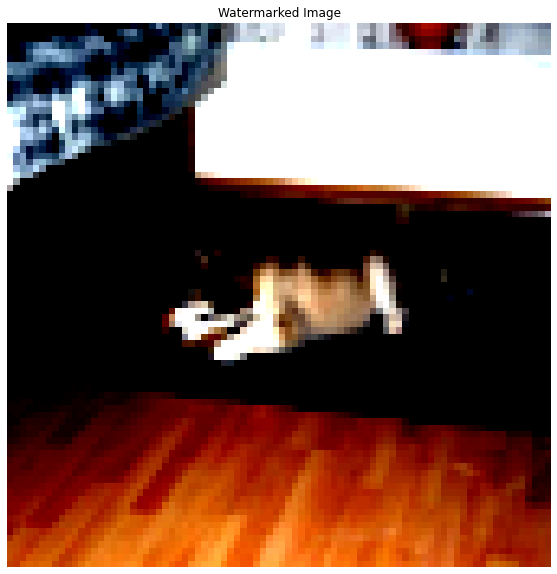

  9%|▉         | 1/11 [00:07<01:19,  8.00s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 5: Target opacity: 0, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


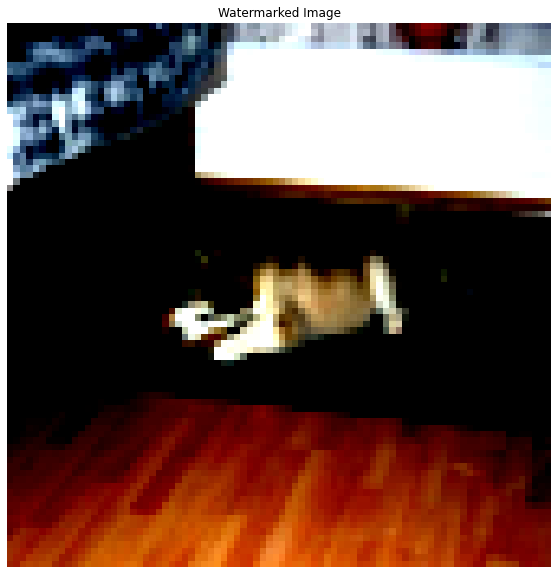

 18%|█▊        | 2/11 [00:15<01:11,  7.93s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 5: Target opacity: 0.05, Labeled correctly: 0.6266666666666667, Correctly Predicted Target: True, Base class predicted: False


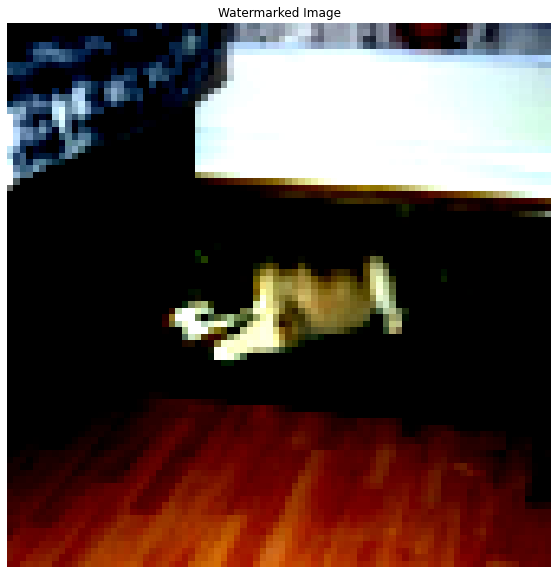

 27%|██▋       | 3/11 [00:23<01:03,  7.99s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 5: Target opacity: 0.1, Labeled correctly: 0.6133333333333333, Correctly Predicted Target: True, Base class predicted: False


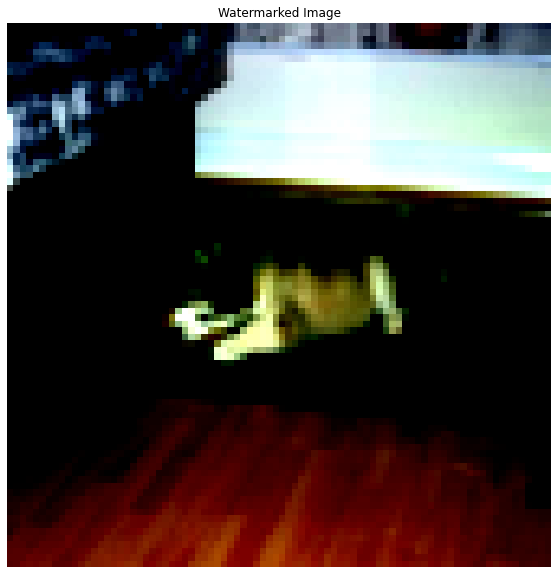

 36%|███▋      | 4/11 [00:31<00:56,  8.01s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 5: Target opacity: 0.15, Labeled correctly: 0.6266666666666667, Correctly Predicted Target: True, Base class predicted: False


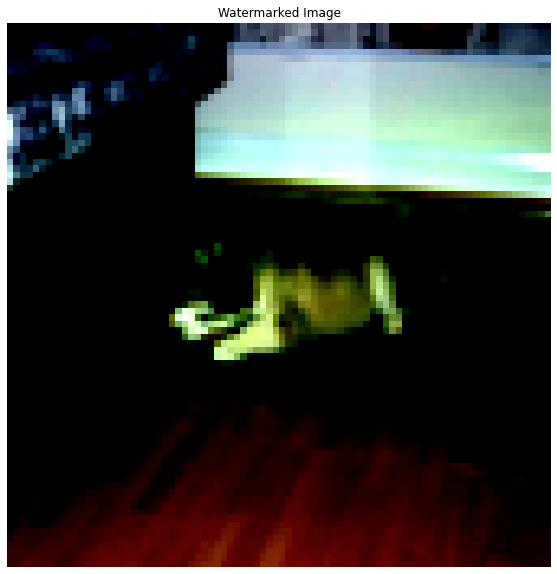

 45%|████▌     | 5/11 [00:39<00:48,  8.01s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 5: Target opacity: 0.2, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


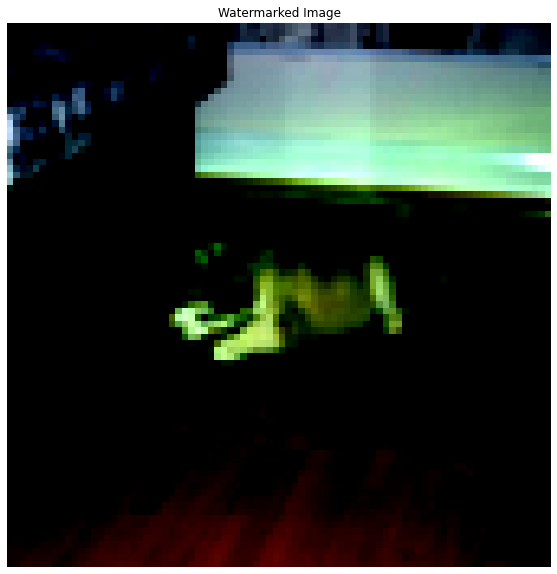

 55%|█████▍    | 6/11 [00:46<00:38,  7.62s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 5: Target opacity: 0.25, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


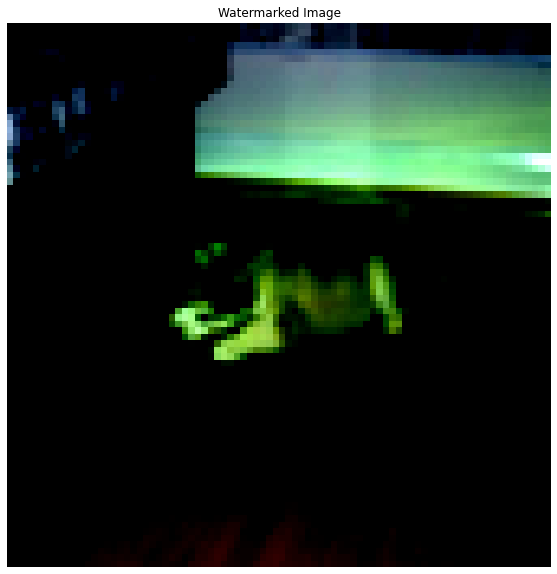

 64%|██████▎   | 7/11 [00:52<00:27,  6.96s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 5: Target opacity: 0.3, Labeled correctly: 0.6666666666666666, Correctly Predicted Target: True, Base class predicted: False


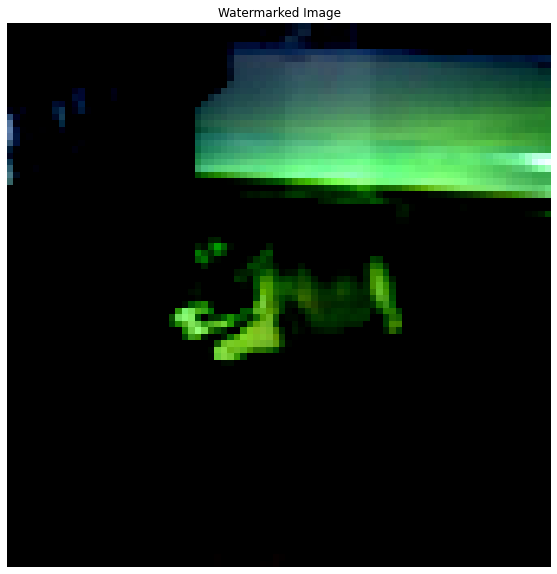

 73%|███████▎  | 8/11 [00:57<00:19,  6.51s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 5: Target opacity: 0.35, Labeled correctly: 0.6666666666666666, Correctly Predicted Target: True, Base class predicted: False


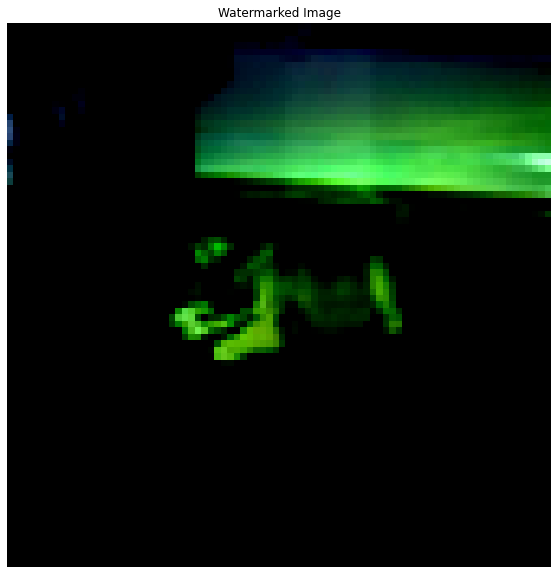

 82%|████████▏ | 9/11 [01:03<00:12,  6.19s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 5: Target opacity: 0.4, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: True, Base class predicted: False


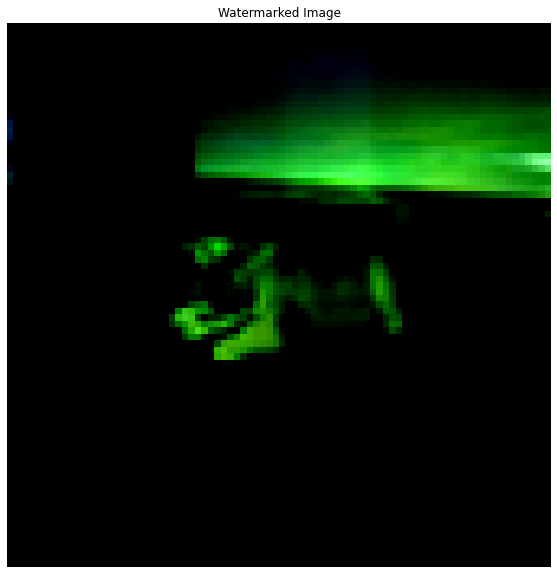

 91%|█████████ | 10/11 [01:08<00:05,  5.94s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 5: Target opacity: 0.45, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: True, Base class predicted: False


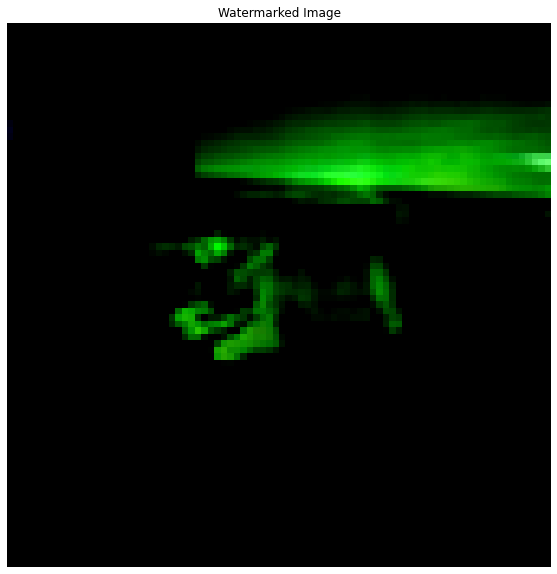

100%|██████████| 11/11 [01:14<00:00,  6.75s/it]

Iteration 5: Target opacity: 0.5, Labeled correctly: 0.6133333333333333, Correctly Predicted Target: False, Base class predicted: True



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


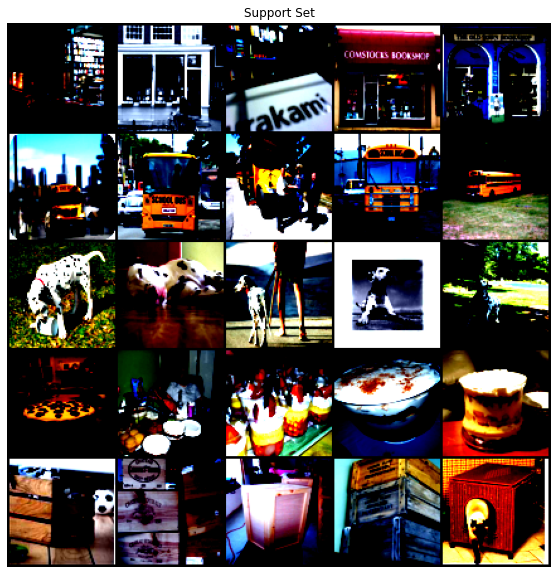

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 2, 2, 2, 2,
         2]])


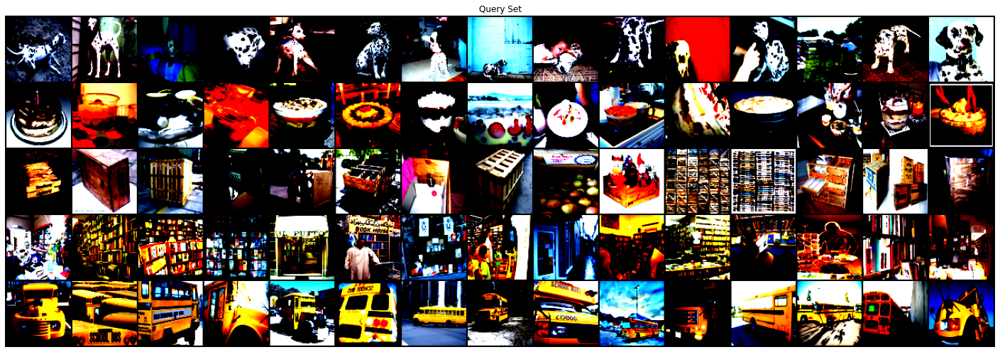

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3,
         3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
         1, 1, 1]])
target_class 2
unique_classes [0, 1, 3, 4]
base_class 4
target_indices [30 31 32 33 34 35 36 37 38 39 40 41 42 43 44]
target_index 37
base_indices [10 11 12 13 14]
base_index 11


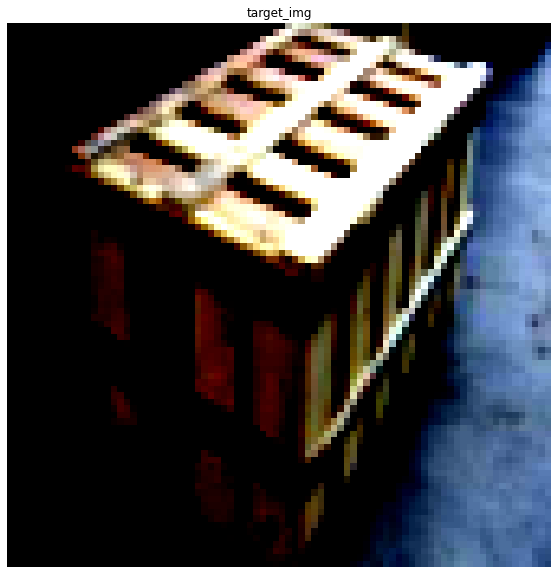

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


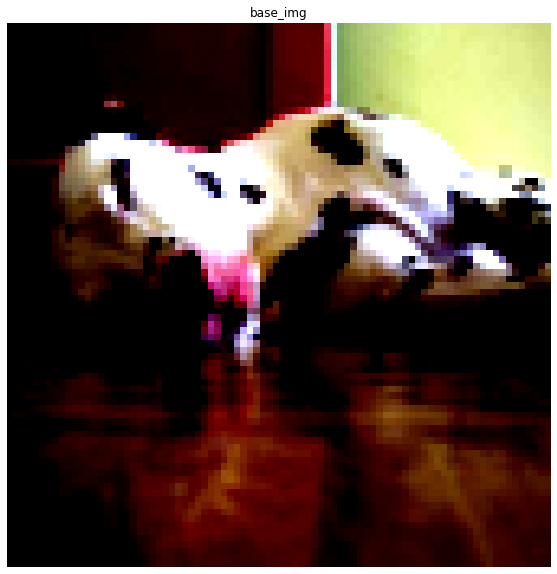

  0%|          | 3/1000 [00:00<00:44, 22.52it/s]

Iteration 0
loss: tensor(7.2707, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(44.5364, grad_fn=<PowBackward0>)
Iteration 2
loss: tensor(23.1311, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(42.4468, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(42.6388, grad_fn=<PowBackward0>)


  1%|          | 9/1000 [00:00<00:39, 24.93it/s]

Iteration 5
loss: tensor(9.3146, grad_fn=<PowBackward0>)
Iteration 6
loss: tensor(25.1917, grad_fn=<PowBackward0>)
Iteration 7
loss: tensor(46.0251, grad_fn=<PowBackward0>)
Iteration 8
loss: tensor(32.8498, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(15.2882, grad_fn=<PowBackward0>)
Iteration 10


  2%|▏         | 15/1000 [00:00<00:38, 25.40it/s]

loss: tensor(43.2497, grad_fn=<PowBackward0>)
Iteration 11
loss: tensor(10.2649, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(13.6933, grad_fn=<PowBackward0>)
Iteration 13
loss: tensor(35.3916, grad_fn=<PowBackward0>)
Iteration 14
loss: tensor(40.5850, grad_fn=<PowBackward0>)
Iteration 15
loss: tensor(32.3818, grad_fn=<PowBackward0>)


  2%|▏         | 21/1000 [00:00<00:39, 24.68it/s]

Iteration 16
loss: tensor(20.8870, grad_fn=<PowBackward0>)
Iteration 17
loss: tensor(43.6661, grad_fn=<PowBackward0>)
Iteration 18
loss: tensor(15.2483, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(46.6401, grad_fn=<PowBackward0>)
Iteration 20
loss: tensor(32.6262, grad_fn=<PowBackward0>)


  2%|▏         | 24/1000 [00:00<00:39, 24.73it/s]

Iteration 21
loss: tensor(13.3568, grad_fn=<PowBackward0>)
Iteration 22
loss: tensor(90.9670, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(16.9243, grad_fn=<PowBackward0>)
Iteration 24
loss: tensor(26.6454, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(28.7052, grad_fn=<PowBackward0>)
Iteration 26
loss: tensor(84.2230, grad_fn=<PowBackward0>)


  3%|▎         | 30/1000 [00:01<00:37, 25.89it/s]

Iteration 27
loss: tensor(20.6117, grad_fn=<PowBackward0>)
Iteration 28
loss: tensor(28.9873, grad_fn=<PowBackward0>)
Iteration 29
loss: tensor(16.9105, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(74.4087, grad_fn=<PowBackward0>)
Iteration 31
loss: tensor(15.3987, grad_fn=<PowBackward0>)
Iteration 32
loss: tensor(39.7379, grad_fn=<PowBackward0>)


  4%|▎         | 36/1000 [00:01<00:37, 25.49it/s]

Iteration 33
loss: tensor(24.0866, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(70.7287, grad_fn=<PowBackward0>)
Iteration 35
loss: tensor(2.8786, grad_fn=<PowBackward0>)
Iteration 36
loss: tensor(9.6172, grad_fn=<PowBackward0>)
Iteration 37
loss: tensor(50.5515, grad_fn=<PowBackward0>)
Iteration 38


  4%|▍         | 42/1000 [00:01<00:37, 25.25it/s]

loss: tensor(45.2495, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(20.0740, grad_fn=<PowBackward0>)
Iteration 40
loss: tensor(15.8463, grad_fn=<PowBackward0>)
Iteration 41
loss: tensor(5.1367, grad_fn=<PowBackward0>)
Iteration 42
loss: tensor(19.6038, grad_fn=<PowBackward0>)
Iteration 43
loss: tensor(47.6865, grad_fn=<PowBackward0>)


  5%|▍         | 48/1000 [00:01<00:39, 23.87it/s]

Iteration 44
loss: tensor(75.6120, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(5.4569, grad_fn=<PowBackward0>)
Iteration 46
loss: tensor(24.5621, grad_fn=<PowBackward0>)
Iteration 47
loss: tensor(17.9192, grad_fn=<PowBackward0>)
Iteration 48


  5%|▌         | 51/1000 [00:02<00:39, 23.92it/s]

loss: tensor(58.0845, grad_fn=<PowBackward0>)
Iteration 49
loss: tensor(9.7541, grad_fn=<PowBackward0>)
Iteration 50
loss: tensor(23.7253, grad_fn=<PowBackward0>)
Iteration 51
loss: tensor(32.9466, grad_fn=<PowBackward0>)
Iteration 52
loss: tensor(33.7048, grad_fn=<PowBackward0>)
Iteration 53
loss: tensor(5.2816, grad_fn=<PowBackward0>)


  6%|▌         | 57/1000 [00:02<00:37, 24.99it/s]

Iteration 54
loss: tensor(16.6494, grad_fn=<PowBackward0>)
Iteration 55
loss: tensor(51.2340, grad_fn=<PowBackward0>)
Iteration 56
loss: tensor(37.3723, grad_fn=<PowBackward0>)
Iteration 57
loss: tensor(22.7234, grad_fn=<PowBackward0>)
Iteration 58
loss: tensor(53.6954, grad_fn=<PowBackward0>)
Iteration 59


  6%|▋         | 63/1000 [00:02<00:36, 25.43it/s]

loss: tensor(29.6145, grad_fn=<PowBackward0>)
Iteration 60
loss: tensor(31.1028, grad_fn=<PowBackward0>)
Iteration 61
loss: tensor(22.4843, grad_fn=<PowBackward0>)
Iteration 62
loss: tensor(31.4619, grad_fn=<PowBackward0>)
Iteration 63
loss: tensor(32.8865, grad_fn=<PowBackward0>)
Iteration 64
loss: tensor(61.7284, grad_fn=<PowBackward0>)


  7%|▋         | 69/1000 [00:02<00:35, 26.05it/s]

Iteration 65
loss: tensor(20.7864, grad_fn=<PowBackward0>)
Iteration 66
loss: tensor(16.6457, grad_fn=<PowBackward0>)
Iteration 67
loss: tensor(28.7455, grad_fn=<PowBackward0>)
Iteration 68
loss: tensor(17.7057, grad_fn=<PowBackward0>)
Iteration 69
loss: tensor(32.1360, grad_fn=<PowBackward0>)
Iteration 70


  8%|▊         | 75/1000 [00:02<00:35, 26.00it/s]

loss: tensor(86.7719, grad_fn=<PowBackward0>)
Iteration 71
loss: tensor(31.3333, grad_fn=<PowBackward0>)
Iteration 72
loss: tensor(46.9633, grad_fn=<PowBackward0>)
Iteration 73
loss: tensor(4.0077, grad_fn=<PowBackward0>)
Iteration 74
loss: tensor(10.6257, grad_fn=<PowBackward0>)
Iteration 75
loss: tensor(55.0866, grad_fn=<PowBackward0>)


  8%|▊         | 81/1000 [00:03<00:34, 26.71it/s]

Iteration 76
loss: tensor(104.6898, grad_fn=<PowBackward0>)
Iteration 77
loss: tensor(2.7695, grad_fn=<PowBackward0>)
Iteration 78
loss: tensor(18.0822, grad_fn=<PowBackward0>)
Iteration 79
loss: tensor(24.6469, grad_fn=<PowBackward0>)
Iteration 80
loss: tensor(11.1557, grad_fn=<PowBackward0>)
Iteration 81
loss: tensor(30.3226, grad_fn=<PowBackward0>)


  9%|▊         | 87/1000 [00:03<00:35, 25.65it/s]

Iteration 82
loss: tensor(71.3922, grad_fn=<PowBackward0>)
Iteration 83
loss: tensor(16.5371, grad_fn=<PowBackward0>)
Iteration 84
loss: tensor(24.5237, grad_fn=<PowBackward0>)
Iteration 85
loss: tensor(28.0851, grad_fn=<PowBackward0>)
Iteration 86
loss: tensor(66.6530, grad_fn=<PowBackward0>)
Iteration 87


  9%|▉         | 93/1000 [00:03<00:34, 26.53it/s]

loss: tensor(20.6612, grad_fn=<PowBackward0>)
Iteration 88
loss: tensor(21.2055, grad_fn=<PowBackward0>)
Iteration 89
loss: tensor(25.8786, grad_fn=<PowBackward0>)
Iteration 90
loss: tensor(70.8527, grad_fn=<PowBackward0>)
Iteration 91
loss: tensor(27.7405, grad_fn=<PowBackward0>)
Iteration 92
loss: tensor(23.8784, grad_fn=<PowBackward0>)


 10%|▉         | 96/1000 [00:03<00:34, 26.27it/s]

Iteration 93
loss: tensor(16.7245, grad_fn=<PowBackward0>)
Iteration 94
loss: tensor(78.6062, grad_fn=<PowBackward0>)
Iteration 95
loss: tensor(1.6655, grad_fn=<PowBackward0>)
Iteration 96
loss: tensor(2.1830, grad_fn=<PowBackward0>)
Iteration 97
loss: tensor(38.1999, grad_fn=<PowBackward0>)
Iteration 98
loss:

 10%|█         | 102/1000 [00:04<00:33, 26.60it/s]

 tensor(36.0446, grad_fn=<PowBackward0>)
Iteration 99
loss: tensor(18.7862, grad_fn=<PowBackward0>)
Iteration 100
loss: tensor(21.6793, grad_fn=<PowBackward0>)
Iteration 101
loss: tensor(13.3868, grad_fn=<PowBackward0>)
Iteration 102
loss: tensor(27.1657, grad_fn=<PowBackward0>)
Iteration 103
loss: tensor(52.3831, grad_fn=<PowBackward0>)


 11%|█         | 108/1000 [00:04<00:33, 26.69it/s]

Iteration 104
loss: tensor(46.7817, grad_fn=<PowBackward0>)
Iteration 105
loss: tensor(13.8934, grad_fn=<PowBackward0>)
Iteration 106
loss: tensor(17.6001, grad_fn=<PowBackward0>)
Iteration 107
loss: tensor(21.7948, grad_fn=<PowBackward0>)
Iteration 108
loss: tensor(26.9476, grad_fn=<PowBackward0>)
Iteration 109


 11%|█▏        | 114/1000 [00:04<00:34, 25.75it/s]

loss: tensor(25.8103, grad_fn=<PowBackward0>)
Iteration 110
loss: tensor(19.4577, grad_fn=<PowBackward0>)
Iteration 111
loss: tensor(19.0939, grad_fn=<PowBackward0>)
Iteration 112
loss: tensor(39.1972, grad_fn=<PowBackward0>)
Iteration 113
loss: tensor(40.8275, grad_fn=<PowBackward0>)
Iteration 114
loss: tensor(31.7892, grad_fn=<PowBackward0>)

 12%|█▏        | 117/1000 [00:04<00:34, 25.91it/s]


Iteration 115
loss: tensor(21.0549, grad_fn=<PowBackward0>)
Iteration 116
loss: tensor(12.3334, grad_fn=<PowBackward0>)
Iteration 117
loss: tensor(38.4060, grad_fn=<PowBackward0>)
Iteration 118
loss: tensor(55.0741, grad_fn=<PowBackward0>)
Iteration 119
loss: tensor(14.1209, grad_fn=<PowBackward0>)


 12%|█▏        | 123/1000 [00:04<00:34, 25.17it/s]

Iteration 120
loss: tensor(30.6052, grad_fn=<PowBackward0>)
Iteration 121
loss: tensor(14.5459, grad_fn=<PowBackward0>)
Iteration 122
loss: tensor(30.3794, grad_fn=<PowBackward0>)
Iteration 123
loss: tensor(31.2668, grad_fn=<PowBackward0>)
Iteration 124
loss: tensor(24.4312, grad_fn=<PowBackward0>)
Iteration 125


 13%|█▎        | 129/1000 [00:05<00:34, 25.45it/s]

loss: tensor(13.2833, grad_fn=<PowBackward0>)
Iteration 126
loss: tensor(27.4544, grad_fn=<PowBackward0>)
Iteration 127
loss: tensor(29.9384, grad_fn=<PowBackward0>)
Iteration 128
loss: tensor(31.7230, grad_fn=<PowBackward0>)
Iteration 129
loss: tensor(45.2087, grad_fn=<PowBackward0>)
Iteration 130
loss: tensor(40.8015, grad_fn=<PowBackward0>)


 14%|█▎        | 135/1000 [00:05<00:34, 25.41it/s]

Iteration 131
loss: tensor(24.5804, grad_fn=<PowBackward0>)
Iteration 132
loss: tensor(50.9619, grad_fn=<PowBackward0>)
Iteration 133
loss: tensor(19.7679, grad_fn=<PowBackward0>)
Iteration 134
loss: tensor(26.1648, grad_fn=<PowBackward0>)
Iteration 135
loss: tensor(26.3623, grad_fn=<PowBackward0>)
Iteration 136


 14%|█▍        | 141/1000 [00:05<00:33, 25.70it/s]

loss: tensor(33.2205, grad_fn=<PowBackward0>)
Iteration 137
loss: tensor(16.1561, grad_fn=<PowBackward0>)
Iteration 138
loss: tensor(42.4223, grad_fn=<PowBackward0>)
Iteration 139
loss: tensor(38.5363, grad_fn=<PowBackward0>)
Iteration 140
loss: tensor(46.8783, grad_fn=<PowBackward0>)
Iteration 141
loss: tensor(23.3194, grad_fn=<PowBackward0>)


 15%|█▍        | 147/1000 [00:05<00:32, 25.85it/s]

Iteration 142
loss: tensor(35.1454, grad_fn=<PowBackward0>)
Iteration 143
loss: tensor(28.8014, grad_fn=<PowBackward0>)
Iteration 144
loss: tensor(35.2459, grad_fn=<PowBackward0>)
Iteration 145
loss: tensor(16.2027, grad_fn=<PowBackward0>)
Iteration 146
loss: tensor(20.2583, grad_fn=<PowBackward0>)
Iteration 147


 15%|█▌        | 150/1000 [00:05<00:34, 24.56it/s]

loss: tensor(13.4040, grad_fn=<PowBackward0>)
Iteration 148
loss: tensor(41.9518, grad_fn=<PowBackward0>)
Iteration 149
loss: tensor(5.3374, grad_fn=<PowBackward0>)
Iteration 150
loss: tensor(18.6276, grad_fn=<PowBackward0>)
Iteration 151
loss: tensor(40.7860, grad_fn=<PowBackward0>)
Iteration 152
loss: tensor(59.5629, grad_fn=<PowBackward0>)


 16%|█▌        | 156/1000 [00:06<00:33, 25.45it/s]

Iteration 153
loss: tensor(19.7580, grad_fn=<PowBackward0>)
Iteration 154
loss: tensor(20.5262, grad_fn=<PowBackward0>)
Iteration 155
loss: tensor(33.0775, grad_fn=<PowBackward0>)
Iteration 156
loss: tensor(47.1447, grad_fn=<PowBackward0>)
Iteration 157
loss: tensor(33.6655, grad_fn=<PowBackward0>)
Iteration 158
loss: tensor(37.9546, grad_fn=<PowBackward0>)


 16%|█▌        | 162/1000 [00:06<00:32, 25.97it/s]

Iteration 159
loss: tensor(4.0152, grad_fn=<PowBackward0>)
Iteration 160
loss: tensor(8.3170, grad_fn=<PowBackward0>)
Iteration 161
loss: tensor(26.6788, grad_fn=<PowBackward0>)
Iteration 162
loss: tensor(64.7263, grad_fn=<PowBackward0>)
Iteration 163
loss: tensor(8.9948, grad_fn=<PowBackward0>)
Iteration 164
loss:

 17%|█▋        | 168/1000 [00:06<00:31, 26.06it/s]

 tensor(24.6245, grad_fn=<PowBackward0>)
Iteration 165
loss: tensor(26.8087, grad_fn=<PowBackward0>)
Iteration 166
loss: tensor(56.3528, grad_fn=<PowBackward0>)
Iteration 167
loss: tensor(24.8568, grad_fn=<PowBackward0>)
Iteration 168
loss: tensor(25.6846, grad_fn=<PowBackward0>)
Iteration 169
loss: tensor(14.6122, grad_fn=<PowBackward0>)


 17%|█▋        | 174/1000 [00:06<00:32, 25.73it/s]

Iteration 170
loss: tensor(25.6880, grad_fn=<PowBackward0>)
Iteration 171
loss: tensor(23.9940, grad_fn=<PowBackward0>)
Iteration 172
loss: tensor(51.4192, grad_fn=<PowBackward0>)
Iteration 173
loss: tensor(22.9872, grad_fn=<PowBackward0>)
Iteration 174
loss: tensor(30.8847, grad_fn=<PowBackward0>)


 18%|█▊        | 180/1000 [00:07<00:33, 24.84it/s]

Iteration 175
loss: tensor(32.1253, grad_fn=<PowBackward0>)
Iteration 176
loss: tensor(30.0269, grad_fn=<PowBackward0>)
Iteration 177
loss: tensor(15.9046, grad_fn=<PowBackward0>)
Iteration 178
loss: tensor(26.1715, grad_fn=<PowBackward0>)
Iteration 179
loss: tensor(41.5843, grad_fn=<PowBackward0>)


 18%|█▊        | 183/1000 [00:07<00:32, 25.04it/s]

Iteration 180
loss: tensor(42.5149, grad_fn=<PowBackward0>)
Iteration 181
loss: tensor(4.0453, grad_fn=<PowBackward0>)
Iteration 182
loss: tensor(8.1094, grad_fn=<PowBackward0>)
Iteration 183
loss: tensor(36.8763, grad_fn=<PowBackward0>)
Iteration 184
loss: tensor(50.3663, grad_fn=<PowBackward0>)
Iteration 185
loss:

 19%|█▉        | 189/1000 [00:07<00:32, 25.18it/s]

 tensor(9.9999, grad_fn=<PowBackward0>)
Iteration 186
loss: tensor(14.8727, grad_fn=<PowBackward0>)
Iteration 187
loss: tensor(25.9003, grad_fn=<PowBackward0>)
Iteration 188
loss: tensor(64.7436, grad_fn=<PowBackward0>)
Iteration 189
loss: tensor(20.8616, grad_fn=<PowBackward0>)
Iteration 190
loss: tensor(39.2666, grad_fn=<PowBackward0>)


 20%|█▉        | 195/1000 [00:07<00:31, 25.65it/s]

Iteration 191
loss: tensor(48.6052, grad_fn=<PowBackward0>)
Iteration 192
loss: tensor(28.6545, grad_fn=<PowBackward0>)
Iteration 193
loss: tensor(25.5175, grad_fn=<PowBackward0>)
Iteration 194
loss: tensor(34.7461, grad_fn=<PowBackward0>)
Iteration 195
loss: tensor(34.1001, grad_fn=<PowBackward0>)
Iteration 196


 20%|██        | 201/1000 [00:07<00:31, 25.60it/s]

loss: tensor(20.3236, grad_fn=<PowBackward0>)
Iteration 197
loss: tensor(27.0994, grad_fn=<PowBackward0>)
Iteration 198
loss: tensor(27.9863, grad_fn=<PowBackward0>)
Iteration 199
loss: tensor(23.2370, grad_fn=<PowBackward0>)
Iteration 200
loss: tensor(10.9581, grad_fn=<PowBackward0>)
Iteration 201
loss: tensor(2.0105, grad_fn=<PowBackward0>)


 21%|██        | 207/1000 [00:08<00:30, 26.00it/s]

Iteration 202
loss: tensor(5.2232, grad_fn=<PowBackward0>)
Iteration 203
loss: tensor(1.5247, grad_fn=<PowBackward0>)
Iteration 204
loss: tensor(10.0427, grad_fn=<PowBackward0>)
Iteration 205
loss: tensor(16.0216, grad_fn=<PowBackward0>)
Iteration 206
loss: tensor(40.1973, grad_fn=<PowBackward0>)
Iteration 207


 21%|██        | 210/1000 [00:08<00:31, 25.42it/s]

loss: tensor(25.3463, grad_fn=<PowBackward0>)
Iteration 208
loss: tensor(31.5355, grad_fn=<PowBackward0>)
Iteration 209
loss: tensor(15.5388, grad_fn=<PowBackward0>)
Iteration 210
loss: tensor(31.1230, grad_fn=<PowBackward0>)
Iteration 211
loss: tensor(32.7110, grad_fn=<PowBackward0>)
Iteration 212
loss: tensor(28.8120, grad_fn=<PowBackward0>)


 22%|██▏       | 216/1000 [00:08<00:29, 26.44it/s]

Iteration 213
loss: tensor(18.3106, grad_fn=<PowBackward0>)
Iteration 214
loss: tensor(14.9272, grad_fn=<PowBackward0>)
Iteration 215
loss: tensor(21.2012, grad_fn=<PowBackward0>)
Iteration 216
loss: tensor(19.6766, grad_fn=<PowBackward0>)
Iteration 217
loss: tensor(24.0625, grad_fn=<PowBackward0>)
Iteration 218
loss: tensor(28.7885, grad_fn=<PowBackward0>)


 22%|██▏       | 222/1000 [00:08<00:29, 26.62it/s]

Iteration 219
loss: tensor(10.7043, grad_fn=<PowBackward0>)
Iteration 220
loss: tensor(21.2006, grad_fn=<PowBackward0>)
Iteration 221
loss: tensor(22.6017, grad_fn=<PowBackward0>)
Iteration 222
loss: tensor(19.2893, grad_fn=<PowBackward0>)
Iteration 223
loss: tensor(2.1294, grad_fn=<PowBackward0>)
Iteration 224
loss: 

 23%|██▎       | 228/1000 [00:08<00:29, 26.04it/s]

tensor(7.0191, grad_fn=<PowBackward0>)
Iteration 225
loss: tensor(7.8377, grad_fn=<PowBackward0>)
Iteration 226
loss: tensor(33.7683, grad_fn=<PowBackward0>)
Iteration 227
loss: tensor(13.1860, grad_fn=<PowBackward0>)
Iteration 228
loss: tensor(15.6726, grad_fn=<PowBackward0>)
Iteration 229
loss: tensor(15.8563, grad_fn=<PowBackward0>)


 23%|██▎       | 234/1000 [00:09<00:28, 26.65it/s]

Iteration 230
loss: tensor(19.9207, grad_fn=<PowBackward0>)
Iteration 231
loss: tensor(5.0879, grad_fn=<PowBackward0>)
Iteration 232
loss: tensor(7.9056, grad_fn=<PowBackward0>)
Iteration 233
loss: tensor(29.6636, grad_fn=<PowBackward0>)
Iteration 234
loss: tensor(24.3118, grad_fn=<PowBackward0>)
Iteration 235
loss: tensor(18.0640, grad_fn=<PowBackward0>)


 24%|██▍       | 240/1000 [00:09<00:27, 27.16it/s]

Iteration 236
loss: tensor(24.5347, grad_fn=<PowBackward0>)
Iteration 237
loss: tensor(28.0979, grad_fn=<PowBackward0>)
Iteration 238
loss: tensor(16.0621, grad_fn=<PowBackward0>)
Iteration 239
loss: tensor(13.2910, grad_fn=<PowBackward0>)
Iteration 240
loss: tensor(17.2262, grad_fn=<PowBackward0>)
Iteration 241


 25%|██▍       | 246/1000 [00:09<00:27, 27.16it/s]

loss: tensor(13.9163, grad_fn=<PowBackward0>)
Iteration 242
loss: tensor(21.2094, grad_fn=<PowBackward0>)
Iteration 243
loss: tensor(21.8000, grad_fn=<PowBackward0>)
Iteration 244
loss: tensor(18.1979, grad_fn=<PowBackward0>)
Iteration 245
loss: tensor(14.8771, grad_fn=<PowBackward0>)
Iteration 246
loss: tensor(20.1479, grad_fn=<PowBackward0>)
Iteration 247


 25%|██▌       | 252/1000 [00:09<00:28, 26.44it/s]

loss: tensor(19.3183, grad_fn=<PowBackward0>)
Iteration 248
loss: tensor(27.4310, grad_fn=<PowBackward0>)
Iteration 249
loss: tensor(23.9610, grad_fn=<PowBackward0>)
Iteration 250
loss: tensor(17.8709, grad_fn=<PowBackward0>)
Iteration 251
loss: tensor(15.4782, grad_fn=<PowBackward0>)
Iteration 252
loss: tensor(34.0278, grad_fn=<PowBackward0>)


 26%|██▌       | 258/1000 [00:10<00:27, 26.75it/s]

Iteration 253
loss: tensor(17.7958, grad_fn=<PowBackward0>)
Iteration 254
loss: tensor(17.3000, grad_fn=<PowBackward0>)
Iteration 255
loss: tensor(13.7079, grad_fn=<PowBackward0>)
Iteration 256
loss: tensor(26.0039, grad_fn=<PowBackward0>)
Iteration 257
loss: tensor(26.6111, grad_fn=<PowBackward0>)
Iteration 258


 26%|██▌       | 261/1000 [00:10<00:28, 26.20it/s]

loss: tensor(29.3091, grad_fn=<PowBackward0>)
Iteration 259
loss: tensor(15.9618, grad_fn=<PowBackward0>)
Iteration 260
loss: tensor(10.0251, grad_fn=<PowBackward0>)
Iteration 261
loss: tensor(12.2730, grad_fn=<PowBackward0>)
Iteration 262
loss: tensor(32.4105, grad_fn=<PowBackward0>)
Iteration 263
loss: tensor(28.1539, grad_fn=<PowBackward0>)


 27%|██▋       | 267/1000 [00:10<00:27, 26.53it/s]

Iteration 264
loss: tensor(23.7033, grad_fn=<PowBackward0>)
Iteration 265
loss: tensor(46.3152, grad_fn=<PowBackward0>)
Iteration 266
loss: tensor(6.7796, grad_fn=<PowBackward0>)
Iteration 267
loss: tensor(14.2780, grad_fn=<PowBackward0>)
Iteration 268
loss: tensor(23.6639, grad_fn=<PowBackward0>)
Iteration 269
loss:

 27%|██▋       | 273/1000 [00:10<00:27, 26.29it/s]

 tensor(17.4555, grad_fn=<PowBackward0>)
Iteration 270
loss: tensor(27.5624, grad_fn=<PowBackward0>)
Iteration 271
loss: tensor(21.1206, grad_fn=<PowBackward0>)
Iteration 272
loss: tensor(18.3872, grad_fn=<PowBackward0>)
Iteration 273
loss: tensor(11.6393, grad_fn=<PowBackward0>)
Iteration 274
loss: tensor(26.1530, grad_fn=<PowBackward0>)


 28%|██▊       | 279/1000 [00:10<00:27, 26.04it/s]

Iteration 275
loss: tensor(25.3692, grad_fn=<PowBackward0>)
Iteration 276
loss: tensor(38.4167, grad_fn=<PowBackward0>)
Iteration 277
loss: tensor(25.7141, grad_fn=<PowBackward0>)
Iteration 278
loss: tensor(18.4764, grad_fn=<PowBackward0>)
Iteration 279
loss: tensor(20.4581, grad_fn=<PowBackward0>)
Iteration 280


 28%|██▊       | 285/1000 [00:11<00:27, 26.13it/s]

loss: tensor(29.6448, grad_fn=<PowBackward0>)
Iteration 281
loss: tensor(27.6434, grad_fn=<PowBackward0>)
Iteration 282
loss: tensor(17.1590, grad_fn=<PowBackward0>)
Iteration 283
loss: tensor(15.0070, grad_fn=<PowBackward0>)
Iteration 284
loss: tensor(12.5826, grad_fn=<PowBackward0>)
Iteration 285
loss: tensor(17.4591, grad_fn=<PowBackward0>)


 29%|██▉       | 291/1000 [00:11<00:26, 26.43it/s]

Iteration 286
loss: tensor(39.7999, grad_fn=<PowBackward0>)
Iteration 287
loss: tensor(9.1255, grad_fn=<PowBackward0>)
Iteration 288
loss: tensor(15.1965, grad_fn=<PowBackward0>)
Iteration 289
loss: tensor(21.9268, grad_fn=<PowBackward0>)
Iteration 290
loss: tensor(21.6628, grad_fn=<PowBackward0>)
Iteration 291


 29%|██▉       | 294/1000 [00:11<00:26, 26.56it/s]

loss: tensor(16.5462, grad_fn=<PowBackward0>)
Iteration 292
loss: tensor(17.8392, grad_fn=<PowBackward0>)
Iteration 293
loss: tensor(28.9454, grad_fn=<PowBackward0>)
Iteration 294
loss: tensor(30.1062, grad_fn=<PowBackward0>)
Iteration 295
loss: tensor(5.2634, grad_fn=<PowBackward0>)
Iteration 296
loss: tensor(11.8122, grad_fn=<PowBackward0>)


 30%|███       | 300/1000 [00:11<00:26, 26.60it/s]

Iteration 297
loss: tensor(1.7398, grad_fn=<PowBackward0>)
Iteration 298
loss: tensor(9.9462, grad_fn=<PowBackward0>)
Iteration 299
loss: tensor(55.2822, grad_fn=<PowBackward0>)
Iteration 300
loss: tensor(26.0501, grad_fn=<PowBackward0>)
Iteration 301
loss: tensor(15.4841, grad_fn=<PowBackward0>)
Iteration 302


 31%|███       | 306/1000 [00:11<00:27, 25.10it/s]

loss: tensor(1.0893, grad_fn=<PowBackward0>)
Iteration 303
loss: tensor(1.0621, grad_fn=<PowBackward0>)
Iteration 304
loss: tensor(1.0318, grad_fn=<PowBackward0>)
Iteration 305
loss: tensor(1.2150, grad_fn=<PowBackward0>)
Iteration 306


 31%|███       | 309/1000 [00:12<00:29, 23.11it/s]

loss: tensor(2.0470, grad_fn=<PowBackward0>)
Iteration 307
loss: tensor(6.0136, grad_fn=<PowBackward0>)
Iteration 308
loss: tensor(8.6610, grad_fn=<PowBackward0>)
Iteration 309
loss: tensor(21.1965, grad_fn=<PowBackward0>)
Iteration 310
loss: tensor(10.3151, grad_fn=<PowBackward0>)
Iteration 311
loss: tensor(8.1680, grad_fn=<PowBackward0>)


 32%|███▏      | 315/1000 [00:12<00:27, 24.75it/s]

Iteration 312
loss: tensor(4.7154, grad_fn=<PowBackward0>)
Iteration 313
loss: tensor(4.6315, grad_fn=<PowBackward0>)
Iteration 314
loss: tensor(3.3118, grad_fn=<PowBackward0>)
Iteration 315
loss: tensor(3.8562, grad_fn=<PowBackward0>)
Iteration 316
loss: tensor(1.7706, grad_fn=<PowBackward0>)
Iteration 317
loss: tensor(10.3134, grad_fn=<PowBackward0>)


 32%|███▏      | 321/1000 [00:12<00:27, 25.11it/s]

Iteration 318
loss: tensor(9.1077, grad_fn=<PowBackward0>)
Iteration 319
loss: tensor(12.6004, grad_fn=<PowBackward0>)
Iteration 320
loss: tensor(9.8546, grad_fn=<PowBackward0>)
Iteration 321
loss: tensor(14.5180, grad_fn=<PowBackward0>)
Iteration 322
loss: tensor(5.5513, grad_fn=<PowBackward0>)


 33%|███▎      | 327/1000 [00:12<00:27, 24.46it/s]

Iteration 323
loss: tensor(8.5973, grad_fn=<PowBackward0>)
Iteration 324
loss: tensor(4.7174, grad_fn=<PowBackward0>)
Iteration 325
loss: tensor(5.3048, grad_fn=<PowBackward0>)
Iteration 326
loss: tensor(3.0093, grad_fn=<PowBackward0>)
Iteration 327
loss: tensor(4.6086, grad_fn=<PowBackward0>)


 33%|███▎      | 333/1000 [00:13<00:27, 24.22it/s]

Iteration 328
loss: tensor(6.4043, grad_fn=<PowBackward0>)
Iteration 329
loss: tensor(15.0205, grad_fn=<PowBackward0>)
Iteration 330
loss: tensor(11.3820, grad_fn=<PowBackward0>)
Iteration 331
loss: tensor(11.1628, grad_fn=<PowBackward0>)
Iteration 332
loss: tensor(7.6685, grad_fn=<PowBackward0>)


 34%|███▎      | 336/1000 [00:13<00:26, 24.95it/s]

Iteration 333
loss: tensor(10.6420, grad_fn=<PowBackward0>)
Iteration 334
loss: tensor(4.6584, grad_fn=<PowBackward0>)
Iteration 335
loss: tensor(6.6309, grad_fn=<PowBackward0>)
Iteration 336
loss: tensor(5.3819, grad_fn=<PowBackward0>)
Iteration 337
loss: tensor(4.6746, grad_fn=<PowBackward0>)
Iteration 338


 34%|███▍      | 342/1000 [00:13<00:26, 24.53it/s]

loss: tensor(4.2667, grad_fn=<PowBackward0>)
Iteration 339
loss: tensor(5.4598, grad_fn=<PowBackward0>)
Iteration 340
loss: tensor(8.8016, grad_fn=<PowBackward0>)
Iteration 341
loss: tensor(22.0370, grad_fn=<PowBackward0>)
Iteration 342
loss: tensor(8.4679, grad_fn=<PowBackward0>)
Iteration 343


 35%|███▍      | 348/1000 [00:13<00:26, 25.03it/s]

loss: tensor(9.2941, grad_fn=<PowBackward0>)
Iteration 344
loss: tensor(14.6531, grad_fn=<PowBackward0>)
Iteration 345
loss: tensor(10.1086, grad_fn=<PowBackward0>)
Iteration 346
loss: tensor(4.6302, grad_fn=<PowBackward0>)
Iteration 347
loss: tensor(5.3267, grad_fn=<PowBackward0>)
Iteration 348
loss: tensor(5.0994, grad_fn=<PowBackward0>)


 35%|███▌      | 354/1000 [00:13<00:25, 25.54it/s]

Iteration 349
loss: tensor(5.1348, grad_fn=<PowBackward0>)
Iteration 350
loss: tensor(3.3217, grad_fn=<PowBackward0>)
Iteration 351
loss: tensor(5.6545, grad_fn=<PowBackward0>)
Iteration 352
loss: tensor(5.8648, grad_fn=<PowBackward0>)
Iteration 353
loss: tensor(10.1170, grad_fn=<PowBackward0>)
Iteration 354
loss: 

 36%|███▌      | 357/1000 [00:13<00:24, 26.21it/s]

tensor(7.6552, grad_fn=<PowBackward0>)
Iteration 355
loss: tensor(15.9479, grad_fn=<PowBackward0>)
Iteration 356
loss: tensor(11.0337, grad_fn=<PowBackward0>)
Iteration 357
loss: tensor(14.1843, grad_fn=<PowBackward0>)
Iteration 358
loss: tensor(8.8943, grad_fn=<PowBackward0>)
Iteration 359
loss: tensor(10.5796, grad_fn=<PowBackward0>)


 36%|███▋      | 363/1000 [00:14<00:24, 26.15it/s]

Iteration 360
loss: tensor(5.0458, grad_fn=<PowBackward0>)
Iteration 361
loss: tensor(3.2072, grad_fn=<PowBackward0>)
Iteration 362
loss: tensor(1.9146, grad_fn=<PowBackward0>)
Iteration 363
loss: tensor(3.1754, grad_fn=<PowBackward0>)
Iteration 364
loss: tensor(4.6805, grad_fn=<PowBackward0>)
Iteration 365


 37%|███▋      | 369/1000 [00:14<00:24, 25.68it/s]

loss: tensor(10.6584, grad_fn=<PowBackward0>)
Iteration 366
loss: tensor(6.4895, grad_fn=<PowBackward0>)
Iteration 367
loss: tensor(11.5862, grad_fn=<PowBackward0>)
Iteration 368
loss: tensor(12.0979, grad_fn=<PowBackward0>)
Iteration 369
loss: tensor(12.3500, grad_fn=<PowBackward0>)
Iteration 370
loss: tensor(11.8840, grad_fn=<PowBackward0>)


 38%|███▊      | 375/1000 [00:14<00:25, 24.94it/s]

Iteration 371
loss: tensor(10.9907, grad_fn=<PowBackward0>)
Iteration 372
loss: tensor(5.5535, grad_fn=<PowBackward0>)
Iteration 373
loss: tensor(7.4358, grad_fn=<PowBackward0>)
Iteration 374
loss: tensor(4.1582, grad_fn=<PowBackward0>)
Iteration 375
loss: tensor(3.9730, grad_fn=<PowBackward0>)


 38%|███▊      | 381/1000 [00:14<00:24, 25.05it/s]

Iteration 376
loss: tensor(3.0528, grad_fn=<PowBackward0>)
Iteration 377
loss: tensor(7.2790, grad_fn=<PowBackward0>)
Iteration 378
loss: tensor(12.2386, grad_fn=<PowBackward0>)
Iteration 379
loss: tensor(14.5007, grad_fn=<PowBackward0>)
Iteration 380
loss: tensor(6.9736, grad_fn=<PowBackward0>)
Iteration 381


 38%|███▊      | 384/1000 [00:15<00:24, 25.00it/s]

loss: tensor(8.3975, grad_fn=<PowBackward0>)
Iteration 382
loss: tensor(7.1769, grad_fn=<PowBackward0>)
Iteration 383
loss: tensor(9.1664, grad_fn=<PowBackward0>)
Iteration 384
loss: tensor(4.4508, grad_fn=<PowBackward0>)
Iteration 385
loss: tensor(3.9158, grad_fn=<PowBackward0>)
Iteration 386
loss: tensor(4.4422, grad_fn=<PowBackward0>)


 39%|███▉      | 390/1000 [00:15<00:24, 25.38it/s]

Iteration 387
loss: tensor(9.4376, grad_fn=<PowBackward0>)
Iteration 388
loss: tensor(9.2532, grad_fn=<PowBackward0>)
Iteration 389
loss: tensor(11.5333, grad_fn=<PowBackward0>)
Iteration 390
loss: tensor(7.8326, grad_fn=<PowBackward0>)
Iteration 391
loss: tensor(7.1398, grad_fn=<PowBackward0>)
Iteration 392
loss: tensor(5.8625, grad_fn=<PowBackward0>)


 40%|███▉      | 396/1000 [00:15<00:23, 25.96it/s]

Iteration 393
loss: tensor(6.8066, grad_fn=<PowBackward0>)
Iteration 394
loss: tensor(2.2289, grad_fn=<PowBackward0>)
Iteration 395
loss: tensor(3.7214, grad_fn=<PowBackward0>)
Iteration 396
loss: tensor(5.0685, grad_fn=<PowBackward0>)
Iteration 397
loss: tensor(9.9261, grad_fn=<PowBackward0>)
Iteration 398
loss: tensor(6.9742, grad_fn=<PowBackward0>)


 40%|████      | 402/1000 [00:15<00:24, 24.87it/s]

Iteration 399
loss: tensor(9.5678, grad_fn=<PowBackward0>)
Iteration 400
loss: tensor(3.2523, grad_fn=<PowBackward0>)
Iteration 401
loss: tensor(9.0654, grad_fn=<PowBackward0>)
Iteration 402
loss: tensor(2.7045, grad_fn=<PowBackward0>)
Iteration 403
loss: tensor(0.8265, grad_fn=<PowBackward0>)


 41%|████      | 408/1000 [00:16<00:24, 24.55it/s]

Iteration 404
loss: tensor(0.4980, grad_fn=<PowBackward0>)
Iteration 405
loss: tensor(0.4827, grad_fn=<PowBackward0>)
Iteration 406
loss: tensor(0.4669, grad_fn=<PowBackward0>)
Iteration 407
loss: tensor(0.4643, grad_fn=<PowBackward0>)
Iteration 408
loss: tensor(0.4792, grad_fn=<PowBackward0>)
Iteration 409


 41%|████▏     | 414/1000 [00:16<00:23, 25.19it/s]

loss: tensor(0.5283, grad_fn=<PowBackward0>)
Iteration 410
loss: tensor(0.8962, grad_fn=<PowBackward0>)
Iteration 411
loss: tensor(2.5403, grad_fn=<PowBackward0>)
Iteration 412
loss: tensor(4.9724, grad_fn=<PowBackward0>)
Iteration 413
loss: tensor(5.7764, grad_fn=<PowBackward0>)
Iteration 414
loss: tensor(2.4725, grad_fn=<PowBackward0>)


 42%|████▏     | 420/1000 [00:16<00:23, 24.63it/s]

Iteration 415
loss: tensor(1.2781, grad_fn=<PowBackward0>)
Iteration 416
loss: tensor(0.8454, grad_fn=<PowBackward0>)
Iteration 417
loss: tensor(0.6666, grad_fn=<PowBackward0>)
Iteration 418
loss: tensor(0.5819, grad_fn=<PowBackward0>)
Iteration 419
loss: tensor(0.5869, grad_fn=<PowBackward0>)


 42%|████▏     | 423/1000 [00:16<00:23, 24.66it/s]

Iteration 420
loss: tensor(0.7478, grad_fn=<PowBackward0>)
Iteration 421
loss: tensor(1.7059, grad_fn=<PowBackward0>)
Iteration 422
loss: tensor(2.9841, grad_fn=<PowBackward0>)
Iteration 423
loss: tensor(4.2874, grad_fn=<PowBackward0>)
Iteration 424
loss: tensor(2.3073, grad_fn=<PowBackward0>)
Iteration 425


 43%|████▎     | 429/1000 [00:16<00:22, 25.62it/s]

loss: tensor(2.3611, grad_fn=<PowBackward0>)
Iteration 426
loss: tensor(1.6821, grad_fn=<PowBackward0>)
Iteration 427
loss: tensor(1.3904, grad_fn=<PowBackward0>)
Iteration 428
loss: tensor(1.1591, grad_fn=<PowBackward0>)
Iteration 429
loss: tensor(1.1845, grad_fn=<PowBackward0>)
Iteration 430
loss: tensor(1.3233, grad_fn=<PowBackward0>)
Iteration

 44%|████▎     | 435/1000 [00:17<00:21, 26.19it/s]

 431
loss: tensor(2.0596, grad_fn=<PowBackward0>)
Iteration 432
loss: tensor(2.2701, grad_fn=<PowBackward0>)
Iteration 433
loss: tensor(4.0860, grad_fn=<PowBackward0>)
Iteration 434
loss: tensor(2.2426, grad_fn=<PowBackward0>)
Iteration 435
loss: tensor(2.8686, grad_fn=<PowBackward0>)
Iteration

 44%|████▍     | 441/1000 [00:17<00:22, 25.15it/s]

 436
loss: tensor(2.2088, grad_fn=<PowBackward0>)
Iteration 437
loss: tensor(2.2139, grad_fn=<PowBackward0>)
Iteration 438
loss: tensor(1.5021, grad_fn=<PowBackward0>)
Iteration 439
loss: tensor(1.7632, grad_fn=<PowBackward0>)
Iteration 440
loss: tensor(1.5974, grad_fn=<PowBackward0>)
Iteration 

 44%|████▍     | 444/1000 [00:17<00:22, 25.15it/s]

441
loss: tensor(1.6138, grad_fn=<PowBackward0>)
Iteration 442
loss: tensor(1.2704, grad_fn=<PowBackward0>)
Iteration 443
loss: tensor(1.3777, grad_fn=<PowBackward0>)
Iteration 444
loss: tensor(1.2612, grad_fn=<PowBackward0>)
Iteration 445
loss: tensor(1.4205, grad_fn=<PowBackward0>)
Iteration 446


 45%|████▌     | 450/1000 [00:17<00:22, 24.93it/s]

loss: tensor(1.0972, grad_fn=<PowBackward0>)
Iteration 447
loss: tensor(3.4001, grad_fn=<PowBackward0>)
Iteration 448
loss: tensor(5.5514, grad_fn=<PowBackward0>)
Iteration 449
loss: tensor(5.3884, grad_fn=<PowBackward0>)
Iteration 450
loss: tensor(2.1913, grad_fn=<PowBackward0>)
Iteration 451
loss: tensor(2.4669, grad_fn=<PowBackward0>)

 46%|████▌     | 456/1000 [00:17<00:21, 25.23it/s]


Iteration 452
loss: tensor(1.6752, grad_fn=<PowBackward0>)
Iteration 453
loss: tensor(1.3930, grad_fn=<PowBackward0>)
Iteration 454
loss: tensor(1.1337, grad_fn=<PowBackward0>)
Iteration 455
loss: tensor(1.2226, grad_fn=<PowBackward0>)
Iteration 456
loss: tensor(1.0683, grad_fn=<PowBackward0>)


 46%|████▌     | 462/1000 [00:18<00:21, 24.90it/s]

Iteration 457
loss: tensor(1.2841, grad_fn=<PowBackward0>)
Iteration 458
loss: tensor(1.5540, grad_fn=<PowBackward0>)
Iteration 459
loss: tensor(2.2903, grad_fn=<PowBackward0>)
Iteration 460
loss: tensor(2.5258, grad_fn=<PowBackward0>)
Iteration 461
loss: tensor(3.1620, grad_fn=<PowBackward0>)
Iteration 462

 46%|████▋     | 465/1000 [00:18<00:21, 24.91it/s]


loss: tensor(2.8319, grad_fn=<PowBackward0>)
Iteration 463
loss: tensor(2.7618, grad_fn=<PowBackward0>)
Iteration 464
loss: tensor(1.5104, grad_fn=<PowBackward0>)
Iteration 465
loss: tensor(2.3403, grad_fn=<PowBackward0>)
Iteration 466
loss: tensor(1.8787, grad_fn=<PowBackward0>)
Iteration 467
loss: tensor(2.7240, grad_fn=<PowBackward0>)

 47%|████▋     | 471/1000 [00:18<00:20, 25.80it/s]


Iteration 468
loss: tensor(2.4331, grad_fn=<PowBackward0>)
Iteration 469
loss: tensor(2.5244, grad_fn=<PowBackward0>)
Iteration 470
loss: tensor(2.0553, grad_fn=<PowBackward0>)
Iteration 471
loss: tensor(1.8786, grad_fn=<PowBackward0>)
Iteration 472
loss: tensor(1.2458, grad_fn=<PowBackward0>)


 48%|████▊     | 477/1000 [00:18<00:20, 25.83it/s]

Iteration 473
loss: tensor(1.5248, grad_fn=<PowBackward0>)
Iteration 474
loss: tensor(1.5273, grad_fn=<PowBackward0>)
Iteration 475
loss: tensor(1.7247, grad_fn=<PowBackward0>)
Iteration 476
loss: tensor(1.5982, grad_fn=<PowBackward0>)
Iteration 477
loss: tensor(3.6035, grad_fn=<PowBackward0>)
Iteration 478


 48%|████▊     | 483/1000 [00:18<00:19, 26.59it/s]

loss: tensor(4.5582, grad_fn=<PowBackward0>)
Iteration 479
loss: tensor(4.0749, grad_fn=<PowBackward0>)
Iteration 480
loss: tensor(2.2085, grad_fn=<PowBackward0>)
Iteration 481
loss: tensor(1.5371, grad_fn=<PowBackward0>)
Iteration 482
loss: tensor(0.8064, grad_fn=<PowBackward0>)
Iteration 483
loss: tensor(0.7494, grad_fn=<PowBackward0>)
Iteration

 49%|████▉     | 489/1000 [00:19<00:19, 25.93it/s]

 484
loss: tensor(0.6806, grad_fn=<PowBackward0>)
Iteration 485
loss: tensor(0.8063, grad_fn=<PowBackward0>)
Iteration 486
loss: tensor(0.9612, grad_fn=<PowBackward0>)
Iteration 487
loss: tensor(1.5122, grad_fn=<PowBackward0>)
Iteration 488
loss: tensor(1.7666, grad_fn=<PowBackward0>)
Iteration 489


 49%|████▉     | 492/1000 [00:19<00:19, 25.92it/s]

loss: tensor(2.3414, grad_fn=<PowBackward0>)
Iteration 490
loss: tensor(1.4415, grad_fn=<PowBackward0>)
Iteration 491
loss: tensor(1.6262, grad_fn=<PowBackward0>)
Iteration 492
loss: tensor(1.5261, grad_fn=<PowBackward0>)
Iteration 493
loss: tensor(1.5547, grad_fn=<PowBackward0>)
Iteration 494
loss: tensor(1.2177, grad_fn=<PowBackward0>)


 50%|████▉     | 498/1000 [00:19<00:20, 25.05it/s]

Iteration 495
loss: tensor(3.2243, grad_fn=<PowBackward0>)
Iteration 496
loss: tensor(4.2596, grad_fn=<PowBackward0>)
Iteration 497
loss: tensor(4.5342, grad_fn=<PowBackward0>)
Iteration 498
loss: tensor(2.4409, grad_fn=<PowBackward0>)
Iteration 499
loss: tensor(1.6646, grad_fn=<PowBackward0>)
Iteration 500


 50%|█████     | 504/1000 [00:19<00:19, 25.34it/s]

loss: tensor(0.7665, grad_fn=<PowBackward0>)
Iteration 501
loss: tensor(0.6119, grad_fn=<PowBackward0>)
Iteration 502
loss: tensor(0.4943, grad_fn=<PowBackward0>)
Iteration 503
loss: tensor(0.4843, grad_fn=<PowBackward0>)
Iteration 504
loss: tensor(0.4722, grad_fn=<PowBackward0>)
Iteration 505
loss: tensor(0.4629, grad_fn=<PowBackward0>)


 51%|█████     | 510/1000 [00:20<00:19, 25.77it/s]

Iteration 506
loss: tensor(0.4476, grad_fn=<PowBackward0>)
Iteration 507
loss: tensor(0.4380, grad_fn=<PowBackward0>)
Iteration 508
loss: tensor(0.4172, grad_fn=<PowBackward0>)
Iteration 509
loss: tensor(0.4156, grad_fn=<PowBackward0>)
Iteration 510
loss: tensor(0.3997, grad_fn=<PowBackward0>)
Iteration 511


 52%|█████▏    | 516/1000 [00:20<00:18, 25.96it/s]

loss: tensor(0.3803, grad_fn=<PowBackward0>)
Iteration 512
loss: tensor(0.3745, grad_fn=<PowBackward0>)
Iteration 513
loss: tensor(0.3690, grad_fn=<PowBackward0>)
Iteration 514
loss: tensor(0.3925, grad_fn=<PowBackward0>)
Iteration 515
loss: tensor(0.4720, grad_fn=<PowBackward0>)
Iteration 516
loss: tensor(0.8686, grad_fn=<PowBackward0>)


 52%|█████▏    | 522/1000 [00:20<00:18, 26.00it/s]

Iteration 517
loss: tensor(1.4205, grad_fn=<PowBackward0>)
Iteration 518
loss: tensor(0.7528, grad_fn=<PowBackward0>)
Iteration 519
loss: tensor(0.5665, grad_fn=<PowBackward0>)
Iteration 520
loss: tensor(0.4914, grad_fn=<PowBackward0>)
Iteration 521
loss: tensor(0.4287, grad_fn=<PowBackward0>)
Iteration 522


 52%|█████▎    | 525/1000 [00:20<00:18, 25.84it/s]

loss: tensor(0.4285, grad_fn=<PowBackward0>)
Iteration 523
loss: tensor(0.4112, grad_fn=<PowBackward0>)
Iteration 524
loss: tensor(0.4607, grad_fn=<PowBackward0>)
Iteration 525
loss: tensor(0.5380, grad_fn=<PowBackward0>)
Iteration 526
loss: tensor(0.7512, grad_fn=<PowBackward0>)
Iteration 527
loss: 

 53%|█████▎    | 531/1000 [00:20<00:18, 25.62it/s]

tensor(1.1210, grad_fn=<PowBackward0>)
Iteration 528
loss: tensor(1.0364, grad_fn=<PowBackward0>)
Iteration 529
loss: tensor(0.9447, grad_fn=<PowBackward0>)
Iteration 530
loss: tensor(0.7351, grad_fn=<PowBackward0>)
Iteration 531
loss: tensor(0.5449, grad_fn=<PowBackward0>)
Iteration 532
loss: tensor(0.4981, grad_fn=<PowBackward0>)


 54%|█████▎    | 537/1000 [00:21<00:18, 25.40it/s]

Iteration 533
loss: tensor(0.4427, grad_fn=<PowBackward0>)
Iteration 534
loss: tensor(0.4669, grad_fn=<PowBackward0>)
Iteration 535
loss: tensor(0.4510, grad_fn=<PowBackward0>)
Iteration 536
loss: tensor(0.5370, grad_fn=<PowBackward0>)
Iteration 537
loss: tensor(0.5780, grad_fn=<PowBackward0>)


 54%|█████▍    | 543/1000 [00:21<00:18, 25.25it/s]

Iteration 538
loss: tensor(0.7324, grad_fn=<PowBackward0>)
Iteration 539
loss: tensor(0.8383, grad_fn=<PowBackward0>)
Iteration 540
loss: tensor(0.9209, grad_fn=<PowBackward0>)
Iteration 541
loss: tensor(0.9451, grad_fn=<PowBackward0>)
Iteration 542
loss: tensor(0.8558, grad_fn=<PowBackward0>)
Iteration 543


 55%|█████▍    | 546/1000 [00:21<00:18, 25.01it/s]

loss: tensor(0.7770, grad_fn=<PowBackward0>)
Iteration 544
loss: tensor(0.6991, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(0.5826, grad_fn=<PowBackward0>)
Iteration 546
loss: tensor(0.5923, grad_fn=<PowBackward0>)
Iteration 547
loss: tensor(0.5265, grad_fn=<PowBackward0>)
Iteration 548
loss: tensor(0.5617, grad_fn=<PowBackward0>)


 55%|█████▌    | 552/1000 [00:21<00:17, 25.63it/s]

Iteration 549
loss: tensor(0.5567, grad_fn=<PowBackward0>)
Iteration 550
loss: tensor(0.6402, grad_fn=<PowBackward0>)
Iteration 551
loss: tensor(0.6907, grad_fn=<PowBackward0>)
Iteration 552
loss: tensor(0.8620, grad_fn=<PowBackward0>)
Iteration 553
loss: tensor(0.8512, grad_fn=<PowBackward0>)
Iteration 554
loss: tensor(0.8695, grad_fn=<PowBackward0>)


 56%|█████▌    | 558/1000 [00:21<00:17, 25.47it/s]

Iteration 555
loss: tensor(0.7299, grad_fn=<PowBackward0>)
Iteration 556
loss: tensor(0.6471, grad_fn=<PowBackward0>)
Iteration 557
loss: tensor(0.5268, grad_fn=<PowBackward0>)
Iteration 558
loss: tensor(0.5257, grad_fn=<PowBackward0>)
Iteration 559
loss: tensor(0.4574, grad_fn=<PowBackward0>)
Iteration 560


 56%|█████▋    | 564/1000 [00:22<00:18, 23.67it/s]

loss: tensor(0.5037, grad_fn=<PowBackward0>)
Iteration 561
loss: tensor(0.5342, grad_fn=<PowBackward0>)
Iteration 562
loss: tensor(0.6739, grad_fn=<PowBackward0>)
Iteration 563
loss: tensor(0.7828, grad_fn=<PowBackward0>)
Iteration 564
loss: tensor(0.9419, grad_fn=<PowBackward0>)


 57%|█████▋    | 570/1000 [00:22<00:17, 24.65it/s]

Iteration 565
loss: tensor(1.1459, grad_fn=<PowBackward0>)
Iteration 566
loss: tensor(1.1019, grad_fn=<PowBackward0>)
Iteration 567
loss: tensor(0.9232, grad_fn=<PowBackward0>)
Iteration 568
loss: tensor(0.8019, grad_fn=<PowBackward0>)
Iteration 569
loss: tensor(0.6395, grad_fn=<PowBackward0>)
Iteration 570


 57%|█████▋    | 573/1000 [00:22<00:17, 24.63it/s]

loss: tensor(0.6368, grad_fn=<PowBackward0>)
Iteration 571
loss: tensor(0.6046, grad_fn=<PowBackward0>)
Iteration 572
loss: tensor(0.6695, grad_fn=<PowBackward0>)
Iteration 573
loss: tensor(0.7302, grad_fn=<PowBackward0>)
Iteration 574
loss: tensor(0.7271, grad_fn=<PowBackward0>)
Iteration 575
loss: tensor(0.6727, grad_fn=<PowBackward0>)


 58%|█████▊    | 579/1000 [00:22<00:17, 24.17it/s]

Iteration 576
loss: tensor(0.6846, grad_fn=<PowBackward0>)
Iteration 577
loss: tensor(0.6277, grad_fn=<PowBackward0>)
Iteration 578
loss: tensor(0.6582, grad_fn=<PowBackward0>)
Iteration 579
loss: tensor(0.6393, grad_fn=<PowBackward0>)
Iteration 580
loss: tensor(0.7099, grad_fn=<PowBackward0>)
Iteration 581


 58%|█████▊    | 585/1000 [00:23<00:16, 25.09it/s]

loss: tensor(0.7091, grad_fn=<PowBackward0>)
Iteration 582
loss: tensor(0.7592, grad_fn=<PowBackward0>)
Iteration 583
loss: tensor(0.7742, grad_fn=<PowBackward0>)
Iteration 584
loss: tensor(0.8614, grad_fn=<PowBackward0>)
Iteration 585
loss: tensor(0.8641, grad_fn=<PowBackward0>)
Iteration 586
loss: tensor(0.8350, grad_fn=<PowBackward0>)


 59%|█████▉    | 591/1000 [00:23<00:16, 24.95it/s]

Iteration 587
loss: tensor(0.7803, grad_fn=<PowBackward0>)
Iteration 588
loss: tensor(0.7427, grad_fn=<PowBackward0>)
Iteration 589
loss: tensor(0.6580, grad_fn=<PowBackward0>)
Iteration 590
loss: tensor(0.6658, grad_fn=<PowBackward0>)
Iteration 591
loss: tensor(0.5563, grad_fn=<PowBackward0>)


 60%|█████▉    | 597/1000 [00:23<00:15, 25.23it/s]

Iteration 592
loss: tensor(0.5826, grad_fn=<PowBackward0>)
Iteration 593
loss: tensor(0.5823, grad_fn=<PowBackward0>)
Iteration 594
loss: tensor(0.6394, grad_fn=<PowBackward0>)
Iteration 595
loss: tensor(0.6471, grad_fn=<PowBackward0>)
Iteration 596
loss: tensor(0.7939, grad_fn=<PowBackward0>)
Iteration 597


 60%|██████    | 600/1000 [00:23<00:15, 25.31it/s]

loss: tensor(0.8313, grad_fn=<PowBackward0>)
Iteration 598
loss: tensor(0.8878, grad_fn=<PowBackward0>)
Iteration 599
loss: tensor(0.8841, grad_fn=<PowBackward0>)
Iteration 600
loss: tensor(0.8873, grad_fn=<PowBackward0>)
Iteration 601
loss: tensor(0.8104, grad_fn=<PowBackward0>)
Iteration 602
loss: tensor(0.3472, grad_fn=<PowBackward0>)


 61%|██████    | 606/1000 [00:23<00:15, 26.03it/s]

Iteration 603
loss: tensor(0.3380, grad_fn=<PowBackward0>)
Iteration 604
loss: tensor(0.3308, grad_fn=<PowBackward0>)
Iteration 605
loss: tensor(0.3246, grad_fn=<PowBackward0>)
Iteration 606
loss: tensor(0.3198, grad_fn=<PowBackward0>)
Iteration 607
loss: tensor(0.3140, grad_fn=<PowBackward0>)
Iteration 608


 61%|██████    | 612/1000 [00:24<00:15, 25.33it/s]

loss: tensor(0.3084, grad_fn=<PowBackward0>)
Iteration 609
loss: tensor(0.3024, grad_fn=<PowBackward0>)
Iteration 610
loss: tensor(0.2972, grad_fn=<PowBackward0>)
Iteration 611
loss: tensor(0.2918, grad_fn=<PowBackward0>)
Iteration 612
loss: tensor(0.2878, grad_fn=<PowBackward0>)
Iteration 613
loss: tensor(0.2843, grad_fn=<PowBackward0>)


 62%|██████▏   | 618/1000 [00:24<00:15, 24.16it/s]

Iteration 614
loss: tensor(0.2800, grad_fn=<PowBackward0>)
Iteration 615
loss: tensor(0.2764, grad_fn=<PowBackward0>)
Iteration 616
loss: tensor(0.2731, grad_fn=<PowBackward0>)
Iteration 617
loss: tensor(0.2702, grad_fn=<PowBackward0>)
Iteration 618
loss: tensor(0.2663, grad_fn=<PowBackward0>)


 62%|██████▏   | 624/1000 [00:24<00:15, 24.70it/s]

Iteration 619
loss: tensor(0.2658, grad_fn=<PowBackward0>)
Iteration 620
loss: tensor(0.2609, grad_fn=<PowBackward0>)
Iteration 621
loss: tensor(0.2596, grad_fn=<PowBackward0>)
Iteration 622
loss: tensor(0.2556, grad_fn=<PowBackward0>)
Iteration 623
loss: tensor(0.2554, grad_fn=<PowBackward0>)


 63%|██████▎   | 627/1000 [00:24<00:15, 24.21it/s]

Iteration 624
loss: tensor(0.2507, grad_fn=<PowBackward0>)
Iteration 625
loss: tensor(0.2536, grad_fn=<PowBackward0>)
Iteration 626
loss: tensor(0.2499, grad_fn=<PowBackward0>)
Iteration 627
loss: tensor(0.2615, grad_fn=<PowBackward0>)
Iteration 628
loss: tensor(0.2647, grad_fn=<PowBackward0>)
Iteration 629


 63%|██████▎   | 633/1000 [00:24<00:14, 25.62it/s]

loss: tensor(0.3100, grad_fn=<PowBackward0>)
Iteration 630
loss: tensor(0.3952, grad_fn=<PowBackward0>)
Iteration 631
loss: tensor(0.5810, grad_fn=<PowBackward0>)
Iteration 632
loss: tensor(0.7922, grad_fn=<PowBackward0>)
Iteration 633
loss: tensor(0.6351, grad_fn=<PowBackward0>)
Iteration 634
loss: tensor(0.5215, grad_fn=<PowBackward0>)
Iteration 635


 64%|██████▍   | 639/1000 [00:25<00:14, 25.50it/s]

loss: tensor(0.3798, grad_fn=<PowBackward0>)
Iteration 636
loss: tensor(0.3185, grad_fn=<PowBackward0>)
Iteration 637
loss: tensor(0.3078, grad_fn=<PowBackward0>)
Iteration 638
loss: tensor(0.2864, grad_fn=<PowBackward0>)
Iteration 639
loss: tensor(0.2882, grad_fn=<PowBackward0>)
Iteration 640
loss: tensor(0.2720, grad_fn=<PowBackward0>)


 64%|██████▍   | 645/1000 [00:25<00:13, 25.89it/s]

Iteration 641
loss: tensor(0.2799, grad_fn=<PowBackward0>)
Iteration 642
loss: tensor(0.2699, grad_fn=<PowBackward0>)
Iteration 643
loss: tensor(0.2856, grad_fn=<PowBackward0>)
Iteration 644
loss: tensor(0.2803, grad_fn=<PowBackward0>)
Iteration 645
loss: tensor(0.3116, grad_fn=<PowBackward0>)
Iteration 646


 65%|██████▌   | 651/1000 [00:25<00:13, 25.10it/s]

loss: tensor(0.3304, grad_fn=<PowBackward0>)
Iteration 647
loss: tensor(0.3832, grad_fn=<PowBackward0>)
Iteration 648
loss: tensor(0.4223, grad_fn=<PowBackward0>)
Iteration 649
loss: tensor(0.4829, grad_fn=<PowBackward0>)
Iteration 650
loss: tensor(0.5331, grad_fn=<PowBackward0>)


 65%|██████▌   | 654/1000 [00:25<00:14, 24.12it/s]

Iteration 651
loss: tensor(0.5071, grad_fn=<PowBackward0>)
Iteration 652
loss: tensor(0.4745, grad_fn=<PowBackward0>)
Iteration 653
loss: tensor(0.4160, grad_fn=<PowBackward0>)
Iteration 654
loss: tensor(0.3575, grad_fn=<PowBackward0>)
Iteration 655
loss: tensor(0.3558, grad_fn=<PowBackward0>)
Iteration 656


 66%|██████▌   | 660/1000 [00:26<00:13, 25.10it/s]

loss: tensor(0.3174, grad_fn=<PowBackward0>)
Iteration 657
loss: tensor(0.3220, grad_fn=<PowBackward0>)
Iteration 658
loss: tensor(0.3009, grad_fn=<PowBackward0>)
Iteration 659
loss: tensor(0.3162, grad_fn=<PowBackward0>)
Iteration 660
loss: tensor(0.3066, grad_fn=<PowBackward0>)
Iteration 661
loss: tensor(0.3330, grad_fn=<PowBackward0>)


 67%|██████▋   | 666/1000 [00:26<00:13, 25.63it/s]

Iteration 662
loss: tensor(0.3286, grad_fn=<PowBackward0>)
Iteration 663
loss: tensor(0.3584, grad_fn=<PowBackward0>)
Iteration 664
loss: tensor(0.3557, grad_fn=<PowBackward0>)
Iteration 665
loss: tensor(0.3961, grad_fn=<PowBackward0>)
Iteration 666
loss: tensor(0.4345, grad_fn=<PowBackward0>)
Iteration 667


 67%|██████▋   | 672/1000 [00:26<00:12, 25.33it/s]

loss: tensor(0.4906, grad_fn=<PowBackward0>)
Iteration 668
loss: tensor(0.4964, grad_fn=<PowBackward0>)
Iteration 669
loss: tensor(0.4864, grad_fn=<PowBackward0>)
Iteration 670
loss: tensor(0.4609, grad_fn=<PowBackward0>)
Iteration 671
loss: tensor(0.4370, grad_fn=<PowBackward0>)
Iteration 672
loss: tensor(0.3948, grad_fn=<PowBackward0>)


 68%|██████▊   | 678/1000 [00:26<00:12, 25.67it/s]

Iteration 673
loss: tensor(0.3991, grad_fn=<PowBackward0>)
Iteration 674
loss: tensor(0.3638, grad_fn=<PowBackward0>)
Iteration 675
loss: tensor(0.3665, grad_fn=<PowBackward0>)
Iteration 676
loss: tensor(0.3409, grad_fn=<PowBackward0>)
Iteration 677
loss: tensor(0.3507, grad_fn=<PowBackward0>)
Iteration 678


 68%|██████▊   | 681/1000 [00:26<00:12, 25.68it/s]

loss: tensor(0.3304, grad_fn=<PowBackward0>)
Iteration 679
loss: tensor(0.3451, grad_fn=<PowBackward0>)
Iteration 680
loss: tensor(0.3291, grad_fn=<PowBackward0>)
Iteration 681
loss: tensor(0.3576, grad_fn=<PowBackward0>)
Iteration 682
loss: tensor(0.3654, grad_fn=<PowBackward0>)
Iteration 683
loss: tensor(0.4213, grad_fn=<PowBackward0>)


 69%|██████▊   | 687/1000 [00:27<00:12, 25.87it/s]

Iteration 684
loss: tensor(0.4165, grad_fn=<PowBackward0>)
Iteration 685
loss: tensor(0.4346, grad_fn=<PowBackward0>)
Iteration 686
loss: tensor(0.4174, grad_fn=<PowBackward0>)
Iteration 687
loss: tensor(0.4459, grad_fn=<PowBackward0>)
Iteration 688
loss: tensor(0.4209, grad_fn=<PowBackward0>)
Iteration 689
loss: tensor(0.4288, grad_fn=<PowBackward0>)


 69%|██████▉   | 693/1000 [00:27<00:12, 24.90it/s]

Iteration 690
loss: tensor(0.3888, grad_fn=<PowBackward0>)
Iteration 691
loss: tensor(0.4087, grad_fn=<PowBackward0>)
Iteration 692
loss: tensor(0.3781, grad_fn=<PowBackward0>)
Iteration 693
loss: tensor(0.3945, grad_fn=<PowBackward0>)
Iteration 694
loss: tensor(0.3593, grad_fn=<PowBackward0>)


 70%|██████▉   | 699/1000 [00:27<00:11, 25.28it/s]

Iteration 695
loss: tensor(0.3684, grad_fn=<PowBackward0>)
Iteration 696
loss: tensor(0.3430, grad_fn=<PowBackward0>)
Iteration 697
loss: tensor(0.3593, grad_fn=<PowBackward0>)
Iteration 698
loss: tensor(0.3274, grad_fn=<PowBackward0>)
Iteration 699
loss: tensor(0.3589, grad_fn=<PowBackward0>)
Iteration 700


 70%|███████   | 705/1000 [00:27<00:11, 25.50it/s]

loss: tensor(0.3506, grad_fn=<PowBackward0>)
Iteration 701
loss: tensor(0.3560, grad_fn=<PowBackward0>)
Iteration 702
loss: tensor(0.2411, grad_fn=<PowBackward0>)
Iteration 703
loss: tensor(0.2406, grad_fn=<PowBackward0>)
Iteration 704
loss: tensor(0.2394, grad_fn=<PowBackward0>)
Iteration 705
loss: tensor(0.2386, grad_fn=<PowBackward0>)


 71%|███████   | 711/1000 [00:27<00:10, 26.73it/s]

Iteration 706
loss: tensor(0.2378, grad_fn=<PowBackward0>)
Iteration 707
loss: tensor(0.2369, grad_fn=<PowBackward0>)
Iteration 708
loss: tensor(0.2362, grad_fn=<PowBackward0>)
Iteration 709
loss: tensor(0.2354, grad_fn=<PowBackward0>)
Iteration 710
loss: tensor(0.2349, grad_fn=<PowBackward0>)
Iteration 711
loss: tensor(0.2344, grad_fn=<PowBackward0>)

 71%|███████▏  | 714/1000 [00:28<00:11, 25.56it/s]


Iteration 712
loss: tensor(0.2359, grad_fn=<PowBackward0>)
Iteration 713
loss: tensor(0.2353, grad_fn=<PowBackward0>)
Iteration 714
loss: tensor(0.2344, grad_fn=<PowBackward0>)
Iteration 715
loss: tensor(0.2341, grad_fn=<PowBackward0>)
Iteration 716
loss: tensor(0.2332, grad_fn=<PowBackward0>)


 72%|███████▏  | 720/1000 [00:28<00:11, 25.00it/s]

Iteration 717
loss: tensor(0.2324, grad_fn=<PowBackward0>)
Iteration 718
loss: tensor(0.2316, grad_fn=<PowBackward0>)
Iteration 719
loss: tensor(0.2311, grad_fn=<PowBackward0>)
Iteration 720
loss: tensor(0.2302, grad_fn=<PowBackward0>)
Iteration 721
loss: tensor(0.2296, grad_fn=<PowBackward0>)
Iteration 722


 73%|███████▎  | 726/1000 [00:28<00:10, 25.63it/s]

loss: tensor(0.2290, grad_fn=<PowBackward0>)
Iteration 723
loss: tensor(0.2309, grad_fn=<PowBackward0>)
Iteration 724
loss: tensor(0.2302, grad_fn=<PowBackward0>)
Iteration 725
loss: tensor(0.2290, grad_fn=<PowBackward0>)
Iteration 726
loss: tensor(0.2287, grad_fn=<PowBackward0>)
Iteration 727
loss: tensor(0.2276, grad_fn=<PowBackward0>)


 73%|███████▎  | 732/1000 [00:28<00:10, 25.92it/s]

Iteration 728
loss: tensor(0.2271, grad_fn=<PowBackward0>)
Iteration 729
loss: tensor(0.2264, grad_fn=<PowBackward0>)
Iteration 730
loss: tensor(0.2286, grad_fn=<PowBackward0>)
Iteration 731
loss: tensor(0.2273, grad_fn=<PowBackward0>)
Iteration 732
loss: tensor(0.2265, grad_fn=<PowBackward0>)
Iteration 733
loss: tensor(0.2264, grad_fn=<PowBackward0>)


 74%|███████▍  | 738/1000 [00:29<00:10, 25.82it/s]

Iteration 734
loss: tensor(0.2254, grad_fn=<PowBackward0>)
Iteration 735
loss: tensor(0.2279, grad_fn=<PowBackward0>)
Iteration 736
loss: tensor(0.2265, grad_fn=<PowBackward0>)
Iteration 737
loss: tensor(0.2255, grad_fn=<PowBackward0>)
Iteration 738
loss: tensor(0.2246, grad_fn=<PowBackward0>)
Iteration 739


 74%|███████▍  | 744/1000 [00:29<00:09, 26.26it/s]

loss: tensor(0.2237, grad_fn=<PowBackward0>)
Iteration 740
loss: tensor(0.2264, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(0.2261, grad_fn=<PowBackward0>)
Iteration 742
loss: tensor(0.2241, grad_fn=<PowBackward0>)
Iteration 743
loss: tensor(0.2241, grad_fn=<PowBackward0>)
Iteration 744
loss: tensor(0.2226, grad_fn=<PowBackward0>)


 75%|███████▌  | 750/1000 [00:29<00:09, 25.69it/s]

Iteration 745
loss: tensor(0.2258, grad_fn=<PowBackward0>)
Iteration 746
loss: tensor(0.2237, grad_fn=<PowBackward0>)
Iteration 747
loss: tensor(0.2225, grad_fn=<PowBackward0>)
Iteration 748
loss: tensor(0.2217, grad_fn=<PowBackward0>)
Iteration 749
loss: tensor(0.2243, grad_fn=<PowBackward0>)


 75%|███████▌  | 753/1000 [00:29<00:09, 25.20it/s]

Iteration 750
loss: tensor(0.2235, grad_fn=<PowBackward0>)
Iteration 751
loss: tensor(0.2216, grad_fn=<PowBackward0>)
Iteration 752
loss: tensor(0.2221, grad_fn=<PowBackward0>)
Iteration 753
loss: tensor(0.2235, grad_fn=<PowBackward0>)
Iteration 754
loss: tensor(0.2228, grad_fn=<PowBackward0>)
Iteration 755


 76%|███████▌  | 759/1000 [00:29<00:09, 25.32it/s]

loss: tensor(0.2204, grad_fn=<PowBackward0>)
Iteration 756
loss: tensor(0.2220, grad_fn=<PowBackward0>)
Iteration 757
loss: tensor(0.2218, grad_fn=<PowBackward0>)
Iteration 758
loss: tensor(0.2228, grad_fn=<PowBackward0>)
Iteration 759
loss: tensor(0.2196, grad_fn=<PowBackward0>)
Iteration 760
loss: tensor(0.2249, grad_fn=<PowBackward0>)


 76%|███████▋  | 765/1000 [00:30<00:08, 26.18it/s]

Iteration 761
loss: tensor(0.2212, grad_fn=<PowBackward0>)
Iteration 762
loss: tensor(0.2223, grad_fn=<PowBackward0>)
Iteration 763
loss: tensor(0.2226, grad_fn=<PowBackward0>)
Iteration 764
loss: tensor(0.2255, grad_fn=<PowBackward0>)
Iteration 765
loss: tensor(0.2214, grad_fn=<PowBackward0>)
Iteration 766
loss: tensor(0.2262, grad_fn=<PowBackward0>)


 77%|███████▋  | 771/1000 [00:30<00:08, 26.52it/s]

Iteration 767
loss: tensor(0.2256, grad_fn=<PowBackward0>)
Iteration 768
loss: tensor(0.2318, grad_fn=<PowBackward0>)
Iteration 769
loss: tensor(0.2308, grad_fn=<PowBackward0>)
Iteration 770
loss: tensor(0.2391, grad_fn=<PowBackward0>)
Iteration 771
loss: tensor(0.2373, grad_fn=<PowBackward0>)
Iteration 772


 78%|███████▊  | 777/1000 [00:30<00:08, 25.52it/s]

loss: tensor(0.2446, grad_fn=<PowBackward0>)
Iteration 773
loss: tensor(0.2425, grad_fn=<PowBackward0>)
Iteration 774
loss: tensor(0.2488, grad_fn=<PowBackward0>)
Iteration 775
loss: tensor(0.2450, grad_fn=<PowBackward0>)
Iteration 776
loss: tensor(0.2584, grad_fn=<PowBackward0>)
Iteration 777
loss: tensor(0.2595, grad_fn=<PowBackward0>)


 78%|███████▊  | 783/1000 [00:30<00:08, 25.99it/s]

Iteration 778
loss: tensor(0.2691, grad_fn=<PowBackward0>)
Iteration 779
loss: tensor(0.2623, grad_fn=<PowBackward0>)
Iteration 780
loss: tensor(0.2688, grad_fn=<PowBackward0>)
Iteration 781
loss: tensor(0.2578, grad_fn=<PowBackward0>)
Iteration 782
loss: tensor(0.2674, grad_fn=<PowBackward0>)
Iteration 783


 79%|███████▊  | 786/1000 [00:30<00:08, 26.18it/s]

loss: tensor(0.2565, grad_fn=<PowBackward0>)
Iteration 784
loss: tensor(0.2615, grad_fn=<PowBackward0>)
Iteration 785
loss: tensor(0.2466, grad_fn=<PowBackward0>)
Iteration 786
loss: tensor(0.2498, grad_fn=<PowBackward0>)
Iteration 787
loss: tensor(0.2388, grad_fn=<PowBackward0>)
Iteration 788
loss: tensor(0.2421, grad_fn=<PowBackward0>)


 79%|███████▉  | 792/1000 [00:31<00:07, 26.22it/s]

Iteration 789
loss: tensor(0.2368, grad_fn=<PowBackward0>)
Iteration 790
loss: tensor(0.2427, grad_fn=<PowBackward0>)
Iteration 791
loss: tensor(0.2383, grad_fn=<PowBackward0>)
Iteration 792
loss: tensor(0.2458, grad_fn=<PowBackward0>)
Iteration 793
loss: tensor(0.2379, grad_fn=<PowBackward0>)
Iteration 794
loss: tensor(0.2420, grad_fn=<PowBackward0>)


 80%|███████▉  | 798/1000 [00:31<00:07, 26.21it/s]

Iteration 795
loss: tensor(0.2369, grad_fn=<PowBackward0>)
Iteration 796
loss: tensor(0.2426, grad_fn=<PowBackward0>)
Iteration 797
loss: tensor(0.2378, grad_fn=<PowBackward0>)
Iteration 798
loss: tensor(0.2414, grad_fn=<PowBackward0>)
Iteration 799
loss: tensor(0.2376, grad_fn=<PowBackward0>)
Iteration 800


 80%|████████  | 804/1000 [00:31<00:07, 25.06it/s]

loss: tensor(0.2394, grad_fn=<PowBackward0>)
Iteration 801
loss: tensor(0.2310, grad_fn=<PowBackward0>)
Iteration 802
loss: tensor(0.2134, grad_fn=<PowBackward0>)
Iteration 803
loss: tensor(0.2140, grad_fn=<PowBackward0>)
Iteration 804
loss: tensor(0.2132, grad_fn=<PowBackward0>)
Iteration 805


 81%|████████  | 810/1000 [00:31<00:07, 25.85it/s]

loss: tensor(0.2126, grad_fn=<PowBackward0>)
Iteration 806
loss: tensor(0.2138, grad_fn=<PowBackward0>)
Iteration 807
loss: tensor(0.2133, grad_fn=<PowBackward0>)
Iteration 808
loss: tensor(0.2125, grad_fn=<PowBackward0>)
Iteration 809
loss: tensor(0.2123, grad_fn=<PowBackward0>)
Iteration 810
loss: tensor(0.2133, grad_fn=<PowBackward0>)


 82%|████████▏ | 816/1000 [00:32<00:07, 26.12it/s]

Iteration 811
loss: tensor(0.2126, grad_fn=<PowBackward0>)
Iteration 812
loss: tensor(0.2121, grad_fn=<PowBackward0>)
Iteration 813
loss: tensor(0.2120, grad_fn=<PowBackward0>)
Iteration 814
loss: tensor(0.2128, grad_fn=<PowBackward0>)
Iteration 815
loss: tensor(0.2121, grad_fn=<PowBackward0>)
Iteration 816


 82%|████████▏ | 819/1000 [00:32<00:07, 24.09it/s]

loss: tensor(0.2116, grad_fn=<PowBackward0>)
Iteration 817
loss: tensor(0.2128, grad_fn=<PowBackward0>)
Iteration 818
loss: tensor(0.2123, grad_fn=<PowBackward0>)
Iteration 819
loss: tensor(0.2116, grad_fn=<PowBackward0>)
Iteration 820
loss: tensor(0.2114, grad_fn=<PowBackward0>)


 82%|████████▎ | 825/1000 [00:32<00:07, 24.40it/s]

Iteration 821
loss: tensor(0.2122, grad_fn=<PowBackward0>)
Iteration 822
loss: tensor(0.2113, grad_fn=<PowBackward0>)
Iteration 823
loss: tensor(0.2108, grad_fn=<PowBackward0>)
Iteration 824
loss: tensor(0.2120, grad_fn=<PowBackward0>)
Iteration 825
loss: tensor(0.2111, grad_fn=<PowBackward0>)


 83%|████████▎ | 831/1000 [00:32<00:06, 24.48it/s]

Iteration 826
loss: tensor(0.2105, grad_fn=<PowBackward0>)
Iteration 827
loss: tensor(0.2117, grad_fn=<PowBackward0>)
Iteration 828
loss: tensor(0.2108, grad_fn=<PowBackward0>)
Iteration 829
loss: tensor(0.2101, grad_fn=<PowBackward0>)
Iteration 830
loss: tensor(0.2116, grad_fn=<PowBackward0>)
Iteration 831


 83%|████████▎ | 834/1000 [00:32<00:06, 24.81it/s]

loss: tensor(0.2107, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(0.2099, grad_fn=<PowBackward0>)
Iteration 833
loss: tensor(0.2111, grad_fn=<PowBackward0>)
Iteration 834
loss: tensor(0.2101, grad_fn=<PowBackward0>)
Iteration 835
loss: tensor(0.2094, grad_fn=<PowBackward0>)
Iteration 836
loss: tensor(0.2108, grad_fn=<PowBackward0>)


 84%|████████▍ | 840/1000 [00:33<00:06, 25.33it/s]

Iteration 837
loss: tensor(0.2099, grad_fn=<PowBackward0>)
Iteration 838
loss: tensor(0.2092, grad_fn=<PowBackward0>)
Iteration 839
loss: tensor(0.2104, grad_fn=<PowBackward0>)
Iteration 840
loss: tensor(0.2096, grad_fn=<PowBackward0>)
Iteration 841
loss: tensor(0.2088, grad_fn=<PowBackward0>)
Iteration 842
loss: tensor(0.2100, grad_fn=<PowBackward0>)


 85%|████████▍ | 846/1000 [00:33<00:05, 25.89it/s]

Iteration 843
loss: tensor(0.2090, grad_fn=<PowBackward0>)
Iteration 844
loss: tensor(0.2087, grad_fn=<PowBackward0>)
Iteration 845
loss: tensor(0.2099, grad_fn=<PowBackward0>)
Iteration 846
loss: tensor(0.2089, grad_fn=<PowBackward0>)
Iteration 847
loss: tensor(0.2083, grad_fn=<PowBackward0>)
Iteration 848


 85%|████████▌ | 852/1000 [00:33<00:05, 25.33it/s]

loss: tensor(0.2094, grad_fn=<PowBackward0>)
Iteration 849
loss: tensor(0.2087, grad_fn=<PowBackward0>)
Iteration 850
loss: tensor(0.2078, grad_fn=<PowBackward0>)
Iteration 851
loss: tensor(0.2092, grad_fn=<PowBackward0>)
Iteration 852
loss: tensor(0.2080, grad_fn=<PowBackward0>)
Iteration 853
loss: tensor(0.2076, grad_fn=<PowBackward0>)


 86%|████████▌ | 858/1000 [00:33<00:05, 25.99it/s]

Iteration 854
loss: tensor(0.2088, grad_fn=<PowBackward0>)
Iteration 855
loss: tensor(0.2077, grad_fn=<PowBackward0>)
Iteration 856
loss: tensor(0.2075, grad_fn=<PowBackward0>)
Iteration 857
loss: tensor(0.2085, grad_fn=<PowBackward0>)
Iteration 858
loss: tensor(0.2077, grad_fn=<PowBackward0>)
Iteration 859
loss: tensor(0.2071, grad_fn=<PowBackward0>)

 86%|████████▋ | 864/1000 [00:33<00:05, 26.29it/s]


Iteration 860
loss: tensor(0.2082, grad_fn=<PowBackward0>)
Iteration 861
loss: tensor(0.2068, grad_fn=<PowBackward0>)
Iteration 862
loss: tensor(0.2082, grad_fn=<PowBackward0>)
Iteration 863
loss: tensor(0.2075, grad_fn=<PowBackward0>)
Iteration 864
loss: tensor(0.2065, grad_fn=<PowBackward0>)


 87%|████████▋ | 870/1000 [00:34<00:04, 26.56it/s]

Iteration 865
loss: tensor(0.2079, grad_fn=<PowBackward0>)
Iteration 866
loss: tensor(0.2069, grad_fn=<PowBackward0>)
Iteration 867
loss: tensor(0.2062, grad_fn=<PowBackward0>)
Iteration 868
loss: tensor(0.2074, grad_fn=<PowBackward0>)
Iteration 869
loss: tensor(0.2064, grad_fn=<PowBackward0>)
Iteration 870
loss:

 87%|████████▋ | 873/1000 [00:34<00:04, 26.36it/s]

 tensor(0.2061, grad_fn=<PowBackward0>)
Iteration 871
loss: tensor(0.2071, grad_fn=<PowBackward0>)
Iteration 872
loss: tensor(0.2060, grad_fn=<PowBackward0>)
Iteration 873
loss: tensor(0.2056, grad_fn=<PowBackward0>)
Iteration 874
loss: tensor(0.2065, grad_fn=<PowBackward0>)
Iteration 875
loss: tensor(0.2056, grad_fn=<PowBackward0>)


 88%|████████▊ | 879/1000 [00:34<00:04, 26.07it/s]

Iteration 876
loss: tensor(0.2066, grad_fn=<PowBackward0>)
Iteration 877
loss: tensor(0.2058, grad_fn=<PowBackward0>)
Iteration 878
loss: tensor(0.2053, grad_fn=<PowBackward0>)
Iteration 879
loss: tensor(0.2060, grad_fn=<PowBackward0>)
Iteration 880
loss: tensor(0.2052, grad_fn=<PowBackward0>)
Iteration 881
loss: tensor(0.2049, grad_fn=<PowBackward0>)

 88%|████████▊ | 885/1000 [00:34<00:04, 26.46it/s]


Iteration 882
loss: tensor(0.2056, grad_fn=<PowBackward0>)
Iteration 883
loss: tensor(0.2047, grad_fn=<PowBackward0>)
Iteration 884
loss: tensor(0.2065, grad_fn=<PowBackward0>)
Iteration 885
loss: tensor(0.2049, grad_fn=<PowBackward0>)
Iteration 886
loss: tensor(0.2046, grad_fn=<PowBackward0>)
Iteration 887


 89%|████████▉ | 891/1000 [00:35<00:04, 26.31it/s]

loss: tensor(0.2055, grad_fn=<PowBackward0>)
Iteration 888
loss: tensor(0.2043, grad_fn=<PowBackward0>)
Iteration 889
loss: tensor(0.2056, grad_fn=<PowBackward0>)
Iteration 890
loss: tensor(0.2047, grad_fn=<PowBackward0>)
Iteration 891
loss: tensor(0.2039, grad_fn=<PowBackward0>)
Iteration 892
loss: tensor(0.2052, grad_fn=<PowBackward0>)


 90%|████████▉ | 897/1000 [00:35<00:03, 26.86it/s]

Iteration 893
loss: tensor(0.2040, grad_fn=<PowBackward0>)
Iteration 894
loss: tensor(0.2034, grad_fn=<PowBackward0>)
Iteration 895
loss: tensor(0.2045, grad_fn=<PowBackward0>)
Iteration 896
loss: tensor(0.2034, grad_fn=<PowBackward0>)
Iteration 897
loss: tensor(0.2045, grad_fn=<PowBackward0>)
Iteration 898
loss: tensor(0.2036, grad_fn=<PowBackward0>)


 90%|█████████ | 903/1000 [00:35<00:03, 26.62it/s]

Iteration 899
loss: tensor(0.2032, grad_fn=<PowBackward0>)
Iteration 900
loss: tensor(0.2043, grad_fn=<PowBackward0>)
Iteration 901
loss: tensor(0.1998, grad_fn=<PowBackward0>)
Iteration 902
loss: tensor(0.1999, grad_fn=<PowBackward0>)
Iteration 903
loss: tensor(0.1999, grad_fn=<PowBackward0>)
Iteration 904


 91%|█████████ | 909/1000 [00:35<00:03, 25.95it/s]

loss: tensor(0.2004, grad_fn=<PowBackward0>)
Iteration 905
loss: tensor(0.1999, grad_fn=<PowBackward0>)
Iteration 906
loss: tensor(0.2005, grad_fn=<PowBackward0>)
Iteration 907
loss: tensor(0.2001, grad_fn=<PowBackward0>)
Iteration 908
loss: tensor(0.1998, grad_fn=<PowBackward0>)
Iteration 909
loss: tensor(0.2005, grad_fn=<PowBackward0>)


 92%|█████████▏| 915/1000 [00:35<00:03, 26.65it/s]

Iteration 910
loss: tensor(0.1998, grad_fn=<PowBackward0>)
Iteration 911
loss: tensor(0.1999, grad_fn=<PowBackward0>)
Iteration 912
loss: tensor(0.2001, grad_fn=<PowBackward0>)
Iteration 913
loss: tensor(0.1997, grad_fn=<PowBackward0>)
Iteration 914
loss: tensor(0.2005, grad_fn=<PowBackward0>)
Iteration 915
loss: tensor(0.1997, grad_fn=<PowBackward0>)


 92%|█████████▏| 921/1000 [00:36<00:02, 26.73it/s]

Iteration 916
loss: tensor(0.1996, grad_fn=<PowBackward0>)
Iteration 917
loss: tensor(0.2000, grad_fn=<PowBackward0>)
Iteration 918
loss: tensor(0.1995, grad_fn=<PowBackward0>)
Iteration 919
loss: tensor(0.2002, grad_fn=<PowBackward0>)
Iteration 920
loss: tensor(0.1996, grad_fn=<PowBackward0>)
Iteration 921
loss: tensor(0.1993, grad_fn=<PowBackward0>)


 93%|█████████▎| 927/1000 [00:36<00:02, 25.93it/s]

Iteration 922
loss: tensor(0.1998, grad_fn=<PowBackward0>)
Iteration 923
loss: tensor(0.1993, grad_fn=<PowBackward0>)
Iteration 924
loss: tensor(0.2001, grad_fn=<PowBackward0>)
Iteration 925
loss: tensor(0.1995, grad_fn=<PowBackward0>)
Iteration 926
loss: tensor(0.1992, grad_fn=<PowBackward0>)
Iteration 927


 93%|█████████▎| 930/1000 [00:36<00:02, 25.49it/s]

loss: tensor(0.1999, grad_fn=<PowBackward0>)
Iteration 928
loss: tensor(0.1991, grad_fn=<PowBackward0>)
Iteration 929
loss: tensor(0.1999, grad_fn=<PowBackward0>)
Iteration 930
loss: tensor(0.1993, grad_fn=<PowBackward0>)
Iteration 931
loss: tensor(0.1989, grad_fn=<PowBackward0>)
Iteration 932
loss: tensor(0.1994, grad_fn=<PowBackward0>)


 94%|█████████▎| 936/1000 [00:36<00:02, 25.94it/s]

Iteration 933
loss: tensor(0.1989, grad_fn=<PowBackward0>)
Iteration 934
loss: tensor(0.1987, grad_fn=<PowBackward0>)
Iteration 935
loss: tensor(0.1992, grad_fn=<PowBackward0>)
Iteration 936
loss: tensor(0.1986, grad_fn=<PowBackward0>)
Iteration 937
loss: tensor(0.1994, grad_fn=<PowBackward0>)
Iteration 938
loss: tensor(0.1986, grad_fn=<PowBackward0>)


 94%|█████████▍| 942/1000 [00:36<00:02, 26.49it/s]

Iteration 939
loss: tensor(0.1985, grad_fn=<PowBackward0>)
Iteration 940
loss: tensor(0.1989, grad_fn=<PowBackward0>)
Iteration 941
loss: tensor(0.1984, grad_fn=<PowBackward0>)
Iteration 942
loss: tensor(0.1992, grad_fn=<PowBackward0>)
Iteration 943
loss: tensor(0.1986, grad_fn=<PowBackward0>)
Iteration 944
loss: tensor(0.1983, grad_fn=<PowBackward0>)


 95%|█████████▍| 948/1000 [00:37<00:01, 26.14it/s]

Iteration 945
loss: tensor(0.1987, grad_fn=<PowBackward0>)
Iteration 946
loss: tensor(0.1982, grad_fn=<PowBackward0>)
Iteration 947
loss: tensor(0.1987, grad_fn=<PowBackward0>)
Iteration 948
loss: tensor(0.1982, grad_fn=<PowBackward0>)
Iteration 949
loss: tensor(0.1981, grad_fn=<PowBackward0>)
Iteration 950


 95%|█████████▌| 954/1000 [00:37<00:01, 25.28it/s]

loss: tensor(0.1985, grad_fn=<PowBackward0>)
Iteration 951
loss: tensor(0.1979, grad_fn=<PowBackward0>)
Iteration 952
loss: tensor(0.1987, grad_fn=<PowBackward0>)
Iteration 953
loss: tensor(0.1978, grad_fn=<PowBackward0>)
Iteration 954
loss: tensor(0.1978, grad_fn=<PowBackward0>)
Iteration 955


 96%|█████████▌| 960/1000 [00:37<00:01, 25.42it/s]

loss: tensor(0.1981, grad_fn=<PowBackward0>)
Iteration 956
loss: tensor(0.1977, grad_fn=<PowBackward0>)
Iteration 957
loss: tensor(0.1982, grad_fn=<PowBackward0>)
Iteration 958
loss: tensor(0.1977, grad_fn=<PowBackward0>)
Iteration 959
loss: tensor(0.1976, grad_fn=<PowBackward0>)
Iteration 960
loss: tensor(0.1982, grad_fn=<PowBackward0>)


 97%|█████████▋| 966/1000 [00:37<00:01, 26.51it/s]

Iteration 961
loss: tensor(0.1975, grad_fn=<PowBackward0>)
Iteration 962
loss: tensor(0.1981, grad_fn=<PowBackward0>)
Iteration 963
loss: tensor(0.1974, grad_fn=<PowBackward0>)
Iteration 964
loss: tensor(0.1974, grad_fn=<PowBackward0>)
Iteration 965
loss: tensor(0.1977, grad_fn=<PowBackward0>)
Iteration 966
loss: tensor(0.1972, grad_fn=<PowBackward0>)


 97%|█████████▋| 972/1000 [00:38<00:01, 26.87it/s]

Iteration 967
loss: tensor(0.1978, grad_fn=<PowBackward0>)
Iteration 968
loss: tensor(0.1972, grad_fn=<PowBackward0>)
Iteration 969
loss: tensor(0.1971, grad_fn=<PowBackward0>)
Iteration 970
loss: tensor(0.1973, grad_fn=<PowBackward0>)
Iteration 971
loss: tensor(0.1970, grad_fn=<PowBackward0>)
Iteration 972
loss: tensor(0.1976, grad_fn=<PowBackward0>)


 98%|█████████▊| 975/1000 [00:38<00:00, 26.17it/s]

Iteration 973
loss: tensor(0.1969, grad_fn=<PowBackward0>)
Iteration 974
loss: tensor(0.1976, grad_fn=<PowBackward0>)
Iteration 975
loss: tensor(0.1970, grad_fn=<PowBackward0>)
Iteration 976
loss: tensor(0.1968, grad_fn=<PowBackward0>)
Iteration 977
loss: tensor(0.1972, grad_fn=<PowBackward0>)


 98%|█████████▊| 981/1000 [00:38<00:00, 26.28it/s]

Iteration 978
loss: tensor(0.1967, grad_fn=<PowBackward0>)
Iteration 979
loss: tensor(0.1976, grad_fn=<PowBackward0>)
Iteration 980
loss: tensor(0.1967, grad_fn=<PowBackward0>)
Iteration 981
loss: tensor(0.1965, grad_fn=<PowBackward0>)
Iteration 982
loss: tensor(0.1970, grad_fn=<PowBackward0>)
Iteration 983


 99%|█████████▊| 987/1000 [00:38<00:00, 26.34it/s]

loss: tensor(0.1964, grad_fn=<PowBackward0>)
Iteration 984
loss: tensor(0.1969, grad_fn=<PowBackward0>)
Iteration 985
loss: tensor(0.1964, grad_fn=<PowBackward0>)
Iteration 986
loss: tensor(0.1963, grad_fn=<PowBackward0>)
Iteration 987
loss: tensor(0.1967, grad_fn=<PowBackward0>)
Iteration 988
loss: tensor(0.1962, grad_fn=<PowBackward0>)


 99%|█████████▉| 993/1000 [00:38<00:00, 26.34it/s]

Iteration 989
loss: tensor(0.1968, grad_fn=<PowBackward0>)
Iteration 990
loss: tensor(0.1961, grad_fn=<PowBackward0>)
Iteration 991
loss: tensor(0.1968, grad_fn=<PowBackward0>)
Iteration 992
loss: tensor(0.1963, grad_fn=<PowBackward0>)
Iteration 993
loss: tensor(0.1960, grad_fn=<PowBackward0>)
Iteration 994


100%|█████████▉| 999/1000 [00:39<00:00, 26.41it/s]

loss: tensor(0.1964, grad_fn=<PowBackward0>)
Iteration 995
loss: tensor(0.1960, grad_fn=<PowBackward0>)
Iteration 996
loss: tensor(0.1966, grad_fn=<PowBackward0>)
Iteration 997
loss: tensor(0.1959, grad_fn=<PowBackward0>)
Iteration 998
loss: tensor(0.1958, grad_fn=<PowBackward0>)
Iteration 999
loss: tensor(0.1961, grad_fn=<PowBackward0>)


  0%|          | 0/11 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


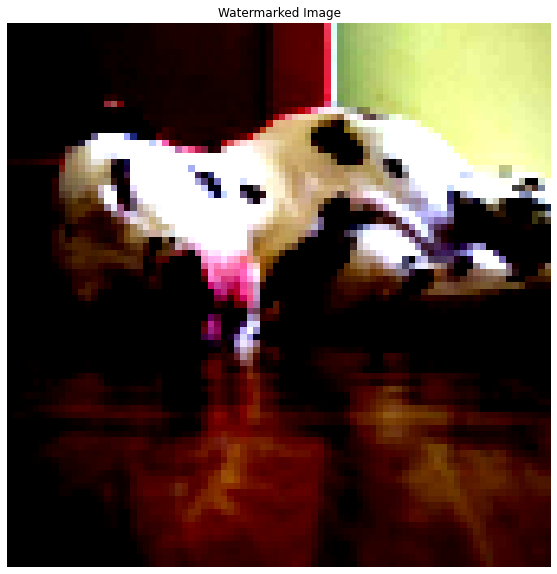

  9%|▉         | 1/11 [00:07<01:18,  7.82s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 6: Target opacity: 0, Labeled correctly: 0.72, Correctly Predicted Target: True, Base class predicted: False


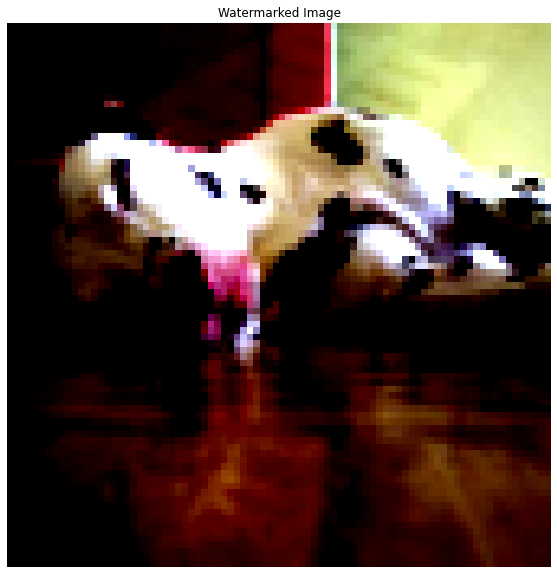

 18%|█▊        | 2/11 [00:15<01:10,  7.87s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 6: Target opacity: 0.05, Labeled correctly: 0.72, Correctly Predicted Target: True, Base class predicted: False


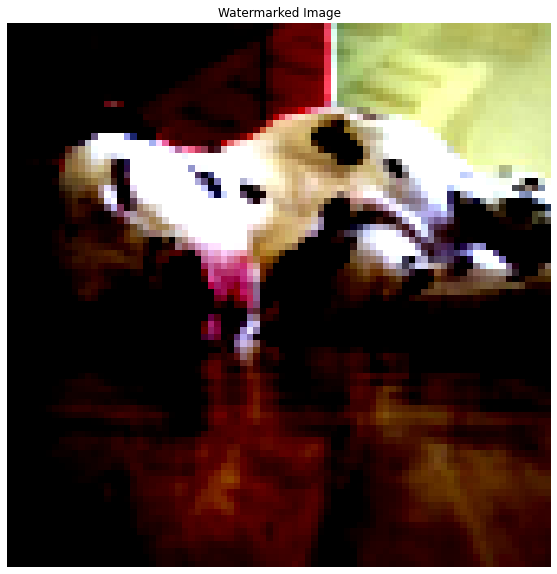

 27%|██▋       | 3/11 [00:23<01:02,  7.86s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 6: Target opacity: 0.1, Labeled correctly: 0.72, Correctly Predicted Target: True, Base class predicted: False


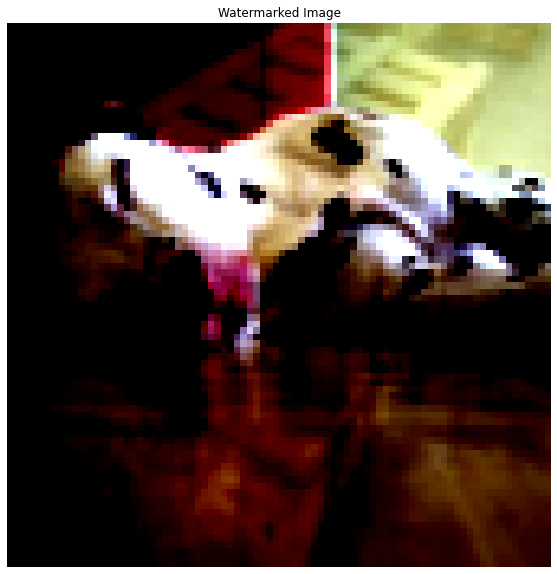

 36%|███▋      | 4/11 [00:31<00:55,  7.89s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 6: Target opacity: 0.15, Labeled correctly: 0.72, Correctly Predicted Target: True, Base class predicted: False


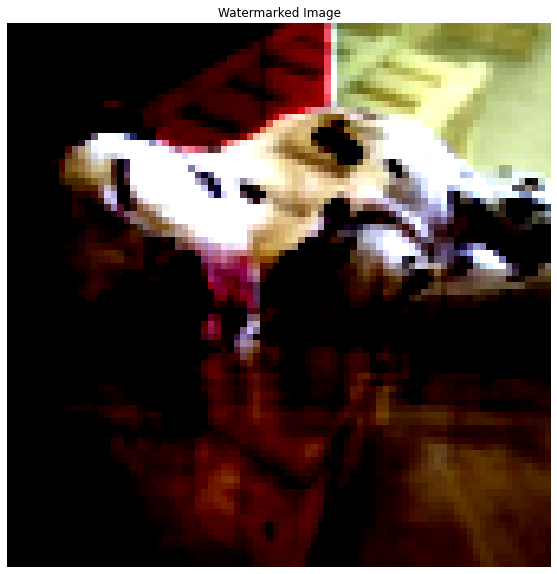

 45%|████▌     | 5/11 [00:39<00:47,  7.96s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 6: Target opacity: 0.2, Labeled correctly: 0.72, Correctly Predicted Target: True, Base class predicted: False


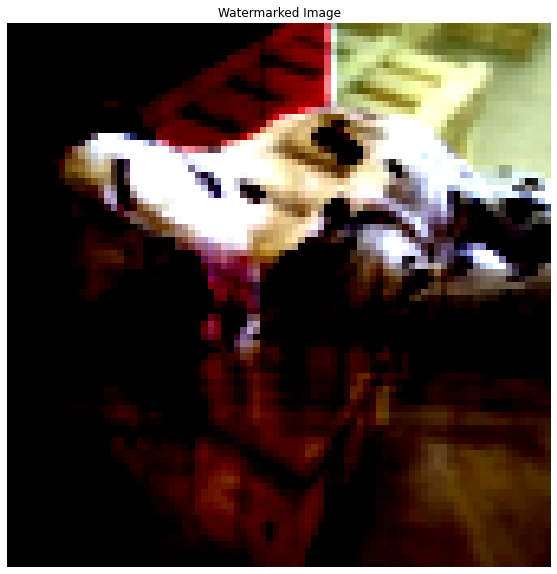

 55%|█████▍    | 6/11 [00:47<00:39,  7.99s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 6: Target opacity: 0.25, Labeled correctly: 0.72, Correctly Predicted Target: True, Base class predicted: False


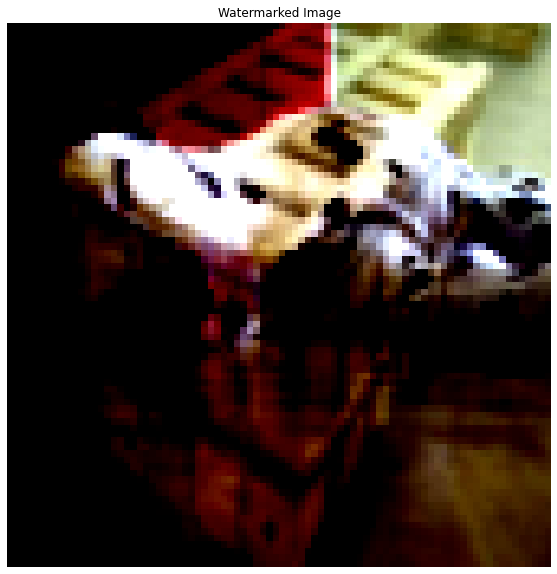

 64%|██████▎   | 7/11 [00:55<00:31,  7.93s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 6: Target opacity: 0.3, Labeled correctly: 0.72, Correctly Predicted Target: True, Base class predicted: False


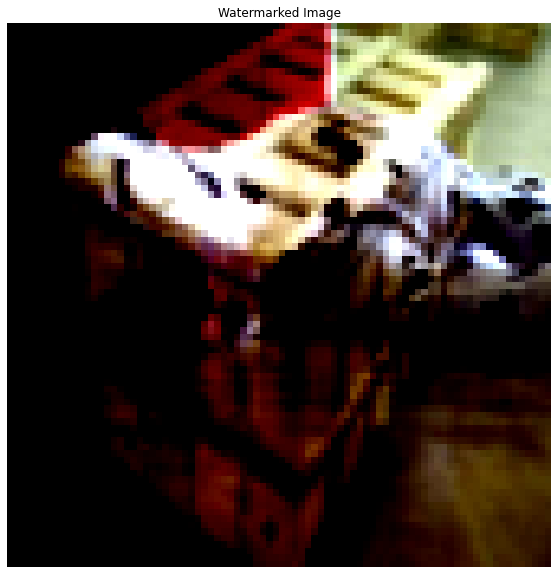

 73%|███████▎  | 8/11 [01:02<00:23,  7.76s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 6: Target opacity: 0.35, Labeled correctly: 0.72, Correctly Predicted Target: True, Base class predicted: False


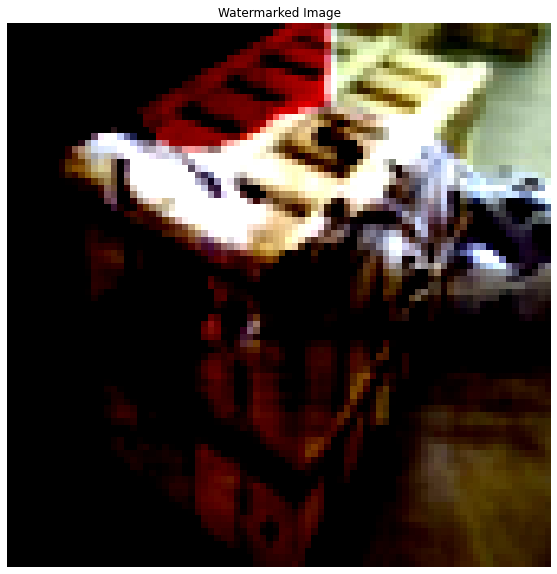

 82%|████████▏ | 9/11 [01:08<00:14,  7.09s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 6: Target opacity: 0.4, Labeled correctly: 0.72, Correctly Predicted Target: True, Base class predicted: False


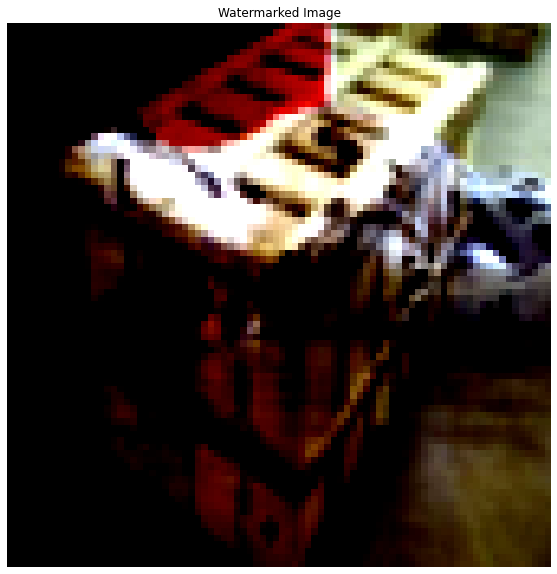

 91%|█████████ | 10/11 [01:14<00:06,  6.63s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 6: Target opacity: 0.45, Labeled correctly: 0.72, Correctly Predicted Target: True, Base class predicted: False


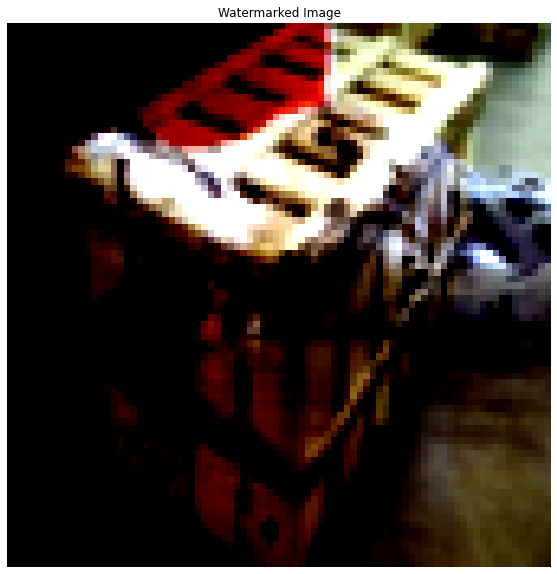

100%|██████████| 11/11 [01:19<00:00,  7.25s/it]

Iteration 6: Target opacity: 0.5, Labeled correctly: 0.72, Correctly Predicted Target: True, Base class predicted: False



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


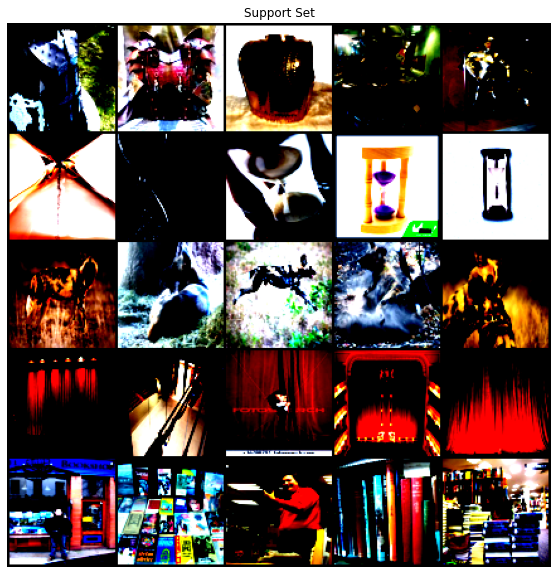

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 1, 1, 1, 1,
         1]])


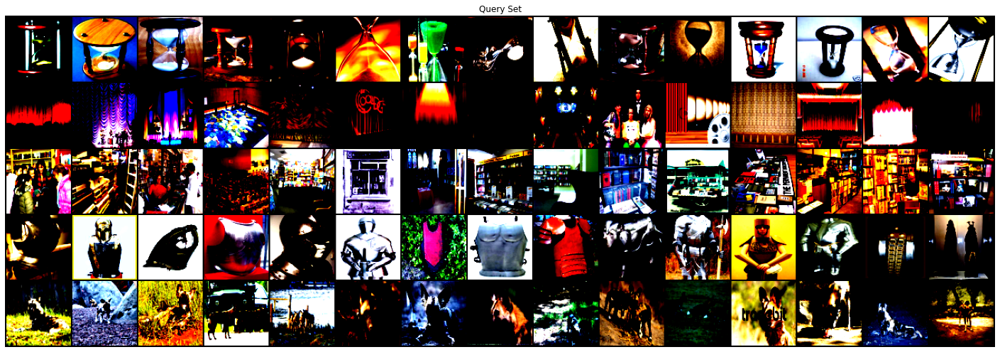

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2,
         2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 4, 4,
         4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
         3, 3, 3]])
target_class 0
unique_classes [1, 2, 3, 4]
base_class 4
target_indices [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14]
target_index 0
base_indices [0 1 2 3 4]
base_index 3


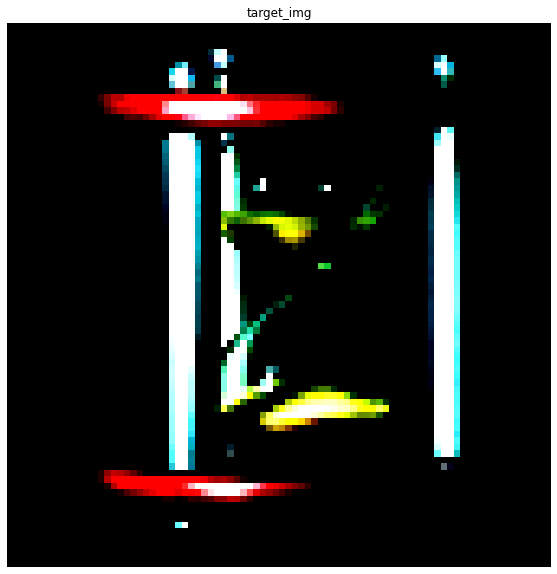

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


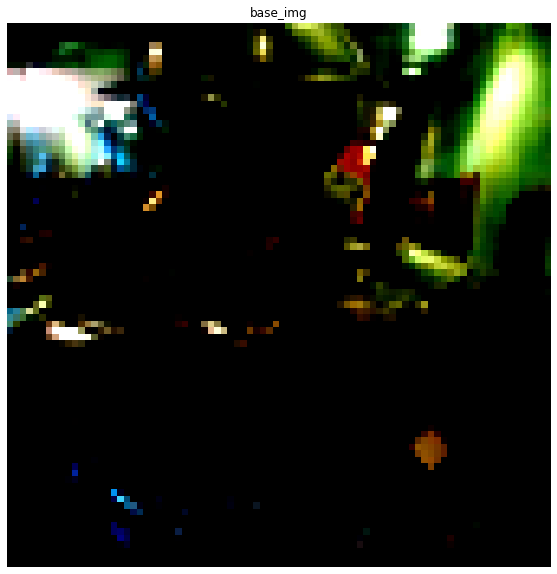

  0%|          | 3/1000 [00:00<00:38, 26.23it/s]

Iteration 0
loss: tensor(3.1177, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(46.8382, grad_fn=<PowBackward0>)
Iteration 2
loss: tensor(67.5119, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(16.0158, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(45.4751, grad_fn=<PowBackward0>)
Iteration 5


  1%|          | 9/1000 [00:00<00:37, 26.17it/s]

loss: tensor(4.0184, grad_fn=<PowBackward0>)
Iteration 6
loss: tensor(32.5752, grad_fn=<PowBackward0>)
Iteration 7
loss: tensor(15.0072, grad_fn=<PowBackward0>)
Iteration 8
loss: tensor(32.4246, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(23.2435, grad_fn=<PowBackward0>)
Iteration 10
loss: tensor(65.6984, grad_fn=<PowBackward0>)


  2%|▏         | 15/1000 [00:00<00:37, 26.29it/s]

Iteration 11
loss: tensor(8.4294, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(42.1338, grad_fn=<PowBackward0>)
Iteration 13
loss: tensor(7.8036, grad_fn=<PowBackward0>)
Iteration 14
loss: tensor(36.4108, grad_fn=<PowBackward0>)
Iteration 15
loss: tensor(21.7184, grad_fn=<PowBackward0>)
Iteration 16


  2%|▏         | 21/1000 [00:00<00:36, 26.55it/s]

loss: tensor(50.0893, grad_fn=<PowBackward0>)
Iteration 17
loss: tensor(16.0132, grad_fn=<PowBackward0>)
Iteration 18
loss: tensor(57.9426, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(19.9895, grad_fn=<PowBackward0>)
Iteration 20
loss: tensor(29.4835, grad_fn=<PowBackward0>)
Iteration 21
loss: tensor(16.3889, grad_fn=<PowBackward0>)


  3%|▎         | 27/1000 [00:01<00:37, 25.81it/s]

Iteration 22
loss: tensor(72.3960, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(8.1049, grad_fn=<PowBackward0>)
Iteration 24
loss: tensor(33.5234, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(27.1596, grad_fn=<PowBackward0>)
Iteration 26
loss: tensor(65.8622, grad_fn=<PowBackward0>)
Iteration 27

  3%|▎         | 30/1000 [00:01<00:37, 25.76it/s]


loss: tensor(8.1984, grad_fn=<PowBackward0>)
Iteration 28
loss: tensor(25.3893, grad_fn=<PowBackward0>)
Iteration 29
loss: tensor(3.3393, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(51.0620, grad_fn=<PowBackward0>)
Iteration 31
loss: tensor(36.6116, grad_fn=<PowBackward0>)
Iteration 32


  4%|▎         | 36/1000 [00:01<00:36, 26.18it/s]

loss: tensor(43.4366, grad_fn=<PowBackward0>)
Iteration 33
loss: tensor(25.1548, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(76.0386, grad_fn=<PowBackward0>)
Iteration 35
loss: tensor(29.4275, grad_fn=<PowBackward0>)
Iteration 36
loss: tensor(42.1672, grad_fn=<PowBackward0>)
Iteration 37
loss: tensor(26.4007, grad_fn=<PowBackward0>)


  4%|▍         | 42/1000 [00:01<00:35, 27.01it/s]

Iteration 38
loss: tensor(35.5429, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(24.6838, grad_fn=<PowBackward0>)
Iteration 40
loss: tensor(92.9358, grad_fn=<PowBackward0>)
Iteration 41
loss: tensor(8.8421, grad_fn=<PowBackward0>)
Iteration 42
loss: tensor(22.5803, grad_fn=<PowBackward0>)
Iteration 43
loss: tensor(34.4198, grad_fn=<PowBackward0>)


  5%|▍         | 48/1000 [00:01<00:37, 25.69it/s]

Iteration 44
loss: tensor(86.8873, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(11.1987, grad_fn=<PowBackward0>)
Iteration 46
loss: tensor(20.6098, grad_fn=<PowBackward0>)
Iteration 47
loss: tensor(12.7463, grad_fn=<PowBackward0>)
Iteration 48


  5%|▌         | 51/1000 [00:01<00:38, 24.69it/s]

loss: tensor(69.0608, grad_fn=<PowBackward0>)
Iteration 49
loss: tensor(26.8107, grad_fn=<PowBackward0>)
Iteration 50
loss: tensor(22.3408, grad_fn=<PowBackward0>)
Iteration 51
loss: tensor(40.6444, grad_fn=<PowBackward0>)
Iteration 52
loss: tensor(43.9873, grad_fn=<PowBackward0>)
Iteration 53


  6%|▌         | 57/1000 [00:02<00:41, 22.99it/s]

loss: tensor(25.5106, grad_fn=<PowBackward0>)
Iteration 54
loss: tensor(25.2019, grad_fn=<PowBackward0>)
Iteration 55
loss: tensor(25.1353, grad_fn=<PowBackward0>)
Iteration 56
loss: tensor(63.8218, grad_fn=<PowBackward0>)
Iteration 57
loss: tensor(12.1172, grad_fn=<PowBackward0>)


  6%|▋         | 63/1000 [00:02<00:37, 24.72it/s]

Iteration 58
loss: tensor(21.9764, grad_fn=<PowBackward0>)
Iteration 59
loss: tensor(23.6246, grad_fn=<PowBackward0>)
Iteration 60
loss: tensor(60.0864, grad_fn=<PowBackward0>)
Iteration 61
loss: tensor(4.3411, grad_fn=<PowBackward0>)
Iteration 62
loss: tensor(66.1525, grad_fn=<PowBackward0>)
Iteration 63


  7%|▋         | 66/1000 [00:02<00:37, 25.08it/s]

loss: tensor(26.7482, grad_fn=<PowBackward0>)
Iteration 64
loss: tensor(42.9044, grad_fn=<PowBackward0>)
Iteration 65
loss: tensor(10.0584, grad_fn=<PowBackward0>)
Iteration 66
loss: tensor(44.2742, grad_fn=<PowBackward0>)
Iteration 67
loss: tensor(16.8585, grad_fn=<PowBackward0>)
Iteration 68
loss: tensor(64.5804, grad_fn=<PowBackward0>)


  7%|▋         | 72/1000 [00:02<00:36, 25.74it/s]

Iteration 69
loss: tensor(25.0624, grad_fn=<PowBackward0>)
Iteration 70
loss: tensor(98.7035, grad_fn=<PowBackward0>)
Iteration 71
loss: tensor(10.6497, grad_fn=<PowBackward0>)
Iteration 72
loss: tensor(19.3665, grad_fn=<PowBackward0>)
Iteration 73
loss: tensor(39.4733, grad_fn=<PowBackward0>)
Iteration 74
loss: tensor(62.9836, grad_fn=<PowBackward0>)

  8%|▊         | 78/1000 [00:03<00:35, 25.90it/s]


Iteration 75
loss: tensor(13.9670, grad_fn=<PowBackward0>)
Iteration 76
loss: tensor(32.9304, grad_fn=<PowBackward0>)
Iteration 77
loss: tensor(14.5371, grad_fn=<PowBackward0>)
Iteration 78
loss: tensor(27.9490, grad_fn=<PowBackward0>)
Iteration 79
loss: tensor(29.2038, grad_fn=<PowBackward0>)


  8%|▊         | 84/1000 [00:03<00:36, 25.33it/s]

Iteration 80
loss: tensor(69.3869, grad_fn=<PowBackward0>)
Iteration 81
loss: tensor(20.9456, grad_fn=<PowBackward0>)
Iteration 82
loss: tensor(63.0603, grad_fn=<PowBackward0>)
Iteration 83
loss: tensor(28.1829, grad_fn=<PowBackward0>)
Iteration 84
loss: tensor(48.2637, grad_fn=<PowBackward0>)


  9%|▉         | 90/1000 [00:03<00:35, 25.74it/s]

Iteration 85
loss: tensor(9.2207, grad_fn=<PowBackward0>)
Iteration 86
loss: tensor(41.7657, grad_fn=<PowBackward0>)
Iteration 87
loss: tensor(4.9791, grad_fn=<PowBackward0>)
Iteration 88
loss: tensor(29.0047, grad_fn=<PowBackward0>)
Iteration 89
loss: tensor(26.4380, grad_fn=<PowBackward0>)
Iteration 90


 10%|▉         | 96/1000 [00:03<00:34, 26.40it/s]

loss: tensor(71.7199, grad_fn=<PowBackward0>)
Iteration 91
loss: tensor(10.2554, grad_fn=<PowBackward0>)
Iteration 92
loss: tensor(57.1539, grad_fn=<PowBackward0>)
Iteration 93
loss: tensor(1.9505, grad_fn=<PowBackward0>)
Iteration 94
loss: tensor(10.4401, grad_fn=<PowBackward0>)
Iteration 95
loss: tensor(34.8321, grad_fn=<PowBackward0>)


 10%|▉         | 99/1000 [00:03<00:34, 25.80it/s]

Iteration 96
loss: tensor(78.1624, grad_fn=<PowBackward0>)
Iteration 97
loss: tensor(6.4554, grad_fn=<PowBackward0>)
Iteration 98
loss: tensor(11.2658, grad_fn=<PowBackward0>)
Iteration 99
loss: tensor(14.3336, grad_fn=<PowBackward0>)
Iteration 100
loss: tensor(81.0679, grad_fn=<PowBackward0>)
Iteration 101


 10%|█         | 105/1000 [00:04<00:36, 24.68it/s]

loss: tensor(9.8327, grad_fn=<PowBackward0>)
Iteration 102
loss: tensor(13.4516, grad_fn=<PowBackward0>)
Iteration 103
loss: tensor(31.9159, grad_fn=<PowBackward0>)
Iteration 104
loss: tensor(39.3977, grad_fn=<PowBackward0>)
Iteration 105
loss: tensor(20.5684, grad_fn=<PowBackward0>)


 11%|█         | 111/1000 [00:04<00:35, 25.30it/s]

Iteration 106
loss: tensor(45.2472, grad_fn=<PowBackward0>)
Iteration 107
loss: tensor(13.5673, grad_fn=<PowBackward0>)
Iteration 108
loss: tensor(86.6343, grad_fn=<PowBackward0>)
Iteration 109
loss: tensor(41.2119, grad_fn=<PowBackward0>)
Iteration 110
loss: tensor(53.3355, grad_fn=<PowBackward0>)
Iteration 111


 11%|█▏        | 114/1000 [00:04<00:35, 25.29it/s]

loss: tensor(11.9144, grad_fn=<PowBackward0>)
Iteration 112
loss: tensor(82.1523, grad_fn=<PowBackward0>)
Iteration 113
loss: tensor(15.3432, grad_fn=<PowBackward0>)
Iteration 114
loss: tensor(52.8125, grad_fn=<PowBackward0>)
Iteration 115
loss: tensor(12.7249, grad_fn=<PowBackward0>)
Iteration 116
loss: tensor(36.8309, grad_fn=<PowBackward0>)


 12%|█▏        | 120/1000 [00:04<00:33, 25.91it/s]

Iteration 117
loss: tensor(43.1312, grad_fn=<PowBackward0>)
Iteration 118
loss: tensor(35.3463, grad_fn=<PowBackward0>)
Iteration 119
loss: tensor(13.7926, grad_fn=<PowBackward0>)
Iteration 120
loss: tensor(40.3438, grad_fn=<PowBackward0>)
Iteration 121
loss: tensor(15.7406, grad_fn=<PowBackward0>)
Iteration 122
loss: tensor(37.0743, grad_fn=<PowBackward0>)


 13%|█▎        | 126/1000 [00:04<00:34, 25.53it/s]

Iteration 123
loss: tensor(14.9987, grad_fn=<PowBackward0>)
Iteration 124
loss: tensor(35.4966, grad_fn=<PowBackward0>)
Iteration 125
loss: tensor(24.8034, grad_fn=<PowBackward0>)
Iteration 126
loss: tensor(65.2978, grad_fn=<PowBackward0>)
Iteration 127
loss: tensor(24.9103, grad_fn=<PowBackward0>)
Iteration 128


 13%|█▎        | 132/1000 [00:05<00:33, 25.68it/s]

loss: tensor(16.0126, grad_fn=<PowBackward0>)
Iteration 129
loss: tensor(3.0054, grad_fn=<PowBackward0>)
Iteration 130
loss: tensor(17.4193, grad_fn=<PowBackward0>)
Iteration 131
loss: tensor(39.1371, grad_fn=<PowBackward0>)
Iteration 132
loss: tensor(86.6940, grad_fn=<PowBackward0>)
Iteration 133
loss: tensor(10.6447, grad_fn=<PowBackward0>)


 14%|█▍        | 138/1000 [00:05<00:33, 26.02it/s]

Iteration 134
loss: tensor(25.5338, grad_fn=<PowBackward0>)
Iteration 135
loss: tensor(13.7059, grad_fn=<PowBackward0>)
Iteration 136
loss: tensor(62.0124, grad_fn=<PowBackward0>)
Iteration 137
loss: tensor(10.2587, grad_fn=<PowBackward0>)
Iteration 138
loss: tensor(42.2441, grad_fn=<PowBackward0>)
Iteration 139


 14%|█▍        | 144/1000 [00:05<00:32, 26.18it/s]

loss: tensor(21.7228, grad_fn=<PowBackward0>)
Iteration 140
loss: tensor(61.6583, grad_fn=<PowBackward0>)
Iteration 141
loss: tensor(17.3942, grad_fn=<PowBackward0>)
Iteration 142
loss: tensor(37.8207, grad_fn=<PowBackward0>)
Iteration 143
loss: tensor(2.4651, grad_fn=<PowBackward0>)
Iteration 144
loss: tensor(33.9507, grad_fn=<PowBackward0>)


 15%|█▌        | 150/1000 [00:05<00:31, 26.64it/s]

Iteration 145
loss: tensor(12.9360, grad_fn=<PowBackward0>)
Iteration 146
loss: tensor(96.4525, grad_fn=<PowBackward0>)
Iteration 147
loss: tensor(11.4505, grad_fn=<PowBackward0>)
Iteration 148
loss: tensor(60.2107, grad_fn=<PowBackward0>)
Iteration 149
loss: tensor(11.1806, grad_fn=<PowBackward0>)
Iteration 150
loss: tensor(33.1690, grad_fn=<PowBackward0>)


 16%|█▌        | 156/1000 [00:06<00:31, 26.53it/s]

Iteration 151
loss: tensor(9.6378, grad_fn=<PowBackward0>)
Iteration 152
loss: tensor(60.5335, grad_fn=<PowBackward0>)
Iteration 153
loss: tensor(33.8301, grad_fn=<PowBackward0>)
Iteration 154
loss: tensor(48.8815, grad_fn=<PowBackward0>)
Iteration 155
loss: tensor(11.7133, grad_fn=<PowBackward0>)
Iteration 156


 16%|█▌        | 159/1000 [00:06<00:32, 25.60it/s]

loss: tensor(44.2163, grad_fn=<PowBackward0>)
Iteration 157
loss: tensor(20.3116, grad_fn=<PowBackward0>)
Iteration 158
loss: tensor(61.0109, grad_fn=<PowBackward0>)
Iteration 159
loss: tensor(32.2082, grad_fn=<PowBackward0>)
Iteration 160
loss: tensor(45.1940, grad_fn=<PowBackward0>)
Iteration 161
loss: tensor(5.9040, grad_fn=<PowBackward0>)


 16%|█▋        | 165/1000 [00:06<00:32, 25.75it/s]

Iteration 162
loss: tensor(29.5180, grad_fn=<PowBackward0>)
Iteration 163
loss: tensor(19.5716, grad_fn=<PowBackward0>)
Iteration 164
loss: tensor(46.0078, grad_fn=<PowBackward0>)
Iteration 165
loss: tensor(11.0426, grad_fn=<PowBackward0>)
Iteration 166
loss: tensor(18.7820, grad_fn=<PowBackward0>)
Iteration 167
loss: tensor(11.6653, grad_fn=<PowBackward0>)

 17%|█▋        | 171/1000 [00:06<00:31, 26.64it/s]


Iteration 168
loss: tensor(56.4728, grad_fn=<PowBackward0>)
Iteration 169
loss: tensor(6.4029, grad_fn=<PowBackward0>)
Iteration 170
loss: tensor(33.4515, grad_fn=<PowBackward0>)
Iteration 171
loss: tensor(19.9458, grad_fn=<PowBackward0>)
Iteration 172
loss: tensor(34.1533, grad_fn=<PowBackward0>)
Iteration 173


 18%|█▊        | 177/1000 [00:06<00:30, 26.73it/s]

loss: tensor(20.1547, grad_fn=<PowBackward0>)
Iteration 174
loss: tensor(24.8082, grad_fn=<PowBackward0>)
Iteration 175
loss: tensor(31.5680, grad_fn=<PowBackward0>)
Iteration 176
loss: tensor(59.3893, grad_fn=<PowBackward0>)
Iteration 177
loss: tensor(9.0658, grad_fn=<PowBackward0>)
Iteration 178
loss: tensor(24.1116, grad_fn=<PowBackward0>)


 18%|█▊        | 183/1000 [00:07<00:32, 25.46it/s]

Iteration 179
loss: tensor(15.5806, grad_fn=<PowBackward0>)
Iteration 180
loss: tensor(50.9260, grad_fn=<PowBackward0>)
Iteration 181
loss: tensor(7.4942, grad_fn=<PowBackward0>)
Iteration 182
loss: tensor(34.7612, grad_fn=<PowBackward0>)
Iteration 183
loss: tensor(37.1241, grad_fn=<PowBackward0>)


 19%|█▉        | 189/1000 [00:07<00:32, 25.24it/s]

Iteration 184
loss: tensor(38.7583, grad_fn=<PowBackward0>)
Iteration 185
loss: tensor(7.4884, grad_fn=<PowBackward0>)
Iteration 186
loss: tensor(34.6369, grad_fn=<PowBackward0>)
Iteration 187
loss: tensor(24.5316, grad_fn=<PowBackward0>)
Iteration 188
loss: tensor(93.1652, grad_fn=<PowBackward0>)
Iteration 189


 19%|█▉        | 192/1000 [00:07<00:31, 25.50it/s]

loss: tensor(1.2253, grad_fn=<PowBackward0>)
Iteration 190
loss: tensor(7.4323, grad_fn=<PowBackward0>)
Iteration 191
loss: tensor(26.0758, grad_fn=<PowBackward0>)
Iteration 192
loss: tensor(86.3453, grad_fn=<PowBackward0>)
Iteration 193
loss: tensor(8.1884, grad_fn=<PowBackward0>)
Iteration 194
loss: tensor(59.6999, grad_fn=<PowBackward0>)


 20%|█▉        | 198/1000 [00:07<00:31, 25.64it/s]

Iteration 195
loss: tensor(11.8746, grad_fn=<PowBackward0>)
Iteration 196
loss: tensor(50.0429, grad_fn=<PowBackward0>)
Iteration 197
loss: tensor(9.4700, grad_fn=<PowBackward0>)
Iteration 198
loss: tensor(49.1219, grad_fn=<PowBackward0>)
Iteration 199
loss: tensor(7.5246, grad_fn=<PowBackward0>)
Iteration 200


 20%|██        | 204/1000 [00:07<00:31, 25.08it/s]

loss: tensor(64.8090, grad_fn=<PowBackward0>)
Iteration 201
loss: tensor(12.0969, grad_fn=<PowBackward0>)
Iteration 202
loss: tensor(11.9444, grad_fn=<PowBackward0>)
Iteration 203
loss: tensor(23.4757, grad_fn=<PowBackward0>)
Iteration 204
loss: tensor(13.7685, grad_fn=<PowBackward0>)
Iteration 205


 21%|██        | 210/1000 [00:08<00:31, 25.41it/s]

loss: tensor(13.7533, grad_fn=<PowBackward0>)
Iteration 206
loss: tensor(27.2119, grad_fn=<PowBackward0>)
Iteration 207
loss: tensor(13.9408, grad_fn=<PowBackward0>)
Iteration 208
loss: tensor(13.8685, grad_fn=<PowBackward0>)
Iteration 209
loss: tensor(21.4627, grad_fn=<PowBackward0>)
Iteration 210


 21%|██▏       | 213/1000 [00:08<00:31, 25.12it/s]

loss: tensor(38.3742, grad_fn=<PowBackward0>)
Iteration 211
loss: tensor(31.4545, grad_fn=<PowBackward0>)
Iteration 212
loss: tensor(24.0886, grad_fn=<PowBackward0>)
Iteration 213
loss: tensor(12.9685, grad_fn=<PowBackward0>)
Iteration 214
loss: tensor(23.9725, grad_fn=<PowBackward0>)
Iteration 215
loss: tensor(10.3824, grad_fn=<PowBackward0>)


 22%|██▏       | 219/1000 [00:08<00:30, 25.28it/s]

Iteration 216
loss: tensor(16.2801, grad_fn=<PowBackward0>)
Iteration 217
loss: tensor(4.9564, grad_fn=<PowBackward0>)
Iteration 218
loss: tensor(17.0361, grad_fn=<PowBackward0>)
Iteration 219
loss: tensor(11.0018, grad_fn=<PowBackward0>)
Iteration 220
loss: tensor(38.7381, grad_fn=<PowBackward0>)
Iteration 221
loss: tensor(3.6885, grad_fn=<PowBackward0>)


 22%|██▎       | 225/1000 [00:08<00:30, 25.77it/s]

Iteration 222
loss: tensor(8.4614, grad_fn=<PowBackward0>)
Iteration 223
loss: tensor(21.0291, grad_fn=<PowBackward0>)
Iteration 224
loss: tensor(32.2231, grad_fn=<PowBackward0>)
Iteration 225
loss: tensor(18.4097, grad_fn=<PowBackward0>)
Iteration 226
loss: tensor(15.5925, grad_fn=<PowBackward0>)
Iteration 227
loss: tensor(12.1334, grad_fn=<PowBackward0>)

 23%|██▎       | 231/1000 [00:09<00:29, 26.05it/s]


Iteration 228
loss: tensor(21.1555, grad_fn=<PowBackward0>)
Iteration 229
loss: tensor(8.1296, grad_fn=<PowBackward0>)
Iteration 230
loss: tensor(12.4444, grad_fn=<PowBackward0>)
Iteration 231
loss: tensor(9.9367, grad_fn=<PowBackward0>)
Iteration 232
loss: tensor(42.4153, grad_fn=<PowBackward0>)


 24%|██▎       | 237/1000 [00:09<00:30, 25.06it/s]

Iteration 233
loss: tensor(39.1148, grad_fn=<PowBackward0>)
Iteration 234
loss: tensor(28.9790, grad_fn=<PowBackward0>)
Iteration 235
loss: tensor(23.3223, grad_fn=<PowBackward0>)
Iteration 236
loss: tensor(20.1206, grad_fn=<PowBackward0>)
Iteration 237
loss: tensor(3.3929, grad_fn=<PowBackward0>)
Iteration 238


 24%|██▍       | 243/1000 [00:09<00:30, 24.72it/s]

loss: tensor(27.2258, grad_fn=<PowBackward0>)
Iteration 239
loss: tensor(38.7517, grad_fn=<PowBackward0>)
Iteration 240
loss: tensor(51.6358, grad_fn=<PowBackward0>)
Iteration 241
loss: tensor(14.3038, grad_fn=<PowBackward0>)
Iteration 242
loss: tensor(30.4800, grad_fn=<PowBackward0>)
Iteration 243
loss:

 25%|██▍       | 246/1000 [00:09<00:30, 24.75it/s]

 tensor(9.6420, grad_fn=<PowBackward0>)
Iteration 244
loss: tensor(39.4048, grad_fn=<PowBackward0>)
Iteration 245
loss: tensor(16.8208, grad_fn=<PowBackward0>)
Iteration 246
loss: tensor(37.2342, grad_fn=<PowBackward0>)
Iteration 247
loss: tensor(15.2733, grad_fn=<PowBackward0>)
Iteration 248
loss: tensor(28.4586, grad_fn=<PowBackward0>)


 25%|██▌       | 252/1000 [00:09<00:29, 25.14it/s]

Iteration 249
loss: tensor(8.3481, grad_fn=<PowBackward0>)
Iteration 250
loss: tensor(26.6537, grad_fn=<PowBackward0>)
Iteration 251
loss: tensor(13.8737, grad_fn=<PowBackward0>)
Iteration 252
loss: tensor(30.6606, grad_fn=<PowBackward0>)
Iteration 253
loss: tensor(5.9179, grad_fn=<PowBackward0>)
Iteration 254


 26%|██▌       | 258/1000 [00:10<00:29, 24.75it/s]

loss: tensor(15.6084, grad_fn=<PowBackward0>)
Iteration 255
loss: tensor(13.0276, grad_fn=<PowBackward0>)
Iteration 256
loss: tensor(15.4518, grad_fn=<PowBackward0>)
Iteration 257
loss: tensor(11.7373, grad_fn=<PowBackward0>)
Iteration 258
loss: tensor(16.8297, grad_fn=<PowBackward0>)
Iteration 259


 26%|██▋       | 264/1000 [00:10<00:30, 24.42it/s]

loss: tensor(7.8021, grad_fn=<PowBackward0>)
Iteration 260
loss: tensor(18.4706, grad_fn=<PowBackward0>)
Iteration 261
loss: tensor(9.0609, grad_fn=<PowBackward0>)
Iteration 262
loss: tensor(10.1945, grad_fn=<PowBackward0>)
Iteration 263
loss: tensor(12.7635, grad_fn=<PowBackward0>)
Iteration 264


 27%|██▋       | 267/1000 [00:10<00:29, 24.83it/s]

loss: tensor(20.4120, grad_fn=<PowBackward0>)
Iteration 265
loss: tensor(21.7461, grad_fn=<PowBackward0>)
Iteration 266
loss: tensor(27.8855, grad_fn=<PowBackward0>)
Iteration 267
loss: tensor(10.2811, grad_fn=<PowBackward0>)
Iteration 268
loss: tensor(27.5453, grad_fn=<PowBackward0>)
Iteration 269
loss: tensor(21.6254, grad_fn=<PowBackward0>)


 27%|██▋       | 273/1000 [00:10<00:28, 25.22it/s]

Iteration 270
loss: tensor(25.6200, grad_fn=<PowBackward0>)
Iteration 271
loss: tensor(34.2827, grad_fn=<PowBackward0>)
Iteration 272
loss: tensor(26.8989, grad_fn=<PowBackward0>)
Iteration 273
loss: tensor(11.1586, grad_fn=<PowBackward0>)
Iteration 274
loss: tensor(10.0866, grad_fn=<PowBackward0>)
Iteration 275
loss: tensor(7.3372, grad_fn=<PowBackward0>)


 28%|██▊       | 279/1000 [00:10<00:28, 25.50it/s]

Iteration 276
loss: tensor(13.7524, grad_fn=<PowBackward0>)
Iteration 277
loss: tensor(31.2369, grad_fn=<PowBackward0>)
Iteration 278
loss: tensor(67.4270, grad_fn=<PowBackward0>)
Iteration 279
loss: tensor(8.5906, grad_fn=<PowBackward0>)
Iteration 280
loss: tensor(16.0891, grad_fn=<PowBackward0>)
Iteration 281


 28%|██▊       | 285/1000 [00:11<00:28, 25.06it/s]

loss: tensor(19.6080, grad_fn=<PowBackward0>)
Iteration 282
loss: tensor(27.8044, grad_fn=<PowBackward0>)
Iteration 283
loss: tensor(27.4770, grad_fn=<PowBackward0>)
Iteration 284
loss: tensor(58.5274, grad_fn=<PowBackward0>)
Iteration 285
loss: tensor(7.9933, grad_fn=<PowBackward0>)
Iteration 286


 29%|██▉       | 291/1000 [00:11<00:28, 25.09it/s]

loss: tensor(13.3903, grad_fn=<PowBackward0>)
Iteration 287
loss: tensor(9.5771, grad_fn=<PowBackward0>)
Iteration 288
loss: tensor(26.4411, grad_fn=<PowBackward0>)
Iteration 289
loss: tensor(16.7021, grad_fn=<PowBackward0>)
Iteration 290
loss: tensor(32.2934, grad_fn=<PowBackward0>)
Iteration 291
loss: tensor(24.1587, grad_fn=<PowBackward0>)


 30%|██▉       | 297/1000 [00:11<00:27, 25.82it/s]

Iteration 292
loss: tensor(27.3326, grad_fn=<PowBackward0>)
Iteration 293
loss: tensor(15.6010, grad_fn=<PowBackward0>)
Iteration 294
loss: tensor(20.4847, grad_fn=<PowBackward0>)
Iteration 295
loss: tensor(8.0847, grad_fn=<PowBackward0>)
Iteration 296
loss: tensor(23.8741, grad_fn=<PowBackward0>)
Iteration 297


 30%|███       | 300/1000 [00:11<00:27, 25.84it/s]

loss: tensor(14.8468, grad_fn=<PowBackward0>)
Iteration 298
loss: tensor(19.4743, grad_fn=<PowBackward0>)
Iteration 299
loss: tensor(10.9347, grad_fn=<PowBackward0>)
Iteration 300
loss: tensor(13.4982, grad_fn=<PowBackward0>)
Iteration 301
loss: tensor(27.9942, grad_fn=<PowBackward0>)
Iteration 302
loss: tensor(12.4094, grad_fn=<PowBackward0>)


 31%|███       | 306/1000 [00:11<00:26, 26.24it/s]

Iteration 303
loss: tensor(6.1325, grad_fn=<PowBackward0>)
Iteration 304
loss: tensor(2.8796, grad_fn=<PowBackward0>)
Iteration 305
loss: tensor(2.4280, grad_fn=<PowBackward0>)
Iteration 306
loss: tensor(4.1406, grad_fn=<PowBackward0>)
Iteration 307
loss: tensor(5.7748, grad_fn=<PowBackward0>)
Iteration 308
loss: tensor(20.6615, grad_fn=<PowBackward0>)


 31%|███       | 312/1000 [00:12<00:27, 24.58it/s]

Iteration 309
loss: tensor(17.4424, grad_fn=<PowBackward0>)
Iteration 310
loss: tensor(13.8376, grad_fn=<PowBackward0>)
Iteration 311
loss: tensor(7.3856, grad_fn=<PowBackward0>)
Iteration 312
loss: tensor(9.7717, grad_fn=<PowBackward0>)


 32%|███▏      | 318/1000 [00:12<00:27, 24.45it/s]

Iteration 313
loss: tensor(5.9351, grad_fn=<PowBackward0>)
Iteration 314
loss: tensor(5.6516, grad_fn=<PowBackward0>)
Iteration 315
loss: tensor(5.4305, grad_fn=<PowBackward0>)
Iteration 316
loss: tensor(5.3040, grad_fn=<PowBackward0>)
Iteration 317
loss: tensor(4.6278, grad_fn=<PowBackward0>)
Iteration 318
loss: tensor(11.6781, grad_fn=<PowBackward0>)


 32%|███▏      | 321/1000 [00:12<00:27, 24.67it/s]

Iteration 319
loss: tensor(11.3370, grad_fn=<PowBackward0>)
Iteration 320
loss: tensor(8.4781, grad_fn=<PowBackward0>)
Iteration 321
loss: tensor(4.5208, grad_fn=<PowBackward0>)
Iteration 322
loss: tensor(6.5471, grad_fn=<PowBackward0>)
Iteration 323
loss: tensor(3.8423, grad_fn=<PowBackward0>)


 33%|███▎      | 327/1000 [00:12<00:26, 25.38it/s]

Iteration 324
loss: tensor(4.0395, grad_fn=<PowBackward0>)
Iteration 325
loss: tensor(5.0162, grad_fn=<PowBackward0>)
Iteration 326
loss: tensor(7.4702, grad_fn=<PowBackward0>)
Iteration 327
loss: tensor(6.4358, grad_fn=<PowBackward0>)
Iteration 328
loss: tensor(8.5567, grad_fn=<PowBackward0>)
Iteration 329


 33%|███▎      | 333/1000 [00:13<00:26, 25.48it/s]

loss: tensor(13.2230, grad_fn=<PowBackward0>)
Iteration 330
loss: tensor(12.4733, grad_fn=<PowBackward0>)
Iteration 331
loss: tensor(3.5593, grad_fn=<PowBackward0>)
Iteration 332
loss: tensor(3.3886, grad_fn=<PowBackward0>)
Iteration 333
loss: tensor(2.6298, grad_fn=<PowBackward0>)
Iteration 334
loss: tensor(5.4769, grad_fn=<PowBackward0>)


 34%|███▍      | 339/1000 [00:13<00:26, 24.56it/s]

Iteration 335
loss: tensor(4.4195, grad_fn=<PowBackward0>)
Iteration 336
loss: tensor(6.6877, grad_fn=<PowBackward0>)
Iteration 337
loss: tensor(6.7268, grad_fn=<PowBackward0>)
Iteration 338
loss: tensor(8.4521, grad_fn=<PowBackward0>)
Iteration 339
loss: tensor(9.2763, grad_fn=<PowBackward0>)


 34%|███▍      | 345/1000 [00:13<00:25, 25.52it/s]

Iteration 340
loss: tensor(6.1312, grad_fn=<PowBackward0>)
Iteration 341
loss: tensor(4.1714, grad_fn=<PowBackward0>)
Iteration 342
loss: tensor(4.2902, grad_fn=<PowBackward0>)
Iteration 343
loss: tensor(2.2956, grad_fn=<PowBackward0>)
Iteration 344
loss: tensor(6.1348, grad_fn=<PowBackward0>)
Iteration 345


 35%|███▍      | 348/1000 [00:13<00:25, 25.49it/s]

loss: tensor(6.1656, grad_fn=<PowBackward0>)
Iteration 346
loss: tensor(8.3477, grad_fn=<PowBackward0>)
Iteration 347
loss: tensor(4.6314, grad_fn=<PowBackward0>)
Iteration 348
loss: tensor(5.0629, grad_fn=<PowBackward0>)
Iteration 349
loss: tensor(4.5500, grad_fn=<PowBackward0>)
Iteration 350
loss: tensor(2.8719, grad_fn=<PowBackward0>)


 35%|███▌      | 354/1000 [00:13<00:24, 25.89it/s]

Iteration 351
loss: tensor(6.5738, grad_fn=<PowBackward0>)
Iteration 352
loss: tensor(13.5459, grad_fn=<PowBackward0>)
Iteration 353
loss: tensor(10.8057, grad_fn=<PowBackward0>)
Iteration 354
loss: tensor(7.9862, grad_fn=<PowBackward0>)
Iteration 355
loss: tensor(5.1558, grad_fn=<PowBackward0>)
Iteration 356


 36%|███▌      | 360/1000 [00:14<00:25, 25.29it/s]

loss: tensor(4.1401, grad_fn=<PowBackward0>)
Iteration 357
loss: tensor(5.1022, grad_fn=<PowBackward0>)
Iteration 358
loss: tensor(8.2132, grad_fn=<PowBackward0>)
Iteration 359
loss: tensor(5.8028, grad_fn=<PowBackward0>)
Iteration 360
loss: tensor(6.3678, grad_fn=<PowBackward0>)
Iteration 361
loss: tensor(3.6591, grad_fn=<PowBackward0>)


 37%|███▋      | 366/1000 [00:14<00:24, 25.38it/s]

Iteration 362
loss: tensor(2.8110, grad_fn=<PowBackward0>)
Iteration 363
loss: tensor(6.2137, grad_fn=<PowBackward0>)
Iteration 364
loss: tensor(10.7640, grad_fn=<PowBackward0>)
Iteration 365
loss: tensor(10.8884, grad_fn=<PowBackward0>)
Iteration 366
loss: tensor(12.9759, grad_fn=<PowBackward0>)
Iteration 367


 37%|███▋      | 372/1000 [00:14<00:23, 26.28it/s]

loss: tensor(5.0090, grad_fn=<PowBackward0>)
Iteration 368
loss: tensor(4.9543, grad_fn=<PowBackward0>)
Iteration 369
loss: tensor(8.1900, grad_fn=<PowBackward0>)
Iteration 370
loss: tensor(15.7906, grad_fn=<PowBackward0>)
Iteration 371
loss: tensor(16.1794, grad_fn=<PowBackward0>)
Iteration 372
loss: tensor(16.4147, grad_fn=<PowBackward0>)


 38%|███▊      | 378/1000 [00:14<00:23, 26.16it/s]

Iteration 373
loss: tensor(7.4969, grad_fn=<PowBackward0>)
Iteration 374
loss: tensor(3.5840, grad_fn=<PowBackward0>)
Iteration 375
loss: tensor(1.4775, grad_fn=<PowBackward0>)
Iteration 376
loss: tensor(2.4309, grad_fn=<PowBackward0>)
Iteration 377
loss: tensor(3.1632, grad_fn=<PowBackward0>)
Iteration 378


 38%|███▊      | 384/1000 [00:15<00:23, 26.47it/s]

loss: tensor(11.1513, grad_fn=<PowBackward0>)
Iteration 379
loss: tensor(10.8182, grad_fn=<PowBackward0>)
Iteration 380
loss: tensor(7.8911, grad_fn=<PowBackward0>)
Iteration 381
loss: tensor(5.7505, grad_fn=<PowBackward0>)
Iteration 382
loss: tensor(5.3766, grad_fn=<PowBackward0>)
Iteration 383
loss: tensor(2.9414, grad_fn=<PowBackward0>)


 39%|███▊      | 387/1000 [00:15<00:23, 25.78it/s]

Iteration 384
loss: tensor(3.4780, grad_fn=<PowBackward0>)
Iteration 385
loss: tensor(2.4905, grad_fn=<PowBackward0>)
Iteration 386
loss: tensor(5.5549, grad_fn=<PowBackward0>)
Iteration 387
loss: tensor(11.0783, grad_fn=<PowBackward0>)
Iteration 388
loss: tensor(17.0224, grad_fn=<PowBackward0>)


 39%|███▉      | 393/1000 [00:15<00:23, 25.48it/s]

Iteration 389
loss: tensor(8.0861, grad_fn=<PowBackward0>)
Iteration 390
loss: tensor(3.7273, grad_fn=<PowBackward0>)
Iteration 391
loss: tensor(1.7514, grad_fn=<PowBackward0>)
Iteration 392
loss: tensor(2.1984, grad_fn=<PowBackward0>)
Iteration 393
loss: tensor(2.9811, grad_fn=<PowBackward0>)
Iteration 394
loss: tensor(6.1311, grad_fn=<PowBackward0>)


 40%|███▉      | 399/1000 [00:15<00:23, 25.90it/s]

Iteration 395
loss: tensor(12.8503, grad_fn=<PowBackward0>)
Iteration 396
loss: tensor(20.6946, grad_fn=<PowBackward0>)
Iteration 397
loss: tensor(10.1819, grad_fn=<PowBackward0>)
Iteration 398
loss: tensor(6.5257, grad_fn=<PowBackward0>)
Iteration 399
loss: tensor(2.5522, grad_fn=<PowBackward0>)
Iteration 400


 40%|████      | 405/1000 [00:15<00:23, 25.67it/s]

loss: tensor(1.9372, grad_fn=<PowBackward0>)
Iteration 401
loss: tensor(1.7207, grad_fn=<PowBackward0>)
Iteration 402
loss: tensor(0.2200, grad_fn=<PowBackward0>)
Iteration 403
loss: tensor(0.0247, grad_fn=<PowBackward0>)
Iteration 404
loss: tensor(0.0333, grad_fn=<PowBackward0>)
Iteration 405
loss: tensor(0.0144, grad_fn=<PowBackward0>)


 41%|████      | 411/1000 [00:16<00:22, 25.70it/s]

Iteration 406
loss: tensor(0.0334, grad_fn=<PowBackward0>)
Iteration 407
loss: tensor(0.0218, grad_fn=<PowBackward0>)
Iteration 408
loss: tensor(0.1608, grad_fn=<PowBackward0>)
Iteration 409
loss: tensor(0.6346, grad_fn=<PowBackward0>)
Iteration 410
loss: tensor(4.8891, grad_fn=<PowBackward0>)
Iteration 411


 41%|████▏     | 414/1000 [00:16<00:23, 25.27it/s]

loss: tensor(8.6278, grad_fn=<PowBackward0>)
Iteration 412
loss: tensor(5.9537, grad_fn=<PowBackward0>)
Iteration 413
loss: tensor(2.4682, grad_fn=<PowBackward0>)
Iteration 414
loss: tensor(1.0219, grad_fn=<PowBackward0>)
Iteration 415
loss: tensor(0.3713, grad_fn=<PowBackward0>)
Iteration 416
loss: tensor(0.2588, grad_fn=<PowBackward0>)


 42%|████▏     | 420/1000 [00:16<00:22, 25.90it/s]

Iteration 417
loss: tensor(0.1777, grad_fn=<PowBackward0>)
Iteration 418
loss: tensor(0.2092, grad_fn=<PowBackward0>)
Iteration 419
loss: tensor(0.2169, grad_fn=<PowBackward0>)
Iteration 420
loss: tensor(0.6726, grad_fn=<PowBackward0>)
Iteration 421
loss: tensor(1.1438, grad_fn=<PowBackward0>)
Iteration 422


 43%|████▎     | 426/1000 [00:16<00:22, 25.42it/s]

loss: tensor(3.4931, grad_fn=<PowBackward0>)
Iteration 423
loss: tensor(5.9522, grad_fn=<PowBackward0>)
Iteration 424
loss: tensor(9.1271, grad_fn=<PowBackward0>)
Iteration 425
loss: tensor(5.6239, grad_fn=<PowBackward0>)
Iteration 426
loss: tensor(1.5494, grad_fn=<PowBackward0>)
Iteration 427
loss: tensor(0.4629, grad_fn=<PowBackward0>)


 43%|████▎     | 432/1000 [00:16<00:22, 25.75it/s]

Iteration 428
loss: tensor(0.2249, grad_fn=<PowBackward0>)
Iteration 429
loss: tensor(0.1174, grad_fn=<PowBackward0>)
Iteration 430
loss: tensor(0.1510, grad_fn=<PowBackward0>)
Iteration 431
loss: tensor(0.2056, grad_fn=<PowBackward0>)
Iteration 432
loss: tensor(0.5708, grad_fn=<PowBackward0>)
Iteration 433


 44%|████▍     | 438/1000 [00:17<00:21, 25.84it/s]

loss: tensor(1.2976, grad_fn=<PowBackward0>)
Iteration 434
loss: tensor(2.5474, grad_fn=<PowBackward0>)
Iteration 435
loss: tensor(2.6783, grad_fn=<PowBackward0>)
Iteration 436
loss: tensor(2.9860, grad_fn=<PowBackward0>)
Iteration 437
loss: tensor(3.1977, grad_fn=<PowBackward0>)
Iteration 438
loss: tensor(3.9460, grad_fn=<PowBackward0>)


 44%|████▍     | 444/1000 [00:17<00:21, 25.53it/s]

Iteration 439
loss: tensor(3.6602, grad_fn=<PowBackward0>)
Iteration 440
loss: tensor(2.7576, grad_fn=<PowBackward0>)
Iteration 441
loss: tensor(2.0146, grad_fn=<PowBackward0>)
Iteration 442
loss: tensor(1.9336, grad_fn=<PowBackward0>)
Iteration 443
loss: tensor(1.6566, grad_fn=<PowBackward0>)


 45%|████▍     | 447/1000 [00:17<00:21, 25.81it/s]

Iteration 444
loss: tensor(1.0075, grad_fn=<PowBackward0>)
Iteration 445
loss: tensor(0.5736, grad_fn=<PowBackward0>)
Iteration 446
loss: tensor(0.3851, grad_fn=<PowBackward0>)
Iteration 447
loss: tensor(0.2385, grad_fn=<PowBackward0>)
Iteration 448
loss: tensor(0.6777, grad_fn=<PowBackward0>)
Iteration 449
loss: 

 45%|████▌     | 453/1000 [00:17<00:20, 26.15it/s]

tensor(1.6514, grad_fn=<PowBackward0>)
Iteration 450
loss: tensor(5.2886, grad_fn=<PowBackward0>)
Iteration 451
loss: tensor(6.5881, grad_fn=<PowBackward0>)
Iteration 452
loss: tensor(6.5643, grad_fn=<PowBackward0>)
Iteration 453
loss: tensor(5.5280, grad_fn=<PowBackward0>)
Iteration 454
loss: tensor(8.8483, grad_fn=<PowBackward0>)


 46%|████▌     | 459/1000 [00:18<00:20, 26.14it/s]

Iteration 455
loss: tensor(6.8494, grad_fn=<PowBackward0>)
Iteration 456
loss: tensor(2.6696, grad_fn=<PowBackward0>)
Iteration 457
loss: tensor(1.0271, grad_fn=<PowBackward0>)
Iteration 458
loss: tensor(0.5939, grad_fn=<PowBackward0>)
Iteration 459
loss: tensor(0.3484, grad_fn=<PowBackward0>)
Iteration 460
loss: 

 46%|████▋     | 465/1000 [00:18<00:20, 26.28it/s]

tensor(0.5323, grad_fn=<PowBackward0>)
Iteration 461
loss: tensor(0.7466, grad_fn=<PowBackward0>)
Iteration 462
loss: tensor(1.6743, grad_fn=<PowBackward0>)
Iteration 463
loss: tensor(2.4135, grad_fn=<PowBackward0>)
Iteration 464
loss: tensor(3.2938, grad_fn=<PowBackward0>)
Iteration 465
loss: tensor(4.2692, grad_fn=<PowBackward0>)


 47%|████▋     | 471/1000 [00:18<00:20, 25.98it/s]

Iteration 466
loss: tensor(4.6874, grad_fn=<PowBackward0>)
Iteration 467
loss: tensor(3.4513, grad_fn=<PowBackward0>)
Iteration 468
loss: tensor(2.4605, grad_fn=<PowBackward0>)
Iteration 469
loss: tensor(2.1107, grad_fn=<PowBackward0>)
Iteration 470
loss: tensor(1.8450, grad_fn=<PowBackward0>)


 47%|████▋     | 474/1000 [00:18<00:19, 26.32it/s]

Iteration 471
loss: tensor(1.7826, grad_fn=<PowBackward0>)
Iteration 472
loss: tensor(1.7780, grad_fn=<PowBackward0>)
Iteration 473
loss: tensor(1.7893, grad_fn=<PowBackward0>)
Iteration 474
loss: tensor(1.4136, grad_fn=<PowBackward0>)
Iteration 475
loss: tensor(1.0636, grad_fn=<PowBackward0>)
Iteration 476
loss: tensor(1.2705, grad_fn=<PowBackward0>)


 48%|████▊     | 480/1000 [00:18<00:19, 26.51it/s]

Iteration 477
loss: tensor(1.6554, grad_fn=<PowBackward0>)
Iteration 478
loss: tensor(1.7430, grad_fn=<PowBackward0>)
Iteration 479
loss: tensor(1.7544, grad_fn=<PowBackward0>)
Iteration 480
loss: tensor(1.8226, grad_fn=<PowBackward0>)
Iteration 481
loss: tensor(2.0648, grad_fn=<PowBackward0>)
Iteration 482
loss: tensor(2.6645, grad_fn=<PowBackward0>)

 49%|████▊     | 486/1000 [00:19<00:19, 26.25it/s]


Iteration 483
loss: tensor(2.8386, grad_fn=<PowBackward0>)
Iteration 484
loss: tensor(2.8385, grad_fn=<PowBackward0>)
Iteration 485
loss: tensor(2.7886, grad_fn=<PowBackward0>)
Iteration 486
loss: tensor(2.5793, grad_fn=<PowBackward0>)
Iteration 487
loss: tensor(2.1237, grad_fn=<PowBackward0>)


 49%|████▉     | 492/1000 [00:19<00:20, 25.37it/s]

Iteration 488
loss: tensor(1.8063, grad_fn=<PowBackward0>)
Iteration 489
loss: tensor(1.7398, grad_fn=<PowBackward0>)
Iteration 490
loss: tensor(1.5694, grad_fn=<PowBackward0>)
Iteration 491
loss: tensor(1.5167, grad_fn=<PowBackward0>)
Iteration 492
loss: tensor(1.7154, grad_fn=<PowBackward0>)


 50%|████▉     | 498/1000 [00:19<00:19, 25.24it/s]

Iteration 493
loss: tensor(1.8004, grad_fn=<PowBackward0>)
Iteration 494
loss: tensor(1.5386, grad_fn=<PowBackward0>)
Iteration 495
loss: tensor(1.2850, grad_fn=<PowBackward0>)
Iteration 496
loss: tensor(1.2670, grad_fn=<PowBackward0>)
Iteration 497
loss: tensor(1.3758, grad_fn=<PowBackward0>)
Iteration 498


 50%|█████     | 504/1000 [00:19<00:19, 25.57it/s]

loss: tensor(1.6681, grad_fn=<PowBackward0>)
Iteration 499
loss: tensor(1.6537, grad_fn=<PowBackward0>)
Iteration 500
loss: tensor(4.7188, grad_fn=<PowBackward0>)
Iteration 501
loss: tensor(8.0228, grad_fn=<PowBackward0>)
Iteration 502
loss: tensor(0.0831, grad_fn=<PowBackward0>)
Iteration 503
loss: tensor(0.0107, grad_fn=<PowBackward0>)


 51%|█████     | 507/1000 [00:19<00:19, 25.43it/s]

Iteration 504
loss: tensor(0.0070, grad_fn=<PowBackward0>)
Iteration 505
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 506
loss: tensor(0.0029, grad_fn=<PowBackward0>)
Iteration 507
loss: tensor(0.0019, grad_fn=<PowBackward0>)
Iteration 508
loss: tensor(0.0017, grad_fn=<PowBackward0>)
Iteration 509


 51%|█████▏    | 513/1000 [00:20<00:18, 25.86it/s]

loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 510
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 511
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 512
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 513
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 514
loss: tensor(0.0016, grad_fn=<PowBackward0>)


 52%|█████▏    | 519/1000 [00:20<00:19, 24.44it/s]

Iteration 515
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 516
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 517
loss: tensor(0.0015, grad_fn=<PowBackward0>)
Iteration 518
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 519
loss: tensor(0.0015, grad_fn=<PowBackward0>)


 52%|█████▎    | 525/1000 [00:20<00:18, 25.32it/s]

Iteration 520
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 521
loss: tensor(0.0016, grad_fn=<PowBackward0>)
Iteration 522
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 523
loss: tensor(0.0025, grad_fn=<PowBackward0>)
Iteration 524
loss: tensor(5.4578e-05, grad_fn=<PowBackward0>)
Iteration 525


 53%|█████▎    | 528/1000 [00:20<00:18, 25.39it/s]

loss: tensor(0.0076, grad_fn=<PowBackward0>)
Iteration 526
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 527
loss: tensor(0.0605, grad_fn=<PowBackward0>)
Iteration 528
loss: tensor(0.1333, grad_fn=<PowBackward0>)
Iteration 529
loss: tensor(0.5672, grad_fn=<PowBackward0>)
Iteration 530
loss: tensor(1.2840, grad_fn=<PowBackward0>)


 53%|█████▎    | 534/1000 [00:20<00:18, 24.96it/s]

Iteration 531
loss: tensor(2.2388, grad_fn=<PowBackward0>)
Iteration 532
loss: tensor(2.4210, grad_fn=<PowBackward0>)
Iteration 533
loss: tensor(1.8873, grad_fn=<PowBackward0>)
Iteration 534
loss: tensor(1.2306, grad_fn=<PowBackward0>)
Iteration 535
loss: tensor(0.6560, grad_fn=<PowBackward0>)
Iteration 536


 54%|█████▍    | 540/1000 [00:21<00:18, 25.46it/s]

loss: tensor(0.2518, grad_fn=<PowBackward0>)
Iteration 537
loss: tensor(0.1398, grad_fn=<PowBackward0>)
Iteration 538
loss: tensor(0.0378, grad_fn=<PowBackward0>)
Iteration 539
loss: tensor(0.0378, grad_fn=<PowBackward0>)
Iteration 540
loss: tensor(0.0089, grad_fn=<PowBackward0>)
Iteration 541
loss: tensor(0.0183, grad_fn=<PowBackward0>)


 55%|█████▍    | 546/1000 [00:21<00:18, 24.40it/s]

Iteration 542
loss: tensor(0.0027, grad_fn=<PowBackward0>)
Iteration 543
loss: tensor(0.0153, grad_fn=<PowBackward0>)
Iteration 544
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(0.0232, grad_fn=<PowBackward0>)
Iteration 546
loss: tensor(0.0137, grad_fn=<PowBackward0>)


 55%|█████▌    | 552/1000 [00:21<00:17, 25.00it/s]

Iteration 547
loss: tensor(0.0504, grad_fn=<PowBackward0>)
Iteration 548
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 549
loss: tensor(0.1175, grad_fn=<PowBackward0>)
Iteration 550
loss: tensor(0.1379, grad_fn=<PowBackward0>)
Iteration 551
loss: tensor(0.3498, grad_fn=<PowBackward0>)
Iteration 552


 56%|█████▌    | 555/1000 [00:21<00:17, 25.21it/s]

loss: tensor(0.5278, grad_fn=<PowBackward0>)
Iteration 553
loss: tensor(0.7055, grad_fn=<PowBackward0>)
Iteration 554
loss: tensor(0.7547, grad_fn=<PowBackward0>)
Iteration 555
loss: tensor(1.0114, grad_fn=<PowBackward0>)
Iteration 556
loss: tensor(0.8835, grad_fn=<PowBackward0>)
Iteration 557
loss: tensor(1.0740, grad_fn=<PowBackward0>)


 56%|█████▌    | 561/1000 [00:22<00:17, 25.41it/s]

Iteration 558
loss: tensor(0.9763, grad_fn=<PowBackward0>)
Iteration 559
loss: tensor(0.8906, grad_fn=<PowBackward0>)
Iteration 560
loss: tensor(0.6497, grad_fn=<PowBackward0>)
Iteration 561
loss: tensor(0.5521, grad_fn=<PowBackward0>)
Iteration 562
loss: tensor(0.3391, grad_fn=<PowBackward0>)
Iteration 563


 57%|█████▋    | 567/1000 [00:22<00:17, 24.59it/s]

loss: tensor(0.2875, grad_fn=<PowBackward0>)
Iteration 564
loss: tensor(0.1486, grad_fn=<PowBackward0>)
Iteration 565
loss: tensor(0.2490, grad_fn=<PowBackward0>)
Iteration 566
loss: tensor(0.2455, grad_fn=<PowBackward0>)
Iteration 567
loss: tensor(0.2606, grad_fn=<PowBackward0>)
Iteration 568


 57%|█████▋    | 570/1000 [00:22<00:19, 22.54it/s]

loss: tensor(0.1711, grad_fn=<PowBackward0>)
Iteration 569
loss: tensor(0.2002, grad_fn=<PowBackward0>)
Iteration 570
loss: tensor(0.1391, grad_fn=<PowBackward0>)
Iteration 571
loss: tensor(0.2236, grad_fn=<PowBackward0>)
Iteration 572
loss: tensor(0.1988, grad_fn=<PowBackward0>)


 58%|█████▊    | 576/1000 [00:22<00:17, 24.72it/s]

Iteration 573
loss: tensor(0.2934, grad_fn=<PowBackward0>)
Iteration 574
loss: tensor(0.3003, grad_fn=<PowBackward0>)
Iteration 575
loss: tensor(0.5528, grad_fn=<PowBackward0>)
Iteration 576
loss: tensor(0.5411, grad_fn=<PowBackward0>)
Iteration 577
loss: tensor(0.6180, grad_fn=<PowBackward0>)
Iteration 578
loss: tensor(0.6245, grad_fn=<PowBackward0>)


 58%|█████▊    | 582/1000 [00:22<00:16, 25.19it/s]

Iteration 579
loss: tensor(0.8092, grad_fn=<PowBackward0>)
Iteration 580
loss: tensor(0.6996, grad_fn=<PowBackward0>)
Iteration 581
loss: tensor(0.7953, grad_fn=<PowBackward0>)
Iteration 582
loss: tensor(0.7137, grad_fn=<PowBackward0>)
Iteration 583
loss: tensor(0.7271, grad_fn=<PowBackward0>)
Iteration 584


 59%|█████▉    | 588/1000 [00:23<00:16, 24.44it/s]

loss: tensor(0.4707, grad_fn=<PowBackward0>)
Iteration 585
loss: tensor(0.4628, grad_fn=<PowBackward0>)
Iteration 586
loss: tensor(0.3196, grad_fn=<PowBackward0>)
Iteration 587
loss: tensor(0.3022, grad_fn=<PowBackward0>)
Iteration 588
loss: tensor(0.1815, grad_fn=<PowBackward0>)
Iteration 589
loss: 

 59%|█████▉    | 594/1000 [00:23<00:15, 25.48it/s]

tensor(0.1833, grad_fn=<PowBackward0>)
Iteration 590
loss: tensor(0.0927, grad_fn=<PowBackward0>)
Iteration 591
loss: tensor(0.1541, grad_fn=<PowBackward0>)
Iteration 592
loss: tensor(0.1318, grad_fn=<PowBackward0>)
Iteration 593
loss: tensor(0.1729, grad_fn=<PowBackward0>)
Iteration 594
loss: tensor(0.1450, grad_fn=<PowBackward0>)


 60%|█████▉    | 597/1000 [00:23<00:17, 23.44it/s]

Iteration 595
loss: tensor(0.2601, grad_fn=<PowBackward0>)
Iteration 596
loss: tensor(0.2437, grad_fn=<PowBackward0>)
Iteration 597
loss: tensor(0.3531, grad_fn=<PowBackward0>)
Iteration 598
loss: tensor(0.3693, grad_fn=<PowBackward0>)
Iteration 599
loss: tensor(0.5940, grad_fn=<PowBackward0>)


 60%|██████    | 603/1000 [00:23<00:16, 24.43it/s]

Iteration 600
loss: tensor(0.7551, grad_fn=<PowBackward0>)
Iteration 601
loss: tensor(1.1422, grad_fn=<PowBackward0>)
Iteration 602
loss: tensor(0.0025, grad_fn=<PowBackward0>)
Iteration 603
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 604
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 605


 61%|██████    | 609/1000 [00:24<00:15, 24.66it/s]

loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 606
loss: tensor(0.0015, grad_fn=<PowBackward0>)
Iteration 607
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 608
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 609
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 610


 62%|██████▏   | 615/1000 [00:24<00:15, 24.83it/s]

loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 611
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 612
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 613
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 614
loss: tensor(0.0015, grad_fn=<PowBackward0>)
Iteration 615
loss:

 62%|██████▏   | 618/1000 [00:24<00:15, 25.28it/s]

 tensor(0.0017, grad_fn=<PowBackward0>)
Iteration 616
loss: tensor(0.0015, grad_fn=<PowBackward0>)
Iteration 617
loss: tensor(0.0015, grad_fn=<PowBackward0>)
Iteration 618
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 619
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 620
loss: tensor(0.0012, grad_fn=<PowBackward0>)


 62%|██████▏   | 624/1000 [00:24<00:14, 25.52it/s]

Iteration 621
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 622
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 623
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 624
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 625
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 626
loss: tensor(0.0012, grad_fn=<PowBackward0>)


 63%|██████▎   | 630/1000 [00:24<00:14, 25.89it/s]

Iteration 627
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 628
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 629
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 630
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 631
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 632
loss: tensor(0.0010, grad_fn=<PowBackward0>)


 64%|██████▎   | 636/1000 [00:25<00:13, 26.10it/s]

Iteration 633
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 634
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 635
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 636
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 637
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 638


 64%|██████▍   | 642/1000 [00:25<00:14, 25.30it/s]

loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 639
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 640
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 641
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 642
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 643
loss: tensor(0.0010, grad_fn=<PowBackward0>)


 65%|██████▍   | 648/1000 [00:25<00:13, 25.47it/s]

Iteration 644
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 645
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 646
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 647
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 648
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 649


 65%|██████▌   | 654/1000 [00:25<00:13, 26.25it/s]

loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 650
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 651
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 652
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 653
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 654
loss: tensor(0.0011, grad_fn=<PowBackward0>)


 66%|██████▌   | 660/1000 [00:25<00:12, 26.63it/s]

Iteration 655
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 656
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 657
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 658
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 659
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 660
loss:

 66%|██████▋   | 663/1000 [00:26<00:12, 26.64it/s]

 tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 661
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 662
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 663
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 664
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 665
loss:

 67%|██████▋   | 669/1000 [00:26<00:12, 25.78it/s]

 tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 666
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 667
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 668
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 669
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 670
loss: tensor(0.0011, grad_fn=<PowBackward0>)


 68%|██████▊   | 675/1000 [00:26<00:12, 25.58it/s]

Iteration 671
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 672
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 673
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 674
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 675
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 676


 68%|██████▊   | 681/1000 [00:26<00:12, 25.42it/s]

loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 677
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 678
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 679
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 680
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 681
loss: tensor(0.0007, grad_fn=<PowBackward0>)


 68%|██████▊   | 684/1000 [00:26<00:12, 24.82it/s]

Iteration 682
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 683
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 684
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 685
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 686
loss: tensor(0.0009, grad_fn=<PowBackward0>)


 69%|██████▉   | 690/1000 [00:27<00:12, 25.26it/s]

Iteration 687
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 688
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 689
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 690
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 691
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 692
loss: tensor(0.0007, grad_fn=<PowBackward0>)


 70%|██████▉   | 696/1000 [00:27<00:11, 25.45it/s]

Iteration 693
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 694
loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 695
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 696
loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 697
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 698


 70%|███████   | 702/1000 [00:27<00:11, 24.85it/s]

loss: tensor(0.0005, grad_fn=<PowBackward0>)
Iteration 699
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 700
loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 701
loss: tensor(4.2593e-05, grad_fn=<PowBackward0>)
Iteration 702
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 703
loss:

 71%|███████   | 708/1000 [00:27<00:11, 25.11it/s]

 tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 704
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 705
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 706
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 707
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 708
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 71%|███████▏  | 714/1000 [00:28<00:11, 25.74it/s]

Iteration 709
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 710
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 711
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 712
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 713
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 714


 72%|███████▏  | 717/1000 [00:28<00:10, 25.76it/s]

loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 715
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 716
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 717
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 718
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 719
loss: tensor(0.0007, grad_fn=<PowBackward0>)


 72%|███████▏  | 723/1000 [00:28<00:10, 26.42it/s]

Iteration 720
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 721
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 722
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 723
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 724
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 725


 73%|███████▎  | 729/1000 [00:28<00:10, 25.82it/s]

loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 726
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 727
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 728
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 729
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 730
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 74%|███████▎  | 735/1000 [00:28<00:09, 26.87it/s]

Iteration 731
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 732
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 733
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 734
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 735
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 736
loss: tensor(0.0008, grad_fn=<PowBackward0>)

 74%|███████▍  | 741/1000 [00:29<00:09, 26.69it/s]


Iteration 737
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 738
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 739
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 740
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 75%|███████▍  | 747/1000 [00:29<00:09, 26.95it/s]

Iteration 742
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 743
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 744
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 745
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 746
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 747
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 75%|███████▌  | 753/1000 [00:29<00:09, 26.30it/s]

Iteration 748
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 749
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 750
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 751
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 752
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 753


 76%|███████▌  | 756/1000 [00:29<00:09, 26.52it/s]

loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 754
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 755
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 756
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 757
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 758
loss: tensor(0.0007, grad_fn=<PowBackward0>)


 76%|███████▌  | 762/1000 [00:29<00:09, 26.10it/s]

Iteration 759
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 760
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 761
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 762
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 763
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 764


 77%|███████▋  | 768/1000 [00:30<00:08, 26.72it/s]

loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 765
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 766
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 767
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 768
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 769
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 77%|███████▋  | 774/1000 [00:30<00:08, 26.57it/s]

Iteration 770
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 771
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 772
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 773
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 774
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 775


 78%|███████▊  | 780/1000 [00:30<00:08, 26.77it/s]

loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 776
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 777
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 778
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 779
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 780
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 79%|███████▊  | 786/1000 [00:30<00:07, 26.92it/s]

Iteration 781
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 782
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 783
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 784
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 785
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 786
loss:

 79%|███████▉  | 789/1000 [00:30<00:07, 26.73it/s]

 tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 787
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 788
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 789
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 790
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 791
loss: tensor(0.0007, grad_fn=<PowBackward0>)


 80%|███████▉  | 795/1000 [00:31<00:07, 26.63it/s]

Iteration 792
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 793
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 794
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 795
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 796
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 797
loss: 

 80%|████████  | 801/1000 [00:31<00:07, 26.91it/s]

tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 798
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 799
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 800
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 801
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 802
loss: tensor(0.0004, grad_fn=<PowBackward0>)


 81%|████████  | 807/1000 [00:31<00:07, 26.75it/s]

Iteration 803
loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 804
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 805
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 806
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 807
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 808


 81%|████████▏ | 813/1000 [00:31<00:06, 27.02it/s]

loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 809
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 810
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 811
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 812
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 813
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 814


 82%|████████▏ | 819/1000 [00:32<00:06, 27.10it/s]

loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 815
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 816
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 817
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 818
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 819
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 82%|████████▎ | 825/1000 [00:32<00:06, 26.44it/s]

Iteration 820
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 821
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 822
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 823
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 824
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 825


 83%|████████▎ | 828/1000 [00:32<00:06, 25.91it/s]

loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 826
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 827
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 828
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 829
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 830
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 83%|████████▎ | 834/1000 [00:32<00:06, 23.77it/s]

Iteration 831
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 833
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 834
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 835


 84%|████████▍ | 840/1000 [00:32<00:06, 25.03it/s]

loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 836
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 837
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 838
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 839
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 840
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 85%|████████▍ | 846/1000 [00:33<00:05, 25.78it/s]

Iteration 841
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 842
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 843
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 844
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 845
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 846
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 85%|████████▍ | 849/1000 [00:33<00:05, 25.78it/s]

Iteration 847
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 848
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 849
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 850
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 851
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 86%|████████▌ | 855/1000 [00:33<00:05, 25.79it/s]

Iteration 852
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 853
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 854
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 855
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 856
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 857
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 86%|████████▌ | 861/1000 [00:33<00:05, 25.73it/s]

Iteration 858
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 859
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 860
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 861
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 862
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 863


 87%|████████▋ | 867/1000 [00:33<00:05, 25.97it/s]

loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 864
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 865
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 866
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 867
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 868
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 87%|████████▋ | 873/1000 [00:34<00:04, 26.02it/s]

Iteration 869
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 870
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 871
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 872
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 873
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 874


 88%|████████▊ | 879/1000 [00:34<00:04, 25.63it/s]

loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 875
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 876
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 877
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 878
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 879
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 88%|████████▊ | 885/1000 [00:34<00:04, 25.89it/s]

Iteration 880
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 881
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 882
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 883
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 884
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 885


 89%|████████▉ | 891/1000 [00:34<00:04, 26.05it/s]

loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 886
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 887
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 888
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 889
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 890
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 89%|████████▉ | 894/1000 [00:35<00:04, 25.74it/s]

Iteration 891
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 892
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 893
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 894
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 895
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 896


 90%|█████████ | 900/1000 [00:35<00:03, 25.08it/s]

loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 897
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 898
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 899
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 900
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 901
loss:

 91%|█████████ | 906/1000 [00:35<00:03, 24.47it/s]

 tensor(0.0004, grad_fn=<PowBackward0>)
Iteration 902
loss: tensor(0.0005, grad_fn=<PowBackward0>)
Iteration 903
loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 904
loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 905
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 906


 91%|█████████ | 909/1000 [00:35<00:03, 24.55it/s]

loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 907
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 908
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 909
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 910
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 911
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 92%|█████████▏| 915/1000 [00:35<00:03, 25.36it/s]

Iteration 912
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 913
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 914
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 915
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 916
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 917


 92%|█████████▏| 921/1000 [00:36<00:03, 25.62it/s]

loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 918
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 919
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 920
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 921
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 922
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 93%|█████████▎| 927/1000 [00:36<00:02, 25.50it/s]

Iteration 923
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 924
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 925
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 926
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 927
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 928


 93%|█████████▎| 933/1000 [00:36<00:02, 26.44it/s]

loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 929
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 930
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 931
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 932
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 933
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 94%|█████████▍| 939/1000 [00:36<00:02, 26.11it/s]

Iteration 934
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 935
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 936
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 937
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 938
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 939


 94%|█████████▍| 942/1000 [00:36<00:02, 26.54it/s]

loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 940
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 941
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 942
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 943
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 944
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 95%|█████████▍| 948/1000 [00:37<00:02, 25.71it/s]

Iteration 945
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 946
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 947
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 948
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 949
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 950


 95%|█████████▌| 954/1000 [00:37<00:01, 25.84it/s]

loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 951
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 952
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 953
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 954
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 955
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 96%|█████████▌| 960/1000 [00:37<00:01, 25.58it/s]

Iteration 956
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 957
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 958
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 959
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 960
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 961


 97%|█████████▋| 966/1000 [00:37<00:01, 25.35it/s]

loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 962
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 963
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 964
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 965
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 966
loss: tensor(0.0008, grad_fn=<PowBackward0>)

 97%|█████████▋| 969/1000 [00:37<00:01, 25.07it/s]


Iteration 967
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 968
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 969
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 970
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 971
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 98%|█████████▊| 975/1000 [00:38<00:00, 25.34it/s]

Iteration 972
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 973
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 974
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 975
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 976
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 977
loss: 

 98%|█████████▊| 981/1000 [00:38<00:00, 24.91it/s]

tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 978
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 979
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 980
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 981
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 982


 99%|█████████▊| 987/1000 [00:38<00:00, 25.11it/s]

loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 983
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 984
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 985
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 986
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 987
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 99%|█████████▉| 993/1000 [00:38<00:00, 24.99it/s]

Iteration 988
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 989
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 990
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 991
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 992
loss: tensor(0.0008, grad_fn=<PowBackward0>)


100%|█████████▉| 996/1000 [00:39<00:00, 24.64it/s]

Iteration 993
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 994
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 995
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 996
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 997
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 998


100%|██████████| 1000/1000 [00:39<00:00, 25.50it/s]


loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 999
loss: tensor(0.0008, grad_fn=<PowBackward0>)


  0%|          | 0/11 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


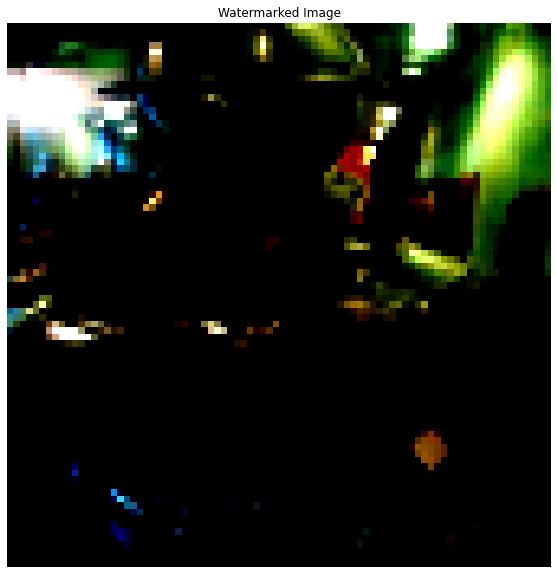

  9%|▉         | 1/11 [00:07<01:18,  7.88s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 7: Target opacity: 0, Labeled correctly: 0.68, Correctly Predicted Target: True, Base class predicted: False


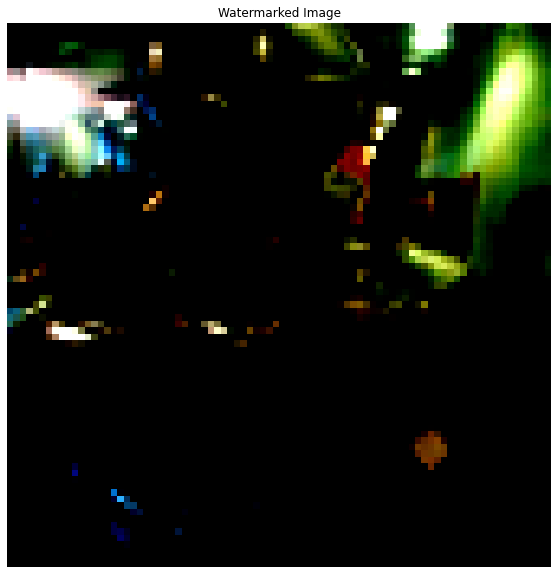

 18%|█▊        | 2/11 [00:15<01:11,  7.93s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 7: Target opacity: 0.05, Labeled correctly: 0.6933333333333334, Correctly Predicted Target: True, Base class predicted: False


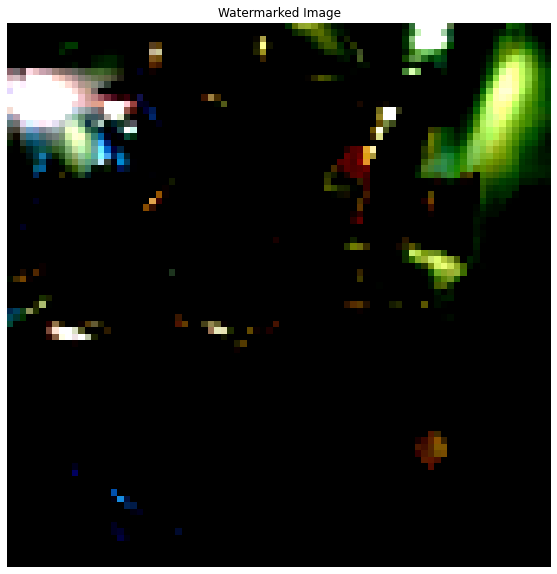

 27%|██▋       | 3/11 [00:23<01:04,  8.01s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 7: Target opacity: 0.1, Labeled correctly: 0.68, Correctly Predicted Target: True, Base class predicted: False


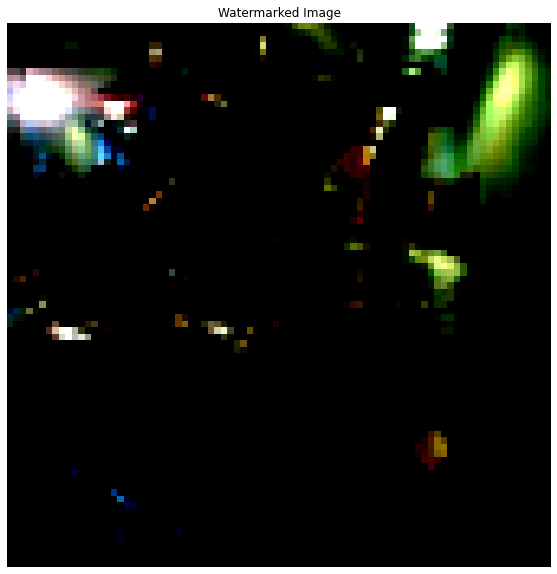

 36%|███▋      | 4/11 [00:32<00:56,  8.04s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 7: Target opacity: 0.15, Labeled correctly: 0.6666666666666666, Correctly Predicted Target: True, Base class predicted: False


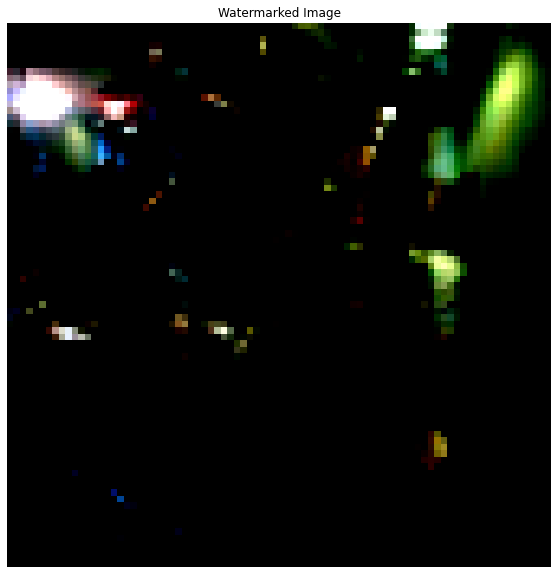

 45%|████▌     | 5/11 [00:40<00:48,  8.08s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 7: Target opacity: 0.2, Labeled correctly: 0.6666666666666666, Correctly Predicted Target: True, Base class predicted: False


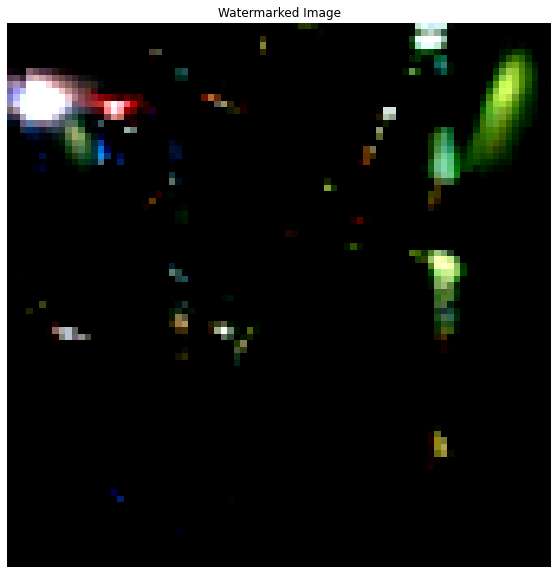

 55%|█████▍    | 6/11 [00:48<00:40,  8.08s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 7: Target opacity: 0.25, Labeled correctly: 0.68, Correctly Predicted Target: True, Base class predicted: False


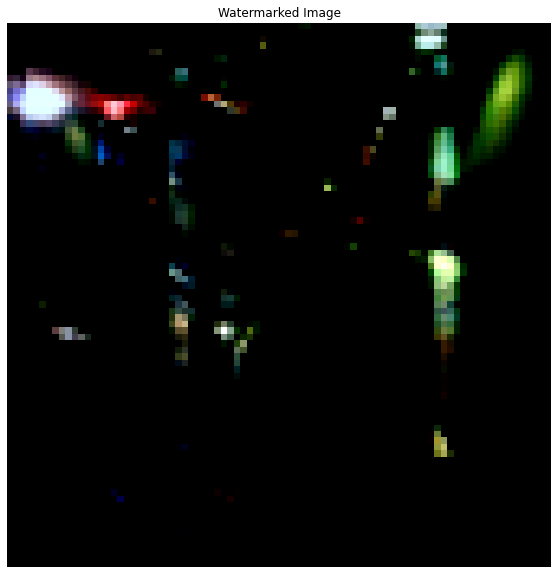

 64%|██████▎   | 7/11 [00:56<00:32,  8.07s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 7: Target opacity: 0.3, Labeled correctly: 0.68, Correctly Predicted Target: True, Base class predicted: False


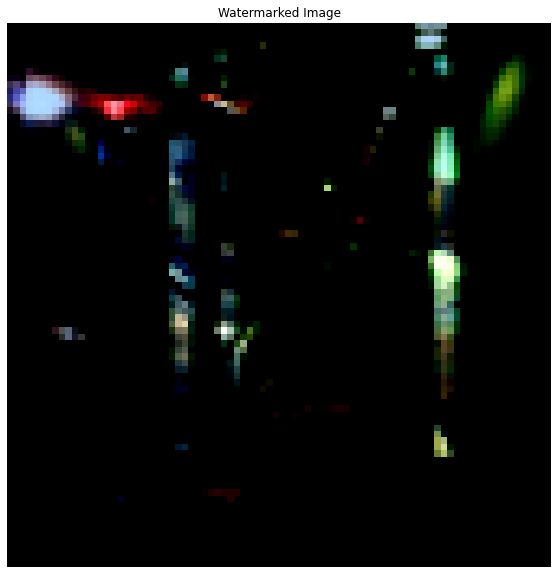

 73%|███████▎  | 8/11 [01:04<00:24,  8.07s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 7: Target opacity: 0.35, Labeled correctly: 0.6933333333333334, Correctly Predicted Target: True, Base class predicted: False


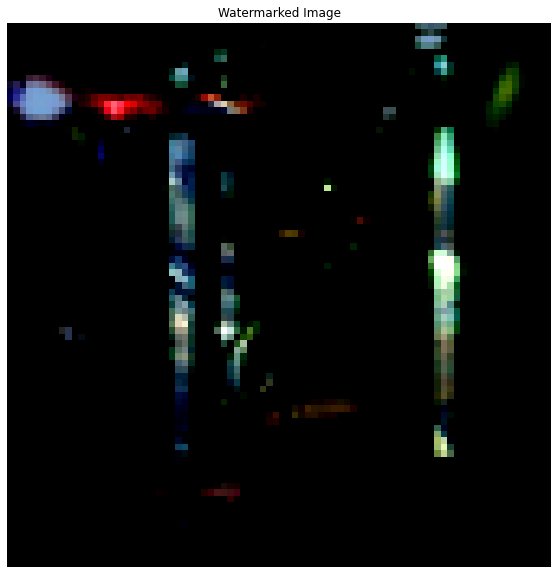

 82%|████████▏ | 9/11 [01:12<00:16,  8.06s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 7: Target opacity: 0.4, Labeled correctly: 0.6933333333333334, Correctly Predicted Target: True, Base class predicted: False


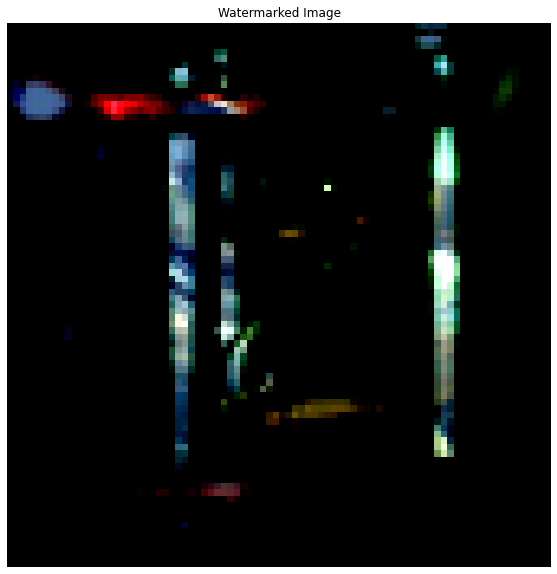

 91%|█████████ | 10/11 [01:20<00:08,  8.08s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 7: Target opacity: 0.45, Labeled correctly: 0.68, Correctly Predicted Target: True, Base class predicted: False


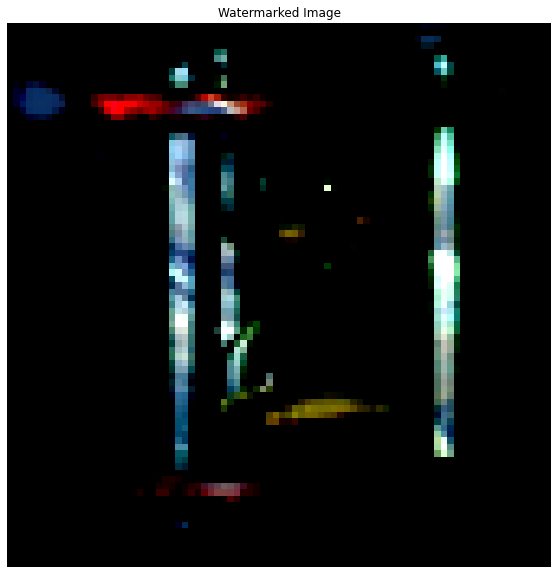

100%|██████████| 11/11 [01:26<00:00,  7.84s/it]

Iteration 7: Target opacity: 0.5, Labeled correctly: 0.6933333333333334, Correctly Predicted Target: True, Base class predicted: False



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


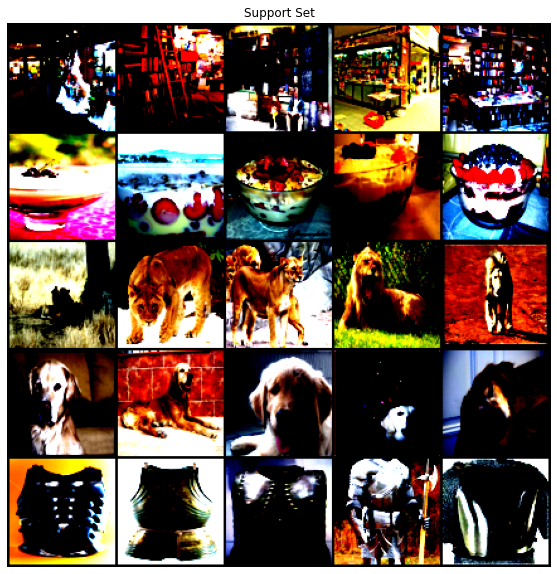

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 2, 2, 2, 2,
         2]])


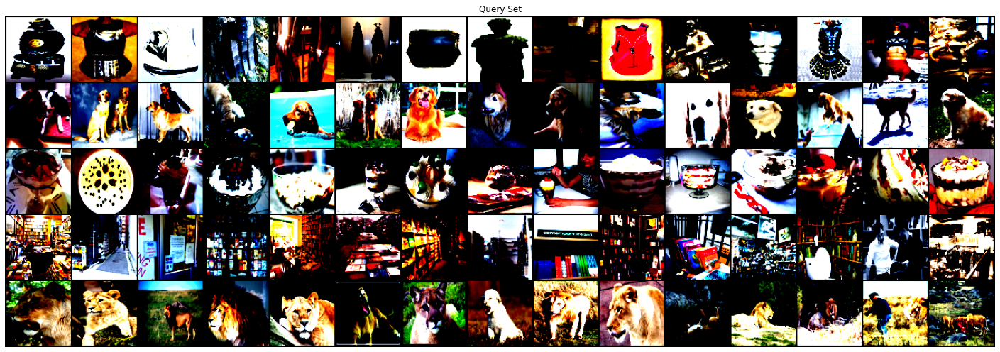

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3,
         3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
         1, 1, 1]])
target_class 3
unique_classes [0, 1, 2, 4]
base_class 1
target_indices [15 16 17 18 19 20 21 22 23 24 25 26 27 28 29]
target_index 27
base_indices [10 11 12 13 14]
base_index 10


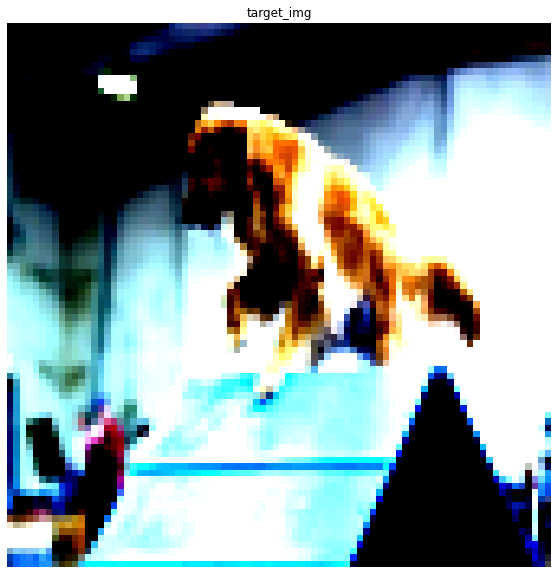

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


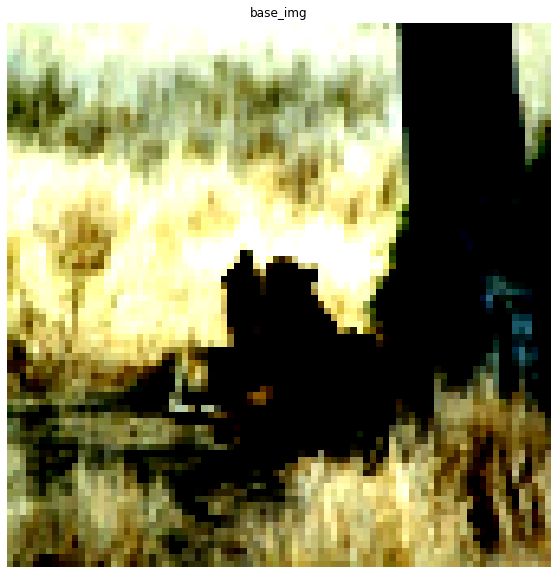

  0%|          | 1/1000 [00:00<01:59,  8.38it/s]

Iteration 0
loss: tensor(12.4983, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(18.6542, grad_fn=<PowBackward0>)


  1%|          | 6/1000 [00:00<00:53, 18.75it/s]

Iteration 2
loss: tensor(12.7417, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(12.8241, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(58.6110, grad_fn=<PowBackward0>)
Iteration 5
loss: tensor(8.3771, grad_fn=<PowBackward0>)
Iteration 6
loss: tensor(66.0682, grad_fn=<PowBackward0>)
Iteration 7
loss: tensor(0.0684, grad_fn=<PowBackward0>)

  1%|          | 12/1000 [00:00<00:41, 23.67it/s]


Iteration 8
loss: tensor(1.0614, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(30.2204, grad_fn=<PowBackward0>)
Iteration 10
loss: tensor(8.0379, grad_fn=<PowBackward0>)
Iteration 11
loss: tensor(8.7244, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(70.1093, grad_fn=<PowBackward0>)


  2%|▏         | 18/1000 [00:00<00:39, 24.66it/s]

Iteration 13
loss: tensor(17.3434, grad_fn=<PowBackward0>)
Iteration 14
loss: tensor(83.8972, grad_fn=<PowBackward0>)
Iteration 15
loss: tensor(6.5720, grad_fn=<PowBackward0>)
Iteration 16
loss: tensor(33.3564, grad_fn=<PowBackward0>)
Iteration 17
loss: tensor(12.9146, grad_fn=<PowBackward0>)
Iteration 18


  2%|▏         | 21/1000 [00:00<00:38, 25.15it/s]

loss: tensor(84.4110, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(0.5726, grad_fn=<PowBackward0>)
Iteration 20
loss: tensor(19.4078, grad_fn=<PowBackward0>)
Iteration 21
loss: tensor(24.9016, grad_fn=<PowBackward0>)
Iteration 22
loss: tensor(41.9726, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(0.9800, grad_fn=<PowBackward0>)


  3%|▎         | 27/1000 [00:01<00:39, 24.83it/s]

Iteration 24
loss: tensor(24.0322, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(15.8913, grad_fn=<PowBackward0>)
Iteration 26
loss: tensor(37.2794, grad_fn=<PowBackward0>)
Iteration 27
loss: tensor(30.4114, grad_fn=<PowBackward0>)
Iteration 28
loss: tensor(56.9199, grad_fn=<PowBackward0>)
Iteration 29


  3%|▎         | 33/1000 [00:01<00:39, 24.75it/s]

loss: tensor(16.0199, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(56.6830, grad_fn=<PowBackward0>)
Iteration 31
loss: tensor(22.6942, grad_fn=<PowBackward0>)
Iteration 32
loss: tensor(45.3628, grad_fn=<PowBackward0>)
Iteration 33
loss: tensor(3.6858, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(18.6732, grad_fn=<PowBackward0>)


  4%|▍         | 39/1000 [00:01<00:37, 25.58it/s]

Iteration 35
loss: tensor(86.4551, grad_fn=<PowBackward0>)
Iteration 36
loss: tensor(0.2813, grad_fn=<PowBackward0>)
Iteration 37
loss: tensor(0.8830, grad_fn=<PowBackward0>)
Iteration 38
loss: tensor(77.2806, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(3.2636, grad_fn=<PowBackward0>)
Iteration 40


  4%|▍         | 45/1000 [00:01<00:37, 25.77it/s]

loss: tensor(37.3531, grad_fn=<PowBackward0>)
Iteration 41
loss: tensor(4.3386, grad_fn=<PowBackward0>)
Iteration 42
loss: tensor(72.4191, grad_fn=<PowBackward0>)
Iteration 43
loss: tensor(2.2063, grad_fn=<PowBackward0>)
Iteration 44
loss: tensor(22.7696, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(27.3637, grad_fn=<PowBackward0>)


  5%|▌         | 51/1000 [00:02<00:37, 25.14it/s]

Iteration 46
loss: tensor(61.5287, grad_fn=<PowBackward0>)
Iteration 47
loss: tensor(1.1800, grad_fn=<PowBackward0>)
Iteration 48
loss: tensor(38.8541, grad_fn=<PowBackward0>)
Iteration 49
loss: tensor(3.5052, grad_fn=<PowBackward0>)
Iteration 50
loss: tensor(56.6262, grad_fn=<PowBackward0>)


  5%|▌         | 54/1000 [00:02<00:37, 24.96it/s]

Iteration 51
loss: tensor(1.2810, grad_fn=<PowBackward0>)
Iteration 52
loss: tensor(11.9835, grad_fn=<PowBackward0>)
Iteration 53
loss: tensor(98.3734, grad_fn=<PowBackward0>)
Iteration 54
loss: tensor(0.4409, grad_fn=<PowBackward0>)
Iteration 55
loss: tensor(2.2401, grad_fn=<PowBackward0>)
Iteration 56


  6%|▌         | 60/1000 [00:02<00:37, 25.12it/s]

loss: tensor(31.4058, grad_fn=<PowBackward0>)
Iteration 57
loss: tensor(8.2583, grad_fn=<PowBackward0>)
Iteration 58
loss: tensor(31.9662, grad_fn=<PowBackward0>)
Iteration 59
loss: tensor(9.0922, grad_fn=<PowBackward0>)
Iteration 60
loss: tensor(44.5221, grad_fn=<PowBackward0>)
Iteration 61


  7%|▋         | 66/1000 [00:02<00:36, 25.50it/s]

loss: tensor(10.7110, grad_fn=<PowBackward0>)
Iteration 62
loss: tensor(60.3522, grad_fn=<PowBackward0>)
Iteration 63
loss: tensor(0.4382, grad_fn=<PowBackward0>)
Iteration 64
loss: tensor(5.9738, grad_fn=<PowBackward0>)
Iteration 65
loss: tensor(14.8174, grad_fn=<PowBackward0>)
Iteration 66
loss: tensor(69.3696, grad_fn=<PowBackward0>)


  7%|▋         | 72/1000 [00:02<00:36, 25.39it/s]

Iteration 67
loss: tensor(1.6444, grad_fn=<PowBackward0>)
Iteration 68
loss: tensor(8.5580, grad_fn=<PowBackward0>)
Iteration 69
loss: tensor(5.2261, grad_fn=<PowBackward0>)
Iteration 70
loss: tensor(76.1618, grad_fn=<PowBackward0>)
Iteration 71
loss: tensor(4.3694, grad_fn=<PowBackward0>)
Iteration 72


  8%|▊         | 75/1000 [00:03<00:36, 25.51it/s]

loss: tensor(28.9993, grad_fn=<PowBackward0>)
Iteration 73
loss: tensor(19.8058, grad_fn=<PowBackward0>)
Iteration 74
loss: tensor(40.5621, grad_fn=<PowBackward0>)
Iteration 75
loss: tensor(12.0394, grad_fn=<PowBackward0>)
Iteration 76
loss: tensor(68.8555, grad_fn=<PowBackward0>)
Iteration 77
loss: tensor(4.0914, grad_fn=<PowBackward0>)

  8%|▊         | 81/1000 [00:03<00:36, 25.23it/s]


Iteration 78
loss: tensor(43.1716, grad_fn=<PowBackward0>)
Iteration 79
loss: tensor(3.7662, grad_fn=<PowBackward0>)
Iteration 80
loss: tensor(25.4267, grad_fn=<PowBackward0>)
Iteration 81
loss: tensor(9.5808, grad_fn=<PowBackward0>)
Iteration 82
loss: tensor(34.2922, grad_fn=<PowBackward0>)


  9%|▊         | 87/1000 [00:03<00:35, 26.03it/s]

Iteration 83
loss: tensor(16.5077, grad_fn=<PowBackward0>)
Iteration 84
loss: tensor(48.8133, grad_fn=<PowBackward0>)
Iteration 85
loss: tensor(4.8545, grad_fn=<PowBackward0>)
Iteration 86
loss: tensor(46.2289, grad_fn=<PowBackward0>)
Iteration 87
loss: tensor(1.7507, grad_fn=<PowBackward0>)
Iteration 88


  9%|▉         | 93/1000 [00:03<00:34, 26.64it/s]

loss: tensor(35.2764, grad_fn=<PowBackward0>)
Iteration 89
loss: tensor(9.1462, grad_fn=<PowBackward0>)
Iteration 90
loss: tensor(42.4186, grad_fn=<PowBackward0>)
Iteration 91
loss: tensor(4.8973, grad_fn=<PowBackward0>)
Iteration 92
loss: tensor(28.3190, grad_fn=<PowBackward0>)
Iteration 93
loss: tensor(10.0654, grad_fn=<PowBackward0>)
Iteration 94


 10%|▉         | 99/1000 [00:03<00:34, 26.39it/s]

loss: tensor(63.8582, grad_fn=<PowBackward0>)
Iteration 95
loss: tensor(2.3339, grad_fn=<PowBackward0>)
Iteration 96
loss: tensor(24.8658, grad_fn=<PowBackward0>)
Iteration 97
loss: tensor(6.5224, grad_fn=<PowBackward0>)
Iteration 98
loss: tensor(46.2086, grad_fn=<PowBackward0>)
Iteration 99
loss: tensor(9.5926, grad_fn=<PowBackward0>)


 10%|█         | 105/1000 [00:04<00:34, 25.90it/s]

Iteration 100
loss: tensor(66.2992, grad_fn=<PowBackward0>)
Iteration 101
loss: tensor(18.7071, grad_fn=<PowBackward0>)
Iteration 102
loss: tensor(35.6655, grad_fn=<PowBackward0>)
Iteration 103
loss: tensor(14.9507, grad_fn=<PowBackward0>)
Iteration 104
loss: tensor(60.9891, grad_fn=<PowBackward0>)


 11%|█         | 108/1000 [00:04<00:35, 24.90it/s]

Iteration 105
loss: tensor(2.9660, grad_fn=<PowBackward0>)
Iteration 106
loss: tensor(37.3895, grad_fn=<PowBackward0>)
Iteration 107
loss: tensor(9.9619, grad_fn=<PowBackward0>)
Iteration 108
loss: tensor(6.9981, grad_fn=<PowBackward0>)
Iteration 109
loss: tensor(21.5687, grad_fn=<PowBackward0>)


 11%|█▏        | 114/1000 [00:04<00:35, 25.08it/s]

Iteration 110
loss: tensor(38.2046, grad_fn=<PowBackward0>)
Iteration 111
loss: tensor(8.8859, grad_fn=<PowBackward0>)
Iteration 112
loss: tensor(65.3230, grad_fn=<PowBackward0>)
Iteration 113
loss: tensor(9.1782, grad_fn=<PowBackward0>)
Iteration 114
loss: tensor(66.4277, grad_fn=<PowBackward0>)
Iteration 115


 12%|█▏        | 120/1000 [00:04<00:34, 25.38it/s]

loss: tensor(16.3515, grad_fn=<PowBackward0>)
Iteration 116
loss: tensor(56.2925, grad_fn=<PowBackward0>)
Iteration 117
loss: tensor(15.2515, grad_fn=<PowBackward0>)
Iteration 118
loss: tensor(65.2740, grad_fn=<PowBackward0>)
Iteration 119
loss: tensor(9.0188, grad_fn=<PowBackward0>)
Iteration 120
loss: tensor(52.3167, grad_fn=<PowBackward0>)


 13%|█▎        | 126/1000 [00:05<00:32, 26.51it/s]

Iteration 121
loss: tensor(17.0879, grad_fn=<PowBackward0>)
Iteration 122
loss: tensor(67.5335, grad_fn=<PowBackward0>)
Iteration 123
loss: tensor(0.1929, grad_fn=<PowBackward0>)
Iteration 124
loss: tensor(1.1003, grad_fn=<PowBackward0>)
Iteration 125
loss: tensor(16.1992, grad_fn=<PowBackward0>)
Iteration 126
loss: tensor(63.6038, grad_fn=<PowBackward0>)


 13%|█▎        | 132/1000 [00:05<00:32, 26.77it/s]

Iteration 127
loss: tensor(12.9918, grad_fn=<PowBackward0>)
Iteration 128
loss: tensor(46.0016, grad_fn=<PowBackward0>)
Iteration 129
loss: tensor(4.6826, grad_fn=<PowBackward0>)
Iteration 130
loss: tensor(59.8592, grad_fn=<PowBackward0>)
Iteration 131
loss: tensor(0.8678, grad_fn=<PowBackward0>)
Iteration 132
loss: tensor(23.9085, grad_fn=<PowBackward0>)

 14%|█▍        | 138/1000 [00:05<00:31, 27.00it/s]


Iteration 133
loss: tensor(26.3707, grad_fn=<PowBackward0>)
Iteration 134
loss: tensor(41.9433, grad_fn=<PowBackward0>)
Iteration 135
loss: tensor(9.6203, grad_fn=<PowBackward0>)
Iteration 136
loss: tensor(29.2001, grad_fn=<PowBackward0>)
Iteration 137
loss: tensor(22.5259, grad_fn=<PowBackward0>)


 14%|█▍        | 141/1000 [00:05<00:31, 27.28it/s]

Iteration 138
loss: tensor(32.1346, grad_fn=<PowBackward0>)
Iteration 139
loss: tensor(37.2625, grad_fn=<PowBackward0>)
Iteration 140
loss: tensor(54.4332, grad_fn=<PowBackward0>)
Iteration 141
loss: tensor(19.7067, grad_fn=<PowBackward0>)
Iteration 142
loss: tensor(80.0774, grad_fn=<PowBackward0>)
Iteration 143
loss: tensor(1.2387, grad_fn=<PowBackward0>)


 15%|█▍        | 147/1000 [00:05<00:30, 27.70it/s]

Iteration 144
loss: tensor(14.7505, grad_fn=<PowBackward0>)
Iteration 145
loss: tensor(27.0246, grad_fn=<PowBackward0>)
Iteration 146
loss: tensor(61.4679, grad_fn=<PowBackward0>)
Iteration 147
loss: tensor(5.7701, grad_fn=<PowBackward0>)
Iteration 148
loss: tensor(33.8740, grad_fn=<PowBackward0>)
Iteration 149


 15%|█▌        | 153/1000 [00:06<00:34, 24.76it/s]

loss: tensor(1.4966, grad_fn=<PowBackward0>)
Iteration 150
loss: tensor(38.1590, grad_fn=<PowBackward0>)
Iteration 151
loss: tensor(2.0207, grad_fn=<PowBackward0>)
Iteration 152
loss: tensor(38.6064, grad_fn=<PowBackward0>)
Iteration 153
loss: tensor(3.1489, grad_fn=<PowBackward0>)
Iteration 

 16%|█▌        | 159/1000 [00:06<00:33, 25.47it/s]

154
loss: tensor(30.9606, grad_fn=<PowBackward0>)
Iteration 155
loss: tensor(2.8372, grad_fn=<PowBackward0>)
Iteration 156
loss: tensor(58.1641, grad_fn=<PowBackward0>)
Iteration 157
loss: tensor(13.2485, grad_fn=<PowBackward0>)
Iteration 158
loss: tensor(47.8647, grad_fn=<PowBackward0>)
Iteration 159


 16%|█▌        | 162/1000 [00:06<00:33, 25.11it/s]

loss: tensor(27.7060, grad_fn=<PowBackward0>)
Iteration 160
loss: tensor(49.2445, grad_fn=<PowBackward0>)
Iteration 161
loss: tensor(0.5468, grad_fn=<PowBackward0>)
Iteration 162
loss: tensor(6.6632, grad_fn=<PowBackward0>)
Iteration 163
loss: tensor(15.7054, grad_fn=<PowBackward0>)
Iteration 164
loss: tensor(60.0843, grad_fn=<PowBackward0>)


 17%|█▋        | 168/1000 [00:06<00:32, 25.37it/s]

Iteration 165
loss: tensor(7.6232, grad_fn=<PowBackward0>)
Iteration 166
loss: tensor(57.8413, grad_fn=<PowBackward0>)
Iteration 167
loss: tensor(5.8547, grad_fn=<PowBackward0>)
Iteration 168
loss: tensor(37.1968, grad_fn=<PowBackward0>)
Iteration 169
loss: tensor(3.4578, grad_fn=<PowBackward0>)
Iteration 170


 17%|█▋        | 174/1000 [00:06<00:33, 24.76it/s]

loss: tensor(47.3705, grad_fn=<PowBackward0>)
Iteration 171
loss: tensor(1.9362, grad_fn=<PowBackward0>)
Iteration 172
loss: tensor(28.3806, grad_fn=<PowBackward0>)
Iteration 173
loss: tensor(14.9632, grad_fn=<PowBackward0>)
Iteration 174
loss: tensor(50.8748, grad_fn=<PowBackward0>)
Iteration 175


 18%|█▊        | 180/1000 [00:07<00:32, 24.99it/s]

loss: tensor(9.6188, grad_fn=<PowBackward0>)
Iteration 176
loss: tensor(51.2415, grad_fn=<PowBackward0>)
Iteration 177
loss: tensor(18.5450, grad_fn=<PowBackward0>)
Iteration 178
loss: tensor(33.1970, grad_fn=<PowBackward0>)
Iteration 179
loss: tensor(2.1138, grad_fn=<PowBackward0>)
Iteration 180
loss: tensor(48.8219, grad_fn=<PowBackward0>)


 19%|█▊        | 186/1000 [00:07<00:32, 24.96it/s]

Iteration 181
loss: tensor(7.4655, grad_fn=<PowBackward0>)
Iteration 182
loss: tensor(56.4175, grad_fn=<PowBackward0>)
Iteration 183
loss: tensor(9.6460, grad_fn=<PowBackward0>)
Iteration 184
loss: tensor(56.8777, grad_fn=<PowBackward0>)
Iteration 185
loss: tensor(3.9224, grad_fn=<PowBackward0>)
Iteration 

 19%|█▉        | 189/1000 [00:07<00:32, 24.79it/s]

186
loss: tensor(22.5309, grad_fn=<PowBackward0>)
Iteration 187
loss: tensor(10.6455, grad_fn=<PowBackward0>)
Iteration 188
loss: tensor(66.0130, grad_fn=<PowBackward0>)
Iteration 189
loss: tensor(1.1782, grad_fn=<PowBackward0>)
Iteration 190
loss: tensor(8.5487, grad_fn=<PowBackward0>)
Iteration 191


 20%|█▉        | 195/1000 [00:07<00:32, 25.09it/s]

loss: tensor(33.2558, grad_fn=<PowBackward0>)
Iteration 192
loss: tensor(74.9518, grad_fn=<PowBackward0>)
Iteration 193
loss: tensor(2.0419, grad_fn=<PowBackward0>)
Iteration 194
loss: tensor(18.7071, grad_fn=<PowBackward0>)
Iteration 195
loss: tensor(23.7311, grad_fn=<PowBackward0>)
Iteration 196
loss: tensor(43.4543, grad_fn=<PowBackward0>)


 20%|██        | 201/1000 [00:07<00:31, 25.19it/s]

Iteration 197
loss: tensor(2.1691, grad_fn=<PowBackward0>)
Iteration 198
loss: tensor(16.6770, grad_fn=<PowBackward0>)
Iteration 199
loss: tensor(2.0184, grad_fn=<PowBackward0>)
Iteration 200
loss: tensor(40.4924, grad_fn=<PowBackward0>)
Iteration 201
loss: tensor(31.3638, grad_fn=<PowBackward0>)


 21%|██        | 207/1000 [00:08<00:32, 24.58it/s]

Iteration 202
loss: tensor(33.7630, grad_fn=<PowBackward0>)
Iteration 203
loss: tensor(23.2272, grad_fn=<PowBackward0>)
Iteration 204
loss: tensor(23.4026, grad_fn=<PowBackward0>)
Iteration 205
loss: tensor(28.6875, grad_fn=<PowBackward0>)
Iteration 206
loss: tensor(82.7706, grad_fn=<PowBackward0>)


 21%|██        | 210/1000 [00:08<00:33, 23.92it/s]

Iteration 207
loss: tensor(25.9514, grad_fn=<PowBackward0>)
Iteration 208
loss: tensor(53.0137, grad_fn=<PowBackward0>)
Iteration 209
loss: tensor(4.1353, grad_fn=<PowBackward0>)
Iteration 210
loss: tensor(26.4857, grad_fn=<PowBackward0>)
Iteration 211
loss: tensor(9.4431, grad_fn=<PowBackward0>)
Iteration

 22%|██▏       | 216/1000 [00:08<00:31, 25.14it/s]

 212
loss: tensor(36.9748, grad_fn=<PowBackward0>)
Iteration 213
loss: tensor(18.3907, grad_fn=<PowBackward0>)
Iteration 214
loss: tensor(18.4621, grad_fn=<PowBackward0>)
Iteration 215
loss: tensor(0.9022, grad_fn=<PowBackward0>)
Iteration 216
loss: tensor(5.9526, grad_fn=<PowBackward0>)
Iteration 217
loss: 

 22%|██▏       | 222/1000 [00:08<00:30, 25.77it/s]

tensor(15.2852, grad_fn=<PowBackward0>)
Iteration 218
loss: tensor(77.1754, grad_fn=<PowBackward0>)
Iteration 219
loss: tensor(5.5784, grad_fn=<PowBackward0>)
Iteration 220
loss: tensor(21.0344, grad_fn=<PowBackward0>)
Iteration 221
loss: tensor(12.3146, grad_fn=<PowBackward0>)
Iteration 222
loss: tensor(28.9728, grad_fn=<PowBackward0>)


 23%|██▎       | 228/1000 [00:09<00:30, 25.22it/s]

Iteration 223
loss: tensor(9.5453, grad_fn=<PowBackward0>)
Iteration 224
loss: tensor(44.6910, grad_fn=<PowBackward0>)
Iteration 225
loss: tensor(18.1788, grad_fn=<PowBackward0>)
Iteration 226
loss: tensor(16.2635, grad_fn=<PowBackward0>)
Iteration 227
loss: tensor(8.2505, grad_fn=<PowBackward0>)


 23%|██▎       | 231/1000 [00:09<00:30, 25.09it/s]

Iteration 228
loss: tensor(37.8872, grad_fn=<PowBackward0>)
Iteration 229
loss: tensor(10.2148, grad_fn=<PowBackward0>)
Iteration 230
loss: tensor(32.5365, grad_fn=<PowBackward0>)
Iteration 231
loss: tensor(5.7563, grad_fn=<PowBackward0>)
Iteration 232
loss: tensor(19.1163, grad_fn=<PowBackward0>)
Iteration 233


 24%|██▎       | 237/1000 [00:09<00:30, 25.21it/s]

loss: tensor(8.2841, grad_fn=<PowBackward0>)
Iteration 234
loss: tensor(20.2856, grad_fn=<PowBackward0>)
Iteration 235
loss: tensor(11.8041, grad_fn=<PowBackward0>)
Iteration 236
loss: tensor(41.4577, grad_fn=<PowBackward0>)
Iteration 237
loss: tensor(18.4328, grad_fn=<PowBackward0>)
Iteration 238
loss: tensor(47.8195, grad_fn=<PowBackward0>)


 24%|██▍       | 243/1000 [00:09<00:30, 25.04it/s]

Iteration 239
loss: tensor(13.2324, grad_fn=<PowBackward0>)
Iteration 240
loss: tensor(20.1329, grad_fn=<PowBackward0>)
Iteration 241
loss: tensor(10.7214, grad_fn=<PowBackward0>)
Iteration 242
loss: tensor(64.3417, grad_fn=<PowBackward0>)
Iteration 243
loss: tensor(23.3257, grad_fn=<PowBackward0>)
Iteration 244


 25%|██▍       | 249/1000 [00:09<00:29, 25.65it/s]

loss: tensor(10.3176, grad_fn=<PowBackward0>)
Iteration 245
loss: tensor(7.8493, grad_fn=<PowBackward0>)
Iteration 246
loss: tensor(16.4393, grad_fn=<PowBackward0>)
Iteration 247
loss: tensor(16.0992, grad_fn=<PowBackward0>)
Iteration 248
loss: tensor(26.8706, grad_fn=<PowBackward0>)
Iteration 249
loss: tensor(23.3649, grad_fn=<PowBackward0>)


 26%|██▌       | 255/1000 [00:10<00:29, 25.20it/s]

Iteration 250
loss: tensor(36.6769, grad_fn=<PowBackward0>)
Iteration 251
loss: tensor(10.6391, grad_fn=<PowBackward0>)
Iteration 252
loss: tensor(30.5140, grad_fn=<PowBackward0>)
Iteration 253
loss: tensor(3.2849, grad_fn=<PowBackward0>)
Iteration 254
loss: tensor(18.5128, grad_fn=<PowBackward0>)
Iteration 255


 26%|██▌       | 258/1000 [00:10<00:29, 25.32it/s]

loss: tensor(10.0362, grad_fn=<PowBackward0>)
Iteration 256
loss: tensor(19.7793, grad_fn=<PowBackward0>)
Iteration 257
loss: tensor(6.8773, grad_fn=<PowBackward0>)
Iteration 258
loss: tensor(54.8087, grad_fn=<PowBackward0>)
Iteration 259
loss: tensor(5.8060, grad_fn=<PowBackward0>)
Iteration 260
loss: tensor(16.5520, grad_fn=<PowBackward0>)


 26%|██▋       | 264/1000 [00:10<00:28, 25.85it/s]

Iteration 261
loss: tensor(14.1211, grad_fn=<PowBackward0>)
Iteration 262
loss: tensor(28.6479, grad_fn=<PowBackward0>)
Iteration 263
loss: tensor(12.5192, grad_fn=<PowBackward0>)
Iteration 264
loss: tensor(40.6665, grad_fn=<PowBackward0>)
Iteration 265
loss: tensor(8.8770, grad_fn=<PowBackward0>)
Iteration 266


 27%|██▋       | 270/1000 [00:10<00:28, 25.52it/s]

loss: tensor(32.5902, grad_fn=<PowBackward0>)
Iteration 267
loss: tensor(5.9614, grad_fn=<PowBackward0>)
Iteration 268
loss: tensor(30.0707, grad_fn=<PowBackward0>)
Iteration 269
loss: tensor(11.4657, grad_fn=<PowBackward0>)
Iteration 270
loss: tensor(40.1386, grad_fn=<PowBackward0>)
Iteration 271
loss: tensor(6.8593, grad_fn=<PowBackward0>)


 28%|██▊       | 276/1000 [00:10<00:28, 25.01it/s]

Iteration 272
loss: tensor(23.6173, grad_fn=<PowBackward0>)
Iteration 273
loss: tensor(9.4373, grad_fn=<PowBackward0>)
Iteration 274
loss: tensor(43.8211, grad_fn=<PowBackward0>)
Iteration 275
loss: tensor(8.0294, grad_fn=<PowBackward0>)
Iteration 276
loss: tensor(26.3936, grad_fn=<PowBackward0>)
Iteration 277


 28%|██▊       | 282/1000 [00:11<00:29, 24.02it/s]

loss: tensor(4.4056, grad_fn=<PowBackward0>)
Iteration 278
loss: tensor(21.2053, grad_fn=<PowBackward0>)
Iteration 279
loss: tensor(14.2109, grad_fn=<PowBackward0>)
Iteration 280
loss: tensor(44.3714, grad_fn=<PowBackward0>)
Iteration 281
loss: tensor(15.8681, grad_fn=<PowBackward0>)
Iteration 282


 28%|██▊       | 285/1000 [00:11<00:29, 24.05it/s]

loss: tensor(50.6813, grad_fn=<PowBackward0>)
Iteration 283
loss: tensor(7.0304, grad_fn=<PowBackward0>)
Iteration 284
loss: tensor(43.1974, grad_fn=<PowBackward0>)
Iteration 285
loss: tensor(15.1337, grad_fn=<PowBackward0>)
Iteration 286
loss: tensor(24.1210, grad_fn=<PowBackward0>)
Iteration 287
loss: tensor(21.2339, grad_fn=<PowBackward0>)


 29%|██▉       | 291/1000 [00:11<00:27, 25.66it/s]

Iteration 288
loss: tensor(38.1745, grad_fn=<PowBackward0>)
Iteration 289
loss: tensor(5.0465, grad_fn=<PowBackward0>)
Iteration 290
loss: tensor(25.6048, grad_fn=<PowBackward0>)
Iteration 291
loss: tensor(19.5425, grad_fn=<PowBackward0>)
Iteration 292
loss: tensor(20.8775, grad_fn=<PowBackward0>)
Iteration 293
loss: tensor(12.3578, grad_fn=<PowBackward0>)


 30%|██▉       | 297/1000 [00:11<00:26, 26.54it/s]

Iteration 294
loss: tensor(25.7304, grad_fn=<PowBackward0>)
Iteration 295
loss: tensor(1.9785, grad_fn=<PowBackward0>)
Iteration 296
loss: tensor(6.0939, grad_fn=<PowBackward0>)
Iteration 297
loss: tensor(5.8514, grad_fn=<PowBackward0>)
Iteration 298
loss: tensor(46.1922, grad_fn=<PowBackward0>)
Iteration 299
loss: tensor(18.1621, grad_fn=<PowBackward0>)


 30%|███       | 303/1000 [00:12<00:27, 24.94it/s]

Iteration 300
loss: tensor(37.4700, grad_fn=<PowBackward0>)
Iteration 301
loss: tensor(17.1404, grad_fn=<PowBackward0>)
Iteration 302
loss: tensor(11.2253, grad_fn=<PowBackward0>)
Iteration 303
loss: tensor(6.5631, grad_fn=<PowBackward0>)
Iteration 304
loss: tensor(4.8047, grad_fn=<PowBackward0>)


 31%|███       | 309/1000 [00:12<00:26, 26.10it/s]

Iteration 305
loss: tensor(2.7658, grad_fn=<PowBackward0>)
Iteration 306
loss: tensor(8.4804, grad_fn=<PowBackward0>)
Iteration 307
loss: tensor(5.5181, grad_fn=<PowBackward0>)
Iteration 308
loss: tensor(10.3851, grad_fn=<PowBackward0>)
Iteration 309
loss: tensor(8.3823, grad_fn=<PowBackward0>)
Iteration 310
loss: tensor(18.1563, grad_fn=<PowBackward0>)


 32%|███▏      | 315/1000 [00:12<00:26, 26.23it/s]

Iteration 311
loss: tensor(2.5335, grad_fn=<PowBackward0>)
Iteration 312
loss: tensor(10.4738, grad_fn=<PowBackward0>)
Iteration 313
loss: tensor(10.1857, grad_fn=<PowBackward0>)
Iteration 314
loss: tensor(18.4789, grad_fn=<PowBackward0>)
Iteration 315
loss: tensor(12.8374, grad_fn=<PowBackward0>)


 32%|███▏      | 321/1000 [00:12<00:26, 26.00it/s]

Iteration 316
loss: tensor(13.4157, grad_fn=<PowBackward0>)
Iteration 317
loss: tensor(5.1443, grad_fn=<PowBackward0>)
Iteration 318
loss: tensor(9.0000, grad_fn=<PowBackward0>)
Iteration 319
loss: tensor(6.3121, grad_fn=<PowBackward0>)
Iteration 320
loss: tensor(12.5042, grad_fn=<PowBackward0>)
Iteration 321


 33%|███▎      | 327/1000 [00:12<00:25, 26.90it/s]

loss: tensor(4.1394, grad_fn=<PowBackward0>)
Iteration 322
loss: tensor(13.5332, grad_fn=<PowBackward0>)
Iteration 323
loss: tensor(4.0090, grad_fn=<PowBackward0>)
Iteration 324
loss: tensor(11.5297, grad_fn=<PowBackward0>)
Iteration 325
loss: tensor(8.4949, grad_fn=<PowBackward0>)
Iteration 326
loss: tensor(16.4465, grad_fn=<PowBackward0>)
Iteration 327


 33%|███▎      | 330/1000 [00:13<00:25, 26.43it/s]

loss: tensor(4.5766, grad_fn=<PowBackward0>)
Iteration 328
loss: tensor(7.7017, grad_fn=<PowBackward0>)
Iteration 329
loss: tensor(8.3837, grad_fn=<PowBackward0>)
Iteration 330
loss: tensor(9.4896, grad_fn=<PowBackward0>)
Iteration 331
loss: tensor(2.8448, grad_fn=<PowBackward0>)
Iteration 332
loss: tensor(12.1728, grad_fn=<PowBackward0>)


 34%|███▎      | 336/1000 [00:13<00:24, 26.91it/s]

Iteration 333
loss: tensor(4.7195, grad_fn=<PowBackward0>)
Iteration 334
loss: tensor(6.8050, grad_fn=<PowBackward0>)
Iteration 335
loss: tensor(7.9548, grad_fn=<PowBackward0>)
Iteration 336
loss: tensor(9.2074, grad_fn=<PowBackward0>)
Iteration 337
loss: tensor(5.6275, grad_fn=<PowBackward0>)
Iteration 338
loss: tensor(13.0146, grad_fn=<PowBackward0>)


 34%|███▍      | 342/1000 [00:13<00:24, 26.92it/s]

Iteration 339
loss: tensor(6.4231, grad_fn=<PowBackward0>)
Iteration 340
loss: tensor(34.5158, grad_fn=<PowBackward0>)
Iteration 341
loss: tensor(5.7782, grad_fn=<PowBackward0>)
Iteration 342
loss: tensor(9.4670, grad_fn=<PowBackward0>)
Iteration 343
loss: tensor(8.0734, grad_fn=<PowBackward0>)
Iteration 344
loss: tensor(3.5468, grad_fn=<PowBackward0>)


 35%|███▍      | 348/1000 [00:13<00:25, 25.92it/s]

Iteration 345
loss: tensor(3.1796, grad_fn=<PowBackward0>)
Iteration 346
loss: tensor(7.6011, grad_fn=<PowBackward0>)
Iteration 347
loss: tensor(7.7220, grad_fn=<PowBackward0>)
Iteration 348
loss: tensor(25.9845, grad_fn=<PowBackward0>)
Iteration 349
loss: tensor(6.2446, grad_fn=<PowBackward0>)
Iteration 350


 35%|███▌      | 354/1000 [00:13<00:24, 26.36it/s]

loss: tensor(22.0163, grad_fn=<PowBackward0>)
Iteration 351
loss: tensor(4.4100, grad_fn=<PowBackward0>)
Iteration 352
loss: tensor(8.0921, grad_fn=<PowBackward0>)
Iteration 353
loss: tensor(3.5738, grad_fn=<PowBackward0>)
Iteration 354
loss: tensor(6.2480, grad_fn=<PowBackward0>)
Iteration 355
loss: tensor(3.3247, grad_fn=<PowBackward0>)


 36%|███▌      | 360/1000 [00:14<00:24, 25.86it/s]

Iteration 356
loss: tensor(18.4707, grad_fn=<PowBackward0>)
Iteration 357
loss: tensor(18.0816, grad_fn=<PowBackward0>)
Iteration 358
loss: tensor(18.2630, grad_fn=<PowBackward0>)
Iteration 359
loss: tensor(6.0216, grad_fn=<PowBackward0>)
Iteration 360
loss: tensor(11.3425, grad_fn=<PowBackward0>)
Iteration 361


 37%|███▋      | 366/1000 [00:14<00:24, 25.61it/s]

loss: tensor(5.2733, grad_fn=<PowBackward0>)
Iteration 362
loss: tensor(5.1849, grad_fn=<PowBackward0>)
Iteration 363
loss: tensor(1.9769, grad_fn=<PowBackward0>)
Iteration 364
loss: tensor(10.2662, grad_fn=<PowBackward0>)
Iteration 365
loss: tensor(3.7357, grad_fn=<PowBackward0>)
Iteration 366
loss: tensor(20.7655, grad_fn=<PowBackward0>)


 37%|███▋      | 372/1000 [00:14<00:24, 26.14it/s]

Iteration 367
loss: tensor(8.6944, grad_fn=<PowBackward0>)
Iteration 368
loss: tensor(11.2282, grad_fn=<PowBackward0>)
Iteration 369
loss: tensor(11.9167, grad_fn=<PowBackward0>)
Iteration 370
loss: tensor(12.0740, grad_fn=<PowBackward0>)
Iteration 371
loss: tensor(9.1902, grad_fn=<PowBackward0>)
Iteration 372


 38%|███▊      | 375/1000 [00:14<00:24, 26.02it/s]

loss: tensor(13.8112, grad_fn=<PowBackward0>)
Iteration 373
loss: tensor(4.9611, grad_fn=<PowBackward0>)
Iteration 374
loss: tensor(11.9470, grad_fn=<PowBackward0>)
Iteration 375
loss: tensor(7.0876, grad_fn=<PowBackward0>)
Iteration 376
loss: tensor(7.4187, grad_fn=<PowBackward0>)
Iteration 377
loss: tensor(4.8740, grad_fn=<PowBackward0>)


 38%|███▊      | 381/1000 [00:15<00:24, 25.71it/s]

Iteration 378
loss: tensor(8.2417, grad_fn=<PowBackward0>)
Iteration 379
loss: tensor(4.4311, grad_fn=<PowBackward0>)
Iteration 380
loss: tensor(21.3289, grad_fn=<PowBackward0>)
Iteration 381
loss: tensor(1.9851, grad_fn=<PowBackward0>)
Iteration 382
loss: tensor(13.8214, grad_fn=<PowBackward0>)
Iteration 383


 39%|███▊      | 387/1000 [00:15<00:23, 25.89it/s]

loss: tensor(16.8244, grad_fn=<PowBackward0>)
Iteration 384
loss: tensor(19.6554, grad_fn=<PowBackward0>)
Iteration 385
loss: tensor(19.5684, grad_fn=<PowBackward0>)
Iteration 386
loss: tensor(19.3060, grad_fn=<PowBackward0>)
Iteration 387
loss: tensor(10.0283, grad_fn=<PowBackward0>)
Iteration 388
loss: tensor(15.8637, grad_fn=<PowBackward0>)


 39%|███▉      | 393/1000 [00:15<00:23, 26.07it/s]

Iteration 389
loss: tensor(5.4182, grad_fn=<PowBackward0>)
Iteration 390
loss: tensor(18.4330, grad_fn=<PowBackward0>)
Iteration 391
loss: tensor(14.3770, grad_fn=<PowBackward0>)
Iteration 392
loss: tensor(14.1378, grad_fn=<PowBackward0>)
Iteration 393
loss: tensor(5.5537, grad_fn=<PowBackward0>)
Iteration 394


 40%|███▉      | 399/1000 [00:15<00:23, 26.12it/s]

loss: tensor(10.8092, grad_fn=<PowBackward0>)
Iteration 395
loss: tensor(8.6522, grad_fn=<PowBackward0>)
Iteration 396
loss: tensor(16.4043, grad_fn=<PowBackward0>)
Iteration 397
loss: tensor(8.9586, grad_fn=<PowBackward0>)
Iteration 398
loss: tensor(18.1016, grad_fn=<PowBackward0>)
Iteration 399
loss: tensor(4.8539, grad_fn=<PowBackward0>)


 40%|████      | 402/1000 [00:15<00:25, 23.90it/s]

Iteration 400
loss: tensor(13.4905, grad_fn=<PowBackward0>)
Iteration 401
loss: tensor(9.3332, grad_fn=<PowBackward0>)
Iteration 402
loss: tensor(0.5443, grad_fn=<PowBackward0>)
Iteration 403
loss: tensor(0.1617, grad_fn=<PowBackward0>)
Iteration 404
loss: tensor(0.0913, grad_fn=<PowBackward0>)


 41%|████      | 408/1000 [00:16<00:26, 22.44it/s]

Iteration 405
loss: tensor(0.0466, grad_fn=<PowBackward0>)
Iteration 406
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 407
loss: tensor(0.0191, grad_fn=<PowBackward0>)
Iteration 408
loss: tensor(0.0555, grad_fn=<PowBackward0>)
Iteration 409


 41%|████▏     | 414/1000 [00:16<00:24, 24.03it/s]

loss: tensor(0.0176, grad_fn=<PowBackward0>)
Iteration 410
loss: tensor(0.3603, grad_fn=<PowBackward0>)
Iteration 411
loss: tensor(0.8419, grad_fn=<PowBackward0>)
Iteration 412
loss: tensor(5.3340, grad_fn=<PowBackward0>)
Iteration 413
loss: tensor(5.8677, grad_fn=<PowBackward0>)
Iteration 414
loss: tensor(9.0449, grad_fn=<PowBackward0>)


 42%|████▏     | 417/1000 [00:16<00:24, 24.26it/s]

Iteration 415
loss: tensor(1.4163, grad_fn=<PowBackward0>)
Iteration 416
loss: tensor(6.7923, grad_fn=<PowBackward0>)
Iteration 417
loss: tensor(4.5205, grad_fn=<PowBackward0>)
Iteration 418
loss: tensor(3.0055, grad_fn=<PowBackward0>)
Iteration 419
loss: tensor(1.2047, grad_fn=<PowBackward0>)


 42%|████▏     | 423/1000 [00:16<00:23, 24.36it/s]

Iteration 420
loss: tensor(1.1790, grad_fn=<PowBackward0>)
Iteration 421
loss: tensor(0.4897, grad_fn=<PowBackward0>)
Iteration 422
loss: tensor(0.8012, grad_fn=<PowBackward0>)
Iteration 423
loss: tensor(0.3981, grad_fn=<PowBackward0>)
Iteration 424
loss: tensor(1.3154, grad_fn=<PowBackward0>)
Iteration 425
loss: tensor(1.4159, grad_fn=<PowBackward0>)


 43%|████▎     | 429/1000 [00:16<00:22, 25.38it/s]

Iteration 426
loss: tensor(4.3790, grad_fn=<PowBackward0>)
Iteration 427
loss: tensor(3.0288, grad_fn=<PowBackward0>)
Iteration 428
loss: tensor(5.6009, grad_fn=<PowBackward0>)
Iteration 429
loss: tensor(5.7011, grad_fn=<PowBackward0>)
Iteration 430
loss: tensor(4.8606, grad_fn=<PowBackward0>)
Iteration 431
loss:

 44%|████▎     | 435/1000 [00:17<00:22, 25.22it/s]

 tensor(1.5888, grad_fn=<PowBackward0>)
Iteration 432
loss: tensor(1.7177, grad_fn=<PowBackward0>)
Iteration 433
loss: tensor(0.8966, grad_fn=<PowBackward0>)
Iteration 434
loss: tensor(0.8829, grad_fn=<PowBackward0>)
Iteration 435
loss: tensor(0.5143, grad_fn=<PowBackward0>)
Iteration 436
loss: tensor(0.9298, grad_fn=<PowBackward0>)


 44%|████▍     | 441/1000 [00:17<00:22, 25.38it/s]

Iteration 437
loss: tensor(0.9040, grad_fn=<PowBackward0>)
Iteration 438
loss: tensor(1.7734, grad_fn=<PowBackward0>)
Iteration 439
loss: tensor(1.4161, grad_fn=<PowBackward0>)
Iteration 440
loss: tensor(5.8475, grad_fn=<PowBackward0>)
Iteration 441
loss: tensor(3.9758, grad_fn=<PowBackward0>)
Iteration 442


 45%|████▍     | 447/1000 [00:17<00:21, 25.89it/s]

loss: tensor(7.1488, grad_fn=<PowBackward0>)
Iteration 443
loss: tensor(4.8874, grad_fn=<PowBackward0>)
Iteration 444
loss: tensor(6.3086, grad_fn=<PowBackward0>)
Iteration 445
loss: tensor(3.4399, grad_fn=<PowBackward0>)
Iteration 446
loss: tensor(3.6658, grad_fn=<PowBackward0>)
Iteration 447
loss: tensor(1.9418, grad_fn=<PowBackward0>)


 45%|████▌     | 453/1000 [00:17<00:20, 26.71it/s]

Iteration 448
loss: tensor(2.4301, grad_fn=<PowBackward0>)
Iteration 449
loss: tensor(1.4381, grad_fn=<PowBackward0>)
Iteration 450
loss: tensor(1.6928, grad_fn=<PowBackward0>)
Iteration 451
loss: tensor(0.9165, grad_fn=<PowBackward0>)
Iteration 452
loss: tensor(1.3700, grad_fn=<PowBackward0>)
Iteration 453
loss: tensor(0.9075, grad_fn=<PowBackward0>)


 46%|████▌     | 459/1000 [00:18<00:20, 26.39it/s]

Iteration 454
loss: tensor(1.4256, grad_fn=<PowBackward0>)
Iteration 455
loss: tensor(1.5980, grad_fn=<PowBackward0>)
Iteration 456
loss: tensor(4.3596, grad_fn=<PowBackward0>)
Iteration 457
loss: tensor(2.3348, grad_fn=<PowBackward0>)
Iteration 458
loss: tensor(6.5392, grad_fn=<PowBackward0>)
Iteration 459


 46%|████▋     | 465/1000 [00:18<00:19, 27.05it/s]

loss: tensor(6.7560, grad_fn=<PowBackward0>)
Iteration 460
loss: tensor(8.7139, grad_fn=<PowBackward0>)
Iteration 461
loss: tensor(1.7042, grad_fn=<PowBackward0>)
Iteration 462
loss: tensor(2.1891, grad_fn=<PowBackward0>)
Iteration 463
loss: tensor(1.5216, grad_fn=<PowBackward0>)
Iteration 464
loss: tensor(1.3100, grad_fn=<PowBackward0>)
Iteration 

 47%|████▋     | 468/1000 [00:18<00:19, 27.18it/s]

465
loss: tensor(0.7591, grad_fn=<PowBackward0>)
Iteration 466
loss: tensor(1.0287, grad_fn=<PowBackward0>)
Iteration 467
loss: tensor(0.8705, grad_fn=<PowBackward0>)
Iteration 468
loss: tensor(1.5577, grad_fn=<PowBackward0>)
Iteration 469
loss: tensor(1.3682, grad_fn=<PowBackward0>)
Iteration 470
loss: tensor(3.0606, grad_fn=<PowBackward0>)


 47%|████▋     | 474/1000 [00:18<00:18, 27.85it/s]

Iteration 471
loss: tensor(3.0369, grad_fn=<PowBackward0>)
Iteration 472
loss: tensor(6.5519, grad_fn=<PowBackward0>)
Iteration 473
loss: tensor(2.9148, grad_fn=<PowBackward0>)
Iteration 474
loss: tensor(6.5054, grad_fn=<PowBackward0>)
Iteration 475
loss: tensor(5.1473, grad_fn=<PowBackward0>)
Iteration 476
loss: tensor(3.8517, grad_fn=<PowBackward0>)


 48%|████▊     | 480/1000 [00:18<00:18, 28.07it/s]

Iteration 477
loss: tensor(0.9509, grad_fn=<PowBackward0>)
Iteration 478
loss: tensor(1.1124, grad_fn=<PowBackward0>)
Iteration 479
loss: tensor(0.4179, grad_fn=<PowBackward0>)
Iteration 480
loss: tensor(0.5033, grad_fn=<PowBackward0>)
Iteration 481
loss: tensor(0.1760, grad_fn=<PowBackward0>)
Iteration 482


 49%|████▊     | 486/1000 [00:19<00:19, 26.62it/s]

loss: tensor(0.6903, grad_fn=<PowBackward0>)
Iteration 483
loss: tensor(0.6295, grad_fn=<PowBackward0>)
Iteration 484
loss: tensor(2.5255, grad_fn=<PowBackward0>)
Iteration 485
loss: tensor(3.0895, grad_fn=<PowBackward0>)
Iteration 486
loss: tensor(4.5994, grad_fn=<PowBackward0>)
Iteration 487
loss: tensor(1.3822, grad_fn=<PowBackward0>)


 49%|████▉     | 492/1000 [00:19<00:18, 27.17it/s]

Iteration 488
loss: tensor(1.5315, grad_fn=<PowBackward0>)
Iteration 489
loss: tensor(0.9042, grad_fn=<PowBackward0>)
Iteration 490
loss: tensor(1.2626, grad_fn=<PowBackward0>)
Iteration 491
loss: tensor(0.6663, grad_fn=<PowBackward0>)
Iteration 492
loss: tensor(1.2927, grad_fn=<PowBackward0>)
Iteration 493


 50%|████▉     | 498/1000 [00:19<00:18, 26.89it/s]

loss: tensor(0.9078, grad_fn=<PowBackward0>)
Iteration 494
loss: tensor(2.0406, grad_fn=<PowBackward0>)
Iteration 495
loss: tensor(1.7456, grad_fn=<PowBackward0>)
Iteration 496
loss: tensor(8.5395, grad_fn=<PowBackward0>)
Iteration 497
loss: tensor(5.2986, grad_fn=<PowBackward0>)
Iteration 498
loss: tensor(3.9690, grad_fn=<PowBackward0>)
Iteration 499


 50%|█████     | 504/1000 [00:19<00:18, 26.60it/s]

loss: tensor(1.4092, grad_fn=<PowBackward0>)
Iteration 500
loss: tensor(0.6181, grad_fn=<PowBackward0>)
Iteration 501
loss: tensor(0.1812, grad_fn=<PowBackward0>)
Iteration 502
loss: tensor(0.0004, grad_fn=<PowBackward0>)
Iteration 503
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 504
loss: tensor(0.0076, grad_fn=<PowBackward0>)


 51%|█████     | 510/1000 [00:20<00:18, 26.56it/s]

Iteration 505
loss: tensor(0.0075, grad_fn=<PowBackward0>)
Iteration 506
loss: tensor(0.0070, grad_fn=<PowBackward0>)
Iteration 507
loss: tensor(0.0086, grad_fn=<PowBackward0>)
Iteration 508
loss: tensor(0.0067, grad_fn=<PowBackward0>)
Iteration 509
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 510


 51%|█████▏    | 513/1000 [00:20<00:18, 26.09it/s]

loss: tensor(0.0067, grad_fn=<PowBackward0>)
Iteration 511
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 512
loss: tensor(0.0085, grad_fn=<PowBackward0>)
Iteration 513
loss: tensor(0.0043, grad_fn=<PowBackward0>)
Iteration 514
loss: tensor(0.0068, grad_fn=<PowBackward0>)
Iteration 515


 52%|█████▏    | 519/1000 [00:20<00:19, 25.22it/s]

loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 516
loss: tensor(0.0084, grad_fn=<PowBackward0>)
Iteration 517
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 518
loss: tensor(0.0099, grad_fn=<PowBackward0>)
Iteration 519
loss: tensor(0.0039, grad_fn=<PowBackward0>)
Iteration 520
loss: tensor(0.0134, grad_fn=<PowBackward0>)


 52%|█████▎    | 525/1000 [00:20<00:18, 25.93it/s]

Iteration 521
loss: tensor(0.0022, grad_fn=<PowBackward0>)
Iteration 522
loss: tensor(0.0257, grad_fn=<PowBackward0>)
Iteration 523
loss: tensor(0.0021, grad_fn=<PowBackward0>)
Iteration 524
loss: tensor(0.0503, grad_fn=<PowBackward0>)
Iteration 525
loss: tensor(0.0174, grad_fn=<PowBackward0>)
Iteration 526
loss: tensor(0.1403, grad_fn=<PowBackward0>)


 53%|█████▎    | 531/1000 [00:20<00:18, 25.68it/s]

Iteration 527
loss: tensor(0.1174, grad_fn=<PowBackward0>)
Iteration 528
loss: tensor(0.3797, grad_fn=<PowBackward0>)
Iteration 529
loss: tensor(0.4368, grad_fn=<PowBackward0>)
Iteration 530
loss: tensor(1.0673, grad_fn=<PowBackward0>)
Iteration 531
loss: tensor(1.0961, grad_fn=<PowBackward0>)
Iteration 532


 54%|█████▎    | 537/1000 [00:21<00:18, 25.43it/s]

loss: tensor(1.1809, grad_fn=<PowBackward0>)
Iteration 533
loss: tensor(0.9034, grad_fn=<PowBackward0>)
Iteration 534
loss: tensor(1.0965, grad_fn=<PowBackward0>)
Iteration 535
loss: tensor(0.7402, grad_fn=<PowBackward0>)
Iteration 536
loss: tensor(0.7860, grad_fn=<PowBackward0>)
Iteration 537


 54%|█████▍    | 540/1000 [00:21<00:19, 23.26it/s]

loss: tensor(0.5219, grad_fn=<PowBackward0>)
Iteration 538
loss: tensor(0.5112, grad_fn=<PowBackward0>)
Iteration 539
loss: tensor(0.2499, grad_fn=<PowBackward0>)
Iteration 540
loss: tensor(0.3385, grad_fn=<PowBackward0>)
Iteration 541
loss: tensor(0.1774, grad_fn=<PowBackward0>)
Iteration 542


 55%|█████▍    | 546/1000 [00:21<00:18, 24.52it/s]

loss: tensor(0.2909, grad_fn=<PowBackward0>)
Iteration 543
loss: tensor(0.1640, grad_fn=<PowBackward0>)
Iteration 544
loss: tensor(0.2756, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(0.1389, grad_fn=<PowBackward0>)
Iteration 546
loss: tensor(0.3400, grad_fn=<PowBackward0>)
Iteration 547
loss: tensor(0.2750, grad_fn=<PowBackward0>)


 55%|█████▌    | 552/1000 [00:21<00:17, 25.69it/s]

Iteration 548
loss: tensor(0.3854, grad_fn=<PowBackward0>)
Iteration 549
loss: tensor(0.2202, grad_fn=<PowBackward0>)
Iteration 550
loss: tensor(0.4150, grad_fn=<PowBackward0>)
Iteration 551
loss: tensor(0.3008, grad_fn=<PowBackward0>)
Iteration 552
loss: tensor(0.4392, grad_fn=<PowBackward0>)
Iteration 553


 56%|█████▌    | 558/1000 [00:21<00:17, 25.70it/s]

loss: tensor(0.2846, grad_fn=<PowBackward0>)
Iteration 554
loss: tensor(0.6019, grad_fn=<PowBackward0>)
Iteration 555
loss: tensor(0.5396, grad_fn=<PowBackward0>)
Iteration 556
loss: tensor(0.7108, grad_fn=<PowBackward0>)
Iteration 557
loss: tensor(0.4989, grad_fn=<PowBackward0>)
Iteration 558
loss: tensor(0.6269, grad_fn=<PowBackward0>)


 56%|█████▋    | 564/1000 [00:22<00:17, 25.16it/s]

Iteration 559
loss: tensor(0.3562, grad_fn=<PowBackward0>)
Iteration 560
loss: tensor(0.6952, grad_fn=<PowBackward0>)
Iteration 561
loss: tensor(0.5704, grad_fn=<PowBackward0>)
Iteration 562
loss: tensor(0.7349, grad_fn=<PowBackward0>)
Iteration 563
loss: tensor(0.5186, grad_fn=<PowBackward0>)


 57%|█████▋    | 567/1000 [00:22<00:17, 25.17it/s]

Iteration 564
loss: tensor(0.7554, grad_fn=<PowBackward0>)
Iteration 565
loss: tensor(0.4993, grad_fn=<PowBackward0>)
Iteration 566
loss: tensor(0.5010, grad_fn=<PowBackward0>)
Iteration 567
loss: tensor(0.3176, grad_fn=<PowBackward0>)
Iteration 568
loss: tensor(0.3563, grad_fn=<PowBackward0>)
Iteration 569
loss: tensor(0.1527, grad_fn=<PowBackward0>)


 57%|█████▋    | 573/1000 [00:22<00:16, 25.56it/s]

Iteration 570
loss: tensor(0.3070, grad_fn=<PowBackward0>)
Iteration 571
loss: tensor(0.2157, grad_fn=<PowBackward0>)
Iteration 572
loss: tensor(0.2722, grad_fn=<PowBackward0>)
Iteration 573
loss: tensor(0.1137, grad_fn=<PowBackward0>)
Iteration 574
loss: tensor(0.2260, grad_fn=<PowBackward0>)
Iteration 575


 58%|█████▊    | 579/1000 [00:22<00:16, 26.03it/s]

loss: tensor(0.1235, grad_fn=<PowBackward0>)
Iteration 576
loss: tensor(0.2351, grad_fn=<PowBackward0>)
Iteration 577
loss: tensor(0.1230, grad_fn=<PowBackward0>)
Iteration 578
loss: tensor(0.3184, grad_fn=<PowBackward0>)
Iteration 579
loss: tensor(0.2648, grad_fn=<PowBackward0>)
Iteration 580
loss: tensor(0.5350, grad_fn=<PowBackward0>)


 58%|█████▊    | 585/1000 [00:22<00:15, 26.21it/s]

Iteration 581
loss: tensor(0.4479, grad_fn=<PowBackward0>)
Iteration 582
loss: tensor(0.8107, grad_fn=<PowBackward0>)
Iteration 583
loss: tensor(0.7200, grad_fn=<PowBackward0>)
Iteration 584
loss: tensor(0.9677, grad_fn=<PowBackward0>)
Iteration 585
loss: tensor(0.6593, grad_fn=<PowBackward0>)
Iteration 586


 59%|█████▉    | 591/1000 [00:23<00:16, 24.96it/s]

loss: tensor(0.7654, grad_fn=<PowBackward0>)
Iteration 587
loss: tensor(0.4485, grad_fn=<PowBackward0>)
Iteration 588
loss: tensor(0.8112, grad_fn=<PowBackward0>)
Iteration 589
loss: tensor(0.7882, grad_fn=<PowBackward0>)
Iteration 590
loss: tensor(0.5927, grad_fn=<PowBackward0>)
Iteration 591


 59%|█████▉    | 594/1000 [00:23<00:16, 24.55it/s]

loss: tensor(0.2435, grad_fn=<PowBackward0>)
Iteration 592
loss: tensor(0.3119, grad_fn=<PowBackward0>)
Iteration 593
loss: tensor(0.1495, grad_fn=<PowBackward0>)
Iteration 594
loss: tensor(0.2326, grad_fn=<PowBackward0>)
Iteration 595
loss: tensor(0.1072, grad_fn=<PowBackward0>)
Iteration 596
loss: tensor(0.1623, grad_fn=<PowBackward0>)


 60%|██████    | 600/1000 [00:23<00:15, 25.65it/s]

Iteration 597
loss: tensor(0.0541, grad_fn=<PowBackward0>)
Iteration 598
loss: tensor(0.1429, grad_fn=<PowBackward0>)
Iteration 599
loss: tensor(0.0674, grad_fn=<PowBackward0>)
Iteration 600
loss: tensor(0.1586, grad_fn=<PowBackward0>)
Iteration 601
loss: tensor(0.1189, grad_fn=<PowBackward0>)
Iteration 602
loss: tensor(0.0089, grad_fn=<PowBackward0>)


 61%|██████    | 606/1000 [00:23<00:15, 26.14it/s]

Iteration 603
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 604
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 605
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 606
loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 607
loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 608
loss: tensor(0.0064, grad_fn=<PowBackward0>)


 61%|██████    | 612/1000 [00:24<00:14, 26.05it/s]

Iteration 609
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 610
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 611
loss: tensor(0.0066, grad_fn=<PowBackward0>)
Iteration 612
loss: tensor(0.0069, grad_fn=<PowBackward0>)
Iteration 613
loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 614
loss: tensor(0.0071, grad_fn=<PowBackward0>)


 62%|██████▏   | 618/1000 [00:24<00:15, 25.38it/s]

Iteration 615
loss: tensor(0.0068, grad_fn=<PowBackward0>)
Iteration 616
loss: tensor(0.0067, grad_fn=<PowBackward0>)
Iteration 617
loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 618
loss: tensor(0.0073, grad_fn=<PowBackward0>)
Iteration 619
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration

 62%|██████▏   | 624/1000 [00:24<00:15, 25.02it/s]

 620
loss: tensor(0.0076, grad_fn=<PowBackward0>)
Iteration 621
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 622
loss: tensor(0.0077, grad_fn=<PowBackward0>)
Iteration 623
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 624
loss: tensor(0.0080, grad_fn=<PowBackward0>)
Iteration 625


 63%|██████▎   | 630/1000 [00:24<00:14, 25.19it/s]

loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 626
loss: tensor(0.0074, grad_fn=<PowBackward0>)
Iteration 627
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 628
loss: tensor(0.0068, grad_fn=<PowBackward0>)
Iteration 629
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 630
loss: tensor(0.0073, grad_fn=<PowBackward0>)


 64%|██████▎   | 636/1000 [00:25<00:14, 24.84it/s]

Iteration 631
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 632
loss: tensor(0.0073, grad_fn=<PowBackward0>)
Iteration 633
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 634
loss: tensor(0.0075, grad_fn=<PowBackward0>)
Iteration 635
loss: tensor(0.0060, grad_fn=<PowBackward0>)


 64%|██████▍   | 639/1000 [00:25<00:14, 24.95it/s]

Iteration 636
loss: tensor(0.0067, grad_fn=<PowBackward0>)
Iteration 637
loss: tensor(0.0067, grad_fn=<PowBackward0>)
Iteration 638
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 639
loss: tensor(0.0082, grad_fn=<PowBackward0>)
Iteration 640
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 641


 64%|██████▍   | 645/1000 [00:25<00:14, 25.14it/s]

loss: tensor(0.0083, grad_fn=<PowBackward0>)
Iteration 642
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 643
loss: tensor(0.0065, grad_fn=<PowBackward0>)
Iteration 644
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 645
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 646
loss: 

 65%|██████▌   | 651/1000 [00:25<00:13, 25.63it/s]

tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 647
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 648
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 649
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 650
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 651
loss: tensor(0.0057, grad_fn=<PowBackward0>)


 66%|██████▌   | 657/1000 [00:25<00:13, 25.92it/s]

Iteration 652
loss: tensor(0.0065, grad_fn=<PowBackward0>)
Iteration 653
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 654
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 655
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 656
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 657


 66%|██████▌   | 660/1000 [00:25<00:13, 25.66it/s]

loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 658
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 659
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 660
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 661
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 662
loss: tensor(0.0061, grad_fn=<PowBackward0>)


 67%|██████▋   | 666/1000 [00:26<00:13, 24.54it/s]

Iteration 663
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 664
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 665
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 666
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 667


 67%|██████▋   | 672/1000 [00:26<00:13, 24.00it/s]

loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 668
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 669
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 670
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 671
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 672
loss: tensor(0.0055, grad_fn=<PowBackward0>)


 68%|██████▊   | 678/1000 [00:26<00:12, 25.44it/s]

Iteration 673
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 674
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 675
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 676
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 677
loss: tensor(0.0067, grad_fn=<PowBackward0>)
Iteration 678


 68%|██████▊   | 681/1000 [00:26<00:12, 24.55it/s]

loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 679
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 680
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 681
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 682
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 683
loss: tensor(0.0052, grad_fn=<PowBackward0>)


 69%|██████▊   | 687/1000 [00:27<00:12, 25.19it/s]

Iteration 684
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 685
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 686
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 687
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 688
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 689


 69%|██████▉   | 693/1000 [00:27<00:12, 25.19it/s]

loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 690
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 691
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 692
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 693
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 694


 70%|██████▉   | 699/1000 [00:27<00:11, 25.32it/s]

loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 695
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 696
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 697
loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 698
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 699
loss: tensor(0.0056, grad_fn=<PowBackward0>)


 70%|███████   | 705/1000 [00:27<00:11, 25.87it/s]

Iteration 700
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 701
loss: tensor(0.0022, grad_fn=<PowBackward0>)
Iteration 702
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 703
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 704
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 705


 71%|███████   | 708/1000 [00:27<00:11, 25.72it/s]

loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 706
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 707
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 708
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 709
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 710
loss: tensor(0.0055, grad_fn=<PowBackward0>)


 71%|███████▏  | 714/1000 [00:28<00:10, 26.26it/s]

Iteration 711
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 712
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 713
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 714
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 715
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 716


 72%|███████▏  | 720/1000 [00:28<00:11, 24.59it/s]

loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 717
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 718
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 719
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 720
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 721


 73%|███████▎  | 726/1000 [00:28<00:10, 25.52it/s]

loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 722
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 723
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 724
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 725
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 726
loss: tensor(0.0059, grad_fn=<PowBackward0>)


 73%|███████▎  | 732/1000 [00:28<00:10, 25.38it/s]

Iteration 727
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 728
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 729
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 730
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 731
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 732


 74%|███████▍  | 738/1000 [00:29<00:10, 26.05it/s]

loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 733
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 734
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 735
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 736
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 737
loss: tensor(0.0059, grad_fn=<PowBackward0>)


 74%|███████▍  | 741/1000 [00:29<00:10, 24.74it/s]

Iteration 738
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 739
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 740
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 742
loss: tensor(0.0055, grad_fn=<PowBackward0>)


 75%|███████▍  | 747/1000 [00:29<00:10, 24.54it/s]

Iteration 743
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 744
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 745
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 746
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 747
loss: tensor(0.0057, grad_fn=<PowBackward0>)


 75%|███████▌  | 753/1000 [00:29<00:09, 25.62it/s]

Iteration 748
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 749
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 750
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 751
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 752
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 753
loss: tensor(0.0056, grad_fn=<PowBackward0>)

 76%|███████▌  | 759/1000 [00:29<00:09, 26.24it/s]


Iteration 754
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 755
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 756
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 757
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 758
loss: tensor(0.0056, grad_fn=<PowBackward0>)


 76%|███████▌  | 762/1000 [00:30<00:09, 26.35it/s]

Iteration 759
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 760
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 761
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 762
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 763
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 764


 77%|███████▋  | 768/1000 [00:30<00:08, 26.27it/s]

loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 765
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 766
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 767
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 768
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 769
loss: tensor(0.0059, grad_fn=<PowBackward0>)


 77%|███████▋  | 774/1000 [00:30<00:08, 26.05it/s]

Iteration 770
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 771
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 772
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 773
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 774
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 775


 78%|███████▊  | 780/1000 [00:30<00:08, 26.38it/s]

loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 776
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 777
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 778
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 779
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 780
loss: tensor(0.0056, grad_fn=<PowBackward0>)


 79%|███████▊  | 786/1000 [00:30<00:08, 26.56it/s]

Iteration 781
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 782
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 783
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 784
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 785
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 786


 79%|███████▉  | 789/1000 [00:31<00:08, 25.33it/s]

loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 787
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 788
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 789
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 790
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 791
loss: tensor(0.0057, grad_fn=<PowBackward0>)


 80%|███████▉  | 795/1000 [00:31<00:07, 26.29it/s]

Iteration 792
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 793
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 794
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 795
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 796
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 797


 80%|████████  | 801/1000 [00:31<00:07, 25.24it/s]

loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 798
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 799
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 800
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 801
loss: tensor(0.0035, grad_fn=<PowBackward0>)
Iteration 802
loss: tensor(0.0043, grad_fn=<PowBackward0>)


 81%|████████  | 807/1000 [00:31<00:07, 25.76it/s]

Iteration 803
loss: tensor(0.0048, grad_fn=<PowBackward0>)
Iteration 804
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 805
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 806
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 807
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 808


 81%|████████▏ | 813/1000 [00:31<00:07, 25.81it/s]

loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 809
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 810
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 811
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 812
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 813
loss: tensor(0.0057, grad_fn=<PowBackward0>)


 82%|████████▏ | 819/1000 [00:32<00:07, 25.45it/s]

Iteration 814
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 815
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 816
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 817
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 818
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 819


 82%|████████▏ | 822/1000 [00:32<00:07, 25.28it/s]

loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 820
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 821
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 822
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 823
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 824
loss: tensor(0.0057, grad_fn=<PowBackward0>)


 83%|████████▎ | 828/1000 [00:32<00:06, 25.83it/s]

Iteration 825
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 826
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 827
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 828
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 829
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 830


 83%|████████▎ | 834/1000 [00:32<00:06, 25.43it/s]

loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 831
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 833
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 834
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 835
loss: tensor(0.0057, grad_fn=<PowBackward0>)


 84%|████████▍ | 840/1000 [00:33<00:06, 25.68it/s]

Iteration 836
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 837
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 838
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 839
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 840
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 841


 85%|████████▍ | 846/1000 [00:33<00:05, 25.76it/s]

loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 842
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 843
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 844
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 845
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 846
loss: tensor(0.0056, grad_fn=<PowBackward0>)


 85%|████████▌ | 852/1000 [00:33<00:05, 25.22it/s]

Iteration 847
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 848
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 849
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 850
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 851
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 852


 86%|████████▌ | 855/1000 [00:33<00:05, 25.24it/s]

loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 853
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 854
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 855
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 856
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 857
loss: tensor(0.0056, grad_fn=<PowBackward0>)


 86%|████████▌ | 861/1000 [00:33<00:05, 25.48it/s]

Iteration 858
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 859
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 860
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 861
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 862
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 863


 87%|████████▋ | 867/1000 [00:34<00:05, 25.25it/s]

loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 864
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 865
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 866
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 867
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 868
loss: tensor(0.0059, grad_fn=<PowBackward0>)


 87%|████████▋ | 873/1000 [00:34<00:05, 24.76it/s]

Iteration 869
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 870
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 871
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 872
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 873
loss: tensor(0.0057, grad_fn=<PowBackward0>)


 88%|████████▊ | 879/1000 [00:34<00:04, 24.66it/s]

Iteration 874
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 875
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 876
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 877
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 878
loss: tensor(0.0058, grad_fn=<PowBackward0>)


 88%|████████▊ | 882/1000 [00:34<00:04, 24.74it/s]

Iteration 879
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 880
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 881
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 882
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 883
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 884


 89%|████████▉ | 888/1000 [00:34<00:04, 24.89it/s]

loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 885
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 886
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 887
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 888
loss: tensor(0.0059, grad_fn=<PowBackward0>)
Iteration 889
loss: tensor(0.0057, grad_fn=<PowBackward0>)


 89%|████████▉ | 894/1000 [00:35<00:04, 25.43it/s]

Iteration 890
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 891
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 892
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 893
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 894
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 895


 90%|█████████ | 900/1000 [00:35<00:04, 24.46it/s]

loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 896
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 897
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 898
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 899
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 900
loss: tensor(0.0058, grad_fn=<PowBackward0>)


 90%|█████████ | 903/1000 [00:35<00:04, 23.74it/s]

Iteration 901
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 902
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 903
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 904
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 905
loss: tensor(0.0051, grad_fn=<PowBackward0>)

 91%|█████████ | 909/1000 [00:35<00:03, 24.98it/s]


Iteration 906
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 907
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 908
loss: tensor(0.0054, grad_fn=<PowBackward0>)
Iteration 909
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 910
loss: tensor(0.0055, grad_fn=<PowBackward0>)


 92%|█████████▏| 915/1000 [00:36<00:03, 25.92it/s]

Iteration 911
loss: tensor(0.0055, grad_fn=<PowBackward0>)
Iteration 912
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 913
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 914
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 915
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 916


 92%|█████████▏| 921/1000 [00:36<00:03, 26.13it/s]

loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 917
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 918
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 919
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 920
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 921
loss: tensor(0.0057, grad_fn=<PowBackward0>)


 92%|█████████▏| 924/1000 [00:36<00:03, 23.68it/s]

Iteration 922
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 923
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 924
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 925
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 926


 93%|█████████▎| 930/1000 [00:36<00:02, 25.23it/s]

loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 927
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 928
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 929
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 930
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 931
loss: tensor(0.0057, grad_fn=<PowBackward0>)


 94%|█████████▎| 936/1000 [00:36<00:02, 25.79it/s]

Iteration 932
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 933
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 934
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 935
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 936
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 937


 94%|█████████▍| 942/1000 [00:37<00:02, 25.45it/s]

loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 938
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 939
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 940
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 941
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 942


 94%|█████████▍| 945/1000 [00:37<00:02, 23.69it/s]

loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 943
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 944
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 945
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 946
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 947


 95%|█████████▌| 951/1000 [00:37<00:01, 24.70it/s]

loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 948
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 949
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 950
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 951
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 952
loss: tensor(0.0057, grad_fn=<PowBackward0>)


 96%|█████████▌| 957/1000 [00:37<00:01, 25.00it/s]

Iteration 953
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 954
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 955
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 956
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 957
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 958


 96%|█████████▋| 963/1000 [00:37<00:01, 25.47it/s]

loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 959
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 960
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 961
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 962
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 963
loss: tensor(0.0057, grad_fn=<PowBackward0>)

 97%|█████████▋| 969/1000 [00:38<00:01, 25.74it/s]


Iteration 964
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 965
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 966
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 967
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 968
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 969


 97%|█████████▋| 972/1000 [00:38<00:01, 25.70it/s]

loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 970
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 971
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 972
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 973
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 974
loss: tensor(0.0058, grad_fn=<PowBackward0>)


 98%|█████████▊| 978/1000 [00:38<00:00, 25.49it/s]

Iteration 975
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 976
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 977
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 978
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 979
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration

 98%|█████████▊| 984/1000 [00:38<00:00, 25.52it/s]

 980
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 981
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 982
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 983
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 984
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 985


 99%|█████████▉| 990/1000 [00:39<00:00, 25.89it/s]

loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 986
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 987
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 988
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 989
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 990
loss: tensor(0.0057, grad_fn=<PowBackward0>)


100%|█████████▉| 996/1000 [00:39<00:00, 25.63it/s]

Iteration 991
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 992
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 993
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 994
loss: tensor(0.0058, grad_fn=<PowBackward0>)
Iteration 995
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 996


100%|██████████| 1000/1000 [00:39<00:00, 25.36it/s]


loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 997
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 998
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 999
loss: tensor(0.0057, grad_fn=<PowBackward0>)


  0%|          | 0/11 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


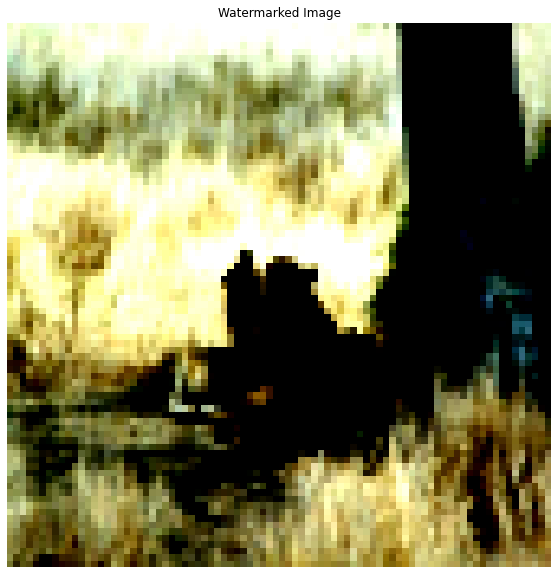

  9%|▉         | 1/11 [00:07<01:19,  7.99s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 8: Target opacity: 0, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


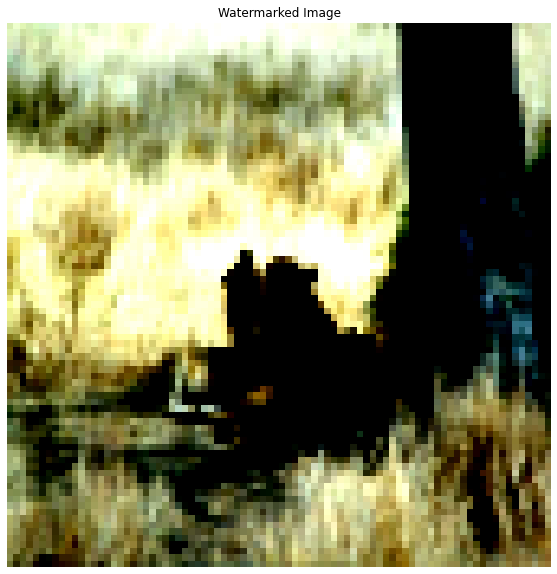

 18%|█▊        | 2/11 [00:16<01:12,  8.02s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 8: Target opacity: 0.05, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


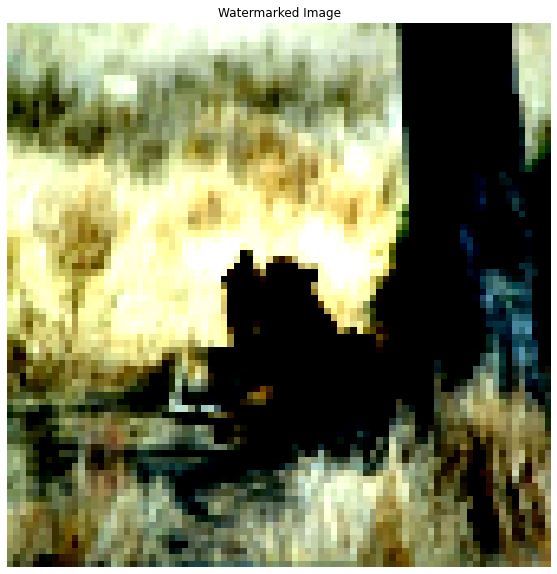

 27%|██▋       | 3/11 [00:24<01:04,  8.03s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 8: Target opacity: 0.1, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: True, Base class predicted: False


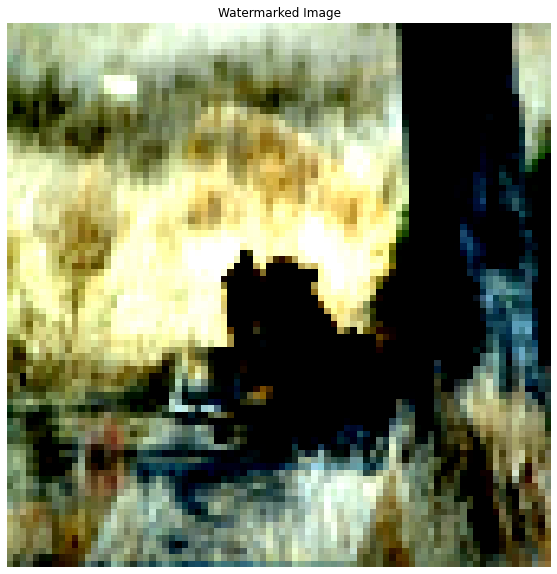

 36%|███▋      | 4/11 [00:32<00:56,  8.03s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 8: Target opacity: 0.15, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: True, Base class predicted: False


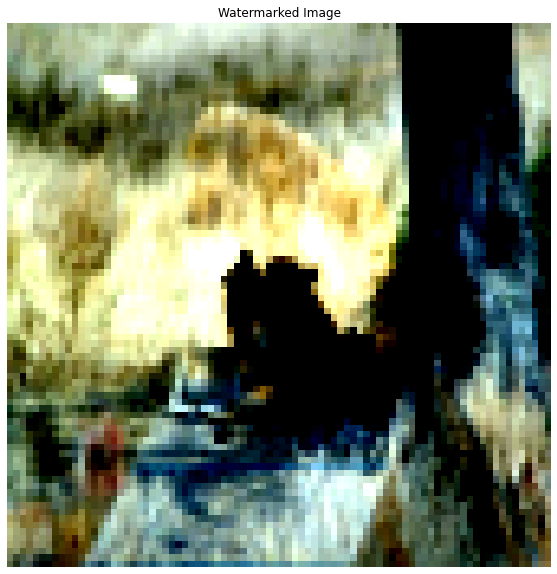

 45%|████▌     | 5/11 [00:40<00:48,  8.04s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 8: Target opacity: 0.2, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: True, Base class predicted: False


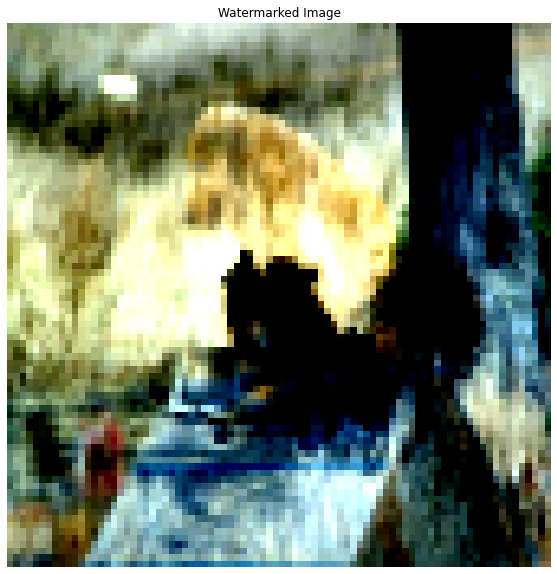

 55%|█████▍    | 6/11 [00:48<00:40,  8.05s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 8: Target opacity: 0.25, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: True, Base class predicted: False


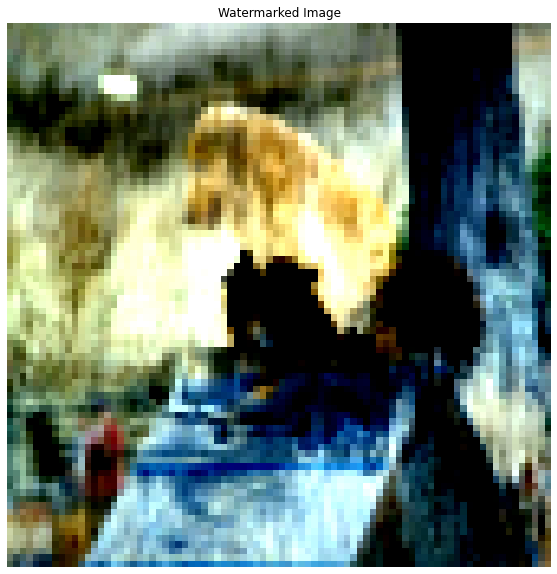

 64%|██████▎   | 7/11 [00:56<00:32,  8.10s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 8: Target opacity: 0.3, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: True, Base class predicted: False


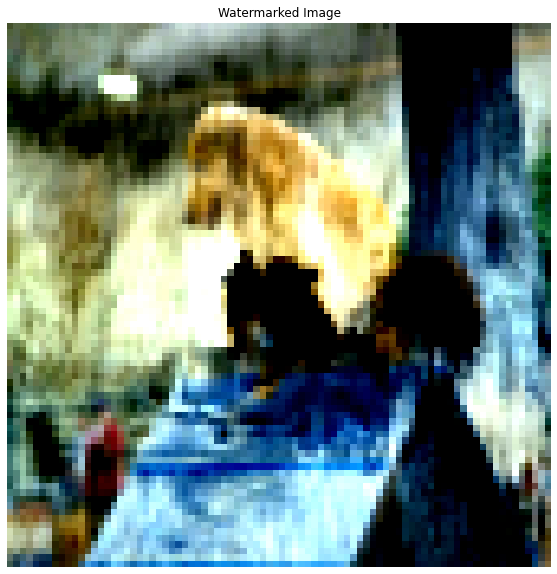

 73%|███████▎  | 8/11 [01:04<00:24,  8.04s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 8: Target opacity: 0.35, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: True, Base class predicted: False


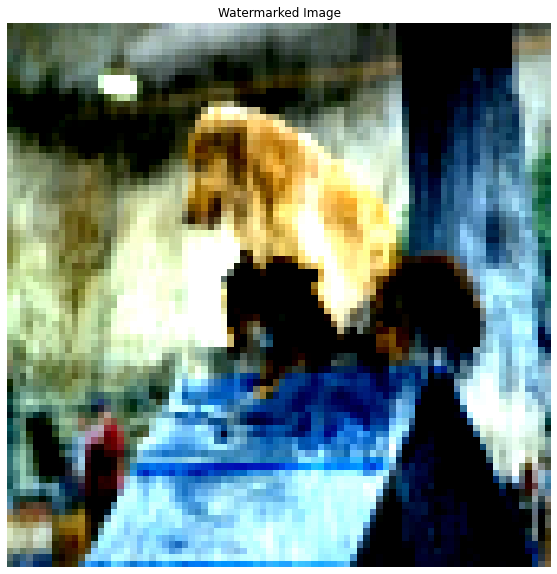

 82%|████████▏ | 9/11 [01:12<00:16,  8.08s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 8: Target opacity: 0.4, Labeled correctly: 0.64, Correctly Predicted Target: False, Base class predicted: True


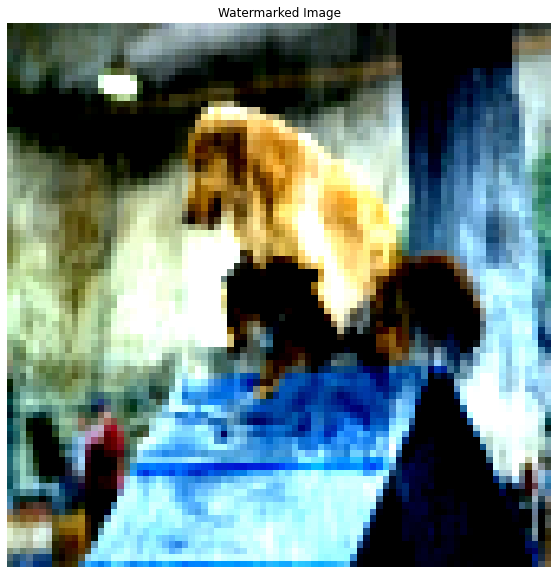

 91%|█████████ | 10/11 [01:20<00:08,  8.07s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 8: Target opacity: 0.45, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: False, Base class predicted: True


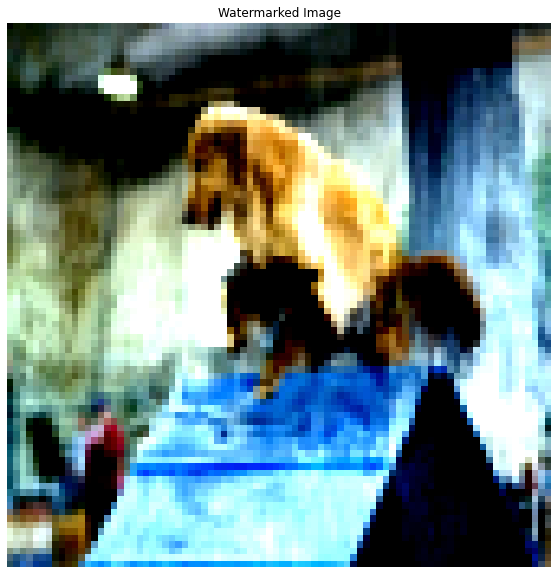

100%|██████████| 11/11 [01:28<00:00,  8.04s/it]

Iteration 8: Target opacity: 0.5, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: False, Base class predicted: True



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


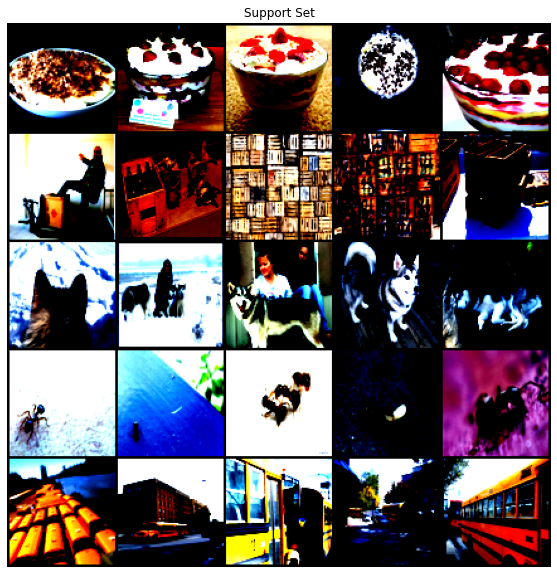

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 1, 1, 1, 1,
         1]])


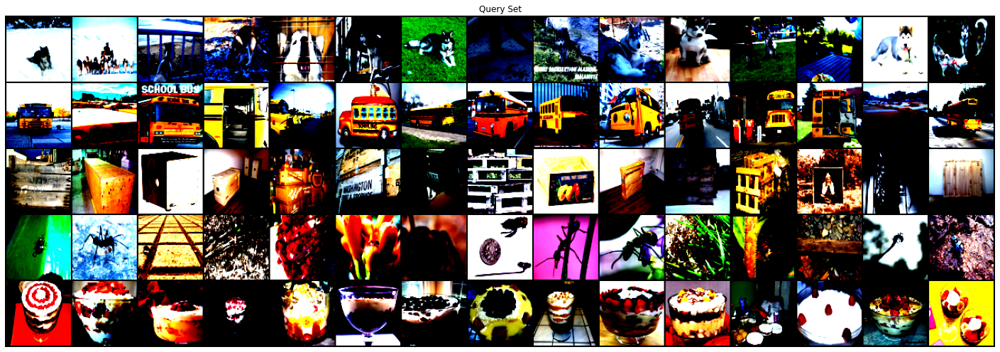

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1,
         1, 1, 1, 1, 1, 1, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 3, 3, 3,
         3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0]])
target_class 3
unique_classes [0, 1, 2, 4]
base_class 1
target_indices [45 46 47 48 49 50 51 52 53 54 55 56 57 58 59]
target_index 49
base_indices [20 21 22 23 24]
base_index 23


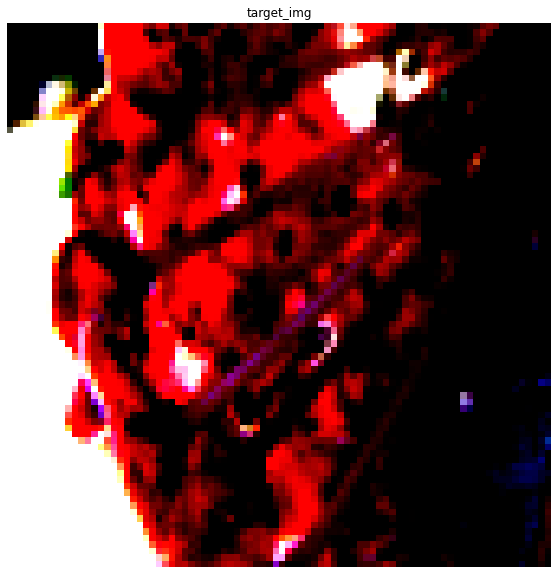

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


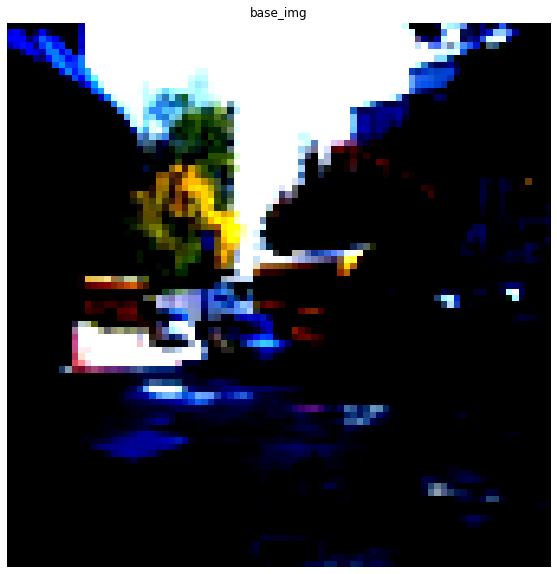

  0%|          | 3/1000 [00:00<00:40, 24.71it/s]

Iteration 0
loss: tensor(7.6194, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(39.6319, grad_fn=<PowBackward0>)
Iteration 2
loss: tensor(39.3442, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(6.5357, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(43.4807, grad_fn=<PowBackward0>)
Iteration 5


  1%|          | 9/1000 [00:00<00:37, 26.41it/s]

loss: tensor(26.4222, grad_fn=<PowBackward0>)
Iteration 6
loss: tensor(19.6885, grad_fn=<PowBackward0>)
Iteration 7
loss: tensor(8.2913, grad_fn=<PowBackward0>)
Iteration 8
loss: tensor(47.8923, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(13.8269, grad_fn=<PowBackward0>)
Iteration 10
loss: tensor(47.2082, grad_fn=<PowBackward0>)


  2%|▏         | 15/1000 [00:00<00:38, 25.36it/s]

Iteration 11
loss: tensor(6.4851, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(13.0123, grad_fn=<PowBackward0>)
Iteration 13
loss: tensor(16.6289, grad_fn=<PowBackward0>)
Iteration 14
loss: tensor(51.3097, grad_fn=<PowBackward0>)
Iteration 15
loss: tensor(5.4308, grad_fn=<PowBackward0>)


  2%|▏         | 21/1000 [00:00<00:38, 25.64it/s]

Iteration 16
loss: tensor(18.2604, grad_fn=<PowBackward0>)
Iteration 17
loss: tensor(22.8731, grad_fn=<PowBackward0>)
Iteration 18
loss: tensor(87.1467, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(16.6206, grad_fn=<PowBackward0>)
Iteration 20
loss: tensor(42.4682, grad_fn=<PowBackward0>)
Iteration 21


  2%|▏         | 24/1000 [00:00<00:37, 25.70it/s]

loss: tensor(2.7319, grad_fn=<PowBackward0>)
Iteration 22
loss: tensor(23.6094, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(10.9475, grad_fn=<PowBackward0>)
Iteration 24
loss: tensor(55.3840, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(10.1079, grad_fn=<PowBackward0>)
Iteration 26
loss: tensor(42.9104, grad_fn=<PowBackward0>)


  3%|▎         | 30/1000 [00:01<00:38, 25.31it/s]

Iteration 27
loss: tensor(14.9686, grad_fn=<PowBackward0>)
Iteration 28
loss: tensor(36.9786, grad_fn=<PowBackward0>)
Iteration 29
loss: tensor(5.7420, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(29.5637, grad_fn=<PowBackward0>)
Iteration 31
loss: tensor(12.1657, grad_fn=<PowBackward0>)
Iteration 32
loss:

  4%|▎         | 36/1000 [00:01<00:38, 24.90it/s]

 tensor(40.2648, grad_fn=<PowBackward0>)
Iteration 33
loss: tensor(5.4756, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(22.0989, grad_fn=<PowBackward0>)
Iteration 35
loss: tensor(19.6056, grad_fn=<PowBackward0>)
Iteration 36
loss: tensor(54.6655, grad_fn=<PowBackward0>)
Iteration 37


  4%|▍         | 42/1000 [00:01<00:38, 24.83it/s]

loss: tensor(4.2990, grad_fn=<PowBackward0>)
Iteration 38
loss: tensor(31.1181, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(47.1034, grad_fn=<PowBackward0>)
Iteration 40
loss: tensor(52.8018, grad_fn=<PowBackward0>)
Iteration 41
loss: tensor(11.9160, grad_fn=<PowBackward0>)
Iteration 42
loss: tensor(29.5492, grad_fn=<PowBackward0>)


  5%|▍         | 48/1000 [00:01<00:37, 25.70it/s]

Iteration 43
loss: tensor(18.3682, grad_fn=<PowBackward0>)
Iteration 44
loss: tensor(47.1968, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(7.1070, grad_fn=<PowBackward0>)
Iteration 46
loss: tensor(28.1305, grad_fn=<PowBackward0>)
Iteration 47
loss: tensor(19.1455, grad_fn=<PowBackward0>)
Iteration 48
loss:

  5%|▌         | 51/1000 [00:02<00:37, 25.61it/s]

 tensor(61.3793, grad_fn=<PowBackward0>)
Iteration 49
loss: tensor(11.0994, grad_fn=<PowBackward0>)
Iteration 50
loss: tensor(33.6243, grad_fn=<PowBackward0>)
Iteration 51
loss: tensor(14.8195, grad_fn=<PowBackward0>)
Iteration 52
loss: tensor(41.8345, grad_fn=<PowBackward0>)
Iteration 53
loss: tensor(16.0161, grad_fn=<PowBackward0>)


  6%|▌         | 57/1000 [00:02<00:36, 25.58it/s]

Iteration 54
loss: tensor(30.8755, grad_fn=<PowBackward0>)
Iteration 55
loss: tensor(15.0964, grad_fn=<PowBackward0>)
Iteration 56
loss: tensor(28.9136, grad_fn=<PowBackward0>)
Iteration 57
loss: tensor(8.1576, grad_fn=<PowBackward0>)
Iteration 58
loss: tensor(48.9720, grad_fn=<PowBackward0>)
Iteration 59
loss: tensor(10.8561, grad_fn=<PowBackward0>)


  6%|▋         | 63/1000 [00:02<00:35, 26.41it/s]

Iteration 60
loss: tensor(24.5664, grad_fn=<PowBackward0>)
Iteration 61
loss: tensor(3.8238, grad_fn=<PowBackward0>)
Iteration 62
loss: tensor(44.4212, grad_fn=<PowBackward0>)
Iteration 63
loss: tensor(5.7598, grad_fn=<PowBackward0>)
Iteration 64
loss: tensor(17.7573, grad_fn=<PowBackward0>)
Iteration 65
loss: tensor(9.7325, grad_fn=<PowBackward0>)


  7%|▋         | 69/1000 [00:02<00:34, 26.94it/s]

Iteration 66
loss: tensor(70.2045, grad_fn=<PowBackward0>)
Iteration 67
loss: tensor(3.3961, grad_fn=<PowBackward0>)
Iteration 68
loss: tensor(8.9456, grad_fn=<PowBackward0>)
Iteration 69
loss: tensor(20.4232, grad_fn=<PowBackward0>)
Iteration 70
loss: tensor(73.9693, grad_fn=<PowBackward0>)
Iteration 71
loss: tensor(7.4181, grad_fn=<PowBackward0>)


  8%|▊         | 75/1000 [00:02<00:34, 27.04it/s]

Iteration 72
loss: tensor(18.9353, grad_fn=<PowBackward0>)
Iteration 73
loss: tensor(5.9850, grad_fn=<PowBackward0>)
Iteration 74
loss: tensor(25.7487, grad_fn=<PowBackward0>)
Iteration 75
loss: tensor(12.0564, grad_fn=<PowBackward0>)
Iteration 76
loss: tensor(21.5582, grad_fn=<PowBackward0>)
Iteration 77
loss: tensor(11.2493, grad_fn=<PowBackward0>)


  8%|▊         | 81/1000 [00:03<00:34, 26.28it/s]

Iteration 78
loss: tensor(64.8941, grad_fn=<PowBackward0>)
Iteration 79
loss: tensor(10.8429, grad_fn=<PowBackward0>)
Iteration 80
loss: tensor(36.3388, grad_fn=<PowBackward0>)
Iteration 81
loss: tensor(5.1897, grad_fn=<PowBackward0>)
Iteration 82
loss: tensor(36.8844, grad_fn=<PowBackward0>)
Iteration 83


  9%|▊         | 87/1000 [00:03<00:34, 26.54it/s]

loss: tensor(14.1098, grad_fn=<PowBackward0>)
Iteration 84
loss: tensor(27.8942, grad_fn=<PowBackward0>)
Iteration 85
loss: tensor(2.9028, grad_fn=<PowBackward0>)
Iteration 86
loss: tensor(20.0844, grad_fn=<PowBackward0>)
Iteration 87
loss: tensor(7.7500, grad_fn=<PowBackward0>)
Iteration 88
loss: tensor(32.3087, grad_fn=<PowBackward0>)


  9%|▉         | 93/1000 [00:03<00:34, 26.07it/s]

Iteration 89
loss: tensor(12.4751, grad_fn=<PowBackward0>)
Iteration 90
loss: tensor(46.2552, grad_fn=<PowBackward0>)
Iteration 91
loss: tensor(16.8254, grad_fn=<PowBackward0>)
Iteration 92
loss: tensor(35.4762, grad_fn=<PowBackward0>)
Iteration 93
loss: tensor(15.7405, grad_fn=<PowBackward0>)


 10%|▉         | 99/1000 [00:03<00:35, 25.43it/s]

Iteration 94
loss: tensor(43.0842, grad_fn=<PowBackward0>)
Iteration 95
loss: tensor(13.9133, grad_fn=<PowBackward0>)
Iteration 96
loss: tensor(47.5632, grad_fn=<PowBackward0>)
Iteration 97
loss: tensor(16.0580, grad_fn=<PowBackward0>)
Iteration 98
loss: tensor(46.0422, grad_fn=<PowBackward0>)
Iteration 99


 10%|█         | 102/1000 [00:03<00:35, 25.56it/s]

loss: tensor(19.9859, grad_fn=<PowBackward0>)
Iteration 100
loss: tensor(60.1194, grad_fn=<PowBackward0>)
Iteration 101
loss: tensor(22.4533, grad_fn=<PowBackward0>)
Iteration 102
loss: tensor(30.3421, grad_fn=<PowBackward0>)
Iteration 103
loss: tensor(39.0234, grad_fn=<PowBackward0>)
Iteration 104
loss: tensor(33.5206, grad_fn=<PowBackward0>)


 11%|█         | 108/1000 [00:04<00:35, 24.89it/s]

Iteration 105
loss: tensor(22.6259, grad_fn=<PowBackward0>)
Iteration 106
loss: tensor(25.5131, grad_fn=<PowBackward0>)
Iteration 107
loss: tensor(22.0203, grad_fn=<PowBackward0>)
Iteration 108
loss: tensor(33.1093, grad_fn=<PowBackward0>)
Iteration 109
loss: tensor(11.1837, grad_fn=<PowBackward0>)
Iteration 110


 11%|█▏        | 114/1000 [00:04<00:35, 25.29it/s]

loss: tensor(23.4876, grad_fn=<PowBackward0>)
Iteration 111
loss: tensor(23.6814, grad_fn=<PowBackward0>)
Iteration 112
loss: tensor(45.2710, grad_fn=<PowBackward0>)
Iteration 113
loss: tensor(14.2244, grad_fn=<PowBackward0>)
Iteration 114
loss: tensor(21.6048, grad_fn=<PowBackward0>)
Iteration 115


 12%|█▏        | 120/1000 [00:04<00:34, 25.21it/s]

loss: tensor(14.1183, grad_fn=<PowBackward0>)
Iteration 116
loss: tensor(45.8585, grad_fn=<PowBackward0>)
Iteration 117
loss: tensor(17.4283, grad_fn=<PowBackward0>)
Iteration 118
loss: tensor(25.5539, grad_fn=<PowBackward0>)
Iteration 119
loss: tensor(12.8217, grad_fn=<PowBackward0>)
Iteration 120
loss: tensor(27.4061, grad_fn=<PowBackward0>)


 13%|█▎        | 126/1000 [00:04<00:34, 25.58it/s]

Iteration 121
loss: tensor(19.6856, grad_fn=<PowBackward0>)
Iteration 122
loss: tensor(35.0120, grad_fn=<PowBackward0>)
Iteration 123
loss: tensor(5.0138, grad_fn=<PowBackward0>)
Iteration 124
loss: tensor(18.7077, grad_fn=<PowBackward0>)
Iteration 125
loss: tensor(1.6351, grad_fn=<PowBackward0>)
Iteration 126


 13%|█▎        | 129/1000 [00:05<00:33, 26.04it/s]

loss: tensor(5.7152, grad_fn=<PowBackward0>)
Iteration 127
loss: tensor(12.7829, grad_fn=<PowBackward0>)
Iteration 128
loss: tensor(39.9956, grad_fn=<PowBackward0>)
Iteration 129
loss: tensor(15.2155, grad_fn=<PowBackward0>)
Iteration 130
loss: tensor(30.9012, grad_fn=<PowBackward0>)
Iteration 131
loss: tensor(8.8398, grad_fn=<PowBackward0>)


 14%|█▎        | 135/1000 [00:05<00:33, 25.88it/s]

Iteration 132
loss: tensor(24.8055, grad_fn=<PowBackward0>)
Iteration 133
loss: tensor(12.3375, grad_fn=<PowBackward0>)
Iteration 134
loss: tensor(31.5671, grad_fn=<PowBackward0>)
Iteration 135
loss: tensor(9.6956, grad_fn=<PowBackward0>)
Iteration 136
loss: tensor(25.6033, grad_fn=<PowBackward0>)
Iteration 137
loss: tensor(5.3895, grad_fn=<PowBackward0>)


 14%|█▍        | 141/1000 [00:05<00:35, 24.51it/s]

Iteration 138
loss: tensor(16.3803, grad_fn=<PowBackward0>)
Iteration 139
loss: tensor(19.5875, grad_fn=<PowBackward0>)
Iteration 140
loss: tensor(37.2489, grad_fn=<PowBackward0>)
Iteration 141
loss: tensor(8.5757, grad_fn=<PowBackward0>)
Iteration 142
loss: tensor(23.1176, grad_fn=<PowBackward0>)

 15%|█▍        | 147/1000 [00:05<00:34, 24.93it/s]


Iteration 143
loss: tensor(1.7945, grad_fn=<PowBackward0>)
Iteration 144
loss: tensor(9.4072, grad_fn=<PowBackward0>)
Iteration 145
loss: tensor(12.8431, grad_fn=<PowBackward0>)
Iteration 146
loss: tensor(52.5474, grad_fn=<PowBackward0>)
Iteration 147
loss: tensor(13.8872, grad_fn=<PowBackward0>)


 15%|█▌        | 153/1000 [00:05<00:33, 25.09it/s]

Iteration 148
loss: tensor(30.0888, grad_fn=<PowBackward0>)
Iteration 149
loss: tensor(9.2751, grad_fn=<PowBackward0>)
Iteration 150
loss: tensor(25.1728, grad_fn=<PowBackward0>)
Iteration 151
loss: tensor(12.8135, grad_fn=<PowBackward0>)
Iteration 152
loss: tensor(21.3039, grad_fn=<PowBackward0>)
Iteration 153


 16%|█▌        | 156/1000 [00:06<00:33, 25.25it/s]

loss: tensor(10.2824, grad_fn=<PowBackward0>)
Iteration 154
loss: tensor(53.2380, grad_fn=<PowBackward0>)
Iteration 155
loss: tensor(14.1135, grad_fn=<PowBackward0>)
Iteration 156
loss: tensor(25.3063, grad_fn=<PowBackward0>)
Iteration 157
loss: tensor(9.7193, grad_fn=<PowBackward0>)
Iteration 158


 16%|█▌        | 162/1000 [00:06<00:33, 25.15it/s]

loss: tensor(35.7791, grad_fn=<PowBackward0>)
Iteration 159
loss: tensor(18.2501, grad_fn=<PowBackward0>)
Iteration 160
loss: tensor(54.9404, grad_fn=<PowBackward0>)
Iteration 161
loss: tensor(11.9763, grad_fn=<PowBackward0>)
Iteration 162
loss: tensor(16.9690, grad_fn=<PowBackward0>)
Iteration 163
loss: tensor(17.3360, grad_fn=<PowBackward0>)


 17%|█▋        | 168/1000 [00:06<00:33, 25.12it/s]

Iteration 164
loss: tensor(45.6020, grad_fn=<PowBackward0>)
Iteration 165
loss: tensor(8.7820, grad_fn=<PowBackward0>)
Iteration 166
loss: tensor(13.7546, grad_fn=<PowBackward0>)
Iteration 167
loss: tensor(9.8876, grad_fn=<PowBackward0>)
Iteration 168
loss: tensor(37.7778, grad_fn=<PowBackward0>)
Iteration 169


 17%|█▋        | 174/1000 [00:06<00:32, 25.42it/s]

loss: tensor(22.1709, grad_fn=<PowBackward0>)
Iteration 170
loss: tensor(77.5388, grad_fn=<PowBackward0>)
Iteration 171
loss: tensor(2.1289, grad_fn=<PowBackward0>)
Iteration 172
loss: tensor(16.8014, grad_fn=<PowBackward0>)
Iteration 173
loss: tensor(18.9161, grad_fn=<PowBackward0>)
Iteration 174
loss: tensor(51.0636, grad_fn=<PowBackward0>)


 18%|█▊        | 180/1000 [00:07<00:31, 26.21it/s]

Iteration 175
loss: tensor(8.8432, grad_fn=<PowBackward0>)
Iteration 176
loss: tensor(19.4255, grad_fn=<PowBackward0>)
Iteration 177
loss: tensor(15.0388, grad_fn=<PowBackward0>)
Iteration 178
loss: tensor(61.5068, grad_fn=<PowBackward0>)
Iteration 179
loss: tensor(0.5616, grad_fn=<PowBackward0>)
Iteration 180
loss:

 18%|█▊        | 183/1000 [00:07<00:31, 25.97it/s]

 tensor(0.7485, grad_fn=<PowBackward0>)
Iteration 181
loss: tensor(3.1369, grad_fn=<PowBackward0>)
Iteration 182
loss: tensor(20.6544, grad_fn=<PowBackward0>)
Iteration 183
loss: tensor(49.9255, grad_fn=<PowBackward0>)
Iteration 184
loss: tensor(34.0694, grad_fn=<PowBackward0>)
Iteration 185


 19%|█▉        | 189/1000 [00:07<00:33, 24.19it/s]

loss: tensor(8.6091, grad_fn=<PowBackward0>)
Iteration 186
loss: tensor(27.9761, grad_fn=<PowBackward0>)
Iteration 187
loss: tensor(12.7475, grad_fn=<PowBackward0>)
Iteration 188
loss: tensor(25.8944, grad_fn=<PowBackward0>)
Iteration 189
loss: tensor(14.2745, grad_fn=<PowBackward0>)
Iteration 190


 20%|█▉        | 195/1000 [00:07<00:31, 25.45it/s]

loss: tensor(25.5560, grad_fn=<PowBackward0>)
Iteration 191
loss: tensor(11.3003, grad_fn=<PowBackward0>)
Iteration 192
loss: tensor(41.8095, grad_fn=<PowBackward0>)
Iteration 193
loss: tensor(9.3934, grad_fn=<PowBackward0>)
Iteration 194
loss: tensor(20.1836, grad_fn=<PowBackward0>)
Iteration 195
loss: tensor(9.4062, grad_fn=<PowBackward0>)
Iteration

 20%|██        | 201/1000 [00:07<00:30, 26.46it/s]

 196
loss: tensor(22.8091, grad_fn=<PowBackward0>)
Iteration 197
loss: tensor(15.1542, grad_fn=<PowBackward0>)
Iteration 198
loss: tensor(37.4866, grad_fn=<PowBackward0>)
Iteration 199
loss: tensor(9.8586, grad_fn=<PowBackward0>)
Iteration 200
loss: tensor(20.7826, grad_fn=<PowBackward0>)
Iteration 201
loss: tensor(18.0088, grad_fn=<PowBackward0>)


 21%|██        | 207/1000 [00:08<00:29, 26.48it/s]

Iteration 202
loss: tensor(13.2222, grad_fn=<PowBackward0>)
Iteration 203
loss: tensor(7.1773, grad_fn=<PowBackward0>)
Iteration 204
loss: tensor(12.2211, grad_fn=<PowBackward0>)
Iteration 205
loss: tensor(7.7092, grad_fn=<PowBackward0>)
Iteration 206
loss: tensor(9.5272, grad_fn=<PowBackward0>)
Iteration 207


 21%|██        | 210/1000 [00:08<00:30, 26.01it/s]

loss: tensor(4.7190, grad_fn=<PowBackward0>)
Iteration 208
loss: tensor(12.4247, grad_fn=<PowBackward0>)
Iteration 209
loss: tensor(6.1708, grad_fn=<PowBackward0>)
Iteration 210
loss: tensor(10.8087, grad_fn=<PowBackward0>)
Iteration 211
loss: tensor(5.7406, grad_fn=<PowBackward0>)
Iteration 212
loss: 

 22%|██▏       | 216/1000 [00:08<00:30, 25.98it/s]

tensor(21.9295, grad_fn=<PowBackward0>)
Iteration 213
loss: tensor(4.6017, grad_fn=<PowBackward0>)
Iteration 214
loss: tensor(12.3559, grad_fn=<PowBackward0>)
Iteration 215
loss: tensor(10.6825, grad_fn=<PowBackward0>)
Iteration 216
loss: tensor(23.9745, grad_fn=<PowBackward0>)
Iteration 217
loss: tensor(5.0739, grad_fn=<PowBackward0>)
Iteration 218

 22%|██▏       | 222/1000 [00:08<00:29, 26.55it/s]


loss: tensor(6.2386, grad_fn=<PowBackward0>)
Iteration 219
loss: tensor(4.5534, grad_fn=<PowBackward0>)
Iteration 220
loss: tensor(12.0993, grad_fn=<PowBackward0>)
Iteration 221
loss: tensor(12.0410, grad_fn=<PowBackward0>)
Iteration 222
loss: tensor(26.3563, grad_fn=<PowBackward0>)
Iteration 223


 23%|██▎       | 228/1000 [00:08<00:28, 27.03it/s]

loss: tensor(6.6654, grad_fn=<PowBackward0>)
Iteration 224
loss: tensor(8.5297, grad_fn=<PowBackward0>)
Iteration 225
loss: tensor(2.3720, grad_fn=<PowBackward0>)
Iteration 226
loss: tensor(6.3385, grad_fn=<PowBackward0>)
Iteration 227
loss: tensor(5.6294, grad_fn=<PowBackward0>)
Iteration 228
loss: tensor(15.2957, grad_fn=<PowBackward0>)
Iteration 229


 23%|██▎       | 231/1000 [00:09<00:29, 26.22it/s]

loss: tensor(9.4811, grad_fn=<PowBackward0>)
Iteration 230
loss: tensor(16.4440, grad_fn=<PowBackward0>)
Iteration 231
loss: tensor(4.1621, grad_fn=<PowBackward0>)
Iteration 232


 24%|██▎       | 237/1000 [00:09<00:33, 22.83it/s]

loss: tensor(11.7979, grad_fn=<PowBackward0>)
Iteration 233
loss: tensor(6.0824, grad_fn=<PowBackward0>)
Iteration 234
loss: tensor(13.1491, grad_fn=<PowBackward0>)
Iteration 235
loss: tensor(6.3536, grad_fn=<PowBackward0>)
Iteration 236
loss: tensor(9.7563, grad_fn=<PowBackward0>)
Iteration 237
loss: tensor(3.9139, grad_fn=<PowBackward0>)


 24%|██▍       | 240/1000 [00:09<00:32, 23.71it/s]

Iteration 238
loss: tensor(11.5040, grad_fn=<PowBackward0>)
Iteration 239
loss: tensor(6.1753, grad_fn=<PowBackward0>)
Iteration 240
loss: tensor(16.3638, grad_fn=<PowBackward0>)
Iteration 241
loss: tensor(6.5067, grad_fn=<PowBackward0>)
Iteration 242
loss: tensor(13.4381, grad_fn=<PowBackward0>)


 25%|██▍       | 246/1000 [00:09<00:31, 24.29it/s]

Iteration 243
loss: tensor(5.0654, grad_fn=<PowBackward0>)
Iteration 244
loss: tensor(11.4073, grad_fn=<PowBackward0>)
Iteration 245
loss: tensor(5.4088, grad_fn=<PowBackward0>)
Iteration 246
loss: tensor(7.4836, grad_fn=<PowBackward0>)
Iteration 247
loss: tensor(5.1089, grad_fn=<PowBackward0>)
Iteration 248
loss: tensor(17.4329, grad_fn=<PowBackward0>)

 25%|██▌       | 252/1000 [00:09<00:30, 24.82it/s]


Iteration 249
loss: tensor(9.1121, grad_fn=<PowBackward0>)
Iteration 250
loss: tensor(14.8622, grad_fn=<PowBackward0>)
Iteration 251
loss: tensor(7.5714, grad_fn=<PowBackward0>)
Iteration 252
loss: tensor(19.1010, grad_fn=<PowBackward0>)
Iteration 253
loss: tensor(4.9398, grad_fn=<PowBackward0>)


 26%|██▌       | 258/1000 [00:10<00:28, 26.20it/s]

Iteration 254
loss: tensor(11.6437, grad_fn=<PowBackward0>)
Iteration 255
loss: tensor(3.7661, grad_fn=<PowBackward0>)
Iteration 256
loss: tensor(15.7108, grad_fn=<PowBackward0>)
Iteration 257
loss: tensor(6.4211, grad_fn=<PowBackward0>)
Iteration 258
loss: tensor(19.3160, grad_fn=<PowBackward0>)
Iteration 259


 26%|██▋       | 264/1000 [00:10<00:28, 25.78it/s]

loss: tensor(6.6828, grad_fn=<PowBackward0>)
Iteration 260
loss: tensor(20.0407, grad_fn=<PowBackward0>)
Iteration 261
loss: tensor(6.3209, grad_fn=<PowBackward0>)
Iteration 262
loss: tensor(9.8617, grad_fn=<PowBackward0>)
Iteration 263
loss: tensor(6.4179, grad_fn=<PowBackward0>)
Iteration 264
loss:

 27%|██▋       | 267/1000 [00:10<00:29, 24.89it/s]

 tensor(12.3360, grad_fn=<PowBackward0>)
Iteration 265
loss: tensor(4.2872, grad_fn=<PowBackward0>)
Iteration 266
loss: tensor(14.8426, grad_fn=<PowBackward0>)
Iteration 267
loss: tensor(5.9606, grad_fn=<PowBackward0>)
Iteration 268
loss: tensor(11.9633, grad_fn=<PowBackward0>)
Iteration 269
loss: tensor(3.8129, grad_fn=<PowBackward0>)


 27%|██▋       | 273/1000 [00:10<00:27, 26.26it/s]

Iteration 270
loss: tensor(12.9341, grad_fn=<PowBackward0>)
Iteration 271
loss: tensor(8.4738, grad_fn=<PowBackward0>)
Iteration 272
loss: tensor(18.0352, grad_fn=<PowBackward0>)
Iteration 273
loss: tensor(6.5708, grad_fn=<PowBackward0>)
Iteration 274
loss: tensor(10.8023, grad_fn=<PowBackward0>)
Iteration 275
loss: tensor(1.9089, grad_fn=<PowBackward0>)


 28%|██▊       | 279/1000 [00:10<00:27, 26.26it/s]

Iteration 276
loss: tensor(5.8762, grad_fn=<PowBackward0>)
Iteration 277
loss: tensor(6.1746, grad_fn=<PowBackward0>)
Iteration 278
loss: tensor(17.0469, grad_fn=<PowBackward0>)
Iteration 279
loss: tensor(5.8337, grad_fn=<PowBackward0>)
Iteration 280
loss: tensor(15.3421, grad_fn=<PowBackward0>)
Iteration 281
loss: tensor(10.5853, grad_fn=<PowBackward0>)


 28%|██▊       | 285/1000 [00:11<00:26, 26.88it/s]

Iteration 282
loss: tensor(21.5413, grad_fn=<PowBackward0>)
Iteration 283
loss: tensor(5.1744, grad_fn=<PowBackward0>)
Iteration 284
loss: tensor(5.9013, grad_fn=<PowBackward0>)
Iteration 285
loss: tensor(2.7007, grad_fn=<PowBackward0>)
Iteration 286
loss: tensor(6.1649, grad_fn=<PowBackward0>)
Iteration 287


 29%|██▉       | 291/1000 [00:11<00:26, 26.27it/s]

loss: tensor(6.7271, grad_fn=<PowBackward0>)
Iteration 288
loss: tensor(13.7983, grad_fn=<PowBackward0>)
Iteration 289
loss: tensor(10.7382, grad_fn=<PowBackward0>)
Iteration 290
loss: tensor(17.2809, grad_fn=<PowBackward0>)
Iteration 291
loss: tensor(2.3155, grad_fn=<PowBackward0>)
Iteration 292
loss: tensor(7.3754, grad_fn=<PowBackward0>)
Iteration 293


 30%|██▉       | 297/1000 [00:11<00:26, 26.16it/s]

loss: tensor(6.6172, grad_fn=<PowBackward0>)
Iteration 294
loss: tensor(16.0926, grad_fn=<PowBackward0>)
Iteration 295
loss: tensor(3.7869, grad_fn=<PowBackward0>)
Iteration 296
loss: tensor(8.3531, grad_fn=<PowBackward0>)
Iteration 297
loss: tensor(7.2020, grad_fn=<PowBackward0>)
Iteration 298


 30%|███       | 303/1000 [00:11<00:28, 24.39it/s]

loss: tensor(17.9298, grad_fn=<PowBackward0>)
Iteration 299
loss: tensor(4.1029, grad_fn=<PowBackward0>)
Iteration 300
loss: tensor(12.4909, grad_fn=<PowBackward0>)
Iteration 301
loss: tensor(10.6036, grad_fn=<PowBackward0>)
Iteration 302
loss: tensor(4.6759, grad_fn=<PowBackward0>)
Iteration 303


 31%|███       | 306/1000 [00:12<00:27, 24.90it/s]

loss: tensor(0.4374, grad_fn=<PowBackward0>)
Iteration 304
loss: tensor(0.6265, grad_fn=<PowBackward0>)
Iteration 305
loss: tensor(0.3042, grad_fn=<PowBackward0>)
Iteration 306
loss: tensor(0.7852, grad_fn=<PowBackward0>)
Iteration 307
loss: tensor(0.7479, grad_fn=<PowBackward0>)
Iteration 308
loss: tensor(2.3926, grad_fn=<PowBackward0>)


 31%|███       | 312/1000 [00:12<00:26, 25.86it/s]

Iteration 309
loss: tensor(2.4112, grad_fn=<PowBackward0>)
Iteration 310
loss: tensor(5.0137, grad_fn=<PowBackward0>)
Iteration 311
loss: tensor(3.9487, grad_fn=<PowBackward0>)
Iteration 312
loss: tensor(5.8881, grad_fn=<PowBackward0>)
Iteration 313
loss: tensor(3.3907, grad_fn=<PowBackward0>)
Iteration 314


 32%|███▏      | 318/1000 [00:12<00:26, 25.72it/s]

loss: tensor(3.4016, grad_fn=<PowBackward0>)
Iteration 315
loss: tensor(1.4500, grad_fn=<PowBackward0>)
Iteration 316
loss: tensor(3.7794, grad_fn=<PowBackward0>)
Iteration 317
loss: tensor(2.4446, grad_fn=<PowBackward0>)
Iteration 318
loss: tensor(4.2812, grad_fn=<PowBackward0>)
Iteration 319
loss: tensor(2.1552, grad_fn=<PowBackward0>)


 32%|███▏      | 324/1000 [00:12<00:26, 25.77it/s]

Iteration 320
loss: tensor(5.0547, grad_fn=<PowBackward0>)
Iteration 321
loss: tensor(4.0650, grad_fn=<PowBackward0>)
Iteration 322
loss: tensor(5.9179, grad_fn=<PowBackward0>)
Iteration 323
loss: tensor(2.3102, grad_fn=<PowBackward0>)
Iteration 324
loss: tensor(2.7858, grad_fn=<PowBackward0>)
Iteration 325


 33%|███▎      | 330/1000 [00:12<00:25, 26.54it/s]

loss: tensor(1.4485, grad_fn=<PowBackward0>)
Iteration 326
loss: tensor(2.3006, grad_fn=<PowBackward0>)
Iteration 327
loss: tensor(1.3549, grad_fn=<PowBackward0>)
Iteration 328
loss: tensor(2.4341, grad_fn=<PowBackward0>)
Iteration 329
loss: tensor(1.5055, grad_fn=<PowBackward0>)
Iteration 330
loss: tensor(2.4741, grad_fn=<PowBackward0>)
Iteration 331


 34%|███▎      | 336/1000 [00:13<00:25, 26.39it/s]

loss: tensor(1.4092, grad_fn=<PowBackward0>)
Iteration 332
loss: tensor(2.9502, grad_fn=<PowBackward0>)
Iteration 333
loss: tensor(2.4222, grad_fn=<PowBackward0>)
Iteration 334
loss: tensor(4.1046, grad_fn=<PowBackward0>)
Iteration 335
loss: tensor(2.8838, grad_fn=<PowBackward0>)
Iteration 336
loss: tensor(2.9824, grad_fn=<PowBackward0>)


 34%|███▍      | 342/1000 [00:13<00:25, 26.09it/s]

Iteration 337
loss: tensor(1.8579, grad_fn=<PowBackward0>)
Iteration 338
loss: tensor(3.4869, grad_fn=<PowBackward0>)
Iteration 339
loss: tensor(2.5248, grad_fn=<PowBackward0>)
Iteration 340
loss: tensor(3.7114, grad_fn=<PowBackward0>)
Iteration 341
loss: tensor(2.3438, grad_fn=<PowBackward0>)
Iteration 342


 34%|███▍      | 345/1000 [00:13<00:25, 26.05it/s]

loss: tensor(3.5337, grad_fn=<PowBackward0>)
Iteration 343
loss: tensor(2.5187, grad_fn=<PowBackward0>)
Iteration 344
loss: tensor(3.8110, grad_fn=<PowBackward0>)
Iteration 345
loss: tensor(2.3002, grad_fn=<PowBackward0>)
Iteration 346
loss: tensor(6.1535, grad_fn=<PowBackward0>)
Iteration 347
loss: tensor(4.8829, grad_fn=<PowBackward0>)


 35%|███▌      | 351/1000 [00:13<00:24, 26.51it/s]

Iteration 348
loss: tensor(9.4963, grad_fn=<PowBackward0>)
Iteration 349
loss: tensor(3.0924, grad_fn=<PowBackward0>)
Iteration 350
loss: tensor(2.9013, grad_fn=<PowBackward0>)
Iteration 351
loss: tensor(1.0888, grad_fn=<PowBackward0>)
Iteration 352
loss: tensor(1.6368, grad_fn=<PowBackward0>)
Iteration 353
loss:

 36%|███▌      | 357/1000 [00:13<00:24, 26.56it/s]

 tensor(0.9923, grad_fn=<PowBackward0>)
Iteration 354
loss: tensor(2.0571, grad_fn=<PowBackward0>)
Iteration 355
loss: tensor(1.6934, grad_fn=<PowBackward0>)
Iteration 356
loss: tensor(3.2889, grad_fn=<PowBackward0>)
Iteration 357
loss: tensor(2.1038, grad_fn=<PowBackward0>)
Iteration 358
loss: tensor(4.2752, grad_fn=<PowBackward0>)
Iteration 359


 36%|███▋      | 363/1000 [00:14<00:24, 25.60it/s]

loss: tensor(1.5124, grad_fn=<PowBackward0>)
Iteration 360
loss: tensor(2.5006, grad_fn=<PowBackward0>)
Iteration 361
loss: tensor(2.1939, grad_fn=<PowBackward0>)
Iteration 362
loss: tensor(4.6372, grad_fn=<PowBackward0>)
Iteration 363
loss: tensor(2.8986, grad_fn=<PowBackward0>)
Iteration 364


 37%|███▋      | 369/1000 [00:14<00:25, 25.19it/s]

loss: tensor(4.3497, grad_fn=<PowBackward0>)
Iteration 365
loss: tensor(2.6211, grad_fn=<PowBackward0>)
Iteration 366
loss: tensor(3.4057, grad_fn=<PowBackward0>)
Iteration 367
loss: tensor(1.4418, grad_fn=<PowBackward0>)
Iteration 368
loss: tensor(2.4214, grad_fn=<PowBackward0>)
Iteration 369


 37%|███▋      | 372/1000 [00:14<00:24, 25.50it/s]

loss: tensor(1.5685, grad_fn=<PowBackward0>)
Iteration 370
loss: tensor(3.1327, grad_fn=<PowBackward0>)
Iteration 371
loss: tensor(2.4124, grad_fn=<PowBackward0>)
Iteration 372
loss: tensor(4.6035, grad_fn=<PowBackward0>)
Iteration 373
loss: tensor(3.1232, grad_fn=<PowBackward0>)
Iteration 374
loss: tensor(4.4220, grad_fn=<PowBackward0>)


 38%|███▊      | 378/1000 [00:14<00:24, 25.82it/s]

Iteration 375
loss: tensor(2.5744, grad_fn=<PowBackward0>)
Iteration 376
loss: tensor(2.7154, grad_fn=<PowBackward0>)
Iteration 377
loss: tensor(1.5327, grad_fn=<PowBackward0>)
Iteration 378
loss: tensor(2.7177, grad_fn=<PowBackward0>)
Iteration 379
loss: tensor(1.4863, grad_fn=<PowBackward0>)
Iteration 380


 38%|███▊      | 384/1000 [00:15<00:23, 26.21it/s]

loss: tensor(4.4222, grad_fn=<PowBackward0>)
Iteration 381
loss: tensor(3.8243, grad_fn=<PowBackward0>)
Iteration 382
loss: tensor(7.9694, grad_fn=<PowBackward0>)
Iteration 383
loss: tensor(3.0347, grad_fn=<PowBackward0>)
Iteration 384
loss: tensor(2.2994, grad_fn=<PowBackward0>)
Iteration 385
loss: tensor(0.7736, grad_fn=<PowBackward0>)
Iteration

 39%|███▉      | 390/1000 [00:15<00:23, 26.40it/s]

 386
loss: tensor(1.0844, grad_fn=<PowBackward0>)
Iteration 387
loss: tensor(0.4946, grad_fn=<PowBackward0>)
Iteration 388
loss: tensor(1.0486, grad_fn=<PowBackward0>)
Iteration 389
loss: tensor(0.7246, grad_fn=<PowBackward0>)
Iteration 390
loss: tensor(2.1459, grad_fn=<PowBackward0>)
Iteration 391


 40%|███▉      | 396/1000 [00:15<00:22, 26.62it/s]

loss: tensor(2.0580, grad_fn=<PowBackward0>)
Iteration 392
loss: tensor(7.4721, grad_fn=<PowBackward0>)
Iteration 393
loss: tensor(5.8051, grad_fn=<PowBackward0>)
Iteration 394
loss: tensor(6.8797, grad_fn=<PowBackward0>)
Iteration 395
loss: tensor(2.4563, grad_fn=<PowBackward0>)
Iteration 396
loss: tensor(2.0866, grad_fn=<PowBackward0>)


 40%|████      | 402/1000 [00:15<00:22, 26.38it/s]

Iteration 397
loss: tensor(0.6746, grad_fn=<PowBackward0>)
Iteration 398
loss: tensor(0.9698, grad_fn=<PowBackward0>)
Iteration 399
loss: tensor(0.4332, grad_fn=<PowBackward0>)
Iteration 400
loss: tensor(0.8924, grad_fn=<PowBackward0>)
Iteration 401
loss: tensor(0.8593, grad_fn=<PowBackward0>)
Iteration 402
loss: tensor(0.3153, grad_fn=<PowBackward0>)

 40%|████      | 405/1000 [00:15<00:22, 26.11it/s]


Iteration 403
loss: tensor(0.1831, grad_fn=<PowBackward0>)
Iteration 404
loss: tensor(0.2161, grad_fn=<PowBackward0>)
Iteration 405
loss: tensor(0.1839, grad_fn=<PowBackward0>)
Iteration 406
loss: tensor(0.1644, grad_fn=<PowBackward0>)
Iteration 407
loss: tensor(0.1297, grad_fn=<PowBackward0>)


 41%|████      | 411/1000 [00:16<00:22, 26.35it/s]

Iteration 408
loss: tensor(0.1612, grad_fn=<PowBackward0>)
Iteration 409
loss: tensor(0.1395, grad_fn=<PowBackward0>)
Iteration 410
loss: tensor(0.2127, grad_fn=<PowBackward0>)
Iteration 411
loss: tensor(0.1149, grad_fn=<PowBackward0>)
Iteration 412
loss: tensor(0.1540, grad_fn=<PowBackward0>)
Iteration 413
loss: tensor(0.1393, grad_fn=<PowBackward0>)


 42%|████▏     | 417/1000 [00:16<00:21, 26.63it/s]

Iteration 414
loss: tensor(0.3162, grad_fn=<PowBackward0>)
Iteration 415
loss: tensor(0.2282, grad_fn=<PowBackward0>)
Iteration 416
loss: tensor(0.2344, grad_fn=<PowBackward0>)
Iteration 417
loss: tensor(0.1518, grad_fn=<PowBackward0>)
Iteration 418
loss: tensor(0.1990, grad_fn=<PowBackward0>)
Iteration 419


 42%|████▏     | 423/1000 [00:16<00:21, 26.24it/s]

loss: tensor(0.1744, grad_fn=<PowBackward0>)
Iteration 420
loss: tensor(0.1847, grad_fn=<PowBackward0>)
Iteration 421
loss: tensor(0.1627, grad_fn=<PowBackward0>)
Iteration 422
loss: tensor(0.1847, grad_fn=<PowBackward0>)
Iteration 423
loss: tensor(0.1677, grad_fn=<PowBackward0>)
Iteration 424
loss: tensor(0.1782, grad_fn=<PowBackward0>)


 43%|████▎     | 429/1000 [00:16<00:21, 27.02it/s]

Iteration 425
loss: tensor(0.1986, grad_fn=<PowBackward0>)
Iteration 426
loss: tensor(0.1678, grad_fn=<PowBackward0>)
Iteration 427
loss: tensor(0.1893, grad_fn=<PowBackward0>)
Iteration 428
loss: tensor(0.1693, grad_fn=<PowBackward0>)
Iteration 429
loss: tensor(0.1814, grad_fn=<PowBackward0>)
Iteration 430
loss: tensor(0.1754, grad_fn=<PowBackward0>)


 44%|████▎     | 435/1000 [00:16<00:21, 26.25it/s]

Iteration 431
loss: tensor(0.1752, grad_fn=<PowBackward0>)
Iteration 432
loss: tensor(0.2044, grad_fn=<PowBackward0>)
Iteration 433
loss: tensor(0.1670, grad_fn=<PowBackward0>)
Iteration 434
loss: tensor(0.1831, grad_fn=<PowBackward0>)
Iteration 435
loss: tensor(0.1955, grad_fn=<PowBackward0>)


 44%|████▍     | 441/1000 [00:17<00:21, 26.05it/s]

Iteration 436
loss: tensor(0.1722, grad_fn=<PowBackward0>)
Iteration 437
loss: tensor(0.2032, grad_fn=<PowBackward0>)
Iteration 438
loss: tensor(0.1429, grad_fn=<PowBackward0>)
Iteration 439
loss: tensor(0.1722, grad_fn=<PowBackward0>)
Iteration 440
loss: tensor(0.1673, grad_fn=<PowBackward0>)
Iteration 441


 44%|████▍     | 444/1000 [00:17<00:21, 26.23it/s]

loss: tensor(0.1726, grad_fn=<PowBackward0>)
Iteration 442
loss: tensor(0.1566, grad_fn=<PowBackward0>)
Iteration 443
loss: tensor(0.1771, grad_fn=<PowBackward0>)
Iteration 444
loss: tensor(0.1614, grad_fn=<PowBackward0>)
Iteration 445
loss: tensor(0.1711, grad_fn=<PowBackward0>)
Iteration 446
loss: tensor(0.1925, grad_fn=<PowBackward0>)


 45%|████▌     | 450/1000 [00:17<00:21, 25.88it/s]

Iteration 447
loss: tensor(0.1612, grad_fn=<PowBackward0>)
Iteration 448
loss: tensor(0.1885, grad_fn=<PowBackward0>)
Iteration 449
loss: tensor(0.1590, grad_fn=<PowBackward0>)
Iteration 450
loss: tensor(0.1805, grad_fn=<PowBackward0>)
Iteration 451
loss: tensor(0.1635, grad_fn=<PowBackward0>)
Iteration 452
loss: tensor(0.1715, grad_fn=<PowBackward0>)


 46%|████▌     | 456/1000 [00:17<00:20, 26.35it/s]

Iteration 453
loss: tensor(0.1921, grad_fn=<PowBackward0>)
Iteration 454
loss: tensor(0.1632, grad_fn=<PowBackward0>)
Iteration 455
loss: tensor(0.1811, grad_fn=<PowBackward0>)
Iteration 456
loss: tensor(0.1632, grad_fn=<PowBackward0>)
Iteration 457
loss: tensor(0.1813, grad_fn=<PowBackward0>)
Iteration 458


 46%|████▌     | 462/1000 [00:18<00:20, 26.47it/s]

loss: tensor(0.1644, grad_fn=<PowBackward0>)
Iteration 459
loss: tensor(0.1744, grad_fn=<PowBackward0>)
Iteration 460
loss: tensor(0.1965, grad_fn=<PowBackward0>)
Iteration 461
loss: tensor(0.1379, grad_fn=<PowBackward0>)
Iteration 462
loss: tensor(0.1687, grad_fn=<PowBackward0>)
Iteration 463
loss: tensor(0.1421, grad_fn=<PowBackward0>)
Iteration 464


 47%|████▋     | 468/1000 [00:18<00:19, 27.15it/s]

loss: tensor(0.1807, grad_fn=<PowBackward0>)
Iteration 465
loss: tensor(0.1488, grad_fn=<PowBackward0>)
Iteration 466
loss: tensor(0.1792, grad_fn=<PowBackward0>)
Iteration 467
loss: tensor(0.1803, grad_fn=<PowBackward0>)
Iteration 468
loss: tensor(0.1671, grad_fn=<PowBackward0>)
Iteration 469
loss: tensor(0.1807, grad_fn=<PowBackward0>)
Iteration 470


 47%|████▋     | 474/1000 [00:18<00:19, 26.43it/s]

loss: tensor(0.1625, grad_fn=<PowBackward0>)
Iteration 471
loss: tensor(0.1841, grad_fn=<PowBackward0>)
Iteration 472
loss: tensor(0.1602, grad_fn=<PowBackward0>)
Iteration 473
loss: tensor(0.1794, grad_fn=<PowBackward0>)
Iteration 474
loss: tensor(0.1627, grad_fn=<PowBackward0>)
Iteration 475
loss: tensor(0.1741, grad_fn=<PowBackward0>)


 48%|████▊     | 477/1000 [00:18<00:19, 26.53it/s]

Iteration 476
loss: tensor(0.1653, grad_fn=<PowBackward0>)
Iteration 477
loss: tensor(0.1707, grad_fn=<PowBackward0>)
Iteration 478
loss: tensor(0.1914, grad_fn=<PowBackward0>)
Iteration 479
loss: tensor(0.1617, grad_fn=<PowBackward0>)


 48%|████▊     | 480/1000 [00:18<00:25, 20.65it/s]

Iteration 480
loss: tensor(0.1788, grad_fn=<PowBackward0>)
Iteration 481
loss: tensor(0.1650, grad_fn=<PowBackward0>)
Iteration 482


 49%|████▊     | 486/1000 [00:19<00:28, 18.12it/s]

loss: tensor(0.1696, grad_fn=<PowBackward0>)
Iteration 483
loss: tensor(0.1962, grad_fn=<PowBackward0>)
Iteration 484
loss: tensor(0.1597, grad_fn=<PowBackward0>)
Iteration 485
loss: tensor(0.1878, grad_fn=<PowBackward0>)
Iteration 486
loss: tensor(0.1403, grad_fn=<PowBackward0>)


 49%|████▉     | 492/1000 [00:19<00:24, 20.84it/s]

Iteration 487
loss: tensor(0.1693, grad_fn=<PowBackward0>)
Iteration 488
loss: tensor(0.1453, grad_fn=<PowBackward0>)
Iteration 489
loss: tensor(0.1745, grad_fn=<PowBackward0>)
Iteration 490
loss: tensor(0.1774, grad_fn=<PowBackward0>)
Iteration 491
loss: tensor(0.1646, grad_fn=<PowBackward0>)


 50%|████▉     | 495/1000 [00:19<00:23, 21.68it/s]

Iteration 492
loss: tensor(0.1766, grad_fn=<PowBackward0>)
Iteration 493
loss: tensor(0.1636, grad_fn=<PowBackward0>)
Iteration 494
loss: tensor(0.1780, grad_fn=<PowBackward0>)
Iteration 495
loss: tensor(0.1630, grad_fn=<PowBackward0>)
Iteration 496
loss: tensor(0.1766, grad_fn=<PowBackward0>)
Iteration 497
loss:

 50%|█████     | 501/1000 [00:19<00:20, 24.31it/s]

 tensor(0.1646, grad_fn=<PowBackward0>)
Iteration 498
loss: tensor(0.1694, grad_fn=<PowBackward0>)
Iteration 499
loss: tensor(0.1691, grad_fn=<PowBackward0>)
Iteration 500
loss: tensor(0.1663, grad_fn=<PowBackward0>)
Iteration 501
loss: tensor(0.1507, grad_fn=<PowBackward0>)
Iteration 502
loss: tensor(0.1519, grad_fn=<PowBackward0>)
Iteration

 51%|█████     | 507/1000 [00:20<00:19, 25.41it/s]

 503
loss: tensor(0.1667, grad_fn=<PowBackward0>)
Iteration 504
loss: tensor(0.1560, grad_fn=<PowBackward0>)
Iteration 505
loss: tensor(0.1580, grad_fn=<PowBackward0>)
Iteration 506
loss: tensor(0.1620, grad_fn=<PowBackward0>)
Iteration 507
loss: tensor(0.1601, grad_fn=<PowBackward0>)
Iteration 508


 51%|█████▏    | 513/1000 [00:20<00:18, 26.18it/s]

loss: tensor(0.1727, grad_fn=<PowBackward0>)
Iteration 509
loss: tensor(0.1621, grad_fn=<PowBackward0>)
Iteration 510
loss: tensor(0.1633, grad_fn=<PowBackward0>)
Iteration 511
loss: tensor(0.1774, grad_fn=<PowBackward0>)
Iteration 512
loss: tensor(0.1625, grad_fn=<PowBackward0>)
Iteration 513
loss: tensor(0.1641, grad_fn=<PowBackward0>)


 52%|█████▏    | 519/1000 [00:20<00:18, 26.67it/s]

Iteration 514
loss: tensor(0.1812, grad_fn=<PowBackward0>)
Iteration 515
loss: tensor(0.1627, grad_fn=<PowBackward0>)
Iteration 516
loss: tensor(0.1666, grad_fn=<PowBackward0>)
Iteration 517
loss: tensor(0.1517, grad_fn=<PowBackward0>)
Iteration 518
loss: tensor(0.1547, grad_fn=<PowBackward0>)
Iteration 519


 52%|█████▏    | 522/1000 [00:20<00:18, 25.60it/s]

loss: tensor(0.1669, grad_fn=<PowBackward0>)
Iteration 520
loss: tensor(0.1569, grad_fn=<PowBackward0>)
Iteration 521
loss: tensor(0.1590, grad_fn=<PowBackward0>)
Iteration 522
loss: tensor(0.1632, grad_fn=<PowBackward0>)
Iteration 523
loss: tensor(0.1629, grad_fn=<PowBackward0>)
Iteration 524
loss: tensor(0.1725, grad_fn=<PowBackward0>)


 53%|█████▎    | 528/1000 [00:20<00:17, 26.36it/s]

Iteration 525
loss: tensor(0.1635, grad_fn=<PowBackward0>)
Iteration 526
loss: tensor(0.1634, grad_fn=<PowBackward0>)
Iteration 527
loss: tensor(0.1767, grad_fn=<PowBackward0>)
Iteration 528
loss: tensor(0.1637, grad_fn=<PowBackward0>)
Iteration 529
loss: tensor(0.1653, grad_fn=<PowBackward0>)
Iteration 530
loss: tensor(0.1805, grad_fn=<PowBackward0>)


 53%|█████▎    | 534/1000 [00:21<00:17, 25.95it/s]

Iteration 531
loss: tensor(0.1641, grad_fn=<PowBackward0>)
Iteration 532
loss: tensor(0.1658, grad_fn=<PowBackward0>)
Iteration 533
loss: tensor(0.1826, grad_fn=<PowBackward0>)
Iteration 534
loss: tensor(0.1640, grad_fn=<PowBackward0>)
Iteration 535
loss: tensor(0.1668, grad_fn=<PowBackward0>)
Iteration 536


 54%|█████▍    | 540/1000 [00:21<00:17, 26.72it/s]

loss: tensor(0.1697, grad_fn=<PowBackward0>)
Iteration 537
loss: tensor(0.1649, grad_fn=<PowBackward0>)
Iteration 538
loss: tensor(0.1792, grad_fn=<PowBackward0>)
Iteration 539
loss: tensor(0.1660, grad_fn=<PowBackward0>)
Iteration 540
loss: tensor(0.1670, grad_fn=<PowBackward0>)
Iteration 541
loss: tensor(0.1809, grad_fn=<PowBackward0>)


 55%|█████▍    | 546/1000 [00:21<00:16, 27.32it/s]

Iteration 542
loss: tensor(0.1663, grad_fn=<PowBackward0>)
Iteration 543
loss: tensor(0.1679, grad_fn=<PowBackward0>)
Iteration 544
loss: tensor(0.1820, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(0.1656, grad_fn=<PowBackward0>)
Iteration 546
loss: tensor(0.1686, grad_fn=<PowBackward0>)
Iteration 547


 55%|█████▌    | 552/1000 [00:21<00:17, 25.93it/s]

loss: tensor(0.1822, grad_fn=<PowBackward0>)
Iteration 548
loss: tensor(0.1659, grad_fn=<PowBackward0>)
Iteration 549
loss: tensor(0.1675, grad_fn=<PowBackward0>)
Iteration 550
loss: tensor(0.1705, grad_fn=<PowBackward0>)
Iteration 551
loss: tensor(0.1515, grad_fn=<PowBackward0>)
Iteration 552
loss: tensor(0.1702, grad_fn=<PowBackward0>)


 56%|█████▌    | 558/1000 [00:21<00:17, 25.87it/s]

Iteration 553
loss: tensor(0.1590, grad_fn=<PowBackward0>)
Iteration 554
loss: tensor(0.1597, grad_fn=<PowBackward0>)
Iteration 555
loss: tensor(0.1779, grad_fn=<PowBackward0>)
Iteration 556
loss: tensor(0.1606, grad_fn=<PowBackward0>)
Iteration 557
loss: tensor(0.1644, grad_fn=<PowBackward0>)
Iteration 558


 56%|█████▌    | 561/1000 [00:22<00:16, 26.66it/s]

loss: tensor(0.1664, grad_fn=<PowBackward0>)
Iteration 559
loss: tensor(0.1646, grad_fn=<PowBackward0>)
Iteration 560
loss: tensor(0.1767, grad_fn=<PowBackward0>)
Iteration 561
loss: tensor(0.1639, grad_fn=<PowBackward0>)
Iteration 562
loss: tensor(0.1657, grad_fn=<PowBackward0>)
Iteration 563
loss: tensor(0.1799, grad_fn=<PowBackward0>)


 57%|█████▋    | 567/1000 [00:22<00:16, 26.01it/s]

Iteration 564
loss: tensor(0.1645, grad_fn=<PowBackward0>)
Iteration 565
loss: tensor(0.1657, grad_fn=<PowBackward0>)
Iteration 566
loss: tensor(0.1830, grad_fn=<PowBackward0>)
Iteration 567
loss: tensor(0.1640, grad_fn=<PowBackward0>)
Iteration 568
loss: tensor(0.1677, grad_fn=<PowBackward0>)
Iteration 569
loss:

 57%|█████▋    | 573/1000 [00:22<00:16, 25.23it/s]

 tensor(0.1687, grad_fn=<PowBackward0>)
Iteration 570
loss: tensor(0.1660, grad_fn=<PowBackward0>)
Iteration 571
loss: tensor(0.1795, grad_fn=<PowBackward0>)
Iteration 572
loss: tensor(0.1661, grad_fn=<PowBackward0>)
Iteration 573
loss: tensor(0.1660, grad_fn=<PowBackward0>)
Iteration 574


 58%|█████▊    | 579/1000 [00:22<00:16, 26.29it/s]

loss: tensor(0.1807, grad_fn=<PowBackward0>)
Iteration 575
loss: tensor(0.1671, grad_fn=<PowBackward0>)
Iteration 576
loss: tensor(0.1661, grad_fn=<PowBackward0>)
Iteration 577
loss: tensor(0.1828, grad_fn=<PowBackward0>)
Iteration 578
loss: tensor(0.1653, grad_fn=<PowBackward0>)
Iteration 579
loss: tensor(0.1672, grad_fn=<PowBackward0>)
Iteration 580


 58%|█████▊    | 585/1000 [00:22<00:15, 26.38it/s]

loss: tensor(0.1852, grad_fn=<PowBackward0>)
Iteration 581
loss: tensor(0.1652, grad_fn=<PowBackward0>)
Iteration 582
loss: tensor(0.1702, grad_fn=<PowBackward0>)
Iteration 583
loss: tensor(0.1696, grad_fn=<PowBackward0>)
Iteration 584
loss: tensor(0.1678, grad_fn=<PowBackward0>)
Iteration 585
loss: tensor(0.1813, grad_fn=<PowBackward0>)


 59%|█████▉    | 591/1000 [00:23<00:15, 26.44it/s]

Iteration 586
loss: tensor(0.1494, grad_fn=<PowBackward0>)
Iteration 587
loss: tensor(0.1550, grad_fn=<PowBackward0>)
Iteration 588
loss: tensor(0.1711, grad_fn=<PowBackward0>)
Iteration 589
loss: tensor(0.1552, grad_fn=<PowBackward0>)
Iteration 590
loss: tensor(0.1642, grad_fn=<PowBackward0>)
Iteration 591
loss: tensor(0.1612, grad_fn=<PowBackward0>)


 60%|█████▉    | 597/1000 [00:23<00:14, 27.04it/s]

Iteration 592
loss: tensor(0.1622, grad_fn=<PowBackward0>)
Iteration 593
loss: tensor(0.1778, grad_fn=<PowBackward0>)
Iteration 594
loss: tensor(0.1619, grad_fn=<PowBackward0>)
Iteration 595
loss: tensor(0.1655, grad_fn=<PowBackward0>)
Iteration 596
loss: tensor(0.1664, grad_fn=<PowBackward0>)
Iteration 597
loss: 

 60%|██████    | 600/1000 [00:23<00:15, 26.01it/s]

tensor(0.1649, grad_fn=<PowBackward0>)
Iteration 598
loss: tensor(0.1788, grad_fn=<PowBackward0>)
Iteration 599
loss: tensor(0.1650, grad_fn=<PowBackward0>)
Iteration 600
loss: tensor(0.1645, grad_fn=<PowBackward0>)
Iteration 601
loss: tensor(0.1563, grad_fn=<PowBackward0>)
Iteration 602
loss: tensor(0.1539, grad_fn=<PowBackward0>)


 61%|██████    | 606/1000 [00:23<00:15, 25.96it/s]

Iteration 603
loss: tensor(0.1594, grad_fn=<PowBackward0>)
Iteration 604
loss: tensor(0.1590, grad_fn=<PowBackward0>)
Iteration 605
loss: tensor(0.1601, grad_fn=<PowBackward0>)
Iteration 606
loss: tensor(0.1673, grad_fn=<PowBackward0>)
Iteration 607
loss: tensor(0.1611, grad_fn=<PowBackward0>)
Iteration 608


 61%|██████    | 612/1000 [00:24<00:15, 25.81it/s]

loss: tensor(0.1619, grad_fn=<PowBackward0>)
Iteration 609
loss: tensor(0.1698, grad_fn=<PowBackward0>)
Iteration 610
loss: tensor(0.1622, grad_fn=<PowBackward0>)
Iteration 611
loss: tensor(0.1623, grad_fn=<PowBackward0>)
Iteration 612
loss: tensor(0.1718, grad_fn=<PowBackward0>)
Iteration 613
loss: tensor(0.1628, grad_fn=<PowBackward0>)


 62%|██████▏   | 618/1000 [00:24<00:14, 26.21it/s]

Iteration 614
loss: tensor(0.1633, grad_fn=<PowBackward0>)
Iteration 615
loss: tensor(0.1730, grad_fn=<PowBackward0>)
Iteration 616
loss: tensor(0.1637, grad_fn=<PowBackward0>)
Iteration 617
loss: tensor(0.1640, grad_fn=<PowBackward0>)
Iteration 618
loss: tensor(0.1658, grad_fn=<PowBackward0>)
Iteration 619


 62%|██████▏   | 624/1000 [00:24<00:14, 26.85it/s]

loss: tensor(0.1657, grad_fn=<PowBackward0>)
Iteration 620
loss: tensor(0.1678, grad_fn=<PowBackward0>)
Iteration 621
loss: tensor(0.1660, grad_fn=<PowBackward0>)
Iteration 622
loss: tensor(0.1660, grad_fn=<PowBackward0>)
Iteration 623
loss: tensor(0.1687, grad_fn=<PowBackward0>)
Iteration 624
loss: tensor(0.1665, grad_fn=<PowBackward0>)


 63%|██████▎   | 627/1000 [00:24<00:14, 25.64it/s]

Iteration 625
loss: tensor(0.1664, grad_fn=<PowBackward0>)
Iteration 626
loss: tensor(0.1687, grad_fn=<PowBackward0>)
Iteration 627
loss: tensor(0.1673, grad_fn=<PowBackward0>)
Iteration 628
loss: tensor(0.1668, grad_fn=<PowBackward0>)
Iteration 629
loss: tensor(0.1693, grad_fn=<PowBackward0>)


 63%|██████▎   | 633/1000 [00:24<00:14, 25.10it/s]

Iteration 630
loss: tensor(0.1674, grad_fn=<PowBackward0>)
Iteration 631
loss: tensor(0.1675, grad_fn=<PowBackward0>)
Iteration 632
loss: tensor(0.1675, grad_fn=<PowBackward0>)
Iteration 633
loss: tensor(0.1683, grad_fn=<PowBackward0>)
Iteration 634
loss: tensor(0.1675, grad_fn=<PowBackward0>)
Iteration 635


 64%|██████▍   | 639/1000 [00:25<00:14, 25.57it/s]

loss: tensor(0.1671, grad_fn=<PowBackward0>)
Iteration 636
loss: tensor(0.1781, grad_fn=<PowBackward0>)
Iteration 637
loss: tensor(0.1674, grad_fn=<PowBackward0>)
Iteration 638
loss: tensor(0.1670, grad_fn=<PowBackward0>)
Iteration 639
loss: tensor(0.1721, grad_fn=<PowBackward0>)
Iteration 640
loss: tensor(0.1689, grad_fn=<PowBackward0>)


 64%|██████▍   | 645/1000 [00:25<00:13, 25.84it/s]

Iteration 641
loss: tensor(0.1569, grad_fn=<PowBackward0>)
Iteration 642
loss: tensor(0.1618, grad_fn=<PowBackward0>)
Iteration 643
loss: tensor(0.1594, grad_fn=<PowBackward0>)
Iteration 644
loss: tensor(0.1599, grad_fn=<PowBackward0>)
Iteration 645
loss: tensor(0.1650, grad_fn=<PowBackward0>)
Iteration 646


 65%|██████▌   | 651/1000 [00:25<00:13, 25.59it/s]

loss: tensor(0.1629, grad_fn=<PowBackward0>)
Iteration 647
loss: tensor(0.1630, grad_fn=<PowBackward0>)
Iteration 648
loss: tensor(0.1661, grad_fn=<PowBackward0>)
Iteration 649
loss: tensor(0.1647, grad_fn=<PowBackward0>)
Iteration 650
loss: tensor(0.1650, grad_fn=<PowBackward0>)
Iteration 651
loss: tensor(0.1657, grad_fn=<PowBackward0>)


 66%|██████▌   | 657/1000 [00:25<00:13, 25.45it/s]

Iteration 652
loss: tensor(0.1662, grad_fn=<PowBackward0>)
Iteration 653
loss: tensor(0.1651, grad_fn=<PowBackward0>)
Iteration 654
loss: tensor(0.1649, grad_fn=<PowBackward0>)
Iteration 655
loss: tensor(0.1753, grad_fn=<PowBackward0>)
Iteration 656
loss: tensor(0.1651, grad_fn=<PowBackward0>)
Iteration 657


 66%|██████▌   | 660/1000 [00:25<00:13, 24.82it/s]

loss: tensor(0.1652, grad_fn=<PowBackward0>)
Iteration 658
loss: tensor(0.1701, grad_fn=<PowBackward0>)
Iteration 659
loss: tensor(0.1663, grad_fn=<PowBackward0>)
Iteration 660
loss: tensor(0.1660, grad_fn=<PowBackward0>)
Iteration 661
loss: tensor(0.1675, grad_fn=<PowBackward0>)
Iteration 662
loss: tensor(0.1675, grad_fn=<PowBackward0>)


 67%|██████▋   | 666/1000 [00:26<00:12, 26.02it/s]

Iteration 663
loss: tensor(0.1672, grad_fn=<PowBackward0>)
Iteration 664
loss: tensor(0.1662, grad_fn=<PowBackward0>)
Iteration 665
loss: tensor(0.1767, grad_fn=<PowBackward0>)
Iteration 666
loss: tensor(0.1673, grad_fn=<PowBackward0>)
Iteration 667
loss: tensor(0.1665, grad_fn=<PowBackward0>)
Iteration 668
loss: tensor(0.1707, grad_fn=<PowBackward0>)


 67%|██████▋   | 672/1000 [00:26<00:12, 26.53it/s]

Iteration 669
loss: tensor(0.1683, grad_fn=<PowBackward0>)
Iteration 670
loss: tensor(0.1672, grad_fn=<PowBackward0>)
Iteration 671
loss: tensor(0.1678, grad_fn=<PowBackward0>)
Iteration 672
loss: tensor(0.1688, grad_fn=<PowBackward0>)
Iteration 673
loss: tensor(0.1682, grad_fn=<PowBackward0>)
Iteration 674
loss: tensor(0.1669, grad_fn=<PowBackward0>)


 68%|██████▊   | 678/1000 [00:26<00:12, 26.39it/s]

Iteration 675
loss: tensor(0.1768, grad_fn=<PowBackward0>)
Iteration 676
loss: tensor(0.1680, grad_fn=<PowBackward0>)
Iteration 677
loss: tensor(0.1673, grad_fn=<PowBackward0>)
Iteration 678
loss: tensor(0.1700, grad_fn=<PowBackward0>)
Iteration 679
loss: tensor(0.1698, grad_fn=<PowBackward0>)
Iteration 680


 68%|██████▊   | 684/1000 [00:26<00:12, 26.21it/s]

loss: tensor(0.1681, grad_fn=<PowBackward0>)
Iteration 681
loss: tensor(0.1676, grad_fn=<PowBackward0>)
Iteration 682
loss: tensor(0.1780, grad_fn=<PowBackward0>)
Iteration 683
loss: tensor(0.1683, grad_fn=<PowBackward0>)
Iteration 684
loss: tensor(0.1674, grad_fn=<PowBackward0>)
Iteration 685
loss: tensor(0.1707, grad_fn=<PowBackward0>)


 69%|██████▉   | 690/1000 [00:27<00:11, 26.11it/s]

Iteration 686
loss: tensor(0.1690, grad_fn=<PowBackward0>)
Iteration 687
loss: tensor(0.1681, grad_fn=<PowBackward0>)
Iteration 688
loss: tensor(0.1676, grad_fn=<PowBackward0>)
Iteration 689
loss: tensor(0.1790, grad_fn=<PowBackward0>)
Iteration 690
loss: tensor(0.1683, grad_fn=<PowBackward0>)
Iteration 691


 70%|██████▉   | 696/1000 [00:27<00:11, 26.19it/s]

loss: tensor(0.1679, grad_fn=<PowBackward0>)
Iteration 692
loss: tensor(0.1723, grad_fn=<PowBackward0>)
Iteration 693
loss: tensor(0.1726, grad_fn=<PowBackward0>)
Iteration 694
loss: tensor(0.1563, grad_fn=<PowBackward0>)
Iteration 695
loss: tensor(0.1604, grad_fn=<PowBackward0>)
Iteration 696
loss: tensor(0.1600, grad_fn=<PowBackward0>)


 70%|███████   | 702/1000 [00:27<00:11, 26.64it/s]

Iteration 697
loss: tensor(0.1605, grad_fn=<PowBackward0>)
Iteration 698
loss: tensor(0.1638, grad_fn=<PowBackward0>)
Iteration 699
loss: tensor(0.1633, grad_fn=<PowBackward0>)
Iteration 700
loss: tensor(0.1631, grad_fn=<PowBackward0>)
Iteration 701
loss: tensor(0.1537, grad_fn=<PowBackward0>)
Iteration 702
loss: tensor(0.1580, grad_fn=<PowBackward0>)


 70%|███████   | 705/1000 [00:27<00:12, 24.15it/s]

Iteration 703
loss: tensor(0.1571, grad_fn=<PowBackward0>)
Iteration 704
loss: tensor(0.1582, grad_fn=<PowBackward0>)
Iteration 705
loss: tensor(0.1604, grad_fn=<PowBackward0>)
Iteration 706
loss: tensor(0.1601, grad_fn=<PowBackward0>)
Iteration 707


 71%|███████   | 711/1000 [00:27<00:11, 25.99it/s]

loss: tensor(0.1603, grad_fn=<PowBackward0>)
Iteration 708
loss: tensor(0.1605, grad_fn=<PowBackward0>)
Iteration 709
loss: tensor(0.1622, grad_fn=<PowBackward0>)
Iteration 710
loss: tensor(0.1617, grad_fn=<PowBackward0>)
Iteration 711
loss: tensor(0.1618, grad_fn=<PowBackward0>)
Iteration 712
loss: tensor(0.1662, grad_fn=<PowBackward0>)
Iteration 713
loss: tensor(0.1628, grad_fn=<PowBackward0>)


 72%|███████▏  | 717/1000 [00:28<00:10, 26.61it/s]

Iteration 714
loss: tensor(0.1625, grad_fn=<PowBackward0>)
Iteration 715
loss: tensor(0.1642, grad_fn=<PowBackward0>)
Iteration 716
loss: tensor(0.1635, grad_fn=<PowBackward0>)
Iteration 717
loss: tensor(0.1633, grad_fn=<PowBackward0>)
Iteration 718
loss: tensor(0.1631, grad_fn=<PowBackward0>)
Iteration 719
loss: tensor(0.1683, grad_fn=<PowBackward0>)


 72%|███████▏  | 723/1000 [00:28<00:10, 26.15it/s]

Iteration 720
loss: tensor(0.1640, grad_fn=<PowBackward0>)
Iteration 721
loss: tensor(0.1638, grad_fn=<PowBackward0>)
Iteration 722
loss: tensor(0.1656, grad_fn=<PowBackward0>)
Iteration 723
loss: tensor(0.1646, grad_fn=<PowBackward0>)
Iteration 724
loss: tensor(0.1642, grad_fn=<PowBackward0>)
Iteration 725


 73%|███████▎  | 729/1000 [00:28<00:10, 26.02it/s]

loss: tensor(0.1641, grad_fn=<PowBackward0>)
Iteration 726
loss: tensor(0.1701, grad_fn=<PowBackward0>)
Iteration 727
loss: tensor(0.1649, grad_fn=<PowBackward0>)
Iteration 728
loss: tensor(0.1646, grad_fn=<PowBackward0>)
Iteration 729
loss: tensor(0.1669, grad_fn=<PowBackward0>)
Iteration 730
loss: tensor(0.1655, grad_fn=<PowBackward0>)


 74%|███████▎  | 735/1000 [00:28<00:10, 25.38it/s]

Iteration 731
loss: tensor(0.1654, grad_fn=<PowBackward0>)
Iteration 732
loss: tensor(0.1652, grad_fn=<PowBackward0>)
Iteration 733
loss: tensor(0.1700, grad_fn=<PowBackward0>)
Iteration 734
loss: tensor(0.1656, grad_fn=<PowBackward0>)
Iteration 735
loss: tensor(0.1654, grad_fn=<PowBackward0>)


 74%|███████▍  | 741/1000 [00:29<00:09, 26.19it/s]

Iteration 736
loss: tensor(0.1665, grad_fn=<PowBackward0>)
Iteration 737
loss: tensor(0.1661, grad_fn=<PowBackward0>)
Iteration 738
loss: tensor(0.1659, grad_fn=<PowBackward0>)
Iteration 739
loss: tensor(0.1655, grad_fn=<PowBackward0>)
Iteration 740
loss: tensor(0.1700, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(0.1661, grad_fn=<PowBackward0>)

 75%|███████▍  | 747/1000 [00:29<00:09, 26.41it/s]


Iteration 742
loss: tensor(0.1661, grad_fn=<PowBackward0>)
Iteration 743
loss: tensor(0.1661, grad_fn=<PowBackward0>)
Iteration 744
loss: tensor(0.1672, grad_fn=<PowBackward0>)
Iteration 745
loss: tensor(0.1668, grad_fn=<PowBackward0>)
Iteration 746
loss: tensor(0.1665, grad_fn=<PowBackward0>)


 75%|███████▌  | 750/1000 [00:29<00:09, 25.75it/s]

Iteration 747
loss: tensor(0.1700, grad_fn=<PowBackward0>)
Iteration 748
loss: tensor(0.1671, grad_fn=<PowBackward0>)
Iteration 749
loss: tensor(0.1670, grad_fn=<PowBackward0>)
Iteration 750
loss: tensor(0.1666, grad_fn=<PowBackward0>)
Iteration 751
loss: tensor(0.1720, grad_fn=<PowBackward0>)
Iteration 752

 76%|███████▌  | 756/1000 [00:29<00:09, 25.44it/s]


loss: tensor(0.1671, grad_fn=<PowBackward0>)
Iteration 753
loss: tensor(0.1668, grad_fn=<PowBackward0>)
Iteration 754
loss: tensor(0.1674, grad_fn=<PowBackward0>)
Iteration 755
loss: tensor(0.1676, grad_fn=<PowBackward0>)
Iteration 756
loss: tensor(0.1672, grad_fn=<PowBackward0>)
Iteration 757


 76%|███████▌  | 762/1000 [00:29<00:09, 25.09it/s]

loss: tensor(0.1668, grad_fn=<PowBackward0>)
Iteration 758
loss: tensor(0.1700, grad_fn=<PowBackward0>)
Iteration 759
loss: tensor(0.1676, grad_fn=<PowBackward0>)
Iteration 760
loss: tensor(0.1672, grad_fn=<PowBackward0>)
Iteration 761
loss: tensor(0.1671, grad_fn=<PowBackward0>)
Iteration 762
loss: tensor(0.1727, grad_fn=<PowBackward0>)


 77%|███████▋  | 768/1000 [00:30<00:09, 25.33it/s]

Iteration 763
loss: tensor(0.1679, grad_fn=<PowBackward0>)
Iteration 764
loss: tensor(0.1676, grad_fn=<PowBackward0>)
Iteration 765
loss: tensor(0.1676, grad_fn=<PowBackward0>)
Iteration 766
loss: tensor(0.1682, grad_fn=<PowBackward0>)
Iteration 767
loss: tensor(0.1680, grad_fn=<PowBackward0>)
Iteration 768


 77%|███████▋  | 771/1000 [00:30<00:08, 25.48it/s]

loss: tensor(0.1675, grad_fn=<PowBackward0>)
Iteration 769
loss: tensor(0.1699, grad_fn=<PowBackward0>)
Iteration 770
loss: tensor(0.1682, grad_fn=<PowBackward0>)
Iteration 771
loss: tensor(0.1679, grad_fn=<PowBackward0>)
Iteration 772
loss: tensor(0.1675, grad_fn=<PowBackward0>)
Iteration 773
loss: tensor(0.1716, grad_fn=<PowBackward0>)


 78%|███████▊  | 777/1000 [00:30<00:08, 26.09it/s]

Iteration 774
loss: tensor(0.1683, grad_fn=<PowBackward0>)
Iteration 775
loss: tensor(0.1678, grad_fn=<PowBackward0>)
Iteration 776
loss: tensor(0.1675, grad_fn=<PowBackward0>)
Iteration 777
loss: tensor(0.1731, grad_fn=<PowBackward0>)
Iteration 778
loss: tensor(0.1682, grad_fn=<PowBackward0>)
Iteration 779
loss: tensor(0.1679, grad_fn=<PowBackward0>)


 78%|███████▊  | 783/1000 [00:30<00:08, 25.48it/s]

Iteration 780
loss: tensor(0.1676, grad_fn=<PowBackward0>)
Iteration 781
loss: tensor(0.1738, grad_fn=<PowBackward0>)
Iteration 782
loss: tensor(0.1682, grad_fn=<PowBackward0>)
Iteration 783
loss: tensor(0.1681, grad_fn=<PowBackward0>)
Iteration 784


 79%|███████▉  | 789/1000 [00:30<00:08, 25.17it/s]

loss: tensor(0.1684, grad_fn=<PowBackward0>)
Iteration 785
loss: tensor(0.1688, grad_fn=<PowBackward0>)
Iteration 786
loss: tensor(0.1686, grad_fn=<PowBackward0>)
Iteration 787
loss: tensor(0.1680, grad_fn=<PowBackward0>)
Iteration 788
loss: tensor(0.1708, grad_fn=<PowBackward0>)
Iteration 789
loss: tensor(0.1690, grad_fn=<PowBackward0>)


 80%|███████▉  | 795/1000 [00:31<00:07, 25.75it/s]

Iteration 790
loss: tensor(0.1684, grad_fn=<PowBackward0>)
Iteration 791
loss: tensor(0.1679, grad_fn=<PowBackward0>)
Iteration 792
loss: tensor(0.1719, grad_fn=<PowBackward0>)
Iteration 793
loss: tensor(0.1690, grad_fn=<PowBackward0>)
Iteration 794
loss: tensor(0.1687, grad_fn=<PowBackward0>)
Iteration 795


 80%|███████▉  | 798/1000 [00:31<00:07, 25.81it/s]

loss: tensor(0.1620, grad_fn=<PowBackward0>)
Iteration 796
loss: tensor(0.1632, grad_fn=<PowBackward0>)
Iteration 797
loss: tensor(0.1627, grad_fn=<PowBackward0>)
Iteration 798
loss: tensor(0.1624, grad_fn=<PowBackward0>)
Iteration 799
loss: tensor(0.1660, grad_fn=<PowBackward0>)
Iteration 800
loss: tensor(0.1637, grad_fn=<PowBackward0>)


 80%|████████  | 804/1000 [00:31<00:07, 26.08it/s]

Iteration 801
loss: tensor(0.1591, grad_fn=<PowBackward0>)
Iteration 802
loss: tensor(0.1596, grad_fn=<PowBackward0>)
Iteration 803
loss: tensor(0.1601, grad_fn=<PowBackward0>)
Iteration 804
loss: tensor(0.1604, grad_fn=<PowBackward0>)
Iteration 805
loss: tensor(0.1635, grad_fn=<PowBackward0>)
Iteration 806


 81%|████████  | 810/1000 [00:31<00:07, 26.08it/s]

loss: tensor(0.1613, grad_fn=<PowBackward0>)
Iteration 807
loss: tensor(0.1615, grad_fn=<PowBackward0>)
Iteration 808
loss: tensor(0.1623, grad_fn=<PowBackward0>)
Iteration 809
loss: tensor(0.1626, grad_fn=<PowBackward0>)
Iteration 810
loss: tensor(0.1626, grad_fn=<PowBackward0>)
Iteration 811


 82%|████████▏ | 816/1000 [00:31<00:07, 24.56it/s]

loss: tensor(0.1627, grad_fn=<PowBackward0>)
Iteration 812
loss: tensor(0.1644, grad_fn=<PowBackward0>)
Iteration 813
loss: tensor(0.1634, grad_fn=<PowBackward0>)
Iteration 814
loss: tensor(0.1634, grad_fn=<PowBackward0>)
Iteration 815
loss: tensor(0.1634, grad_fn=<PowBackward0>)
Iteration 816


 82%|████████▏ | 822/1000 [00:32<00:06, 25.87it/s]

loss: tensor(0.1661, grad_fn=<PowBackward0>)
Iteration 817
loss: tensor(0.1640, grad_fn=<PowBackward0>)
Iteration 818
loss: tensor(0.1641, grad_fn=<PowBackward0>)
Iteration 819
loss: tensor(0.1640, grad_fn=<PowBackward0>)
Iteration 820
loss: tensor(0.1673, grad_fn=<PowBackward0>)
Iteration 821
loss: tensor(0.1645, grad_fn=<PowBackward0>)


 82%|████████▎ | 825/1000 [00:32<00:06, 26.23it/s]

Iteration 822
loss: tensor(0.1646, grad_fn=<PowBackward0>)
Iteration 823
loss: tensor(0.1648, grad_fn=<PowBackward0>)
Iteration 824
loss: tensor(0.1651, grad_fn=<PowBackward0>)
Iteration 825
loss: tensor(0.1650, grad_fn=<PowBackward0>)
Iteration 826
loss: tensor(0.1649, grad_fn=<PowBackward0>)
Iteration 827
loss: tensor(0.1658, grad_fn=<PowBackward0>)


 83%|████████▎ | 831/1000 [00:32<00:06, 26.88it/s]

Iteration 828
loss: tensor(0.1653, grad_fn=<PowBackward0>)
Iteration 829
loss: tensor(0.1651, grad_fn=<PowBackward0>)
Iteration 830
loss: tensor(0.1650, grad_fn=<PowBackward0>)
Iteration 831
loss: tensor(0.1669, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(0.1655, grad_fn=<PowBackward0>)
Iteration 833
loss: tensor(0.1655, grad_fn=<PowBackward0>)


 84%|████████▎ | 837/1000 [00:32<00:06, 26.45it/s]

Iteration 834
loss: tensor(0.1653, grad_fn=<PowBackward0>)
Iteration 835
loss: tensor(0.1674, grad_fn=<PowBackward0>)
Iteration 836
loss: tensor(0.1656, grad_fn=<PowBackward0>)
Iteration 837
loss: tensor(0.1656, grad_fn=<PowBackward0>)
Iteration 838
loss: tensor(0.1654, grad_fn=<PowBackward0>)
Iteration 839


 84%|████████▍ | 843/1000 [00:32<00:05, 26.40it/s]

loss: tensor(0.1680, grad_fn=<PowBackward0>)
Iteration 840
loss: tensor(0.1659, grad_fn=<PowBackward0>)
Iteration 841
loss: tensor(0.1657, grad_fn=<PowBackward0>)
Iteration 842
loss: tensor(0.1656, grad_fn=<PowBackward0>)
Iteration 843
loss: tensor(0.1687, grad_fn=<PowBackward0>)
Iteration 844
loss: tensor(0.1661, grad_fn=<PowBackward0>)


 85%|████████▍ | 849/1000 [00:33<00:05, 26.42it/s]

Iteration 845
loss: tensor(0.1660, grad_fn=<PowBackward0>)
Iteration 846
loss: tensor(0.1659, grad_fn=<PowBackward0>)
Iteration 847
loss: tensor(0.1689, grad_fn=<PowBackward0>)
Iteration 848
loss: tensor(0.1661, grad_fn=<PowBackward0>)
Iteration 849
loss: tensor(0.1661, grad_fn=<PowBackward0>)
Iteration 850


 86%|████████▌ | 855/1000 [00:33<00:05, 26.32it/s]

loss: tensor(0.1659, grad_fn=<PowBackward0>)
Iteration 851
loss: tensor(0.1664, grad_fn=<PowBackward0>)
Iteration 852
loss: tensor(0.1664, grad_fn=<PowBackward0>)
Iteration 853
loss: tensor(0.1662, grad_fn=<PowBackward0>)
Iteration 854
loss: tensor(0.1666, grad_fn=<PowBackward0>)
Iteration 855
loss: tensor(0.1668, grad_fn=<PowBackward0>)


 86%|████████▌ | 861/1000 [00:33<00:05, 25.23it/s]

Iteration 856
loss: tensor(0.1665, grad_fn=<PowBackward0>)
Iteration 857
loss: tensor(0.1663, grad_fn=<PowBackward0>)
Iteration 858
loss: tensor(0.1674, grad_fn=<PowBackward0>)
Iteration 859
loss: tensor(0.1670, grad_fn=<PowBackward0>)
Iteration 860
loss: tensor(0.1668, grad_fn=<PowBackward0>)


 86%|████████▋ | 864/1000 [00:33<00:05, 24.79it/s]

Iteration 861
loss: tensor(0.1667, grad_fn=<PowBackward0>)
Iteration 862
loss: tensor(0.1676, grad_fn=<PowBackward0>)
Iteration 863
loss: tensor(0.1669, grad_fn=<PowBackward0>)
Iteration 864
loss: tensor(0.1668, grad_fn=<PowBackward0>)
Iteration 865
loss: tensor(0.1666, grad_fn=<PowBackward0>)
Iteration 866

 87%|████████▋ | 870/1000 [00:34<00:05, 25.05it/s]


loss: tensor(0.1677, grad_fn=<PowBackward0>)
Iteration 867
loss: tensor(0.1672, grad_fn=<PowBackward0>)
Iteration 868
loss: tensor(0.1669, grad_fn=<PowBackward0>)
Iteration 869
loss: tensor(0.1667, grad_fn=<PowBackward0>)
Iteration 870
loss: tensor(0.1683, grad_fn=<PowBackward0>)
Iteration 871


 88%|████████▊ | 876/1000 [00:34<00:04, 25.54it/s]

loss: tensor(0.1672, grad_fn=<PowBackward0>)
Iteration 872
loss: tensor(0.1671, grad_fn=<PowBackward0>)
Iteration 873
loss: tensor(0.1669, grad_fn=<PowBackward0>)
Iteration 874
loss: tensor(0.1682, grad_fn=<PowBackward0>)
Iteration 875
loss: tensor(0.1673, grad_fn=<PowBackward0>)
Iteration 876
loss: tensor(0.1672, grad_fn=<PowBackward0>)


 88%|████████▊ | 882/1000 [00:34<00:04, 25.07it/s]

Iteration 877
loss: tensor(0.1669, grad_fn=<PowBackward0>)
Iteration 878
loss: tensor(0.1684, grad_fn=<PowBackward0>)
Iteration 879
loss: tensor(0.1676, grad_fn=<PowBackward0>)
Iteration 880
loss: tensor(0.1674, grad_fn=<PowBackward0>)
Iteration 881
loss: tensor(0.1671, grad_fn=<PowBackward0>)


 88%|████████▊ | 885/1000 [00:34<00:04, 25.13it/s]

Iteration 882
loss: tensor(0.1685, grad_fn=<PowBackward0>)
Iteration 883
loss: tensor(0.1676, grad_fn=<PowBackward0>)
Iteration 884
loss: tensor(0.1675, grad_fn=<PowBackward0>)
Iteration 885
loss: tensor(0.1673, grad_fn=<PowBackward0>)
Iteration 886
loss: tensor(0.1684, grad_fn=<PowBackward0>)
Iteration 887


 89%|████████▉ | 891/1000 [00:34<00:04, 25.37it/s]

loss: tensor(0.1677, grad_fn=<PowBackward0>)
Iteration 888
loss: tensor(0.1675, grad_fn=<PowBackward0>)
Iteration 889
loss: tensor(0.1673, grad_fn=<PowBackward0>)
Iteration 890
loss: tensor(0.1682, grad_fn=<PowBackward0>)
Iteration 891
loss: tensor(0.1677, grad_fn=<PowBackward0>)
Iteration 892
loss: tensor(0.1675, grad_fn=<PowBackward0>)


 90%|████████▉ | 897/1000 [00:35<00:03, 26.28it/s]

Iteration 893
loss: tensor(0.1675, grad_fn=<PowBackward0>)
Iteration 894
loss: tensor(0.1684, grad_fn=<PowBackward0>)
Iteration 895
loss: tensor(0.1680, grad_fn=<PowBackward0>)
Iteration 896
loss: tensor(0.1679, grad_fn=<PowBackward0>)
Iteration 897
loss: tensor(0.1676, grad_fn=<PowBackward0>)
Iteration 898
loss: tensor(0.1682, grad_fn=<PowBackward0>)


 90%|█████████ | 903/1000 [00:35<00:03, 26.23it/s]

Iteration 899
loss: tensor(0.1680, grad_fn=<PowBackward0>)
Iteration 900
loss: tensor(0.1679, grad_fn=<PowBackward0>)
Iteration 901
loss: tensor(0.1651, grad_fn=<PowBackward0>)
Iteration 902
loss: tensor(0.1651, grad_fn=<PowBackward0>)
Iteration 903
loss: tensor(0.1652, grad_fn=<PowBackward0>)
Iteration 904


 91%|█████████ | 909/1000 [00:35<00:03, 25.08it/s]

loss: tensor(0.1661, grad_fn=<PowBackward0>)
Iteration 905
loss: tensor(0.1656, grad_fn=<PowBackward0>)
Iteration 906
loss: tensor(0.1656, grad_fn=<PowBackward0>)
Iteration 907
loss: tensor(0.1656, grad_fn=<PowBackward0>)
Iteration 908
loss: tensor(0.1664, grad_fn=<PowBackward0>)
Iteration 909


 91%|█████████ | 912/1000 [00:35<00:03, 25.41it/s]

loss: tensor(0.1660, grad_fn=<PowBackward0>)
Iteration 910
loss: tensor(0.1660, grad_fn=<PowBackward0>)
Iteration 911
loss: tensor(0.1660, grad_fn=<PowBackward0>)
Iteration 912
loss: tensor(0.1665, grad_fn=<PowBackward0>)
Iteration 913
loss: tensor(0.1663, grad_fn=<PowBackward0>)
Iteration 914
loss: tensor(0.1663, grad_fn=<PowBackward0>)


 92%|█████████▏| 918/1000 [00:35<00:03, 25.73it/s]

Iteration 915
loss: tensor(0.1662, grad_fn=<PowBackward0>)
Iteration 916
loss: tensor(0.1664, grad_fn=<PowBackward0>)
Iteration 917
loss: tensor(0.1665, grad_fn=<PowBackward0>)
Iteration 918
loss: tensor(0.1665, grad_fn=<PowBackward0>)
Iteration 919
loss: tensor(0.1664, grad_fn=<PowBackward0>)
Iteration 920
loss: tensor(0.1666, grad_fn=<PowBackward0>)


 92%|█████████▏| 924/1000 [00:36<00:02, 26.70it/s]

Iteration 921
loss: tensor(0.1667, grad_fn=<PowBackward0>)
Iteration 922
loss: tensor(0.1667, grad_fn=<PowBackward0>)
Iteration 923
loss: tensor(0.1667, grad_fn=<PowBackward0>)
Iteration 924
loss: tensor(0.1666, grad_fn=<PowBackward0>)
Iteration 925
loss: tensor(0.1683, grad_fn=<PowBackward0>)
Iteration 926


 93%|█████████▎| 930/1000 [00:36<00:02, 26.42it/s]

loss: tensor(0.1669, grad_fn=<PowBackward0>)
Iteration 927
loss: tensor(0.1668, grad_fn=<PowBackward0>)
Iteration 928
loss: tensor(0.1667, grad_fn=<PowBackward0>)
Iteration 929
loss: tensor(0.1680, grad_fn=<PowBackward0>)
Iteration 930
loss: tensor(0.1671, grad_fn=<PowBackward0>)
Iteration 931
loss: tensor(0.1669, grad_fn=<PowBackward0>)


 94%|█████████▎| 936/1000 [00:36<00:02, 25.61it/s]

Iteration 932
loss: tensor(0.1670, grad_fn=<PowBackward0>)
Iteration 933
loss: tensor(0.1679, grad_fn=<PowBackward0>)
Iteration 934
loss: tensor(0.1672, grad_fn=<PowBackward0>)
Iteration 935
loss: tensor(0.1671, grad_fn=<PowBackward0>)
Iteration 936
loss: tensor(0.1670, grad_fn=<PowBackward0>)
Iteration 937


 94%|█████████▍| 942/1000 [00:36<00:02, 25.63it/s]

loss: tensor(0.1676, grad_fn=<PowBackward0>)
Iteration 938
loss: tensor(0.1673, grad_fn=<PowBackward0>)
Iteration 939
loss: tensor(0.1672, grad_fn=<PowBackward0>)
Iteration 940
loss: tensor(0.1671, grad_fn=<PowBackward0>)
Iteration 941
loss: tensor(0.1675, grad_fn=<PowBackward0>)
Iteration 942
loss: tensor(0.1674, grad_fn=<PowBackward0>)


 95%|█████████▍| 948/1000 [00:37<00:02, 25.83it/s]

Iteration 943
loss: tensor(0.1674, grad_fn=<PowBackward0>)
Iteration 944
loss: tensor(0.1673, grad_fn=<PowBackward0>)
Iteration 945
loss: tensor(0.1672, grad_fn=<PowBackward0>)
Iteration 946
loss: tensor(0.1675, grad_fn=<PowBackward0>)
Iteration 947
loss: tensor(0.1674, grad_fn=<PowBackward0>)
Iteration 948


 95%|█████████▌| 954/1000 [00:37<00:01, 26.59it/s]

loss: tensor(0.1674, grad_fn=<PowBackward0>)
Iteration 949
loss: tensor(0.1672, grad_fn=<PowBackward0>)
Iteration 950
loss: tensor(0.1687, grad_fn=<PowBackward0>)
Iteration 951
loss: tensor(0.1675, grad_fn=<PowBackward0>)
Iteration 952
loss: tensor(0.1674, grad_fn=<PowBackward0>)
Iteration 953
loss: tensor(0.1673, grad_fn=<PowBackward0>)


 96%|█████████▌| 957/1000 [00:37<00:01, 26.72it/s]

Iteration 954
loss: tensor(0.1684, grad_fn=<PowBackward0>)
Iteration 955
loss: tensor(0.1676, grad_fn=<PowBackward0>)
Iteration 956
loss: tensor(0.1675, grad_fn=<PowBackward0>)
Iteration 957
loss: tensor(0.1674, grad_fn=<PowBackward0>)
Iteration 958
loss: tensor(0.1680, grad_fn=<PowBackward0>)
Iteration 959
loss: tensor(0.1676, grad_fn=<PowBackward0>)


 96%|█████████▋| 963/1000 [00:37<00:01, 26.94it/s]

Iteration 960
loss: tensor(0.1676, grad_fn=<PowBackward0>)
Iteration 961
loss: tensor(0.1674, grad_fn=<PowBackward0>)
Iteration 962
loss: tensor(0.1678, grad_fn=<PowBackward0>)
Iteration 963
loss: tensor(0.1677, grad_fn=<PowBackward0>)
Iteration 964
loss: tensor(0.1677, grad_fn=<PowBackward0>)


 97%|█████████▋| 969/1000 [00:37<00:01, 24.26it/s]

Iteration 965
loss: tensor(0.1676, grad_fn=<PowBackward0>)
Iteration 966
loss: tensor(0.1675, grad_fn=<PowBackward0>)
Iteration 967
loss: tensor(0.1692, grad_fn=<PowBackward0>)
Iteration 968
loss: tensor(0.1677, grad_fn=<PowBackward0>)
Iteration 969
loss: tensor(0.1676, grad_fn=<PowBackward0>)


 98%|█████████▊| 975/1000 [00:38<00:00, 25.60it/s]

Iteration 970
loss: tensor(0.1675, grad_fn=<PowBackward0>)
Iteration 971
loss: tensor(0.1687, grad_fn=<PowBackward0>)
Iteration 972
loss: tensor(0.1678, grad_fn=<PowBackward0>)
Iteration 973
loss: tensor(0.1677, grad_fn=<PowBackward0>)
Iteration 974
loss: tensor(0.1676, grad_fn=<PowBackward0>)
Iteration 975


 98%|█████████▊| 978/1000 [00:38<00:00, 25.16it/s]

loss: tensor(0.1682, grad_fn=<PowBackward0>)
Iteration 976
loss: tensor(0.1678, grad_fn=<PowBackward0>)
Iteration 977
loss: tensor(0.1678, grad_fn=<PowBackward0>)
Iteration 978
loss: tensor(0.1677, grad_fn=<PowBackward0>)
Iteration 979
loss: tensor(0.1680, grad_fn=<PowBackward0>)
Iteration 980
loss: tensor(0.1679, grad_fn=<PowBackward0>)


 98%|█████████▊| 984/1000 [00:38<00:00, 24.88it/s]

Iteration 981
loss: tensor(0.1679, grad_fn=<PowBackward0>)
Iteration 982
loss: tensor(0.1678, grad_fn=<PowBackward0>)
Iteration 983
loss: tensor(0.1677, grad_fn=<PowBackward0>)
Iteration 984
loss: tensor(0.1693, grad_fn=<PowBackward0>)
Iteration 985
loss: tensor(0.1679, grad_fn=<PowBackward0>)
Iteration 986


 99%|█████████▉| 990/1000 [00:38<00:00, 25.35it/s]

loss: tensor(0.1678, grad_fn=<PowBackward0>)
Iteration 987
loss: tensor(0.1677, grad_fn=<PowBackward0>)
Iteration 988
loss: tensor(0.1688, grad_fn=<PowBackward0>)
Iteration 989
loss: tensor(0.1685, grad_fn=<PowBackward0>)
Iteration 990
loss: tensor(0.1661, grad_fn=<PowBackward0>)
Iteration 991
loss: tensor(0.1659, grad_fn=<PowBackward0>)


100%|█████████▉| 996/1000 [00:38<00:00, 25.51it/s]

Iteration 992
loss: tensor(0.1668, grad_fn=<PowBackward0>)
Iteration 993
loss: tensor(0.1659, grad_fn=<PowBackward0>)
Iteration 994
loss: tensor(0.1658, grad_fn=<PowBackward0>)
Iteration 995
loss: tensor(0.1658, grad_fn=<PowBackward0>)
Iteration 996
loss: tensor(0.1665, grad_fn=<PowBackward0>)
Iteration 997


100%|██████████| 1000/1000 [00:39<00:00, 25.54it/s]


loss: tensor(0.1662, grad_fn=<PowBackward0>)
Iteration 998
loss: tensor(0.1661, grad_fn=<PowBackward0>)
Iteration 999
loss: tensor(0.1661, grad_fn=<PowBackward0>)


  0%|          | 0/11 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


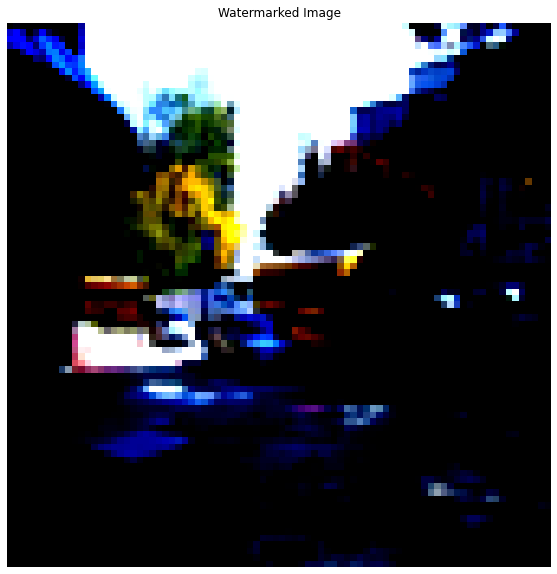

  9%|▉         | 1/11 [00:07<01:19,  7.92s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 9: Target opacity: 0, Labeled correctly: 0.5733333333333334, Correctly Predicted Target: True, Base class predicted: False


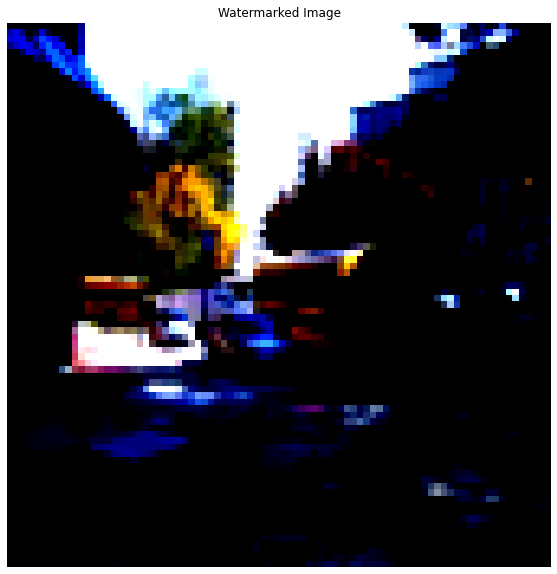

 18%|█▊        | 2/11 [00:15<01:11,  7.95s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 9: Target opacity: 0.05, Labeled correctly: 0.5733333333333334, Correctly Predicted Target: True, Base class predicted: False


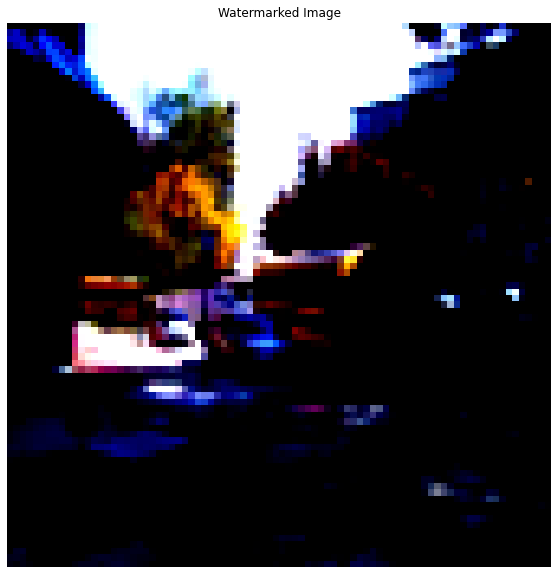

 27%|██▋       | 3/11 [00:23<01:03,  7.97s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 9: Target opacity: 0.1, Labeled correctly: 0.56, Correctly Predicted Target: True, Base class predicted: False


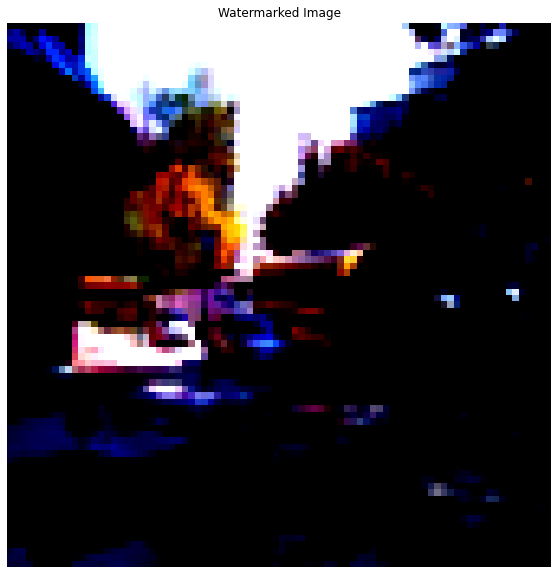

 36%|███▋      | 4/11 [00:31<00:55,  7.98s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 9: Target opacity: 0.15, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: True, Base class predicted: False


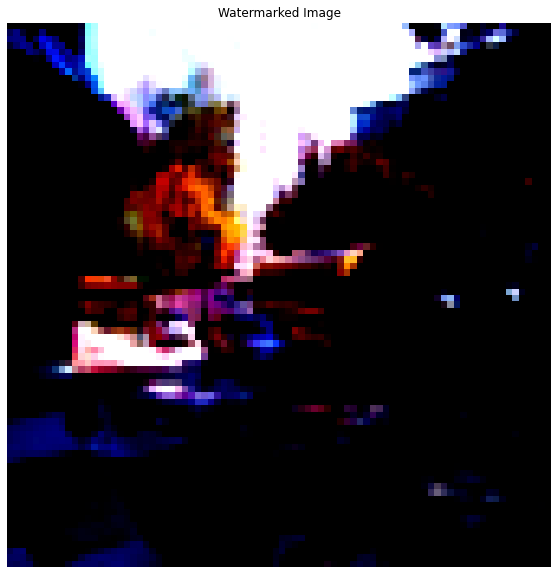

 45%|████▌     | 5/11 [00:39<00:48,  8.02s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 9: Target opacity: 0.2, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: True, Base class predicted: False


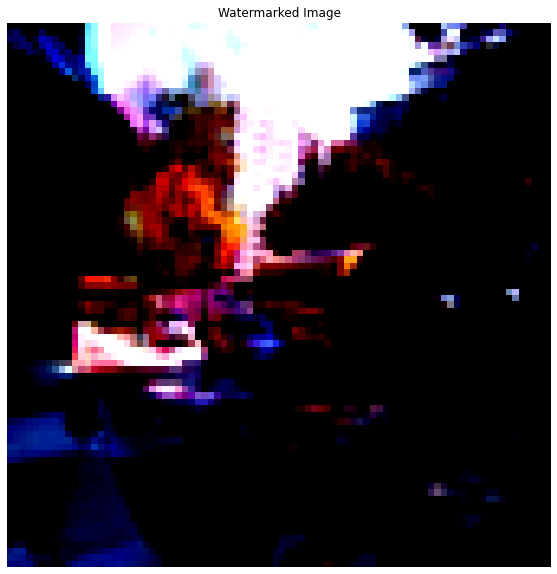

 55%|█████▍    | 6/11 [00:47<00:39,  7.99s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 9: Target opacity: 0.25, Labeled correctly: 0.5333333333333333, Correctly Predicted Target: True, Base class predicted: False


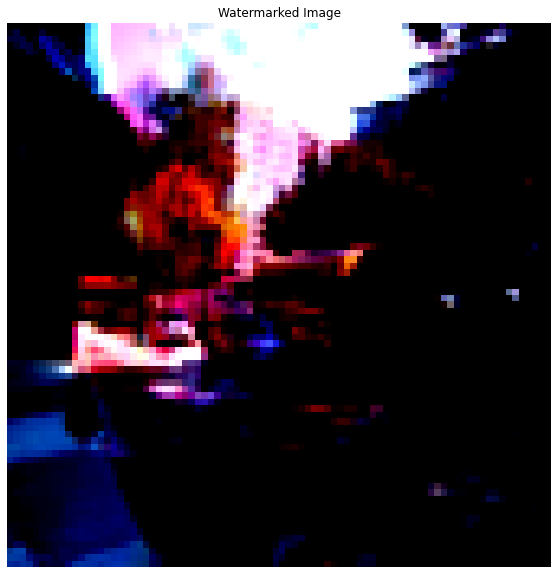

 64%|██████▎   | 7/11 [00:55<00:31,  7.92s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 9: Target opacity: 0.3, Labeled correctly: 0.5333333333333333, Correctly Predicted Target: True, Base class predicted: False


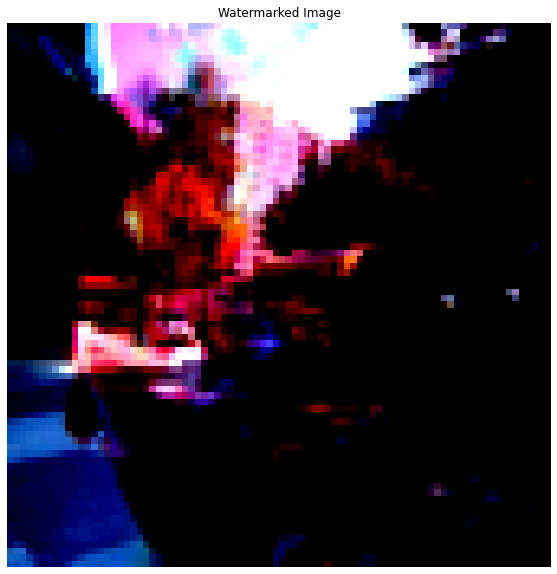

 73%|███████▎  | 8/11 [01:03<00:23,  7.89s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 9: Target opacity: 0.35, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: True, Base class predicted: False


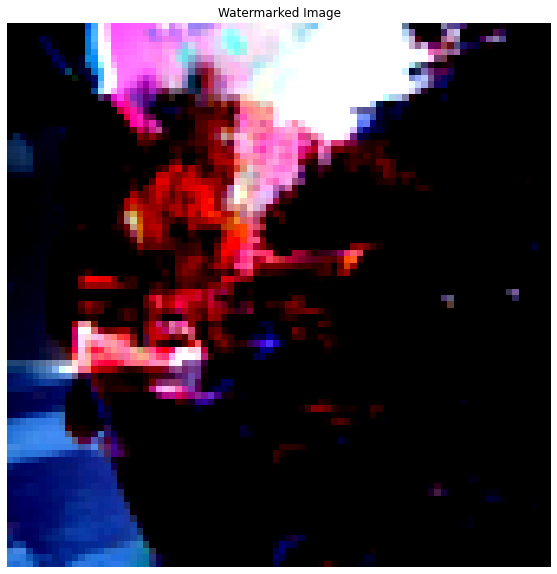

 82%|████████▏ | 9/11 [01:11<00:15,  7.91s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 9: Target opacity: 0.4, Labeled correctly: 0.5333333333333333, Correctly Predicted Target: True, Base class predicted: False


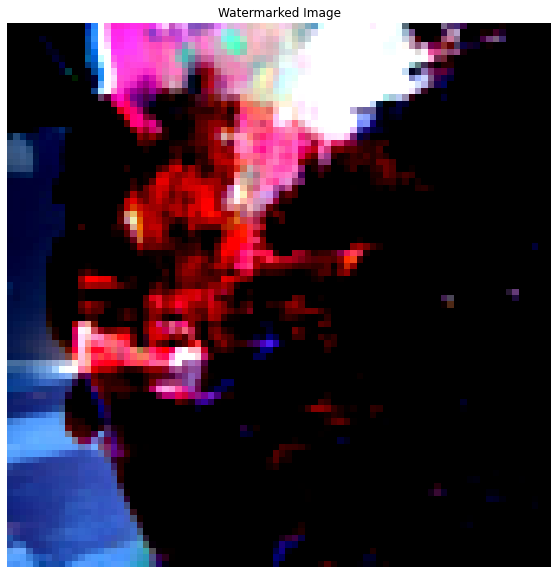

 91%|█████████ | 10/11 [01:19<00:07,  7.86s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 9: Target opacity: 0.45, Labeled correctly: 0.5333333333333333, Correctly Predicted Target: True, Base class predicted: False


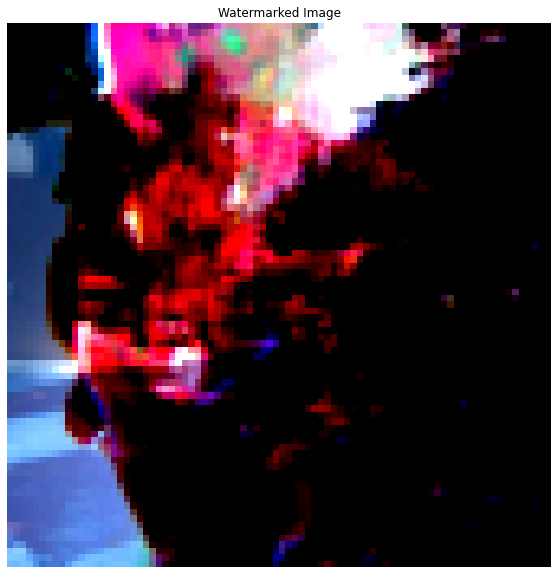

100%|██████████| 11/11 [01:27<00:00,  7.91s/it]

Iteration 9: Target opacity: 0.5, Labeled correctly: 0.52, Correctly Predicted Target: True, Base class predicted: False



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


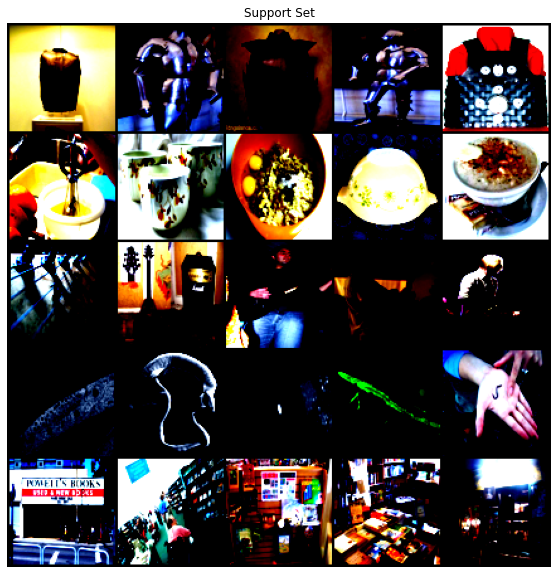

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[1, 1, 1, 1, 1, 4, 4, 4, 4, 4, 3, 3, 3, 3, 3, 0, 0, 0, 0, 0, 2, 2, 2, 2,
         2]])


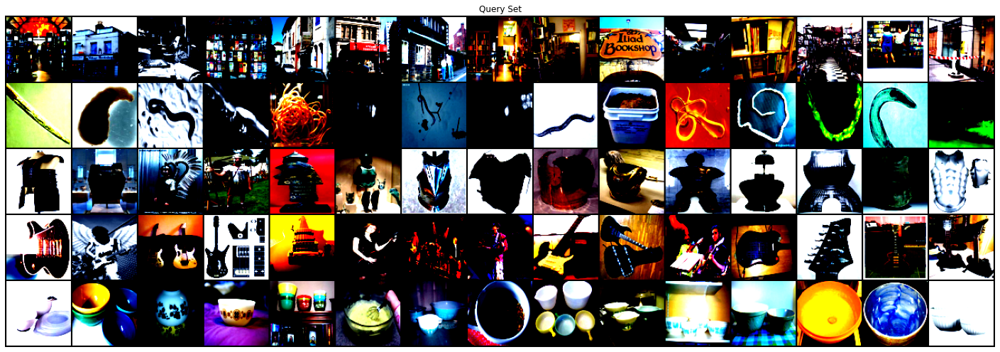

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3,
         3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
         4, 4, 4]])
target_class 2
unique_classes [0, 1, 3, 4]
base_class 0
target_indices [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14]
target_index 6
base_indices [15 16 17 18 19]
base_index 18


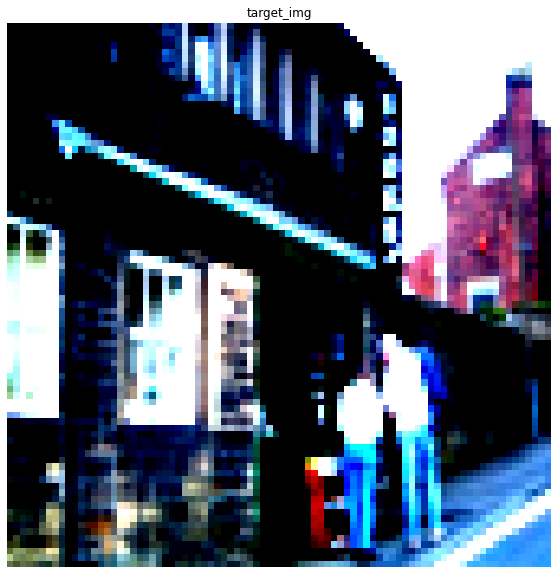

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


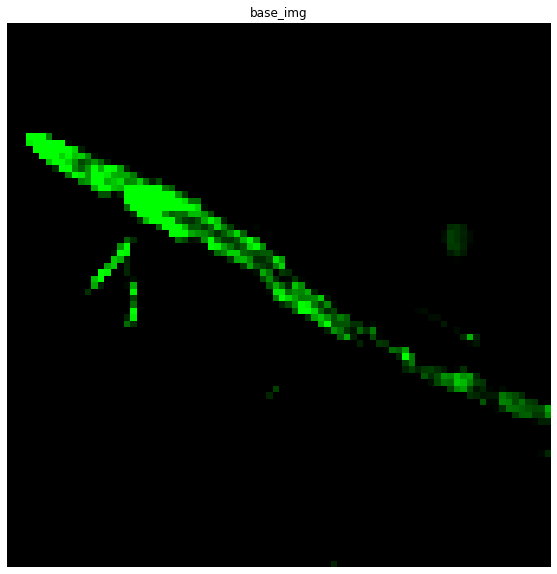

  0%|          | 3/1000 [00:00<00:34, 28.73it/s]

Iteration 0
loss: tensor(5.0281, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(11.5359, grad_fn=<PowBackward0>)
Iteration 2
loss: tensor(11.9536, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(14.2429, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(1.4375, grad_fn=<PowBackward0>)
Iteration 5
loss: tensor(22.5035, grad_fn=<PowBackward0>)


  1%|          | 9/1000 [00:00<00:42, 23.53it/s]

Iteration 6
loss: tensor(2.4077, grad_fn=<PowBackward0>)
Iteration 7
loss: tensor(10.6445, grad_fn=<PowBackward0>)
Iteration 8
loss: tensor(39.0527, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(0.2362, grad_fn=<PowBackward0>)
Iteration 10
loss: tensor(9.6108, grad_fn=<PowBackward0>)


  2%|▏         | 15/1000 [00:00<00:39, 25.14it/s]

Iteration 11
loss: tensor(15.7302, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(1.4670, grad_fn=<PowBackward0>)
Iteration 13
loss: tensor(4.9979, grad_fn=<PowBackward0>)
Iteration 14
loss: tensor(2.8677, grad_fn=<PowBackward0>)
Iteration 15
loss: tensor(50.5778, grad_fn=<PowBackward0>)
Iteration 16


  2%|▏         | 21/1000 [00:00<00:38, 25.25it/s]

loss: tensor(6.1964, grad_fn=<PowBackward0>)
Iteration 17
loss: tensor(17.6002, grad_fn=<PowBackward0>)
Iteration 18
loss: tensor(18.4630, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(14.1491, grad_fn=<PowBackward0>)
Iteration 20
loss: tensor(14.1408, grad_fn=<PowBackward0>)
Iteration 21
loss: tensor(6.1914, grad_fn=<PowBackward0>)


  3%|▎         | 27/1000 [00:01<00:37, 26.28it/s]

Iteration 22
loss: tensor(81.8219, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(1.0904, grad_fn=<PowBackward0>)
Iteration 24
loss: tensor(0.2587, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(4.0078, grad_fn=<PowBackward0>)
Iteration 26
loss: tensor(3.9018, grad_fn=<PowBackward0>)
Iteration 27
loss:

  3%|▎         | 30/1000 [00:01<00:37, 25.96it/s]

 tensor(17.1107, grad_fn=<PowBackward0>)
Iteration 28
loss: tensor(0.0457, grad_fn=<PowBackward0>)
Iteration 29
loss: tensor(4.8279, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(16.1360, grad_fn=<PowBackward0>)
Iteration 31
loss: tensor(1.5740, grad_fn=<PowBackward0>)
Iteration 32
loss: tensor(27.4151, grad_fn=<PowBackward0>)


  4%|▎         | 36/1000 [00:01<00:37, 25.98it/s]

Iteration 33
loss: tensor(0.5391, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(15.7632, grad_fn=<PowBackward0>)
Iteration 35
loss: tensor(23.0894, grad_fn=<PowBackward0>)
Iteration 36
loss: tensor(0.1000, grad_fn=<PowBackward0>)
Iteration 37
loss: tensor(0.5455, grad_fn=<PowBackward0>)
Iteration 38


  4%|▍         | 42/1000 [00:01<00:36, 26.17it/s]

loss: tensor(30.8533, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(0.3737, grad_fn=<PowBackward0>)
Iteration 40
loss: tensor(0.2160, grad_fn=<PowBackward0>)
Iteration 41
loss: tensor(4.6278, grad_fn=<PowBackward0>)
Iteration 42
loss: tensor(3.1492, grad_fn=<PowBackward0>)
Iteration 43
loss: tensor(9.4324, grad_fn=<PowBackward0>)


  5%|▍         | 48/1000 [00:01<00:36, 26.34it/s]

Iteration 44
loss: tensor(32.0287, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(5.1667, grad_fn=<PowBackward0>)
Iteration 46
loss: tensor(23.7587, grad_fn=<PowBackward0>)
Iteration 47
loss: tensor(0.2321, grad_fn=<PowBackward0>)
Iteration 48
loss: tensor(0.5882, grad_fn=<PowBackward0>)
Iteration 49
loss: tensor(28.8697, grad_fn=<PowBackward0>)


  5%|▌         | 54/1000 [00:02<00:35, 26.36it/s]

Iteration 50
loss: tensor(11.4714, grad_fn=<PowBackward0>)
Iteration 51
loss: tensor(6.8092, grad_fn=<PowBackward0>)
Iteration 52
loss: tensor(21.4228, grad_fn=<PowBackward0>)
Iteration 53
loss: tensor(0.5545, grad_fn=<PowBackward0>)
Iteration 54
loss: tensor(3.3389, grad_fn=<PowBackward0>)
Iteration 55


  6%|▌         | 60/1000 [00:02<00:36, 25.96it/s]

loss: tensor(14.8081, grad_fn=<PowBackward0>)
Iteration 56
loss: tensor(36.7087, grad_fn=<PowBackward0>)
Iteration 57
loss: tensor(6.6516, grad_fn=<PowBackward0>)
Iteration 58
loss: tensor(22.3993, grad_fn=<PowBackward0>)
Iteration 59
loss: tensor(16.1504, grad_fn=<PowBackward0>)
Iteration 60
loss: tensor(8.2014, grad_fn=<PowBackward0>)


  7%|▋         | 66/1000 [00:02<00:35, 26.66it/s]

Iteration 61
loss: tensor(6.8507, grad_fn=<PowBackward0>)
Iteration 62
loss: tensor(2.2850, grad_fn=<PowBackward0>)
Iteration 63
loss: tensor(31.0227, grad_fn=<PowBackward0>)
Iteration 64
loss: tensor(0.9596, grad_fn=<PowBackward0>)
Iteration 65
loss: tensor(3.1233, grad_fn=<PowBackward0>)
Iteration 66
loss: tensor(33.6316, grad_fn=<PowBackward0>)


  7%|▋         | 72/1000 [00:02<00:34, 27.19it/s]

Iteration 67
loss: tensor(3.2427, grad_fn=<PowBackward0>)
Iteration 68
loss: tensor(36.7085, grad_fn=<PowBackward0>)
Iteration 69
loss: tensor(3.1507, grad_fn=<PowBackward0>)
Iteration 70
loss: tensor(0.2219, grad_fn=<PowBackward0>)
Iteration 71
loss: tensor(16.9686, grad_fn=<PowBackward0>)
Iteration 72
loss: tensor(0.5369, grad_fn=<PowBackward0>)


  8%|▊         | 78/1000 [00:02<00:34, 26.91it/s]

Iteration 73
loss: tensor(15.2600, grad_fn=<PowBackward0>)
Iteration 74
loss: tensor(15.4476, grad_fn=<PowBackward0>)
Iteration 75
loss: tensor(1.2505, grad_fn=<PowBackward0>)
Iteration 76
loss: tensor(8.6266, grad_fn=<PowBackward0>)
Iteration 77
loss: tensor(8.4676, grad_fn=<PowBackward0>)


  8%|▊         | 81/1000 [00:03<00:34, 26.66it/s]

Iteration 78
loss: tensor(2.1634, grad_fn=<PowBackward0>)
Iteration 79
loss: tensor(22.5961, grad_fn=<PowBackward0>)
Iteration 80
loss: tensor(1.9840, grad_fn=<PowBackward0>)
Iteration 81
loss: tensor(6.8518, grad_fn=<PowBackward0>)
Iteration 82
loss: tensor(25.7696, grad_fn=<PowBackward0>)
Iteration 83
loss:

  9%|▊         | 87/1000 [00:03<00:35, 25.93it/s]

 tensor(0.4280, grad_fn=<PowBackward0>)
Iteration 84
loss: tensor(23.2505, grad_fn=<PowBackward0>)
Iteration 85
loss: tensor(7.4446, grad_fn=<PowBackward0>)
Iteration 86
loss: tensor(7.3399, grad_fn=<PowBackward0>)
Iteration 87
loss: tensor(12.9679, grad_fn=<PowBackward0>)
Iteration 88
loss: tensor(8.6132, grad_fn=<PowBackward0>)


  9%|▉         | 93/1000 [00:03<00:33, 26.95it/s]

Iteration 89
loss: tensor(3.5837, grad_fn=<PowBackward0>)
Iteration 90
loss: tensor(1.9667, grad_fn=<PowBackward0>)
Iteration 91
loss: tensor(5.9455, grad_fn=<PowBackward0>)
Iteration 92
loss: tensor(6.6354, grad_fn=<PowBackward0>)
Iteration 93
loss: tensor(3.2357, grad_fn=<PowBackward0>)
Iteration 94
loss: tensor(50.5708, grad_fn=<PowBackward0>)


 10%|▉         | 99/1000 [00:03<00:34, 25.93it/s]

Iteration 95
loss: tensor(1.2541, grad_fn=<PowBackward0>)
Iteration 96
loss: tensor(4.2818, grad_fn=<PowBackward0>)
Iteration 97
loss: tensor(29.7816, grad_fn=<PowBackward0>)
Iteration 98
loss: tensor(0.0329, grad_fn=<PowBackward0>)
Iteration 99
loss: tensor(0.8075, grad_fn=<PowBackward0>)


 10%|█         | 105/1000 [00:04<00:34, 26.00it/s]

Iteration 100
loss: tensor(34.2107, grad_fn=<PowBackward0>)
Iteration 101
loss: tensor(7.2829, grad_fn=<PowBackward0>)
Iteration 102
loss: tensor(6.9631, grad_fn=<PowBackward0>)
Iteration 103
loss: tensor(7.0373, grad_fn=<PowBackward0>)
Iteration 104
loss: tensor(7.1101, grad_fn=<PowBackward0>)
Iteration 105


 11%|█         | 108/1000 [00:04<00:34, 26.12it/s]

loss: tensor(15.1544, grad_fn=<PowBackward0>)
Iteration 106
loss: tensor(3.9518, grad_fn=<PowBackward0>)
Iteration 107
loss: tensor(22.0766, grad_fn=<PowBackward0>)
Iteration 108
loss: tensor(10.0663, grad_fn=<PowBackward0>)
Iteration 109
loss: tensor(9.2341, grad_fn=<PowBackward0>)
Iteration 110
loss: tensor(21.5306, grad_fn=<PowBackward0>)


 11%|█▏        | 114/1000 [00:04<00:34, 25.99it/s]

Iteration 111
loss: tensor(18.8234, grad_fn=<PowBackward0>)
Iteration 112
loss: tensor(1.7081, grad_fn=<PowBackward0>)
Iteration 113
loss: tensor(0.2662, grad_fn=<PowBackward0>)
Iteration 114
loss: tensor(11.5998, grad_fn=<PowBackward0>)
Iteration 115
loss: tensor(30.7256, grad_fn=<PowBackward0>)
Iteration 116
loss: tensor(0.2301, grad_fn=<PowBackward0>)


 12%|█▏        | 120/1000 [00:04<00:33, 26.17it/s]

Iteration 117
loss: tensor(6.5156, grad_fn=<PowBackward0>)
Iteration 118
loss: tensor(29.6173, grad_fn=<PowBackward0>)
Iteration 119
loss: tensor(14.3829, grad_fn=<PowBackward0>)
Iteration 120
loss: tensor(0.1024, grad_fn=<PowBackward0>)
Iteration 121
loss: tensor(1.2923, grad_fn=<PowBackward0>)
Iteration 122
loss: tensor(59.8380, grad_fn=<PowBackward0>)


 13%|█▎        | 126/1000 [00:04<00:32, 27.02it/s]

Iteration 123
loss: tensor(1.5191, grad_fn=<PowBackward0>)
Iteration 124
loss: tensor(6.3671, grad_fn=<PowBackward0>)
Iteration 125
loss: tensor(16.7793, grad_fn=<PowBackward0>)
Iteration 126
loss: tensor(31.7187, grad_fn=<PowBackward0>)
Iteration 127
loss: tensor(13.9481, grad_fn=<PowBackward0>)
Iteration 128
loss: tensor(17.3034, grad_fn=<PowBackward0>)


 13%|█▎        | 132/1000 [00:05<00:32, 26.84it/s]

Iteration 129
loss: tensor(5.2594, grad_fn=<PowBackward0>)
Iteration 130
loss: tensor(11.8189, grad_fn=<PowBackward0>)
Iteration 131
loss: tensor(5.3988, grad_fn=<PowBackward0>)
Iteration 132
loss: tensor(42.0844, grad_fn=<PowBackward0>)
Iteration 133
loss: tensor(2.4682, grad_fn=<PowBackward0>)
Iteration 134


 14%|█▍        | 138/1000 [00:05<00:32, 26.15it/s]

loss: tensor(42.9386, grad_fn=<PowBackward0>)
Iteration 135
loss: tensor(10.2086, grad_fn=<PowBackward0>)
Iteration 136
loss: tensor(22.1681, grad_fn=<PowBackward0>)
Iteration 137
loss: tensor(6.0897, grad_fn=<PowBackward0>)
Iteration 138
loss: tensor(41.0245, grad_fn=<PowBackward0>)
Iteration 139
loss: tensor(39.7376, grad_fn=<PowBackward0>)


 14%|█▍        | 144/1000 [00:05<00:32, 26.20it/s]

Iteration 140
loss: tensor(0.1243, grad_fn=<PowBackward0>)
Iteration 141
loss: tensor(12.3312, grad_fn=<PowBackward0>)
Iteration 142
loss: tensor(9.2148, grad_fn=<PowBackward0>)
Iteration 143
loss: tensor(21.8308, grad_fn=<PowBackward0>)
Iteration 144
loss: tensor(2.2385, grad_fn=<PowBackward0>)
Iteration 145


 15%|█▌        | 150/1000 [00:05<00:32, 26.35it/s]

loss: tensor(21.1626, grad_fn=<PowBackward0>)
Iteration 146
loss: tensor(2.6631, grad_fn=<PowBackward0>)
Iteration 147
loss: tensor(24.1891, grad_fn=<PowBackward0>)
Iteration 148
loss: tensor(1.9412, grad_fn=<PowBackward0>)
Iteration 149
loss: tensor(39.5869, grad_fn=<PowBackward0>)
Iteration 150
loss: tensor(0.7458, grad_fn=<PowBackward0>)


 16%|█▌        | 156/1000 [00:05<00:32, 26.13it/s]

Iteration 151
loss: tensor(17.5461, grad_fn=<PowBackward0>)
Iteration 152
loss: tensor(12.9084, grad_fn=<PowBackward0>)
Iteration 153
loss: tensor(48.1425, grad_fn=<PowBackward0>)
Iteration 154
loss: tensor(5.9563, grad_fn=<PowBackward0>)
Iteration 155
loss: tensor(32.3637, grad_fn=<PowBackward0>)
Iteration 156


 16%|█▌        | 159/1000 [00:06<00:31, 26.35it/s]

loss: tensor(7.1740, grad_fn=<PowBackward0>)
Iteration 157
loss: tensor(19.9249, grad_fn=<PowBackward0>)
Iteration 158
loss: tensor(10.2520, grad_fn=<PowBackward0>)
Iteration 159
loss: tensor(49.0440, grad_fn=<PowBackward0>)
Iteration 160
loss: tensor(2.6440, grad_fn=<PowBackward0>)
Iteration 161
loss: tensor(72.3039, grad_fn=<PowBackward0>)


 16%|█▋        | 165/1000 [00:06<00:31, 26.68it/s]

Iteration 162
loss: tensor(3.6373, grad_fn=<PowBackward0>)
Iteration 163
loss: tensor(23.0744, grad_fn=<PowBackward0>)
Iteration 164
loss: tensor(2.2055, grad_fn=<PowBackward0>)
Iteration 165
loss: tensor(6.1893, grad_fn=<PowBackward0>)
Iteration 166
loss: tensor(24.2241, grad_fn=<PowBackward0>)
Iteration 167


 17%|█▋        | 171/1000 [00:06<00:31, 26.43it/s]

loss: tensor(7.9357, grad_fn=<PowBackward0>)
Iteration 168
loss: tensor(0.6098, grad_fn=<PowBackward0>)
Iteration 169
loss: tensor(6.2185, grad_fn=<PowBackward0>)
Iteration 170
loss: tensor(7.9244, grad_fn=<PowBackward0>)
Iteration 171
loss: tensor(14.7142, grad_fn=<PowBackward0>)
Iteration 172
loss: tensor(30.1776, grad_fn=<PowBackward0>)


 18%|█▊        | 177/1000 [00:06<00:30, 27.36it/s]

Iteration 173
loss: tensor(45.8905, grad_fn=<PowBackward0>)
Iteration 174
loss: tensor(6.2759, grad_fn=<PowBackward0>)
Iteration 175
loss: tensor(31.6698, grad_fn=<PowBackward0>)
Iteration 176
loss: tensor(6.3076, grad_fn=<PowBackward0>)
Iteration 177
loss: tensor(16.4088, grad_fn=<PowBackward0>)
Iteration 178
loss: tensor(10.0372, grad_fn=<PowBackward0>)


 18%|█▊        | 183/1000 [00:06<00:29, 27.39it/s]

Iteration 179
loss: tensor(14.6325, grad_fn=<PowBackward0>)
Iteration 180
loss: tensor(9.7958, grad_fn=<PowBackward0>)
Iteration 181
loss: tensor(31.0401, grad_fn=<PowBackward0>)
Iteration 182
loss: tensor(1.3867, grad_fn=<PowBackward0>)
Iteration 183
loss: tensor(22.6359, grad_fn=<PowBackward0>)
Iteration 184
loss: tensor(15.3897, grad_fn=<PowBackward0>)


 19%|█▉        | 189/1000 [00:07<00:29, 27.56it/s]

Iteration 185
loss: tensor(31.0717, grad_fn=<PowBackward0>)
Iteration 186
loss: tensor(11.0158, grad_fn=<PowBackward0>)
Iteration 187
loss: tensor(21.9422, grad_fn=<PowBackward0>)
Iteration 188
loss: tensor(0.7313, grad_fn=<PowBackward0>)
Iteration 189
loss: tensor(18.1293, grad_fn=<PowBackward0>)
Iteration 190
loss: tensor(4.9874, grad_fn=<PowBackward0>)


 20%|█▉        | 195/1000 [00:07<00:29, 26.99it/s]

Iteration 191
loss: tensor(42.1025, grad_fn=<PowBackward0>)
Iteration 192
loss: tensor(9.4690, grad_fn=<PowBackward0>)
Iteration 193
loss: tensor(30.1745, grad_fn=<PowBackward0>)
Iteration 194
loss: tensor(1.2192, grad_fn=<PowBackward0>)
Iteration 195
loss: tensor(19.2614, grad_fn=<PowBackward0>)
Iteration 196


 20%|██        | 201/1000 [00:07<00:29, 26.69it/s]

loss: tensor(8.1700, grad_fn=<PowBackward0>)
Iteration 197
loss: tensor(32.6723, grad_fn=<PowBackward0>)
Iteration 198
loss: tensor(3.3547, grad_fn=<PowBackward0>)
Iteration 199
loss: tensor(25.4566, grad_fn=<PowBackward0>)
Iteration 200
loss: tensor(6.6082, grad_fn=<PowBackward0>)
Iteration 201
loss: tensor(4.9742, grad_fn=<PowBackward0>)


 21%|██        | 207/1000 [00:07<00:29, 27.22it/s]

Iteration 202
loss: tensor(10.1701, grad_fn=<PowBackward0>)
Iteration 203
loss: tensor(64.5760, grad_fn=<PowBackward0>)
Iteration 204
loss: tensor(2.1731, grad_fn=<PowBackward0>)
Iteration 205
loss: tensor(13.3734, grad_fn=<PowBackward0>)
Iteration 206
loss: tensor(12.1130, grad_fn=<PowBackward0>)
Iteration 207
loss: tensor(23.8012, grad_fn=<PowBackward0>)


 21%|██▏       | 213/1000 [00:08<00:28, 27.49it/s]

Iteration 208
loss: tensor(12.8301, grad_fn=<PowBackward0>)
Iteration 209
loss: tensor(34.4236, grad_fn=<PowBackward0>)
Iteration 210
loss: tensor(2.5013, grad_fn=<PowBackward0>)
Iteration 211
loss: tensor(16.6022, grad_fn=<PowBackward0>)
Iteration 212
loss: tensor(13.1601, grad_fn=<PowBackward0>)
Iteration 213


 22%|██▏       | 216/1000 [00:08<00:29, 26.33it/s]

loss: tensor(17.9290, grad_fn=<PowBackward0>)
Iteration 214
loss: tensor(17.4755, grad_fn=<PowBackward0>)
Iteration 215
loss: tensor(21.0234, grad_fn=<PowBackward0>)
Iteration 216
loss: tensor(9.4092, grad_fn=<PowBackward0>)
Iteration 217
loss: tensor(15.1018, grad_fn=<PowBackward0>)
Iteration 218
loss: tensor(23.7993, grad_fn=<PowBackward0>)


 22%|██▏       | 222/1000 [00:08<00:29, 25.97it/s]

Iteration 219
loss: tensor(30.4982, grad_fn=<PowBackward0>)
Iteration 220
loss: tensor(14.3109, grad_fn=<PowBackward0>)
Iteration 221
loss: tensor(8.2074, grad_fn=<PowBackward0>)
Iteration 222
loss: tensor(19.4959, grad_fn=<PowBackward0>)
Iteration 223
loss: tensor(32.8298, grad_fn=<PowBackward0>)
Iteration 224


 23%|██▎       | 228/1000 [00:08<00:29, 26.12it/s]

loss: tensor(6.6850, grad_fn=<PowBackward0>)
Iteration 225
loss: tensor(25.6883, grad_fn=<PowBackward0>)
Iteration 226
loss: tensor(20.4433, grad_fn=<PowBackward0>)
Iteration 227
loss: tensor(35.0784, grad_fn=<PowBackward0>)
Iteration 228
loss: tensor(11.5017, grad_fn=<PowBackward0>)
Iteration 229
loss: tensor(8.8261, grad_fn=<PowBackward0>)


 23%|██▎       | 234/1000 [00:08<00:28, 26.60it/s]

Iteration 230
loss: tensor(25.5311, grad_fn=<PowBackward0>)
Iteration 231
loss: tensor(12.5616, grad_fn=<PowBackward0>)
Iteration 232
loss: tensor(13.5006, grad_fn=<PowBackward0>)
Iteration 233
loss: tensor(19.2305, grad_fn=<PowBackward0>)
Iteration 234
loss: tensor(20.6026, grad_fn=<PowBackward0>)
Iteration 235


 24%|██▍       | 240/1000 [00:09<00:28, 26.42it/s]

loss: tensor(26.1680, grad_fn=<PowBackward0>)
Iteration 236
loss: tensor(8.3022, grad_fn=<PowBackward0>)
Iteration 237
loss: tensor(17.8233, grad_fn=<PowBackward0>)
Iteration 238
loss: tensor(6.5857, grad_fn=<PowBackward0>)
Iteration 239
loss: tensor(39.6503, grad_fn=<PowBackward0>)
Iteration 240
loss: tensor(9.6269, grad_fn=<PowBackward0>)


 25%|██▍       | 246/1000 [00:09<00:28, 26.38it/s]

Iteration 241
loss: tensor(31.8966, grad_fn=<PowBackward0>)
Iteration 242
loss: tensor(19.8126, grad_fn=<PowBackward0>)
Iteration 243
loss: tensor(41.4983, grad_fn=<PowBackward0>)
Iteration 244
loss: tensor(2.8807, grad_fn=<PowBackward0>)
Iteration 245
loss: tensor(13.9524, grad_fn=<PowBackward0>)
Iteration 246


 25%|██▍       | 249/1000 [00:09<00:29, 25.65it/s]

loss: tensor(9.4810, grad_fn=<PowBackward0>)
Iteration 247
loss: tensor(29.6936, grad_fn=<PowBackward0>)
Iteration 248
loss: tensor(4.3128, grad_fn=<PowBackward0>)
Iteration 249
loss: tensor(30.5473, grad_fn=<PowBackward0>)
Iteration 250
loss: tensor(8.1181, grad_fn=<PowBackward0>)
Iteration 251
loss: tensor(12.5574, grad_fn=<PowBackward0>)


 26%|██▌       | 255/1000 [00:09<00:28, 26.19it/s]

Iteration 252
loss: tensor(17.8679, grad_fn=<PowBackward0>)
Iteration 253
loss: tensor(14.2255, grad_fn=<PowBackward0>)
Iteration 254
loss: tensor(12.1978, grad_fn=<PowBackward0>)
Iteration 255
loss: tensor(37.9096, grad_fn=<PowBackward0>)
Iteration 256
loss: tensor(10.8461, grad_fn=<PowBackward0>)
Iteration 257
loss: tensor(12.8949, grad_fn=<PowBackward0>)

 26%|██▌       | 261/1000 [00:09<00:28, 26.24it/s]


Iteration 258
loss: tensor(16.1401, grad_fn=<PowBackward0>)
Iteration 259
loss: tensor(31.0935, grad_fn=<PowBackward0>)
Iteration 260
loss: tensor(8.0307, grad_fn=<PowBackward0>)
Iteration 261
loss: tensor(29.5242, grad_fn=<PowBackward0>)
Iteration 262
loss: tensor(1.9925, grad_fn=<PowBackward0>)


 27%|██▋       | 267/1000 [00:10<00:27, 27.05it/s]

Iteration 263
loss: tensor(13.7811, grad_fn=<PowBackward0>)
Iteration 264
loss: tensor(9.9082, grad_fn=<PowBackward0>)
Iteration 265
loss: tensor(23.0469, grad_fn=<PowBackward0>)
Iteration 266
loss: tensor(10.7249, grad_fn=<PowBackward0>)
Iteration 267
loss: tensor(23.0801, grad_fn=<PowBackward0>)
Iteration 268


 27%|██▋       | 273/1000 [00:10<00:27, 26.73it/s]

loss: tensor(17.3824, grad_fn=<PowBackward0>)
Iteration 269
loss: tensor(40.6897, grad_fn=<PowBackward0>)
Iteration 270
loss: tensor(2.5129, grad_fn=<PowBackward0>)
Iteration 271
loss: tensor(20.7602, grad_fn=<PowBackward0>)
Iteration 272
loss: tensor(7.8649, grad_fn=<PowBackward0>)
Iteration 273
loss: tensor(11.9429, grad_fn=<PowBackward0>)


 28%|██▊       | 276/1000 [00:10<00:30, 23.65it/s]

Iteration 274
loss: tensor(1.5895, grad_fn=<PowBackward0>)
Iteration 275
loss: tensor(2.6131, grad_fn=<PowBackward0>)
Iteration 276
loss: tensor(23.9601, grad_fn=<PowBackward0>)
Iteration 277
loss: tensor(19.4937, grad_fn=<PowBackward0>)
Iteration 278


 28%|██▊       | 282/1000 [00:10<00:28, 24.77it/s]

loss: tensor(7.0779, grad_fn=<PowBackward0>)
Iteration 279
loss: tensor(34.1367, grad_fn=<PowBackward0>)
Iteration 280
loss: tensor(15.9105, grad_fn=<PowBackward0>)
Iteration 281
loss: tensor(11.1645, grad_fn=<PowBackward0>)
Iteration 282
loss: tensor(24.0138, grad_fn=<PowBackward0>)
Iteration 283
loss: tensor(20.5044, grad_fn=<PowBackward0>)


 29%|██▉       | 288/1000 [00:10<00:27, 25.68it/s]

Iteration 284
loss: tensor(24.3340, grad_fn=<PowBackward0>)
Iteration 285
loss: tensor(16.1708, grad_fn=<PowBackward0>)
Iteration 286
loss: tensor(7.7211, grad_fn=<PowBackward0>)
Iteration 287
loss: tensor(18.5747, grad_fn=<PowBackward0>)
Iteration 288
loss: tensor(9.8474, grad_fn=<PowBackward0>)
Iteration 289
loss: tensor(26.8545, grad_fn=<PowBackward0>)


 29%|██▉       | 294/1000 [00:11<00:26, 26.81it/s]

Iteration 290
loss: tensor(17.4080, grad_fn=<PowBackward0>)
Iteration 291
loss: tensor(30.0584, grad_fn=<PowBackward0>)
Iteration 292
loss: tensor(3.1517, grad_fn=<PowBackward0>)
Iteration 293
loss: tensor(27.7918, grad_fn=<PowBackward0>)
Iteration 294
loss: tensor(17.4410, grad_fn=<PowBackward0>)
Iteration 295
loss: tensor(29.8584, grad_fn=<PowBackward0>)


 30%|███       | 300/1000 [00:11<00:26, 26.82it/s]

Iteration 296
loss: tensor(0.4667, grad_fn=<PowBackward0>)
Iteration 297
loss: tensor(18.6182, grad_fn=<PowBackward0>)
Iteration 298
loss: tensor(25.7654, grad_fn=<PowBackward0>)
Iteration 299
loss: tensor(0.0143, grad_fn=<PowBackward0>)
Iteration 300
loss: tensor(0.1336, grad_fn=<PowBackward0>)
Iteration 301


 31%|███       | 306/1000 [00:11<00:26, 25.99it/s]

loss: tensor(9.1457, grad_fn=<PowBackward0>)
Iteration 302
loss: tensor(32.8592, grad_fn=<PowBackward0>)
Iteration 303
loss: tensor(7.5859, grad_fn=<PowBackward0>)
Iteration 304
loss: tensor(29.8882, grad_fn=<PowBackward0>)
Iteration 305
loss: tensor(21.2185, grad_fn=<PowBackward0>)
Iteration 306
loss: tensor(20.5684, grad_fn=<PowBackward0>)


 31%|███       | 312/1000 [00:11<00:26, 26.07it/s]

Iteration 307
loss: tensor(9.1157, grad_fn=<PowBackward0>)
Iteration 308
loss: tensor(16.2237, grad_fn=<PowBackward0>)
Iteration 309
loss: tensor(13.6110, grad_fn=<PowBackward0>)
Iteration 310
loss: tensor(13.7111, grad_fn=<PowBackward0>)
Iteration 311
loss: tensor(11.4688, grad_fn=<PowBackward0>)
Iteration 312


 32%|███▏      | 315/1000 [00:12<00:26, 25.60it/s]

loss: tensor(15.7845, grad_fn=<PowBackward0>)
Iteration 313
loss: tensor(9.0021, grad_fn=<PowBackward0>)
Iteration 314
loss: tensor(9.3249, grad_fn=<PowBackward0>)
Iteration 315
loss: tensor(6.3122, grad_fn=<PowBackward0>)
Iteration 316
loss: tensor(36.2038, grad_fn=<PowBackward0>)
Iteration 317
loss: tensor(10.1218, grad_fn=<PowBackward0>)


 32%|███▏      | 321/1000 [00:12<00:26, 25.72it/s]

Iteration 318
loss: tensor(19.8960, grad_fn=<PowBackward0>)
Iteration 319
loss: tensor(13.3992, grad_fn=<PowBackward0>)
Iteration 320
loss: tensor(7.9343, grad_fn=<PowBackward0>)
Iteration 321
loss: tensor(5.8121, grad_fn=<PowBackward0>)
Iteration 322
loss: tensor(18.8838, grad_fn=<PowBackward0>)
Iteration 323
loss: tensor(13.5777, grad_fn=<PowBackward0>)


 33%|███▎      | 327/1000 [00:12<00:25, 26.49it/s]

Iteration 324
loss: tensor(13.6629, grad_fn=<PowBackward0>)
Iteration 325
loss: tensor(9.7401, grad_fn=<PowBackward0>)
Iteration 326
loss: tensor(10.4879, grad_fn=<PowBackward0>)
Iteration 327
loss: tensor(10.7648, grad_fn=<PowBackward0>)
Iteration 328
loss: tensor(9.2068, grad_fn=<PowBackward0>)
Iteration 329
loss: tensor(12.3133, grad_fn=<PowBackward0>)


 33%|███▎      | 333/1000 [00:12<00:25, 26.61it/s]

Iteration 330
loss: tensor(14.8464, grad_fn=<PowBackward0>)
Iteration 331
loss: tensor(7.9719, grad_fn=<PowBackward0>)
Iteration 332
loss: tensor(15.7399, grad_fn=<PowBackward0>)
Iteration 333
loss: tensor(5.9842, grad_fn=<PowBackward0>)
Iteration 334
loss: tensor(17.4501, grad_fn=<PowBackward0>)
Iteration 335
loss: tensor(7.7612, grad_fn=<PowBackward0>)


 34%|███▍      | 339/1000 [00:12<00:25, 26.14it/s]

Iteration 336
loss: tensor(17.9033, grad_fn=<PowBackward0>)
Iteration 337
loss: tensor(12.3907, grad_fn=<PowBackward0>)
Iteration 338
loss: tensor(8.2547, grad_fn=<PowBackward0>)
Iteration 339
loss: tensor(9.1428, grad_fn=<PowBackward0>)
Iteration 340
loss: tensor(11.5907, grad_fn=<PowBackward0>)
Iteration 341


 34%|███▍      | 345/1000 [00:13<00:24, 26.34it/s]

loss: tensor(13.1975, grad_fn=<PowBackward0>)
Iteration 342
loss: tensor(12.8406, grad_fn=<PowBackward0>)
Iteration 343
loss: tensor(12.0388, grad_fn=<PowBackward0>)
Iteration 344
loss: tensor(13.6865, grad_fn=<PowBackward0>)
Iteration 345
loss: tensor(7.4185, grad_fn=<PowBackward0>)
Iteration 346
loss: tensor(9.8352, grad_fn=<PowBackward0>)


 35%|███▌      | 351/1000 [00:13<00:25, 25.69it/s]

Iteration 347
loss: tensor(10.6973, grad_fn=<PowBackward0>)
Iteration 348
loss: tensor(7.7610, grad_fn=<PowBackward0>)
Iteration 349
loss: tensor(7.3487, grad_fn=<PowBackward0>)
Iteration 350
loss: tensor(10.9364, grad_fn=<PowBackward0>)
Iteration 351
loss: tensor(7.0840, grad_fn=<PowBackward0>)
Iteration 352


 36%|███▌      | 357/1000 [00:13<00:24, 26.06it/s]

loss: tensor(25.7433, grad_fn=<PowBackward0>)
Iteration 353
loss: tensor(2.8595, grad_fn=<PowBackward0>)
Iteration 354
loss: tensor(14.9075, grad_fn=<PowBackward0>)
Iteration 355
loss: tensor(16.8536, grad_fn=<PowBackward0>)
Iteration 356
loss: tensor(6.4871, grad_fn=<PowBackward0>)
Iteration 357
loss: tensor(45.0210, grad_fn=<PowBackward0>)


 36%|███▋      | 363/1000 [00:13<00:23, 26.58it/s]

Iteration 358
loss: tensor(12.7727, grad_fn=<PowBackward0>)
Iteration 359
loss: tensor(13.4368, grad_fn=<PowBackward0>)
Iteration 360
loss: tensor(15.3907, grad_fn=<PowBackward0>)
Iteration 361
loss: tensor(10.9957, grad_fn=<PowBackward0>)
Iteration 362
loss: tensor(8.1926, grad_fn=<PowBackward0>)
Iteration 363


 37%|███▋      | 369/1000 [00:14<00:23, 27.04it/s]

loss: tensor(1.7753, grad_fn=<PowBackward0>)
Iteration 364
loss: tensor(15.1873, grad_fn=<PowBackward0>)
Iteration 365
loss: tensor(14.5783, grad_fn=<PowBackward0>)
Iteration 366
loss: tensor(0.4802, grad_fn=<PowBackward0>)
Iteration 367
loss: tensor(10.4043, grad_fn=<PowBackward0>)
Iteration 368
loss: tensor(16.7443, grad_fn=<PowBackward0>)
Iteration 369


 38%|███▊      | 375/1000 [00:14<00:22, 27.26it/s]

loss: tensor(29.5054, grad_fn=<PowBackward0>)
Iteration 370
loss: tensor(7.8359, grad_fn=<PowBackward0>)
Iteration 371
loss: tensor(10.0794, grad_fn=<PowBackward0>)
Iteration 372
loss: tensor(7.5195, grad_fn=<PowBackward0>)
Iteration 373
loss: tensor(14.4346, grad_fn=<PowBackward0>)
Iteration 374
loss: tensor(7.0352, grad_fn=<PowBackward0>)


 38%|███▊      | 378/1000 [00:14<00:22, 27.18it/s]

Iteration 375
loss: tensor(14.0917, grad_fn=<PowBackward0>)
Iteration 376
loss: tensor(16.3116, grad_fn=<PowBackward0>)
Iteration 377
loss: tensor(31.1777, grad_fn=<PowBackward0>)
Iteration 378
loss: tensor(9.1421, grad_fn=<PowBackward0>)
Iteration 379
loss: tensor(16.7174, grad_fn=<PowBackward0>)
Iteration 380
loss: tensor(17.5087, grad_fn=<PowBackward0>)


 38%|███▊      | 384/1000 [00:14<00:23, 26.09it/s]

Iteration 381
loss: tensor(10.8262, grad_fn=<PowBackward0>)
Iteration 382
loss: tensor(4.2942, grad_fn=<PowBackward0>)
Iteration 383
loss: tensor(2.9856, grad_fn=<PowBackward0>)
Iteration 384
loss: tensor(8.5809, grad_fn=<PowBackward0>)
Iteration 385
loss: tensor(34.6744, grad_fn=<PowBackward0>)
Iteration 386


 39%|███▉      | 390/1000 [00:14<00:23, 26.43it/s]

loss: tensor(0.2567, grad_fn=<PowBackward0>)
Iteration 387
loss: tensor(4.3467, grad_fn=<PowBackward0>)
Iteration 388
loss: tensor(23.3811, grad_fn=<PowBackward0>)
Iteration 389
loss: tensor(19.0866, grad_fn=<PowBackward0>)
Iteration 390
loss: tensor(4.4661, grad_fn=<PowBackward0>)
Iteration 391
loss: tensor(25.6641, grad_fn=<PowBackward0>)


 40%|███▉      | 396/1000 [00:15<00:23, 26.05it/s]

Iteration 392
loss: tensor(12.5159, grad_fn=<PowBackward0>)
Iteration 393
loss: tensor(19.2051, grad_fn=<PowBackward0>)
Iteration 394
loss: tensor(6.0971, grad_fn=<PowBackward0>)
Iteration 395
loss: tensor(13.8735, grad_fn=<PowBackward0>)
Iteration 396
loss: tensor(15.3886, grad_fn=<PowBackward0>)
Iteration 397


 40%|████      | 402/1000 [00:15<00:22, 26.33it/s]

loss: tensor(9.8464, grad_fn=<PowBackward0>)
Iteration 398
loss: tensor(20.1074, grad_fn=<PowBackward0>)
Iteration 399
loss: tensor(5.8855, grad_fn=<PowBackward0>)
Iteration 400
loss: tensor(5.1565, grad_fn=<PowBackward0>)
Iteration 401
loss: tensor(21.5483, grad_fn=<PowBackward0>)
Iteration 402
loss: tensor(0.8181, grad_fn=<PowBackward0>)


 41%|████      | 408/1000 [00:15<00:22, 25.81it/s]

Iteration 403
loss: tensor(0.9321, grad_fn=<PowBackward0>)
Iteration 404
loss: tensor(0.7642, grad_fn=<PowBackward0>)
Iteration 405
loss: tensor(1.3455, grad_fn=<PowBackward0>)
Iteration 406
loss: tensor(1.3032, grad_fn=<PowBackward0>)
Iteration 407
loss: tensor(3.6302, grad_fn=<PowBackward0>)


 41%|████      | 411/1000 [00:15<00:23, 25.37it/s]

Iteration 408
loss: tensor(4.7045, grad_fn=<PowBackward0>)
Iteration 409
loss: tensor(4.8755, grad_fn=<PowBackward0>)
Iteration 410
loss: tensor(4.3456, grad_fn=<PowBackward0>)
Iteration 411
loss: tensor(6.3236, grad_fn=<PowBackward0>)
Iteration 412
loss: tensor(4.0802, grad_fn=<PowBackward0>)
Iteration 413
loss: tensor(4.1608, grad_fn=<PowBackward0>)


 42%|████▏     | 417/1000 [00:15<00:22, 25.54it/s]

Iteration 414
loss: tensor(7.1705, grad_fn=<PowBackward0>)
Iteration 415
loss: tensor(2.8022, grad_fn=<PowBackward0>)
Iteration 416
loss: tensor(2.7939, grad_fn=<PowBackward0>)
Iteration 417
loss: tensor(3.8194, grad_fn=<PowBackward0>)
Iteration 418
loss: tensor(4.9336, grad_fn=<PowBackward0>)
Iteration

 42%|████▏     | 423/1000 [00:16<00:22, 25.42it/s]

 419
loss: tensor(4.6489, grad_fn=<PowBackward0>)
Iteration 420
loss: tensor(5.8550, grad_fn=<PowBackward0>)
Iteration 421
loss: tensor(3.2018, grad_fn=<PowBackward0>)
Iteration 422
loss: tensor(2.3061, grad_fn=<PowBackward0>)
Iteration 423
loss: tensor(4.9135, grad_fn=<PowBackward0>)
Iteration 424


 43%|████▎     | 429/1000 [00:16<00:21, 26.42it/s]

loss: tensor(4.3142, grad_fn=<PowBackward0>)
Iteration 425
loss: tensor(5.0640, grad_fn=<PowBackward0>)
Iteration 426
loss: tensor(5.2091, grad_fn=<PowBackward0>)
Iteration 427
loss: tensor(6.4150, grad_fn=<PowBackward0>)
Iteration 428
loss: tensor(5.8577, grad_fn=<PowBackward0>)
Iteration 429
loss: tensor(2.6255, grad_fn=<PowBackward0>)


 44%|████▎     | 435/1000 [00:16<00:22, 25.27it/s]

Iteration 430
loss: tensor(4.2684, grad_fn=<PowBackward0>)
Iteration 431
loss: tensor(4.4937, grad_fn=<PowBackward0>)
Iteration 432
loss: tensor(3.3154, grad_fn=<PowBackward0>)
Iteration 433
loss: tensor(4.5896, grad_fn=<PowBackward0>)
Iteration 434
loss: tensor(3.3905, grad_fn=<PowBackward0>)
Iteration 435


 44%|████▍     | 438/1000 [00:16<00:22, 25.31it/s]

loss: tensor(3.0746, grad_fn=<PowBackward0>)
Iteration 436
loss: tensor(4.5560, grad_fn=<PowBackward0>)
Iteration 437
loss: tensor(2.7610, grad_fn=<PowBackward0>)
Iteration 438
loss: tensor(4.1136, grad_fn=<PowBackward0>)
Iteration 439
loss: tensor(5.4385, grad_fn=<PowBackward0>)
Iteration 440
loss: tensor(5.6686, grad_fn=<PowBackward0>)


 44%|████▍     | 444/1000 [00:16<00:21, 25.88it/s]

Iteration 441
loss: tensor(4.1691, grad_fn=<PowBackward0>)
Iteration 442
loss: tensor(4.2716, grad_fn=<PowBackward0>)
Iteration 443
loss: tensor(4.4059, grad_fn=<PowBackward0>)
Iteration 444
loss: tensor(5.7308, grad_fn=<PowBackward0>)
Iteration 445
loss: tensor(6.2093, grad_fn=<PowBackward0>)
Iteration 446
loss: tensor(3.9515, grad_fn=<PowBackward0>)


 45%|████▌     | 450/1000 [00:17<00:20, 26.35it/s]

Iteration 447
loss: tensor(1.7006, grad_fn=<PowBackward0>)
Iteration 448
loss: tensor(2.6954, grad_fn=<PowBackward0>)
Iteration 449
loss: tensor(4.3182, grad_fn=<PowBackward0>)
Iteration 450
loss: tensor(3.4427, grad_fn=<PowBackward0>)
Iteration 451
loss: tensor(1.7760, grad_fn=<PowBackward0>)
Iteration 452
loss:

 46%|████▌     | 456/1000 [00:17<00:20, 26.10it/s]

 tensor(2.3121, grad_fn=<PowBackward0>)
Iteration 453
loss: tensor(3.8609, grad_fn=<PowBackward0>)
Iteration 454
loss: tensor(2.9007, grad_fn=<PowBackward0>)
Iteration 455
loss: tensor(3.1353, grad_fn=<PowBackward0>)
Iteration 456
loss: tensor(6.7212, grad_fn=<PowBackward0>)
Iteration 457
loss: tensor(5.0163, grad_fn=<PowBackward0>)


 46%|████▌     | 462/1000 [00:17<00:21, 25.11it/s]

Iteration 458
loss: tensor(6.2443, grad_fn=<PowBackward0>)
Iteration 459
loss: tensor(3.6956, grad_fn=<PowBackward0>)
Iteration 460
loss: tensor(3.4737, grad_fn=<PowBackward0>)
Iteration 461
loss: tensor(4.6281, grad_fn=<PowBackward0>)
Iteration 462
loss: tensor(3.0659, grad_fn=<PowBackward0>)


 47%|████▋     | 468/1000 [00:17<00:20, 25.44it/s]

Iteration 463
loss: tensor(4.4165, grad_fn=<PowBackward0>)
Iteration 464
loss: tensor(7.2587, grad_fn=<PowBackward0>)
Iteration 465
loss: tensor(5.9710, grad_fn=<PowBackward0>)
Iteration 466
loss: tensor(7.1946, grad_fn=<PowBackward0>)
Iteration 467
loss: tensor(5.5445, grad_fn=<PowBackward0>)
Iteration 468


 47%|████▋     | 471/1000 [00:18<00:20, 25.48it/s]

loss: tensor(4.3064, grad_fn=<PowBackward0>)
Iteration 469
loss: tensor(2.0420, grad_fn=<PowBackward0>)
Iteration 470
loss: tensor(1.5162, grad_fn=<PowBackward0>)
Iteration 471
loss: tensor(2.7750, grad_fn=<PowBackward0>)
Iteration 472
loss: tensor(3.2047, grad_fn=<PowBackward0>)
Iteration 473
loss: tensor(4.4608, grad_fn=<PowBackward0>)


 48%|████▊     | 477/1000 [00:18<00:20, 25.67it/s]

Iteration 474
loss: tensor(6.2120, grad_fn=<PowBackward0>)
Iteration 475
loss: tensor(7.5908, grad_fn=<PowBackward0>)
Iteration 476
loss: tensor(5.6417, grad_fn=<PowBackward0>)
Iteration 477
loss: tensor(7.0116, grad_fn=<PowBackward0>)
Iteration 478
loss: tensor(5.6996, grad_fn=<PowBackward0>)
Iteration 479
loss: tensor(4.0396, grad_fn=<PowBackward0>)


 48%|████▊     | 483/1000 [00:18<00:19, 26.40it/s]

Iteration 480
loss: tensor(2.4951, grad_fn=<PowBackward0>)
Iteration 481
loss: tensor(2.6138, grad_fn=<PowBackward0>)
Iteration 482
loss: tensor(3.2044, grad_fn=<PowBackward0>)
Iteration 483
loss: tensor(4.3915, grad_fn=<PowBackward0>)
Iteration 484
loss: tensor(4.6996, grad_fn=<PowBackward0>)
Iteration 485
loss: tensor(5.4297, grad_fn=<PowBackward0>)


 49%|████▉     | 489/1000 [00:18<00:19, 26.08it/s]

Iteration 486
loss: tensor(5.3904, grad_fn=<PowBackward0>)
Iteration 487
loss: tensor(4.2200, grad_fn=<PowBackward0>)
Iteration 488
loss: tensor(5.6187, grad_fn=<PowBackward0>)
Iteration 489
loss: tensor(8.0807, grad_fn=<PowBackward0>)
Iteration 490
loss: tensor(6.7463, grad_fn=<PowBackward0>)


 50%|████▉     | 495/1000 [00:18<00:19, 25.51it/s]

Iteration 491
loss: tensor(3.1409, grad_fn=<PowBackward0>)
Iteration 492
loss: tensor(3.2175, grad_fn=<PowBackward0>)
Iteration 493
loss: tensor(6.7090, grad_fn=<PowBackward0>)
Iteration 494
loss: tensor(3.5117, grad_fn=<PowBackward0>)
Iteration 495
loss: tensor(2.2418, grad_fn=<PowBackward0>)
Iteration 496


 50%|█████     | 501/1000 [00:19<00:19, 25.87it/s]

loss: tensor(2.8398, grad_fn=<PowBackward0>)
Iteration 497
loss: tensor(3.8956, grad_fn=<PowBackward0>)
Iteration 498
loss: tensor(3.9896, grad_fn=<PowBackward0>)
Iteration 499
loss: tensor(4.7496, grad_fn=<PowBackward0>)
Iteration 500
loss: tensor(5.1498, grad_fn=<PowBackward0>)
Iteration 501
loss: tensor(7.2151, grad_fn=<PowBackward0>)


 51%|█████     | 507/1000 [00:19<00:18, 26.68it/s]

Iteration 502
loss: tensor(0.6200, grad_fn=<PowBackward0>)
Iteration 503
loss: tensor(0.2866, grad_fn=<PowBackward0>)
Iteration 504
loss: tensor(0.0647, grad_fn=<PowBackward0>)
Iteration 505
loss: tensor(0.0570, grad_fn=<PowBackward0>)
Iteration 506
loss: tensor(0.0219, grad_fn=<PowBackward0>)
Iteration 507
loss: tensor(0.0468, grad_fn=<PowBackward0>)


 51%|█████▏    | 513/1000 [00:19<00:18, 26.63it/s]

Iteration 508
loss: tensor(0.0729, grad_fn=<PowBackward0>)
Iteration 509
loss: tensor(0.2442, grad_fn=<PowBackward0>)
Iteration 510
loss: tensor(0.6131, grad_fn=<PowBackward0>)
Iteration 511
loss: tensor(0.9778, grad_fn=<PowBackward0>)
Iteration 512
loss: tensor(1.0640, grad_fn=<PowBackward0>)
Iteration 513


 52%|█████▏    | 516/1000 [00:19<00:18, 25.80it/s]

loss: tensor(1.1395, grad_fn=<PowBackward0>)
Iteration 514
loss: tensor(0.9795, grad_fn=<PowBackward0>)
Iteration 515
loss: tensor(1.9285, grad_fn=<PowBackward0>)
Iteration 516
loss: tensor(2.4954, grad_fn=<PowBackward0>)
Iteration 517
loss: tensor(2.3037, grad_fn=<PowBackward0>)
Iteration 518
loss: tensor(1.9631, grad_fn=<PowBackward0>)


 52%|█████▏    | 522/1000 [00:19<00:18, 26.27it/s]

Iteration 519
loss: tensor(1.9567, grad_fn=<PowBackward0>)
Iteration 520
loss: tensor(1.1723, grad_fn=<PowBackward0>)
Iteration 521
loss: tensor(0.7203, grad_fn=<PowBackward0>)
Iteration 522
loss: tensor(0.3048, grad_fn=<PowBackward0>)
Iteration 523
loss: tensor(0.2099, grad_fn=<PowBackward0>)
Iteration 524


 53%|█████▎    | 528/1000 [00:20<00:18, 25.91it/s]

loss: tensor(0.1590, grad_fn=<PowBackward0>)
Iteration 525
loss: tensor(0.3825, grad_fn=<PowBackward0>)
Iteration 526
loss: tensor(0.7020, grad_fn=<PowBackward0>)
Iteration 527
loss: tensor(1.6496, grad_fn=<PowBackward0>)
Iteration 528
loss: tensor(1.4849, grad_fn=<PowBackward0>)
Iteration 529
loss: tensor(2.0707, grad_fn=<PowBackward0>)


 53%|█████▎    | 534/1000 [00:20<00:17, 26.31it/s]

Iteration 530
loss: tensor(3.3036, grad_fn=<PowBackward0>)
Iteration 531
loss: tensor(4.7389, grad_fn=<PowBackward0>)
Iteration 532
loss: tensor(3.8423, grad_fn=<PowBackward0>)
Iteration 533
loss: tensor(3.2009, grad_fn=<PowBackward0>)
Iteration 534
loss: tensor(2.0277, grad_fn=<PowBackward0>)
Iteration 535
loss:

 54%|█████▎    | 537/1000 [00:20<00:17, 26.41it/s]

 tensor(1.0599, grad_fn=<PowBackward0>)
Iteration 536
loss: tensor(0.9342, grad_fn=<PowBackward0>)
Iteration 537
loss: tensor(0.7950, grad_fn=<PowBackward0>)
Iteration 538
loss: tensor(0.5031, grad_fn=<PowBackward0>)
Iteration 539
loss: tensor(0.4511, grad_fn=<PowBackward0>)


 54%|█████▍    | 543/1000 [00:20<00:18, 25.17it/s]

Iteration 540
loss: tensor(0.3193, grad_fn=<PowBackward0>)
Iteration 541
loss: tensor(0.3780, grad_fn=<PowBackward0>)
Iteration 542
loss: tensor(0.4357, grad_fn=<PowBackward0>)
Iteration 543
loss: tensor(0.7274, grad_fn=<PowBackward0>)
Iteration 544
loss: tensor(1.1793, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(2.1937, grad_fn=<PowBackward0>)


 55%|█████▍    | 549/1000 [00:21<00:17, 26.24it/s]

Iteration 546
loss: tensor(1.9309, grad_fn=<PowBackward0>)
Iteration 547
loss: tensor(2.9692, grad_fn=<PowBackward0>)
Iteration 548
loss: tensor(3.3165, grad_fn=<PowBackward0>)
Iteration 549
loss: tensor(2.2940, grad_fn=<PowBackward0>)
Iteration 550
loss: tensor(1.7964, grad_fn=<PowBackward0>)
Iteration 551
loss: tensor(1.3201, grad_fn=<PowBackward0>)


 56%|█████▌    | 555/1000 [00:21<00:16, 26.67it/s]

Iteration 552
loss: tensor(0.7641, grad_fn=<PowBackward0>)
Iteration 553
loss: tensor(0.5056, grad_fn=<PowBackward0>)
Iteration 554
loss: tensor(0.3724, grad_fn=<PowBackward0>)
Iteration 555
loss: tensor(0.3904, grad_fn=<PowBackward0>)
Iteration 556
loss: tensor(0.3227, grad_fn=<PowBackward0>)
Iteration 557


 56%|█████▌    | 561/1000 [00:21<00:16, 26.00it/s]

loss: tensor(0.4643, grad_fn=<PowBackward0>)
Iteration 558
loss: tensor(0.9730, grad_fn=<PowBackward0>)
Iteration 559
loss: tensor(2.0072, grad_fn=<PowBackward0>)
Iteration 560
loss: tensor(1.3288, grad_fn=<PowBackward0>)
Iteration 561
loss: tensor(1.4868, grad_fn=<PowBackward0>)
Iteration 562
loss: tensor(1.5068, grad_fn=<PowBackward0>)


 57%|█████▋    | 567/1000 [00:21<00:16, 26.11it/s]

Iteration 563
loss: tensor(1.1865, grad_fn=<PowBackward0>)
Iteration 564
loss: tensor(1.2695, grad_fn=<PowBackward0>)
Iteration 565
loss: tensor(1.6125, grad_fn=<PowBackward0>)
Iteration 566
loss: tensor(1.8485, grad_fn=<PowBackward0>)
Iteration 567
loss: tensor(1.4342, grad_fn=<PowBackward0>)
Iteration 568


 57%|█████▋    | 573/1000 [00:21<00:16, 26.20it/s]

loss: tensor(1.0126, grad_fn=<PowBackward0>)
Iteration 569
loss: tensor(1.4932, grad_fn=<PowBackward0>)
Iteration 570
loss: tensor(1.1440, grad_fn=<PowBackward0>)
Iteration 571
loss: tensor(0.8190, grad_fn=<PowBackward0>)
Iteration 572
loss: tensor(0.6005, grad_fn=<PowBackward0>)
Iteration 573
loss: tensor(0.7545, grad_fn=<PowBackward0>)


 58%|█████▊    | 579/1000 [00:22<00:16, 25.77it/s]

Iteration 574
loss: tensor(0.6980, grad_fn=<PowBackward0>)
Iteration 575
loss: tensor(0.9754, grad_fn=<PowBackward0>)
Iteration 576
loss: tensor(1.2502, grad_fn=<PowBackward0>)
Iteration 577
loss: tensor(1.6583, grad_fn=<PowBackward0>)
Iteration 578
loss: tensor(2.0185, grad_fn=<PowBackward0>)
Iteration 579


 58%|█████▊    | 582/1000 [00:22<00:16, 25.53it/s]

loss: tensor(2.9408, grad_fn=<PowBackward0>)
Iteration 580
loss: tensor(4.1482, grad_fn=<PowBackward0>)
Iteration 581
loss: tensor(3.5067, grad_fn=<PowBackward0>)
Iteration 582
loss: tensor(3.5700, grad_fn=<PowBackward0>)
Iteration 583
loss: tensor(2.5362, grad_fn=<PowBackward0>)
Iteration 584
loss: tensor(2.4440, grad_fn=<PowBackward0>)


 59%|█████▉    | 588/1000 [00:22<00:15, 26.09it/s]

Iteration 585
loss: tensor(2.9028, grad_fn=<PowBackward0>)
Iteration 586
loss: tensor(1.3512, grad_fn=<PowBackward0>)
Iteration 587
loss: tensor(0.7947, grad_fn=<PowBackward0>)
Iteration 588
loss: tensor(0.7987, grad_fn=<PowBackward0>)
Iteration 589
loss: tensor(0.6741, grad_fn=<PowBackward0>)
Iteration 590
loss: tensor(0.9515, grad_fn=<PowBackward0>)


 59%|█████▉    | 594/1000 [00:22<00:15, 25.65it/s]

Iteration 591
loss: tensor(1.0616, grad_fn=<PowBackward0>)
Iteration 592
loss: tensor(1.0438, grad_fn=<PowBackward0>)
Iteration 593
loss: tensor(1.2702, grad_fn=<PowBackward0>)
Iteration 594
loss: tensor(1.9445, grad_fn=<PowBackward0>)
Iteration 595
loss: tensor(1.6573, grad_fn=<PowBackward0>)
Iteration 596


 60%|██████    | 600/1000 [00:23<00:15, 25.30it/s]

loss: tensor(1.3168, grad_fn=<PowBackward0>)
Iteration 597
loss: tensor(1.0648, grad_fn=<PowBackward0>)
Iteration 598
loss: tensor(1.2311, grad_fn=<PowBackward0>)
Iteration 599
loss: tensor(1.5904, grad_fn=<PowBackward0>)
Iteration 600
loss: tensor(1.9126, grad_fn=<PowBackward0>)
Iteration 601
loss: tensor(2.5873, grad_fn=<PowBackward0>)

 61%|██████    | 606/1000 [00:23<00:15, 25.68it/s]


Iteration 602
loss: tensor(0.2727, grad_fn=<PowBackward0>)
Iteration 603
loss: tensor(0.0262, grad_fn=<PowBackward0>)
Iteration 604
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 605
loss: tensor(0.0018, grad_fn=<PowBackward0>)
Iteration 606
loss: tensor(0.0003, grad_fn=<PowBackward0>)


 61%|██████    | 612/1000 [00:23<00:14, 26.29it/s]

Iteration 607
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 608
loss: tensor(0.0004, grad_fn=<PowBackward0>)
Iteration 609
loss: tensor(0.0015, grad_fn=<PowBackward0>)
Iteration 610
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 611
loss: tensor(0.0020, grad_fn=<PowBackward0>)
Iteration 612


 62%|██████▏   | 615/1000 [00:23<00:15, 25.64it/s]

loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 613
loss: tensor(0.0030, grad_fn=<PowBackward0>)
Iteration 614
loss: tensor(8.9710e-06, grad_fn=<PowBackward0>)
Iteration 615
loss: tensor(0.0069, grad_fn=<PowBackward0>)
Iteration 616
loss: tensor(0.0028, grad_fn=<PowBackward0>)
Iteration 617
loss: tensor(0.0312, grad_fn=<PowBackward0>)


 62%|██████▏   | 621/1000 [00:23<00:15, 24.76it/s]

Iteration 618
loss: tensor(0.0366, grad_fn=<PowBackward0>)
Iteration 619
loss: tensor(0.1636, grad_fn=<PowBackward0>)
Iteration 620
loss: tensor(0.2653, grad_fn=<PowBackward0>)
Iteration 621
loss: tensor(0.5679, grad_fn=<PowBackward0>)
Iteration 622
loss: tensor(0.7763, grad_fn=<PowBackward0>)
Iteration

 63%|██████▎   | 627/1000 [00:24<00:15, 24.79it/s]

 623
loss: tensor(0.9492, grad_fn=<PowBackward0>)
Iteration 624
loss: tensor(0.5709, grad_fn=<PowBackward0>)
Iteration 625
loss: tensor(0.3752, grad_fn=<PowBackward0>)
Iteration 626
loss: tensor(0.2044, grad_fn=<PowBackward0>)
Iteration 627
loss: tensor(0.1937, grad_fn=<PowBackward0>)


 63%|██████▎   | 633/1000 [00:24<00:14, 25.48it/s]

Iteration 628
loss: tensor(0.1160, grad_fn=<PowBackward0>)
Iteration 629
loss: tensor(0.1044, grad_fn=<PowBackward0>)
Iteration 630
loss: tensor(0.0652, grad_fn=<PowBackward0>)
Iteration 631
loss: tensor(0.0661, grad_fn=<PowBackward0>)
Iteration 632
loss: tensor(0.0384, grad_fn=<PowBackward0>)
Iteration 633


 64%|██████▎   | 636/1000 [00:24<00:14, 25.48it/s]

loss: tensor(0.0671, grad_fn=<PowBackward0>)
Iteration 634
loss: tensor(0.0602, grad_fn=<PowBackward0>)
Iteration 635
loss: tensor(0.1103, grad_fn=<PowBackward0>)
Iteration 636
loss: tensor(0.1233, grad_fn=<PowBackward0>)
Iteration 637
loss: tensor(0.2609, grad_fn=<PowBackward0>)
Iteration 638
loss: tensor(0.3579, grad_fn=<PowBackward0>)


 64%|██████▍   | 642/1000 [00:24<00:13, 26.23it/s]

Iteration 639
loss: tensor(0.6238, grad_fn=<PowBackward0>)
Iteration 640
loss: tensor(0.7965, grad_fn=<PowBackward0>)
Iteration 641
loss: tensor(1.4244, grad_fn=<PowBackward0>)
Iteration 642
loss: tensor(1.4126, grad_fn=<PowBackward0>)
Iteration 643
loss: tensor(1.6086, grad_fn=<PowBackward0>)
Iteration 644
loss: tensor(1.6344, grad_fn=<PowBackward0>)


 65%|██████▍   | 648/1000 [00:24<00:13, 25.97it/s]

Iteration 645
loss: tensor(1.1159, grad_fn=<PowBackward0>)
Iteration 646
loss: tensor(0.5155, grad_fn=<PowBackward0>)
Iteration 647
loss: tensor(0.2449, grad_fn=<PowBackward0>)
Iteration 648
loss: tensor(0.0759, grad_fn=<PowBackward0>)
Iteration 649
loss: tensor(0.0375, grad_fn=<PowBackward0>)
Iteration 650
loss: tensor(0.0084, grad_fn=<PowBackward0>)


 65%|██████▌   | 654/1000 [00:25<00:13, 26.16it/s]

Iteration 651
loss: tensor(0.0101, grad_fn=<PowBackward0>)
Iteration 652
loss: tensor(0.0021, grad_fn=<PowBackward0>)
Iteration 653
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 654
loss: tensor(0.0016, grad_fn=<PowBackward0>)
Iteration 655
loss: tensor(0.0051, grad_fn=<PowBackward0>)
Iteration 656
loss:

 66%|██████▌   | 660/1000 [00:25<00:13, 25.87it/s]

 tensor(0.0030, grad_fn=<PowBackward0>)
Iteration 657
loss: tensor(0.0114, grad_fn=<PowBackward0>)
Iteration 658
loss: tensor(0.0131, grad_fn=<PowBackward0>)
Iteration 659
loss: tensor(0.0496, grad_fn=<PowBackward0>)
Iteration 660
loss: tensor(0.0926, grad_fn=<PowBackward0>)
Iteration 661
loss: tensor(0.2962, grad_fn=<PowBackward0>)


 67%|██████▋   | 666/1000 [00:25<00:12, 26.18it/s]

Iteration 662
loss: tensor(0.5713, grad_fn=<PowBackward0>)
Iteration 663
loss: tensor(1.2123, grad_fn=<PowBackward0>)
Iteration 664
loss: tensor(1.7765, grad_fn=<PowBackward0>)
Iteration 665
loss: tensor(1.9127, grad_fn=<PowBackward0>)
Iteration 666
loss: tensor(1.8773, grad_fn=<PowBackward0>)
Iteration 667


 67%|██████▋   | 672/1000 [00:25<00:13, 25.20it/s]

loss: tensor(1.0179, grad_fn=<PowBackward0>)
Iteration 668
loss: tensor(0.3879, grad_fn=<PowBackward0>)
Iteration 669
loss: tensor(0.2181, grad_fn=<PowBackward0>)
Iteration 670
loss: tensor(0.0758, grad_fn=<PowBackward0>)
Iteration 671
loss: tensor(0.0439, grad_fn=<PowBackward0>)
Iteration 672


 68%|██████▊   | 675/1000 [00:25<00:12, 25.42it/s]

loss: tensor(0.0125, grad_fn=<PowBackward0>)
Iteration 673
loss: tensor(0.0124, grad_fn=<PowBackward0>)
Iteration 674
loss: tensor(0.0027, grad_fn=<PowBackward0>)
Iteration 675
loss: tensor(0.0074, grad_fn=<PowBackward0>)
Iteration 676
loss: tensor(0.0020, grad_fn=<PowBackward0>)
Iteration 677
loss: tensor(0.0093, grad_fn=<PowBackward0>)


 68%|██████▊   | 681/1000 [00:26<00:12, 25.66it/s]

Iteration 678
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 679
loss: tensor(0.0175, grad_fn=<PowBackward0>)
Iteration 680
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 681
loss: tensor(0.0403, grad_fn=<PowBackward0>)
Iteration 682
loss: tensor(0.0419, grad_fn=<PowBackward0>)
Iteration 683


 69%|██████▊   | 687/1000 [00:26<00:12, 25.99it/s]

loss: tensor(0.0757, grad_fn=<PowBackward0>)
Iteration 684
loss: tensor(0.0932, grad_fn=<PowBackward0>)
Iteration 685
loss: tensor(0.2217, grad_fn=<PowBackward0>)
Iteration 686
loss: tensor(0.2827, grad_fn=<PowBackward0>)
Iteration 687
loss: tensor(0.5253, grad_fn=<PowBackward0>)
Iteration 688
loss: tensor(0.7142, grad_fn=<PowBackward0>)


 69%|██████▉   | 693/1000 [00:26<00:12, 25.01it/s]

Iteration 689
loss: tensor(1.0161, grad_fn=<PowBackward0>)
Iteration 690
loss: tensor(1.2173, grad_fn=<PowBackward0>)
Iteration 691
loss: tensor(1.7749, grad_fn=<PowBackward0>)
Iteration 692
loss: tensor(1.5268, grad_fn=<PowBackward0>)
Iteration 693
loss: tensor(1.2024, grad_fn=<PowBackward0>)


 70%|██████▉   | 699/1000 [00:26<00:11, 25.28it/s]

Iteration 694
loss: tensor(0.4246, grad_fn=<PowBackward0>)
Iteration 695
loss: tensor(0.2732, grad_fn=<PowBackward0>)
Iteration 696
loss: tensor(0.1337, grad_fn=<PowBackward0>)
Iteration 697
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 698
loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 699


 70%|███████   | 702/1000 [00:26<00:11, 25.25it/s]

loss: tensor(0.0260, grad_fn=<PowBackward0>)
Iteration 700
loss: tensor(0.0108, grad_fn=<PowBackward0>)
Iteration 701
loss: tensor(0.0109, grad_fn=<PowBackward0>)
Iteration 702
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 703
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 704
loss: tensor(0.0008, grad_fn=<PowBackward0>)


 71%|███████   | 708/1000 [00:27<00:11, 25.36it/s]

Iteration 705
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 706
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 707
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 708
loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 709
loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 710


 71%|███████▏  | 714/1000 [00:27<00:11, 25.72it/s]

loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 711
loss: tensor(0.0005, grad_fn=<PowBackward0>)
Iteration 712
loss: tensor(0.0005, grad_fn=<PowBackward0>)
Iteration 713
loss: tensor(0.0005, grad_fn=<PowBackward0>)
Iteration 714
loss: tensor(0.0005, grad_fn=<PowBackward0>)
Iteration 715
loss: tensor(0.0005, grad_fn=<PowBackward0>)


 72%|███████▏  | 720/1000 [00:27<00:10, 26.44it/s]

Iteration 716
loss: tensor(0.0004, grad_fn=<PowBackward0>)
Iteration 717
loss: tensor(0.0004, grad_fn=<PowBackward0>)
Iteration 718
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 719
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 720
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 721
loss: tensor(0.0003, grad_fn=<PowBackward0>)


 73%|███████▎  | 726/1000 [00:27<00:10, 25.01it/s]

Iteration 722
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 723
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 724
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 725
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 726
loss: tensor(0.0003, grad_fn=<PowBackward0>)


 73%|███████▎  | 732/1000 [00:28<00:10, 25.43it/s]

Iteration 727
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 728
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 729
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 730
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 731
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 732


 74%|███████▍  | 738/1000 [00:28<00:09, 26.48it/s]

loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 733
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 734
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 735
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 736
loss: tensor(0.0004, grad_fn=<PowBackward0>)
Iteration 737
loss: tensor(8.6674e-05, grad_fn=<PowBackward0>)
Iteration 738


 74%|███████▍  | 744/1000 [00:28<00:09, 27.07it/s]

loss: tensor(0.0005, grad_fn=<PowBackward0>)
Iteration 739
loss: tensor(4.5055e-05, grad_fn=<PowBackward0>)
Iteration 740
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 742
loss: tensor(0.0020, grad_fn=<PowBackward0>)
Iteration 743
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 744


 75%|███████▍  | 747/1000 [00:28<00:09, 26.88it/s]

loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 745
loss: tensor(0.0037, grad_fn=<PowBackward0>)
Iteration 746
loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 747
loss: tensor(0.0200, grad_fn=<PowBackward0>)
Iteration 748
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 749
loss: tensor(0.0530, grad_fn=<PowBackward0>)


 75%|███████▌  | 753/1000 [00:28<00:09, 26.12it/s]

Iteration 750
loss: tensor(0.0763, grad_fn=<PowBackward0>)
Iteration 751
loss: tensor(0.0853, grad_fn=<PowBackward0>)
Iteration 752
loss: tensor(0.1207, grad_fn=<PowBackward0>)
Iteration 753
loss: tensor(0.0946, grad_fn=<PowBackward0>)
Iteration 754
loss: tensor(0.1190, grad_fn=<PowBackward0>)
Iteration 755
loss:

 76%|███████▌  | 759/1000 [00:29<00:09, 26.15it/s]

 tensor(0.1009, grad_fn=<PowBackward0>)
Iteration 756
loss: tensor(0.0858, grad_fn=<PowBackward0>)
Iteration 757
loss: tensor(0.0441, grad_fn=<PowBackward0>)
Iteration 758
loss: tensor(0.0386, grad_fn=<PowBackward0>)
Iteration 759
loss: tensor(0.0163, grad_fn=<PowBackward0>)
Iteration 760
loss: tensor(0.0161, grad_fn=<PowBackward0>)


 76%|███████▋  | 765/1000 [00:29<00:09, 26.00it/s]

Iteration 761
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 762
loss: tensor(0.0101, grad_fn=<PowBackward0>)
Iteration 763
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 764
loss: tensor(0.0082, grad_fn=<PowBackward0>)
Iteration 765
loss: tensor(0.0031, grad_fn=<PowBackward0>)
Iteration 766


 77%|███████▋  | 771/1000 [00:29<00:08, 25.94it/s]

loss: tensor(0.0074, grad_fn=<PowBackward0>)
Iteration 767
loss: tensor(0.0038, grad_fn=<PowBackward0>)
Iteration 768
loss: tensor(0.0088, grad_fn=<PowBackward0>)
Iteration 769
loss: tensor(0.0057, grad_fn=<PowBackward0>)
Iteration 770
loss: tensor(0.0120, grad_fn=<PowBackward0>)
Iteration 771
loss: tensor(0.0084, grad_fn=<PowBackward0>)


 78%|███████▊  | 777/1000 [00:29<00:08, 25.43it/s]

Iteration 772
loss: tensor(0.0176, grad_fn=<PowBackward0>)
Iteration 773
loss: tensor(0.0139, grad_fn=<PowBackward0>)
Iteration 774
loss: tensor(0.0267, grad_fn=<PowBackward0>)
Iteration 775
loss: tensor(0.0213, grad_fn=<PowBackward0>)
Iteration 776
loss: tensor(0.0369, grad_fn=<PowBackward0>)
Iteration 777


 78%|███████▊  | 780/1000 [00:29<00:08, 25.33it/s]

loss: tensor(0.0339, grad_fn=<PowBackward0>)
Iteration 778
loss: tensor(0.0476, grad_fn=<PowBackward0>)
Iteration 779
loss: tensor(0.0385, grad_fn=<PowBackward0>)
Iteration 780
loss: tensor(0.0610, grad_fn=<PowBackward0>)
Iteration 781
loss: tensor(0.0608, grad_fn=<PowBackward0>)
Iteration 782
loss: 

 79%|███████▊  | 786/1000 [00:30<00:08, 24.49it/s]

tensor(0.0807, grad_fn=<PowBackward0>)
Iteration 783
loss: tensor(0.0668, grad_fn=<PowBackward0>)
Iteration 784
loss: tensor(0.0717, grad_fn=<PowBackward0>)
Iteration 785
loss: tensor(0.0552, grad_fn=<PowBackward0>)
Iteration 786
loss: tensor(0.0663, grad_fn=<PowBackward0>)
Iteration 787
loss: tensor(0.0510, grad_fn=<PowBackward0>)

 79%|███████▉  | 792/1000 [00:30<00:08, 25.66it/s]


Iteration 788
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 789
loss: tensor(0.0418, grad_fn=<PowBackward0>)
Iteration 790
loss: tensor(0.0470, grad_fn=<PowBackward0>)
Iteration 791
loss: tensor(0.0369, grad_fn=<PowBackward0>)
Iteration 792
loss: tensor(0.0561, grad_fn=<PowBackward0>)


 80%|███████▉  | 798/1000 [00:30<00:08, 25.15it/s]

Iteration 793
loss: tensor(0.0462, grad_fn=<PowBackward0>)
Iteration 794
loss: tensor(0.0656, grad_fn=<PowBackward0>)
Iteration 795
loss: tensor(0.0650, grad_fn=<PowBackward0>)
Iteration 796
loss: tensor(0.0958, grad_fn=<PowBackward0>)
Iteration 797
loss: tensor(0.0907, grad_fn=<PowBackward0>)


 80%|████████  | 801/1000 [00:30<00:08, 22.84it/s]

Iteration 798
loss: tensor(0.1165, grad_fn=<PowBackward0>)
Iteration 799
loss: tensor(0.0985, grad_fn=<PowBackward0>)
Iteration 800
loss: tensor(0.0951, grad_fn=<PowBackward0>)
Iteration 801
loss: tensor(0.0794, grad_fn=<PowBackward0>)
Iteration 802


 81%|████████  | 807/1000 [00:31<00:08, 23.18it/s]

loss: tensor(9.8383e-05, grad_fn=<PowBackward0>)
Iteration 803
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 804
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 805
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 806
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 807


 81%|████████  | 810/1000 [00:31<00:08, 23.56it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 808
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 809
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 810
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 811
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 812
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 82%|████████▏ | 816/1000 [00:31<00:07, 24.87it/s]

Iteration 813
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 814
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 815
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 816
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 817
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 818
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 82%|████████▏ | 822/1000 [00:31<00:06, 25.80it/s]

Iteration 819
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 820
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 821
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 822
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 823
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 824


 83%|████████▎ | 828/1000 [00:31<00:06, 25.34it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 825
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 826
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 827
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 828
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 829
loss: tensor(0.0001, grad_fn=<PowBackward0>)


 83%|████████▎ | 834/1000 [00:32<00:06, 25.30it/s]

Iteration 830
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 831
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 833
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 834
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 835


 84%|████████▍ | 840/1000 [00:32<00:06, 25.77it/s]

loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 836
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 837
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 838
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 839
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 840
loss: tensor(0.0001, grad_fn=<PowBackward0>)


 85%|████████▍ | 846/1000 [00:32<00:05, 25.98it/s]

Iteration 841
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 842
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 843
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 844
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 845
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 846
loss:

 85%|████████▌ | 852/1000 [00:32<00:05, 26.95it/s]

 tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 847
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 848
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 849
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 850
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 851
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 852


 86%|████████▌ | 855/1000 [00:32<00:05, 25.93it/s]

loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 853
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 854
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 855
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 856
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 857


 86%|████████▌ | 861/1000 [00:33<00:05, 26.37it/s]

loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 858
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 859
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 860
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 861
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 862
loss: tensor(0.0001, grad_fn=<PowBackward0>)


 87%|████████▋ | 867/1000 [00:33<00:05, 26.57it/s]

Iteration 863
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 864
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 865
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 866
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 867
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 868
loss: 

 87%|████████▋ | 873/1000 [00:33<00:04, 26.49it/s]

tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 869
loss: tensor(9.8917e-05, grad_fn=<PowBackward0>)
Iteration 870
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 871
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 872
loss: tensor(9.1404e-05, grad_fn=<PowBackward0>)
Iteration 873


 88%|████████▊ | 876/1000 [00:33<00:04, 25.75it/s]

loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 874
loss: tensor(9.0039e-05, grad_fn=<PowBackward0>)
Iteration 875
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 876
loss: tensor(9.8214e-05, grad_fn=<PowBackward0>)
Iteration 877
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 878
loss: tensor(0.0001, grad_fn=<PowBackward0>)


 88%|████████▊ | 882/1000 [00:34<00:04, 24.76it/s]

Iteration 879
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 880
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 881
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 882
loss: tensor(9.4331e-05, grad_fn=<PowBackward0>)
Iteration 883
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 884


 89%|████████▉ | 888/1000 [00:34<00:04, 25.52it/s]

loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 885
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 886
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 887
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 888
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 889
loss: tensor(9.4421e-05, grad_fn=<PowBackward0>)


 89%|████████▉ | 894/1000 [00:34<00:04, 25.64it/s]

Iteration 890
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 891
loss: tensor(8.7601e-05, grad_fn=<PowBackward0>)
Iteration 892
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 893
loss: tensor(8.6522e-05, grad_fn=<PowBackward0>)
Iteration 894
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 895


 90%|█████████ | 900/1000 [00:34<00:03, 25.25it/s]

loss: tensor(9.8120e-05, grad_fn=<PowBackward0>)
Iteration 896
loss: tensor(9.7475e-05, grad_fn=<PowBackward0>)
Iteration 897
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 898
loss: tensor(9.3393e-05, grad_fn=<PowBackward0>)
Iteration 899
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 900
loss: tensor(0.0001, grad_fn=<PowBackward0>)


 91%|█████████ | 906/1000 [00:34<00:03, 25.13it/s]

Iteration 901
loss: tensor(2.7847e-06, grad_fn=<PowBackward0>)
Iteration 902
loss: tensor(7.0073e-05, grad_fn=<PowBackward0>)
Iteration 903
loss: tensor(9.2017e-05, grad_fn=<PowBackward0>)
Iteration 904
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 905
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 906


 91%|█████████ | 909/1000 [00:35<00:03, 24.91it/s]

loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 907
loss: tensor(9.8358e-05, grad_fn=<PowBackward0>)
Iteration 908
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 909
loss: tensor(9.3449e-05, grad_fn=<PowBackward0>)
Iteration 910
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 911
loss: tensor(9.9872e-05, grad_fn=<PowBackward0>)


 92%|█████████▏| 915/1000 [00:35<00:03, 25.70it/s]

Iteration 912
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 913
loss: tensor(9.6237e-05, grad_fn=<PowBackward0>)
Iteration 914
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 915
loss: tensor(9.8355e-05, grad_fn=<PowBackward0>)
Iteration 916
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 917
loss: tensor(9.0685e-05, grad_fn=<PowBackward0>)


 92%|█████████▏| 921/1000 [00:35<00:02, 26.59it/s]

Iteration 918
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 919
loss: tensor(9.8267e-05, grad_fn=<PowBackward0>)
Iteration 920
loss: tensor(9.8295e-05, grad_fn=<PowBackward0>)
Iteration 921
loss: tensor(9.4821e-05, grad_fn=<PowBackward0>)
Iteration 922
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 923
loss: tensor(8.8938e-05, grad_fn=<PowBackward0>)


 93%|█████████▎| 927/1000 [00:35<00:02, 25.84it/s]

Iteration 924
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 925
loss: tensor(8.7847e-05, grad_fn=<PowBackward0>)
Iteration 926
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 927
loss: tensor(9.4758e-05, grad_fn=<PowBackward0>)
Iteration 928
loss: tensor(9.8005e-05, grad_fn=<PowBackward0>)
Iteration 929


 93%|█████████▎| 933/1000 [00:36<00:02, 25.84it/s]

loss: tensor(9.0671e-05, grad_fn=<PowBackward0>)
Iteration 930
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 931
loss: tensor(9.0653e-05, grad_fn=<PowBackward0>)
Iteration 932
loss: tensor(9.4414e-05, grad_fn=<PowBackward0>)
Iteration 933
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 934
loss: tensor(9.0380e-05, grad_fn=<PowBackward0>)


 94%|█████████▍| 939/1000 [00:36<00:02, 25.67it/s]

Iteration 935
loss: tensor(9.5695e-05, grad_fn=<PowBackward0>)
Iteration 936
loss: tensor(9.4923e-05, grad_fn=<PowBackward0>)
Iteration 937
loss: tensor(9.3245e-05, grad_fn=<PowBackward0>)
Iteration 938
loss: tensor(9.9187e-05, grad_fn=<PowBackward0>)
Iteration 939
loss: tensor(9.2098e-05, grad_fn=<PowBackward0>)
Iteration 940


 94%|█████████▍| 945/1000 [00:36<00:02, 25.76it/s]

loss: tensor(9.9016e-05, grad_fn=<PowBackward0>)
Iteration 941
loss: tensor(9.3278e-05, grad_fn=<PowBackward0>)
Iteration 942
loss: tensor(9.8288e-05, grad_fn=<PowBackward0>)
Iteration 943
loss: tensor(9.0231e-05, grad_fn=<PowBackward0>)
Iteration 944
loss: tensor(9.1719e-05, grad_fn=<PowBackward0>)
Iteration 945
loss: tensor(9.9922e-05, grad_fn=<PowBackward0>)


 95%|█████████▌| 951/1000 [00:36<00:01, 26.61it/s]

Iteration 946
loss: tensor(9.3785e-05, grad_fn=<PowBackward0>)
Iteration 947
loss: tensor(9.6329e-05, grad_fn=<PowBackward0>)
Iteration 948
loss: tensor(9.5081e-05, grad_fn=<PowBackward0>)
Iteration 949
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 950
loss: tensor(8.9800e-05, grad_fn=<PowBackward0>)
Iteration 951
loss: tensor(9.7845e-05, grad_fn=<PowBackward0>)


 96%|█████████▌| 957/1000 [00:36<00:01, 25.57it/s]

Iteration 952
loss: tensor(9.0809e-05, grad_fn=<PowBackward0>)
Iteration 953
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 954
loss: tensor(9.0267e-05, grad_fn=<PowBackward0>)
Iteration 955
loss: tensor(9.1011e-05, grad_fn=<PowBackward0>)
Iteration 956
loss: tensor(9.9869e-05, grad_fn=<PowBackward0>)
Iteration 957


 96%|█████████▌| 960/1000 [00:37<00:01, 24.28it/s]

loss: tensor(9.0938e-05, grad_fn=<PowBackward0>)
Iteration 958
loss: tensor(9.3803e-05, grad_fn=<PowBackward0>)
Iteration 959
loss: tensor(9.1030e-05, grad_fn=<PowBackward0>)
Iteration 960
loss: tensor(9.1850e-05, grad_fn=<PowBackward0>)
Iteration 961
loss: tensor(9.4595e-05, grad_fn=<PowBackward0>)
Iteration 962
loss: tensor(9.7019e-05, grad_fn=<PowBackward0>)


 97%|█████████▋| 966/1000 [00:37<00:01, 25.80it/s]

Iteration 963
loss: tensor(8.9438e-05, grad_fn=<PowBackward0>)
Iteration 964
loss: tensor(9.2416e-05, grad_fn=<PowBackward0>)
Iteration 965
loss: tensor(9.9703e-05, grad_fn=<PowBackward0>)
Iteration 966
loss: tensor(8.4800e-05, grad_fn=<PowBackward0>)
Iteration 967
loss: tensor(9.7829e-05, grad_fn=<PowBackward0>)
Iteration 968
loss: tensor(8.7943e-05, grad_fn=<PowBackward0>)


 97%|█████████▋| 972/1000 [00:37<00:01, 26.48it/s]

Iteration 969
loss: tensor(9.3496e-05, grad_fn=<PowBackward0>)
Iteration 970
loss: tensor(9.6918e-05, grad_fn=<PowBackward0>)
Iteration 971
loss: tensor(8.8673e-05, grad_fn=<PowBackward0>)
Iteration 972
loss: tensor(9.5584e-05, grad_fn=<PowBackward0>)
Iteration 973
loss: tensor(9.2985e-05, grad_fn=<PowBackward0>)
Iteration 974
loss: tensor(8.8716e-05, grad_fn=<PowBackward0>)


 98%|█████████▊| 978/1000 [00:37<00:00, 26.74it/s]

Iteration 975
loss: tensor(9.6108e-05, grad_fn=<PowBackward0>)
Iteration 976
loss: tensor(9.2314e-05, grad_fn=<PowBackward0>)
Iteration 977
loss: tensor(9.1847e-05, grad_fn=<PowBackward0>)
Iteration 978
loss: tensor(9.2076e-05, grad_fn=<PowBackward0>)
Iteration 979
loss: tensor(9.0656e-05, grad_fn=<PowBackward0>)
Iteration 980
loss: tensor(9.7032e-05, grad_fn=<PowBackward0>)


 98%|█████████▊| 984/1000 [00:37<00:00, 26.09it/s]

Iteration 981
loss: tensor(9.3705e-05, grad_fn=<PowBackward0>)
Iteration 982
loss: tensor(9.0770e-05, grad_fn=<PowBackward0>)
Iteration 983
loss: tensor(9.2120e-05, grad_fn=<PowBackward0>)
Iteration 984
loss: tensor(9.0608e-05, grad_fn=<PowBackward0>)
Iteration 985
loss: tensor(9.6479e-05, grad_fn=<PowBackward0>)
Iteration 986


 99%|█████████▉| 990/1000 [00:38<00:00, 26.17it/s]

loss: tensor(9.0584e-05, grad_fn=<PowBackward0>)
Iteration 987
loss: tensor(9.5388e-05, grad_fn=<PowBackward0>)
Iteration 988
loss: tensor(8.8396e-05, grad_fn=<PowBackward0>)
Iteration 989
loss: tensor(9.9803e-05, grad_fn=<PowBackward0>)
Iteration 990
loss: tensor(8.9083e-05, grad_fn=<PowBackward0>)
Iteration 991
loss: tensor(9.2038e-05, grad_fn=<PowBackward0>)
Iteration 992


100%|█████████▉| 996/1000 [00:38<00:00, 26.83it/s]

loss: tensor(9.1126e-05, grad_fn=<PowBackward0>)
Iteration 993
loss: tensor(9.4128e-05, grad_fn=<PowBackward0>)
Iteration 994
loss: tensor(9.5460e-05, grad_fn=<PowBackward0>)
Iteration 995
loss: tensor(8.9276e-05, grad_fn=<PowBackward0>)
Iteration 996
loss: tensor(9.1863e-05, grad_fn=<PowBackward0>)
Iteration 997
loss: tensor(9.5995e-05, grad_fn=<PowBackward0>)


100%|██████████| 1000/1000 [00:38<00:00, 25.91it/s]


Iteration 998
loss: tensor(8.3279e-05, grad_fn=<PowBackward0>)
Iteration 999
loss: tensor(9.5969e-05, grad_fn=<PowBackward0>)


  0%|          | 0/11 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


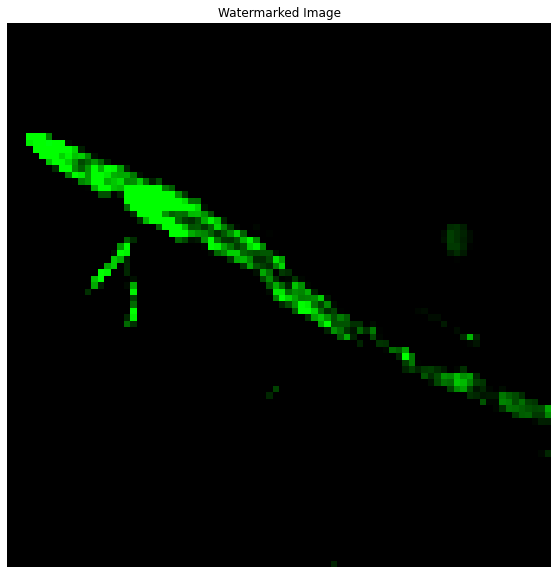

  9%|▉         | 1/11 [00:08<01:20,  8.05s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 10: Target opacity: 0, Labeled correctly: 0.5333333333333333, Correctly Predicted Target: True, Base class predicted: False


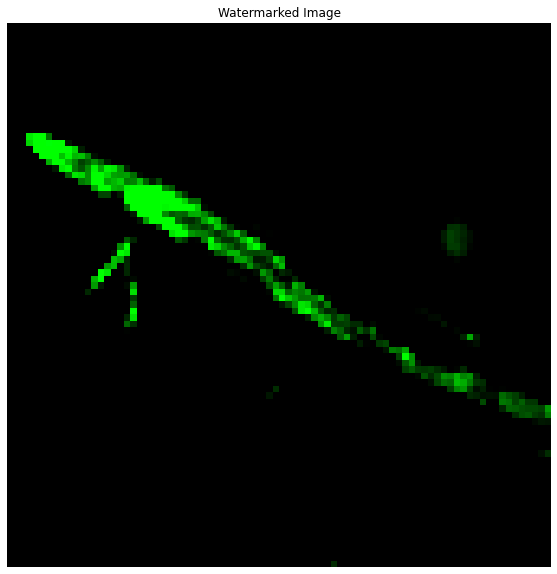

 18%|█▊        | 2/11 [00:15<01:11,  7.92s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 10: Target opacity: 0.05, Labeled correctly: 0.5333333333333333, Correctly Predicted Target: True, Base class predicted: False


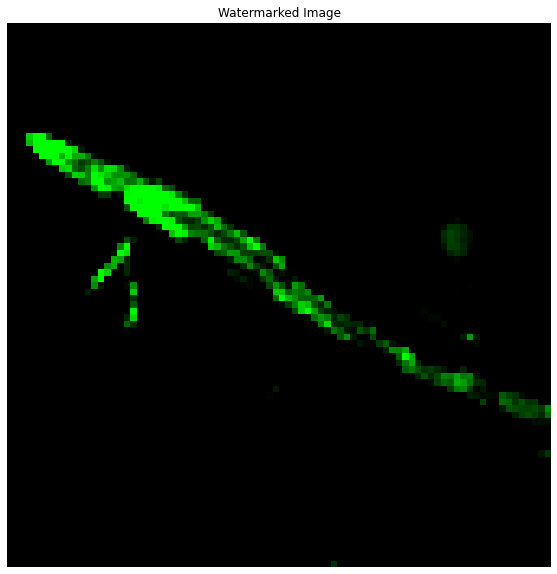

 27%|██▋       | 3/11 [00:23<01:03,  7.89s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 10: Target opacity: 0.1, Labeled correctly: 0.52, Correctly Predicted Target: True, Base class predicted: False


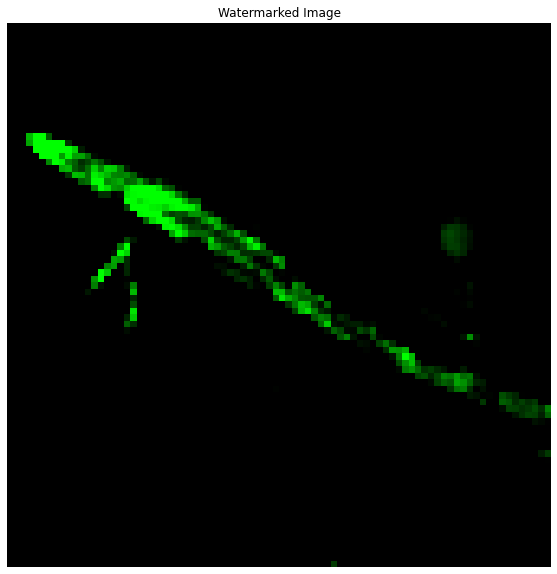

 36%|███▋      | 4/11 [00:31<00:54,  7.85s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 10: Target opacity: 0.15, Labeled correctly: 0.5333333333333333, Correctly Predicted Target: True, Base class predicted: False


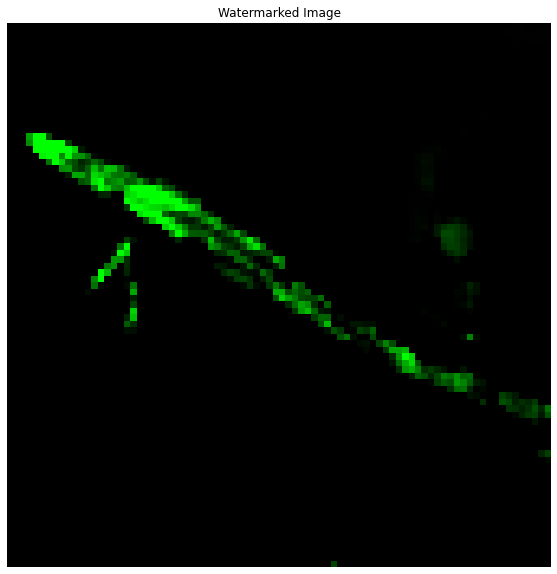

 45%|████▌     | 5/11 [00:39<00:46,  7.82s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 10: Target opacity: 0.2, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: True, Base class predicted: False


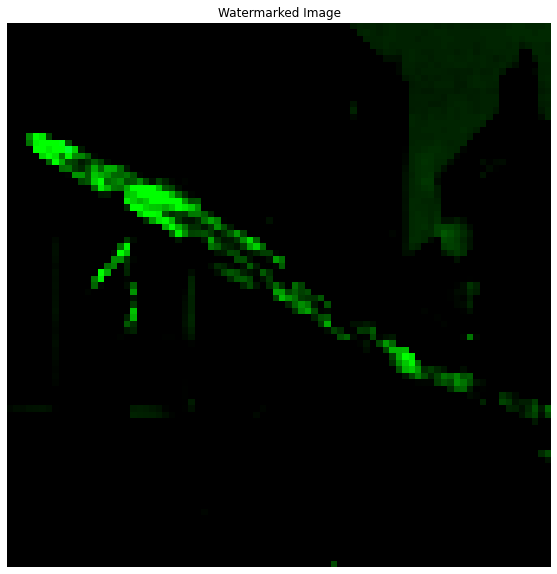

 55%|█████▍    | 6/11 [00:47<00:39,  7.83s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 10: Target opacity: 0.25, Labeled correctly: 0.5333333333333333, Correctly Predicted Target: True, Base class predicted: False


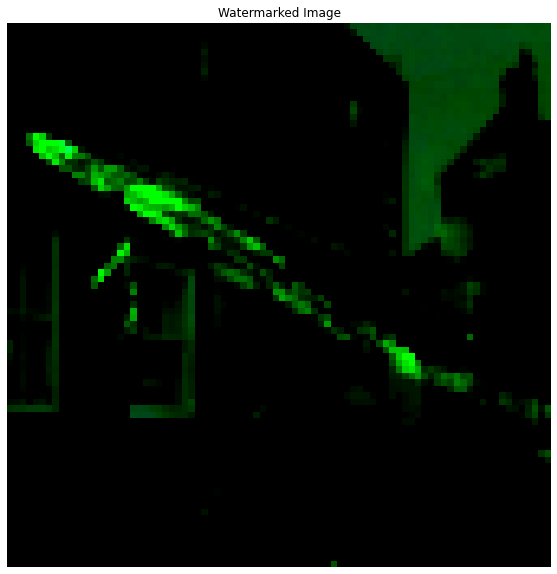

 64%|██████▎   | 7/11 [00:55<00:31,  7.86s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 10: Target opacity: 0.3, Labeled correctly: 0.5333333333333333, Correctly Predicted Target: True, Base class predicted: False


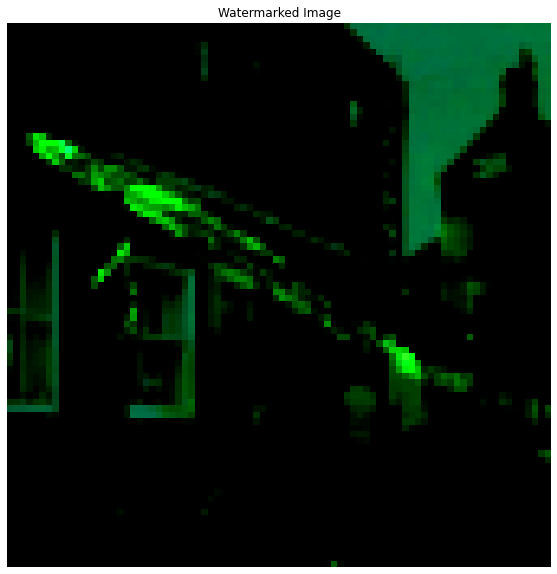

 73%|███████▎  | 8/11 [01:02<00:23,  7.85s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 10: Target opacity: 0.35, Labeled correctly: 0.5333333333333333, Correctly Predicted Target: True, Base class predicted: False


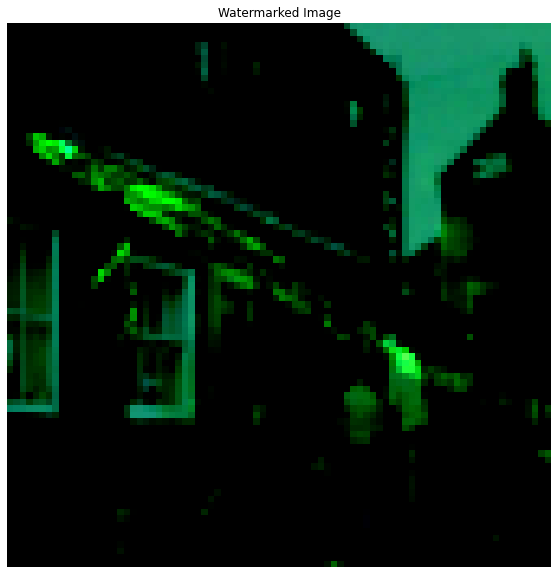

 82%|████████▏ | 9/11 [01:10<00:15,  7.87s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 10: Target opacity: 0.4, Labeled correctly: 0.5333333333333333, Correctly Predicted Target: True, Base class predicted: False


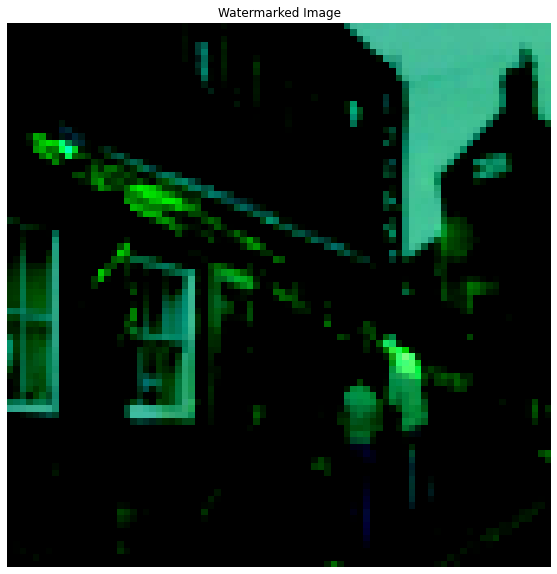

 91%|█████████ | 10/11 [01:18<00:07,  7.85s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 10: Target opacity: 0.45, Labeled correctly: 0.52, Correctly Predicted Target: False, Base class predicted: True


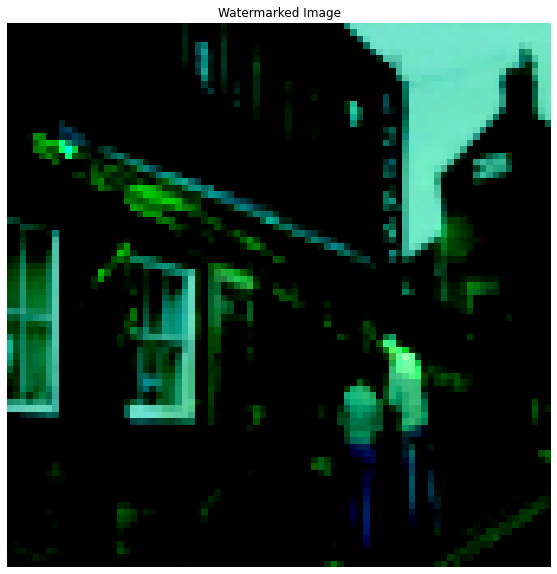

100%|██████████| 11/11 [01:26<00:00,  7.86s/it]

Iteration 10: Target opacity: 0.5, Labeled correctly: 0.52, Correctly Predicted Target: False, Base class predicted: True



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


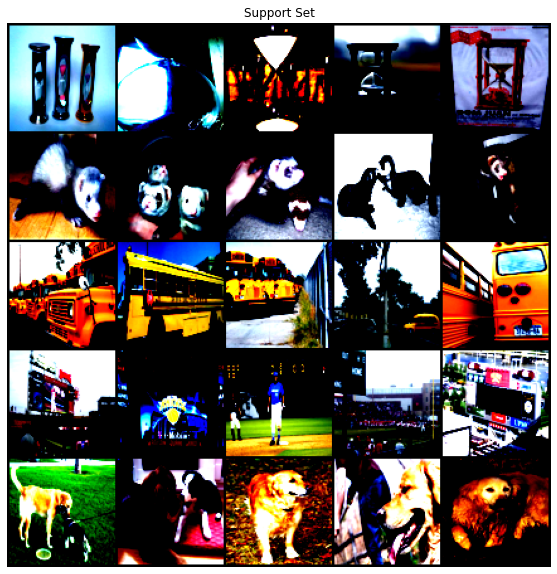

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 1, 1, 1, 1, 1, 2, 2, 2, 2,
         2]])


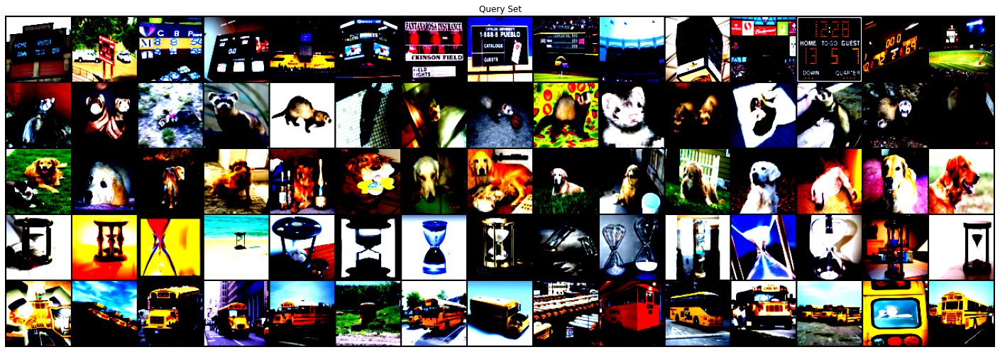

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3,
         3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
         4, 4, 4]])
target_class 3
unique_classes [0, 1, 2, 4]
base_class 2
target_indices [15 16 17 18 19 20 21 22 23 24 25 26 27 28 29]
target_index 28
base_indices [20 21 22 23 24]
base_index 21


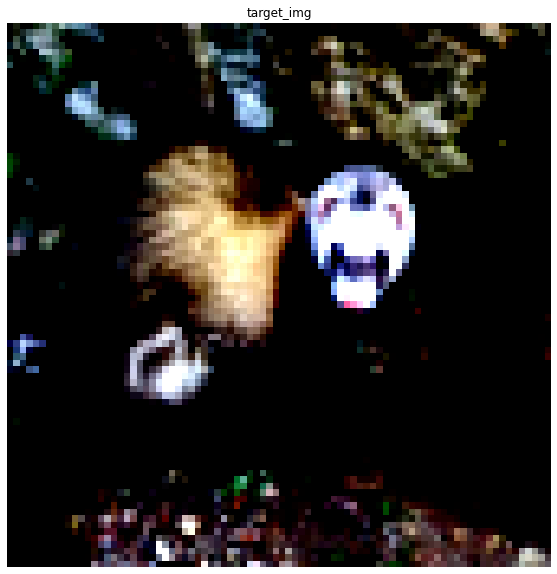

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


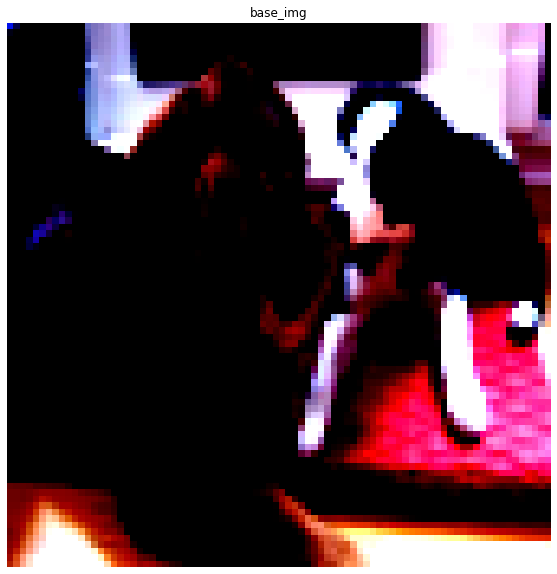

  0%|          | 3/1000 [00:00<00:34, 28.59it/s]

Iteration 0
loss: tensor(6.0376, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(40.9485, grad_fn=<PowBackward0>)
Iteration 2
loss: tensor(28.6214, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(25.5412, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(36.0904, grad_fn=<PowBackward0>)
Iteration 5


  1%|          | 9/1000 [00:00<00:37, 26.54it/s]

loss: tensor(17.9502, grad_fn=<PowBackward0>)
Iteration 6
loss: tensor(26.7308, grad_fn=<PowBackward0>)
Iteration 7
loss: tensor(11.1699, grad_fn=<PowBackward0>)
Iteration 8
loss: tensor(40.4338, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(9.6387, grad_fn=<PowBackward0>)
Iteration 10
loss: tensor(36.9869, grad_fn=<PowBackward0>)


  2%|▏         | 15/1000 [00:00<00:37, 25.99it/s]

Iteration 11
loss: tensor(21.3955, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(8.6292, grad_fn=<PowBackward0>)
Iteration 13
loss: tensor(41.3679, grad_fn=<PowBackward0>)
Iteration 14
loss: tensor(23.7414, grad_fn=<PowBackward0>)
Iteration 15
loss: tensor(10.7801, grad_fn=<PowBackward0>)
Iteration 16


  2%|▏         | 21/1000 [00:00<00:37, 26.13it/s]

loss: tensor(42.7765, grad_fn=<PowBackward0>)
Iteration 17
loss: tensor(30.4064, grad_fn=<PowBackward0>)
Iteration 18
loss: tensor(18.7047, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(28.0169, grad_fn=<PowBackward0>)
Iteration 20
loss: tensor(43.2286, grad_fn=<PowBackward0>)
Iteration 21
loss: tensor(33.8819, grad_fn=<PowBackward0>)


  3%|▎         | 27/1000 [00:01<00:37, 25.80it/s]

Iteration 22
loss: tensor(14.8504, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(25.3028, grad_fn=<PowBackward0>)
Iteration 24
loss: tensor(28.5096, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(33.8832, grad_fn=<PowBackward0>)
Iteration 26
loss: tensor(7.8542, grad_fn=<PowBackward0>)
Iteration 27


  3%|▎         | 30/1000 [00:01<00:38, 25.31it/s]

loss: tensor(31.6337, grad_fn=<PowBackward0>)
Iteration 28
loss: tensor(39.3291, grad_fn=<PowBackward0>)
Iteration 29
loss: tensor(19.3458, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(23.1469, grad_fn=<PowBackward0>)
Iteration 31
loss: tensor(8.2262, grad_fn=<PowBackward0>)
Iteration 32
loss: tensor(20.6427, grad_fn=<PowBackward0>)


  4%|▎         | 36/1000 [00:01<00:38, 25.34it/s]

Iteration 33
loss: tensor(38.5949, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(12.2158, grad_fn=<PowBackward0>)
Iteration 35
loss: tensor(16.2040, grad_fn=<PowBackward0>)
Iteration 36
loss: tensor(42.5736, grad_fn=<PowBackward0>)
Iteration 37
loss: tensor(18.2792, grad_fn=<PowBackward0>)
Iteration 38


  4%|▍         | 42/1000 [00:01<00:37, 25.58it/s]

loss: tensor(39.4673, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(12.3957, grad_fn=<PowBackward0>)
Iteration 40
loss: tensor(17.8547, grad_fn=<PowBackward0>)
Iteration 41
loss: tensor(16.8832, grad_fn=<PowBackward0>)
Iteration 42
loss: tensor(47.1964, grad_fn=<PowBackward0>)
Iteration 43
loss: tensor(51.0780, grad_fn=<PowBackward0>)


  5%|▍         | 48/1000 [00:01<00:36, 26.29it/s]

Iteration 44
loss: tensor(22.2865, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(32.8139, grad_fn=<PowBackward0>)
Iteration 46
loss: tensor(24.5975, grad_fn=<PowBackward0>)
Iteration 47
loss: tensor(34.7398, grad_fn=<PowBackward0>)
Iteration 48
loss: tensor(23.2301, grad_fn=<PowBackward0>)
Iteration 49
loss: tensor(34.2474, grad_fn=<PowBackward0>)


  5%|▌         | 54/1000 [00:02<00:36, 26.12it/s]

Iteration 50
loss: tensor(23.5837, grad_fn=<PowBackward0>)
Iteration 51
loss: tensor(20.4836, grad_fn=<PowBackward0>)
Iteration 52
loss: tensor(46.5937, grad_fn=<PowBackward0>)
Iteration 53
loss: tensor(37.8413, grad_fn=<PowBackward0>)
Iteration 54
loss: tensor(10.8978, grad_fn=<PowBackward0>)
Iteration 55


  6%|▌         | 60/1000 [00:02<00:36, 25.71it/s]

loss: tensor(16.6197, grad_fn=<PowBackward0>)
Iteration 56
loss: tensor(58.6184, grad_fn=<PowBackward0>)
Iteration 57
loss: tensor(20.3604, grad_fn=<PowBackward0>)
Iteration 58
loss: tensor(13.3468, grad_fn=<PowBackward0>)
Iteration 59
loss: tensor(44.2051, grad_fn=<PowBackward0>)
Iteration 60
loss: tensor(38.2743, grad_fn=<PowBackward0>)


  7%|▋         | 66/1000 [00:02<00:36, 25.86it/s]

Iteration 61
loss: tensor(10.9276, grad_fn=<PowBackward0>)
Iteration 62
loss: tensor(21.9277, grad_fn=<PowBackward0>)
Iteration 63
loss: tensor(26.5635, grad_fn=<PowBackward0>)
Iteration 64
loss: tensor(16.9658, grad_fn=<PowBackward0>)
Iteration 65
loss: tensor(10.7592, grad_fn=<PowBackward0>)
Iteration 66


  7%|▋         | 69/1000 [00:02<00:36, 25.79it/s]

loss: tensor(33.7117, grad_fn=<PowBackward0>)
Iteration 67
loss: tensor(36.6223, grad_fn=<PowBackward0>)
Iteration 68
loss: tensor(20.0196, grad_fn=<PowBackward0>)
Iteration 69
loss: tensor(16.8711, grad_fn=<PowBackward0>)
Iteration 70
loss: tensor(39.0607, grad_fn=<PowBackward0>)
Iteration 71
loss: tensor(21.0563, grad_fn=<PowBackward0>)


  8%|▊         | 75/1000 [00:02<00:35, 26.36it/s]

Iteration 72
loss: tensor(9.0861, grad_fn=<PowBackward0>)
Iteration 73
loss: tensor(24.1273, grad_fn=<PowBackward0>)
Iteration 74
loss: tensor(43.8456, grad_fn=<PowBackward0>)
Iteration 75
loss: tensor(30.3873, grad_fn=<PowBackward0>)
Iteration 76
loss: tensor(28.1708, grad_fn=<PowBackward0>)
Iteration 77
loss: tensor(16.1021, grad_fn=<PowBackward0>)


  8%|▊         | 81/1000 [00:03<00:34, 26.64it/s]

Iteration 78
loss: tensor(36.7985, grad_fn=<PowBackward0>)
Iteration 79
loss: tensor(15.8498, grad_fn=<PowBackward0>)
Iteration 80
loss: tensor(23.0988, grad_fn=<PowBackward0>)
Iteration 81
loss: tensor(21.2528, grad_fn=<PowBackward0>)
Iteration 82
loss: tensor(24.2684, grad_fn=<PowBackward0>)
Iteration 83


  9%|▊         | 87/1000 [00:03<00:35, 26.07it/s]

loss: tensor(17.1132, grad_fn=<PowBackward0>)
Iteration 84
loss: tensor(37.2947, grad_fn=<PowBackward0>)
Iteration 85
loss: tensor(10.3650, grad_fn=<PowBackward0>)
Iteration 86
loss: tensor(32.3995, grad_fn=<PowBackward0>)
Iteration 87
loss: tensor(22.1793, grad_fn=<PowBackward0>)
Iteration 88
loss: tensor(18.6425, grad_fn=<PowBackward0>)


  9%|▉         | 93/1000 [00:03<00:35, 25.84it/s]

Iteration 89
loss: tensor(13.3397, grad_fn=<PowBackward0>)
Iteration 90
loss: tensor(36.3286, grad_fn=<PowBackward0>)
Iteration 91
loss: tensor(39.8472, grad_fn=<PowBackward0>)
Iteration 92
loss: tensor(30.4217, grad_fn=<PowBackward0>)
Iteration 93
loss: tensor(19.7960, grad_fn=<PowBackward0>)
Iteration

 10%|▉         | 99/1000 [00:03<00:33, 26.88it/s]

 94
loss: tensor(32.6604, grad_fn=<PowBackward0>)
Iteration 95
loss: tensor(6.2163, grad_fn=<PowBackward0>)
Iteration 96
loss: tensor(41.8324, grad_fn=<PowBackward0>)
Iteration 97
loss: tensor(37.6356, grad_fn=<PowBackward0>)
Iteration 98
loss: tensor(3.9488, grad_fn=<PowBackward0>)
Iteration 99
loss: tensor(18.1974, grad_fn=<PowBackward0>)


 10%|█         | 105/1000 [00:04<00:32, 27.43it/s]

Iteration 100
loss: tensor(39.2211, grad_fn=<PowBackward0>)
Iteration 101
loss: tensor(13.8508, grad_fn=<PowBackward0>)
Iteration 102
loss: tensor(14.0635, grad_fn=<PowBackward0>)
Iteration 103
loss: tensor(16.2850, grad_fn=<PowBackward0>)
Iteration 104
loss: tensor(35.7375, grad_fn=<PowBackward0>)
Iteration 105
loss: tensor(27.1433, grad_fn=<PowBackward0>)


 11%|█         | 111/1000 [00:04<00:33, 26.44it/s]

Iteration 106
loss: tensor(17.8035, grad_fn=<PowBackward0>)
Iteration 107
loss: tensor(15.2992, grad_fn=<PowBackward0>)
Iteration 108
loss: tensor(33.8682, grad_fn=<PowBackward0>)
Iteration 109
loss: tensor(19.3428, grad_fn=<PowBackward0>)
Iteration 110
loss: tensor(50.8935, grad_fn=<PowBackward0>)
Iteration 111


 11%|█▏        | 114/1000 [00:04<00:33, 26.21it/s]

loss: tensor(9.9161, grad_fn=<PowBackward0>)
Iteration 112
loss: tensor(30.6384, grad_fn=<PowBackward0>)
Iteration 113
loss: tensor(21.2469, grad_fn=<PowBackward0>)
Iteration 114
loss: tensor(36.9477, grad_fn=<PowBackward0>)
Iteration 115
loss: tensor(18.6722, grad_fn=<PowBackward0>)
Iteration 116


 12%|█▏        | 120/1000 [00:04<00:34, 25.28it/s]

loss: tensor(24.9096, grad_fn=<PowBackward0>)
Iteration 117
loss: tensor(3.9532, grad_fn=<PowBackward0>)
Iteration 118
loss: tensor(23.7920, grad_fn=<PowBackward0>)
Iteration 119
loss: tensor(16.9029, grad_fn=<PowBackward0>)
Iteration 120
loss: tensor(41.0687, grad_fn=<PowBackward0>)
Iteration 121
loss: tensor(13.9860, grad_fn=<PowBackward0>)


 13%|█▎        | 126/1000 [00:04<00:33, 25.93it/s]

Iteration 122
loss: tensor(16.3127, grad_fn=<PowBackward0>)
Iteration 123
loss: tensor(29.0634, grad_fn=<PowBackward0>)
Iteration 124
loss: tensor(33.8527, grad_fn=<PowBackward0>)
Iteration 125
loss: tensor(16.6530, grad_fn=<PowBackward0>)
Iteration 126
loss: tensor(38.6225, grad_fn=<PowBackward0>)
Iteration 127


 13%|█▎        | 132/1000 [00:05<00:35, 24.69it/s]

loss: tensor(5.0503, grad_fn=<PowBackward0>)
Iteration 128
loss: tensor(14.6644, grad_fn=<PowBackward0>)
Iteration 129
loss: tensor(13.8475, grad_fn=<PowBackward0>)
Iteration 130
loss: tensor(44.9552, grad_fn=<PowBackward0>)
Iteration 131
loss: tensor(19.7956, grad_fn=<PowBackward0>)
Iteration 132


 14%|█▎        | 135/1000 [00:05<00:34, 25.17it/s]

loss: tensor(22.7160, grad_fn=<PowBackward0>)
Iteration 133
loss: tensor(12.5527, grad_fn=<PowBackward0>)
Iteration 134
loss: tensor(29.2481, grad_fn=<PowBackward0>)
Iteration 135
loss: tensor(15.7619, grad_fn=<PowBackward0>)
Iteration 136
loss: tensor(21.7509, grad_fn=<PowBackward0>)
Iteration 137
loss: tensor(14.2085, grad_fn=<PowBackward0>)


 14%|█▍        | 141/1000 [00:05<00:33, 25.79it/s]

Iteration 138
loss: tensor(19.1989, grad_fn=<PowBackward0>)
Iteration 139
loss: tensor(24.8880, grad_fn=<PowBackward0>)
Iteration 140
loss: tensor(35.1208, grad_fn=<PowBackward0>)
Iteration 141
loss: tensor(18.4061, grad_fn=<PowBackward0>)
Iteration 142
loss: tensor(16.3376, grad_fn=<PowBackward0>)
Iteration 143


 15%|█▍        | 147/1000 [00:05<00:33, 25.79it/s]

loss: tensor(13.0687, grad_fn=<PowBackward0>)
Iteration 144
loss: tensor(33.6515, grad_fn=<PowBackward0>)
Iteration 145
loss: tensor(20.2874, grad_fn=<PowBackward0>)
Iteration 146
loss: tensor(13.1788, grad_fn=<PowBackward0>)
Iteration 147
loss: tensor(5.1222, grad_fn=<PowBackward0>)
Iteration 148
loss: tensor(37.3259, grad_fn=<PowBackward0>)


 15%|█▌        | 153/1000 [00:05<00:31, 26.53it/s]

Iteration 149
loss: tensor(24.9328, grad_fn=<PowBackward0>)
Iteration 150
loss: tensor(18.4335, grad_fn=<PowBackward0>)
Iteration 151
loss: tensor(24.1049, grad_fn=<PowBackward0>)
Iteration 152
loss: tensor(21.5841, grad_fn=<PowBackward0>)
Iteration 153
loss: tensor(15.0337, grad_fn=<PowBackward0>)
Iteration 154
loss: tensor(39.8231, grad_fn=<PowBackward0>)


 16%|█▌        | 159/1000 [00:06<00:31, 26.63it/s]

Iteration 155
loss: tensor(7.8479, grad_fn=<PowBackward0>)
Iteration 156
loss: tensor(25.2586, grad_fn=<PowBackward0>)
Iteration 157
loss: tensor(19.8535, grad_fn=<PowBackward0>)
Iteration 158
loss: tensor(37.6102, grad_fn=<PowBackward0>)
Iteration 159
loss: tensor(14.1107, grad_fn=<PowBackward0>)
Iteration 160


 16%|█▋        | 165/1000 [00:06<00:31, 26.20it/s]

loss: tensor(15.0762, grad_fn=<PowBackward0>)
Iteration 161
loss: tensor(26.8309, grad_fn=<PowBackward0>)
Iteration 162
loss: tensor(38.2950, grad_fn=<PowBackward0>)
Iteration 163
loss: tensor(16.2631, grad_fn=<PowBackward0>)
Iteration 164
loss: tensor(24.0702, grad_fn=<PowBackward0>)
Iteration 165
loss: tensor(10.2101, grad_fn=<PowBackward0>)


 17%|█▋        | 171/1000 [00:06<00:32, 25.78it/s]

Iteration 166
loss: tensor(26.0991, grad_fn=<PowBackward0>)
Iteration 167
loss: tensor(17.9849, grad_fn=<PowBackward0>)
Iteration 168
loss: tensor(19.6971, grad_fn=<PowBackward0>)
Iteration 169
loss: tensor(23.7059, grad_fn=<PowBackward0>)
Iteration 170
loss: tensor(30.4445, grad_fn=<PowBackward0>)
Iteration 171


 18%|█▊        | 177/1000 [00:06<00:31, 26.29it/s]

loss: tensor(12.1267, grad_fn=<PowBackward0>)
Iteration 172
loss: tensor(20.9213, grad_fn=<PowBackward0>)
Iteration 173
loss: tensor(21.2059, grad_fn=<PowBackward0>)
Iteration 174
loss: tensor(30.8796, grad_fn=<PowBackward0>)
Iteration 175
loss: tensor(13.6107, grad_fn=<PowBackward0>)
Iteration 176
loss: tensor(22.9530, grad_fn=<PowBackward0>)


 18%|█▊        | 180/1000 [00:06<00:31, 26.44it/s]

Iteration 177
loss: tensor(32.2211, grad_fn=<PowBackward0>)
Iteration 178
loss: tensor(23.9799, grad_fn=<PowBackward0>)
Iteration 179
loss: tensor(20.6469, grad_fn=<PowBackward0>)
Iteration 180
loss: tensor(20.9516, grad_fn=<PowBackward0>)
Iteration 181
loss: tensor(13.7483, grad_fn=<PowBackward0>)
Iteration 182


 19%|█▊        | 186/1000 [00:07<00:31, 25.89it/s]

loss: tensor(30.7544, grad_fn=<PowBackward0>)
Iteration 183
loss: tensor(13.1950, grad_fn=<PowBackward0>)
Iteration 184
loss: tensor(28.6229, grad_fn=<PowBackward0>)
Iteration 185
loss: tensor(18.4676, grad_fn=<PowBackward0>)
Iteration 186
loss: tensor(20.1424, grad_fn=<PowBackward0>)
Iteration 187
loss: tensor(20.4022, grad_fn=<PowBackward0>)


 19%|█▉        | 192/1000 [00:07<00:31, 25.55it/s]

Iteration 188
loss: tensor(49.6622, grad_fn=<PowBackward0>)
Iteration 189
loss: tensor(15.7405, grad_fn=<PowBackward0>)
Iteration 190
loss: tensor(22.1883, grad_fn=<PowBackward0>)
Iteration 191
loss: tensor(13.4154, grad_fn=<PowBackward0>)
Iteration 192
loss: tensor(30.3487, grad_fn=<PowBackward0>)
Iteration 193


 20%|█▉        | 195/1000 [00:07<00:31, 25.27it/s]

loss: tensor(42.2647, grad_fn=<PowBackward0>)
Iteration 194
loss: tensor(15.8240, grad_fn=<PowBackward0>)
Iteration 195
loss: tensor(21.9256, grad_fn=<PowBackward0>)
Iteration 196
loss: tensor(12.3792, grad_fn=<PowBackward0>)
Iteration 197
loss: tensor(9.6635, grad_fn=<PowBackward0>)


 20%|██        | 201/1000 [00:07<00:31, 25.19it/s]

Iteration 198
loss: tensor(33.0670, grad_fn=<PowBackward0>)
Iteration 199
loss: tensor(10.0961, grad_fn=<PowBackward0>)
Iteration 200
loss: tensor(22.0004, grad_fn=<PowBackward0>)
Iteration 201
loss: tensor(14.3286, grad_fn=<PowBackward0>)
Iteration 202
loss: tensor(12.9213, grad_fn=<PowBackward0>)
Iteration 203
loss: tensor(15.1649, grad_fn=<PowBackward0>)


 21%|██        | 207/1000 [00:08<00:31, 25.44it/s]

Iteration 204
loss: tensor(21.7458, grad_fn=<PowBackward0>)
Iteration 205
loss: tensor(15.3877, grad_fn=<PowBackward0>)
Iteration 206
loss: tensor(23.4281, grad_fn=<PowBackward0>)
Iteration 207
loss: tensor(10.9864, grad_fn=<PowBackward0>)
Iteration 208
loss: tensor(11.5077, grad_fn=<PowBackward0>)
Iteration 209
loss: tensor(8.5465, grad_fn=<PowBackward0>)


 21%|██▏       | 213/1000 [00:08<00:30, 26.23it/s]

Iteration 210
loss: tensor(19.0785, grad_fn=<PowBackward0>)
Iteration 211
loss: tensor(7.7368, grad_fn=<PowBackward0>)
Iteration 212
loss: tensor(21.5832, grad_fn=<PowBackward0>)
Iteration 213
loss: tensor(23.6159, grad_fn=<PowBackward0>)
Iteration 214
loss: tensor(11.5264, grad_fn=<PowBackward0>)
Iteration 215


 22%|██▏       | 219/1000 [00:08<00:30, 25.73it/s]

loss: tensor(13.0436, grad_fn=<PowBackward0>)
Iteration 216
loss: tensor(16.7772, grad_fn=<PowBackward0>)
Iteration 217
loss: tensor(8.1529, grad_fn=<PowBackward0>)
Iteration 218
loss: tensor(16.1491, grad_fn=<PowBackward0>)
Iteration 219
loss: tensor(23.6441, grad_fn=<PowBackward0>)
Iteration 220
loss: tensor(13.1103, grad_fn=<PowBackward0>)


 22%|██▎       | 225/1000 [00:08<00:30, 25.48it/s]

Iteration 221
loss: tensor(13.0041, grad_fn=<PowBackward0>)
Iteration 222
loss: tensor(12.8947, grad_fn=<PowBackward0>)
Iteration 223
loss: tensor(4.8538, grad_fn=<PowBackward0>)
Iteration 224
loss: tensor(10.6647, grad_fn=<PowBackward0>)
Iteration 225
loss: tensor(5.4384, grad_fn=<PowBackward0>)
Iteration 

 23%|██▎       | 231/1000 [00:08<00:29, 26.02it/s]

226
loss: tensor(38.2029, grad_fn=<PowBackward0>)
Iteration 227
loss: tensor(13.2013, grad_fn=<PowBackward0>)
Iteration 228
loss: tensor(8.8054, grad_fn=<PowBackward0>)
Iteration 229
loss: tensor(12.3132, grad_fn=<PowBackward0>)
Iteration 230
loss: tensor(22.1449, grad_fn=<PowBackward0>)
Iteration 231


 24%|██▎       | 237/1000 [00:09<00:28, 26.73it/s]

loss: tensor(15.0259, grad_fn=<PowBackward0>)
Iteration 232
loss: tensor(21.4690, grad_fn=<PowBackward0>)
Iteration 233
loss: tensor(16.2215, grad_fn=<PowBackward0>)
Iteration 234
loss: tensor(12.9333, grad_fn=<PowBackward0>)
Iteration 235
loss: tensor(9.6334, grad_fn=<PowBackward0>)
Iteration 236
loss: tensor(29.2918, grad_fn=<PowBackward0>)


 24%|██▍       | 240/1000 [00:09<00:28, 26.40it/s]

Iteration 237
loss: tensor(10.0943, grad_fn=<PowBackward0>)
Iteration 238
loss: tensor(24.6279, grad_fn=<PowBackward0>)
Iteration 239
loss: tensor(13.4794, grad_fn=<PowBackward0>)
Iteration 240
loss: tensor(10.8905, grad_fn=<PowBackward0>)
Iteration 241
loss: tensor(29.6059, grad_fn=<PowBackward0>)
Iteration 242
loss: tensor(18.1108, grad_fn=<PowBackward0>)


 25%|██▍       | 246/1000 [00:09<00:28, 26.62it/s]

Iteration 243
loss: tensor(9.4298, grad_fn=<PowBackward0>)
Iteration 244
loss: tensor(11.7684, grad_fn=<PowBackward0>)
Iteration 245
loss: tensor(13.4948, grad_fn=<PowBackward0>)
Iteration 246
loss: tensor(18.5069, grad_fn=<PowBackward0>)
Iteration 247
loss: tensor(21.5427, grad_fn=<PowBackward0>)
Iteration 248
loss: tensor(9.1501, grad_fn=<PowBackward0>)


 25%|██▌       | 252/1000 [00:09<00:27, 26.87it/s]

Iteration 249
loss: tensor(8.8082, grad_fn=<PowBackward0>)
Iteration 250
loss: tensor(16.5126, grad_fn=<PowBackward0>)
Iteration 251
loss: tensor(14.7173, grad_fn=<PowBackward0>)
Iteration 252
loss: tensor(15.6112, grad_fn=<PowBackward0>)
Iteration 253
loss: tensor(15.4952, grad_fn=<PowBackward0>)
Iteration 254
loss: tensor(11.1813, grad_fn=<PowBackward0>)


 26%|██▌       | 258/1000 [00:09<00:28, 25.64it/s]

Iteration 255
loss: tensor(14.3727, grad_fn=<PowBackward0>)
Iteration 256
loss: tensor(22.3227, grad_fn=<PowBackward0>)
Iteration 257
loss: tensor(9.5698, grad_fn=<PowBackward0>)
Iteration 258
loss: tensor(16.0654, grad_fn=<PowBackward0>)
Iteration 259
loss: tensor(11.8647, grad_fn=<PowBackward0>)
Iteration 260


 26%|██▋       | 264/1000 [00:10<00:28, 25.40it/s]

loss: tensor(20.3867, grad_fn=<PowBackward0>)
Iteration 261
loss: tensor(17.3063, grad_fn=<PowBackward0>)
Iteration 262
loss: tensor(21.7591, grad_fn=<PowBackward0>)
Iteration 263
loss: tensor(16.5932, grad_fn=<PowBackward0>)
Iteration 264
loss: tensor(25.1538, grad_fn=<PowBackward0>)
Iteration 265
loss:

 27%|██▋       | 270/1000 [00:10<00:29, 25.16it/s]

 tensor(6.8939, grad_fn=<PowBackward0>)
Iteration 266
loss: tensor(11.5235, grad_fn=<PowBackward0>)
Iteration 267
loss: tensor(14.7142, grad_fn=<PowBackward0>)
Iteration 268
loss: tensor(17.8651, grad_fn=<PowBackward0>)
Iteration 269
loss: tensor(6.8513, grad_fn=<PowBackward0>)
Iteration 270
loss: tensor(13.4651, grad_fn=<PowBackward0>)


 28%|██▊       | 276/1000 [00:10<00:28, 25.52it/s]

Iteration 271
loss: tensor(9.4351, grad_fn=<PowBackward0>)
Iteration 272
loss: tensor(13.6801, grad_fn=<PowBackward0>)
Iteration 273
loss: tensor(2.7005, grad_fn=<PowBackward0>)
Iteration 274
loss: tensor(16.8662, grad_fn=<PowBackward0>)
Iteration 275
loss: tensor(25.8208, grad_fn=<PowBackward0>)
Iteration 276


 28%|██▊       | 282/1000 [00:10<00:27, 26.30it/s]

loss: tensor(13.2564, grad_fn=<PowBackward0>)
Iteration 277
loss: tensor(13.4584, grad_fn=<PowBackward0>)
Iteration 278
loss: tensor(29.8534, grad_fn=<PowBackward0>)
Iteration 279
loss: tensor(12.2577, grad_fn=<PowBackward0>)
Iteration 280
loss: tensor(14.1392, grad_fn=<PowBackward0>)
Iteration 281
loss: tensor(13.5605, grad_fn=<PowBackward0>)


 28%|██▊       | 285/1000 [00:11<00:27, 26.28it/s]

Iteration 282
loss: tensor(13.7180, grad_fn=<PowBackward0>)
Iteration 283
loss: tensor(9.1122, grad_fn=<PowBackward0>)
Iteration 284
loss: tensor(15.7984, grad_fn=<PowBackward0>)
Iteration 285
loss: tensor(12.9715, grad_fn=<PowBackward0>)
Iteration 286
loss: tensor(26.5229, grad_fn=<PowBackward0>)
Iteration 287


 29%|██▉       | 291/1000 [00:11<00:27, 26.04it/s]

loss: tensor(13.7919, grad_fn=<PowBackward0>)
Iteration 288
loss: tensor(19.6366, grad_fn=<PowBackward0>)
Iteration 289
loss: tensor(7.9262, grad_fn=<PowBackward0>)
Iteration 290
loss: tensor(9.2826, grad_fn=<PowBackward0>)
Iteration 291
loss: tensor(6.9644, grad_fn=<PowBackward0>)
Iteration 292
loss: tensor(25.8464, grad_fn=<PowBackward0>)


 30%|██▉       | 297/1000 [00:11<00:27, 25.73it/s]

Iteration 293
loss: tensor(21.8564, grad_fn=<PowBackward0>)
Iteration 294
loss: tensor(20.7286, grad_fn=<PowBackward0>)
Iteration 295
loss: tensor(13.3301, grad_fn=<PowBackward0>)
Iteration 296
loss: tensor(12.5784, grad_fn=<PowBackward0>)
Iteration 297
loss: tensor(4.5810, grad_fn=<PowBackward0>)
Iteration 298


 30%|███       | 303/1000 [00:11<00:27, 25.19it/s]

loss: tensor(18.8473, grad_fn=<PowBackward0>)
Iteration 299
loss: tensor(11.1040, grad_fn=<PowBackward0>)
Iteration 300
loss: tensor(23.8471, grad_fn=<PowBackward0>)
Iteration 301
loss: tensor(15.9266, grad_fn=<PowBackward0>)
Iteration 302
loss: tensor(3.7985, grad_fn=<PowBackward0>)
Iteration 303
loss: tensor(1.9745, grad_fn=<PowBackward0>)

 31%|███       | 306/1000 [00:11<00:26, 25.79it/s]


Iteration 304
loss: tensor(1.1803, grad_fn=<PowBackward0>)
Iteration 305
loss: tensor(1.7111, grad_fn=<PowBackward0>)
Iteration 306
loss: tensor(6.8309, grad_fn=<PowBackward0>)
Iteration 307
loss: tensor(5.9528, grad_fn=<PowBackward0>)
Iteration 308
loss: tensor(6.0846, grad_fn=<PowBackward0>)


 31%|███       | 312/1000 [00:12<00:26, 26.31it/s]

Iteration 309
loss: tensor(3.3618, grad_fn=<PowBackward0>)
Iteration 310
loss: tensor(6.9086, grad_fn=<PowBackward0>)
Iteration 311
loss: tensor(3.1284, grad_fn=<PowBackward0>)
Iteration 312
loss: tensor(6.4795, grad_fn=<PowBackward0>)
Iteration 313
loss: tensor(3.0965, grad_fn=<PowBackward0>)
Iteration 314
loss: tensor(5.9103, grad_fn=<PowBackward0>)

 32%|███▏      | 318/1000 [00:12<00:26, 25.85it/s]


Iteration 315
loss: tensor(5.1416, grad_fn=<PowBackward0>)
Iteration 316
loss: tensor(11.9214, grad_fn=<PowBackward0>)
Iteration 317
loss: tensor(9.4478, grad_fn=<PowBackward0>)
Iteration 318
loss: tensor(11.8220, grad_fn=<PowBackward0>)
Iteration 319
loss: tensor(4.2136, grad_fn=<PowBackward0>)


 32%|███▏      | 324/1000 [00:12<00:26, 25.92it/s]

Iteration 320
loss: tensor(5.1831, grad_fn=<PowBackward0>)
Iteration 321
loss: tensor(4.7128, grad_fn=<PowBackward0>)
Iteration 322
loss: tensor(5.8488, grad_fn=<PowBackward0>)
Iteration 323
loss: tensor(4.0550, grad_fn=<PowBackward0>)
Iteration 324
loss: tensor(9.8123, grad_fn=<PowBackward0>)


 33%|███▎      | 330/1000 [00:12<00:25, 26.04it/s]

Iteration 325
loss: tensor(5.5972, grad_fn=<PowBackward0>)
Iteration 326
loss: tensor(10.2563, grad_fn=<PowBackward0>)
Iteration 327
loss: tensor(6.8204, grad_fn=<PowBackward0>)
Iteration 328
loss: tensor(7.4130, grad_fn=<PowBackward0>)
Iteration 329
loss: tensor(1.9747, grad_fn=<PowBackward0>)
Iteration 330


 34%|███▎      | 336/1000 [00:12<00:24, 26.83it/s]

loss: tensor(5.4745, grad_fn=<PowBackward0>)
Iteration 331
loss: tensor(4.1431, grad_fn=<PowBackward0>)
Iteration 332
loss: tensor(5.2174, grad_fn=<PowBackward0>)
Iteration 333
loss: tensor(6.8021, grad_fn=<PowBackward0>)
Iteration 334
loss: tensor(7.8237, grad_fn=<PowBackward0>)
Iteration 335
loss: tensor(4.7160, grad_fn=<PowBackward0>)
Iteration 336


 34%|███▍      | 342/1000 [00:13<00:24, 27.28it/s]

loss: tensor(9.0218, grad_fn=<PowBackward0>)
Iteration 337
loss: tensor(3.5820, grad_fn=<PowBackward0>)
Iteration 338
loss: tensor(7.0362, grad_fn=<PowBackward0>)
Iteration 339
loss: tensor(7.7077, grad_fn=<PowBackward0>)
Iteration 340
loss: tensor(8.5672, grad_fn=<PowBackward0>)
Iteration 341
loss: tensor(3.2304, grad_fn=<PowBackward0>)
Iteration

 34%|███▍      | 345/1000 [00:13<00:24, 27.13it/s]

 342
loss: tensor(5.5191, grad_fn=<PowBackward0>)
Iteration 343
loss: tensor(6.1990, grad_fn=<PowBackward0>)
Iteration 344
loss: tensor(7.0310, grad_fn=<PowBackward0>)
Iteration 345
loss: tensor(3.3605, grad_fn=<PowBackward0>)
Iteration 346
loss: tensor(5.7602, grad_fn=<PowBackward0>)
Iteration 347
loss: tensor(3.8517, grad_fn=<PowBackward0>)


 35%|███▌      | 351/1000 [00:13<00:24, 26.90it/s]

Iteration 348
loss: tensor(3.3429, grad_fn=<PowBackward0>)
Iteration 349
loss: tensor(1.9373, grad_fn=<PowBackward0>)
Iteration 350
loss: tensor(4.0126, grad_fn=<PowBackward0>)
Iteration 351
loss: tensor(4.8802, grad_fn=<PowBackward0>)
Iteration 352
loss: tensor(10.6680, grad_fn=<PowBackward0>)
Iteration 353
loss: tensor(11.8910, grad_fn=<PowBackward0>)


 36%|███▌      | 357/1000 [00:13<00:24, 25.83it/s]

Iteration 354
loss: tensor(10.7163, grad_fn=<PowBackward0>)
Iteration 355
loss: tensor(3.1166, grad_fn=<PowBackward0>)
Iteration 356
loss: tensor(2.7869, grad_fn=<PowBackward0>)
Iteration 357
loss: tensor(1.8734, grad_fn=<PowBackward0>)
Iteration 358
loss: tensor(3.1273, grad_fn=<PowBackward0>)
Iteration 359


 36%|███▋      | 363/1000 [00:13<00:23, 26.69it/s]

loss: tensor(3.2368, grad_fn=<PowBackward0>)
Iteration 360
loss: tensor(12.8680, grad_fn=<PowBackward0>)
Iteration 361
loss: tensor(8.9912, grad_fn=<PowBackward0>)
Iteration 362
loss: tensor(6.4329, grad_fn=<PowBackward0>)
Iteration 363
loss: tensor(4.8469, grad_fn=<PowBackward0>)
Iteration 364
loss: tensor(2.4915, grad_fn=<PowBackward0>)
Iteration 365


 37%|███▋      | 369/1000 [00:14<00:23, 27.30it/s]

loss: tensor(2.2417, grad_fn=<PowBackward0>)
Iteration 366
loss: tensor(3.3084, grad_fn=<PowBackward0>)
Iteration 367
loss: tensor(3.0335, grad_fn=<PowBackward0>)
Iteration 368
loss: tensor(11.0009, grad_fn=<PowBackward0>)
Iteration 369
loss: tensor(4.6000, grad_fn=<PowBackward0>)
Iteration 370
loss: tensor(5.6870, grad_fn=<PowBackward0>)
Iteration 371


 38%|███▊      | 375/1000 [00:14<00:22, 27.34it/s]

loss: tensor(2.9672, grad_fn=<PowBackward0>)
Iteration 372
loss: tensor(4.3990, grad_fn=<PowBackward0>)
Iteration 373
loss: tensor(4.3719, grad_fn=<PowBackward0>)
Iteration 374
loss: tensor(7.5869, grad_fn=<PowBackward0>)
Iteration 375
loss: tensor(7.5540, grad_fn=<PowBackward0>)
Iteration 376
loss: tensor(11.6218, grad_fn=<PowBackward0>)


 38%|███▊      | 381/1000 [00:14<00:23, 26.77it/s]

Iteration 377
loss: tensor(7.2447, grad_fn=<PowBackward0>)
Iteration 378
loss: tensor(12.9676, grad_fn=<PowBackward0>)
Iteration 379
loss: tensor(8.4944, grad_fn=<PowBackward0>)
Iteration 380
loss: tensor(3.3985, grad_fn=<PowBackward0>)
Iteration 381
loss: tensor(0.8105, grad_fn=<PowBackward0>)


 39%|███▊      | 387/1000 [00:14<00:23, 26.19it/s]

Iteration 382
loss: tensor(0.7052, grad_fn=<PowBackward0>)
Iteration 383
loss: tensor(0.3639, grad_fn=<PowBackward0>)
Iteration 384
loss: tensor(1.5110, grad_fn=<PowBackward0>)
Iteration 385
loss: tensor(2.5844, grad_fn=<PowBackward0>)
Iteration 386
loss: tensor(11.7939, grad_fn=<PowBackward0>)
Iteration 387


 39%|███▉      | 393/1000 [00:15<00:22, 26.84it/s]

loss: tensor(7.6822, grad_fn=<PowBackward0>)
Iteration 388
loss: tensor(6.6727, grad_fn=<PowBackward0>)
Iteration 389
loss: tensor(1.5722, grad_fn=<PowBackward0>)
Iteration 390
loss: tensor(3.5360, grad_fn=<PowBackward0>)
Iteration 391
loss: tensor(3.2394, grad_fn=<PowBackward0>)
Iteration 392
loss: tensor(5.1292, grad_fn=<PowBackward0>)
Iteration 393


 40%|███▉      | 396/1000 [00:15<00:23, 25.88it/s]

loss: tensor(4.5316, grad_fn=<PowBackward0>)
Iteration 394
loss: tensor(16.1069, grad_fn=<PowBackward0>)
Iteration 395
loss: tensor(8.9887, grad_fn=<PowBackward0>)
Iteration 396
loss: tensor(13.1383, grad_fn=<PowBackward0>)
Iteration 397
loss: tensor(7.4279, grad_fn=<PowBackward0>)
Iteration 398
loss: tensor(7.0854, grad_fn=<PowBackward0>)


 40%|████      | 402/1000 [00:15<00:22, 26.59it/s]

Iteration 399
loss: tensor(3.8187, grad_fn=<PowBackward0>)
Iteration 400
loss: tensor(5.6570, grad_fn=<PowBackward0>)
Iteration 401
loss: tensor(5.8477, grad_fn=<PowBackward0>)
Iteration 402
loss: tensor(0.3432, grad_fn=<PowBackward0>)
Iteration 403
loss: tensor(0.0041, grad_fn=<PowBackward0>)
Iteration 404
loss: tensor(0.0286, grad_fn=<PowBackward0>)

 41%|████      | 408/1000 [00:15<00:22, 26.19it/s]


Iteration 405
loss: tensor(0.0141, grad_fn=<PowBackward0>)
Iteration 406
loss: tensor(0.0195, grad_fn=<PowBackward0>)
Iteration 407
loss: tensor(0.0108, grad_fn=<PowBackward0>)
Iteration 408
loss: tensor(0.0177, grad_fn=<PowBackward0>)
Iteration 409
loss: tensor(0.0042, grad_fn=<PowBackward0>)

 41%|████▏     | 414/1000 [00:15<00:23, 25.24it/s]


Iteration 410
loss: tensor(0.0167, grad_fn=<PowBackward0>)
Iteration 411
loss: tensor(0.0040, grad_fn=<PowBackward0>)
Iteration 412
loss: tensor(0.1566, grad_fn=<PowBackward0>)
Iteration 413
loss: tensor(0.5755, grad_fn=<PowBackward0>)
Iteration 414
loss: tensor(3.0952, grad_fn=<PowBackward0>)


 42%|████▏     | 420/1000 [00:16<00:22, 25.34it/s]

Iteration 415
loss: tensor(4.9569, grad_fn=<PowBackward0>)
Iteration 416
loss: tensor(6.2401, grad_fn=<PowBackward0>)
Iteration 417
loss: tensor(1.7471, grad_fn=<PowBackward0>)
Iteration 418
loss: tensor(1.0652, grad_fn=<PowBackward0>)
Iteration 419
loss: tensor(0.2715, grad_fn=<PowBackward0>)
Iteration 420


 43%|████▎     | 426/1000 [00:16<00:21, 26.15it/s]

loss: tensor(0.1865, grad_fn=<PowBackward0>)
Iteration 421
loss: tensor(0.0363, grad_fn=<PowBackward0>)
Iteration 422
loss: tensor(0.1041, grad_fn=<PowBackward0>)
Iteration 423
loss: tensor(0.0464, grad_fn=<PowBackward0>)
Iteration 424
loss: tensor(0.2424, grad_fn=<PowBackward0>)
Iteration 425
loss: tensor(0.3371, grad_fn=<PowBackward0>)


 43%|████▎     | 429/1000 [00:16<00:22, 25.84it/s]

Iteration 426
loss: tensor(1.1130, grad_fn=<PowBackward0>)
Iteration 427
loss: tensor(1.4365, grad_fn=<PowBackward0>)
Iteration 428
loss: tensor(3.4693, grad_fn=<PowBackward0>)
Iteration 429
loss: tensor(2.5768, grad_fn=<PowBackward0>)
Iteration 430
loss: tensor(2.0788, grad_fn=<PowBackward0>)
Iteration 431


 44%|████▎     | 435/1000 [00:16<00:21, 26.17it/s]

loss: tensor(1.2101, grad_fn=<PowBackward0>)
Iteration 432
loss: tensor(0.9824, grad_fn=<PowBackward0>)
Iteration 433
loss: tensor(0.4698, grad_fn=<PowBackward0>)
Iteration 434
loss: tensor(0.5370, grad_fn=<PowBackward0>)
Iteration 435
loss: tensor(0.3033, grad_fn=<PowBackward0>)
Iteration 436
loss: tensor(0.4847, grad_fn=<PowBackward0>)


 44%|████▍     | 441/1000 [00:16<00:21, 26.58it/s]

Iteration 437
loss: tensor(0.3405, grad_fn=<PowBackward0>)
Iteration 438
loss: tensor(1.3018, grad_fn=<PowBackward0>)
Iteration 439
loss: tensor(1.5477, grad_fn=<PowBackward0>)
Iteration 440
loss: tensor(1.9273, grad_fn=<PowBackward0>)
Iteration 441
loss: tensor(1.6825, grad_fn=<PowBackward0>)
Iteration 442
loss: tensor(3.0610, grad_fn=<PowBackward0>)


 45%|████▍     | 447/1000 [00:17<00:20, 26.90it/s]

Iteration 443
loss: tensor(1.8669, grad_fn=<PowBackward0>)
Iteration 444
loss: tensor(2.5950, grad_fn=<PowBackward0>)
Iteration 445
loss: tensor(1.4013, grad_fn=<PowBackward0>)
Iteration 446
loss: tensor(1.4148, grad_fn=<PowBackward0>)
Iteration 447
loss: tensor(0.6534, grad_fn=<PowBackward0>)
Iteration 448
loss: tensor(0.8341, grad_fn=<PowBackward0>)


 45%|████▌     | 453/1000 [00:17<00:20, 26.13it/s]

Iteration 449
loss: tensor(0.4603, grad_fn=<PowBackward0>)
Iteration 450
loss: tensor(0.5944, grad_fn=<PowBackward0>)
Iteration 451
loss: tensor(0.3808, grad_fn=<PowBackward0>)
Iteration 452
loss: tensor(0.8910, grad_fn=<PowBackward0>)
Iteration 453
loss: tensor(0.7061, grad_fn=<PowBackward0>)
Iteration 454


 46%|████▌     | 459/1000 [00:17<00:20, 26.50it/s]

loss: tensor(1.1457, grad_fn=<PowBackward0>)
Iteration 455
loss: tensor(0.8720, grad_fn=<PowBackward0>)
Iteration 456
loss: tensor(1.1212, grad_fn=<PowBackward0>)
Iteration 457
loss: tensor(0.6121, grad_fn=<PowBackward0>)
Iteration 458
loss: tensor(0.9020, grad_fn=<PowBackward0>)
Iteration 459
loss: tensor(0.6531, grad_fn=<PowBackward0>)
Iteration 460


 46%|████▋     | 465/1000 [00:17<00:20, 26.24it/s]

loss: tensor(1.2243, grad_fn=<PowBackward0>)
Iteration 461
loss: tensor(0.8564, grad_fn=<PowBackward0>)
Iteration 462
loss: tensor(1.2036, grad_fn=<PowBackward0>)
Iteration 463
loss: tensor(0.7025, grad_fn=<PowBackward0>)
Iteration 464
loss: tensor(1.1323, grad_fn=<PowBackward0>)
Iteration 465
loss: tensor(0.8150, grad_fn=<PowBackward0>)


 47%|████▋     | 471/1000 [00:18<00:19, 26.78it/s]

Iteration 466
loss: tensor(1.2308, grad_fn=<PowBackward0>)
Iteration 467
loss: tensor(0.8782, grad_fn=<PowBackward0>)
Iteration 468
loss: tensor(1.2863, grad_fn=<PowBackward0>)
Iteration 469
loss: tensor(1.5503, grad_fn=<PowBackward0>)
Iteration 470
loss: tensor(3.6468, grad_fn=<PowBackward0>)
Iteration 471
loss: tensor(2.7842, grad_fn=<PowBackward0>)


 48%|████▊     | 477/1000 [00:18<00:19, 26.30it/s]

Iteration 472
loss: tensor(3.6030, grad_fn=<PowBackward0>)
Iteration 473
loss: tensor(1.9267, grad_fn=<PowBackward0>)
Iteration 474
loss: tensor(2.4819, grad_fn=<PowBackward0>)
Iteration 475
loss: tensor(1.1265, grad_fn=<PowBackward0>)
Iteration 476
loss: tensor(0.9931, grad_fn=<PowBackward0>)
Iteration 477


 48%|████▊     | 480/1000 [00:18<00:20, 25.42it/s]

loss: tensor(0.2965, grad_fn=<PowBackward0>)
Iteration 478
loss: tensor(0.5076, grad_fn=<PowBackward0>)
Iteration 479
loss: tensor(0.3575, grad_fn=<PowBackward0>)
Iteration 480
loss: tensor(0.8620, grad_fn=<PowBackward0>)
Iteration 481
loss: tensor(0.6642, grad_fn=<PowBackward0>)
Iteration 482
loss: tensor(1.1438, grad_fn=<PowBackward0>)


 49%|████▊     | 486/1000 [00:18<00:20, 25.43it/s]

Iteration 483
loss: tensor(0.7299, grad_fn=<PowBackward0>)
Iteration 484
loss: tensor(1.1497, grad_fn=<PowBackward0>)
Iteration 485
loss: tensor(0.6822, grad_fn=<PowBackward0>)
Iteration 486
loss: tensor(0.9037, grad_fn=<PowBackward0>)
Iteration 487
loss: tensor(0.6548, grad_fn=<PowBackward0>)
Iteration 488


 49%|████▉     | 492/1000 [00:18<00:19, 25.80it/s]

loss: tensor(1.1336, grad_fn=<PowBackward0>)
Iteration 489
loss: tensor(0.8326, grad_fn=<PowBackward0>)
Iteration 490
loss: tensor(1.4632, grad_fn=<PowBackward0>)
Iteration 491
loss: tensor(1.0320, grad_fn=<PowBackward0>)
Iteration 492
loss: tensor(1.7782, grad_fn=<PowBackward0>)
Iteration 493
loss:

 50%|████▉     | 498/1000 [00:19<00:19, 25.16it/s]

 tensor(1.6583, grad_fn=<PowBackward0>)
Iteration 494
loss: tensor(3.3539, grad_fn=<PowBackward0>)
Iteration 495
loss: tensor(2.6203, grad_fn=<PowBackward0>)
Iteration 496
loss: tensor(2.8216, grad_fn=<PowBackward0>)
Iteration 497
loss: tensor(1.2257, grad_fn=<PowBackward0>)
Iteration 498
loss: tensor(1.0522, grad_fn=<PowBackward0>)


 50%|█████     | 504/1000 [00:19<00:19, 25.94it/s]

Iteration 499
loss: tensor(0.4172, grad_fn=<PowBackward0>)
Iteration 500
loss: tensor(0.7110, grad_fn=<PowBackward0>)
Iteration 501
loss: tensor(0.7842, grad_fn=<PowBackward0>)
Iteration 502
loss: tensor(0.0210, grad_fn=<PowBackward0>)
Iteration 503
loss: tensor(0.0052, grad_fn=<PowBackward0>)
Iteration 504
loss: tensor(0.0052, grad_fn=<PowBackward0>)


 51%|█████     | 510/1000 [00:19<00:18, 26.47it/s]

Iteration 505
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 506
loss: tensor(0.0045, grad_fn=<PowBackward0>)
Iteration 507
loss: tensor(0.0029, grad_fn=<PowBackward0>)
Iteration 508
loss: tensor(0.0042, grad_fn=<PowBackward0>)
Iteration 509
loss: tensor(0.0034, grad_fn=<PowBackward0>)
Iteration 510
loss: tensor(0.0030, grad_fn=<PowBackward0>)

 51%|█████▏    | 513/1000 [00:19<00:18, 26.75it/s]


Iteration 511
loss: tensor(0.0025, grad_fn=<PowBackward0>)
Iteration 512
loss: tensor(0.0028, grad_fn=<PowBackward0>)
Iteration 513
loss: tensor(0.0021, grad_fn=<PowBackward0>)
Iteration 514
loss: tensor(0.0031, grad_fn=<PowBackward0>)
Iteration 515
loss: tensor(0.0011, grad_fn=<PowBackward0>)


 52%|█████▏    | 519/1000 [00:19<00:18, 25.46it/s]

Iteration 516
loss: tensor(0.0047, grad_fn=<PowBackward0>)
Iteration 517
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 518
loss: tensor(0.0122, grad_fn=<PowBackward0>)
Iteration 519
loss: tensor(0.0037, grad_fn=<PowBackward0>)
Iteration 520
loss: tensor(0.0438, grad_fn=<PowBackward0>)
Iteration 521
loss: tensor(0.0466, grad_fn=<PowBackward0>)


 52%|█████▎    | 525/1000 [00:20<00:18, 26.32it/s]

Iteration 522
loss: tensor(0.1866, grad_fn=<PowBackward0>)
Iteration 523
loss: tensor(0.2991, grad_fn=<PowBackward0>)
Iteration 524
loss: tensor(0.7397, grad_fn=<PowBackward0>)
Iteration 525
loss: tensor(1.0269, grad_fn=<PowBackward0>)
Iteration 526
loss: tensor(1.2454, grad_fn=<PowBackward0>)
Iteration 527
loss: tensor(1.1531, grad_fn=<PowBackward0>)


 53%|█████▎    | 531/1000 [00:20<00:18, 25.35it/s]

Iteration 528
loss: tensor(0.8575, grad_fn=<PowBackward0>)
Iteration 529
loss: tensor(0.3872, grad_fn=<PowBackward0>)
Iteration 530
loss: tensor(0.2549, grad_fn=<PowBackward0>)
Iteration 531
loss: tensor(0.0915, grad_fn=<PowBackward0>)
Iteration 532
loss: tensor(0.0846, grad_fn=<PowBackward0>)
Iteration 533


 54%|█████▎    | 537/1000 [00:20<00:17, 26.24it/s]

loss: tensor(0.0228, grad_fn=<PowBackward0>)
Iteration 534
loss: tensor(0.0513, grad_fn=<PowBackward0>)
Iteration 535
loss: tensor(0.0192, grad_fn=<PowBackward0>)
Iteration 536
loss: tensor(0.0587, grad_fn=<PowBackward0>)
Iteration 537
loss: tensor(0.0296, grad_fn=<PowBackward0>)
Iteration 538
loss: tensor(0.1316, grad_fn=<PowBackward0>)


 54%|█████▍    | 543/1000 [00:20<00:17, 25.51it/s]

Iteration 539
loss: tensor(0.1755, grad_fn=<PowBackward0>)
Iteration 540
loss: tensor(0.3119, grad_fn=<PowBackward0>)
Iteration 541
loss: tensor(0.3447, grad_fn=<PowBackward0>)
Iteration 542
loss: tensor(0.4888, grad_fn=<PowBackward0>)
Iteration 543
loss: tensor(0.3991, grad_fn=<PowBackward0>)
Iteration 

 55%|█████▍    | 549/1000 [00:21<00:17, 26.03it/s]

544
loss: tensor(0.4789, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(0.3615, grad_fn=<PowBackward0>)
Iteration 546
loss: tensor(0.3477, grad_fn=<PowBackward0>)
Iteration 547
loss: tensor(0.2142, grad_fn=<PowBackward0>)
Iteration 548
loss: tensor(0.2169, grad_fn=<PowBackward0>)
Iteration 549


 55%|█████▌    | 552/1000 [00:21<00:17, 25.50it/s]

loss: tensor(0.1128, grad_fn=<PowBackward0>)
Iteration 550
loss: tensor(0.1432, grad_fn=<PowBackward0>)
Iteration 551
loss: tensor(0.0800, grad_fn=<PowBackward0>)
Iteration 552
loss: tensor(0.1240, grad_fn=<PowBackward0>)
Iteration 553
loss: tensor(0.0784, grad_fn=<PowBackward0>)
Iteration 554
loss: tensor(0.1323, grad_fn=<PowBackward0>)


 56%|█████▌    | 558/1000 [00:21<00:16, 26.06it/s]

Iteration 555
loss: tensor(0.0906, grad_fn=<PowBackward0>)
Iteration 556
loss: tensor(0.2157, grad_fn=<PowBackward0>)
Iteration 557
loss: tensor(0.2238, grad_fn=<PowBackward0>)
Iteration 558
loss: tensor(0.3732, grad_fn=<PowBackward0>)
Iteration 559
loss: tensor(0.3701, grad_fn=<PowBackward0>)
Iteration 560
loss: tensor(0.5441, grad_fn=<PowBackward0>)


 56%|█████▋    | 564/1000 [00:21<00:16, 25.85it/s]

Iteration 561
loss: tensor(0.4460, grad_fn=<PowBackward0>)
Iteration 562
loss: tensor(0.5381, grad_fn=<PowBackward0>)
Iteration 563
loss: tensor(0.4316, grad_fn=<PowBackward0>)
Iteration 564
loss: tensor(0.5869, grad_fn=<PowBackward0>)
Iteration 565
loss: tensor(0.5136, grad_fn=<PowBackward0>)
Iteration 566


 57%|█████▋    | 570/1000 [00:21<00:17, 25.17it/s]

loss: tensor(0.4555, grad_fn=<PowBackward0>)
Iteration 567
loss: tensor(0.2203, grad_fn=<PowBackward0>)
Iteration 568
loss: tensor(0.1755, grad_fn=<PowBackward0>)
Iteration 569
loss: tensor(0.0591, grad_fn=<PowBackward0>)
Iteration 570
loss: tensor(0.0974, grad_fn=<PowBackward0>)
Iteration 571
loss: tensor(0.0476, grad_fn=<PowBackward0>)


 58%|█████▊    | 576/1000 [00:22<00:16, 25.24it/s]

Iteration 572
loss: tensor(0.1164, grad_fn=<PowBackward0>)
Iteration 573
loss: tensor(0.1085, grad_fn=<PowBackward0>)
Iteration 574
loss: tensor(0.1907, grad_fn=<PowBackward0>)
Iteration 575
loss: tensor(0.1592, grad_fn=<PowBackward0>)
Iteration 576
loss: tensor(0.2432, grad_fn=<PowBackward0>)
Iteration

 58%|█████▊    | 582/1000 [00:22<00:16, 25.46it/s]

 577
loss: tensor(0.2085, grad_fn=<PowBackward0>)
Iteration 578
loss: tensor(0.3656, grad_fn=<PowBackward0>)
Iteration 579
loss: tensor(0.3206, grad_fn=<PowBackward0>)
Iteration 580
loss: tensor(0.6245, grad_fn=<PowBackward0>)
Iteration 581
loss: tensor(0.7411, grad_fn=<PowBackward0>)
Iteration 582


 58%|█████▊    | 585/1000 [00:22<00:16, 25.35it/s]

loss: tensor(0.7989, grad_fn=<PowBackward0>)
Iteration 583
loss: tensor(0.5624, grad_fn=<PowBackward0>)
Iteration 584
loss: tensor(0.4854, grad_fn=<PowBackward0>)
Iteration 585
loss: tensor(0.2480, grad_fn=<PowBackward0>)
Iteration 586
loss: tensor(0.2322, grad_fn=<PowBackward0>)
Iteration 587
loss: tensor(0.1131, grad_fn=<PowBackward0>)


 59%|█████▉    | 591/1000 [00:22<00:15, 25.87it/s]

Iteration 588
loss: tensor(0.1252, grad_fn=<PowBackward0>)
Iteration 589
loss: tensor(0.0481, grad_fn=<PowBackward0>)
Iteration 590
loss: tensor(0.1112, grad_fn=<PowBackward0>)
Iteration 591
loss: tensor(0.0874, grad_fn=<PowBackward0>)
Iteration 592
loss: tensor(0.1378, grad_fn=<PowBackward0>)
Iteration 593
loss: tensor(0.1056, grad_fn=<PowBackward0>)


 60%|█████▉    | 597/1000 [00:23<00:15, 26.05it/s]

Iteration 594
loss: tensor(0.1476, grad_fn=<PowBackward0>)
Iteration 595
loss: tensor(0.0794, grad_fn=<PowBackward0>)
Iteration 596
loss: tensor(0.1306, grad_fn=<PowBackward0>)
Iteration 597
loss: tensor(0.0903, grad_fn=<PowBackward0>)
Iteration 598
loss: tensor(0.1476, grad_fn=<PowBackward0>)
Iteration 599
loss: tensor(0.1175, grad_fn=<PowBackward0>)


 60%|██████    | 603/1000 [00:23<00:14, 26.66it/s]

Iteration 600
loss: tensor(0.1856, grad_fn=<PowBackward0>)
Iteration 601
loss: tensor(0.1742, grad_fn=<PowBackward0>)
Iteration 602
loss: tensor(0.0046, grad_fn=<PowBackward0>)
Iteration 603
loss: tensor(0.0015, grad_fn=<PowBackward0>)
Iteration 604
loss: tensor(0.0018, grad_fn=<PowBackward0>)
Iteration 605
loss: tensor(0.0018, grad_fn=<PowBackward0>)


 61%|██████    | 609/1000 [00:23<00:15, 25.65it/s]

Iteration 606
loss: tensor(0.0018, grad_fn=<PowBackward0>)
Iteration 607
loss: tensor(0.0020, grad_fn=<PowBackward0>)
Iteration 608
loss: tensor(0.0017, grad_fn=<PowBackward0>)
Iteration 609
loss: tensor(0.0017, grad_fn=<PowBackward0>)
Iteration 610
loss: tensor(0.0019, grad_fn=<PowBackward0>)
Iteration 611


 62%|██████▏   | 615/1000 [00:23<00:14, 25.98it/s]

loss: tensor(0.0016, grad_fn=<PowBackward0>)
Iteration 612
loss: tensor(0.0019, grad_fn=<PowBackward0>)
Iteration 613
loss: tensor(0.0017, grad_fn=<PowBackward0>)
Iteration 614
loss: tensor(0.0019, grad_fn=<PowBackward0>)
Iteration 615
loss: tensor(0.0017, grad_fn=<PowBackward0>)
Iteration 616
loss: tensor(0.0018, grad_fn=<PowBackward0>)


 62%|██████▏   | 621/1000 [00:23<00:14, 26.09it/s]

Iteration 617
loss: tensor(0.0016, grad_fn=<PowBackward0>)
Iteration 618
loss: tensor(0.0019, grad_fn=<PowBackward0>)
Iteration 619
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 620
loss: tensor(0.0018, grad_fn=<PowBackward0>)
Iteration 621
loss: tensor(0.0015, grad_fn=<PowBackward0>)
Iteration 622


 63%|██████▎   | 627/1000 [00:24<00:13, 27.08it/s]

loss: tensor(0.0018, grad_fn=<PowBackward0>)
Iteration 623
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 624
loss: tensor(0.0017, grad_fn=<PowBackward0>)
Iteration 625
loss: tensor(0.0015, grad_fn=<PowBackward0>)
Iteration 626
loss: tensor(0.0016, grad_fn=<PowBackward0>)
Iteration 627
loss: tensor(0.0016, grad_fn=<PowBackward0>)
Iteration 

 63%|██████▎   | 633/1000 [00:24<00:14, 26.17it/s]

628
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 629
loss: tensor(0.0017, grad_fn=<PowBackward0>)
Iteration 630
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 631
loss: tensor(0.0019, grad_fn=<PowBackward0>)
Iteration 632
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 633


 64%|██████▎   | 636/1000 [00:24<00:13, 26.02it/s]

loss: tensor(0.0020, grad_fn=<PowBackward0>)
Iteration 634
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 635
loss: tensor(0.0018, grad_fn=<PowBackward0>)
Iteration 636
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 637
loss: tensor(0.0018, grad_fn=<PowBackward0>)
Iteration 638


 64%|██████▍   | 642/1000 [00:24<00:14, 25.47it/s]

loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 639
loss: tensor(0.0017, grad_fn=<PowBackward0>)
Iteration 640
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 641
loss: tensor(0.0016, grad_fn=<PowBackward0>)
Iteration 642
loss: tensor(0.0015, grad_fn=<PowBackward0>)
Iteration 643
loss: tensor(0.0012, grad_fn=<PowBackward0>)


 65%|██████▍   | 648/1000 [00:24<00:13, 25.33it/s]

Iteration 644
loss: tensor(0.0018, grad_fn=<PowBackward0>)
Iteration 645
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 646
loss: tensor(0.0020, grad_fn=<PowBackward0>)
Iteration 647
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 648
loss: tensor(0.0020, grad_fn=<PowBackward0>)
Iteration

 65%|██████▌   | 654/1000 [00:25<00:13, 26.19it/s]

 649
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 650
loss: tensor(0.0020, grad_fn=<PowBackward0>)
Iteration 651
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 652
loss: tensor(0.0019, grad_fn=<PowBackward0>)
Iteration 653
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 654
loss: tensor(0.0017, grad_fn=<PowBackward0>)


 66%|██████▌   | 657/1000 [00:25<00:14, 24.16it/s]

Iteration 655
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 656
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 657
loss: tensor(0.0015, grad_fn=<PowBackward0>)
Iteration 658
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 659
loss: tensor(0.0014, grad_fn=<PowBackward0>)


 66%|██████▋   | 663/1000 [00:25<00:13, 25.63it/s]

Iteration 660
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 661
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 662
loss: tensor(0.0016, grad_fn=<PowBackward0>)
Iteration 663
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 664
loss: tensor(0.0018, grad_fn=<PowBackward0>)
Iteration 665
loss: tensor(0.0009, grad_fn=<PowBackward0>)


 67%|██████▋   | 669/1000 [00:25<00:12, 25.73it/s]

Iteration 666
loss: tensor(0.0020, grad_fn=<PowBackward0>)
Iteration 667
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 668
loss: tensor(0.0022, grad_fn=<PowBackward0>)
Iteration 669
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 670
loss: tensor(0.0020, grad_fn=<PowBackward0>)
Iteration 671


 68%|██████▊   | 675/1000 [00:26<00:12, 25.84it/s]

loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 672
loss: tensor(0.0015, grad_fn=<PowBackward0>)
Iteration 673
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 674
loss: tensor(0.0016, grad_fn=<PowBackward0>)
Iteration 675
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 676
loss: tensor(0.0017, grad_fn=<PowBackward0>)


 68%|██████▊   | 681/1000 [00:26<00:11, 26.66it/s]

Iteration 677
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 678
loss: tensor(0.0018, grad_fn=<PowBackward0>)
Iteration 679
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 680
loss: tensor(0.0019, grad_fn=<PowBackward0>)
Iteration 681
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 682
loss: tensor(0.0019, grad_fn=<PowBackward0>)


 69%|██████▊   | 687/1000 [00:26<00:12, 25.87it/s]

Iteration 683
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 684
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 685
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 686
loss: tensor(0.0015, grad_fn=<PowBackward0>)
Iteration 687
loss: tensor(0.0011, grad_fn=<PowBackward0>)


 69%|██████▉   | 693/1000 [00:26<00:11, 26.26it/s]

Iteration 688
loss: tensor(0.0016, grad_fn=<PowBackward0>)
Iteration 689
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 690
loss: tensor(0.0017, grad_fn=<PowBackward0>)
Iteration 691
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 692
loss: tensor(0.0018, grad_fn=<PowBackward0>)
Iteration 693


 70%|██████▉   | 699/1000 [00:26<00:11, 26.81it/s]

loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 694
loss: tensor(0.0021, grad_fn=<PowBackward0>)
Iteration 695
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 696
loss: tensor(0.0019, grad_fn=<PowBackward0>)
Iteration 697
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 698
loss: tensor(0.0017, grad_fn=<PowBackward0>)
Iteration 699


 70%|███████   | 702/1000 [00:27<00:11, 25.01it/s]

loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 700
loss: tensor(0.0017, grad_fn=<PowBackward0>)
Iteration 701
loss: tensor(1.1131e-05, grad_fn=<PowBackward0>)
Iteration 702
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 703
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 704


 71%|███████   | 708/1000 [00:27<00:11, 25.88it/s]

loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 705
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 706
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 707
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 708
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 709
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 71%|███████▏  | 714/1000 [00:27<00:11, 25.53it/s]

Iteration 710
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 711
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 712
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 713
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 714
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 715


 72%|███████▏  | 720/1000 [00:27<00:10, 26.11it/s]

loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 716
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 717
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 718
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 719
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 720
loss: tensor(0.0014, grad_fn=<PowBackward0>)


 73%|███████▎  | 726/1000 [00:27<00:10, 25.79it/s]

Iteration 721
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 722
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 723
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 724
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 725
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 73%|███████▎  | 729/1000 [00:28<00:10, 25.78it/s]

Iteration 726
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 727
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 728
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 729
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 730
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 731
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 74%|███████▎  | 735/1000 [00:28<00:10, 26.25it/s]

Iteration 732
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 733
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 734
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 735
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 736
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 737
loss: tensor(0.0014, grad_fn=<PowBackward0>)


 74%|███████▍  | 741/1000 [00:28<00:09, 26.91it/s]

Iteration 738
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 739
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 740
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 742
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 743
loss: tensor(0.0014, grad_fn=<PowBackward0>)

 75%|███████▍  | 747/1000 [00:28<00:09, 26.68it/s]


Iteration 744
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 745
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 746
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 747
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 748
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 75%|███████▌  | 753/1000 [00:29<00:09, 26.21it/s]

Iteration 749
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 750
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 751
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 752
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 753
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 754


 76%|███████▌  | 759/1000 [00:29<00:09, 26.25it/s]

loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 755
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 756
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 757
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 758
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 759
loss: tensor(0.0012, grad_fn=<PowBackward0>)


 76%|███████▋  | 765/1000 [00:29<00:09, 25.84it/s]

Iteration 760
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 761
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 762
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 763
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 764
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 765


 77%|███████▋  | 768/1000 [00:29<00:09, 25.60it/s]

loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 766
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 767
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 768
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 769
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 770
loss: tensor(0.0014, grad_fn=<PowBackward0>)


 77%|███████▋  | 774/1000 [00:29<00:08, 26.13it/s]

Iteration 771
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 772
loss: tensor(0.0015, grad_fn=<PowBackward0>)
Iteration 773
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 774
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 775
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 776
loss: tensor(0.0014, grad_fn=<PowBackward0>)

 78%|███████▊  | 780/1000 [00:30<00:08, 25.98it/s]


Iteration 777
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 778
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 779
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 780
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 781
loss: tensor(0.0012, grad_fn=<PowBackward0>)


 79%|███████▊  | 786/1000 [00:30<00:08, 25.58it/s]

Iteration 782
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 783
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 784
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 785
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 786
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 787


 79%|███████▉  | 792/1000 [00:30<00:08, 25.89it/s]

loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 788
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 789
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 790
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 791
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 792
loss: tensor(0.0012, grad_fn=<PowBackward0>)


 80%|███████▉  | 798/1000 [00:30<00:07, 26.24it/s]

Iteration 793
loss: tensor(0.0015, grad_fn=<PowBackward0>)
Iteration 794
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 795
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 796
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 797
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 798


 80%|████████  | 801/1000 [00:30<00:07, 25.75it/s]

loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 799
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 800
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 801
loss: tensor(0.0004, grad_fn=<PowBackward0>)
Iteration 802
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 803
loss: tensor(0.0010, grad_fn=<PowBackward0>)


 81%|████████  | 807/1000 [00:31<00:07, 25.95it/s]

Iteration 804
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 805
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 806
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 807
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 808
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 809


 81%|████████▏ | 813/1000 [00:31<00:07, 26.16it/s]

loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 810
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 811
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 812
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 813
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 814
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 815


 82%|████████▏ | 819/1000 [00:31<00:06, 27.12it/s]

loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 816
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 817
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 818
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 819
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 820
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 821


 82%|████████▎ | 825/1000 [00:31<00:06, 27.88it/s]

loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 822
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 823
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 824
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 825
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 826
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 827


 83%|████████▎ | 831/1000 [00:31<00:06, 28.12it/s]

loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 828
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 829
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 830
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 831
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 833


 84%|████████▎ | 837/1000 [00:32<00:06, 27.15it/s]

loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 834
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 835
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 836
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 837
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 838
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 84%|████████▍ | 843/1000 [00:32<00:05, 26.72it/s]

Iteration 839
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 840
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 841
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 842
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 843
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 844


 85%|████████▍ | 849/1000 [00:32<00:05, 26.31it/s]

loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 845
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 846
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 847
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 848
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 849


 86%|████████▌ | 855/1000 [00:32<00:05, 26.27it/s]

loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 850
loss: tensor(0.0014, grad_fn=<PowBackward0>)
Iteration 851
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 852
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 853
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 854
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 

 86%|████████▌ | 858/1000 [00:33<00:05, 26.44it/s]

855
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 856
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 857
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 858
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 859
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 860
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 86%|████████▋ | 864/1000 [00:33<00:05, 26.62it/s]

Iteration 861
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 862
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 863
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 864
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 865
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 866
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 87%|████████▋ | 870/1000 [00:33<00:04, 26.58it/s]

Iteration 867
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 868
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 869
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 870
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 871
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 872
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 88%|████████▊ | 876/1000 [00:33<00:04, 26.48it/s]

Iteration 873
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 874
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 875
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 876
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 877
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 878
loss: tensor(0.0013, grad_fn=<PowBackward0>)

 88%|████████▊ | 882/1000 [00:33<00:04, 27.20it/s]


Iteration 879
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 880
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 881
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 882
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 883
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 89%|████████▉ | 888/1000 [00:34<00:04, 26.13it/s]

Iteration 884
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 885
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 886
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 887
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 888
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 89%|████████▉ | 894/1000 [00:34<00:04, 25.26it/s]

Iteration 889
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 890
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 891
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 892
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 893
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 90%|████████▉ | 897/1000 [00:34<00:04, 25.40it/s]

Iteration 894
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 895
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 896
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 897
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 898
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 899
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 90%|█████████ | 903/1000 [00:34<00:03, 26.16it/s]

Iteration 900
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 901
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 902
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 903
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 904
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 905
loss: tensor(0.0011, grad_fn=<PowBackward0>)


 91%|█████████ | 909/1000 [00:34<00:03, 26.83it/s]

Iteration 906
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 907
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 908
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 909
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 910
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 911
loss: tensor(0.0012, grad_fn=<PowBackward0>)


 92%|█████████▏| 915/1000 [00:35<00:03, 26.76it/s]

Iteration 912
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 913
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 914
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 915
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 916
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 917


 92%|█████████▏| 921/1000 [00:35<00:03, 23.84it/s]

loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 918
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 919
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 920
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 921
loss:

 92%|█████████▏| 924/1000 [00:35<00:03, 23.92it/s]

 tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 922
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 923
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 924
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 925
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 926
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 93%|█████████▎| 930/1000 [00:35<00:02, 24.97it/s]

Iteration 927
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 928
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 929
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 930
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 931
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 932
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 94%|█████████▎| 936/1000 [00:36<00:02, 25.61it/s]

Iteration 933
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 934
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 935
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 936
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 937
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 938
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 94%|█████████▍| 942/1000 [00:36<00:02, 25.41it/s]

Iteration 939
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 940
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 941
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 942
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 943
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 95%|█████████▍| 948/1000 [00:36<00:02, 25.31it/s]

Iteration 944
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 945
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 946
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 947
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 948
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 949
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 95%|█████████▌| 954/1000 [00:36<00:01, 25.94it/s]

Iteration 950
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 951
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 952
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 953
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 954
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 955


 96%|█████████▌| 960/1000 [00:36<00:01, 26.47it/s]

loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 956
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 957
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 958
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 959
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 960
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 97%|█████████▋| 966/1000 [00:37<00:01, 25.70it/s]

Iteration 961
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 962
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 963
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 964
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 965
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 97%|█████████▋| 969/1000 [00:37<00:01, 25.38it/s]

Iteration 966
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 967
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 968
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 969
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 970
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 971


 98%|█████████▊| 975/1000 [00:37<00:00, 25.98it/s]

loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 972
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 973
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 974
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 975
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 976
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 98%|█████████▊| 981/1000 [00:37<00:00, 25.84it/s]

Iteration 977
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 978
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 979
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 980
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 981
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 982


 99%|█████████▊| 987/1000 [00:38<00:00, 25.63it/s]

loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 983
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 984
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 985
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 986
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 987
loss: tensor(0.0013, grad_fn=<PowBackward0>)


 99%|█████████▉| 993/1000 [00:38<00:00, 25.72it/s]

Iteration 988
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 989
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 990
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 991
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 992
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 993


100%|█████████▉| 999/1000 [00:38<00:00, 26.42it/s]

loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 994
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 995
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 996
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 997
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 998
loss: tensor(0.0013, grad_fn=<PowBackward0>)


100%|██████████| 1000/1000 [00:38<00:00, 25.96it/s]


Iteration 999
loss: tensor(0.0013, grad_fn=<PowBackward0>)


  0%|          | 0/11 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


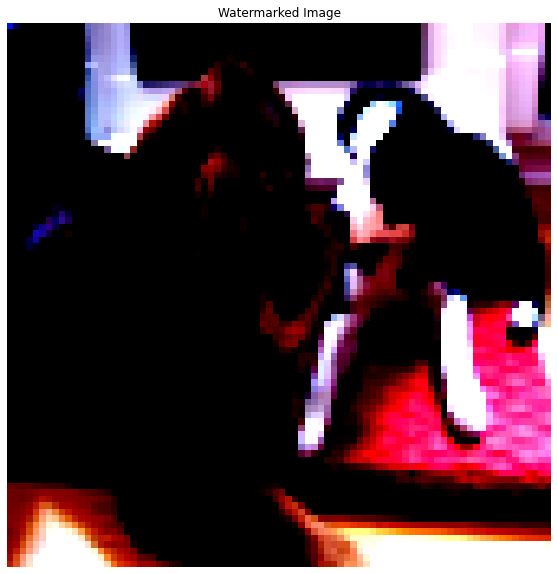

  9%|▉         | 1/11 [00:07<01:18,  7.88s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 11: Target opacity: 0, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: True, Base class predicted: False


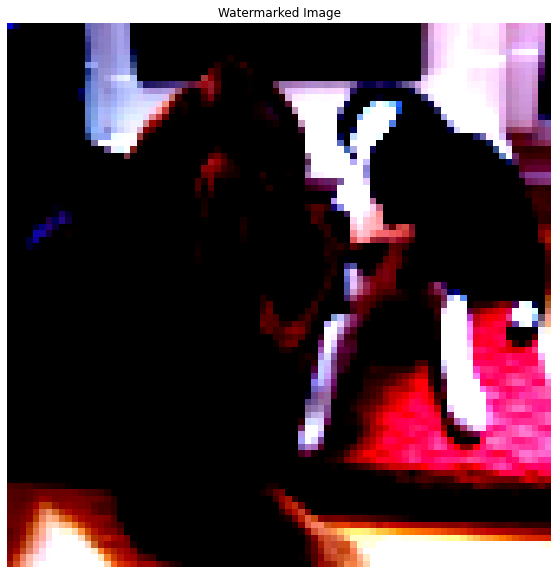

 18%|█▊        | 2/11 [00:15<01:10,  7.84s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 11: Target opacity: 0.05, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: True, Base class predicted: False


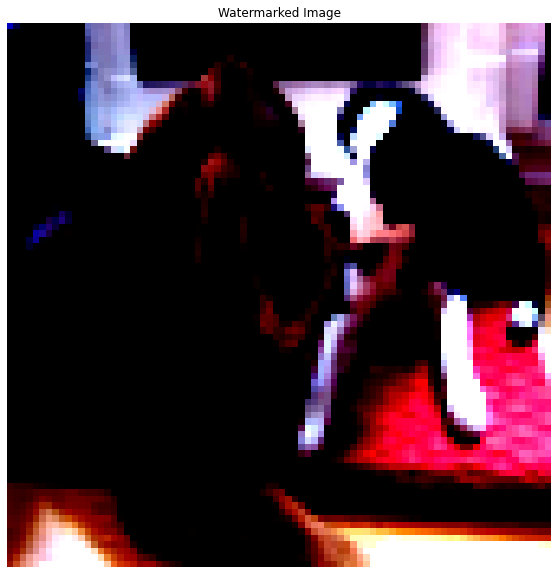

 27%|██▋       | 3/11 [00:23<01:03,  7.89s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 11: Target opacity: 0.1, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: True, Base class predicted: False


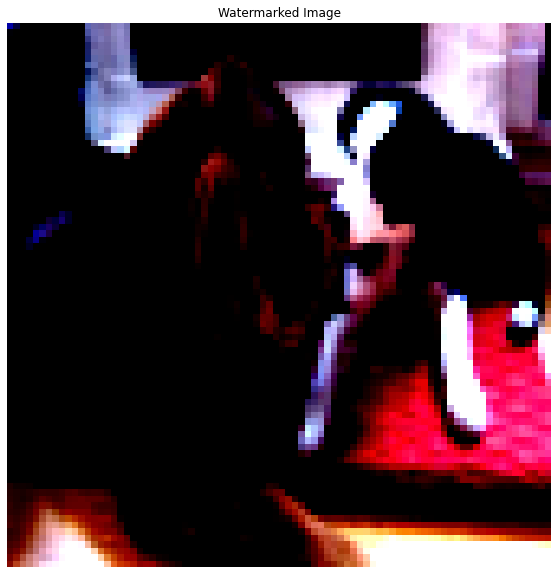

 36%|███▋      | 4/11 [00:31<00:55,  7.88s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 11: Target opacity: 0.15, Labeled correctly: 0.56, Correctly Predicted Target: False, Base class predicted: True


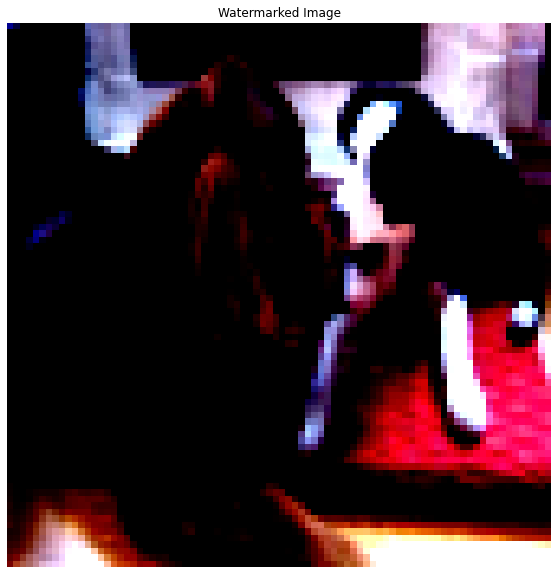

 45%|████▌     | 5/11 [00:39<00:47,  7.88s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 11: Target opacity: 0.2, Labeled correctly: 0.56, Correctly Predicted Target: False, Base class predicted: True


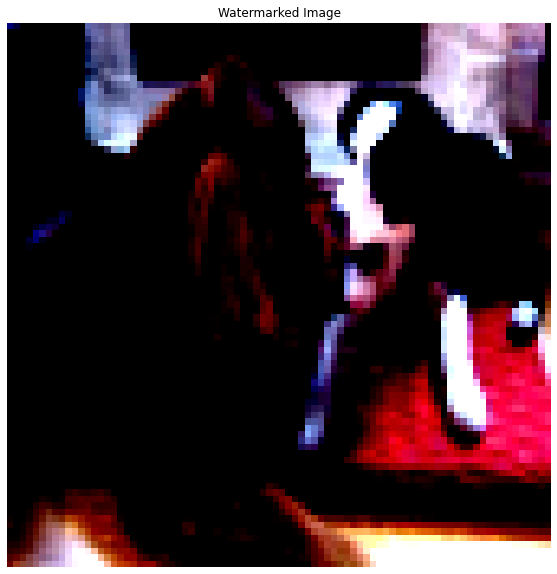

 55%|█████▍    | 6/11 [00:47<00:39,  7.94s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 11: Target opacity: 0.25, Labeled correctly: 0.5733333333333334, Correctly Predicted Target: False, Base class predicted: True


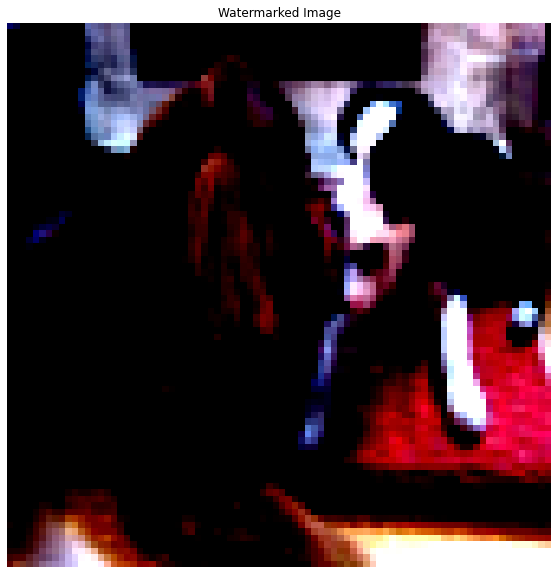

 64%|██████▎   | 7/11 [00:55<00:31,  7.96s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 11: Target opacity: 0.3, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: False, Base class predicted: True


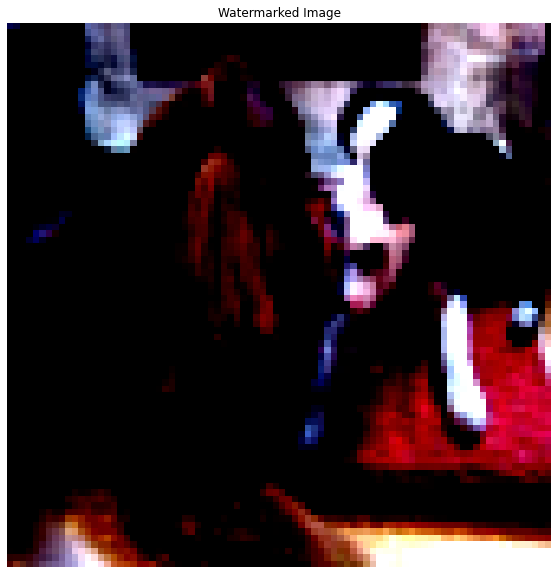

 73%|███████▎  | 8/11 [01:03<00:23,  7.95s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 11: Target opacity: 0.35, Labeled correctly: 0.6, Correctly Predicted Target: False, Base class predicted: True


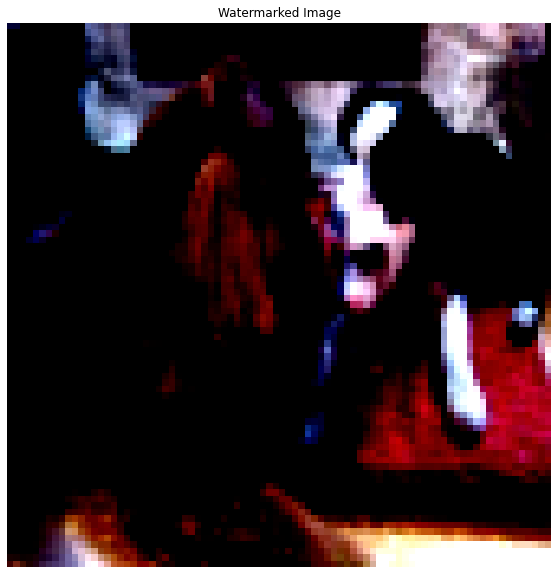

 82%|████████▏ | 9/11 [01:11<00:15,  7.95s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 11: Target opacity: 0.4, Labeled correctly: 0.6, Correctly Predicted Target: False, Base class predicted: True


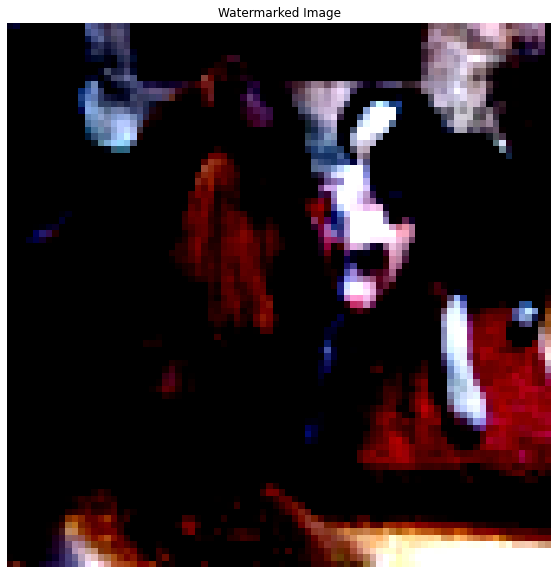

 91%|█████████ | 10/11 [01:19<00:07,  7.93s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 11: Target opacity: 0.45, Labeled correctly: 0.6133333333333333, Correctly Predicted Target: False, Base class predicted: True


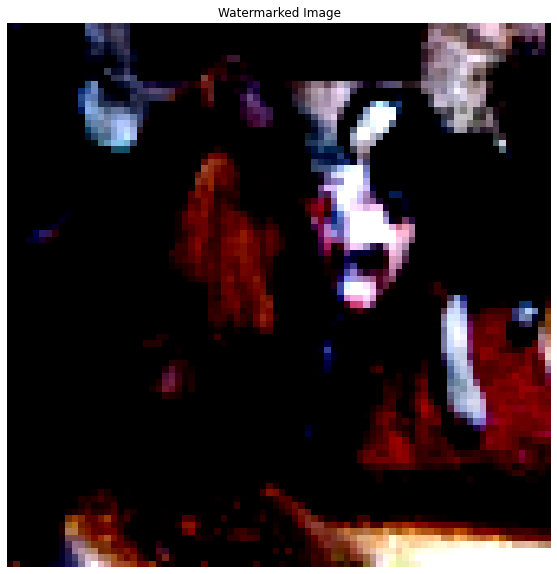

100%|██████████| 11/11 [01:27<00:00,  7.91s/it]

Iteration 11: Target opacity: 0.5, Labeled correctly: 0.6133333333333333, Correctly Predicted Target: False, Base class predicted: True



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


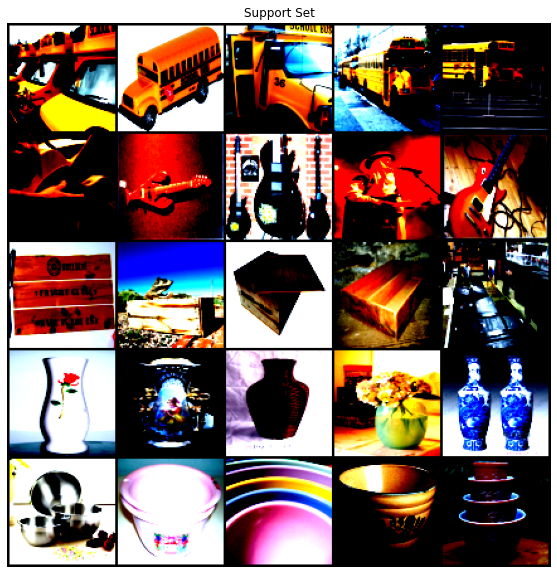

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 4, 4, 4, 4,
         4]])


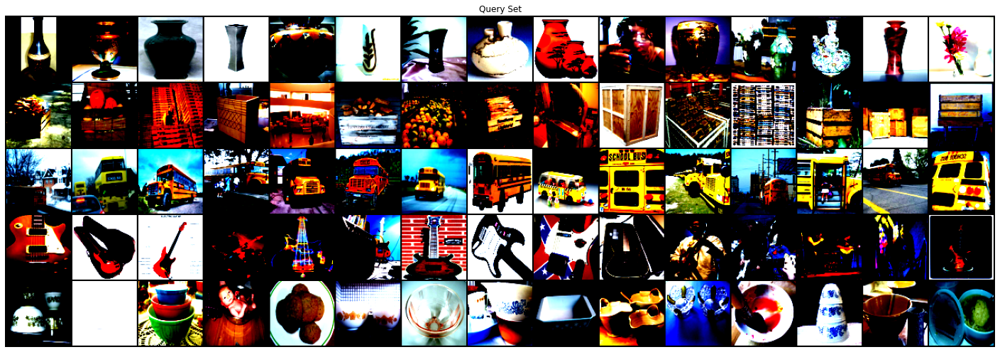

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1,
         1, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2,
         2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
         4, 4, 4]])
target_class 0
unique_classes [1, 2, 3, 4]
base_class 3
target_indices [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14]
target_index 10
base_indices [0 1 2 3 4]
base_index 2


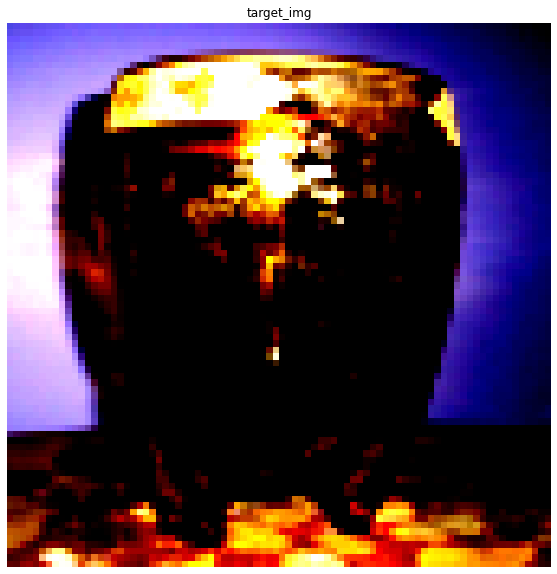

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


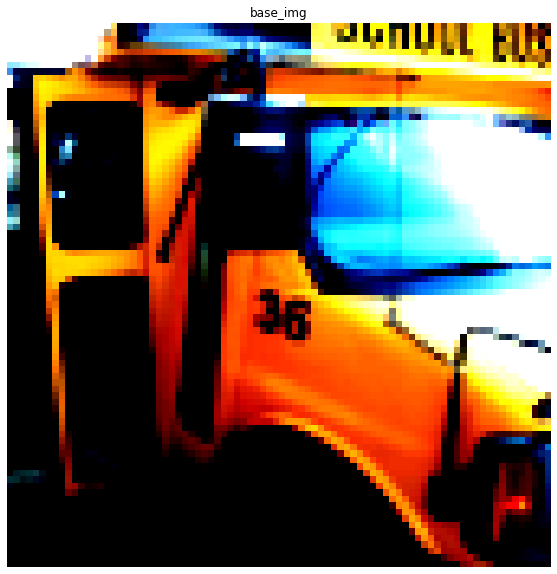

  0%|          | 3/1000 [00:00<00:37, 26.94it/s]

Iteration 0
loss: tensor(5.6065, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(31.8359, grad_fn=<PowBackward0>)
Iteration 2
loss: tensor(40.0580, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(2.9823, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(20.6713, grad_fn=<PowBackward0>)
Iteration 5


  1%|          | 9/1000 [00:00<00:38, 26.01it/s]

loss: tensor(24.3270, grad_fn=<PowBackward0>)
Iteration 6
loss: tensor(47.3754, grad_fn=<PowBackward0>)
Iteration 7
loss: tensor(1.9166, grad_fn=<PowBackward0>)
Iteration 8
loss: tensor(19.8796, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(26.1279, grad_fn=<PowBackward0>)
Iteration 10
loss: tensor(58.6984, grad_fn=<PowBackward0>)


  2%|▏         | 15/1000 [00:00<00:36, 26.72it/s]

Iteration 11
loss: tensor(5.5265, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(25.1503, grad_fn=<PowBackward0>)
Iteration 13
loss: tensor(19.7189, grad_fn=<PowBackward0>)
Iteration 14
loss: tensor(51.4946, grad_fn=<PowBackward0>)
Iteration 15
loss: tensor(10.3992, grad_fn=<PowBackward0>)
Iteration 16
loss: tensor(54.6403, grad_fn=<PowBackward0>)

  2%|▏         | 21/1000 [00:00<00:37, 26.00it/s]


Iteration 17
loss: tensor(16.2400, grad_fn=<PowBackward0>)
Iteration 18
loss: tensor(63.1489, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(21.9866, grad_fn=<PowBackward0>)
Iteration 20
loss: tensor(62.8001, grad_fn=<PowBackward0>)
Iteration 21
loss: tensor(13.9659, grad_fn=<PowBackward0>)


  3%|▎         | 27/1000 [00:01<00:36, 26.36it/s]

Iteration 22
loss: tensor(24.9417, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(14.4760, grad_fn=<PowBackward0>)
Iteration 24
loss: tensor(67.4215, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(21.7410, grad_fn=<PowBackward0>)
Iteration 26
loss: tensor(50.6888, grad_fn=<PowBackward0>)
Iteration 27
loss: 

  3%|▎         | 30/1000 [00:01<00:36, 26.57it/s]

tensor(15.7121, grad_fn=<PowBackward0>)
Iteration 28
loss: tensor(47.2293, grad_fn=<PowBackward0>)
Iteration 29
loss: tensor(32.1660, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(72.5270, grad_fn=<PowBackward0>)
Iteration 31
loss: tensor(14.6298, grad_fn=<PowBackward0>)
Iteration 32
loss: tensor(15.4279, grad_fn=<PowBackward0>)


  4%|▎         | 36/1000 [00:01<00:37, 25.67it/s]

Iteration 33
loss: tensor(10.4759, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(60.7891, grad_fn=<PowBackward0>)
Iteration 35
loss: tensor(8.5982, grad_fn=<PowBackward0>)
Iteration 36
loss: tensor(13.0287, grad_fn=<PowBackward0>)
Iteration 37
loss: tensor(11.9420, grad_fn=<PowBackward0>)
Iteration 38


  4%|▍         | 42/1000 [00:01<00:35, 26.68it/s]

loss: tensor(68.5279, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(20.1688, grad_fn=<PowBackward0>)
Iteration 40
loss: tensor(25.8693, grad_fn=<PowBackward0>)
Iteration 41
loss: tensor(13.4750, grad_fn=<PowBackward0>)
Iteration 42
loss: tensor(62.6662, grad_fn=<PowBackward0>)
Iteration 43
loss: tensor(15.6076, grad_fn=<PowBackward0>)


  5%|▍         | 48/1000 [00:01<00:35, 26.47it/s]

Iteration 44
loss: tensor(39.8858, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(10.3630, grad_fn=<PowBackward0>)
Iteration 46
loss: tensor(60.5677, grad_fn=<PowBackward0>)
Iteration 47
loss: tensor(7.7770, grad_fn=<PowBackward0>)
Iteration 48
loss: tensor(27.7761, grad_fn=<PowBackward0>)
Iteration 49


  5%|▌         | 54/1000 [00:02<00:36, 25.91it/s]

loss: tensor(18.6191, grad_fn=<PowBackward0>)
Iteration 50
loss: tensor(47.2902, grad_fn=<PowBackward0>)
Iteration 51
loss: tensor(18.8228, grad_fn=<PowBackward0>)
Iteration 52
loss: tensor(57.9185, grad_fn=<PowBackward0>)
Iteration 53
loss: tensor(17.5899, grad_fn=<PowBackward0>)
Iteration 54
loss: tensor(53.4966, grad_fn=<PowBackward0>)


  6%|▌         | 60/1000 [00:02<00:35, 26.41it/s]

Iteration 55
loss: tensor(11.4755, grad_fn=<PowBackward0>)
Iteration 56
loss: tensor(50.1603, grad_fn=<PowBackward0>)
Iteration 57
loss: tensor(13.2590, grad_fn=<PowBackward0>)
Iteration 58
loss: tensor(44.6704, grad_fn=<PowBackward0>)
Iteration 59
loss: tensor(13.8833, grad_fn=<PowBackward0>)
Iteration 60
loss: tensor(67.5487, grad_fn=<PowBackward0>)


  7%|▋         | 66/1000 [00:02<00:35, 26.25it/s]

Iteration 61
loss: tensor(23.8290, grad_fn=<PowBackward0>)
Iteration 62
loss: tensor(28.6242, grad_fn=<PowBackward0>)
Iteration 63
loss: tensor(9.6157, grad_fn=<PowBackward0>)
Iteration 64
loss: tensor(59.5267, grad_fn=<PowBackward0>)
Iteration 65
loss: tensor(25.4337, grad_fn=<PowBackward0>)


  7%|▋         | 72/1000 [00:02<00:34, 26.77it/s]

Iteration 66
loss: tensor(46.1827, grad_fn=<PowBackward0>)
Iteration 67
loss: tensor(32.0486, grad_fn=<PowBackward0>)
Iteration 68
loss: tensor(51.0483, grad_fn=<PowBackward0>)
Iteration 69
loss: tensor(21.9609, grad_fn=<PowBackward0>)
Iteration 70
loss: tensor(52.6894, grad_fn=<PowBackward0>)
Iteration 71
loss: tensor(6.2901, grad_fn=<PowBackward0>)
Iteration 72


  8%|▊         | 75/1000 [00:02<00:36, 25.55it/s]

loss: tensor(19.5367, grad_fn=<PowBackward0>)
Iteration 73
loss: tensor(23.3351, grad_fn=<PowBackward0>)
Iteration 74
loss: tensor(58.4440, grad_fn=<PowBackward0>)
Iteration 75
loss: tensor(13.3965, grad_fn=<PowBackward0>)
Iteration 76
loss: tensor(29.9485, grad_fn=<PowBackward0>)
Iteration 77
loss: tensor(29.1257, grad_fn=<PowBackward0>)


  8%|▊         | 81/1000 [00:03<00:34, 26.63it/s]

Iteration 78
loss: tensor(72.4797, grad_fn=<PowBackward0>)
Iteration 79
loss: tensor(9.9967, grad_fn=<PowBackward0>)
Iteration 80
loss: tensor(15.9363, grad_fn=<PowBackward0>)
Iteration 81
loss: tensor(12.2281, grad_fn=<PowBackward0>)
Iteration 82
loss: tensor(32.6002, grad_fn=<PowBackward0>)
Iteration 83
loss: tensor(9.5735, grad_fn=<PowBackward0>)


  9%|▊         | 87/1000 [00:03<00:33, 26.87it/s]

Iteration 84
loss: tensor(35.0731, grad_fn=<PowBackward0>)
Iteration 85
loss: tensor(9.4297, grad_fn=<PowBackward0>)
Iteration 86
loss: tensor(50.4128, grad_fn=<PowBackward0>)
Iteration 87
loss: tensor(16.5685, grad_fn=<PowBackward0>)
Iteration 88
loss: tensor(63.7603, grad_fn=<PowBackward0>)
Iteration 89
loss: tensor(16.7580, grad_fn=<PowBackward0>)


  9%|▉         | 93/1000 [00:03<00:33, 26.93it/s]

Iteration 90
loss: tensor(43.0189, grad_fn=<PowBackward0>)
Iteration 91
loss: tensor(12.6864, grad_fn=<PowBackward0>)
Iteration 92
loss: tensor(44.8988, grad_fn=<PowBackward0>)
Iteration 93
loss: tensor(18.1887, grad_fn=<PowBackward0>)
Iteration 94
loss: tensor(48.5805, grad_fn=<PowBackward0>)
Iteration 95
loss: tensor(13.9218, grad_fn=<PowBackward0>)


 10%|▉         | 99/1000 [00:03<00:33, 27.15it/s]

Iteration 96
loss: tensor(43.8962, grad_fn=<PowBackward0>)
Iteration 97
loss: tensor(26.7200, grad_fn=<PowBackward0>)
Iteration 98
loss: tensor(41.0021, grad_fn=<PowBackward0>)
Iteration 99
loss: tensor(6.0962, grad_fn=<PowBackward0>)
Iteration 100
loss: tensor(42.5322, grad_fn=<PowBackward0>)
Iteration 101
loss: tensor(11.2192, grad_fn=<PowBackward0>)


 10%|█         | 105/1000 [00:03<00:34, 26.11it/s]

Iteration 102
loss: tensor(8.6419, grad_fn=<PowBackward0>)
Iteration 103
loss: tensor(29.2873, grad_fn=<PowBackward0>)
Iteration 104
loss: tensor(43.7488, grad_fn=<PowBackward0>)
Iteration 105
loss: tensor(19.5373, grad_fn=<PowBackward0>)
Iteration 106
loss: tensor(19.9532, grad_fn=<PowBackward0>)
Iteration 107


 11%|█         | 111/1000 [00:04<00:36, 24.23it/s]

loss: tensor(20.9314, grad_fn=<PowBackward0>)
Iteration 108
loss: tensor(36.9750, grad_fn=<PowBackward0>)
Iteration 109
loss: tensor(14.2324, grad_fn=<PowBackward0>)
Iteration 110
loss: tensor(9.1306, grad_fn=<PowBackward0>)
Iteration 111
loss: tensor(9.6049, grad_fn=<PowBackward0>)


 12%|█▏        | 117/1000 [00:04<00:34, 25.51it/s]

Iteration 112
loss: tensor(50.0236, grad_fn=<PowBackward0>)
Iteration 113
loss: tensor(21.6521, grad_fn=<PowBackward0>)
Iteration 114
loss: tensor(28.5882, grad_fn=<PowBackward0>)
Iteration 115
loss: tensor(9.2381, grad_fn=<PowBackward0>)
Iteration 116
loss: tensor(27.5102, grad_fn=<PowBackward0>)
Iteration 117
loss: 

 12%|█▏        | 120/1000 [00:04<00:34, 25.76it/s]

tensor(22.7640, grad_fn=<PowBackward0>)
Iteration 118
loss: tensor(27.4228, grad_fn=<PowBackward0>)
Iteration 119
loss: tensor(24.5598, grad_fn=<PowBackward0>)
Iteration 120
loss: tensor(43.5343, grad_fn=<PowBackward0>)
Iteration 121
loss: tensor(9.3133, grad_fn=<PowBackward0>)
Iteration 122
loss: tensor(22.4593, grad_fn=<PowBackward0>)


 13%|█▎        | 126/1000 [00:04<00:33, 26.35it/s]

Iteration 123
loss: tensor(18.7423, grad_fn=<PowBackward0>)
Iteration 124
loss: tensor(41.9503, grad_fn=<PowBackward0>)
Iteration 125
loss: tensor(9.2469, grad_fn=<PowBackward0>)
Iteration 126
loss: tensor(18.0413, grad_fn=<PowBackward0>)
Iteration 127
loss: tensor(13.7857, grad_fn=<PowBackward0>)
Iteration 128


 13%|█▎        | 132/1000 [00:05<00:34, 25.36it/s]

loss: tensor(67.9536, grad_fn=<PowBackward0>)
Iteration 129
loss: tensor(7.7880, grad_fn=<PowBackward0>)
Iteration 130
loss: tensor(11.3342, grad_fn=<PowBackward0>)
Iteration 131
loss: tensor(18.6379, grad_fn=<PowBackward0>)
Iteration 132
loss: tensor(53.0289, grad_fn=<PowBackward0>)
Iteration 133
loss: tensor(12.0548, grad_fn=<PowBackward0>)


 14%|█▍        | 138/1000 [00:05<00:34, 25.32it/s]

Iteration 134
loss: tensor(8.0140, grad_fn=<PowBackward0>)
Iteration 135
loss: tensor(10.2442, grad_fn=<PowBackward0>)
Iteration 136
loss: tensor(44.0082, grad_fn=<PowBackward0>)
Iteration 137
loss: tensor(24.1875, grad_fn=<PowBackward0>)
Iteration 138
loss: tensor(45.5061, grad_fn=<PowBackward0>)
Iteration 139


 14%|█▍        | 144/1000 [00:05<00:32, 26.13it/s]

loss: tensor(13.2742, grad_fn=<PowBackward0>)
Iteration 140
loss: tensor(29.6388, grad_fn=<PowBackward0>)
Iteration 141
loss: tensor(22.3243, grad_fn=<PowBackward0>)
Iteration 142
loss: tensor(47.1917, grad_fn=<PowBackward0>)
Iteration 143
loss: tensor(10.8132, grad_fn=<PowBackward0>)
Iteration 144
loss: tensor(33.3049, grad_fn=<PowBackward0>)


 15%|█▌        | 150/1000 [00:05<00:32, 26.08it/s]

Iteration 145
loss: tensor(22.2430, grad_fn=<PowBackward0>)
Iteration 146
loss: tensor(32.1437, grad_fn=<PowBackward0>)
Iteration 147
loss: tensor(13.5605, grad_fn=<PowBackward0>)
Iteration 148
loss: tensor(19.3741, grad_fn=<PowBackward0>)
Iteration 149
loss: tensor(16.3230, grad_fn=<PowBackward0>)
Iteration 150


 15%|█▌        | 153/1000 [00:05<00:32, 26.07it/s]

loss: tensor(37.5578, grad_fn=<PowBackward0>)
Iteration 151
loss: tensor(22.0970, grad_fn=<PowBackward0>)
Iteration 152
loss: tensor(37.1540, grad_fn=<PowBackward0>)
Iteration 153
loss: tensor(19.5672, grad_fn=<PowBackward0>)
Iteration 154
loss: tensor(37.8035, grad_fn=<PowBackward0>)
Iteration 155
loss: tensor(6.4251, grad_fn=<PowBackward0>)


 16%|█▌        | 159/1000 [00:06<00:32, 25.93it/s]

Iteration 156
loss: tensor(23.9171, grad_fn=<PowBackward0>)
Iteration 157
loss: tensor(8.1753, grad_fn=<PowBackward0>)
Iteration 158
loss: tensor(59.6152, grad_fn=<PowBackward0>)
Iteration 159
loss: tensor(16.8484, grad_fn=<PowBackward0>)
Iteration 160
loss: tensor(29.4806, grad_fn=<PowBackward0>)
Iteration 161
loss: tensor(10.6351, grad_fn=<PowBackward0>)

 16%|█▋        | 165/1000 [00:06<00:33, 25.24it/s]


Iteration 162
loss: tensor(39.9765, grad_fn=<PowBackward0>)
Iteration 163
loss: tensor(15.6382, grad_fn=<PowBackward0>)
Iteration 164
loss: tensor(22.5816, grad_fn=<PowBackward0>)
Iteration 165
loss: tensor(14.2773, grad_fn=<PowBackward0>)
Iteration 166


 17%|█▋        | 171/1000 [00:06<00:31, 25.97it/s]

loss: tensor(45.5392, grad_fn=<PowBackward0>)
Iteration 167
loss: tensor(11.5571, grad_fn=<PowBackward0>)
Iteration 168
loss: tensor(21.1623, grad_fn=<PowBackward0>)
Iteration 169
loss: tensor(17.9969, grad_fn=<PowBackward0>)
Iteration 170
loss: tensor(64.9404, grad_fn=<PowBackward0>)
Iteration 171
loss: tensor(9.3167, grad_fn=<PowBackward0>)


 18%|█▊        | 177/1000 [00:06<00:31, 25.81it/s]

Iteration 172
loss: tensor(13.7953, grad_fn=<PowBackward0>)
Iteration 173
loss: tensor(25.1548, grad_fn=<PowBackward0>)
Iteration 174
loss: tensor(44.3058, grad_fn=<PowBackward0>)
Iteration 175
loss: tensor(12.1675, grad_fn=<PowBackward0>)
Iteration 176
loss: tensor(19.0351, grad_fn=<PowBackward0>)
Iteration 177


 18%|█▊        | 180/1000 [00:06<00:33, 24.31it/s]

loss: tensor(15.5020, grad_fn=<PowBackward0>)
Iteration 178
loss: tensor(37.1843, grad_fn=<PowBackward0>)
Iteration 179
loss: tensor(17.7285, grad_fn=<PowBackward0>)
Iteration 180
loss: tensor(29.1204, grad_fn=<PowBackward0>)
Iteration 181
loss: tensor(13.0319, grad_fn=<PowBackward0>)
Iteration 182


 19%|█▊        | 186/1000 [00:07<00:32, 24.80it/s]

loss: tensor(24.4707, grad_fn=<PowBackward0>)
Iteration 183
loss: tensor(17.3994, grad_fn=<PowBackward0>)
Iteration 184
loss: tensor(43.7511, grad_fn=<PowBackward0>)
Iteration 185
loss: tensor(5.1877, grad_fn=<PowBackward0>)
Iteration 186
loss: tensor(12.1856, grad_fn=<PowBackward0>)
Iteration 187
loss: tensor(21.9519, grad_fn=<PowBackward0>)

 19%|█▉        | 192/1000 [00:07<00:32, 24.76it/s]


Iteration 188
loss: tensor(43.2820, grad_fn=<PowBackward0>)
Iteration 189
loss: tensor(15.4427, grad_fn=<PowBackward0>)
Iteration 190
loss: tensor(10.6427, grad_fn=<PowBackward0>)
Iteration 191
loss: tensor(12.9392, grad_fn=<PowBackward0>)
Iteration 192
loss: tensor(56.5776, grad_fn=<PowBackward0>)


 20%|█▉        | 198/1000 [00:07<00:31, 25.71it/s]

Iteration 193
loss: tensor(27.6102, grad_fn=<PowBackward0>)
Iteration 194
loss: tensor(35.7444, grad_fn=<PowBackward0>)
Iteration 195
loss: tensor(8.4263, grad_fn=<PowBackward0>)
Iteration 196
loss: tensor(33.0632, grad_fn=<PowBackward0>)
Iteration 197
loss: tensor(18.9083, grad_fn=<PowBackward0>)
Iteration 198


 20%|██        | 201/1000 [00:07<00:30, 25.91it/s]

loss: tensor(22.4002, grad_fn=<PowBackward0>)
Iteration 199
loss: tensor(17.7228, grad_fn=<PowBackward0>)
Iteration 200
loss: tensor(44.5680, grad_fn=<PowBackward0>)
Iteration 201
loss: tensor(23.5899, grad_fn=<PowBackward0>)
Iteration 202
loss: tensor(5.9600, grad_fn=<PowBackward0>)
Iteration 203
loss: tensor(4.9096, grad_fn=<PowBackward0>)


 21%|██        | 207/1000 [00:08<00:32, 24.25it/s]

Iteration 204
loss: tensor(5.3745, grad_fn=<PowBackward0>)
Iteration 205
loss: tensor(6.5521, grad_fn=<PowBackward0>)
Iteration 206
loss: tensor(15.6268, grad_fn=<PowBackward0>)
Iteration 207
loss: tensor(9.5440, grad_fn=<PowBackward0>)
Iteration 208
loss: tensor(14.6736, grad_fn=<PowBackward0>)


 21%|██▏       | 213/1000 [00:08<00:32, 24.56it/s]

Iteration 209
loss: tensor(9.7132, grad_fn=<PowBackward0>)
Iteration 210
loss: tensor(23.6306, grad_fn=<PowBackward0>)
Iteration 211
loss: tensor(9.2900, grad_fn=<PowBackward0>)
Iteration 212
loss: tensor(18.4724, grad_fn=<PowBackward0>)
Iteration 213
loss: tensor(13.5271, grad_fn=<PowBackward0>)
Iteration 214


 22%|██▏       | 219/1000 [00:08<00:30, 25.30it/s]

loss: tensor(10.9898, grad_fn=<PowBackward0>)
Iteration 215
loss: tensor(10.8330, grad_fn=<PowBackward0>)
Iteration 216
loss: tensor(13.6047, grad_fn=<PowBackward0>)
Iteration 217
loss: tensor(13.5144, grad_fn=<PowBackward0>)
Iteration 218
loss: tensor(31.6937, grad_fn=<PowBackward0>)
Iteration 219
loss: tensor(9.3687, grad_fn=<PowBackward0>)


 22%|██▏       | 222/1000 [00:08<00:31, 25.07it/s]

Iteration 220
loss: tensor(13.1655, grad_fn=<PowBackward0>)
Iteration 221
loss: tensor(12.1464, grad_fn=<PowBackward0>)
Iteration 222
loss: tensor(13.0961, grad_fn=<PowBackward0>)
Iteration 223
loss: tensor(11.1259, grad_fn=<PowBackward0>)
Iteration 224


 23%|██▎       | 228/1000 [00:08<00:32, 23.66it/s]

loss: tensor(20.1638, grad_fn=<PowBackward0>)
Iteration 225
loss: tensor(11.3587, grad_fn=<PowBackward0>)
Iteration 226
loss: tensor(10.3580, grad_fn=<PowBackward0>)
Iteration 227
loss: tensor(5.5667, grad_fn=<PowBackward0>)
Iteration 228
loss: tensor(15.1740, grad_fn=<PowBackward0>)
Iteration 229


 23%|██▎       | 234/1000 [00:09<00:31, 24.30it/s]

loss: tensor(12.3820, grad_fn=<PowBackward0>)
Iteration 230
loss: tensor(21.7796, grad_fn=<PowBackward0>)
Iteration 231
loss: tensor(13.0885, grad_fn=<PowBackward0>)
Iteration 232
loss: tensor(16.1334, grad_fn=<PowBackward0>)
Iteration 233
loss: tensor(10.1056, grad_fn=<PowBackward0>)
Iteration 234
loss: tensor(18.6388, grad_fn=<PowBackward0>)


 24%|██▎       | 237/1000 [00:09<00:32, 23.50it/s]

Iteration 235
loss: tensor(8.4725, grad_fn=<PowBackward0>)
Iteration 236
loss: tensor(12.2107, grad_fn=<PowBackward0>)
Iteration 237
loss: tensor(10.2652, grad_fn=<PowBackward0>)
Iteration 238
loss: tensor(16.0290, grad_fn=<PowBackward0>)
Iteration 239
loss: tensor(8.8017, grad_fn=<PowBackward0>)


 24%|██▍       | 243/1000 [00:09<00:31, 24.09it/s]

Iteration 240
loss: tensor(14.0197, grad_fn=<PowBackward0>)
Iteration 241
loss: tensor(12.0878, grad_fn=<PowBackward0>)
Iteration 242
loss: tensor(38.0793, grad_fn=<PowBackward0>)
Iteration 243
loss: tensor(12.7858, grad_fn=<PowBackward0>)
Iteration 244
loss: tensor(14.8511, grad_fn=<PowBackward0>)
Iteration 245
loss: tensor(7.6147, grad_fn=<PowBackward0>)


 25%|██▍       | 249/1000 [00:09<00:30, 24.57it/s]

Iteration 246
loss: tensor(10.9364, grad_fn=<PowBackward0>)
Iteration 247
loss: tensor(5.2988, grad_fn=<PowBackward0>)
Iteration 248
loss: tensor(13.4309, grad_fn=<PowBackward0>)
Iteration 249
loss: tensor(17.9639, grad_fn=<PowBackward0>)
Iteration 250
loss: tensor(25.7664, grad_fn=<PowBackward0>)
Iteration 251


 26%|██▌       | 255/1000 [00:09<00:29, 25.10it/s]

loss: tensor(7.2076, grad_fn=<PowBackward0>)
Iteration 252
loss: tensor(9.2892, grad_fn=<PowBackward0>)
Iteration 253
loss: tensor(8.5102, grad_fn=<PowBackward0>)
Iteration 254
loss: tensor(30.1197, grad_fn=<PowBackward0>)
Iteration 255
loss: tensor(20.1577, grad_fn=<PowBackward0>)
Iteration 256
loss: tensor(14.3455, grad_fn=<PowBackward0>)


 26%|██▌       | 261/1000 [00:10<00:28, 25.70it/s]

Iteration 257
loss: tensor(9.2393, grad_fn=<PowBackward0>)
Iteration 258
loss: tensor(14.3560, grad_fn=<PowBackward0>)
Iteration 259
loss: tensor(12.0360, grad_fn=<PowBackward0>)
Iteration 260
loss: tensor(17.6093, grad_fn=<PowBackward0>)
Iteration 261
loss: tensor(11.9650, grad_fn=<PowBackward0>)
Iteration 262
loss: tensor(20.3129, grad_fn=<PowBackward0>)

 27%|██▋       | 267/1000 [00:10<00:28, 26.16it/s]


Iteration 263
loss: tensor(9.0947, grad_fn=<PowBackward0>)
Iteration 264
loss: tensor(16.7878, grad_fn=<PowBackward0>)
Iteration 265
loss: tensor(11.0891, grad_fn=<PowBackward0>)
Iteration 266
loss: tensor(18.6310, grad_fn=<PowBackward0>)
Iteration 267
loss: tensor(12.9523, grad_fn=<PowBackward0>)


 27%|██▋       | 273/1000 [00:10<00:27, 26.76it/s]

Iteration 268
loss: tensor(14.8410, grad_fn=<PowBackward0>)
Iteration 269
loss: tensor(6.9007, grad_fn=<PowBackward0>)
Iteration 270
loss: tensor(15.8040, grad_fn=<PowBackward0>)
Iteration 271
loss: tensor(15.9714, grad_fn=<PowBackward0>)
Iteration 272
loss: tensor(21.5404, grad_fn=<PowBackward0>)
Iteration 273
loss: tensor(9.4456, grad_fn=<PowBackward0>)


 28%|██▊       | 279/1000 [00:10<00:26, 27.35it/s]

Iteration 274
loss: tensor(19.3321, grad_fn=<PowBackward0>)
Iteration 275
loss: tensor(16.8289, grad_fn=<PowBackward0>)
Iteration 276
loss: tensor(20.7517, grad_fn=<PowBackward0>)
Iteration 277
loss: tensor(11.4823, grad_fn=<PowBackward0>)
Iteration 278
loss: tensor(13.0495, grad_fn=<PowBackward0>)
Iteration 279
loss: tensor(5.9273, grad_fn=<PowBackward0>)


 28%|██▊       | 282/1000 [00:11<00:27, 25.80it/s]

Iteration 280
loss: tensor(13.9570, grad_fn=<PowBackward0>)
Iteration 281
loss: tensor(10.0068, grad_fn=<PowBackward0>)
Iteration 282
loss: tensor(18.6606, grad_fn=<PowBackward0>)
Iteration 283
loss: tensor(11.5210, grad_fn=<PowBackward0>)
Iteration 284
loss: tensor(18.0232, grad_fn=<PowBackward0>)


 29%|██▉       | 288/1000 [00:11<00:27, 25.90it/s]

Iteration 285
loss: tensor(14.4360, grad_fn=<PowBackward0>)
Iteration 286
loss: tensor(13.1445, grad_fn=<PowBackward0>)
Iteration 287
loss: tensor(7.9718, grad_fn=<PowBackward0>)
Iteration 288
loss: tensor(20.5702, grad_fn=<PowBackward0>)
Iteration 289
loss: tensor(11.3503, grad_fn=<PowBackward0>)
Iteration 290
loss: tensor(16.8575, grad_fn=<PowBackward0>)


 29%|██▉       | 294/1000 [00:11<00:27, 26.08it/s]

Iteration 291
loss: tensor(10.7519, grad_fn=<PowBackward0>)
Iteration 292
loss: tensor(10.9024, grad_fn=<PowBackward0>)
Iteration 293
loss: tensor(14.0255, grad_fn=<PowBackward0>)
Iteration 294
loss: tensor(24.0862, grad_fn=<PowBackward0>)
Iteration 295
loss: tensor(12.7859, grad_fn=<PowBackward0>)
Iteration 296


 30%|███       | 300/1000 [00:11<00:26, 26.20it/s]

loss: tensor(20.3305, grad_fn=<PowBackward0>)
Iteration 297
loss: tensor(13.0576, grad_fn=<PowBackward0>)
Iteration 298
loss: tensor(14.0821, grad_fn=<PowBackward0>)
Iteration 299
loss: tensor(9.5067, grad_fn=<PowBackward0>)
Iteration 300
loss: tensor(17.6942, grad_fn=<PowBackward0>)
Iteration 301
loss: tensor(13.3346, grad_fn=<PowBackward0>)


 31%|███       | 306/1000 [00:11<00:27, 25.00it/s]

Iteration 302
loss: tensor(1.0178, grad_fn=<PowBackward0>)
Iteration 303
loss: tensor(0.9307, grad_fn=<PowBackward0>)
Iteration 304
loss: tensor(0.5757, grad_fn=<PowBackward0>)
Iteration 305
loss: tensor(0.7313, grad_fn=<PowBackward0>)
Iteration 306
loss: tensor(1.1104, grad_fn=<PowBackward0>)


 31%|███       | 312/1000 [00:12<00:27, 24.84it/s]

Iteration 307
loss: tensor(2.0702, grad_fn=<PowBackward0>)
Iteration 308
loss: tensor(3.9331, grad_fn=<PowBackward0>)
Iteration 309
loss: tensor(5.8842, grad_fn=<PowBackward0>)
Iteration 310
loss: tensor(7.3934, grad_fn=<PowBackward0>)
Iteration 311
loss: tensor(4.8552, grad_fn=<PowBackward0>)


 32%|███▏      | 315/1000 [00:12<00:27, 25.20it/s]

Iteration 312
loss: tensor(5.2980, grad_fn=<PowBackward0>)
Iteration 313
loss: tensor(3.3815, grad_fn=<PowBackward0>)
Iteration 314
loss: tensor(4.6756, grad_fn=<PowBackward0>)
Iteration 315
loss: tensor(3.4659, grad_fn=<PowBackward0>)
Iteration 316
loss: tensor(4.6948, grad_fn=<PowBackward0>)
Iteration 317
loss: tensor(3.8257, grad_fn=<PowBackward0>)


 32%|███▏      | 321/1000 [00:12<00:26, 25.59it/s]

Iteration 318
loss: tensor(3.7872, grad_fn=<PowBackward0>)
Iteration 319
loss: tensor(2.1887, grad_fn=<PowBackward0>)
Iteration 320
loss: tensor(3.5015, grad_fn=<PowBackward0>)
Iteration 321
loss: tensor(3.4485, grad_fn=<PowBackward0>)
Iteration 322
loss: tensor(4.8676, grad_fn=<PowBackward0>)
Iteration 323


 33%|███▎      | 327/1000 [00:12<00:26, 25.57it/s]

loss: tensor(2.9569, grad_fn=<PowBackward0>)
Iteration 324
loss: tensor(5.5184, grad_fn=<PowBackward0>)
Iteration 325
loss: tensor(5.7261, grad_fn=<PowBackward0>)
Iteration 326
loss: tensor(3.9144, grad_fn=<PowBackward0>)
Iteration 327
loss: tensor(2.1442, grad_fn=<PowBackward0>)
Iteration 328
loss: tensor(2.7757, grad_fn=<PowBackward0>)


 33%|███▎      | 333/1000 [00:13<00:25, 25.85it/s]

Iteration 329
loss: tensor(2.3505, grad_fn=<PowBackward0>)
Iteration 330
loss: tensor(3.2334, grad_fn=<PowBackward0>)
Iteration 331
loss: tensor(3.9494, grad_fn=<PowBackward0>)
Iteration 332
loss: tensor(6.4500, grad_fn=<PowBackward0>)
Iteration 333
loss: tensor(4.8992, grad_fn=<PowBackward0>)
Iteration 334


 34%|███▍      | 339/1000 [00:13<00:26, 24.83it/s]

loss: tensor(4.9108, grad_fn=<PowBackward0>)
Iteration 335
loss: tensor(3.9581, grad_fn=<PowBackward0>)
Iteration 336
loss: tensor(5.0650, grad_fn=<PowBackward0>)
Iteration 337
loss: tensor(3.5706, grad_fn=<PowBackward0>)
Iteration 338
loss: tensor(3.6097, grad_fn=<PowBackward0>)
Iteration 339
loss:

 34%|███▍      | 342/1000 [00:13<00:26, 24.95it/s]

 tensor(2.6198, grad_fn=<PowBackward0>)
Iteration 340
loss: tensor(4.1973, grad_fn=<PowBackward0>)
Iteration 341
loss: tensor(6.0502, grad_fn=<PowBackward0>)
Iteration 342
loss: tensor(7.8837, grad_fn=<PowBackward0>)
Iteration 343
loss: tensor(5.1913, grad_fn=<PowBackward0>)
Iteration 344
loss: tensor(5.5748, grad_fn=<PowBackward0>)


 35%|███▍      | 348/1000 [00:13<00:25, 25.25it/s]

Iteration 345
loss: tensor(2.9192, grad_fn=<PowBackward0>)
Iteration 346
loss: tensor(5.4409, grad_fn=<PowBackward0>)
Iteration 347
loss: tensor(4.1611, grad_fn=<PowBackward0>)
Iteration 348
loss: tensor(2.6519, grad_fn=<PowBackward0>)
Iteration 349
loss: tensor(2.2767, grad_fn=<PowBackward0>)
Iteration 350
loss: 

 35%|███▌      | 354/1000 [00:13<00:25, 25.48it/s]

tensor(4.0742, grad_fn=<PowBackward0>)
Iteration 351
loss: tensor(3.6196, grad_fn=<PowBackward0>)
Iteration 352
loss: tensor(3.1462, grad_fn=<PowBackward0>)
Iteration 353
loss: tensor(2.1871, grad_fn=<PowBackward0>)
Iteration 354
loss: tensor(4.5622, grad_fn=<PowBackward0>)
Iteration 355
loss: tensor(3.9190, grad_fn=<PowBackward0>)


 36%|███▌      | 360/1000 [00:14<00:25, 24.95it/s]

Iteration 356
loss: tensor(4.2371, grad_fn=<PowBackward0>)
Iteration 357
loss: tensor(3.6473, grad_fn=<PowBackward0>)
Iteration 358
loss: tensor(4.4704, grad_fn=<PowBackward0>)
Iteration 359
loss: tensor(3.7967, grad_fn=<PowBackward0>)
Iteration 360
loss: tensor(4.1890, grad_fn=<PowBackward0>)


 37%|███▋      | 366/1000 [00:14<00:24, 25.81it/s]

Iteration 361
loss: tensor(4.7047, grad_fn=<PowBackward0>)
Iteration 362
loss: tensor(6.5071, grad_fn=<PowBackward0>)
Iteration 363
loss: tensor(3.8553, grad_fn=<PowBackward0>)
Iteration 364
loss: tensor(4.3852, grad_fn=<PowBackward0>)
Iteration 365
loss: tensor(3.6792, grad_fn=<PowBackward0>)
Iteration 366


 37%|███▋      | 369/1000 [00:14<00:24, 25.83it/s]

loss: tensor(5.2016, grad_fn=<PowBackward0>)
Iteration 367
loss: tensor(3.4837, grad_fn=<PowBackward0>)
Iteration 368
loss: tensor(2.6940, grad_fn=<PowBackward0>)
Iteration 369
loss: tensor(2.0270, grad_fn=<PowBackward0>)
Iteration 370
loss: tensor(4.1182, grad_fn=<PowBackward0>)
Iteration 371
loss: tensor(5.3014, grad_fn=<PowBackward0>)


 38%|███▊      | 375/1000 [00:14<00:23, 26.04it/s]

Iteration 372
loss: tensor(7.1983, grad_fn=<PowBackward0>)
Iteration 373
loss: tensor(5.2021, grad_fn=<PowBackward0>)
Iteration 374
loss: tensor(4.6909, grad_fn=<PowBackward0>)
Iteration 375
loss: tensor(2.5934, grad_fn=<PowBackward0>)
Iteration 376
loss: tensor(3.0859, grad_fn=<PowBackward0>)
Iteration 377
loss: tensor(2.1175, grad_fn=<PowBackward0>)


 38%|███▊      | 381/1000 [00:14<00:23, 26.05it/s]

Iteration 378
loss: tensor(5.6573, grad_fn=<PowBackward0>)
Iteration 379
loss: tensor(8.1026, grad_fn=<PowBackward0>)
Iteration 380
loss: tensor(8.1370, grad_fn=<PowBackward0>)
Iteration 381
loss: tensor(3.9679, grad_fn=<PowBackward0>)
Iteration 382
loss: tensor(3.5885, grad_fn=<PowBackward0>)
Iteration 383


 39%|███▊      | 387/1000 [00:15<00:24, 25.02it/s]

loss: tensor(2.5248, grad_fn=<PowBackward0>)
Iteration 384
loss: tensor(2.9505, grad_fn=<PowBackward0>)
Iteration 385
loss: tensor(2.8070, grad_fn=<PowBackward0>)
Iteration 386
loss: tensor(3.7754, grad_fn=<PowBackward0>)
Iteration 387
loss: tensor(3.2901, grad_fn=<PowBackward0>)
Iteration 388
loss: tensor(3.2368, grad_fn=<PowBackward0>)


 39%|███▉      | 393/1000 [00:15<00:23, 25.94it/s]

Iteration 389
loss: tensor(2.6917, grad_fn=<PowBackward0>)
Iteration 390
loss: tensor(6.0248, grad_fn=<PowBackward0>)
Iteration 391
loss: tensor(7.0592, grad_fn=<PowBackward0>)
Iteration 392
loss: tensor(6.6012, grad_fn=<PowBackward0>)
Iteration 393
loss: tensor(4.2168, grad_fn=<PowBackward0>)
Iteration 394


 40%|███▉      | 399/1000 [00:15<00:23, 26.11it/s]

loss: tensor(5.8238, grad_fn=<PowBackward0>)
Iteration 395
loss: tensor(5.3388, grad_fn=<PowBackward0>)
Iteration 396
loss: tensor(3.7730, grad_fn=<PowBackward0>)
Iteration 397
loss: tensor(2.0204, grad_fn=<PowBackward0>)
Iteration 398
loss: tensor(2.6402, grad_fn=<PowBackward0>)
Iteration 399
loss: tensor(1.7083, grad_fn=<PowBackward0>)


 40%|████      | 405/1000 [00:15<00:23, 25.75it/s]

Iteration 400
loss: tensor(3.7044, grad_fn=<PowBackward0>)
Iteration 401
loss: tensor(5.1804, grad_fn=<PowBackward0>)
Iteration 402
loss: tensor(1.5987, grad_fn=<PowBackward0>)
Iteration 403
loss: tensor(0.7511, grad_fn=<PowBackward0>)
Iteration 404
loss: tensor(0.6675, grad_fn=<PowBackward0>)
Iteration 405


 41%|████      | 411/1000 [00:16<00:22, 26.72it/s]

loss: tensor(0.5859, grad_fn=<PowBackward0>)
Iteration 406
loss: tensor(0.6089, grad_fn=<PowBackward0>)
Iteration 407
loss: tensor(0.5896, grad_fn=<PowBackward0>)
Iteration 408
loss: tensor(0.6448, grad_fn=<PowBackward0>)
Iteration 409
loss: tensor(0.6509, grad_fn=<PowBackward0>)
Iteration 410
loss: tensor(0.9464, grad_fn=<PowBackward0>)
Iteration 411


 41%|████▏     | 414/1000 [00:16<00:22, 25.66it/s]

loss: tensor(0.9362, grad_fn=<PowBackward0>)
Iteration 412
loss: tensor(1.7926, grad_fn=<PowBackward0>)
Iteration 413
loss: tensor(2.0447, grad_fn=<PowBackward0>)
Iteration 414
loss: tensor(1.4841, grad_fn=<PowBackward0>)
Iteration 415
loss: tensor(0.8291, grad_fn=<PowBackward0>)
Iteration 416
loss: tensor(0.7411, grad_fn=<PowBackward0>)


 42%|████▏     | 420/1000 [00:16<00:22, 25.56it/s]

Iteration 417
loss: tensor(0.5550, grad_fn=<PowBackward0>)
Iteration 418
loss: tensor(0.6077, grad_fn=<PowBackward0>)
Iteration 419
loss: tensor(0.5437, grad_fn=<PowBackward0>)
Iteration 420
loss: tensor(0.6498, grad_fn=<PowBackward0>)
Iteration 421
loss: tensor(0.6308, grad_fn=<PowBackward0>)
Iteration 422


 43%|████▎     | 426/1000 [00:16<00:22, 25.58it/s]

loss: tensor(0.8194, grad_fn=<PowBackward0>)
Iteration 423
loss: tensor(0.7700, grad_fn=<PowBackward0>)
Iteration 424
loss: tensor(1.1484, grad_fn=<PowBackward0>)
Iteration 425
loss: tensor(1.2176, grad_fn=<PowBackward0>)
Iteration 426
loss: tensor(1.2144, grad_fn=<PowBackward0>)
Iteration 427
loss: tensor(0.9440, grad_fn=<PowBackward0>)


 43%|████▎     | 432/1000 [00:16<00:22, 25.81it/s]

Iteration 428
loss: tensor(1.1014, grad_fn=<PowBackward0>)
Iteration 429
loss: tensor(0.9729, grad_fn=<PowBackward0>)
Iteration 430
loss: tensor(1.0603, grad_fn=<PowBackward0>)
Iteration 431
loss: tensor(0.8969, grad_fn=<PowBackward0>)
Iteration 432
loss: tensor(0.9766, grad_fn=<PowBackward0>)
Iteration 433
loss:

 44%|████▍     | 438/1000 [00:17<00:21, 26.13it/s]

 tensor(0.7596, grad_fn=<PowBackward0>)
Iteration 434
loss: tensor(1.2178, grad_fn=<PowBackward0>)
Iteration 435
loss: tensor(1.3084, grad_fn=<PowBackward0>)
Iteration 436
loss: tensor(1.7125, grad_fn=<PowBackward0>)
Iteration 437
loss: tensor(1.5771, grad_fn=<PowBackward0>)
Iteration 438
loss: tensor(1.4967, grad_fn=<PowBackward0>)


 44%|████▍     | 444/1000 [00:17<00:21, 25.92it/s]

Iteration 439
loss: tensor(1.1581, grad_fn=<PowBackward0>)
Iteration 440
loss: tensor(1.0459, grad_fn=<PowBackward0>)
Iteration 441
loss: tensor(0.6991, grad_fn=<PowBackward0>)
Iteration 442
loss: tensor(0.7318, grad_fn=<PowBackward0>)
Iteration 443
loss: tensor(0.6314, grad_fn=<PowBackward0>)
Iteration 444


 45%|████▍     | 447/1000 [00:17<00:21, 25.75it/s]

loss: tensor(0.7505, grad_fn=<PowBackward0>)
Iteration 445
loss: tensor(0.6951, grad_fn=<PowBackward0>)
Iteration 446
loss: tensor(0.8747, grad_fn=<PowBackward0>)
Iteration 447
loss: tensor(0.8042, grad_fn=<PowBackward0>)
Iteration 448
loss: tensor(0.9910, grad_fn=<PowBackward0>)
Iteration 449
loss: tensor(0.9021, grad_fn=<PowBackward0>)


 45%|████▌     | 453/1000 [00:17<00:20, 26.51it/s]

Iteration 450
loss: tensor(0.9178, grad_fn=<PowBackward0>)
Iteration 451
loss: tensor(0.7272, grad_fn=<PowBackward0>)
Iteration 452
loss: tensor(1.2262, grad_fn=<PowBackward0>)
Iteration 453
loss: tensor(1.3914, grad_fn=<PowBackward0>)
Iteration 454
loss: tensor(1.5831, grad_fn=<PowBackward0>)
Iteration 455
loss: tensor(1.3940, grad_fn=<PowBackward0>)


 46%|████▌     | 459/1000 [00:17<00:20, 26.19it/s]

Iteration 456
loss: tensor(1.2032, grad_fn=<PowBackward0>)
Iteration 457
loss: tensor(0.8500, grad_fn=<PowBackward0>)
Iteration 458
loss: tensor(0.9506, grad_fn=<PowBackward0>)
Iteration 459
loss: tensor(0.8264, grad_fn=<PowBackward0>)
Iteration 460
loss: tensor(0.9609, grad_fn=<PowBackward0>)
Iteration 461


 46%|████▋     | 465/1000 [00:18<00:20, 26.44it/s]

loss: tensor(0.7961, grad_fn=<PowBackward0>)
Iteration 462
loss: tensor(0.8321, grad_fn=<PowBackward0>)
Iteration 463
loss: tensor(0.6434, grad_fn=<PowBackward0>)
Iteration 464
loss: tensor(0.8982, grad_fn=<PowBackward0>)
Iteration 465
loss: tensor(0.9032, grad_fn=<PowBackward0>)
Iteration 466


 47%|████▋     | 471/1000 [00:18<00:20, 25.77it/s]

loss: tensor(1.4384, grad_fn=<PowBackward0>)
Iteration 467
loss: tensor(1.6283, grad_fn=<PowBackward0>)
Iteration 468
loss: tensor(1.7021, grad_fn=<PowBackward0>)
Iteration 469
loss: tensor(1.4714, grad_fn=<PowBackward0>)
Iteration 470
loss: tensor(1.2731, grad_fn=<PowBackward0>)
Iteration 471
loss: tensor(0.8569, grad_fn=<PowBackward0>)
Iteration 472


 48%|████▊     | 477/1000 [00:18<00:20, 25.95it/s]

loss: tensor(1.0164, grad_fn=<PowBackward0>)
Iteration 473
loss: tensor(0.9090, grad_fn=<PowBackward0>)
Iteration 474
loss: tensor(1.1297, grad_fn=<PowBackward0>)
Iteration 475
loss: tensor(1.0250, grad_fn=<PowBackward0>)
Iteration 476
loss: tensor(1.2438, grad_fn=<PowBackward0>)
Iteration 477
loss: tensor(1.0373, grad_fn=<PowBackward0>)


 48%|████▊     | 480/1000 [00:18<00:19, 26.22it/s]

Iteration 478
loss: tensor(1.4358, grad_fn=<PowBackward0>)
Iteration 479
loss: tensor(1.4593, grad_fn=<PowBackward0>)
Iteration 480
loss: tensor(1.3780, grad_fn=<PowBackward0>)
Iteration 481
loss: tensor(0.9800, grad_fn=<PowBackward0>)
Iteration 482
loss: 

 49%|████▊     | 486/1000 [00:19<00:20, 24.64it/s]

tensor(1.0876, grad_fn=<PowBackward0>)
Iteration 483
loss: tensor(0.9491, grad_fn=<PowBackward0>)
Iteration 484
loss: tensor(0.8884, grad_fn=<PowBackward0>)
Iteration 485
loss: tensor(0.6766, grad_fn=<PowBackward0>)
Iteration 486
loss: tensor(0.8378, grad_fn=<PowBackward0>)
Iteration 487
loss: tensor(0.8096, grad_fn=<PowBackward0>)
Iteration 488


 49%|████▉     | 492/1000 [00:19<00:20, 24.28it/s]

loss: tensor(0.9596, grad_fn=<PowBackward0>)
Iteration 489
loss: tensor(0.8958, grad_fn=<PowBackward0>)
Iteration 490
loss: tensor(1.0082, grad_fn=<PowBackward0>)
Iteration 491
loss: tensor(0.8115, grad_fn=<PowBackward0>)
Iteration 492
loss: tensor(1.0742, grad_fn=<PowBackward0>)
Iteration 493


 50%|████▉     | 498/1000 [00:19<00:19, 25.69it/s]

loss: tensor(1.0658, grad_fn=<PowBackward0>)
Iteration 494
loss: tensor(1.3104, grad_fn=<PowBackward0>)
Iteration 495
loss: tensor(1.1534, grad_fn=<PowBackward0>)
Iteration 496
loss: tensor(1.3238, grad_fn=<PowBackward0>)
Iteration 497
loss: tensor(1.0330, grad_fn=<PowBackward0>)
Iteration 498
loss: tensor(1.3393, grad_fn=<PowBackward0>)


 50%|█████     | 504/1000 [00:19<00:19, 25.75it/s]

Iteration 499
loss: tensor(1.3451, grad_fn=<PowBackward0>)
Iteration 500
loss: tensor(1.4244, grad_fn=<PowBackward0>)
Iteration 501
loss: tensor(1.2265, grad_fn=<PowBackward0>)
Iteration 502
loss: tensor(0.5557, grad_fn=<PowBackward0>)
Iteration 503
loss: tensor(0.5439, grad_fn=<PowBackward0>)
Iteration 504


 51%|█████     | 507/1000 [00:19<00:18, 25.98it/s]

loss: tensor(0.5377, grad_fn=<PowBackward0>)
Iteration 505
loss: tensor(0.5339, grad_fn=<PowBackward0>)
Iteration 506
loss: tensor(0.5274, grad_fn=<PowBackward0>)
Iteration 507
loss: tensor(0.5222, grad_fn=<PowBackward0>)
Iteration 508
loss: tensor(0.5210, grad_fn=<PowBackward0>)
Iteration 509
loss: tensor(0.5154, grad_fn=<PowBackward0>)


 51%|█████▏    | 513/1000 [00:20<00:18, 26.07it/s]

Iteration 510
loss: tensor(0.5143, grad_fn=<PowBackward0>)
Iteration 511
loss: tensor(0.5131, grad_fn=<PowBackward0>)
Iteration 512
loss: tensor(0.5108, grad_fn=<PowBackward0>)
Iteration 513
loss: tensor(0.5100, grad_fn=<PowBackward0>)
Iteration 514
loss: tensor(0.5084, grad_fn=<PowBackward0>)
Iteration 515


 52%|█████▏    | 519/1000 [00:20<00:19, 24.50it/s]

loss: tensor(0.5084, grad_fn=<PowBackward0>)
Iteration 516
loss: tensor(0.5059, grad_fn=<PowBackward0>)
Iteration 517
loss: tensor(0.5046, grad_fn=<PowBackward0>)
Iteration 518
loss: tensor(0.5032, grad_fn=<PowBackward0>)
Iteration 519
loss: tensor(0.5039, grad_fn=<PowBackward0>)
Iteration 520


 52%|█████▎    | 525/1000 [00:20<00:18, 25.50it/s]

loss: tensor(0.5011, grad_fn=<PowBackward0>)
Iteration 521
loss: tensor(0.5020, grad_fn=<PowBackward0>)
Iteration 522
loss: tensor(0.5001, grad_fn=<PowBackward0>)
Iteration 523
loss: tensor(0.5003, grad_fn=<PowBackward0>)
Iteration 524
loss: tensor(0.4981, grad_fn=<PowBackward0>)
Iteration 525
loss: tensor(0.4991, grad_fn=<PowBackward0>)


 53%|█████▎    | 531/1000 [00:20<00:18, 25.81it/s]

Iteration 526
loss: tensor(0.4965, grad_fn=<PowBackward0>)
Iteration 527
loss: tensor(0.4985, grad_fn=<PowBackward0>)
Iteration 528
loss: tensor(0.4948, grad_fn=<PowBackward0>)
Iteration 529
loss: tensor(0.4971, grad_fn=<PowBackward0>)
Iteration 530
loss: tensor(0.4939, grad_fn=<PowBackward0>)
Iteration 531


 53%|█████▎    | 534/1000 [00:20<00:17, 26.16it/s]

loss: tensor(0.4943, grad_fn=<PowBackward0>)
Iteration 532
loss: tensor(0.4939, grad_fn=<PowBackward0>)
Iteration 533
loss: tensor(0.4926, grad_fn=<PowBackward0>)
Iteration 534
loss: tensor(0.4928, grad_fn=<PowBackward0>)
Iteration 535
loss: tensor(0.4919, grad_fn=<PowBackward0>)
Iteration 536
loss: tensor(0.4921, grad_fn=<PowBackward0>)


 54%|█████▍    | 540/1000 [00:21<00:18, 25.48it/s]

Iteration 537
loss: tensor(0.4904, grad_fn=<PowBackward0>)
Iteration 538
loss: tensor(0.4908, grad_fn=<PowBackward0>)
Iteration 539
loss: tensor(0.4904, grad_fn=<PowBackward0>)
Iteration 540
loss: tensor(0.4897, grad_fn=<PowBackward0>)
Iteration 541
loss: tensor(0.4902, grad_fn=<PowBackward0>)
Iteration 542
loss: tensor(0.4883, grad_fn=<PowBackward0>)


 55%|█████▍    | 546/1000 [00:21<00:17, 25.68it/s]

Iteration 543
loss: tensor(0.4889, grad_fn=<PowBackward0>)
Iteration 544
loss: tensor(0.4870, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(0.4870, grad_fn=<PowBackward0>)
Iteration 546
loss: tensor(0.4863, grad_fn=<PowBackward0>)
Iteration 547
loss: tensor(0.4858, grad_fn=<PowBackward0>)
Iteration 548


 55%|█████▌    | 552/1000 [00:21<00:17, 25.64it/s]

loss: tensor(0.4865, grad_fn=<PowBackward0>)
Iteration 549
loss: tensor(0.4847, grad_fn=<PowBackward0>)
Iteration 550
loss: tensor(0.4844, grad_fn=<PowBackward0>)
Iteration 551
loss: tensor(0.4849, grad_fn=<PowBackward0>)
Iteration 552
loss: tensor(0.4842, grad_fn=<PowBackward0>)
Iteration 553
loss: tensor(0.4845, grad_fn=<PowBackward0>)


 56%|█████▌    | 558/1000 [00:21<00:16, 26.28it/s]

Iteration 554
loss: tensor(0.4838, grad_fn=<PowBackward0>)
Iteration 555
loss: tensor(0.4850, grad_fn=<PowBackward0>)
Iteration 556
loss: tensor(0.4822, grad_fn=<PowBackward0>)
Iteration 557
loss: tensor(0.4842, grad_fn=<PowBackward0>)
Iteration 558
loss: tensor(0.4819, grad_fn=<PowBackward0>)
Iteration 559


 56%|█████▋    | 564/1000 [00:22<00:16, 26.76it/s]

loss: tensor(0.4831, grad_fn=<PowBackward0>)
Iteration 560
loss: tensor(0.4815, grad_fn=<PowBackward0>)
Iteration 561
loss: tensor(0.4826, grad_fn=<PowBackward0>)
Iteration 562
loss: tensor(0.4817, grad_fn=<PowBackward0>)
Iteration 563
loss: tensor(0.4818, grad_fn=<PowBackward0>)
Iteration 564
loss: tensor(0.4814, grad_fn=<PowBackward0>)
Iteration 565


 57%|█████▋    | 570/1000 [00:22<00:15, 27.07it/s]

loss: tensor(0.4811, grad_fn=<PowBackward0>)
Iteration 566
loss: tensor(0.4815, grad_fn=<PowBackward0>)
Iteration 567
loss: tensor(0.4806, grad_fn=<PowBackward0>)
Iteration 568
loss: tensor(0.4813, grad_fn=<PowBackward0>)
Iteration 569
loss: tensor(0.4805, grad_fn=<PowBackward0>)
Iteration 570
loss: tensor(0.4820, grad_fn=<PowBackward0>)
Iteration 571


 58%|█████▊    | 576/1000 [00:22<00:16, 25.22it/s]

loss: tensor(0.4817, grad_fn=<PowBackward0>)
Iteration 572
loss: tensor(0.4808, grad_fn=<PowBackward0>)
Iteration 573
loss: tensor(0.4805, grad_fn=<PowBackward0>)
Iteration 574
loss: tensor(0.4802, grad_fn=<PowBackward0>)
Iteration 575
loss: tensor(0.4803, grad_fn=<PowBackward0>)
Iteration 576


 58%|█████▊    | 582/1000 [00:22<00:16, 26.05it/s]

loss: tensor(0.4807, grad_fn=<PowBackward0>)
Iteration 577
loss: tensor(0.4795, grad_fn=<PowBackward0>)
Iteration 578
loss: tensor(0.4812, grad_fn=<PowBackward0>)
Iteration 579
loss: tensor(0.4798, grad_fn=<PowBackward0>)
Iteration 580
loss: tensor(0.4809, grad_fn=<PowBackward0>)
Iteration 581
loss: tensor(0.4798, grad_fn=<PowBackward0>)


 58%|█████▊    | 585/1000 [00:22<00:15, 26.19it/s]

Iteration 582
loss: tensor(0.4807, grad_fn=<PowBackward0>)
Iteration 583
loss: tensor(0.4789, grad_fn=<PowBackward0>)
Iteration 584
loss: tensor(0.4812, grad_fn=<PowBackward0>)
Iteration 585
loss: tensor(0.4787, grad_fn=<PowBackward0>)
Iteration 586
loss: tensor(0.4800, grad_fn=<PowBackward0>)
Iteration 587
loss: tensor(0.4783, grad_fn=<PowBackward0>)


 59%|█████▉    | 591/1000 [00:23<00:16, 25.28it/s]

Iteration 588
loss: tensor(0.4804, grad_fn=<PowBackward0>)
Iteration 589
loss: tensor(0.4790, grad_fn=<PowBackward0>)
Iteration 590
loss: tensor(0.4789, grad_fn=<PowBackward0>)
Iteration 591
loss: tensor(0.4795, grad_fn=<PowBackward0>)
Iteration 592
loss: tensor(0.4796, grad_fn=<PowBackward0>)


 60%|█████▉    | 597/1000 [00:23<00:16, 25.12it/s]

Iteration 593
loss: tensor(0.4785, grad_fn=<PowBackward0>)
Iteration 594
loss: tensor(0.4805, grad_fn=<PowBackward0>)
Iteration 595
loss: tensor(0.4800, grad_fn=<PowBackward0>)
Iteration 596
loss: tensor(0.4802, grad_fn=<PowBackward0>)
Iteration 597
loss: tensor(0.4785, grad_fn=<PowBackward0>)
Iteration

 60%|██████    | 603/1000 [00:23<00:15, 25.07it/s]

 598
loss: tensor(0.4804, grad_fn=<PowBackward0>)
Iteration 599
loss: tensor(0.4787, grad_fn=<PowBackward0>)
Iteration 600
loss: tensor(0.4807, grad_fn=<PowBackward0>)
Iteration 601
loss: tensor(0.4561, grad_fn=<PowBackward0>)
Iteration 602
loss: tensor(0.4607, grad_fn=<PowBackward0>)
Iteration 603


 61%|██████    | 609/1000 [00:23<00:15, 25.95it/s]

loss: tensor(0.4625, grad_fn=<PowBackward0>)
Iteration 604
loss: tensor(0.4636, grad_fn=<PowBackward0>)
Iteration 605
loss: tensor(0.4649, grad_fn=<PowBackward0>)
Iteration 606
loss: tensor(0.4654, grad_fn=<PowBackward0>)
Iteration 607
loss: tensor(0.4663, grad_fn=<PowBackward0>)
Iteration 608
loss: tensor(0.4665, grad_fn=<PowBackward0>)


 61%|██████    | 612/1000 [00:23<00:14, 26.16it/s]

Iteration 609
loss: tensor(0.4671, grad_fn=<PowBackward0>)
Iteration 610
loss: tensor(0.4680, grad_fn=<PowBackward0>)
Iteration 611
loss: tensor(0.4681, grad_fn=<PowBackward0>)
Iteration 612
loss: tensor(0.4691, grad_fn=<PowBackward0>)
Iteration 613
loss: tensor(0.4696, grad_fn=<PowBackward0>)
Iteration 614
loss: tensor(0.4696, grad_fn=<PowBackward0>)


 62%|██████▏   | 618/1000 [00:24<00:14, 26.70it/s]

Iteration 615
loss: tensor(0.4702, grad_fn=<PowBackward0>)
Iteration 616
loss: tensor(0.4706, grad_fn=<PowBackward0>)
Iteration 617
loss: tensor(0.4717, grad_fn=<PowBackward0>)
Iteration 618
loss: tensor(0.4715, grad_fn=<PowBackward0>)
Iteration 619
loss: tensor(0.4720, grad_fn=<PowBackward0>)
Iteration 620
loss: tensor(0.4722, grad_fn=<PowBackward0>)


 62%|██████▏   | 624/1000 [00:24<00:14, 26.01it/s]

Iteration 621
loss: tensor(0.4725, grad_fn=<PowBackward0>)
Iteration 622
loss: tensor(0.4728, grad_fn=<PowBackward0>)
Iteration 623
loss: tensor(0.4728, grad_fn=<PowBackward0>)
Iteration 624
loss: tensor(0.4736, grad_fn=<PowBackward0>)
Iteration 625
loss: tensor(0.4734, grad_fn=<PowBackward0>)
Iteration 626


 63%|██████▎   | 630/1000 [00:24<00:13, 26.44it/s]

loss: tensor(0.4739, grad_fn=<PowBackward0>)
Iteration 627
loss: tensor(0.4737, grad_fn=<PowBackward0>)
Iteration 628
loss: tensor(0.4743, grad_fn=<PowBackward0>)
Iteration 629
loss: tensor(0.4742, grad_fn=<PowBackward0>)
Iteration 630
loss: tensor(0.4741, grad_fn=<PowBackward0>)
Iteration 631
loss: tensor(0.4747, grad_fn=<PowBackward0>)
Iteration 632


 64%|██████▎   | 636/1000 [00:24<00:13, 26.36it/s]

loss: tensor(0.4748, grad_fn=<PowBackward0>)
Iteration 633
loss: tensor(0.4751, grad_fn=<PowBackward0>)
Iteration 634
loss: tensor(0.4751, grad_fn=<PowBackward0>)
Iteration 635
loss: tensor(0.4753, grad_fn=<PowBackward0>)
Iteration 636
loss: tensor(0.4752, grad_fn=<PowBackward0>)
Iteration 637
loss: tensor(0.4750, grad_fn=<PowBackward0>)


 64%|██████▍   | 642/1000 [00:25<00:13, 26.97it/s]

Iteration 638
loss: tensor(0.4757, grad_fn=<PowBackward0>)
Iteration 639
loss: tensor(0.4758, grad_fn=<PowBackward0>)
Iteration 640
loss: tensor(0.4759, grad_fn=<PowBackward0>)
Iteration 641
loss: tensor(0.4756, grad_fn=<PowBackward0>)
Iteration 642
loss: tensor(0.4763, grad_fn=<PowBackward0>)
Iteration 643
loss: tensor(0.4761, grad_fn=<PowBackward0>)


 65%|██████▍   | 648/1000 [00:25<00:13, 25.67it/s]

Iteration 644
loss: tensor(0.4769, grad_fn=<PowBackward0>)
Iteration 645
loss: tensor(0.4766, grad_fn=<PowBackward0>)
Iteration 646
loss: tensor(0.4770, grad_fn=<PowBackward0>)
Iteration 647
loss: tensor(0.4771, grad_fn=<PowBackward0>)
Iteration 648
loss: tensor(0.4766, grad_fn=<PowBackward0>)
Iteration 649


 65%|██████▌   | 654/1000 [00:25<00:13, 25.97it/s]

loss: tensor(0.4771, grad_fn=<PowBackward0>)
Iteration 650
loss: tensor(0.4770, grad_fn=<PowBackward0>)
Iteration 651
loss: tensor(0.4770, grad_fn=<PowBackward0>)
Iteration 652
loss: tensor(0.4772, grad_fn=<PowBackward0>)
Iteration 653
loss: tensor(0.4771, grad_fn=<PowBackward0>)
Iteration 654
loss: tensor(0.4770, grad_fn=<PowBackward0>)


 66%|██████▌   | 660/1000 [00:25<00:13, 25.83it/s]

Iteration 655
loss: tensor(0.4773, grad_fn=<PowBackward0>)
Iteration 656
loss: tensor(0.4770, grad_fn=<PowBackward0>)
Iteration 657
loss: tensor(0.4771, grad_fn=<PowBackward0>)
Iteration 658
loss: tensor(0.4770, grad_fn=<PowBackward0>)
Iteration 659
loss: tensor(0.4772, grad_fn=<PowBackward0>)
Iteration 660


 66%|██████▋   | 663/1000 [00:25<00:12, 26.01it/s]

loss: tensor(0.4773, grad_fn=<PowBackward0>)
Iteration 661
loss: tensor(0.4770, grad_fn=<PowBackward0>)
Iteration 662
loss: tensor(0.4776, grad_fn=<PowBackward0>)
Iteration 663
loss: tensor(0.4775, grad_fn=<PowBackward0>)
Iteration 664
loss: tensor(0.4779, grad_fn=<PowBackward0>)
Iteration 665
loss: tensor(0.4774, grad_fn=<PowBackward0>)


 67%|██████▋   | 669/1000 [00:26<00:13, 24.86it/s]

Iteration 666
loss: tensor(0.4776, grad_fn=<PowBackward0>)
Iteration 667
loss: tensor(0.4776, grad_fn=<PowBackward0>)
Iteration 668
loss: tensor(0.4773, grad_fn=<PowBackward0>)
Iteration 669
loss: tensor(0.4775, grad_fn=<PowBackward0>)
Iteration 670
loss: tensor(0.4777, grad_fn=<PowBackward0>)


 68%|██████▊   | 675/1000 [00:26<00:12, 25.02it/s]

Iteration 671
loss: tensor(0.4777, grad_fn=<PowBackward0>)
Iteration 672
loss: tensor(0.4781, grad_fn=<PowBackward0>)
Iteration 673
loss: tensor(0.4776, grad_fn=<PowBackward0>)
Iteration 674
loss: tensor(0.4782, grad_fn=<PowBackward0>)
Iteration 675
loss: tensor(0.4777, grad_fn=<PowBackward0>)
Iteration 676


 68%|██████▊   | 681/1000 [00:26<00:12, 25.44it/s]

loss: tensor(0.4780, grad_fn=<PowBackward0>)
Iteration 677
loss: tensor(0.4779, grad_fn=<PowBackward0>)
Iteration 678
loss: tensor(0.4779, grad_fn=<PowBackward0>)
Iteration 679
loss: tensor(0.4776, grad_fn=<PowBackward0>)
Iteration 680
loss: tensor(0.4781, grad_fn=<PowBackward0>)
Iteration 681
loss: tensor(0.4779, grad_fn=<PowBackward0>)


 69%|██████▊   | 687/1000 [00:26<00:12, 25.47it/s]

Iteration 682
loss: tensor(0.4782, grad_fn=<PowBackward0>)
Iteration 683
loss: tensor(0.4779, grad_fn=<PowBackward0>)
Iteration 684
loss: tensor(0.4782, grad_fn=<PowBackward0>)
Iteration 685
loss: tensor(0.4779, grad_fn=<PowBackward0>)
Iteration 686
loss: tensor(0.4778, grad_fn=<PowBackward0>)
Iteration 687


 69%|██████▉   | 690/1000 [00:26<00:12, 25.01it/s]

loss: tensor(0.4779, grad_fn=<PowBackward0>)
Iteration 688
loss: tensor(0.4783, grad_fn=<PowBackward0>)
Iteration 689
loss: tensor(0.4780, grad_fn=<PowBackward0>)
Iteration 690
loss: tensor(0.4776, grad_fn=<PowBackward0>)
Iteration 691
loss: tensor(0.4786, grad_fn=<PowBackward0>)
Iteration 692
loss: tensor(0.4781, grad_fn=<PowBackward0>)


 70%|██████▉   | 696/1000 [00:27<00:12, 24.79it/s]

Iteration 693
loss: tensor(0.4781, grad_fn=<PowBackward0>)
Iteration 694
loss: tensor(0.4775, grad_fn=<PowBackward0>)
Iteration 695
loss: tensor(0.4779, grad_fn=<PowBackward0>)
Iteration 696
loss: tensor(0.4788, grad_fn=<PowBackward0>)
Iteration 697
loss: tensor(0.4782, grad_fn=<PowBackward0>)


 70%|███████   | 702/1000 [00:27<00:12, 23.99it/s]

Iteration 698
loss: tensor(0.4787, grad_fn=<PowBackward0>)
Iteration 699
loss: tensor(0.4783, grad_fn=<PowBackward0>)
Iteration 700
loss: tensor(0.4786, grad_fn=<PowBackward0>)
Iteration 701
loss: tensor(0.4656, grad_fn=<PowBackward0>)
Iteration 702
loss: tensor(0.4671, grad_fn=<PowBackward0>)


 71%|███████   | 708/1000 [00:27<00:11, 24.93it/s]

Iteration 703
loss: tensor(0.4683, grad_fn=<PowBackward0>)
Iteration 704
loss: tensor(0.4692, grad_fn=<PowBackward0>)
Iteration 705
loss: tensor(0.4695, grad_fn=<PowBackward0>)
Iteration 706
loss: tensor(0.4699, grad_fn=<PowBackward0>)
Iteration 707
loss: tensor(0.4702, grad_fn=<PowBackward0>)
Iteration 708


 71%|███████▏  | 714/1000 [00:27<00:10, 26.07it/s]

loss: tensor(0.4708, grad_fn=<PowBackward0>)
Iteration 709
loss: tensor(0.4707, grad_fn=<PowBackward0>)
Iteration 710
loss: tensor(0.4712, grad_fn=<PowBackward0>)
Iteration 711
loss: tensor(0.4713, grad_fn=<PowBackward0>)
Iteration 712
loss: tensor(0.4715, grad_fn=<PowBackward0>)
Iteration 713
loss: tensor(0.4716, grad_fn=<PowBackward0>)


 72%|███████▏  | 717/1000 [00:28<00:10, 26.41it/s]

Iteration 714
loss: tensor(0.4716, grad_fn=<PowBackward0>)
Iteration 715
loss: tensor(0.4720, grad_fn=<PowBackward0>)
Iteration 716
loss: tensor(0.4721, grad_fn=<PowBackward0>)
Iteration 717
loss: tensor(0.4723, grad_fn=<PowBackward0>)
Iteration 718
loss: tensor(0.4722, grad_fn=<PowBackward0>)
Iteration 719
loss: tensor(0.4725, grad_fn=<PowBackward0>)


 72%|███████▏  | 723/1000 [00:28<00:10, 25.90it/s]

Iteration 720
loss: tensor(0.4726, grad_fn=<PowBackward0>)
Iteration 721
loss: tensor(0.4726, grad_fn=<PowBackward0>)
Iteration 722
loss: tensor(0.4728, grad_fn=<PowBackward0>)
Iteration 723
loss: tensor(0.4730, grad_fn=<PowBackward0>)
Iteration 724
loss: tensor(0.4731, grad_fn=<PowBackward0>)
Iteration 725


 73%|███████▎  | 729/1000 [00:28<00:10, 26.30it/s]

loss: tensor(0.4730, grad_fn=<PowBackward0>)
Iteration 726
loss: tensor(0.4732, grad_fn=<PowBackward0>)
Iteration 727
loss: tensor(0.4734, grad_fn=<PowBackward0>)
Iteration 728
loss: tensor(0.4733, grad_fn=<PowBackward0>)
Iteration 729
loss: tensor(0.4739, grad_fn=<PowBackward0>)
Iteration 730
loss: tensor(0.4740, grad_fn=<PowBackward0>)


 74%|███████▎  | 735/1000 [00:28<00:09, 26.92it/s]

Iteration 731
loss: tensor(0.4741, grad_fn=<PowBackward0>)
Iteration 732
loss: tensor(0.4741, grad_fn=<PowBackward0>)
Iteration 733
loss: tensor(0.4741, grad_fn=<PowBackward0>)
Iteration 734
loss: tensor(0.4742, grad_fn=<PowBackward0>)
Iteration 735
loss: tensor(0.4744, grad_fn=<PowBackward0>)
Iteration 736
loss: tensor(0.4743, grad_fn=<PowBackward0>)


 74%|███████▍  | 741/1000 [00:28<00:09, 26.64it/s]

Iteration 737
loss: tensor(0.4744, grad_fn=<PowBackward0>)
Iteration 738
loss: tensor(0.4747, grad_fn=<PowBackward0>)
Iteration 739
loss: tensor(0.4746, grad_fn=<PowBackward0>)
Iteration 740
loss: tensor(0.4748, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(0.4748, grad_fn=<PowBackward0>)


 74%|███████▍  | 744/1000 [00:29<00:10, 24.52it/s]

Iteration 742
loss: tensor(0.4751, grad_fn=<PowBackward0>)
Iteration 743
loss: tensor(0.4748, grad_fn=<PowBackward0>)
Iteration 744
loss: tensor(0.4747, grad_fn=<PowBackward0>)
Iteration 745
loss: tensor(0.4750, grad_fn=<PowBackward0>)
Iteration 746
loss: tensor(0.4750, grad_fn=<PowBackward0>)


 75%|███████▌  | 750/1000 [00:29<00:10, 24.51it/s]

Iteration 747
loss: tensor(0.4751, grad_fn=<PowBackward0>)
Iteration 748
loss: tensor(0.4753, grad_fn=<PowBackward0>)
Iteration 749
loss: tensor(0.4753, grad_fn=<PowBackward0>)
Iteration 750
loss: tensor(0.4753, grad_fn=<PowBackward0>)
Iteration 751
loss: tensor(0.4754, grad_fn=<PowBackward0>)
Iteration 752


 76%|███████▌  | 756/1000 [00:29<00:09, 25.08it/s]

loss: tensor(0.4755, grad_fn=<PowBackward0>)
Iteration 753
loss: tensor(0.4758, grad_fn=<PowBackward0>)
Iteration 754
loss: tensor(0.4755, grad_fn=<PowBackward0>)
Iteration 755
loss: tensor(0.4754, grad_fn=<PowBackward0>)
Iteration 756
loss: tensor(0.4758, grad_fn=<PowBackward0>)
Iteration 757
loss: tensor(0.4755, grad_fn=<PowBackward0>)


 76%|███████▌  | 762/1000 [00:29<00:09, 25.66it/s]

Iteration 758
loss: tensor(0.4758, grad_fn=<PowBackward0>)
Iteration 759
loss: tensor(0.4759, grad_fn=<PowBackward0>)
Iteration 760
loss: tensor(0.4761, grad_fn=<PowBackward0>)
Iteration 761
loss: tensor(0.4760, grad_fn=<PowBackward0>)
Iteration 762
loss: tensor(0.4760, grad_fn=<PowBackward0>)
Iteration 763
loss: tensor(0.4763, grad_fn=<PowBackward0>)


 77%|███████▋  | 768/1000 [00:29<00:08, 26.27it/s]

Iteration 764
loss: tensor(0.4762, grad_fn=<PowBackward0>)
Iteration 765
loss: tensor(0.4761, grad_fn=<PowBackward0>)
Iteration 766
loss: tensor(0.4761, grad_fn=<PowBackward0>)
Iteration 767
loss: tensor(0.4765, grad_fn=<PowBackward0>)
Iteration 768
loss: tensor(0.4762, grad_fn=<PowBackward0>)
Iteration 769


 77%|███████▋  | 774/1000 [00:30<00:08, 26.58it/s]

loss: tensor(0.4764, grad_fn=<PowBackward0>)
Iteration 770
loss: tensor(0.4764, grad_fn=<PowBackward0>)
Iteration 771
loss: tensor(0.4764, grad_fn=<PowBackward0>)
Iteration 772
loss: tensor(0.4765, grad_fn=<PowBackward0>)
Iteration 773
loss: tensor(0.4763, grad_fn=<PowBackward0>)
Iteration 774
loss: tensor(0.4767, grad_fn=<PowBackward0>)


 78%|███████▊  | 780/1000 [00:30<00:08, 25.74it/s]

Iteration 775
loss: tensor(0.4766, grad_fn=<PowBackward0>)
Iteration 776
loss: tensor(0.4766, grad_fn=<PowBackward0>)
Iteration 777
loss: tensor(0.4767, grad_fn=<PowBackward0>)
Iteration 778
loss: tensor(0.4768, grad_fn=<PowBackward0>)
Iteration 779
loss: tensor(0.4765, grad_fn=<PowBackward0>)
Iteration 780


 78%|███████▊  | 783/1000 [00:30<00:08, 25.91it/s]

loss: tensor(0.4767, grad_fn=<PowBackward0>)
Iteration 781
loss: tensor(0.4767, grad_fn=<PowBackward0>)
Iteration 782
loss: tensor(0.4765, grad_fn=<PowBackward0>)
Iteration 783
loss: tensor(0.4767, grad_fn=<PowBackward0>)
Iteration 784
loss: tensor(0.4764, grad_fn=<PowBackward0>)
Iteration 785
loss: tensor(0.4770, grad_fn=<PowBackward0>)


 79%|███████▉  | 789/1000 [00:30<00:08, 25.58it/s]

Iteration 786
loss: tensor(0.4767, grad_fn=<PowBackward0>)
Iteration 787
loss: tensor(0.4768, grad_fn=<PowBackward0>)
Iteration 788
loss: tensor(0.4770, grad_fn=<PowBackward0>)
Iteration 789
loss: tensor(0.4772, grad_fn=<PowBackward0>)
Iteration 790
loss: tensor(0.4771, grad_fn=<PowBackward0>)
Iteration 791


 80%|███████▉  | 795/1000 [00:31<00:08, 24.72it/s]

loss: tensor(0.4771, grad_fn=<PowBackward0>)
Iteration 792
loss: tensor(0.4772, grad_fn=<PowBackward0>)
Iteration 793
loss: tensor(0.4771, grad_fn=<PowBackward0>)
Iteration 794
loss: tensor(0.4772, grad_fn=<PowBackward0>)
Iteration 795
loss: tensor(0.4772, grad_fn=<PowBackward0>)
Iteration 796


 80%|████████  | 801/1000 [00:31<00:07, 24.95it/s]

loss: tensor(0.4773, grad_fn=<PowBackward0>)
Iteration 797
loss: tensor(0.4772, grad_fn=<PowBackward0>)
Iteration 798
loss: tensor(0.4771, grad_fn=<PowBackward0>)
Iteration 799
loss: tensor(0.4773, grad_fn=<PowBackward0>)
Iteration 800
loss: tensor(0.4771, grad_fn=<PowBackward0>)
Iteration 801
loss: tensor(0.4707, grad_fn=<PowBackward0>)


 81%|████████  | 807/1000 [00:31<00:07, 24.84it/s]

Iteration 802
loss: tensor(0.4711, grad_fn=<PowBackward0>)
Iteration 803
loss: tensor(0.4716, grad_fn=<PowBackward0>)
Iteration 804
loss: tensor(0.4718, grad_fn=<PowBackward0>)
Iteration 805
loss: tensor(0.4722, grad_fn=<PowBackward0>)
Iteration 806
loss: tensor(0.4724, grad_fn=<PowBackward0>)
Iteration 807


 81%|████████  | 810/1000 [00:31<00:07, 24.44it/s]

loss: tensor(0.4726, grad_fn=<PowBackward0>)
Iteration 808
loss: tensor(0.4727, grad_fn=<PowBackward0>)
Iteration 809
loss: tensor(0.4729, grad_fn=<PowBackward0>)
Iteration 810
loss: tensor(0.4730, grad_fn=<PowBackward0>)
Iteration 811
loss: tensor(0.4730, grad_fn=<PowBackward0>)
Iteration 812


 82%|████████▏ | 816/1000 [00:31<00:07, 25.44it/s]

loss: tensor(0.4732, grad_fn=<PowBackward0>)
Iteration 813
loss: tensor(0.4733, grad_fn=<PowBackward0>)
Iteration 814
loss: tensor(0.4734, grad_fn=<PowBackward0>)
Iteration 815
loss: tensor(0.4734, grad_fn=<PowBackward0>)
Iteration 816
loss: tensor(0.4736, grad_fn=<PowBackward0>)
Iteration 817
loss: tensor(0.4737, grad_fn=<PowBackward0>)
Iteration 818


 82%|████████▏ | 822/1000 [00:32<00:06, 26.00it/s]

loss: tensor(0.4739, grad_fn=<PowBackward0>)
Iteration 819
loss: tensor(0.4738, grad_fn=<PowBackward0>)
Iteration 820
loss: tensor(0.4739, grad_fn=<PowBackward0>)
Iteration 821
loss: tensor(0.4740, grad_fn=<PowBackward0>)
Iteration 822
loss: tensor(0.4740, grad_fn=<PowBackward0>)
Iteration 823
loss: tensor(0.4740, grad_fn=<PowBackward0>)


 83%|████████▎ | 828/1000 [00:32<00:06, 26.00it/s]

Iteration 824
loss: tensor(0.4741, grad_fn=<PowBackward0>)
Iteration 825
loss: tensor(0.4743, grad_fn=<PowBackward0>)
Iteration 826
loss: tensor(0.4741, grad_fn=<PowBackward0>)
Iteration 827
loss: tensor(0.4742, grad_fn=<PowBackward0>)
Iteration 828
loss: tensor(0.4743, grad_fn=<PowBackward0>)
Iteration 829


 83%|████████▎ | 834/1000 [00:32<00:06, 26.22it/s]

loss: tensor(0.4742, grad_fn=<PowBackward0>)
Iteration 830
loss: tensor(0.4743, grad_fn=<PowBackward0>)
Iteration 831
loss: tensor(0.4743, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(0.4745, grad_fn=<PowBackward0>)
Iteration 833
loss: tensor(0.4744, grad_fn=<PowBackward0>)
Iteration 834
loss: tensor(0.4743, grad_fn=<PowBackward0>)


 84%|████████▍ | 840/1000 [00:32<00:05, 26.80it/s]

Iteration 835
loss: tensor(0.4745, grad_fn=<PowBackward0>)
Iteration 836
loss: tensor(0.4746, grad_fn=<PowBackward0>)
Iteration 837
loss: tensor(0.4745, grad_fn=<PowBackward0>)
Iteration 838
loss: tensor(0.4745, grad_fn=<PowBackward0>)
Iteration 839
loss: tensor(0.4747, grad_fn=<PowBackward0>)
Iteration 840
loss: tensor(0.4747, grad_fn=<PowBackward0>)


 85%|████████▍ | 846/1000 [00:33<00:05, 25.96it/s]

Iteration 841
loss: tensor(0.4747, grad_fn=<PowBackward0>)
Iteration 842
loss: tensor(0.4747, grad_fn=<PowBackward0>)
Iteration 843
loss: tensor(0.4749, grad_fn=<PowBackward0>)
Iteration 844
loss: tensor(0.4748, grad_fn=<PowBackward0>)
Iteration 845
loss: tensor(0.4747, grad_fn=<PowBackward0>)
Iteration 846


 85%|████████▍ | 849/1000 [00:33<00:05, 25.30it/s]

loss: tensor(0.4749, grad_fn=<PowBackward0>)
Iteration 847
loss: tensor(0.4749, grad_fn=<PowBackward0>)
Iteration 848
loss: tensor(0.4749, grad_fn=<PowBackward0>)
Iteration 849
loss: tensor(0.4749, grad_fn=<PowBackward0>)
Iteration 850
loss: tensor(0.4753, grad_fn=<PowBackward0>)
Iteration 851
loss: tensor(0.4751, grad_fn=<PowBackward0>)


 86%|████████▌ | 855/1000 [00:33<00:05, 25.62it/s]

Iteration 852
loss: tensor(0.4753, grad_fn=<PowBackward0>)
Iteration 853
loss: tensor(0.4751, grad_fn=<PowBackward0>)
Iteration 854
loss: tensor(0.4752, grad_fn=<PowBackward0>)
Iteration 855
loss: tensor(0.4753, grad_fn=<PowBackward0>)
Iteration 856
loss: tensor(0.4752, grad_fn=<PowBackward0>)
Iteration 857


 86%|████████▌ | 861/1000 [00:33<00:05, 25.99it/s]

loss: tensor(0.4753, grad_fn=<PowBackward0>)
Iteration 858
loss: tensor(0.4753, grad_fn=<PowBackward0>)
Iteration 859
loss: tensor(0.4754, grad_fn=<PowBackward0>)
Iteration 860
loss: tensor(0.4754, grad_fn=<PowBackward0>)
Iteration 861
loss: tensor(0.4754, grad_fn=<PowBackward0>)
Iteration 862
loss: tensor(0.4754, grad_fn=<PowBackward0>)


 87%|████████▋ | 867/1000 [00:33<00:05, 25.97it/s]

Iteration 863
loss: tensor(0.4754, grad_fn=<PowBackward0>)
Iteration 864
loss: tensor(0.4755, grad_fn=<PowBackward0>)
Iteration 865
loss: tensor(0.4755, grad_fn=<PowBackward0>)
Iteration 866
loss: tensor(0.4756, grad_fn=<PowBackward0>)
Iteration 867
loss: tensor(0.4755, grad_fn=<PowBackward0>)
Iteration 868
loss: tensor(0.4757, grad_fn=<PowBackward0>)


 87%|████████▋ | 873/1000 [00:34<00:04, 26.83it/s]

Iteration 869
loss: tensor(0.4756, grad_fn=<PowBackward0>)
Iteration 870
loss: tensor(0.4756, grad_fn=<PowBackward0>)
Iteration 871
loss: tensor(0.4756, grad_fn=<PowBackward0>)
Iteration 872
loss: tensor(0.4756, grad_fn=<PowBackward0>)
Iteration 873
loss: tensor(0.4757, grad_fn=<PowBackward0>)
Iteration 874
loss: tensor(0.4756, grad_fn=<PowBackward0>)


 88%|████████▊ | 879/1000 [00:34<00:04, 27.04it/s]

Iteration 875
loss: tensor(0.4757, grad_fn=<PowBackward0>)
Iteration 876
loss: tensor(0.4757, grad_fn=<PowBackward0>)
Iteration 877
loss: tensor(0.4758, grad_fn=<PowBackward0>)
Iteration 878
loss: tensor(0.4758, grad_fn=<PowBackward0>)
Iteration 879
loss: tensor(0.4760, grad_fn=<PowBackward0>)
Iteration 880


 88%|████████▊ | 885/1000 [00:34<00:04, 25.45it/s]

loss: tensor(0.4758, grad_fn=<PowBackward0>)
Iteration 881
loss: tensor(0.4758, grad_fn=<PowBackward0>)
Iteration 882
loss: tensor(0.4759, grad_fn=<PowBackward0>)
Iteration 883
loss: tensor(0.4762, grad_fn=<PowBackward0>)
Iteration 884
loss: tensor(0.4761, grad_fn=<PowBackward0>)
Iteration 885
loss: 

 89%|████████▉ | 888/1000 [00:34<00:04, 26.07it/s]

tensor(0.4761, grad_fn=<PowBackward0>)
Iteration 886
loss: tensor(0.4760, grad_fn=<PowBackward0>)
Iteration 887
loss: tensor(0.4761, grad_fn=<PowBackward0>)
Iteration 888
loss: tensor(0.4760, grad_fn=<PowBackward0>)
Iteration 889
loss: tensor(0.4761, grad_fn=<PowBackward0>)
Iteration 890
loss: tensor(0.4761, grad_fn=<PowBackward0>)


 89%|████████▉ | 894/1000 [00:34<00:04, 25.14it/s]

Iteration 891
loss: tensor(0.4763, grad_fn=<PowBackward0>)
Iteration 892
loss: tensor(0.4761, grad_fn=<PowBackward0>)
Iteration 893
loss: tensor(0.4762, grad_fn=<PowBackward0>)
Iteration 894
loss: tensor(0.4762, grad_fn=<PowBackward0>)
Iteration 895
loss: tensor(0.4763, grad_fn=<PowBackward0>)
Iteration 896


 90%|█████████ | 900/1000 [00:35<00:03, 25.79it/s]

loss: tensor(0.4762, grad_fn=<PowBackward0>)
Iteration 897
loss: tensor(0.4762, grad_fn=<PowBackward0>)
Iteration 898
loss: tensor(0.4763, grad_fn=<PowBackward0>)
Iteration 899
loss: tensor(0.4762, grad_fn=<PowBackward0>)
Iteration 900
loss: tensor(0.4762, grad_fn=<PowBackward0>)
Iteration 901
loss: tensor(0.4730, grad_fn=<PowBackward0>)


 91%|█████████ | 906/1000 [00:35<00:03, 25.92it/s]

Iteration 902
loss: tensor(0.4731, grad_fn=<PowBackward0>)
Iteration 903
loss: tensor(0.4733, grad_fn=<PowBackward0>)
Iteration 904
loss: tensor(0.4734, grad_fn=<PowBackward0>)
Iteration 905
loss: tensor(0.4736, grad_fn=<PowBackward0>)
Iteration 906
loss: tensor(0.4737, grad_fn=<PowBackward0>)
Iteration 907


 91%|█████████ | 912/1000 [00:35<00:03, 26.00it/s]

loss: tensor(0.4738, grad_fn=<PowBackward0>)
Iteration 908
loss: tensor(0.4738, grad_fn=<PowBackward0>)
Iteration 909
loss: tensor(0.4739, grad_fn=<PowBackward0>)
Iteration 910
loss: tensor(0.4740, grad_fn=<PowBackward0>)
Iteration 911
loss: tensor(0.4741, grad_fn=<PowBackward0>)
Iteration 912
loss: tensor(0.4741, grad_fn=<PowBackward0>)


 92%|█████████▏| 918/1000 [00:35<00:03, 26.36it/s]

Iteration 913
loss: tensor(0.4741, grad_fn=<PowBackward0>)
Iteration 914
loss: tensor(0.4742, grad_fn=<PowBackward0>)
Iteration 915
loss: tensor(0.4742, grad_fn=<PowBackward0>)
Iteration 916
loss: tensor(0.4743, grad_fn=<PowBackward0>)
Iteration 917
loss: tensor(0.4743, grad_fn=<PowBackward0>)
Iteration 918


 92%|█████████▏| 921/1000 [00:35<00:03, 25.67it/s]

loss: tensor(0.4743, grad_fn=<PowBackward0>)
Iteration 919
loss: tensor(0.4744, grad_fn=<PowBackward0>)
Iteration 920
loss: tensor(0.4744, grad_fn=<PowBackward0>)
Iteration 921
loss: tensor(0.4745, grad_fn=<PowBackward0>)
Iteration 922
loss: tensor(0.4744, grad_fn=<PowBackward0>)
Iteration 923
loss: tensor(0.4745, grad_fn=<PowBackward0>)


 93%|█████████▎| 927/1000 [00:36<00:02, 24.88it/s]

Iteration 924
loss: tensor(0.4745, grad_fn=<PowBackward0>)
Iteration 925
loss: tensor(0.4745, grad_fn=<PowBackward0>)
Iteration 926
loss: tensor(0.4746, grad_fn=<PowBackward0>)
Iteration 927
loss: tensor(0.4746, grad_fn=<PowBackward0>)
Iteration 928
loss: tensor(0.4746, grad_fn=<PowBackward0>)
Iteration 929


 93%|█████████▎| 933/1000 [00:36<00:02, 26.05it/s]

loss: tensor(0.4746, grad_fn=<PowBackward0>)
Iteration 930
loss: tensor(0.4746, grad_fn=<PowBackward0>)
Iteration 931
loss: tensor(0.4746, grad_fn=<PowBackward0>)
Iteration 932
loss: tensor(0.4747, grad_fn=<PowBackward0>)
Iteration 933
loss: tensor(0.4747, grad_fn=<PowBackward0>)
Iteration 934
loss: tensor(0.4748, grad_fn=<PowBackward0>)


 94%|█████████▍| 939/1000 [00:36<00:02, 25.42it/s]

Iteration 935
loss: tensor(0.4747, grad_fn=<PowBackward0>)
Iteration 936
loss: tensor(0.4748, grad_fn=<PowBackward0>)
Iteration 937
loss: tensor(0.4748, grad_fn=<PowBackward0>)
Iteration 938
loss: tensor(0.4747, grad_fn=<PowBackward0>)
Iteration 939
loss: tensor(0.4748, grad_fn=<PowBackward0>)


 94%|█████████▍| 942/1000 [00:36<00:02, 25.35it/s]

Iteration 940
loss: tensor(0.4748, grad_fn=<PowBackward0>)
Iteration 941
loss: tensor(0.4749, grad_fn=<PowBackward0>)
Iteration 942
loss: tensor(0.4748, grad_fn=<PowBackward0>)
Iteration 943
loss: tensor(0.4750, grad_fn=<PowBackward0>)
Iteration 944
loss: tensor(0.4750, grad_fn=<PowBackward0>)


 95%|█████████▍| 948/1000 [00:37<00:02, 24.52it/s]

Iteration 945
loss: tensor(0.4750, grad_fn=<PowBackward0>)
Iteration 946
loss: tensor(0.4750, grad_fn=<PowBackward0>)
Iteration 947
loss: tensor(0.4750, grad_fn=<PowBackward0>)
Iteration 948
loss: tensor(0.4750, grad_fn=<PowBackward0>)
Iteration 949
loss: tensor(0.4750, grad_fn=<PowBackward0>)
Iteration 950


 95%|█████████▌| 954/1000 [00:37<00:01, 24.91it/s]

loss: tensor(0.4751, grad_fn=<PowBackward0>)
Iteration 951
loss: tensor(0.4751, grad_fn=<PowBackward0>)
Iteration 952
loss: tensor(0.4750, grad_fn=<PowBackward0>)
Iteration 953
loss: tensor(0.4751, grad_fn=<PowBackward0>)
Iteration 954
loss: tensor(0.4751, grad_fn=<PowBackward0>)
Iteration 955
loss: tensor(0.4751, grad_fn=<PowBackward0>)


 96%|█████████▌| 960/1000 [00:37<00:01, 25.28it/s]

Iteration 956
loss: tensor(0.4751, grad_fn=<PowBackward0>)
Iteration 957
loss: tensor(0.4751, grad_fn=<PowBackward0>)
Iteration 958
loss: tensor(0.4751, grad_fn=<PowBackward0>)
Iteration 959
loss: tensor(0.4751, grad_fn=<PowBackward0>)
Iteration 960
loss: tensor(0.4751, grad_fn=<PowBackward0>)
Iteration 961


 97%|█████████▋| 966/1000 [00:37<00:01, 25.23it/s]

loss: tensor(0.4752, grad_fn=<PowBackward0>)
Iteration 962
loss: tensor(0.4752, grad_fn=<PowBackward0>)
Iteration 963
loss: tensor(0.4752, grad_fn=<PowBackward0>)
Iteration 964
loss: tensor(0.4752, grad_fn=<PowBackward0>)
Iteration 965
loss: tensor(0.4753, grad_fn=<PowBackward0>)
Iteration 966


 97%|█████████▋| 969/1000 [00:37<00:01, 24.79it/s]

loss: tensor(0.4753, grad_fn=<PowBackward0>)
Iteration 967
loss: tensor(0.4752, grad_fn=<PowBackward0>)
Iteration 968
loss: tensor(0.4753, grad_fn=<PowBackward0>)
Iteration 969
loss: tensor(0.4753, grad_fn=<PowBackward0>)
Iteration 970
loss: tensor(0.4753, grad_fn=<PowBackward0>)
Iteration 971
loss: tensor(0.4753, grad_fn=<PowBackward0>)


 98%|█████████▊| 975/1000 [00:38<00:00, 26.08it/s]

Iteration 972
loss: tensor(0.4753, grad_fn=<PowBackward0>)
Iteration 973
loss: tensor(0.4754, grad_fn=<PowBackward0>)
Iteration 974
loss: tensor(0.4753, grad_fn=<PowBackward0>)
Iteration 975
loss: tensor(0.4754, grad_fn=<PowBackward0>)
Iteration 976
loss: tensor(0.4754, grad_fn=<PowBackward0>)
Iteration 977
loss: tensor(0.4755, grad_fn=<PowBackward0>)


 98%|█████████▊| 981/1000 [00:38<00:00, 26.15it/s]

Iteration 978
loss: tensor(0.4754, grad_fn=<PowBackward0>)
Iteration 979
loss: tensor(0.4754, grad_fn=<PowBackward0>)
Iteration 980
loss: tensor(0.4755, grad_fn=<PowBackward0>)
Iteration 981
loss: tensor(0.4755, grad_fn=<PowBackward0>)
Iteration 982
loss: tensor(0.4755, grad_fn=<PowBackward0>)
Iteration 983


 99%|█████████▊| 987/1000 [00:38<00:00, 25.95it/s]

loss: tensor(0.4755, grad_fn=<PowBackward0>)
Iteration 984
loss: tensor(0.4755, grad_fn=<PowBackward0>)
Iteration 985
loss: tensor(0.4755, grad_fn=<PowBackward0>)
Iteration 986
loss: tensor(0.4755, grad_fn=<PowBackward0>)
Iteration 987
loss: tensor(0.4756, grad_fn=<PowBackward0>)
Iteration 988
loss: tensor(0.4755, grad_fn=<PowBackward0>)


 99%|█████████▉| 993/1000 [00:38<00:00, 26.50it/s]

Iteration 989
loss: tensor(0.4756, grad_fn=<PowBackward0>)
Iteration 990
loss: tensor(0.4756, grad_fn=<PowBackward0>)
Iteration 991
loss: tensor(0.4757, grad_fn=<PowBackward0>)
Iteration 992
loss: tensor(0.4756, grad_fn=<PowBackward0>)
Iteration 993
loss: tensor(0.4756, grad_fn=<PowBackward0>)
Iteration 994
loss: tensor(0.4756, grad_fn=<PowBackward0>)


100%|██████████| 1000/1000 [00:39<00:00, 25.61it/s]

Iteration 995
loss: tensor(0.4756, grad_fn=<PowBackward0>)
Iteration 996
loss: tensor(0.4757, grad_fn=<PowBackward0>)
Iteration 997
loss: tensor(0.4756, grad_fn=<PowBackward0>)
Iteration 998
loss: tensor(0.4757, grad_fn=<PowBackward0>)
Iteration 999
loss: tensor(0.4757, grad_fn=<PowBackward0>)



  0%|          | 0/11 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


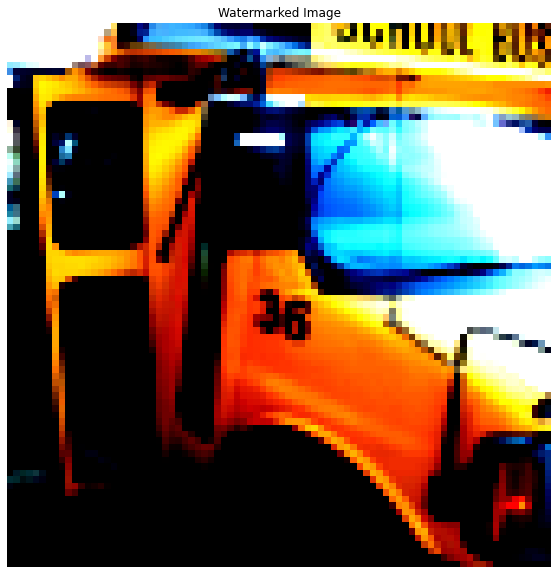

  9%|▉         | 1/11 [00:07<01:17,  7.72s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 12: Target opacity: 0, Labeled correctly: 0.52, Correctly Predicted Target: True, Base class predicted: False


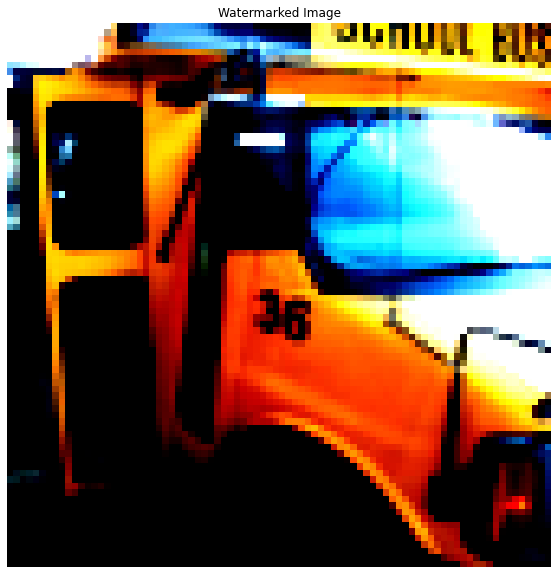

 18%|█▊        | 2/11 [00:15<01:08,  7.66s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 12: Target opacity: 0.05, Labeled correctly: 0.52, Correctly Predicted Target: True, Base class predicted: False


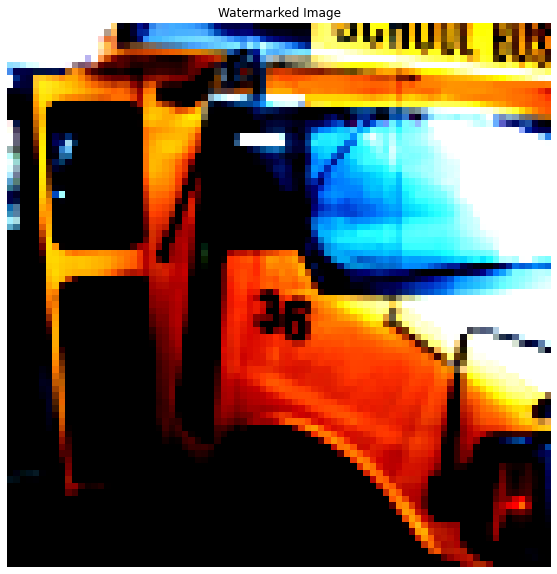

 27%|██▋       | 3/11 [00:23<01:01,  7.72s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 12: Target opacity: 0.1, Labeled correctly: 0.5333333333333333, Correctly Predicted Target: True, Base class predicted: False


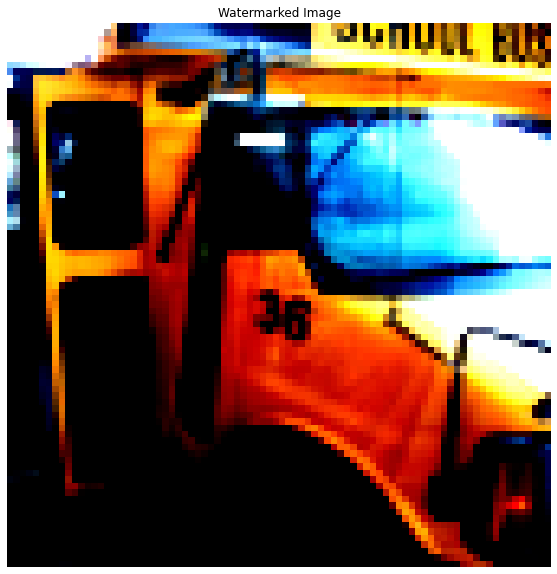

 36%|███▋      | 4/11 [00:30<00:54,  7.74s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 12: Target opacity: 0.15, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: True, Base class predicted: False


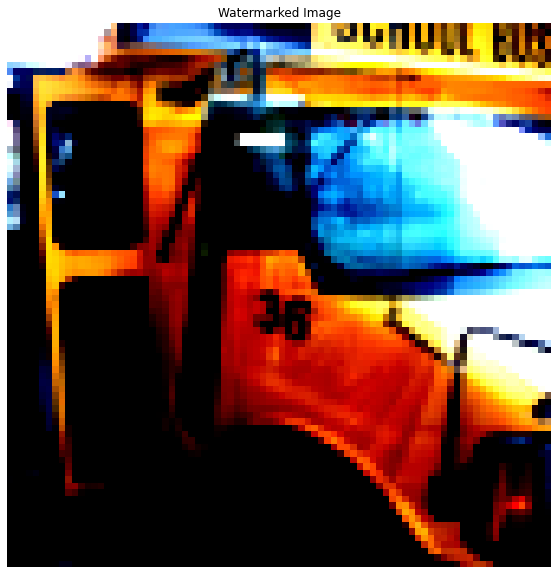

 45%|████▌     | 5/11 [00:38<00:46,  7.72s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 12: Target opacity: 0.2, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: True, Base class predicted: False


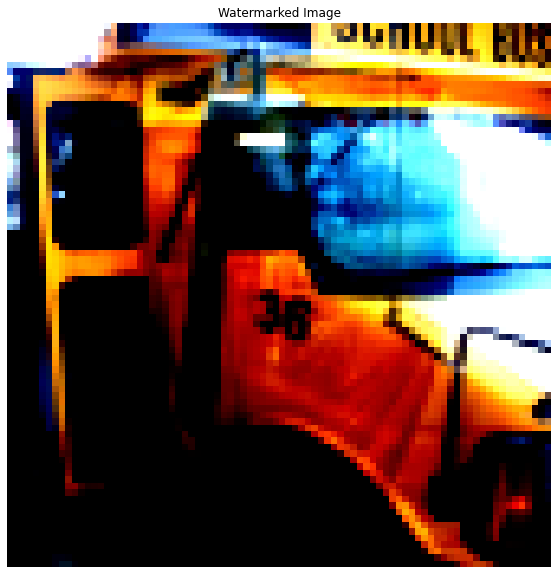

 55%|█████▍    | 6/11 [00:46<00:38,  7.74s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 12: Target opacity: 0.25, Labeled correctly: 0.5733333333333334, Correctly Predicted Target: True, Base class predicted: False


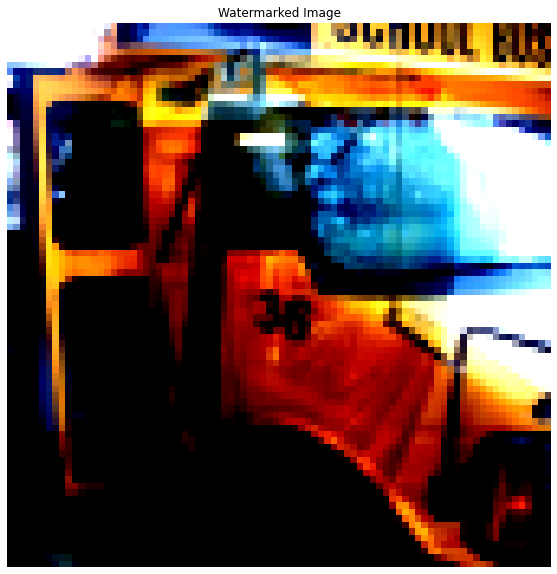

 64%|██████▎   | 7/11 [00:54<00:31,  7.76s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 12: Target opacity: 0.3, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: True, Base class predicted: False


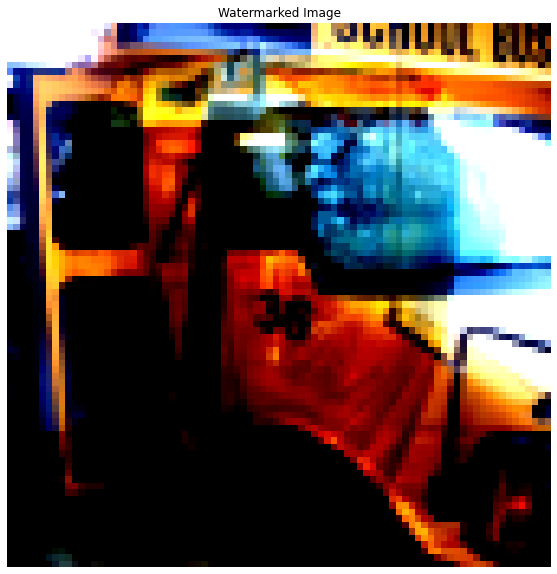

 73%|███████▎  | 8/11 [01:01<00:23,  7.77s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 12: Target opacity: 0.35, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: True, Base class predicted: False


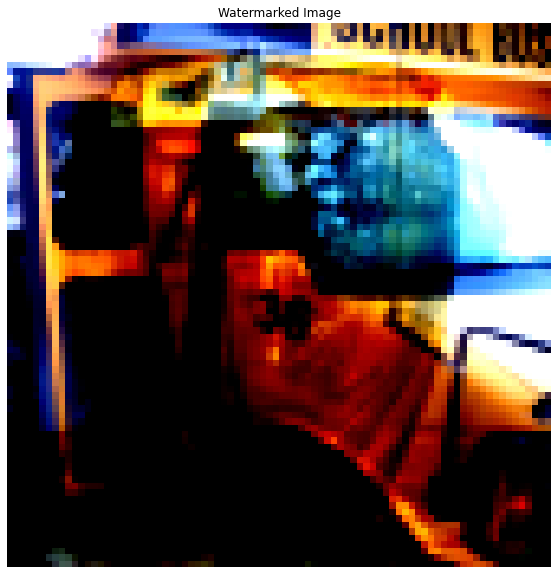

 82%|████████▏ | 9/11 [01:09<00:15,  7.79s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 12: Target opacity: 0.4, Labeled correctly: 0.6, Correctly Predicted Target: True, Base class predicted: False


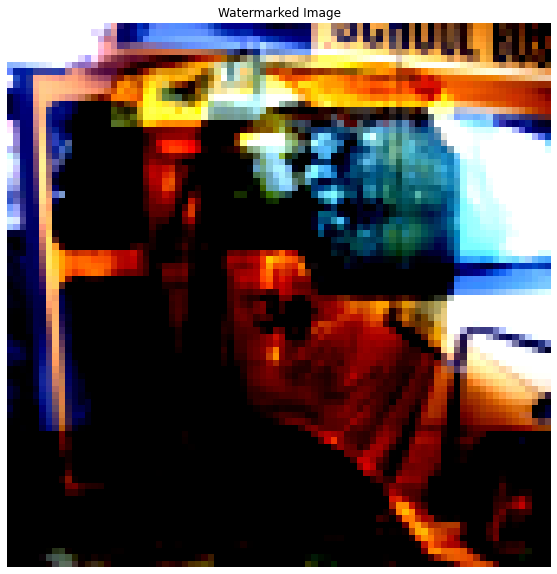

 91%|█████████ | 10/11 [01:17<00:07,  7.79s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 12: Target opacity: 0.45, Labeled correctly: 0.6, Correctly Predicted Target: True, Base class predicted: False


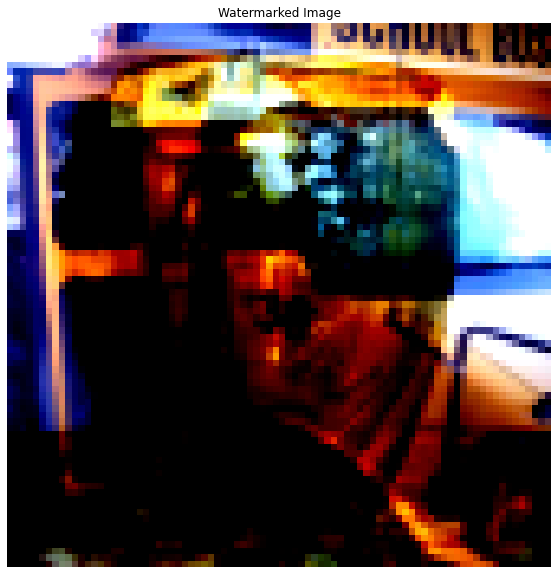

100%|██████████| 11/11 [01:25<00:00,  7.76s/it]

Iteration 12: Target opacity: 0.5, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: True, Base class predicted: False



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


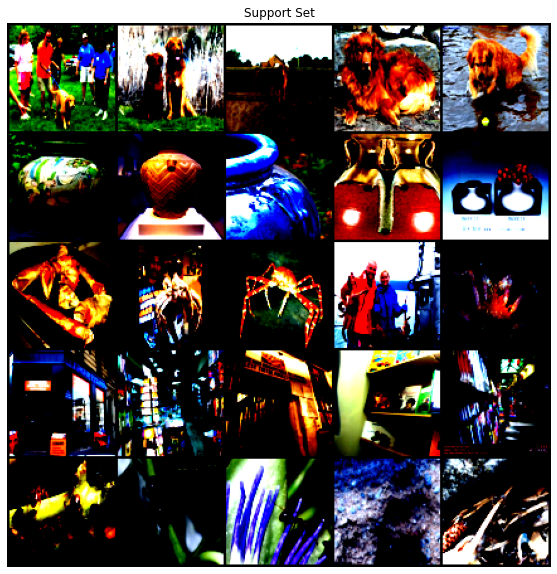

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 4, 4, 4, 4,
         4]])


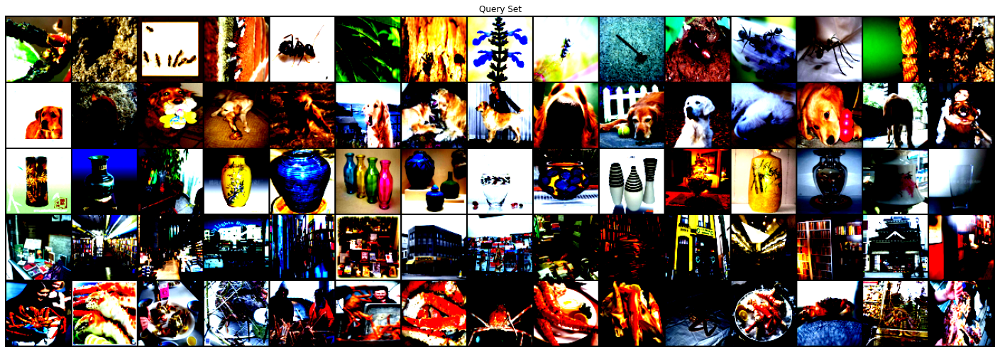

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3,
         3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1,
         1, 1, 1]])
target_class 0
unique_classes [1, 2, 3, 4]
base_class 2
target_indices [15 16 17 18 19 20 21 22 23 24 25 26 27 28 29]
target_index 28
base_indices [5 6 7 8 9]
base_index 9


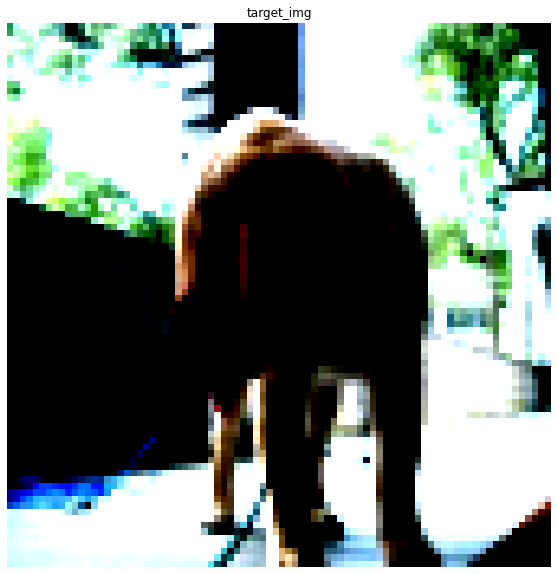

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


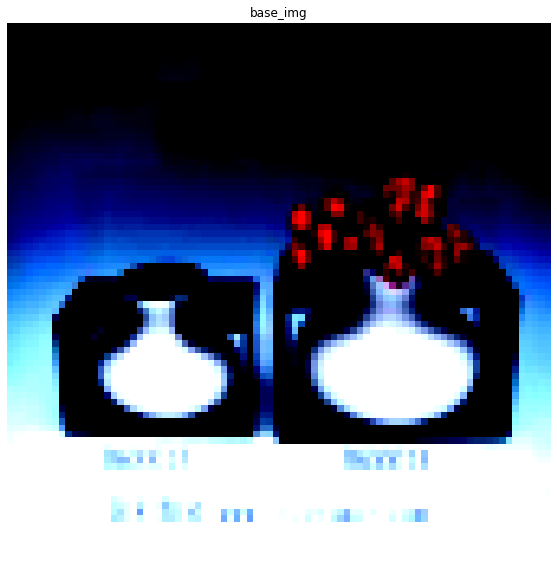

  0%|          | 3/1000 [00:00<00:33, 29.89it/s]

Iteration 0
loss: tensor(0.9228, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(22.6618, grad_fn=<PowBackward0>)
Iteration 2
loss: tensor(38.6019, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(11.9424, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(16.2902, grad_fn=<PowBackward0>)
Iteration 5
loss: 

  1%|          | 9/1000 [00:00<00:39, 25.39it/s]

tensor(16.2068, grad_fn=<PowBackward0>)
Iteration 6
loss: tensor(27.2226, grad_fn=<PowBackward0>)
Iteration 7
loss: tensor(23.9608, grad_fn=<PowBackward0>)
Iteration 8
loss: tensor(39.7832, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(10.7170, grad_fn=<PowBackward0>)
Iteration 10
loss: tensor(29.2370, grad_fn=<PowBackward0>)


  2%|▏         | 15/1000 [00:00<00:36, 26.72it/s]

Iteration 11
loss: tensor(14.5627, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(26.3061, grad_fn=<PowBackward0>)
Iteration 13
loss: tensor(8.9289, grad_fn=<PowBackward0>)
Iteration 14
loss: tensor(16.0382, grad_fn=<PowBackward0>)
Iteration 15
loss: tensor(23.5088, grad_fn=<PowBackward0>)
Iteration 16
loss: tensor(46.8831, grad_fn=<PowBackward0>)

  2%|▏         | 21/1000 [00:00<00:36, 26.71it/s]


Iteration 17
loss: tensor(13.2960, grad_fn=<PowBackward0>)
Iteration 18
loss: tensor(12.1299, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(13.6477, grad_fn=<PowBackward0>)
Iteration 20
loss: tensor(46.6213, grad_fn=<PowBackward0>)
Iteration 21
loss: tensor(13.9873, grad_fn=<PowBackward0>)


  3%|▎         | 27/1000 [00:01<00:37, 26.04it/s]

Iteration 22
loss: tensor(8.4242, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(20.8400, grad_fn=<PowBackward0>)
Iteration 24
loss: tensor(59.0449, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(9.5847, grad_fn=<PowBackward0>)
Iteration 26
loss: tensor(10.6930, grad_fn=<PowBackward0>)
Iteration 27


  3%|▎         | 33/1000 [00:01<00:36, 26.73it/s]

loss: tensor(20.5551, grad_fn=<PowBackward0>)
Iteration 28
loss: tensor(47.6243, grad_fn=<PowBackward0>)
Iteration 29
loss: tensor(7.4174, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(23.7828, grad_fn=<PowBackward0>)
Iteration 31
loss: tensor(30.1018, grad_fn=<PowBackward0>)
Iteration 32
loss: tensor(27.4870, grad_fn=<PowBackward0>)


  4%|▎         | 36/1000 [00:01<00:36, 26.12it/s]

Iteration 33
loss: tensor(6.1443, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(19.5171, grad_fn=<PowBackward0>)
Iteration 35
loss: tensor(27.7881, grad_fn=<PowBackward0>)
Iteration 36
loss: tensor(22.3150, grad_fn=<PowBackward0>)
Iteration 37
loss: tensor(8.3463, grad_fn=<PowBackward0>)
Iteration 38
loss:

  4%|▍         | 42/1000 [00:01<00:35, 26.86it/s]

 tensor(32.5076, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(17.1963, grad_fn=<PowBackward0>)
Iteration 40
loss: tensor(25.7086, grad_fn=<PowBackward0>)
Iteration 41
loss: tensor(18.3877, grad_fn=<PowBackward0>)
Iteration 42
loss: tensor(15.7521, grad_fn=<PowBackward0>)
Iteration 43
loss: tensor(14.9361, grad_fn=<PowBackward0>)


  5%|▍         | 48/1000 [00:01<00:35, 27.13it/s]

Iteration 44
loss: tensor(19.7158, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(4.8701, grad_fn=<PowBackward0>)
Iteration 46
loss: tensor(8.3011, grad_fn=<PowBackward0>)
Iteration 47
loss: tensor(17.6865, grad_fn=<PowBackward0>)
Iteration 48
loss: tensor(44.9455, grad_fn=<PowBackward0>)
Iteration 49
loss: tensor(11.9883, grad_fn=<PowBackward0>)


  5%|▌         | 54/1000 [00:02<00:35, 26.89it/s]

Iteration 50
loss: tensor(12.9432, grad_fn=<PowBackward0>)
Iteration 51
loss: tensor(18.4485, grad_fn=<PowBackward0>)
Iteration 52
loss: tensor(42.3600, grad_fn=<PowBackward0>)
Iteration 53
loss: tensor(11.0641, grad_fn=<PowBackward0>)
Iteration 54
loss: tensor(29.9257, grad_fn=<PowBackward0>)
Iteration 55


  6%|▌         | 60/1000 [00:02<00:34, 27.12it/s]

loss: tensor(7.3566, grad_fn=<PowBackward0>)
Iteration 56
loss: tensor(23.5423, grad_fn=<PowBackward0>)
Iteration 57
loss: tensor(24.3953, grad_fn=<PowBackward0>)
Iteration 58
loss: tensor(37.0256, grad_fn=<PowBackward0>)
Iteration 59
loss: tensor(11.3816, grad_fn=<PowBackward0>)
Iteration 60
loss: tensor(24.7436, grad_fn=<PowBackward0>)
Iteration 61


  7%|▋         | 66/1000 [00:02<00:35, 26.00it/s]

loss: tensor(18.7051, grad_fn=<PowBackward0>)
Iteration 62
loss: tensor(37.4827, grad_fn=<PowBackward0>)
Iteration 63
loss: tensor(13.7317, grad_fn=<PowBackward0>)
Iteration 64
loss: tensor(13.7247, grad_fn=<PowBackward0>)
Iteration 65
loss: tensor(17.8165, grad_fn=<PowBackward0>)
Iteration 66


  7%|▋         | 72/1000 [00:02<00:34, 26.62it/s]

loss: tensor(52.9046, grad_fn=<PowBackward0>)
Iteration 67
loss: tensor(0.6180, grad_fn=<PowBackward0>)
Iteration 68
loss: tensor(0.2199, grad_fn=<PowBackward0>)
Iteration 69
loss: tensor(0.6945, grad_fn=<PowBackward0>)
Iteration 70
loss: tensor(9.0086, grad_fn=<PowBackward0>)
Iteration 71
loss: tensor(7.1789, grad_fn=<PowBackward0>)


  8%|▊         | 75/1000 [00:02<00:34, 26.68it/s]

Iteration 72
loss: tensor(17.7020, grad_fn=<PowBackward0>)
Iteration 73
loss: tensor(14.2872, grad_fn=<PowBackward0>)
Iteration 74
loss: tensor(38.2013, grad_fn=<PowBackward0>)
Iteration 75
loss: tensor(5.0716, grad_fn=<PowBackward0>)
Iteration 76
loss: tensor(10.6782, grad_fn=<PowBackward0>)
Iteration 77
loss: tensor(14.5928, grad_fn=<PowBackward0>)


  8%|▊         | 81/1000 [00:03<00:34, 26.98it/s]

Iteration 78
loss: tensor(27.5465, grad_fn=<PowBackward0>)
Iteration 79
loss: tensor(17.0578, grad_fn=<PowBackward0>)
Iteration 80
loss: tensor(46.3495, grad_fn=<PowBackward0>)
Iteration 81
loss: tensor(13.1954, grad_fn=<PowBackward0>)
Iteration 82
loss: tensor(46.9320, grad_fn=<PowBackward0>)
Iteration 83
loss: tensor(6.2265, grad_fn=<PowBackward0>)


  9%|▊         | 87/1000 [00:03<00:36, 24.84it/s]

Iteration 84
loss: tensor(18.3223, grad_fn=<PowBackward0>)
Iteration 85
loss: tensor(7.3127, grad_fn=<PowBackward0>)
Iteration 86
loss: tensor(40.7244, grad_fn=<PowBackward0>)
Iteration 87
loss: tensor(17.5771, grad_fn=<PowBackward0>)
Iteration 88
loss: tensor(19.1307, grad_fn=<PowBackward0>)


  9%|▉         | 93/1000 [00:03<00:35, 25.89it/s]

Iteration 89
loss: tensor(5.6257, grad_fn=<PowBackward0>)
Iteration 90
loss: tensor(44.4404, grad_fn=<PowBackward0>)
Iteration 91
loss: tensor(24.2666, grad_fn=<PowBackward0>)
Iteration 92
loss: tensor(21.0355, grad_fn=<PowBackward0>)
Iteration 93
loss: tensor(6.9920, grad_fn=<PowBackward0>)
Iteration 94
loss: tensor(21.2201, grad_fn=<PowBackward0>)
Iteration 95


 10%|▉         | 99/1000 [00:03<00:35, 25.36it/s]

loss: tensor(10.6759, grad_fn=<PowBackward0>)
Iteration 96
loss: tensor(21.3481, grad_fn=<PowBackward0>)
Iteration 97
loss: tensor(18.4321, grad_fn=<PowBackward0>)
Iteration 98
loss: tensor(29.5238, grad_fn=<PowBackward0>)
Iteration 99
loss: tensor(14.3547, grad_fn=<PowBackward0>)
Iteration 100


 10%|█         | 105/1000 [00:04<00:34, 25.95it/s]

loss: tensor(25.6322, grad_fn=<PowBackward0>)
Iteration 101
loss: tensor(5.0406, grad_fn=<PowBackward0>)
Iteration 102
loss: tensor(3.1775, grad_fn=<PowBackward0>)
Iteration 103
loss: tensor(15.5752, grad_fn=<PowBackward0>)
Iteration 104
loss: tensor(30.6858, grad_fn=<PowBackward0>)
Iteration 105
loss: tensor(16.8605, grad_fn=<PowBackward0>)


 11%|█         | 111/1000 [00:04<00:33, 26.43it/s]

Iteration 106
loss: tensor(11.7462, grad_fn=<PowBackward0>)
Iteration 107
loss: tensor(16.5200, grad_fn=<PowBackward0>)
Iteration 108
loss: tensor(22.7221, grad_fn=<PowBackward0>)
Iteration 109
loss: tensor(13.5971, grad_fn=<PowBackward0>)
Iteration 110
loss: tensor(12.7418, grad_fn=<PowBackward0>)
Iteration 111


 11%|█▏        | 114/1000 [00:04<00:33, 26.60it/s]

loss: tensor(17.5485, grad_fn=<PowBackward0>)
Iteration 112
loss: tensor(17.7238, grad_fn=<PowBackward0>)
Iteration 113
loss: tensor(20.8084, grad_fn=<PowBackward0>)
Iteration 114
loss: tensor(9.7574, grad_fn=<PowBackward0>)
Iteration 115
loss: tensor(6.9770, grad_fn=<PowBackward0>)
Iteration 116
loss: tensor(18.1514, grad_fn=<PowBackward0>)


 12%|█▏        | 120/1000 [00:04<00:32, 26.72it/s]

Iteration 117
loss: tensor(5.7628, grad_fn=<PowBackward0>)
Iteration 118
loss: tensor(14.1976, grad_fn=<PowBackward0>)
Iteration 119
loss: tensor(20.3756, grad_fn=<PowBackward0>)
Iteration 120
loss: tensor(16.6522, grad_fn=<PowBackward0>)
Iteration 121
loss: tensor(12.1691, grad_fn=<PowBackward0>)
Iteration 122
loss: tensor(10.9380, grad_fn=<PowBackward0>)


 13%|█▎        | 126/1000 [00:04<00:32, 27.18it/s]

Iteration 123
loss: tensor(13.6638, grad_fn=<PowBackward0>)
Iteration 124
loss: tensor(21.6526, grad_fn=<PowBackward0>)
Iteration 125
loss: tensor(12.3041, grad_fn=<PowBackward0>)
Iteration 126
loss: tensor(14.2766, grad_fn=<PowBackward0>)
Iteration 127
loss: tensor(19.1188, grad_fn=<PowBackward0>)
Iteration 128
loss: tensor(26.5430, grad_fn=<PowBackward0>)


 13%|█▎        | 132/1000 [00:05<00:31, 27.32it/s]

Iteration 129
loss: tensor(12.1412, grad_fn=<PowBackward0>)
Iteration 130
loss: tensor(17.6438, grad_fn=<PowBackward0>)
Iteration 131
loss: tensor(9.1369, grad_fn=<PowBackward0>)
Iteration 132
loss: tensor(24.8321, grad_fn=<PowBackward0>)
Iteration 133
loss: tensor(7.3198, grad_fn=<PowBackward0>)
Iteration 134


 14%|█▍        | 138/1000 [00:05<00:32, 26.77it/s]

loss: tensor(8.2729, grad_fn=<PowBackward0>)
Iteration 135
loss: tensor(19.6065, grad_fn=<PowBackward0>)
Iteration 136
loss: tensor(18.9813, grad_fn=<PowBackward0>)
Iteration 137
loss: tensor(6.0433, grad_fn=<PowBackward0>)
Iteration 138
loss: tensor(16.2496, grad_fn=<PowBackward0>)
Iteration 139
loss: tensor(9.0351, grad_fn=<PowBackward0>)
Iteration 140


 14%|█▍        | 144/1000 [00:05<00:32, 26.30it/s]

loss: tensor(19.7611, grad_fn=<PowBackward0>)
Iteration 141
loss: tensor(15.2243, grad_fn=<PowBackward0>)
Iteration 142
loss: tensor(16.7541, grad_fn=<PowBackward0>)
Iteration 143
loss: tensor(6.4970, grad_fn=<PowBackward0>)
Iteration 144
loss: tensor(21.7714, grad_fn=<PowBackward0>)
Iteration 145
loss: tensor(5.0089, grad_fn=<PowBackward0>)


 15%|█▌        | 150/1000 [00:05<00:31, 27.05it/s]

Iteration 146
loss: tensor(9.0939, grad_fn=<PowBackward0>)
Iteration 147
loss: tensor(13.3296, grad_fn=<PowBackward0>)
Iteration 148
loss: tensor(21.7767, grad_fn=<PowBackward0>)
Iteration 149
loss: tensor(11.9260, grad_fn=<PowBackward0>)
Iteration 150
loss: tensor(20.9156, grad_fn=<PowBackward0>)
Iteration 151
loss: tensor(12.4627, grad_fn=<PowBackward0>)


 16%|█▌        | 156/1000 [00:05<00:30, 27.42it/s]

Iteration 152
loss: tensor(31.4078, grad_fn=<PowBackward0>)
Iteration 153
loss: tensor(14.8575, grad_fn=<PowBackward0>)
Iteration 154
loss: tensor(21.9785, grad_fn=<PowBackward0>)
Iteration 155
loss: tensor(14.1836, grad_fn=<PowBackward0>)
Iteration 156
loss: tensor(13.1750, grad_fn=<PowBackward0>)
Iteration 157
loss:

 16%|█▌        | 162/1000 [00:06<00:31, 26.83it/s]

 tensor(14.4426, grad_fn=<PowBackward0>)
Iteration 158
loss: tensor(28.1975, grad_fn=<PowBackward0>)
Iteration 159
loss: tensor(14.2143, grad_fn=<PowBackward0>)
Iteration 160
loss: tensor(24.9410, grad_fn=<PowBackward0>)
Iteration 161
loss: tensor(8.0212, grad_fn=<PowBackward0>)
Iteration 162
loss: tensor(19.2841, grad_fn=<PowBackward0>)


 17%|█▋        | 168/1000 [00:06<00:30, 27.12it/s]

Iteration 163
loss: tensor(11.6739, grad_fn=<PowBackward0>)
Iteration 164
loss: tensor(22.5915, grad_fn=<PowBackward0>)
Iteration 165
loss: tensor(13.2299, grad_fn=<PowBackward0>)
Iteration 166
loss: tensor(17.7845, grad_fn=<PowBackward0>)
Iteration 167
loss: tensor(14.7531, grad_fn=<PowBackward0>)
Iteration 168
loss: tensor(23.7676, grad_fn=<PowBackward0>)


 17%|█▋        | 171/1000 [00:06<00:32, 25.68it/s]

Iteration 169
loss: tensor(9.2012, grad_fn=<PowBackward0>)
Iteration 170
loss: tensor(19.5470, grad_fn=<PowBackward0>)
Iteration 171
loss: tensor(8.8711, grad_fn=<PowBackward0>)
Iteration 172
loss: tensor(16.8682, grad_fn=<PowBackward0>)
Iteration 173
loss: tensor(13.2871, grad_fn=<PowBackward0>)


 18%|█▊        | 177/1000 [00:06<00:31, 26.20it/s]

Iteration 174
loss: tensor(31.8847, grad_fn=<PowBackward0>)
Iteration 175
loss: tensor(6.1164, grad_fn=<PowBackward0>)
Iteration 176
loss: tensor(16.6651, grad_fn=<PowBackward0>)
Iteration 177
loss: tensor(14.5116, grad_fn=<PowBackward0>)
Iteration 178
loss: tensor(15.2144, grad_fn=<PowBackward0>)
Iteration 179


 18%|█▊        | 183/1000 [00:06<00:31, 25.90it/s]

loss: tensor(10.5677, grad_fn=<PowBackward0>)
Iteration 180
loss: tensor(24.5111, grad_fn=<PowBackward0>)
Iteration 181
loss: tensor(9.8539, grad_fn=<PowBackward0>)
Iteration 182
loss: tensor(14.3841, grad_fn=<PowBackward0>)
Iteration 183
loss: tensor(11.0156, grad_fn=<PowBackward0>)
Iteration 184
loss: tensor(30.0222, grad_fn=<PowBackward0>)


 19%|█▉        | 189/1000 [00:07<00:31, 25.93it/s]

Iteration 185
loss: tensor(12.4058, grad_fn=<PowBackward0>)
Iteration 186
loss: tensor(11.1609, grad_fn=<PowBackward0>)
Iteration 187
loss: tensor(7.4131, grad_fn=<PowBackward0>)
Iteration 188
loss: tensor(19.5085, grad_fn=<PowBackward0>)
Iteration 189
loss: tensor(18.1733, grad_fn=<PowBackward0>)
Iteration 190


 20%|█▉        | 195/1000 [00:07<00:31, 25.96it/s]

loss: tensor(15.5775, grad_fn=<PowBackward0>)
Iteration 191
loss: tensor(9.7031, grad_fn=<PowBackward0>)
Iteration 192
loss: tensor(24.0895, grad_fn=<PowBackward0>)
Iteration 193
loss: tensor(8.9689, grad_fn=<PowBackward0>)
Iteration 194
loss: tensor(21.7308, grad_fn=<PowBackward0>)
Iteration 195
loss: tensor(12.3873, grad_fn=<PowBackward0>)


 20%|██        | 201/1000 [00:07<00:30, 26.16it/s]

Iteration 196
loss: tensor(10.3130, grad_fn=<PowBackward0>)
Iteration 197
loss: tensor(8.0816, grad_fn=<PowBackward0>)
Iteration 198
loss: tensor(19.1330, grad_fn=<PowBackward0>)
Iteration 199
loss: tensor(19.3941, grad_fn=<PowBackward0>)
Iteration 200
loss: tensor(19.8012, grad_fn=<PowBackward0>)
Iteration 201


 20%|██        | 204/1000 [00:07<00:31, 25.48it/s]

loss: tensor(10.0719, grad_fn=<PowBackward0>)
Iteration 202
loss: tensor(4.1437, grad_fn=<PowBackward0>)
Iteration 203
loss: tensor(2.7153, grad_fn=<PowBackward0>)
Iteration 204
loss: tensor(2.3949, grad_fn=<PowBackward0>)
Iteration 205
loss: tensor(3.9658, grad_fn=<PowBackward0>)
Iteration 206
loss: tensor(10.4999, grad_fn=<PowBackward0>)


 21%|██        | 210/1000 [00:07<00:29, 26.57it/s]

Iteration 207
loss: tensor(8.9362, grad_fn=<PowBackward0>)
Iteration 208
loss: tensor(17.9815, grad_fn=<PowBackward0>)
Iteration 209
loss: tensor(10.9473, grad_fn=<PowBackward0>)
Iteration 210
loss: tensor(6.7773, grad_fn=<PowBackward0>)
Iteration 211
loss: tensor(2.9135, grad_fn=<PowBackward0>)
Iteration 212
loss: tensor(4.3611, grad_fn=<PowBackward0>)

 22%|██▏       | 216/1000 [00:08<00:29, 26.56it/s]


Iteration 213
loss: tensor(5.9527, grad_fn=<PowBackward0>)
Iteration 214
loss: tensor(9.3692, grad_fn=<PowBackward0>)
Iteration 215
loss: tensor(6.1817, grad_fn=<PowBackward0>)
Iteration 216
loss: tensor(7.2504, grad_fn=<PowBackward0>)
Iteration 217
loss: tensor(6.7278, grad_fn=<PowBackward0>)


 22%|██▏       | 222/1000 [00:08<00:29, 26.77it/s]

Iteration 218
loss: tensor(5.0647, grad_fn=<PowBackward0>)
Iteration 219
loss: tensor(2.5036, grad_fn=<PowBackward0>)
Iteration 220
loss: tensor(5.2017, grad_fn=<PowBackward0>)
Iteration 221
loss: tensor(6.0515, grad_fn=<PowBackward0>)
Iteration 222
loss: tensor(12.4566, grad_fn=<PowBackward0>)
Iteration 223


 23%|██▎       | 228/1000 [00:08<00:29, 26.49it/s]

loss: tensor(8.0030, grad_fn=<PowBackward0>)
Iteration 224
loss: tensor(5.9795, grad_fn=<PowBackward0>)
Iteration 225
loss: tensor(2.9715, grad_fn=<PowBackward0>)
Iteration 226
loss: tensor(7.7351, grad_fn=<PowBackward0>)
Iteration 227
loss: tensor(4.1759, grad_fn=<PowBackward0>)
Iteration 228
loss: tensor(5.9526, grad_fn=<PowBackward0>)


 23%|██▎       | 234/1000 [00:08<00:28, 26.68it/s]

Iteration 229
loss: tensor(6.5922, grad_fn=<PowBackward0>)
Iteration 230
loss: tensor(6.6220, grad_fn=<PowBackward0>)
Iteration 231
loss: tensor(5.9632, grad_fn=<PowBackward0>)
Iteration 232
loss: tensor(8.6475, grad_fn=<PowBackward0>)
Iteration 233
loss: tensor(2.8001, grad_fn=<PowBackward0>)
Iteration 234
loss: tensor(5.0744, grad_fn=<PowBackward0>)


 24%|██▍       | 240/1000 [00:09<00:28, 26.96it/s]

Iteration 235
loss: tensor(5.5101, grad_fn=<PowBackward0>)
Iteration 236
loss: tensor(8.4819, grad_fn=<PowBackward0>)
Iteration 237
loss: tensor(6.9467, grad_fn=<PowBackward0>)
Iteration 238
loss: tensor(9.9753, grad_fn=<PowBackward0>)
Iteration 239
loss: tensor(5.9498, grad_fn=<PowBackward0>)
Iteration 240
loss: tensor(7.7698, grad_fn=<PowBackward0>)

 25%|██▍       | 246/1000 [00:09<00:27, 27.39it/s]


Iteration 241
loss: tensor(3.8850, grad_fn=<PowBackward0>)
Iteration 242
loss: tensor(4.9496, grad_fn=<PowBackward0>)
Iteration 243
loss: tensor(8.6927, grad_fn=<PowBackward0>)
Iteration 244
loss: tensor(13.3614, grad_fn=<PowBackward0>)
Iteration 245
loss: tensor(8.7998, grad_fn=<PowBackward0>)
Iteration 246


 25%|██▍       | 249/1000 [00:09<00:27, 27.33it/s]

loss: tensor(7.6722, grad_fn=<PowBackward0>)
Iteration 247
loss: tensor(4.4248, grad_fn=<PowBackward0>)
Iteration 248
loss: tensor(5.9939, grad_fn=<PowBackward0>)
Iteration 249
loss: tensor(6.4874, grad_fn=<PowBackward0>)
Iteration 250
loss: tensor(10.1206, grad_fn=<PowBackward0>)
Iteration 251
loss: tensor(3.6558, grad_fn=<PowBackward0>)


 26%|██▌       | 255/1000 [00:09<00:27, 26.75it/s]

Iteration 252
loss: tensor(5.4657, grad_fn=<PowBackward0>)
Iteration 253
loss: tensor(2.0556, grad_fn=<PowBackward0>)
Iteration 254
loss: tensor(3.0810, grad_fn=<PowBackward0>)
Iteration 255
loss: tensor(4.7481, grad_fn=<PowBackward0>)
Iteration 256
loss: tensor(10.4929, grad_fn=<PowBackward0>)
Iteration 257
loss: tensor(7.8126, grad_fn=<PowBackward0>)


 26%|██▌       | 261/1000 [00:09<00:27, 26.65it/s]

Iteration 258
loss: tensor(8.9461, grad_fn=<PowBackward0>)
Iteration 259
loss: tensor(5.3944, grad_fn=<PowBackward0>)
Iteration 260
loss: tensor(6.6745, grad_fn=<PowBackward0>)
Iteration 261
loss: tensor(4.9720, grad_fn=<PowBackward0>)
Iteration 262
loss: tensor(6.1156, grad_fn=<PowBackward0>)
Iteration 263
loss: tensor(5.5283, grad_fn=<PowBackward0>)


 27%|██▋       | 267/1000 [00:10<00:26, 27.62it/s]

Iteration 264
loss: tensor(8.7905, grad_fn=<PowBackward0>)
Iteration 265
loss: tensor(6.1572, grad_fn=<PowBackward0>)
Iteration 266
loss: tensor(8.0213, grad_fn=<PowBackward0>)
Iteration 267
loss: tensor(4.7492, grad_fn=<PowBackward0>)
Iteration 268
loss: tensor(5.8775, grad_fn=<PowBackward0>)
Iteration 269
loss: tensor(6.5016, grad_fn=<PowBackward0>)


 27%|██▋       | 273/1000 [00:10<00:26, 27.57it/s]

Iteration 270
loss: tensor(9.4067, grad_fn=<PowBackward0>)
Iteration 271
loss: tensor(2.9328, grad_fn=<PowBackward0>)
Iteration 272
loss: tensor(3.6007, grad_fn=<PowBackward0>)
Iteration 273
loss: tensor(2.5652, grad_fn=<PowBackward0>)
Iteration 274
loss: tensor(4.2306, grad_fn=<PowBackward0>)
Iteration 275
loss: tensor(8.5780, grad_fn=<PowBackward0>)


 28%|██▊       | 279/1000 [00:10<00:27, 25.99it/s]

Iteration 276
loss: tensor(12.0878, grad_fn=<PowBackward0>)
Iteration 277
loss: tensor(7.1603, grad_fn=<PowBackward0>)
Iteration 278
loss: tensor(8.0741, grad_fn=<PowBackward0>)
Iteration 279
loss: tensor(4.7859, grad_fn=<PowBackward0>)
Iteration 280
loss: tensor(6.2824, grad_fn=<PowBackward0>)


 28%|██▊       | 285/1000 [00:10<00:27, 25.83it/s]

Iteration 281
loss: tensor(4.5153, grad_fn=<PowBackward0>)
Iteration 282
loss: tensor(9.8404, grad_fn=<PowBackward0>)
Iteration 283
loss: tensor(5.5095, grad_fn=<PowBackward0>)
Iteration 284
loss: tensor(7.1379, grad_fn=<PowBackward0>)
Iteration 285
loss: tensor(5.7663, grad_fn=<PowBackward0>)
Iteration 286


 29%|██▉       | 291/1000 [00:11<00:27, 25.92it/s]

loss: tensor(9.1021, grad_fn=<PowBackward0>)
Iteration 287
loss: tensor(7.5283, grad_fn=<PowBackward0>)
Iteration 288
loss: tensor(14.7006, grad_fn=<PowBackward0>)
Iteration 289
loss: tensor(10.3839, grad_fn=<PowBackward0>)
Iteration 290
loss: tensor(8.4444, grad_fn=<PowBackward0>)
Iteration 291
loss: tensor(5.3964, grad_fn=<PowBackward0>)


 30%|██▉       | 297/1000 [00:11<00:27, 25.66it/s]

Iteration 292
loss: tensor(7.7370, grad_fn=<PowBackward0>)
Iteration 293
loss: tensor(5.1112, grad_fn=<PowBackward0>)
Iteration 294
loss: tensor(9.5215, grad_fn=<PowBackward0>)
Iteration 295
loss: tensor(9.4377, grad_fn=<PowBackward0>)
Iteration 296
loss: tensor(9.0400, grad_fn=<PowBackward0>)
Iteration 297


 30%|███       | 300/1000 [00:11<00:27, 25.85it/s]

loss: tensor(4.4633, grad_fn=<PowBackward0>)
Iteration 298
loss: tensor(7.3090, grad_fn=<PowBackward0>)
Iteration 299
loss: tensor(5.5219, grad_fn=<PowBackward0>)
Iteration 300
loss: tensor(6.1872, grad_fn=<PowBackward0>)
Iteration 301
loss: tensor(6.3127, grad_fn=<PowBackward0>)
Iteration 302
loss: tensor(1.5712, grad_fn=<PowBackward0>)


 31%|███       | 306/1000 [00:11<00:27, 25.52it/s]

Iteration 303
loss: tensor(0.5465, grad_fn=<PowBackward0>)
Iteration 304
loss: tensor(0.5152, grad_fn=<PowBackward0>)
Iteration 305
loss: tensor(0.3625, grad_fn=<PowBackward0>)
Iteration 306
loss: tensor(0.4515, grad_fn=<PowBackward0>)
Iteration 307
loss: tensor(0.4987, grad_fn=<PowBackward0>)
Iteration 308


 31%|███       | 312/1000 [00:11<00:25, 26.78it/s]

loss: tensor(0.9425, grad_fn=<PowBackward0>)
Iteration 309
loss: tensor(0.9758, grad_fn=<PowBackward0>)
Iteration 310
loss: tensor(1.5603, grad_fn=<PowBackward0>)
Iteration 311
loss: tensor(1.5315, grad_fn=<PowBackward0>)
Iteration 312
loss: tensor(2.0524, grad_fn=<PowBackward0>)
Iteration 313
loss: tensor(1.7871, grad_fn=<PowBackward0>)
Iteration 314


 32%|███▏      | 318/1000 [00:12<00:27, 24.78it/s]

loss: tensor(1.9824, grad_fn=<PowBackward0>)
Iteration 315
loss: tensor(2.1013, grad_fn=<PowBackward0>)
Iteration 316
loss: tensor(2.4925, grad_fn=<PowBackward0>)
Iteration 317
loss: tensor(1.6109, grad_fn=<PowBackward0>)
Iteration 318
loss: tensor(2.8168, grad_fn=<PowBackward0>)
Iteration 319


 32%|███▏      | 324/1000 [00:12<00:25, 26.05it/s]

loss: tensor(1.9502, grad_fn=<PowBackward0>)
Iteration 320
loss: tensor(2.9763, grad_fn=<PowBackward0>)
Iteration 321
loss: tensor(1.9756, grad_fn=<PowBackward0>)
Iteration 322
loss: tensor(2.8950, grad_fn=<PowBackward0>)
Iteration 323
loss: tensor(2.0074, grad_fn=<PowBackward0>)
Iteration 324
loss: tensor(2.7929, grad_fn=<PowBackward0>)


 33%|███▎      | 330/1000 [00:12<00:25, 26.17it/s]

Iteration 325
loss: tensor(2.4384, grad_fn=<PowBackward0>)
Iteration 326
loss: tensor(3.2077, grad_fn=<PowBackward0>)
Iteration 327
loss: tensor(2.0832, grad_fn=<PowBackward0>)
Iteration 328
loss: tensor(2.4803, grad_fn=<PowBackward0>)
Iteration 329
loss: tensor(1.4436, grad_fn=<PowBackward0>)
Iteration 330


 33%|███▎      | 333/1000 [00:12<00:26, 25.63it/s]

loss: tensor(1.8559, grad_fn=<PowBackward0>)
Iteration 331
loss: tensor(1.1551, grad_fn=<PowBackward0>)
Iteration 332
loss: tensor(1.9698, grad_fn=<PowBackward0>)
Iteration 333
loss: tensor(1.4800, grad_fn=<PowBackward0>)
Iteration 334
loss: tensor(2.3701, grad_fn=<PowBackward0>)
Iteration 335
loss: tensor(1.3002, grad_fn=<PowBackward0>)


 34%|███▍      | 339/1000 [00:12<00:25, 26.41it/s]

Iteration 336
loss: tensor(1.3664, grad_fn=<PowBackward0>)
Iteration 337
loss: tensor(0.6764, grad_fn=<PowBackward0>)
Iteration 338
loss: tensor(1.2440, grad_fn=<PowBackward0>)
Iteration 339
loss: tensor(2.3151, grad_fn=<PowBackward0>)
Iteration 340
loss: tensor(5.0728, grad_fn=<PowBackward0>)
Iteration 341


 34%|███▍      | 345/1000 [00:13<00:26, 25.08it/s]

loss: tensor(4.1468, grad_fn=<PowBackward0>)
Iteration 342
loss: tensor(3.6870, grad_fn=<PowBackward0>)
Iteration 343
loss: tensor(1.4588, grad_fn=<PowBackward0>)
Iteration 344
loss: tensor(1.6442, grad_fn=<PowBackward0>)
Iteration 345
loss: tensor(0.9596, grad_fn=<PowBackward0>)
Iteration 346


 35%|███▍      | 348/1000 [00:13<00:26, 24.52it/s]

loss: tensor(1.6738, grad_fn=<PowBackward0>)
Iteration 347
loss: tensor(1.3548, grad_fn=<PowBackward0>)
Iteration 348
loss: tensor(2.2903, grad_fn=<PowBackward0>)
Iteration 349
loss: tensor(1.6322, grad_fn=<PowBackward0>)
Iteration 350
loss: tensor(1.9311, grad_fn=<PowBackward0>)


 35%|███▌      | 354/1000 [00:13<00:26, 24.68it/s]

Iteration 351
loss: tensor(0.9115, grad_fn=<PowBackward0>)
Iteration 352
loss: tensor(1.5104, grad_fn=<PowBackward0>)
Iteration 353
loss: tensor(1.2513, grad_fn=<PowBackward0>)
Iteration 354
loss: tensor(1.9279, grad_fn=<PowBackward0>)
Iteration 355
loss: tensor(3.2293, grad_fn=<PowBackward0>)
Iteration 356


 36%|███▌      | 360/1000 [00:13<00:25, 24.98it/s]

loss: tensor(3.8027, grad_fn=<PowBackward0>)
Iteration 357
loss: tensor(2.9462, grad_fn=<PowBackward0>)
Iteration 358
loss: tensor(1.8218, grad_fn=<PowBackward0>)
Iteration 359
loss: tensor(0.8060, grad_fn=<PowBackward0>)
Iteration 360
loss: tensor(0.8016, grad_fn=<PowBackward0>)
Iteration 361
loss:

 37%|███▋      | 366/1000 [00:13<00:24, 25.55it/s]

 tensor(0.6127, grad_fn=<PowBackward0>)
Iteration 362
loss: tensor(0.8844, grad_fn=<PowBackward0>)
Iteration 363
loss: tensor(0.7418, grad_fn=<PowBackward0>)
Iteration 364
loss: tensor(1.0944, grad_fn=<PowBackward0>)
Iteration 365
loss: tensor(0.9552, grad_fn=<PowBackward0>)
Iteration 366
loss: tensor(1.0739, grad_fn=<PowBackward0>)


 37%|███▋      | 372/1000 [00:14<00:24, 25.68it/s]

Iteration 367
loss: tensor(0.9471, grad_fn=<PowBackward0>)
Iteration 368
loss: tensor(1.2664, grad_fn=<PowBackward0>)
Iteration 369
loss: tensor(1.2760, grad_fn=<PowBackward0>)
Iteration 370
loss: tensor(1.5886, grad_fn=<PowBackward0>)
Iteration 371
loss: tensor(1.3414, grad_fn=<PowBackward0>)
Iteration 372


 38%|███▊      | 378/1000 [00:14<00:23, 26.64it/s]

loss: tensor(3.7883, grad_fn=<PowBackward0>)
Iteration 373
loss: tensor(3.3720, grad_fn=<PowBackward0>)
Iteration 374
loss: tensor(5.3668, grad_fn=<PowBackward0>)
Iteration 375
loss: tensor(2.8584, grad_fn=<PowBackward0>)
Iteration 376
loss: tensor(2.7859, grad_fn=<PowBackward0>)
Iteration 377
loss: tensor(0.8915, grad_fn=<PowBackward0>)


 38%|███▊      | 381/1000 [00:14<00:23, 26.34it/s]

Iteration 378
loss: tensor(1.0065, grad_fn=<PowBackward0>)
Iteration 379
loss: tensor(0.5726, grad_fn=<PowBackward0>)
Iteration 380
loss: tensor(1.0888, grad_fn=<PowBackward0>)
Iteration 381
loss: tensor(2.0636, grad_fn=<PowBackward0>)
Iteration 382
loss: tensor(2.5752, grad_fn=<PowBackward0>)
Iteration 383


 39%|███▊      | 387/1000 [00:14<00:23, 25.84it/s]

loss: tensor(2.7760, grad_fn=<PowBackward0>)
Iteration 384
loss: tensor(2.5923, grad_fn=<PowBackward0>)
Iteration 385
loss: tensor(1.3366, grad_fn=<PowBackward0>)
Iteration 386
loss: tensor(1.6344, grad_fn=<PowBackward0>)
Iteration 387
loss: tensor(1.0500, grad_fn=<PowBackward0>)
Iteration 388
loss: tensor(2.6023, grad_fn=<PowBackward0>)


 39%|███▉      | 393/1000 [00:15<00:23, 25.89it/s]

Iteration 389
loss: tensor(1.8773, grad_fn=<PowBackward0>)
Iteration 390
loss: tensor(2.6962, grad_fn=<PowBackward0>)
Iteration 391
loss: tensor(1.6501, grad_fn=<PowBackward0>)
Iteration 392
loss: tensor(2.5929, grad_fn=<PowBackward0>)
Iteration 393
loss: tensor(2.5782, grad_fn=<PowBackward0>)
Iteration 394


 40%|███▉      | 399/1000 [00:15<00:23, 25.91it/s]

loss: tensor(3.4700, grad_fn=<PowBackward0>)
Iteration 395
loss: tensor(2.0561, grad_fn=<PowBackward0>)
Iteration 396
loss: tensor(1.9192, grad_fn=<PowBackward0>)
Iteration 397
loss: tensor(1.8357, grad_fn=<PowBackward0>)
Iteration 398
loss: tensor(2.7016, grad_fn=<PowBackward0>)
Iteration 399
loss: tensor(1.1535, grad_fn=<PowBackward0>)


 40%|████      | 405/1000 [00:15<00:22, 26.46it/s]

Iteration 400
loss: tensor(1.6081, grad_fn=<PowBackward0>)
Iteration 401
loss: tensor(1.2135, grad_fn=<PowBackward0>)
Iteration 402
loss: tensor(0.1809, grad_fn=<PowBackward0>)
Iteration 403
loss: tensor(0.1263, grad_fn=<PowBackward0>)
Iteration 404
loss: tensor(0.1291, grad_fn=<PowBackward0>)
Iteration 405
loss: tensor(0.1284, grad_fn=<PowBackward0>)


 41%|████      | 411/1000 [00:15<00:22, 26.24it/s]

Iteration 406
loss: tensor(0.1289, grad_fn=<PowBackward0>)
Iteration 407
loss: tensor(0.1298, grad_fn=<PowBackward0>)
Iteration 408
loss: tensor(0.1323, grad_fn=<PowBackward0>)
Iteration 409
loss: tensor(0.1276, grad_fn=<PowBackward0>)
Iteration 410
loss: tensor(0.1328, grad_fn=<PowBackward0>)
Iteration 411


 41%|████▏     | 414/1000 [00:15<00:22, 25.92it/s]

loss: tensor(0.1273, grad_fn=<PowBackward0>)
Iteration 412
loss: tensor(0.1389, grad_fn=<PowBackward0>)
Iteration 413
loss: tensor(0.1393, grad_fn=<PowBackward0>)
Iteration 414
loss: tensor(0.2002, grad_fn=<PowBackward0>)
Iteration 415
loss: tensor(0.2561, grad_fn=<PowBackward0>)
Iteration 416
loss: tensor(0.6437, grad_fn=<PowBackward0>)


 42%|████▏     | 420/1000 [00:16<00:22, 25.75it/s]

Iteration 417
loss: tensor(0.5979, grad_fn=<PowBackward0>)
Iteration 418
loss: tensor(0.8255, grad_fn=<PowBackward0>)
Iteration 419
loss: tensor(0.4208, grad_fn=<PowBackward0>)
Iteration 420
loss: tensor(0.4356, grad_fn=<PowBackward0>)
Iteration 421
loss: tensor(0.2523, grad_fn=<PowBackward0>)
Iteration 422


 43%|████▎     | 426/1000 [00:16<00:22, 25.89it/s]

loss: tensor(0.2857, grad_fn=<PowBackward0>)
Iteration 423
loss: tensor(0.2039, grad_fn=<PowBackward0>)
Iteration 424
loss: tensor(0.2693, grad_fn=<PowBackward0>)
Iteration 425
loss: tensor(0.2450, grad_fn=<PowBackward0>)
Iteration 426
loss: tensor(0.3455, grad_fn=<PowBackward0>)
Iteration 427
loss: tensor(0.2963, grad_fn=<PowBackward0>)


 43%|████▎     | 432/1000 [00:16<00:21, 25.84it/s]

Iteration 428
loss: tensor(0.4095, grad_fn=<PowBackward0>)
Iteration 429
loss: tensor(0.3272, grad_fn=<PowBackward0>)
Iteration 430
loss: tensor(0.4685, grad_fn=<PowBackward0>)
Iteration 431
loss: tensor(0.3987, grad_fn=<PowBackward0>)
Iteration 432
loss: tensor(0.5444, grad_fn=<PowBackward0>)
Iteration 433


 44%|████▍     | 438/1000 [00:16<00:22, 25.44it/s]

loss: tensor(0.3626, grad_fn=<PowBackward0>)
Iteration 434
loss: tensor(0.4526, grad_fn=<PowBackward0>)
Iteration 435
loss: tensor(0.3236, grad_fn=<PowBackward0>)
Iteration 436
loss: tensor(0.3973, grad_fn=<PowBackward0>)
Iteration 437
loss: tensor(0.3941, grad_fn=<PowBackward0>)
Iteration 438
loss: tensor(0.6442, grad_fn=<PowBackward0>)


 44%|████▍     | 444/1000 [00:16<00:21, 25.85it/s]

Iteration 439
loss: tensor(0.4541, grad_fn=<PowBackward0>)
Iteration 440
loss: tensor(0.5230, grad_fn=<PowBackward0>)
Iteration 441
loss: tensor(0.3163, grad_fn=<PowBackward0>)
Iteration 442
loss: tensor(0.3586, grad_fn=<PowBackward0>)
Iteration 443
loss: tensor(0.2391, grad_fn=<PowBackward0>)
Iteration 444


 45%|████▌     | 450/1000 [00:17<00:20, 26.52it/s]

loss: tensor(0.3014, grad_fn=<PowBackward0>)
Iteration 445
loss: tensor(0.2363, grad_fn=<PowBackward0>)
Iteration 446
loss: tensor(0.3215, grad_fn=<PowBackward0>)
Iteration 447
loss: tensor(0.2555, grad_fn=<PowBackward0>)
Iteration 448
loss: tensor(0.3812, grad_fn=<PowBackward0>)
Iteration 449
loss: tensor(0.3454, grad_fn=<PowBackward0>)
Iteration 450


 46%|████▌     | 456/1000 [00:17<00:20, 27.14it/s]

loss: tensor(0.4757, grad_fn=<PowBackward0>)
Iteration 451
loss: tensor(0.3611, grad_fn=<PowBackward0>)
Iteration 452
loss: tensor(0.4732, grad_fn=<PowBackward0>)
Iteration 453
loss: tensor(0.3308, grad_fn=<PowBackward0>)
Iteration 454
loss: tensor(0.4046, grad_fn=<PowBackward0>)
Iteration 455
loss: tensor(0.2880, grad_fn=<PowBackward0>)
Iteration 456


 46%|████▌     | 459/1000 [00:17<00:19, 27.21it/s]

loss: tensor(0.4022, grad_fn=<PowBackward0>)
Iteration 457
loss: tensor(0.3335, grad_fn=<PowBackward0>)
Iteration 458
loss: tensor(0.4327, grad_fn=<PowBackward0>)
Iteration 459
loss: tensor(0.4404, grad_fn=<PowBackward0>)
Iteration 460
loss: tensor(0.2645, grad_fn=<PowBackward0>)
Iteration 461
loss: tensor(0.1377, grad_fn=<PowBackward0>)


 46%|████▋     | 465/1000 [00:17<00:20, 26.16it/s]

Iteration 462
loss: tensor(0.1213, grad_fn=<PowBackward0>)
Iteration 463
loss: tensor(0.0940, grad_fn=<PowBackward0>)
Iteration 464
loss: tensor(0.0939, grad_fn=<PowBackward0>)
Iteration 465
loss: tensor(0.0847, grad_fn=<PowBackward0>)
Iteration 466
loss: tensor(0.0891, grad_fn=<PowBackward0>)
Iteration 467
loss: tensor(0.0844, grad_fn=<PowBackward0>)

 47%|████▋     | 471/1000 [00:17<00:19, 26.72it/s]


Iteration 468
loss: tensor(0.0870, grad_fn=<PowBackward0>)
Iteration 469
loss: tensor(0.0840, grad_fn=<PowBackward0>)
Iteration 470
loss: tensor(0.0851, grad_fn=<PowBackward0>)
Iteration 471
loss: tensor(0.0840, grad_fn=<PowBackward0>)
Iteration 472
loss: tensor(0.0838, grad_fn=<PowBackward0>)


 48%|████▊     | 477/1000 [00:18<00:20, 26.15it/s]

Iteration 473
loss: tensor(0.0826, grad_fn=<PowBackward0>)
Iteration 474
loss: tensor(0.0835, grad_fn=<PowBackward0>)
Iteration 475
loss: tensor(0.0852, grad_fn=<PowBackward0>)
Iteration 476
loss: tensor(0.0821, grad_fn=<PowBackward0>)
Iteration 477
loss: tensor(0.0833, grad_fn=<PowBackward0>)
Iteration 478


 48%|████▊     | 483/1000 [00:18<00:20, 25.71it/s]

loss: tensor(0.0828, grad_fn=<PowBackward0>)
Iteration 479
loss: tensor(0.0845, grad_fn=<PowBackward0>)
Iteration 480
loss: tensor(0.0809, grad_fn=<PowBackward0>)
Iteration 481
loss: tensor(0.0816, grad_fn=<PowBackward0>)
Iteration 482
loss: tensor(0.0808, grad_fn=<PowBackward0>)
Iteration 483
loss: tensor(0.0848, grad_fn=<PowBackward0>)


 49%|████▉     | 489/1000 [00:18<00:19, 25.63it/s]

Iteration 484
loss: tensor(0.0800, grad_fn=<PowBackward0>)
Iteration 485
loss: tensor(0.0813, grad_fn=<PowBackward0>)
Iteration 486
loss: tensor(0.0798, grad_fn=<PowBackward0>)
Iteration 487
loss: tensor(0.0824, grad_fn=<PowBackward0>)
Iteration 488
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 489


 49%|████▉     | 492/1000 [00:18<00:20, 24.61it/s]

loss: tensor(0.0811, grad_fn=<PowBackward0>)
Iteration 490
loss: tensor(0.0794, grad_fn=<PowBackward0>)
Iteration 491
loss: tensor(0.0821, grad_fn=<PowBackward0>)
Iteration 492
loss: tensor(0.0815, grad_fn=<PowBackward0>)
Iteration 493
loss: tensor(0.0806, grad_fn=<PowBackward0>)
Iteration 494
loss: tensor(0.0793, grad_fn=<PowBackward0>)


 50%|████▉     | 498/1000 [00:19<00:19, 25.86it/s]

Iteration 495
loss: tensor(0.0820, grad_fn=<PowBackward0>)
Iteration 496
loss: tensor(0.0802, grad_fn=<PowBackward0>)
Iteration 497
loss: tensor(0.0843, grad_fn=<PowBackward0>)
Iteration 498
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 499
loss: tensor(0.0819, grad_fn=<PowBackward0>)
Iteration 500
loss: tensor(0.0796, grad_fn=<PowBackward0>)


 50%|█████     | 504/1000 [00:19<00:18, 26.44it/s]

Iteration 501
loss: tensor(0.0717, grad_fn=<PowBackward0>)
Iteration 502
loss: tensor(0.0734, grad_fn=<PowBackward0>)
Iteration 503
loss: tensor(0.0743, grad_fn=<PowBackward0>)
Iteration 504
loss: tensor(0.0756, grad_fn=<PowBackward0>)
Iteration 505
loss: tensor(0.0749, grad_fn=<PowBackward0>)
Iteration 506
loss: tensor(0.0757, grad_fn=<PowBackward0>)


 51%|█████     | 510/1000 [00:19<00:18, 27.19it/s]

Iteration 507
loss: tensor(0.0762, grad_fn=<PowBackward0>)
Iteration 508
loss: tensor(0.0768, grad_fn=<PowBackward0>)
Iteration 509
loss: tensor(0.0772, grad_fn=<PowBackward0>)
Iteration 510
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 511
loss: tensor(0.0771, grad_fn=<PowBackward0>)
Iteration 512
loss: tensor(0.0774, grad_fn=<PowBackward0>)


 52%|█████▏    | 516/1000 [00:19<00:20, 23.50it/s]

Iteration 513
loss: tensor(0.0777, grad_fn=<PowBackward0>)
Iteration 514
loss: tensor(0.0781, grad_fn=<PowBackward0>)
Iteration 515
loss: tensor(0.0784, grad_fn=<PowBackward0>)
Iteration 516
loss: tensor(0.0780, grad_fn=<PowBackward0>)


 52%|█████▏    | 522/1000 [00:20<00:19, 24.24it/s]

Iteration 517
loss: tensor(0.0783, grad_fn=<PowBackward0>)
Iteration 518
loss: tensor(0.0784, grad_fn=<PowBackward0>)
Iteration 519
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 520
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 521
loss: tensor(0.0807, grad_fn=<PowBackward0>)
Iteration 522


 52%|█████▎    | 525/1000 [00:20<00:19, 24.26it/s]

loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 523
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 524
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 525
loss: tensor(0.0796, grad_fn=<PowBackward0>)
Iteration 526
loss: tensor(0.0797, grad_fn=<PowBackward0>)
Iteration 527
loss: tensor(0.0808, grad_fn=<PowBackward0>)


 53%|█████▎    | 531/1000 [00:20<00:18, 25.46it/s]

Iteration 528
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 529
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 530
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 531
loss: tensor(0.0794, grad_fn=<PowBackward0>)
Iteration 532
loss: tensor(0.0795, grad_fn=<PowBackward0>)
Iteration 533
loss: tensor(0.0809, grad_fn=<PowBackward0>)


 54%|█████▎    | 537/1000 [00:20<00:17, 26.23it/s]

Iteration 534
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 535
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 536
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 537
loss: tensor(0.0796, grad_fn=<PowBackward0>)
Iteration 538
loss: tensor(0.0797, grad_fn=<PowBackward0>)
Iteration 539


 54%|█████▍    | 540/1000 [00:20<00:17, 25.57it/s]

loss: tensor(0.0807, grad_fn=<PowBackward0>)
Iteration 540
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 541
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 542
loss: tensor(0.0792, grad_fn=<PowBackward0>)


 55%|█████▍    | 546/1000 [00:21<00:20, 22.45it/s]

Iteration 543
loss: tensor(0.0794, grad_fn=<PowBackward0>)
Iteration 544
loss: tensor(0.0798, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(0.0810, grad_fn=<PowBackward0>)
Iteration 546
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 547
loss: tensor(0.0799, grad_fn=<PowBackward0>)


 55%|█████▌    | 552/1000 [00:21<00:18, 23.59it/s]

Iteration 548
loss: tensor(0.0797, grad_fn=<PowBackward0>)
Iteration 549
loss: tensor(0.0799, grad_fn=<PowBackward0>)
Iteration 550
loss: tensor(0.0799, grad_fn=<PowBackward0>)
Iteration 551
loss: tensor(0.0811, grad_fn=<PowBackward0>)
Iteration 552
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 553


 56%|█████▌    | 558/1000 [00:21<00:17, 25.06it/s]

loss: tensor(0.0796, grad_fn=<PowBackward0>)
Iteration 554
loss: tensor(0.0796, grad_fn=<PowBackward0>)
Iteration 555
loss: tensor(0.0798, grad_fn=<PowBackward0>)
Iteration 556
loss: tensor(0.0799, grad_fn=<PowBackward0>)
Iteration 557
loss: tensor(0.0809, grad_fn=<PowBackward0>)
Iteration 558
loss: tensor(0.0790, grad_fn=<PowBackward0>)


 56%|█████▋    | 564/1000 [00:21<00:16, 26.30it/s]

Iteration 559
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 560
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 561
loss: tensor(0.0795, grad_fn=<PowBackward0>)
Iteration 562
loss: tensor(0.0798, grad_fn=<PowBackward0>)
Iteration 563
loss: tensor(0.0810, grad_fn=<PowBackward0>)
Iteration 564
loss: tensor(0.0791, grad_fn=<PowBackward0>)


 57%|█████▋    | 570/1000 [00:21<00:16, 26.33it/s]

Iteration 565
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 566
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 567
loss: tensor(0.0794, grad_fn=<PowBackward0>)
Iteration 568
loss: tensor(0.0796, grad_fn=<PowBackward0>)
Iteration 569
loss: tensor(0.0805, grad_fn=<PowBackward0>)
Iteration 570


 57%|█████▋    | 573/1000 [00:22<00:16, 26.59it/s]

loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 571
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 572
loss: tensor(0.0795, grad_fn=<PowBackward0>)
Iteration 573
loss: tensor(0.0795, grad_fn=<PowBackward0>)
Iteration 574
loss: tensor(0.0797, grad_fn=<PowBackward0>)
Iteration 575
loss: tensor(0.0813, grad_fn=<PowBackward0>)


 58%|█████▊    | 579/1000 [00:22<00:15, 26.98it/s]

Iteration 576
loss: tensor(0.0795, grad_fn=<PowBackward0>)
Iteration 577
loss: tensor(0.0796, grad_fn=<PowBackward0>)
Iteration 578
loss: tensor(0.0796, grad_fn=<PowBackward0>)
Iteration 579
loss: tensor(0.0797, grad_fn=<PowBackward0>)
Iteration 580
loss: tensor(0.0800, grad_fn=<PowBackward0>)
Iteration 581
loss: tensor(0.0809, grad_fn=<PowBackward0>)


 58%|█████▊    | 585/1000 [00:22<00:14, 27.67it/s]

Iteration 582
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 583
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 584
loss: tensor(0.0796, grad_fn=<PowBackward0>)
Iteration 585
loss: tensor(0.0796, grad_fn=<PowBackward0>)
Iteration 586
loss: tensor(0.0798, grad_fn=<PowBackward0>)
Iteration 587
loss: tensor(0.0807, grad_fn=<PowBackward0>)


 59%|█████▉    | 591/1000 [00:22<00:14, 28.07it/s]

Iteration 588
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 589
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 590
loss: tensor(0.0794, grad_fn=<PowBackward0>)
Iteration 591
loss: tensor(0.0795, grad_fn=<PowBackward0>)
Iteration 592
loss: tensor(0.0797, grad_fn=<PowBackward0>)
Iteration 593


 60%|█████▉    | 597/1000 [00:22<00:15, 26.10it/s]

loss: tensor(0.0807, grad_fn=<PowBackward0>)
Iteration 594
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 595
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 596
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 597
loss: tensor(0.0794, grad_fn=<PowBackward0>)
Iteration 598
loss: tensor(0.0799, grad_fn=<PowBackward0>)


 60%|██████    | 603/1000 [00:23<00:15, 25.88it/s]

Iteration 599
loss: tensor(0.0806, grad_fn=<PowBackward0>)
Iteration 600
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 601
loss: tensor(0.0747, grad_fn=<PowBackward0>)
Iteration 602
loss: tensor(0.0755, grad_fn=<PowBackward0>)
Iteration 603
loss: tensor(0.0760, grad_fn=<PowBackward0>)
Iteration 604


 61%|██████    | 609/1000 [00:23<00:14, 26.62it/s]

loss: tensor(0.0763, grad_fn=<PowBackward0>)
Iteration 605
loss: tensor(0.0767, grad_fn=<PowBackward0>)
Iteration 606
loss: tensor(0.0770, grad_fn=<PowBackward0>)
Iteration 607
loss: tensor(0.0772, grad_fn=<PowBackward0>)
Iteration 608
loss: tensor(0.0774, grad_fn=<PowBackward0>)
Iteration 609
loss: tensor(0.0777, grad_fn=<PowBackward0>)
Iteration 610


 62%|██████▏   | 615/1000 [00:23<00:15, 24.84it/s]

loss: tensor(0.0773, grad_fn=<PowBackward0>)
Iteration 611
loss: tensor(0.0774, grad_fn=<PowBackward0>)
Iteration 612
loss: tensor(0.0775, grad_fn=<PowBackward0>)
Iteration 613
loss: tensor(0.0779, grad_fn=<PowBackward0>)
Iteration 614
loss: tensor(0.0780, grad_fn=<PowBackward0>)
Iteration 615
loss: tensor(0.0782, grad_fn=<PowBackward0>)


 62%|██████▏   | 621/1000 [00:23<00:15, 24.74it/s]

Iteration 616
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 617
loss: tensor(0.0779, grad_fn=<PowBackward0>)
Iteration 618
loss: tensor(0.0781, grad_fn=<PowBackward0>)
Iteration 619
loss: tensor(0.0782, grad_fn=<PowBackward0>)
Iteration 620
loss: tensor(0.0784, grad_fn=<PowBackward0>)
Iteration 621


 62%|██████▏   | 624/1000 [00:24<00:15, 24.31it/s]

loss: tensor(0.0785, grad_fn=<PowBackward0>)
Iteration 622
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 623
loss: tensor(0.0782, grad_fn=<PowBackward0>)
Iteration 624
loss: tensor(0.0784, grad_fn=<PowBackward0>)
Iteration 625
loss: tensor(0.0785, grad_fn=<PowBackward0>)
Iteration 626
loss: tensor(0.0786, grad_fn=<PowBackward0>)


 63%|██████▎   | 630/1000 [00:24<00:14, 25.07it/s]

Iteration 627
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 628
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 629
loss: tensor(0.0785, grad_fn=<PowBackward0>)
Iteration 630
loss: tensor(0.0785, grad_fn=<PowBackward0>)
Iteration 631
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 632


 64%|██████▎   | 636/1000 [00:24<00:13, 26.09it/s]

loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 633
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 634
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 635
loss: tensor(0.0798, grad_fn=<PowBackward0>)
Iteration 636
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 637
loss: tensor(0.0788, grad_fn=<PowBackward0>)


 64%|██████▍   | 642/1000 [00:24<00:13, 25.85it/s]

Iteration 638
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 639
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 640
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 641
loss: tensor(0.0794, grad_fn=<PowBackward0>)
Iteration 642
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 643


 65%|██████▍   | 648/1000 [00:24<00:13, 25.33it/s]

loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 644
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 645
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 646
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 647
loss: tensor(0.0794, grad_fn=<PowBackward0>)
Iteration 648


 65%|██████▌   | 654/1000 [00:25<00:13, 26.45it/s]

loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 649
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 650
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 651
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 652
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 653
loss: tensor(0.0793, grad_fn=<PowBackward0>)


 66%|██████▌   | 657/1000 [00:25<00:13, 26.37it/s]

Iteration 654
loss: tensor(0.0802, grad_fn=<PowBackward0>)
Iteration 655
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 656
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 657
loss: tensor(0.0794, grad_fn=<PowBackward0>)
Iteration 658
loss: tensor(0.0795, grad_fn=<PowBackward0>)
Iteration 659
loss: tensor(0.0796, grad_fn=<PowBackward0>)


 66%|██████▋   | 663/1000 [00:25<00:12, 26.77it/s]

Iteration 660
loss: tensor(0.0798, grad_fn=<PowBackward0>)
Iteration 661
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 662
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 663
loss: tensor(0.0794, grad_fn=<PowBackward0>)
Iteration 664
loss: tensor(0.0795, grad_fn=<PowBackward0>)
Iteration 665
loss: tensor(0.0795, grad_fn=<PowBackward0>)


 67%|██████▋   | 669/1000 [00:25<00:12, 26.45it/s]

Iteration 666
loss: tensor(0.0797, grad_fn=<PowBackward0>)
Iteration 667
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 668
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 669
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 670
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 671


 68%|██████▊   | 675/1000 [00:25<00:12, 26.53it/s]

loss: tensor(0.0794, grad_fn=<PowBackward0>)
Iteration 672
loss: tensor(0.0795, grad_fn=<PowBackward0>)
Iteration 673
loss: tensor(0.0803, grad_fn=<PowBackward0>)
Iteration 674
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 675
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 676
loss: tensor(0.0793, grad_fn=<PowBackward0>)


 68%|██████▊   | 681/1000 [00:26<00:12, 26.06it/s]

Iteration 677
loss: tensor(0.0794, grad_fn=<PowBackward0>)
Iteration 678
loss: tensor(0.0795, grad_fn=<PowBackward0>)
Iteration 679
loss: tensor(0.0798, grad_fn=<PowBackward0>)
Iteration 680
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 681
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 682


 69%|██████▊   | 687/1000 [00:26<00:11, 26.36it/s]

loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 683
loss: tensor(0.0794, grad_fn=<PowBackward0>)
Iteration 684
loss: tensor(0.0795, grad_fn=<PowBackward0>)
Iteration 685
loss: tensor(0.0796, grad_fn=<PowBackward0>)
Iteration 686
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 687
loss: tensor(0.0792, grad_fn=<PowBackward0>)


 69%|██████▉   | 693/1000 [00:26<00:12, 25.23it/s]

Iteration 688
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 689
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 690
loss: tensor(0.0794, grad_fn=<PowBackward0>)
Iteration 691
loss: tensor(0.0795, grad_fn=<PowBackward0>)
Iteration 692
loss: tensor(0.0802, grad_fn=<PowBackward0>)


 70%|██████▉   | 696/1000 [00:26<00:12, 25.19it/s]

Iteration 693
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 694
loss: tensor(0.0796, grad_fn=<PowBackward0>)
Iteration 695
loss: tensor(0.0796, grad_fn=<PowBackward0>)
Iteration 696
loss: tensor(0.0796, grad_fn=<PowBackward0>)
Iteration 697
loss: tensor(0.0797, grad_fn=<PowBackward0>)
Iteration 698


 70%|███████   | 702/1000 [00:27<00:11, 25.81it/s]

loss: tensor(0.0801, grad_fn=<PowBackward0>)
Iteration 699
loss: tensor(0.0794, grad_fn=<PowBackward0>)
Iteration 700
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 701
loss: tensor(0.0768, grad_fn=<PowBackward0>)
Iteration 702
loss: tensor(0.0770, grad_fn=<PowBackward0>)
Iteration 703
loss: tensor(0.0772, grad_fn=<PowBackward0>)
Iteration 704


 71%|███████   | 708/1000 [00:27<00:11, 26.14it/s]

loss: tensor(0.0775, grad_fn=<PowBackward0>)
Iteration 705
loss: tensor(0.0776, grad_fn=<PowBackward0>)
Iteration 706
loss: tensor(0.0778, grad_fn=<PowBackward0>)
Iteration 707
loss: tensor(0.0779, grad_fn=<PowBackward0>)
Iteration 708
loss: tensor(0.0780, grad_fn=<PowBackward0>)
Iteration 709
loss: tensor(0.0783, grad_fn=<PowBackward0>)


 71%|███████▏  | 714/1000 [00:27<00:10, 26.79it/s]

Iteration 710
loss: tensor(0.0779, grad_fn=<PowBackward0>)
Iteration 711
loss: tensor(0.0779, grad_fn=<PowBackward0>)
Iteration 712
loss: tensor(0.0780, grad_fn=<PowBackward0>)
Iteration 713
loss: tensor(0.0781, grad_fn=<PowBackward0>)
Iteration 714
loss: tensor(0.0783, grad_fn=<PowBackward0>)
Iteration 715
loss: tensor(0.0783, grad_fn=<PowBackward0>)


 72%|███████▏  | 720/1000 [00:27<00:10, 26.94it/s]

Iteration 716
loss: tensor(0.0781, grad_fn=<PowBackward0>)
Iteration 717
loss: tensor(0.0782, grad_fn=<PowBackward0>)
Iteration 718
loss: tensor(0.0782, grad_fn=<PowBackward0>)
Iteration 719
loss: tensor(0.0783, grad_fn=<PowBackward0>)
Iteration 720
loss: tensor(0.0784, grad_fn=<PowBackward0>)
Iteration 721
loss: tensor(0.0785, grad_fn=<PowBackward0>)


 73%|███████▎  | 726/1000 [00:27<00:10, 26.02it/s]

Iteration 722
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 723
loss: tensor(0.0783, grad_fn=<PowBackward0>)
Iteration 724
loss: tensor(0.0784, grad_fn=<PowBackward0>)
Iteration 725
loss: tensor(0.0785, grad_fn=<PowBackward0>)
Iteration 726
loss: tensor(0.0785, grad_fn=<PowBackward0>)
Iteration 727


 73%|███████▎  | 732/1000 [00:28<00:10, 25.87it/s]

loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 728
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 729
loss: tensor(0.0785, grad_fn=<PowBackward0>)
Iteration 730
loss: tensor(0.0785, grad_fn=<PowBackward0>)
Iteration 731
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 732
loss: tensor(0.0786, grad_fn=<PowBackward0>)


 74%|███████▍  | 738/1000 [00:28<00:09, 26.43it/s]

Iteration 733
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 734
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 735
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 736
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 737
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 738


 74%|███████▍  | 741/1000 [00:28<00:09, 26.43it/s]

loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 739
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 740
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 742
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 743
loss: tensor(0.0787, grad_fn=<PowBackward0>)


 75%|███████▍  | 747/1000 [00:28<00:09, 25.69it/s]

Iteration 744
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 745
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 746
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 747
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 748
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 749


 75%|███████▌  | 753/1000 [00:28<00:09, 25.82it/s]

loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 750
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 751
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 752
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 753
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 754
loss: tensor(0.0790, grad_fn=<PowBackward0>)


 76%|███████▌  | 759/1000 [00:29<00:09, 26.06it/s]

Iteration 755
loss: tensor(0.0794, grad_fn=<PowBackward0>)
Iteration 756
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 757
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 758
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 759
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 760
loss: tensor(0.0792, grad_fn=<PowBackward0>)


 76%|███████▋  | 765/1000 [00:29<00:08, 26.23it/s]

Iteration 761
loss: tensor(0.0794, grad_fn=<PowBackward0>)
Iteration 762
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 763
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 764
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 765
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 766


 77%|███████▋  | 771/1000 [00:29<00:08, 26.24it/s]

loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 767
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 768
loss: tensor(0.0796, grad_fn=<PowBackward0>)
Iteration 769
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 770
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 771
loss: tensor(0.0791, grad_fn=<PowBackward0>)


 78%|███████▊  | 777/1000 [00:29<00:08, 26.35it/s]

Iteration 772
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 773
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 774
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 775
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 776
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 777
loss:

 78%|███████▊  | 780/1000 [00:30<00:08, 25.70it/s]

 tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 778
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 779
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 780
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 781
loss: tensor(0.0796, grad_fn=<PowBackward0>)
Iteration 782
loss: tensor(0.0791, grad_fn=<PowBackward0>)


 79%|███████▊  | 786/1000 [00:30<00:08, 25.80it/s]

Iteration 783
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 784
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 785
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 786
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 787
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 788
loss: tensor(0.0792, grad_fn=<PowBackward0>)


 79%|███████▉  | 792/1000 [00:30<00:07, 26.31it/s]

Iteration 789
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 790
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 791
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 792
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 793
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 794
loss: tensor(0.0796, grad_fn=<PowBackward0>)


 80%|███████▉  | 798/1000 [00:30<00:07, 26.96it/s]

Iteration 795
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 796
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 797
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 798
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 799
loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 800
loss: tensor(0.0793, grad_fn=<PowBackward0>)


 80%|████████  | 804/1000 [00:30<00:07, 26.12it/s]

Iteration 801
loss: tensor(0.0781, grad_fn=<PowBackward0>)
Iteration 802
loss: tensor(0.0782, grad_fn=<PowBackward0>)
Iteration 803
loss: tensor(0.0781, grad_fn=<PowBackward0>)
Iteration 804
loss: tensor(0.0781, grad_fn=<PowBackward0>)
Iteration 805
loss: tensor(0.0782, grad_fn=<PowBackward0>)


 81%|████████  | 810/1000 [00:31<00:07, 25.11it/s]

Iteration 806
loss: tensor(0.0783, grad_fn=<PowBackward0>)
Iteration 807
loss: tensor(0.0783, grad_fn=<PowBackward0>)
Iteration 808
loss: tensor(0.0784, grad_fn=<PowBackward0>)
Iteration 809
loss: tensor(0.0783, grad_fn=<PowBackward0>)
Iteration 810
loss: tensor(0.0783, grad_fn=<PowBackward0>)
Iteration 811


 82%|████████▏ | 816/1000 [00:31<00:07, 26.06it/s]

loss: tensor(0.0784, grad_fn=<PowBackward0>)
Iteration 812
loss: tensor(0.0784, grad_fn=<PowBackward0>)
Iteration 813
loss: tensor(0.0785, grad_fn=<PowBackward0>)
Iteration 814
loss: tensor(0.0785, grad_fn=<PowBackward0>)
Iteration 815
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 816
loss: tensor(0.0785, grad_fn=<PowBackward0>)
Iteration 817


 82%|████████▏ | 822/1000 [00:31<00:06, 26.31it/s]

loss: tensor(0.0785, grad_fn=<PowBackward0>)
Iteration 818
loss: tensor(0.0785, grad_fn=<PowBackward0>)
Iteration 819
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 820
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 821
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 822
loss: tensor(0.0788, grad_fn=<PowBackward0>)


 83%|████████▎ | 828/1000 [00:31<00:06, 26.42it/s]

Iteration 823
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 824
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 825
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 826
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 827
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 828


 83%|████████▎ | 831/1000 [00:31<00:06, 26.11it/s]

loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 829
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 830
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 831
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 833
loss: tensor(0.0787, grad_fn=<PowBackward0>)


 84%|████████▎ | 837/1000 [00:32<00:06, 25.72it/s]

Iteration 834
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 835
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 836
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 837
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 838
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 839
loss:

 84%|████████▍ | 843/1000 [00:32<00:06, 25.10it/s]

 tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 840
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 841
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 842
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 843
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 844


 85%|████████▍ | 849/1000 [00:32<00:05, 25.23it/s]

loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 845
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 846
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 847
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 848
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 849
loss: tensor(0.0788, grad_fn=<PowBackward0>)

 85%|████████▌ | 852/1000 [00:32<00:05, 25.01it/s]


Iteration 850
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 851
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 852
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 853
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 854
loss: tensor(0.0790, grad_fn=<PowBackward0>)


 86%|████████▌ | 858/1000 [00:33<00:05, 24.47it/s]

Iteration 855
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 856
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 857
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 858
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 859
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 

 86%|████████▋ | 864/1000 [00:33<00:05, 25.62it/s]

860
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 861
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 862
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 863
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 864
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 865


 87%|████████▋ | 870/1000 [00:33<00:05, 25.59it/s]

loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 866
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 867
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 868
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 869
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 870
loss: tensor(0.0790, grad_fn=<PowBackward0>)


 88%|████████▊ | 876/1000 [00:33<00:04, 25.74it/s]

Iteration 871
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 872
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 873
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 874
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 875
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 876
loss: tensor(0.0790, grad_fn=<PowBackward0>)


 88%|████████▊ | 882/1000 [00:33<00:04, 26.48it/s]

Iteration 877
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 878
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 879
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 880
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 881
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 882


 88%|████████▊ | 885/1000 [00:34<00:04, 25.85it/s]

loss: tensor(0.0793, grad_fn=<PowBackward0>)
Iteration 883
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 884
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 885
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 886
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 887
loss: tensor(0.0791, grad_fn=<PowBackward0>)


 89%|████████▉ | 891/1000 [00:34<00:04, 26.43it/s]

Iteration 888
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 889
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 890
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 891
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 892
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 893
loss: tensor(0.0791, grad_fn=<PowBackward0>)


 90%|████████▉ | 897/1000 [00:34<00:03, 26.80it/s]

Iteration 894
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 895
loss: tensor(0.0792, grad_fn=<PowBackward0>)
Iteration 896
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 897
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 898
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 899
loss: tensor(0.0791, grad_fn=<PowBackward0>)


 90%|█████████ | 903/1000 [00:34<00:03, 26.10it/s]

Iteration 900
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 901
loss: tensor(0.0785, grad_fn=<PowBackward0>)
Iteration 902
loss: tensor(0.0785, grad_fn=<PowBackward0>)
Iteration 903
loss: tensor(0.0785, grad_fn=<PowBackward0>)
Iteration 904
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 905
loss: tensor(0.0785, grad_fn=<PowBackward0>)


 91%|█████████ | 909/1000 [00:35<00:03, 26.16it/s]

Iteration 906
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 907
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 908
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 909
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 910


 92%|█████████▏| 915/1000 [00:35<00:03, 23.51it/s]

loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 911
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 912
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 913
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 914
loss: tensor(0.0786, grad_fn=<PowBackward0>)
Iteration 915
loss: tensor(0.0787, grad_fn=<PowBackward0>)

 92%|█████████▏| 918/1000 [00:35<00:03, 23.70it/s]


Iteration 916
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 917
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 918
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 919
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 920
loss: tensor(0.0787, grad_fn=<PowBackward0>)


 92%|█████████▏| 924/1000 [00:35<00:03, 24.84it/s]

Iteration 921
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 922
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 923
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 924
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 925
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 926
loss: tensor(0.0787, grad_fn=<PowBackward0>)


 93%|█████████▎| 930/1000 [00:35<00:02, 24.87it/s]

Iteration 927
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 928
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 929
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 930
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 931
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 932


 94%|█████████▎| 936/1000 [00:36<00:02, 24.78it/s]

loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 933
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 934
loss: tensor(0.0787, grad_fn=<PowBackward0>)
Iteration 935
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 936
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 937
loss:

 94%|█████████▍| 942/1000 [00:36<00:02, 26.30it/s]

 tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 938
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 939
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 940
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 941
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 942
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 943


 95%|█████████▍| 948/1000 [00:36<00:01, 26.63it/s]

loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 944
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 945
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 946
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 947
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 948
loss: tensor(0.0788, grad_fn=<PowBackward0>)


 95%|█████████▌| 954/1000 [00:36<00:01, 26.86it/s]

Iteration 949
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 950
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 951
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 952
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 953
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 954


 96%|█████████▌| 960/1000 [00:37<00:01, 25.64it/s]

loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 955
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 956
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 957
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 958
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 959
loss: tensor(0.0788, grad_fn=<PowBackward0>)


 96%|█████████▋| 963/1000 [00:37<00:01, 24.34it/s]

Iteration 960
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 961
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 962
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 963
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 964
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 965


 97%|█████████▋| 969/1000 [00:37<00:01, 26.17it/s]

loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 966
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 967
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 968
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 969
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 970
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 971


 98%|█████████▊| 975/1000 [00:37<00:00, 27.08it/s]

loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 972
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 973
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 974
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 975
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 976
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 977


 98%|█████████▊| 981/1000 [00:37<00:00, 27.03it/s]

loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 978
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 979
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 980
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 981
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 982
loss: tensor(0.0790, grad_fn=<PowBackward0>)


 99%|█████████▊| 987/1000 [00:38<00:00, 25.52it/s]

Iteration 983
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 984
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 985
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration 986
loss: tensor(0.0789, grad_fn=<PowBackward0>)
Iteration 987
loss: tensor(0.0789, grad_fn=<PowBackward0>)


 99%|█████████▉| 993/1000 [00:38<00:00, 25.12it/s]

Iteration 988
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 989
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 990
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 991
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 992
loss: tensor(0.0791, grad_fn=<PowBackward0>)
Iteration

100%|█████████▉| 996/1000 [00:38<00:00, 25.16it/s]

 993
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 994
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 995
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 996
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 997
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 998
loss: tensor(0.0790, grad_fn=<PowBackward0>)

100%|██████████| 1000/1000 [00:38<00:00, 25.91it/s]



Iteration 999
loss: tensor(0.0790, grad_fn=<PowBackward0>)


  0%|          | 0/11 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


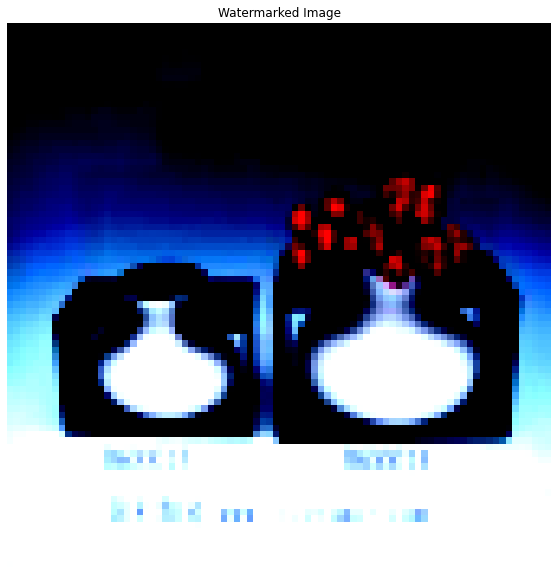

  9%|▉         | 1/11 [00:07<01:18,  7.86s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 13: Target opacity: 0, Labeled correctly: 0.6133333333333333, Correctly Predicted Target: True, Base class predicted: False


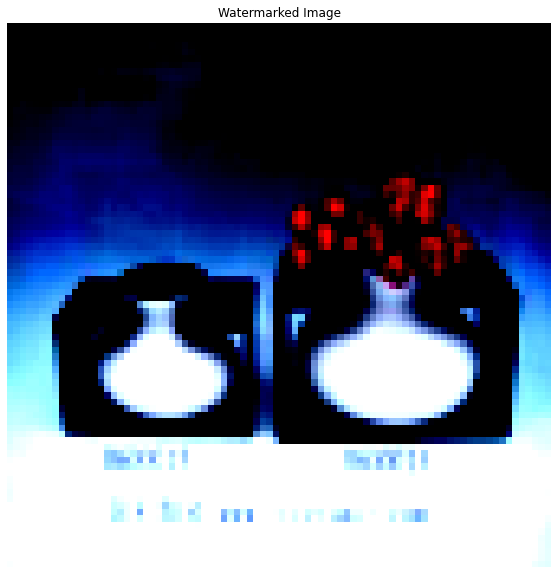

 18%|█▊        | 2/11 [00:15<01:11,  7.89s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 13: Target opacity: 0.05, Labeled correctly: 0.6133333333333333, Correctly Predicted Target: True, Base class predicted: False


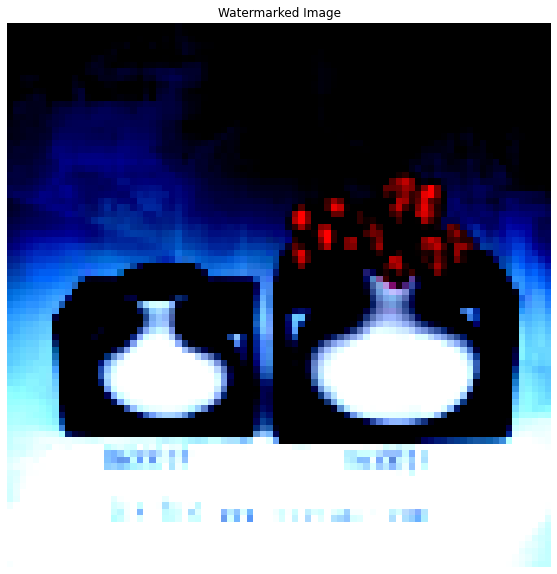

 27%|██▋       | 3/11 [00:23<01:03,  7.93s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 13: Target opacity: 0.1, Labeled correctly: 0.6, Correctly Predicted Target: True, Base class predicted: False


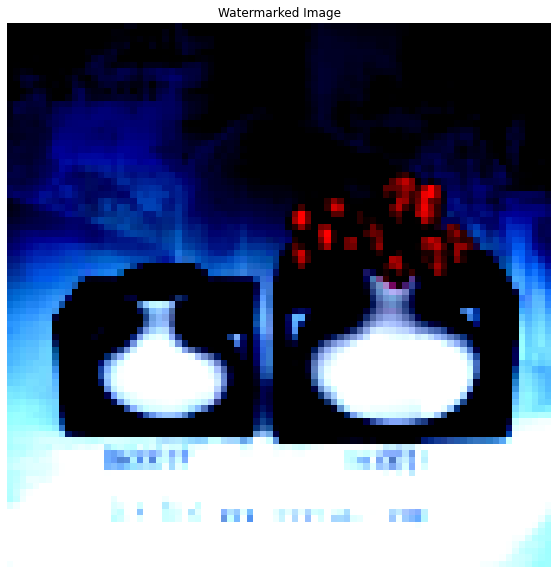

 36%|███▋      | 4/11 [00:31<00:55,  7.92s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 13: Target opacity: 0.15, Labeled correctly: 0.6, Correctly Predicted Target: True, Base class predicted: False


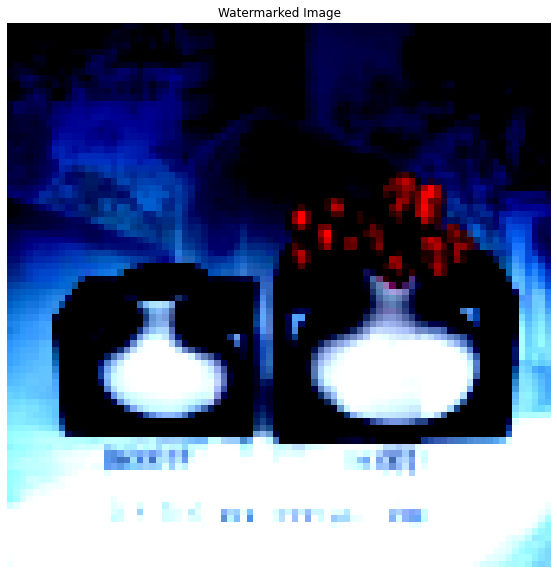

 45%|████▌     | 5/11 [00:39<00:47,  7.90s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 13: Target opacity: 0.2, Labeled correctly: 0.6, Correctly Predicted Target: True, Base class predicted: False


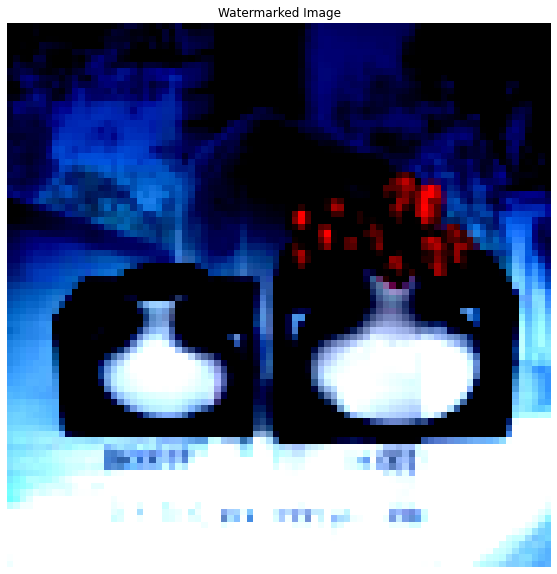

 55%|█████▍    | 6/11 [00:47<00:39,  7.90s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 13: Target opacity: 0.25, Labeled correctly: 0.6, Correctly Predicted Target: True, Base class predicted: False


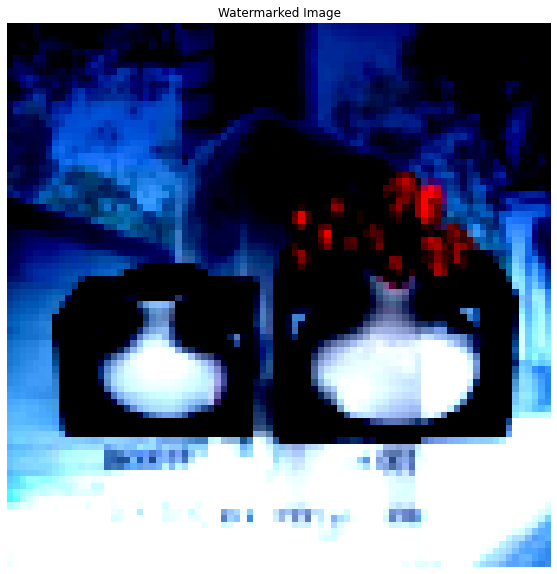

 64%|██████▎   | 7/11 [00:55<00:31,  7.94s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 13: Target opacity: 0.3, Labeled correctly: 0.6, Correctly Predicted Target: True, Base class predicted: False


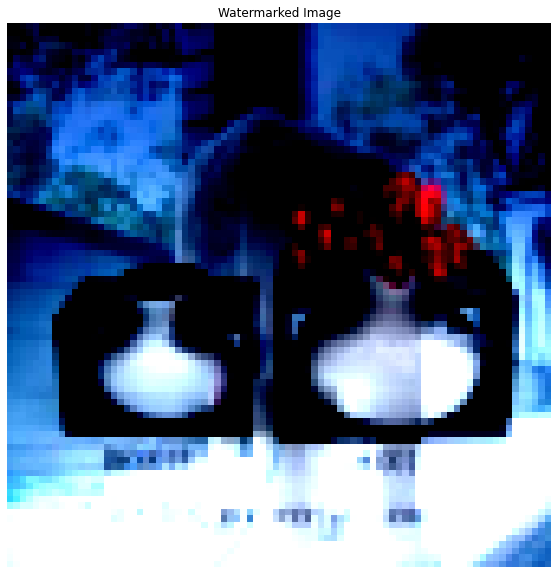

 73%|███████▎  | 8/11 [01:03<00:24,  8.00s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 13: Target opacity: 0.35, Labeled correctly: 0.6, Correctly Predicted Target: True, Base class predicted: False


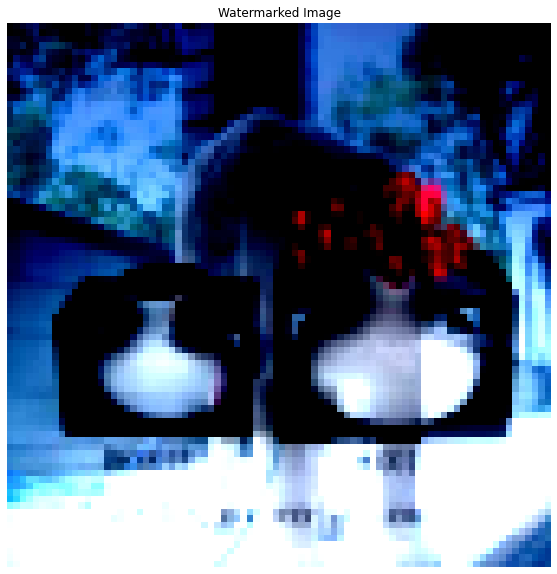

 82%|████████▏ | 9/11 [01:11<00:15,  7.99s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 13: Target opacity: 0.4, Labeled correctly: 0.6, Correctly Predicted Target: True, Base class predicted: False


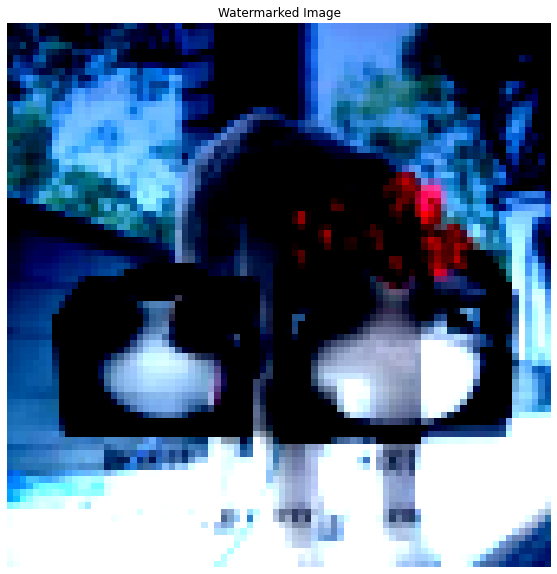

 91%|█████████ | 10/11 [01:19<00:08,  8.01s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 13: Target opacity: 0.45, Labeled correctly: 0.6, Correctly Predicted Target: True, Base class predicted: False


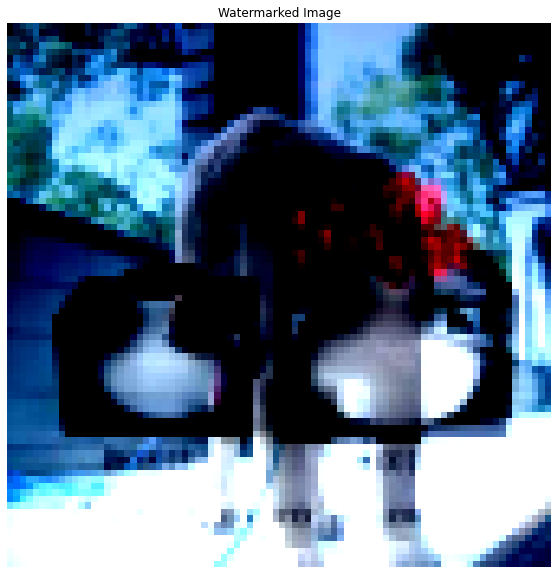

100%|██████████| 11/11 [01:27<00:00,  7.97s/it]

Iteration 13: Target opacity: 0.5, Labeled correctly: 0.6, Correctly Predicted Target: True, Base class predicted: False



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


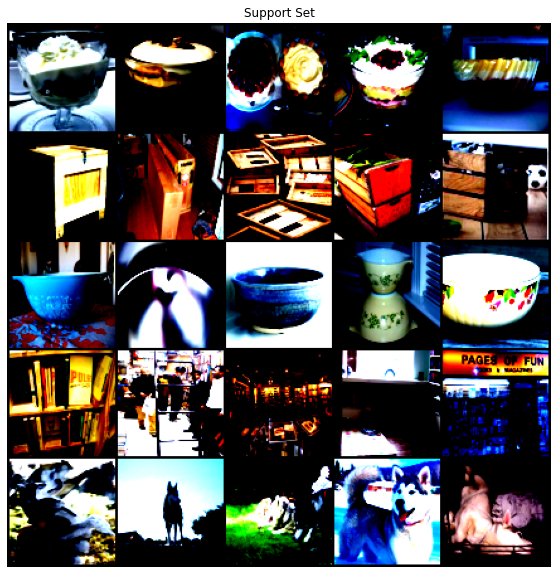

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 4, 4, 4, 4,
         4]])


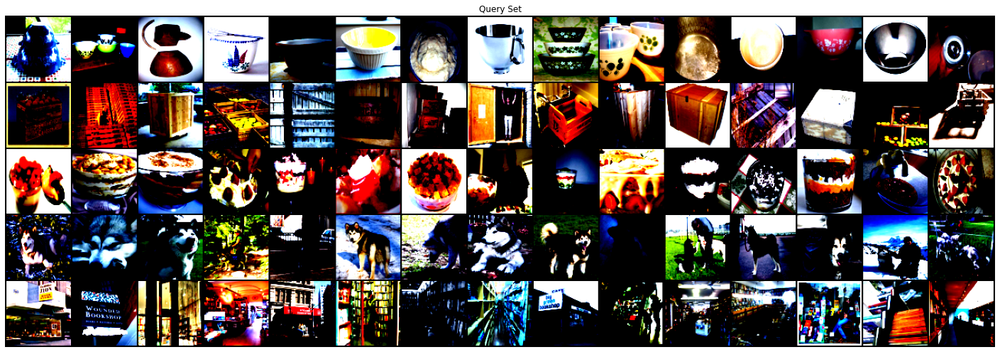

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2,
         2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 4, 4,
         4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
         3, 3, 3]])
target_class 1
unique_classes [0, 2, 3, 4]
base_class 3
target_indices [30 31 32 33 34 35 36 37 38 39 40 41 42 43 44]
target_index 41
base_indices [15 16 17 18 19]
base_index 15


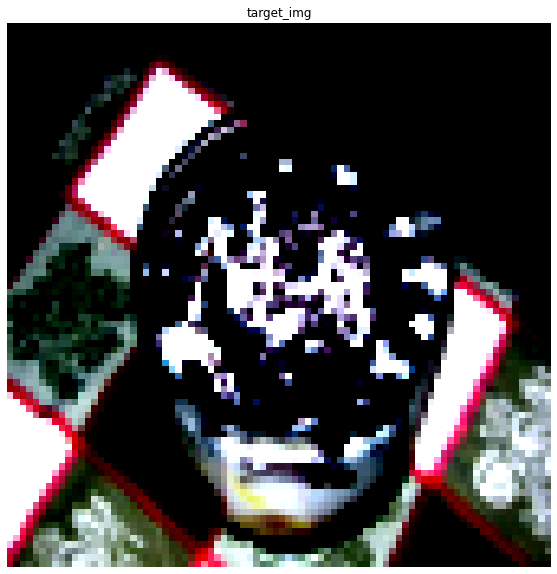

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


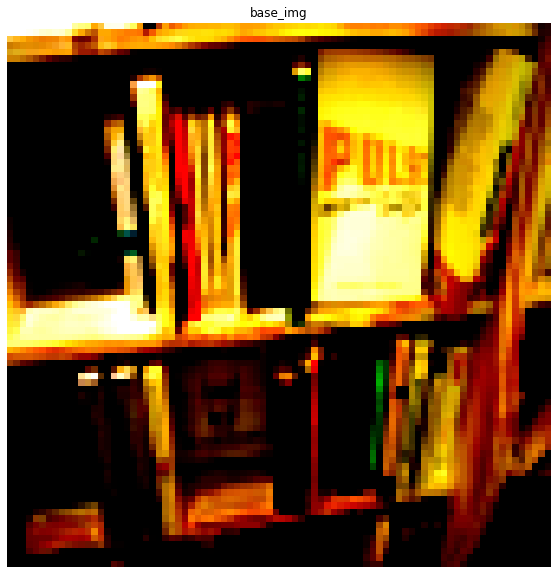

  0%|          | 3/1000 [00:00<00:34, 29.29it/s]

Iteration 0
loss: tensor(9.7362, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(22.3367, grad_fn=<PowBackward0>)
Iteration 2
loss: tensor(19.1052, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(10.8181, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(76.6312, grad_fn=<PowBackward0>)
Iteration 5


  1%|          | 9/1000 [00:00<00:40, 24.72it/s]

loss: tensor(9.8604, grad_fn=<PowBackward0>)
Iteration 6
loss: tensor(21.6561, grad_fn=<PowBackward0>)
Iteration 7
loss: tensor(8.2005, grad_fn=<PowBackward0>)
Iteration 8
loss: tensor(60.7849, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(6.1959, grad_fn=<PowBackward0>)
Iteration 10
loss:

  2%|▏         | 15/1000 [00:00<00:38, 25.54it/s]

 tensor(18.6080, grad_fn=<PowBackward0>)
Iteration 11
loss: tensor(12.0091, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(57.0925, grad_fn=<PowBackward0>)
Iteration 13
loss: tensor(6.0581, grad_fn=<PowBackward0>)
Iteration 14
loss: tensor(14.2043, grad_fn=<PowBackward0>)
Iteration 15
loss: tensor(7.6190, grad_fn=<PowBackward0>)


  2%|▏         | 21/1000 [00:00<00:39, 24.77it/s]

Iteration 16
loss: tensor(52.8376, grad_fn=<PowBackward0>)
Iteration 17
loss: tensor(4.4061, grad_fn=<PowBackward0>)
Iteration 18
loss: tensor(33.5358, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(18.3561, grad_fn=<PowBackward0>)
Iteration 20
loss: tensor(54.1629, grad_fn=<PowBackward0>)


  2%|▏         | 24/1000 [00:00<00:39, 24.63it/s]

Iteration 21
loss: tensor(15.6698, grad_fn=<PowBackward0>)
Iteration 22
loss: tensor(38.6667, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(7.5919, grad_fn=<PowBackward0>)
Iteration 24
loss: tensor(45.0634, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(16.7009, grad_fn=<PowBackward0>)
Iteration 26


  3%|▎         | 30/1000 [00:01<00:38, 25.40it/s]

loss: tensor(18.9591, grad_fn=<PowBackward0>)
Iteration 27
loss: tensor(0.3345, grad_fn=<PowBackward0>)
Iteration 28
loss: tensor(9.4957, grad_fn=<PowBackward0>)
Iteration 29
loss: tensor(31.8729, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(43.1563, grad_fn=<PowBackward0>)
Iteration 31
loss: tensor(4.6662, grad_fn=<PowBackward0>)


  4%|▎         | 36/1000 [00:01<00:37, 25.82it/s]

Iteration 32
loss: tensor(16.3055, grad_fn=<PowBackward0>)
Iteration 33
loss: tensor(1.8767, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(18.3788, grad_fn=<PowBackward0>)
Iteration 35
loss: tensor(18.1990, grad_fn=<PowBackward0>)
Iteration 36
loss: tensor(33.6592, grad_fn=<PowBackward0>)
Iteration 37


  4%|▍         | 42/1000 [00:01<00:35, 26.62it/s]

loss: tensor(11.9476, grad_fn=<PowBackward0>)
Iteration 38
loss: tensor(24.2007, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(7.5913, grad_fn=<PowBackward0>)
Iteration 40
loss: tensor(52.4565, grad_fn=<PowBackward0>)
Iteration 41
loss: tensor(1.3908, grad_fn=<PowBackward0>)
Iteration 42
loss: tensor(9.1596, grad_fn=<PowBackward0>)


  5%|▍         | 48/1000 [00:01<00:35, 26.71it/s]

Iteration 43
loss: tensor(14.0105, grad_fn=<PowBackward0>)
Iteration 44
loss: tensor(53.6795, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(1.4280, grad_fn=<PowBackward0>)
Iteration 46
loss: tensor(11.7947, grad_fn=<PowBackward0>)
Iteration 47
loss: tensor(6.2982, grad_fn=<PowBackward0>)
Iteration 48


  5%|▌         | 51/1000 [00:01<00:36, 26.18it/s]

loss: tensor(39.9637, grad_fn=<PowBackward0>)
Iteration 49
loss: tensor(15.5098, grad_fn=<PowBackward0>)
Iteration 50
loss: tensor(53.1957, grad_fn=<PowBackward0>)
Iteration 51
loss: tensor(15.8221, grad_fn=<PowBackward0>)
Iteration 52
loss: tensor(53.2477, grad_fn=<PowBackward0>)
Iteration 53
loss: tensor(5.0528, grad_fn=<PowBackward0>)


  6%|▌         | 57/1000 [00:02<00:37, 24.99it/s]

Iteration 54
loss: tensor(15.3484, grad_fn=<PowBackward0>)
Iteration 55
loss: tensor(5.5790, grad_fn=<PowBackward0>)
Iteration 56
loss: tensor(51.9247, grad_fn=<PowBackward0>)
Iteration 57
loss: tensor(15.2873, grad_fn=<PowBackward0>)
Iteration 58
loss: tensor(26.6923, grad_fn=<PowBackward0>)
Iteration 59


  6%|▋         | 63/1000 [00:02<00:36, 25.40it/s]

loss: tensor(10.1868, grad_fn=<PowBackward0>)
Iteration 60
loss: tensor(74.2069, grad_fn=<PowBackward0>)
Iteration 61
loss: tensor(6.3413, grad_fn=<PowBackward0>)
Iteration 62
loss: tensor(10.9228, grad_fn=<PowBackward0>)
Iteration 63
loss: tensor(6.2652, grad_fn=<PowBackward0>)
Iteration 64


  7%|▋         | 69/1000 [00:02<00:36, 25.44it/s]

loss: tensor(51.5417, grad_fn=<PowBackward0>)
Iteration 65
loss: tensor(5.9747, grad_fn=<PowBackward0>)
Iteration 66
loss: tensor(17.1055, grad_fn=<PowBackward0>)
Iteration 67
loss: tensor(7.9541, grad_fn=<PowBackward0>)
Iteration 68
loss: tensor(45.7894, grad_fn=<PowBackward0>)
Iteration 69
loss: tensor(4.2401, grad_fn=<PowBackward0>)


  7%|▋         | 72/1000 [00:02<00:36, 25.33it/s]

Iteration 70
loss: tensor(29.5441, grad_fn=<PowBackward0>)
Iteration 71
loss: tensor(28.6748, grad_fn=<PowBackward0>)
Iteration 72
loss: tensor(44.5561, grad_fn=<PowBackward0>)
Iteration 73
loss: tensor(0.0932, grad_fn=<PowBackward0>)
Iteration 74
loss: tensor(6.6003, grad_fn=<PowBackward0>)


  8%|▊         | 78/1000 [00:03<00:37, 24.88it/s]

Iteration 75
loss: tensor(15.1638, grad_fn=<PowBackward0>)
Iteration 76
loss: tensor(52.9917, grad_fn=<PowBackward0>)
Iteration 77
loss: tensor(11.2144, grad_fn=<PowBackward0>)
Iteration 78
loss: tensor(46.8576, grad_fn=<PowBackward0>)
Iteration 79
loss: tensor(0.2054, grad_fn=<PowBackward0>)
Iteration 80


  8%|▊         | 84/1000 [00:03<00:36, 24.80it/s]

loss: tensor(3.5713, grad_fn=<PowBackward0>)
Iteration 81
loss: tensor(15.0659, grad_fn=<PowBackward0>)
Iteration 82
loss: tensor(73.2012, grad_fn=<PowBackward0>)
Iteration 83
loss: tensor(13.2916, grad_fn=<PowBackward0>)
Iteration 84
loss: tensor(22.4395, grad_fn=<PowBackward0>)
Iteration 85


  9%|▉         | 90/1000 [00:03<00:36, 24.83it/s]

loss: tensor(3.3925, grad_fn=<PowBackward0>)
Iteration 86
loss: tensor(41.8103, grad_fn=<PowBackward0>)
Iteration 87
loss: tensor(15.6496, grad_fn=<PowBackward0>)
Iteration 88
loss: tensor(53.1618, grad_fn=<PowBackward0>)
Iteration 89
loss: tensor(1.0498, grad_fn=<PowBackward0>)
Iteration 90
loss: tensor(8.5842, grad_fn=<PowBackward0>)


 10%|▉         | 96/1000 [00:03<00:35, 25.32it/s]

Iteration 91
loss: tensor(14.0890, grad_fn=<PowBackward0>)
Iteration 92
loss: tensor(59.0130, grad_fn=<PowBackward0>)
Iteration 93
loss: tensor(5.7872, grad_fn=<PowBackward0>)
Iteration 94
loss: tensor(26.0343, grad_fn=<PowBackward0>)
Iteration 95
loss: tensor(12.7637, grad_fn=<PowBackward0>)
Iteration 96


 10%|▉         | 99/1000 [00:03<00:35, 25.13it/s]

loss: tensor(47.7331, grad_fn=<PowBackward0>)
Iteration 97
loss: tensor(13.8237, grad_fn=<PowBackward0>)
Iteration 98
loss: tensor(47.4432, grad_fn=<PowBackward0>)
Iteration 99
loss: tensor(0.6828, grad_fn=<PowBackward0>)
Iteration 100
loss: tensor(9.6514, grad_fn=<PowBackward0>)
Iteration 101
loss: tensor(16.0891, grad_fn=<PowBackward0>)


 10%|█         | 105/1000 [00:04<00:36, 24.71it/s]

Iteration 102
loss: tensor(46.3738, grad_fn=<PowBackward0>)
Iteration 103
loss: tensor(10.3815, grad_fn=<PowBackward0>)
Iteration 104
loss: tensor(25.3531, grad_fn=<PowBackward0>)
Iteration 105
loss: tensor(18.6846, grad_fn=<PowBackward0>)
Iteration 106
loss: tensor(21.3145, grad_fn=<PowBackward0>)
Iteration 107


 11%|█         | 111/1000 [00:04<00:35, 25.15it/s]

loss: tensor(11.2330, grad_fn=<PowBackward0>)
Iteration 108
loss: tensor(37.0372, grad_fn=<PowBackward0>)
Iteration 109
loss: tensor(2.5617, grad_fn=<PowBackward0>)
Iteration 110
loss: tensor(12.9403, grad_fn=<PowBackward0>)
Iteration 111
loss: tensor(9.6027, grad_fn=<PowBackward0>)
Iteration 112
loss: tensor(36.6459, grad_fn=<PowBackward0>)


 12%|█▏        | 117/1000 [00:04<00:33, 26.09it/s]

Iteration 113
loss: tensor(4.4171, grad_fn=<PowBackward0>)
Iteration 114
loss: tensor(14.7597, grad_fn=<PowBackward0>)
Iteration 115
loss: tensor(12.2495, grad_fn=<PowBackward0>)
Iteration 116
loss: tensor(55.4577, grad_fn=<PowBackward0>)
Iteration 117
loss: tensor(8.6012, grad_fn=<PowBackward0>)
Iteration 118
loss: tensor(16.6839, grad_fn=<PowBackward0>)


 12%|█▏        | 123/1000 [00:04<00:32, 26.80it/s]

Iteration 119
loss: tensor(8.5802, grad_fn=<PowBackward0>)
Iteration 120
loss: tensor(30.5469, grad_fn=<PowBackward0>)
Iteration 121
loss: tensor(7.5522, grad_fn=<PowBackward0>)
Iteration 122
loss: tensor(13.7274, grad_fn=<PowBackward0>)
Iteration 123
loss: tensor(4.4162, grad_fn=<PowBackward0>)
Iteration 124


 13%|█▎        | 129/1000 [00:05<00:31, 27.41it/s]

loss: tensor(19.7653, grad_fn=<PowBackward0>)
Iteration 125
loss: tensor(17.5154, grad_fn=<PowBackward0>)
Iteration 126
loss: tensor(29.4981, grad_fn=<PowBackward0>)
Iteration 127
loss: tensor(12.9600, grad_fn=<PowBackward0>)
Iteration 128
loss: tensor(27.1503, grad_fn=<PowBackward0>)
Iteration 129
loss: tensor(7.5116, grad_fn=<PowBackward0>)
Iteration 130


 14%|█▎        | 135/1000 [00:05<00:31, 27.32it/s]

loss: tensor(33.6207, grad_fn=<PowBackward0>)
Iteration 131
loss: tensor(15.6902, grad_fn=<PowBackward0>)
Iteration 132
loss: tensor(23.4316, grad_fn=<PowBackward0>)
Iteration 133
loss: tensor(6.5191, grad_fn=<PowBackward0>)
Iteration 134
loss: tensor(40.5259, grad_fn=<PowBackward0>)
Iteration 135
loss: tensor(9.8831, grad_fn=<PowBackward0>)


 14%|█▍        | 138/1000 [00:05<00:32, 26.48it/s]

Iteration 136
loss: tensor(21.7929, grad_fn=<PowBackward0>)
Iteration 137
loss: tensor(12.1286, grad_fn=<PowBackward0>)
Iteration 138
loss: tensor(45.7202, grad_fn=<PowBackward0>)
Iteration 139
loss: tensor(6.4443, grad_fn=<PowBackward0>)
Iteration 140
loss: tensor(12.5339, grad_fn=<PowBackward0>)


 14%|█▍        | 144/1000 [00:05<00:32, 26.11it/s]

Iteration 141
loss: tensor(10.4576, grad_fn=<PowBackward0>)
Iteration 142
loss: tensor(39.7455, grad_fn=<PowBackward0>)
Iteration 143
loss: tensor(5.3785, grad_fn=<PowBackward0>)
Iteration 144
loss: tensor(15.2457, grad_fn=<PowBackward0>)
Iteration 145
loss: tensor(7.3290, grad_fn=<PowBackward0>)
Iteration 146
loss: tensor(24.6329, grad_fn=<PowBackward0>)


 15%|█▌        | 150/1000 [00:05<00:32, 26.45it/s]

Iteration 147
loss: tensor(7.6803, grad_fn=<PowBackward0>)
Iteration 148
loss: tensor(26.0498, grad_fn=<PowBackward0>)
Iteration 149
loss: tensor(5.2023, grad_fn=<PowBackward0>)
Iteration 150
loss: tensor(15.1835, grad_fn=<PowBackward0>)
Iteration 151
loss: tensor(17.0874, grad_fn=<PowBackward0>)
Iteration 152


 16%|█▌        | 156/1000 [00:06<00:32, 25.78it/s]

loss: tensor(54.9196, grad_fn=<PowBackward0>)
Iteration 153
loss: tensor(9.9723, grad_fn=<PowBackward0>)
Iteration 154
loss: tensor(22.6865, grad_fn=<PowBackward0>)
Iteration 155
loss: tensor(9.0148, grad_fn=<PowBackward0>)
Iteration 156
loss: tensor(37.4045, grad_fn=<PowBackward0>)
Iteration 157
loss: tensor(3.8159, grad_fn=<PowBackward0>)


 16%|█▌        | 162/1000 [00:06<00:34, 24.19it/s]

Iteration 158
loss: tensor(11.5316, grad_fn=<PowBackward0>)
Iteration 159
loss: tensor(6.9165, grad_fn=<PowBackward0>)
Iteration 160
loss: tensor(27.1411, grad_fn=<PowBackward0>)
Iteration 161
loss: tensor(4.2512, grad_fn=<PowBackward0>)
Iteration 162
loss: tensor(17.3930, grad_fn=<PowBackward0>)


 17%|█▋        | 168/1000 [00:06<00:32, 25.36it/s]

Iteration 163
loss: tensor(2.0121, grad_fn=<PowBackward0>)
Iteration 164
loss: tensor(15.4832, grad_fn=<PowBackward0>)
Iteration 165
loss: tensor(13.1249, grad_fn=<PowBackward0>)
Iteration 166
loss: tensor(33.5765, grad_fn=<PowBackward0>)
Iteration 167
loss: tensor(10.6958, grad_fn=<PowBackward0>)
Iteration 168


 17%|█▋        | 171/1000 [00:06<00:32, 25.68it/s]

loss: tensor(26.8089, grad_fn=<PowBackward0>)
Iteration 169
loss: tensor(8.5633, grad_fn=<PowBackward0>)
Iteration 170
loss: tensor(27.2706, grad_fn=<PowBackward0>)
Iteration 171
loss: tensor(13.1831, grad_fn=<PowBackward0>)
Iteration 172
loss: tensor(24.0687, grad_fn=<PowBackward0>)
Iteration 173
loss: tensor(4.2262, grad_fn=<PowBackward0>)


 18%|█▊        | 177/1000 [00:06<00:32, 25.08it/s]

Iteration 174
loss: tensor(18.8408, grad_fn=<PowBackward0>)
Iteration 175
loss: tensor(14.7530, grad_fn=<PowBackward0>)
Iteration 176
loss: tensor(30.4124, grad_fn=<PowBackward0>)
Iteration 177
loss: tensor(7.3474, grad_fn=<PowBackward0>)
Iteration 178
loss: tensor(24.0377, grad_fn=<PowBackward0>)
Iteration 179


 18%|█▊        | 183/1000 [00:07<00:32, 25.25it/s]

loss: tensor(14.5257, grad_fn=<PowBackward0>)
Iteration 180
loss: tensor(12.0932, grad_fn=<PowBackward0>)
Iteration 181
loss: tensor(6.2882, grad_fn=<PowBackward0>)
Iteration 182
loss: tensor(21.2979, grad_fn=<PowBackward0>)
Iteration 183
loss: tensor(10.0002, grad_fn=<PowBackward0>)
Iteration 184
loss: tensor(24.4258, grad_fn=<PowBackward0>)


 19%|█▉        | 189/1000 [00:07<00:31, 26.07it/s]

Iteration 185
loss: tensor(9.0627, grad_fn=<PowBackward0>)
Iteration 186
loss: tensor(26.9024, grad_fn=<PowBackward0>)
Iteration 187
loss: tensor(5.8024, grad_fn=<PowBackward0>)
Iteration 188
loss: tensor(21.1461, grad_fn=<PowBackward0>)
Iteration 189
loss: tensor(11.3574, grad_fn=<PowBackward0>)
Iteration 190
loss: tensor(33.7755, grad_fn=<PowBackward0>)

 20%|█▉        | 195/1000 [00:07<00:30, 26.69it/s]


Iteration 191
loss: tensor(2.5487, grad_fn=<PowBackward0>)
Iteration 192
loss: tensor(13.6555, grad_fn=<PowBackward0>)
Iteration 193
loss: tensor(14.4131, grad_fn=<PowBackward0>)
Iteration 194
loss: tensor(37.0603, grad_fn=<PowBackward0>)
Iteration 195
loss: tensor(6.6738, grad_fn=<PowBackward0>)


 20%|██        | 201/1000 [00:07<00:30, 26.17it/s]

Iteration 196
loss: tensor(26.7820, grad_fn=<PowBackward0>)
Iteration 197
loss: tensor(11.0827, grad_fn=<PowBackward0>)
Iteration 198
loss: tensor(28.5258, grad_fn=<PowBackward0>)
Iteration 199
loss: tensor(9.2204, grad_fn=<PowBackward0>)
Iteration 200
loss: tensor(18.6013, grad_fn=<PowBackward0>)
Iteration 201


 20%|██        | 204/1000 [00:07<00:30, 26.13it/s]

loss: tensor(11.6483, grad_fn=<PowBackward0>)
Iteration 202
loss: tensor(19.0592, grad_fn=<PowBackward0>)
Iteration 203
loss: tensor(5.6639, grad_fn=<PowBackward0>)
Iteration 204
loss: tensor(8.2503, grad_fn=<PowBackward0>)
Iteration 205
loss: tensor(1.8545, grad_fn=<PowBackward0>)
Iteration 206
loss: tensor(7.1800, grad_fn=<PowBackward0>)


 21%|██        | 210/1000 [00:08<00:30, 26.02it/s]

Iteration 207
loss: tensor(9.7340, grad_fn=<PowBackward0>)
Iteration 208
loss: tensor(21.0079, grad_fn=<PowBackward0>)
Iteration 209
loss: tensor(8.1798, grad_fn=<PowBackward0>)
Iteration 210
loss: tensor(10.9646, grad_fn=<PowBackward0>)
Iteration 211
loss: tensor(8.8196, grad_fn=<PowBackward0>)
Iteration 212
loss: tensor(9.6452, grad_fn=<PowBackward0>)


 22%|██▏       | 216/1000 [00:08<00:29, 26.18it/s]

Iteration 213
loss: tensor(4.5404, grad_fn=<PowBackward0>)
Iteration 214
loss: tensor(13.8756, grad_fn=<PowBackward0>)
Iteration 215
loss: tensor(4.6397, grad_fn=<PowBackward0>)
Iteration 216
loss: tensor(6.0549, grad_fn=<PowBackward0>)
Iteration 217
loss: tensor(4.6090, grad_fn=<PowBackward0>)
Iteration 218


 22%|██▏       | 222/1000 [00:08<00:29, 26.14it/s]

loss: tensor(12.8331, grad_fn=<PowBackward0>)
Iteration 219
loss: tensor(9.8454, grad_fn=<PowBackward0>)
Iteration 220
loss: tensor(14.6469, grad_fn=<PowBackward0>)
Iteration 221
loss: tensor(1.9663, grad_fn=<PowBackward0>)
Iteration 222
loss: tensor(3.6597, grad_fn=<PowBackward0>)
Iteration 223
loss: tensor(1.6705, grad_fn=<PowBackward0>)


 23%|██▎       | 228/1000 [00:08<00:29, 26.12it/s]

Iteration 224
loss: tensor(11.0391, grad_fn=<PowBackward0>)
Iteration 225
loss: tensor(9.2339, grad_fn=<PowBackward0>)
Iteration 226
loss: tensor(10.2809, grad_fn=<PowBackward0>)
Iteration 227
loss: tensor(3.5256, grad_fn=<PowBackward0>)
Iteration 228
loss: tensor(13.5218, grad_fn=<PowBackward0>)
Iteration 229


 23%|██▎       | 234/1000 [00:09<00:28, 26.48it/s]

loss: tensor(4.8069, grad_fn=<PowBackward0>)
Iteration 230
loss: tensor(9.1850, grad_fn=<PowBackward0>)
Iteration 231
loss: tensor(2.7895, grad_fn=<PowBackward0>)
Iteration 232
loss: tensor(14.7743, grad_fn=<PowBackward0>)
Iteration 233
loss: tensor(4.1558, grad_fn=<PowBackward0>)
Iteration 234
loss: tensor(7.5637, grad_fn=<PowBackward0>)


 24%|██▍       | 240/1000 [00:09<00:28, 26.34it/s]

Iteration 235
loss: tensor(3.4560, grad_fn=<PowBackward0>)
Iteration 236
loss: tensor(15.6252, grad_fn=<PowBackward0>)
Iteration 237
loss: tensor(6.5994, grad_fn=<PowBackward0>)
Iteration 238
loss: tensor(9.6088, grad_fn=<PowBackward0>)
Iteration 239
loss: tensor(3.7770, grad_fn=<PowBackward0>)
Iteration 240
loss: tensor(9.2754, grad_fn=<PowBackward0>)


 24%|██▍       | 243/1000 [00:09<00:28, 26.26it/s]

Iteration 241
loss: tensor(3.5066, grad_fn=<PowBackward0>)
Iteration 242
loss: tensor(10.1351, grad_fn=<PowBackward0>)
Iteration 243
loss: tensor(3.7842, grad_fn=<PowBackward0>)
Iteration 244
loss: tensor(11.3586, grad_fn=<PowBackward0>)
Iteration 245
loss: 

 25%|██▍       | 249/1000 [00:09<00:29, 25.79it/s]

tensor(5.7473, grad_fn=<PowBackward0>)
Iteration 246
loss: tensor(11.6320, grad_fn=<PowBackward0>)
Iteration 247
loss: tensor(5.0222, grad_fn=<PowBackward0>)
Iteration 248
loss: tensor(12.4042, grad_fn=<PowBackward0>)
Iteration 249
loss: tensor(4.0094, grad_fn=<PowBackward0>)
Iteration 250
loss: tensor(8.8496, grad_fn=<PowBackward0>)
Iteration 251


 26%|██▌       | 255/1000 [00:09<00:29, 25.42it/s]

loss: tensor(5.2987, grad_fn=<PowBackward0>)
Iteration 252
loss: tensor(8.8948, grad_fn=<PowBackward0>)
Iteration 253
loss: tensor(4.7968, grad_fn=<PowBackward0>)
Iteration 254
loss: tensor(8.3890, grad_fn=<PowBackward0>)
Iteration 255
loss: tensor(5.8028, grad_fn=<PowBackward0>)
Iteration 256


 26%|██▌       | 261/1000 [00:10<00:29, 25.13it/s]

loss: tensor(12.0773, grad_fn=<PowBackward0>)
Iteration 257
loss: tensor(4.7300, grad_fn=<PowBackward0>)
Iteration 258
loss: tensor(6.4327, grad_fn=<PowBackward0>)
Iteration 259
loss: tensor(5.7268, grad_fn=<PowBackward0>)
Iteration 260
loss: tensor(10.7069, grad_fn=<PowBackward0>)
Iteration 261
loss: tensor(5.2614, grad_fn=<PowBackward0>)


 27%|██▋       | 267/1000 [00:10<00:28, 25.92it/s]

Iteration 262
loss: tensor(7.0685, grad_fn=<PowBackward0>)
Iteration 263
loss: tensor(5.5897, grad_fn=<PowBackward0>)
Iteration 264
loss: tensor(7.4040, grad_fn=<PowBackward0>)
Iteration 265
loss: tensor(5.9440, grad_fn=<PowBackward0>)
Iteration 266
loss: tensor(7.5758, grad_fn=<PowBackward0>)
Iteration 267
loss: tensor(7.2178, grad_fn=<PowBackward0>)


 27%|██▋       | 273/1000 [00:10<00:28, 25.66it/s]

Iteration 268
loss: tensor(14.4098, grad_fn=<PowBackward0>)
Iteration 269
loss: tensor(5.1984, grad_fn=<PowBackward0>)
Iteration 270
loss: tensor(7.6918, grad_fn=<PowBackward0>)
Iteration 271
loss: tensor(5.5461, grad_fn=<PowBackward0>)
Iteration 272
loss: tensor(11.2863, grad_fn=<PowBackward0>)


 28%|██▊       | 276/1000 [00:10<00:28, 25.53it/s]

Iteration 273
loss: tensor(6.1579, grad_fn=<PowBackward0>)
Iteration 274
loss: tensor(7.9576, grad_fn=<PowBackward0>)
Iteration 275
loss: tensor(4.0098, grad_fn=<PowBackward0>)
Iteration 276
loss: tensor(4.6535, grad_fn=<PowBackward0>)
Iteration 277
loss: tensor(2.7056, grad_fn=<PowBackward0>)
Iteration 278


 28%|██▊       | 282/1000 [00:11<00:27, 25.79it/s]

loss: tensor(13.4726, grad_fn=<PowBackward0>)
Iteration 279
loss: tensor(4.1029, grad_fn=<PowBackward0>)
Iteration 280
loss: tensor(6.7280, grad_fn=<PowBackward0>)
Iteration 281
loss: tensor(8.7419, grad_fn=<PowBackward0>)
Iteration 282
loss: tensor(17.9527, grad_fn=<PowBackward0>)
Iteration 283
loss: tensor(4.2159, grad_fn=<PowBackward0>)


 29%|██▉       | 288/1000 [00:11<00:27, 26.27it/s]

Iteration 284
loss: tensor(14.3598, grad_fn=<PowBackward0>)
Iteration 285
loss: tensor(5.1865, grad_fn=<PowBackward0>)
Iteration 286
loss: tensor(11.9342, grad_fn=<PowBackward0>)
Iteration 287
loss: tensor(7.7292, grad_fn=<PowBackward0>)
Iteration 288
loss: tensor(8.9579, grad_fn=<PowBackward0>)
Iteration 289


 29%|██▉       | 294/1000 [00:11<00:26, 26.57it/s]

loss: tensor(4.1544, grad_fn=<PowBackward0>)
Iteration 290
loss: tensor(10.7278, grad_fn=<PowBackward0>)
Iteration 291
loss: tensor(8.3765, grad_fn=<PowBackward0>)
Iteration 292
loss: tensor(10.9552, grad_fn=<PowBackward0>)
Iteration 293
loss: tensor(3.6998, grad_fn=<PowBackward0>)
Iteration 294
loss: tensor(8.1334, grad_fn=<PowBackward0>)


 30%|██▉       | 297/1000 [00:11<00:27, 25.48it/s]

Iteration 295
loss: tensor(6.0658, grad_fn=<PowBackward0>)
Iteration 296
loss: tensor(12.2867, grad_fn=<PowBackward0>)
Iteration 297
loss: tensor(5.6198, grad_fn=<PowBackward0>)
Iteration 298
loss: tensor(10.3537, grad_fn=<PowBackward0>)
Iteration 299
loss: tensor(10.2001, grad_fn=<PowBackward0>)


 30%|███       | 303/1000 [00:11<00:27, 25.50it/s]

Iteration 300
loss: tensor(16.4779, grad_fn=<PowBackward0>)
Iteration 301
loss: tensor(5.3566, grad_fn=<PowBackward0>)
Iteration 302
loss: tensor(0.4688, grad_fn=<PowBackward0>)
Iteration 303
loss: tensor(0.1657, grad_fn=<PowBackward0>)
Iteration 304
loss: tensor(0.0964, grad_fn=<PowBackward0>)
Iteration 305


 31%|███       | 309/1000 [00:12<00:28, 24.41it/s]

loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 306
loss: tensor(0.4624, grad_fn=<PowBackward0>)
Iteration 307
loss: tensor(0.4196, grad_fn=<PowBackward0>)
Iteration 308
loss: tensor(2.6992, grad_fn=<PowBackward0>)
Iteration 309
loss: tensor(2.7358, grad_fn=<PowBackward0>)
Iteration 310


 32%|███▏      | 315/1000 [00:12<00:26, 25.51it/s]

loss: tensor(3.0489, grad_fn=<PowBackward0>)
Iteration 311
loss: tensor(1.4124, grad_fn=<PowBackward0>)
Iteration 312
loss: tensor(4.5171, grad_fn=<PowBackward0>)
Iteration 313
loss: tensor(2.5097, grad_fn=<PowBackward0>)
Iteration 314
loss: tensor(3.8131, grad_fn=<PowBackward0>)
Iteration 315
loss: tensor(1.3076, grad_fn=<PowBackward0>)
Iteration

 32%|███▏      | 321/1000 [00:12<00:25, 26.21it/s]

 316
loss: tensor(2.0330, grad_fn=<PowBackward0>)
Iteration 317
loss: tensor(0.6872, grad_fn=<PowBackward0>)
Iteration 318
loss: tensor(2.0800, grad_fn=<PowBackward0>)
Iteration 319
loss: tensor(1.2538, grad_fn=<PowBackward0>)
Iteration 320
loss: tensor(2.5098, grad_fn=<PowBackward0>)
Iteration 321


 32%|███▏      | 324/1000 [00:12<00:26, 25.17it/s]

loss: tensor(1.4195, grad_fn=<PowBackward0>)
Iteration 322
loss: tensor(2.5189, grad_fn=<PowBackward0>)
Iteration 323
loss: tensor(1.0122, grad_fn=<PowBackward0>)
Iteration 324
loss: tensor(2.4167, grad_fn=<PowBackward0>)
Iteration 325
loss: tensor(1.6556, grad_fn=<PowBackward0>)
Iteration 326
loss: tensor(3.2956, grad_fn=<PowBackward0>)


 33%|███▎      | 330/1000 [00:12<00:26, 25.15it/s]

Iteration 327
loss: tensor(1.9479, grad_fn=<PowBackward0>)
Iteration 328
loss: tensor(2.6360, grad_fn=<PowBackward0>)
Iteration 329
loss: tensor(1.1424, grad_fn=<PowBackward0>)
Iteration 330
loss: tensor(2.3990, grad_fn=<PowBackward0>)
Iteration 331
loss: tensor(1.2132, grad_fn=<PowBackward0>)
Iteration 332


 34%|███▎      | 336/1000 [00:13<00:25, 26.19it/s]

loss: tensor(2.0277, grad_fn=<PowBackward0>)
Iteration 333
loss: tensor(0.6378, grad_fn=<PowBackward0>)
Iteration 334
loss: tensor(1.9243, grad_fn=<PowBackward0>)
Iteration 335
loss: tensor(1.3812, grad_fn=<PowBackward0>)
Iteration 336
loss: tensor(3.5073, grad_fn=<PowBackward0>)
Iteration 337
loss: tensor(1.6874, grad_fn=<PowBackward0>)


 34%|███▍      | 342/1000 [00:13<00:25, 26.19it/s]

Iteration 338
loss: tensor(2.7452, grad_fn=<PowBackward0>)
Iteration 339
loss: tensor(1.1309, grad_fn=<PowBackward0>)
Iteration 340
loss: tensor(2.1180, grad_fn=<PowBackward0>)
Iteration 341
loss: tensor(1.0577, grad_fn=<PowBackward0>)
Iteration 342
loss: tensor(2.8001, grad_fn=<PowBackward0>)
Iteration 343
loss: tensor(1.4717, grad_fn=<PowBackward0>)


 35%|███▍      | 348/1000 [00:13<00:25, 25.96it/s]

Iteration 344
loss: tensor(2.6935, grad_fn=<PowBackward0>)
Iteration 345
loss: tensor(0.8512, grad_fn=<PowBackward0>)
Iteration 346
loss: tensor(1.5412, grad_fn=<PowBackward0>)
Iteration 347
loss: tensor(0.8176, grad_fn=<PowBackward0>)
Iteration 348
loss: tensor(2.3497, grad_fn=<PowBackward0>)


 35%|███▌      | 354/1000 [00:13<00:25, 25.68it/s]

Iteration 349
loss: tensor(1.3961, grad_fn=<PowBackward0>)
Iteration 350
loss: tensor(3.5978, grad_fn=<PowBackward0>)
Iteration 351
loss: tensor(1.3382, grad_fn=<PowBackward0>)
Iteration 352
loss: tensor(2.5504, grad_fn=<PowBackward0>)
Iteration 353
loss: tensor(0.8666, grad_fn=<PowBackward0>)
Iteration 354
loss:

 36%|███▌      | 357/1000 [00:13<00:25, 25.57it/s]

 tensor(2.0909, grad_fn=<PowBackward0>)
Iteration 355
loss: tensor(1.2574, grad_fn=<PowBackward0>)
Iteration 356
loss: tensor(2.4793, grad_fn=<PowBackward0>)
Iteration 357
loss: tensor(1.2331, grad_fn=<PowBackward0>)
Iteration 358
loss: tensor(2.6030, grad_fn=<PowBackward0>)
Iteration 359
loss: tensor(1.1797, grad_fn=<PowBackward0>)


 36%|███▋      | 363/1000 [00:14<00:25, 25.18it/s]

Iteration 360
loss: tensor(2.6446, grad_fn=<PowBackward0>)
Iteration 361
loss: tensor(1.1765, grad_fn=<PowBackward0>)
Iteration 362
loss: tensor(2.0137, grad_fn=<PowBackward0>)
Iteration 363
loss: tensor(0.9071, grad_fn=<PowBackward0>)
Iteration 364
loss: tensor(2.6481, grad_fn=<PowBackward0>)
Iteration 365


 37%|███▋      | 369/1000 [00:14<00:24, 25.39it/s]

loss: tensor(1.0189, grad_fn=<PowBackward0>)
Iteration 366
loss: tensor(2.3659, grad_fn=<PowBackward0>)
Iteration 367
loss: tensor(1.2983, grad_fn=<PowBackward0>)
Iteration 368
loss: tensor(2.2731, grad_fn=<PowBackward0>)
Iteration 369
loss: tensor(1.4690, grad_fn=<PowBackward0>)
Iteration 370
loss: tensor(2.3915, grad_fn=<PowBackward0>)


 38%|███▊      | 375/1000 [00:14<00:25, 24.96it/s]

Iteration 371
loss: tensor(1.0757, grad_fn=<PowBackward0>)
Iteration 372
loss: tensor(3.1598, grad_fn=<PowBackward0>)
Iteration 373
loss: tensor(1.7862, grad_fn=<PowBackward0>)
Iteration 374
loss: tensor(3.1369, grad_fn=<PowBackward0>)
Iteration 375
loss: tensor(0.7451, grad_fn=<PowBackward0>)


 38%|███▊      | 381/1000 [00:14<00:23, 25.81it/s]

Iteration 376
loss: tensor(1.4185, grad_fn=<PowBackward0>)
Iteration 377
loss: tensor(0.3411, grad_fn=<PowBackward0>)
Iteration 378
loss: tensor(1.3302, grad_fn=<PowBackward0>)
Iteration 379
loss: tensor(0.6856, grad_fn=<PowBackward0>)
Iteration 380
loss: tensor(2.2697, grad_fn=<PowBackward0>)
Iteration 381
loss: tensor(1.6412, grad_fn=<PowBackward0>)


 39%|███▊      | 387/1000 [00:15<00:22, 26.96it/s]

Iteration 382
loss: tensor(3.8683, grad_fn=<PowBackward0>)
Iteration 383
loss: tensor(2.1381, grad_fn=<PowBackward0>)
Iteration 384
loss: tensor(3.3837, grad_fn=<PowBackward0>)
Iteration 385
loss: tensor(2.3224, grad_fn=<PowBackward0>)
Iteration 386
loss: tensor(3.7317, grad_fn=<PowBackward0>)
Iteration 387
loss: tensor(2.2856, grad_fn=<PowBackward0>)


 39%|███▉      | 393/1000 [00:15<00:22, 26.74it/s]

Iteration 388
loss: tensor(3.5851, grad_fn=<PowBackward0>)
Iteration 389
loss: tensor(2.1638, grad_fn=<PowBackward0>)
Iteration 390
loss: tensor(2.9661, grad_fn=<PowBackward0>)
Iteration 391
loss: tensor(1.4179, grad_fn=<PowBackward0>)
Iteration 392
loss: tensor(3.3324, grad_fn=<PowBackward0>)
Iteration 393
loss: tensor(2.7359, grad_fn=<PowBackward0>)

 40%|███▉      | 396/1000 [00:15<00:22, 26.71it/s]


Iteration 394
loss: tensor(3.8462, grad_fn=<PowBackward0>)
Iteration 395
loss: tensor(1.9251, grad_fn=<PowBackward0>)
Iteration 396
loss: tensor(3.0821, grad_fn=<PowBackward0>)
Iteration 397
loss: tensor(1.9179, grad_fn=<PowBackward0>)
Iteration 398
loss: tensor(3.3591, grad_fn=<PowBackward0>)


 40%|████      | 402/1000 [00:15<00:23, 25.96it/s]

Iteration 399
loss: tensor(1.6603, grad_fn=<PowBackward0>)
Iteration 400
loss: tensor(2.4953, grad_fn=<PowBackward0>)
Iteration 401
loss: tensor(1.5889, grad_fn=<PowBackward0>)
Iteration 402
loss: tensor(0.0586, grad_fn=<PowBackward0>)
Iteration 403
loss: tensor(0.0382, grad_fn=<PowBackward0>)
Iteration 404


 41%|████      | 408/1000 [00:15<00:23, 25.18it/s]

loss: tensor(0.0485, grad_fn=<PowBackward0>)
Iteration 405
loss: tensor(0.0444, grad_fn=<PowBackward0>)
Iteration 406
loss: tensor(0.0406, grad_fn=<PowBackward0>)
Iteration 407
loss: tensor(0.0359, grad_fn=<PowBackward0>)
Iteration 408
loss: tensor(0.0335, grad_fn=<PowBackward0>)
Iteration 409


 41%|████▏     | 414/1000 [00:16<00:23, 25.04it/s]

loss: tensor(0.0271, grad_fn=<PowBackward0>)
Iteration 410
loss: tensor(0.0303, grad_fn=<PowBackward0>)
Iteration 411
loss: tensor(0.0218, grad_fn=<PowBackward0>)
Iteration 412
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 413
loss: tensor(0.0179, grad_fn=<PowBackward0>)
Iteration 414


 42%|████▏     | 417/1000 [00:16<00:23, 24.70it/s]

loss: tensor(0.0439, grad_fn=<PowBackward0>)
Iteration 415
loss: tensor(0.0171, grad_fn=<PowBackward0>)
Iteration 416
loss: tensor(0.0620, grad_fn=<PowBackward0>)
Iteration 417
loss: tensor(0.0152, grad_fn=<PowBackward0>)
Iteration 418
loss: tensor(0.0644, grad_fn=<PowBackward0>)
Iteration 419


 42%|████▏     | 423/1000 [00:16<00:23, 24.59it/s]

loss: tensor(0.0202, grad_fn=<PowBackward0>)
Iteration 420
loss: tensor(0.0453, grad_fn=<PowBackward0>)
Iteration 421
loss: tensor(0.0445, grad_fn=<PowBackward0>)
Iteration 422
loss: tensor(0.0169, grad_fn=<PowBackward0>)
Iteration 423
loss: tensor(0.0688, grad_fn=<PowBackward0>)
Iteration 424
loss: tensor(0.0191, grad_fn=<PowBackward0>)


 43%|████▎     | 429/1000 [00:16<00:23, 24.42it/s]

Iteration 425
loss: tensor(0.0479, grad_fn=<PowBackward0>)
Iteration 426
loss: tensor(0.0393, grad_fn=<PowBackward0>)
Iteration 427
loss: tensor(0.0163, grad_fn=<PowBackward0>)
Iteration 428
loss: tensor(0.0726, grad_fn=<PowBackward0>)
Iteration 429
loss: tensor(0.0210, grad_fn=<PowBackward0>)


 44%|████▎     | 435/1000 [00:17<00:22, 24.69it/s]

Iteration 430
loss: tensor(0.0387, grad_fn=<PowBackward0>)
Iteration 431
loss: tensor(0.0345, grad_fn=<PowBackward0>)
Iteration 432
loss: tensor(0.0170, grad_fn=<PowBackward0>)
Iteration 433
loss: tensor(0.0805, grad_fn=<PowBackward0>)
Iteration 434
loss: tensor(0.0136, grad_fn=<PowBackward0>)
Iteration 435


 44%|████▍     | 438/1000 [00:17<00:22, 24.73it/s]

loss: tensor(0.0658, grad_fn=<PowBackward0>)
Iteration 436
loss: tensor(0.0223, grad_fn=<PowBackward0>)
Iteration 437
loss: tensor(0.0382, grad_fn=<PowBackward0>)
Iteration 438
loss: tensor(0.0200, grad_fn=<PowBackward0>)
Iteration 439
loss: tensor(0.0444, grad_fn=<PowBackward0>)
Iteration 440
loss: tensor(0.0220, grad_fn=<PowBackward0>)


 44%|████▍     | 444/1000 [00:17<00:22, 24.92it/s]

Iteration 441
loss: tensor(0.0329, grad_fn=<PowBackward0>)
Iteration 442
loss: tensor(0.0509, grad_fn=<PowBackward0>)
Iteration 443
loss: tensor(0.0180, grad_fn=<PowBackward0>)
Iteration 444
loss: tensor(0.0519, grad_fn=<PowBackward0>)
Iteration 445
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 446


 45%|████▌     | 450/1000 [00:17<00:21, 25.11it/s]

loss: tensor(0.0627, grad_fn=<PowBackward0>)
Iteration 447
loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 448
loss: tensor(0.0265, grad_fn=<PowBackward0>)
Iteration 449
loss: tensor(0.0407, grad_fn=<PowBackward0>)
Iteration 450
loss: tensor(0.0235, grad_fn=<PowBackward0>)
Iteration 451


 46%|████▌     | 456/1000 [00:17<00:21, 25.44it/s]

loss: tensor(0.0331, grad_fn=<PowBackward0>)
Iteration 452
loss: tensor(0.0370, grad_fn=<PowBackward0>)
Iteration 453
loss: tensor(0.0216, grad_fn=<PowBackward0>)
Iteration 454
loss: tensor(0.0349, grad_fn=<PowBackward0>)
Iteration 455
loss: tensor(0.0556, grad_fn=<PowBackward0>)
Iteration 456
loss: tensor(0.0166, grad_fn=<PowBackward0>)
Iteration 457
loss:

 46%|████▌     | 462/1000 [00:18<00:21, 25.19it/s]

 tensor(0.0395, grad_fn=<PowBackward0>)
Iteration 458
loss: tensor(0.0181, grad_fn=<PowBackward0>)
Iteration 459
loss: tensor(0.0467, grad_fn=<PowBackward0>)
Iteration 460
loss: tensor(0.0460, grad_fn=<PowBackward0>)
Iteration 461
loss: tensor(0.0140, grad_fn=<PowBackward0>)
Iteration 462


 46%|████▋     | 465/1000 [00:18<00:21, 25.03it/s]

loss: tensor(0.0676, grad_fn=<PowBackward0>)
Iteration 463
loss: tensor(0.0233, grad_fn=<PowBackward0>)
Iteration 464
loss: tensor(0.0254, grad_fn=<PowBackward0>)
Iteration 465
loss: tensor(0.0420, grad_fn=<PowBackward0>)
Iteration 466
loss: tensor(0.0259, grad_fn=<PowBackward0>)
Iteration 467
loss: tensor(0.0261, grad_fn=<PowBackward0>)


 47%|████▋     | 471/1000 [00:18<00:20, 26.27it/s]

Iteration 468
loss: tensor(0.0472, grad_fn=<PowBackward0>)
Iteration 469
loss: tensor(0.0261, grad_fn=<PowBackward0>)
Iteration 470
loss: tensor(0.0223, grad_fn=<PowBackward0>)
Iteration 471
loss: tensor(0.0481, grad_fn=<PowBackward0>)
Iteration 472
loss: tensor(0.0190, grad_fn=<PowBackward0>)
Iteration 473


 48%|████▊     | 477/1000 [00:18<00:19, 26.20it/s]

loss: tensor(0.0395, grad_fn=<PowBackward0>)
Iteration 474
loss: tensor(0.0361, grad_fn=<PowBackward0>)
Iteration 475
loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 476
loss: tensor(0.0679, grad_fn=<PowBackward0>)
Iteration 477
loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 478
loss: tensor(0.0571, grad_fn=<PowBackward0>)


 48%|████▊     | 483/1000 [00:18<00:20, 24.94it/s]

Iteration 479
loss: tensor(0.0212, grad_fn=<PowBackward0>)
Iteration 480
loss: tensor(0.0330, grad_fn=<PowBackward0>)
Iteration 481
loss: tensor(0.0445, grad_fn=<PowBackward0>)
Iteration 482
loss: tensor(0.0209, grad_fn=<PowBackward0>)
Iteration 483
loss: tensor(0.0334, grad_fn=<PowBackward0>)


 49%|████▉     | 489/1000 [00:19<00:20, 25.34it/s]

Iteration 484
loss: tensor(0.0368, grad_fn=<PowBackward0>)
Iteration 485
loss: tensor(0.0206, grad_fn=<PowBackward0>)
Iteration 486
loss: tensor(0.0496, grad_fn=<PowBackward0>)
Iteration 487
loss: tensor(0.0288, grad_fn=<PowBackward0>)
Iteration 488
loss: tensor(0.0204, grad_fn=<PowBackward0>)
Iteration 489


 49%|████▉     | 492/1000 [00:19<00:20, 25.17it/s]

loss: tensor(0.0895, grad_fn=<PowBackward0>)
Iteration 490
loss: tensor(0.0142, grad_fn=<PowBackward0>)
Iteration 491
loss: tensor(0.0621, grad_fn=<PowBackward0>)
Iteration 492
loss: tensor(0.0149, grad_fn=<PowBackward0>)
Iteration 493
loss: tensor(0.0867, grad_fn=<PowBackward0>)
Iteration 494
loss: tensor(0.0153, grad_fn=<PowBackward0>)


 50%|████▉     | 498/1000 [00:19<00:19, 26.35it/s]

Iteration 495
loss: tensor(0.0640, grad_fn=<PowBackward0>)
Iteration 496
loss: tensor(0.0161, grad_fn=<PowBackward0>)
Iteration 497
loss: tensor(0.1120, grad_fn=<PowBackward0>)
Iteration 498
loss: tensor(0.0138, grad_fn=<PowBackward0>)
Iteration 499
loss: tensor(0.0844, grad_fn=<PowBackward0>)
Iteration 500
loss: tensor(0.0204, grad_fn=<PowBackward0>)


 50%|█████     | 504/1000 [00:19<00:18, 26.63it/s]

Iteration 501
loss: tensor(0.0864, grad_fn=<PowBackward0>)
Iteration 502
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 503
loss: tensor(0.0342, grad_fn=<PowBackward0>)
Iteration 504
loss: tensor(0.0232, grad_fn=<PowBackward0>)
Iteration 505
loss: tensor(0.0309, grad_fn=<PowBackward0>)
Iteration 506
loss:

 51%|█████     | 510/1000 [00:19<00:18, 25.80it/s]

 tensor(0.0370, grad_fn=<PowBackward0>)
Iteration 507
loss: tensor(0.0259, grad_fn=<PowBackward0>)
Iteration 508
loss: tensor(0.0344, grad_fn=<PowBackward0>)
Iteration 509
loss: tensor(0.0289, grad_fn=<PowBackward0>)
Iteration 510
loss: tensor(0.0322, grad_fn=<PowBackward0>)
Iteration 511
loss: tensor(0.0310, grad_fn=<PowBackward0>)


 52%|█████▏    | 516/1000 [00:20<00:18, 25.55it/s]

Iteration 512
loss: tensor(0.0316, grad_fn=<PowBackward0>)
Iteration 513
loss: tensor(0.0296, grad_fn=<PowBackward0>)
Iteration 514
loss: tensor(0.0344, grad_fn=<PowBackward0>)
Iteration 515
loss: tensor(0.0300, grad_fn=<PowBackward0>)
Iteration 516
loss: tensor(0.0318, grad_fn=<PowBackward0>)
Iteration 517


 52%|█████▏    | 522/1000 [00:20<00:18, 26.41it/s]

loss: tensor(0.0298, grad_fn=<PowBackward0>)
Iteration 518
loss: tensor(0.0330, grad_fn=<PowBackward0>)
Iteration 519
loss: tensor(0.0299, grad_fn=<PowBackward0>)
Iteration 520
loss: tensor(0.0326, grad_fn=<PowBackward0>)
Iteration 521
loss: tensor(0.0300, grad_fn=<PowBackward0>)
Iteration 522
loss: tensor(0.0339, grad_fn=<PowBackward0>)
Iteration

 53%|█████▎    | 528/1000 [00:20<00:17, 27.18it/s]

 523
loss: tensor(0.0297, grad_fn=<PowBackward0>)
Iteration 524
loss: tensor(0.0315, grad_fn=<PowBackward0>)
Iteration 525
loss: tensor(0.0307, grad_fn=<PowBackward0>)
Iteration 526
loss: tensor(0.0338, grad_fn=<PowBackward0>)
Iteration 527
loss: tensor(0.0291, grad_fn=<PowBackward0>)
Iteration 528
loss: tensor(0.0331, grad_fn=<PowBackward0>)


 53%|█████▎    | 534/1000 [00:20<00:17, 26.50it/s]

Iteration 529
loss: tensor(0.0305, grad_fn=<PowBackward0>)
Iteration 530
loss: tensor(0.0328, grad_fn=<PowBackward0>)
Iteration 531
loss: tensor(0.0301, grad_fn=<PowBackward0>)
Iteration 532
loss: tensor(0.0327, grad_fn=<PowBackward0>)
Iteration 533
loss: tensor(0.0305, grad_fn=<PowBackward0>)
Iteration 534


 54%|█████▎    | 537/1000 [00:20<00:17, 26.44it/s]

loss: tensor(0.0335, grad_fn=<PowBackward0>)
Iteration 535
loss: tensor(0.0297, grad_fn=<PowBackward0>)
Iteration 536
loss: tensor(0.0333, grad_fn=<PowBackward0>)
Iteration 537
loss: tensor(0.0319, grad_fn=<PowBackward0>)
Iteration 538
loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 539
loss: tensor(0.0311, grad_fn=<PowBackward0>)


 54%|█████▍    | 543/1000 [00:21<00:17, 26.56it/s]

Iteration 540
loss: tensor(0.0336, grad_fn=<PowBackward0>)
Iteration 541
loss: tensor(0.0297, grad_fn=<PowBackward0>)
Iteration 542
loss: tensor(0.0330, grad_fn=<PowBackward0>)
Iteration 543
loss: tensor(0.0309, grad_fn=<PowBackward0>)
Iteration 544
loss: tensor(0.0322, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(0.0308, grad_fn=<PowBackward0>)


 55%|█████▍    | 549/1000 [00:21<00:16, 26.74it/s]

Iteration 546
loss: tensor(0.0334, grad_fn=<PowBackward0>)
Iteration 547
loss: tensor(0.0302, grad_fn=<PowBackward0>)
Iteration 548
loss: tensor(0.0329, grad_fn=<PowBackward0>)
Iteration 549
loss: tensor(0.0308, grad_fn=<PowBackward0>)
Iteration 550
loss: tensor(0.0337, grad_fn=<PowBackward0>)
Iteration 551


 56%|█████▌    | 555/1000 [00:21<00:16, 26.97it/s]

loss: tensor(0.0303, grad_fn=<PowBackward0>)
Iteration 552
loss: tensor(0.0329, grad_fn=<PowBackward0>)
Iteration 553
loss: tensor(0.0306, grad_fn=<PowBackward0>)
Iteration 554
loss: tensor(0.0327, grad_fn=<PowBackward0>)
Iteration 555
loss: tensor(0.0301, grad_fn=<PowBackward0>)
Iteration 556
loss: tensor(0.0335, grad_fn=<PowBackward0>)
Iteration

 56%|█████▌    | 561/1000 [00:21<00:17, 25.01it/s]

 557
loss: tensor(0.0343, grad_fn=<PowBackward0>)
Iteration 558
loss: tensor(0.0237, grad_fn=<PowBackward0>)
Iteration 559
loss: tensor(0.0466, grad_fn=<PowBackward0>)
Iteration 560
loss: tensor(0.0221, grad_fn=<PowBackward0>)
Iteration 561
loss: tensor(0.0338, grad_fn=<PowBackward0>)


 57%|█████▋    | 567/1000 [00:22<00:16, 25.83it/s]

Iteration 562
loss: tensor(0.0289, grad_fn=<PowBackward0>)
Iteration 563
loss: tensor(0.0333, grad_fn=<PowBackward0>)
Iteration 564
loss: tensor(0.0292, grad_fn=<PowBackward0>)
Iteration 565
loss: tensor(0.0335, grad_fn=<PowBackward0>)
Iteration 566
loss: tensor(0.0368, grad_fn=<PowBackward0>)
Iteration 567


 57%|█████▋    | 570/1000 [00:22<00:16, 25.43it/s]

loss: tensor(0.0275, grad_fn=<PowBackward0>)
Iteration 568
loss: tensor(0.0331, grad_fn=<PowBackward0>)
Iteration 569
loss: tensor(0.0348, grad_fn=<PowBackward0>)
Iteration 570
loss: tensor(0.0275, grad_fn=<PowBackward0>)
Iteration 571
loss: tensor(0.0353, grad_fn=<PowBackward0>)
Iteration 572
loss: tensor(0.0305, grad_fn=<PowBackward0>)


 58%|█████▊    | 576/1000 [00:22<00:16, 26.19it/s]

Iteration 573
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 574
loss: tensor(0.0316, grad_fn=<PowBackward0>)
Iteration 575
loss: tensor(0.0337, grad_fn=<PowBackward0>)
Iteration 576
loss: tensor(0.0296, grad_fn=<PowBackward0>)
Iteration 577
loss: tensor(0.0334, grad_fn=<PowBackward0>)
Iteration 578
loss:

 58%|█████▊    | 582/1000 [00:22<00:16, 25.94it/s]

 tensor(0.0309, grad_fn=<PowBackward0>)
Iteration 579
loss: tensor(0.0329, grad_fn=<PowBackward0>)
Iteration 580
loss: tensor(0.0307, grad_fn=<PowBackward0>)
Iteration 581
loss: tensor(0.0329, grad_fn=<PowBackward0>)
Iteration 582
loss: tensor(0.0309, grad_fn=<PowBackward0>)
Iteration 583
loss: tensor(0.0335, grad_fn=<PowBackward0>)


 59%|█████▉    | 588/1000 [00:22<00:16, 25.68it/s]

Iteration 584
loss: tensor(0.0303, grad_fn=<PowBackward0>)
Iteration 585
loss: tensor(0.0327, grad_fn=<PowBackward0>)
Iteration 586
loss: tensor(0.0320, grad_fn=<PowBackward0>)
Iteration 587
loss: tensor(0.0323, grad_fn=<PowBackward0>)
Iteration 588
loss: tensor(0.0338, grad_fn=<PowBackward0>)
Iteration 589


 59%|█████▉    | 594/1000 [00:23<00:15, 26.82it/s]

loss: tensor(0.0243, grad_fn=<PowBackward0>)
Iteration 590
loss: tensor(0.0459, grad_fn=<PowBackward0>)
Iteration 591
loss: tensor(0.0228, grad_fn=<PowBackward0>)
Iteration 592
loss: tensor(0.0324, grad_fn=<PowBackward0>)
Iteration 593
loss: tensor(0.0374, grad_fn=<PowBackward0>)
Iteration 594
loss: tensor(0.0289, grad_fn=<PowBackward0>)
Iteration 595


 60%|██████    | 600/1000 [00:23<00:14, 27.29it/s]

loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 596
loss: tensor(0.0355, grad_fn=<PowBackward0>)
Iteration 597
loss: tensor(0.0283, grad_fn=<PowBackward0>)
Iteration 598
loss: tensor(0.0335, grad_fn=<PowBackward0>)
Iteration 599
loss: tensor(0.0316, grad_fn=<PowBackward0>)
Iteration 600
loss: tensor(0.0319, grad_fn=<PowBackward0>)
Iteration 601


 61%|██████    | 606/1000 [00:23<00:14, 27.53it/s]

loss: tensor(0.0190, grad_fn=<PowBackward0>)
Iteration 602
loss: tensor(0.0236, grad_fn=<PowBackward0>)
Iteration 603
loss: tensor(0.0266, grad_fn=<PowBackward0>)
Iteration 604
loss: tensor(0.0309, grad_fn=<PowBackward0>)
Iteration 605
loss: tensor(0.0317, grad_fn=<PowBackward0>)
Iteration 606
loss: tensor(0.0305, grad_fn=<PowBackward0>)
Iteration

 61%|██████    | 612/1000 [00:23<00:14, 26.29it/s]

 607
loss: tensor(0.0320, grad_fn=<PowBackward0>)
Iteration 608
loss: tensor(0.0302, grad_fn=<PowBackward0>)
Iteration 609
loss: tensor(0.0327, grad_fn=<PowBackward0>)
Iteration 610
loss: tensor(0.0303, grad_fn=<PowBackward0>)
Iteration 611
loss: tensor(0.0320, grad_fn=<PowBackward0>)


 62%|██████▏   | 615/1000 [00:23<00:14, 25.73it/s]

Iteration 612
loss: tensor(0.0315, grad_fn=<PowBackward0>)
Iteration 613
loss: tensor(0.0320, grad_fn=<PowBackward0>)
Iteration 614
loss: tensor(0.0307, grad_fn=<PowBackward0>)
Iteration 615
loss: tensor(0.0324, grad_fn=<PowBackward0>)
Iteration 616
loss: tensor(0.0308, grad_fn=<PowBackward0>)
Iteration 617


 62%|██████▏   | 621/1000 [00:24<00:14, 25.75it/s]

loss: tensor(0.0323, grad_fn=<PowBackward0>)
Iteration 618
loss: tensor(0.0306, grad_fn=<PowBackward0>)
Iteration 619
loss: tensor(0.0326, grad_fn=<PowBackward0>)
Iteration 620
loss: tensor(0.0307, grad_fn=<PowBackward0>)
Iteration 621
loss: tensor(0.0327, grad_fn=<PowBackward0>)
Iteration 622


 63%|██████▎   | 627/1000 [00:24<00:14, 26.24it/s]

loss: tensor(0.0306, grad_fn=<PowBackward0>)
Iteration 623
loss: tensor(0.0327, grad_fn=<PowBackward0>)
Iteration 624
loss: tensor(0.0307, grad_fn=<PowBackward0>)
Iteration 625
loss: tensor(0.0324, grad_fn=<PowBackward0>)
Iteration 626
loss: tensor(0.0305, grad_fn=<PowBackward0>)
Iteration 627
loss: tensor(0.0330, grad_fn=<PowBackward0>)
Iteration 628


 63%|██████▎   | 633/1000 [00:24<00:13, 26.47it/s]

loss: tensor(0.0304, grad_fn=<PowBackward0>)
Iteration 629
loss: tensor(0.0328, grad_fn=<PowBackward0>)
Iteration 630
loss: tensor(0.0307, grad_fn=<PowBackward0>)
Iteration 631
loss: tensor(0.0328, grad_fn=<PowBackward0>)
Iteration 632
loss: tensor(0.0304, grad_fn=<PowBackward0>)
Iteration 633
loss: tensor(0.0325, grad_fn=<PowBackward0>)


 64%|██████▍   | 639/1000 [00:24<00:14, 25.48it/s]

Iteration 634
loss: tensor(0.0310, grad_fn=<PowBackward0>)
Iteration 635
loss: tensor(0.0330, grad_fn=<PowBackward0>)
Iteration 636
loss: tensor(0.0318, grad_fn=<PowBackward0>)
Iteration 637
loss: tensor(0.0324, grad_fn=<PowBackward0>)
Iteration 638
loss: tensor(0.0307, grad_fn=<PowBackward0>)


 64%|██████▍   | 642/1000 [00:25<00:14, 25.12it/s]

Iteration 639
loss: tensor(0.0325, grad_fn=<PowBackward0>)
Iteration 640
loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 641
loss: tensor(0.0326, grad_fn=<PowBackward0>)
Iteration 642
loss: tensor(0.0304, grad_fn=<PowBackward0>)
Iteration 643
loss: tensor(0.0332, grad_fn=<PowBackward0>)
Iteration 644
loss: tensor(0.0309, grad_fn=<PowBackward0>)


 65%|██████▍   | 648/1000 [00:25<00:13, 25.36it/s]

Iteration 645
loss: tensor(0.0329, grad_fn=<PowBackward0>)
Iteration 646
loss: tensor(0.0306, grad_fn=<PowBackward0>)
Iteration 647
loss: tensor(0.0334, grad_fn=<PowBackward0>)
Iteration 648
loss: tensor(0.0307, grad_fn=<PowBackward0>)
Iteration 649
loss: tensor(0.0326, grad_fn=<PowBackward0>)
Iteration 650


 65%|██████▌   | 654/1000 [00:25<00:13, 26.56it/s]

loss: tensor(0.0309, grad_fn=<PowBackward0>)
Iteration 651
loss: tensor(0.0328, grad_fn=<PowBackward0>)
Iteration 652
loss: tensor(0.0306, grad_fn=<PowBackward0>)
Iteration 653
loss: tensor(0.0333, grad_fn=<PowBackward0>)
Iteration 654
loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 655
loss: tensor(0.0326, grad_fn=<PowBackward0>)
Iteration

 66%|██████▌   | 660/1000 [00:25<00:12, 26.42it/s]

 656
loss: tensor(0.0307, grad_fn=<PowBackward0>)
Iteration 657
loss: tensor(0.0328, grad_fn=<PowBackward0>)
Iteration 658
loss: tensor(0.0309, grad_fn=<PowBackward0>)
Iteration 659
loss: tensor(0.0330, grad_fn=<PowBackward0>)
Iteration 660
loss: tensor(0.0288, grad_fn=<PowBackward0>)
Iteration 661
loss:

 66%|██████▋   | 663/1000 [00:25<00:12, 26.09it/s]

 tensor(0.0291, grad_fn=<PowBackward0>)
Iteration 662
loss: tensor(0.0386, grad_fn=<PowBackward0>)
Iteration 663
loss: tensor(0.0279, grad_fn=<PowBackward0>)
Iteration 664
loss: tensor(0.0335, grad_fn=<PowBackward0>)
Iteration 665
loss: tensor(0.0289, grad_fn=<PowBackward0>)


 67%|██████▋   | 669/1000 [00:26<00:13, 24.70it/s]

Iteration 666
loss: tensor(0.0336, grad_fn=<PowBackward0>)
Iteration 667
loss: tensor(0.0291, grad_fn=<PowBackward0>)
Iteration 668
loss: tensor(0.0333, grad_fn=<PowBackward0>)
Iteration 669
loss: tensor(0.0338, grad_fn=<PowBackward0>)
Iteration 670
loss: tensor(0.0320, grad_fn=<PowBackward0>)
Iteration 671
loss:

 68%|██████▊   | 675/1000 [00:26<00:12, 25.31it/s]

 tensor(0.0314, grad_fn=<PowBackward0>)
Iteration 672
loss: tensor(0.0324, grad_fn=<PowBackward0>)
Iteration 673
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 674
loss: tensor(0.0327, grad_fn=<PowBackward0>)
Iteration 675
loss: tensor(0.0307, grad_fn=<PowBackward0>)
Iteration 676


 68%|██████▊   | 678/1000 [00:26<00:13, 23.49it/s]

loss: tensor(0.0327, grad_fn=<PowBackward0>)
Iteration 677
loss: tensor(0.0312, grad_fn=<PowBackward0>)
Iteration 678
loss: tensor(0.0331, grad_fn=<PowBackward0>)
Iteration 679
loss: tensor(0.0309, grad_fn=<PowBackward0>)
Iteration 680
loss:

 68%|██████▊   | 684/1000 [00:26<00:13, 22.96it/s]

 tensor(0.0325, grad_fn=<PowBackward0>)
Iteration 681
loss: tensor(0.0316, grad_fn=<PowBackward0>)
Iteration 682
loss: tensor(0.0328, grad_fn=<PowBackward0>)
Iteration 683
loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 684
loss: tensor(0.0325, grad_fn=<PowBackward0>)
Iteration 685
loss: tensor(0.0309, grad_fn=<PowBackward0>)


 69%|██████▉   | 690/1000 [00:26<00:12, 23.86it/s]

Iteration 686
loss: tensor(0.0328, grad_fn=<PowBackward0>)
Iteration 687
loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 688
loss: tensor(0.0327, grad_fn=<PowBackward0>)
Iteration 689
loss: tensor(0.0308, grad_fn=<PowBackward0>)
Iteration 690
loss: tensor(0.0330, grad_fn=<PowBackward0>)
Iteration 691


 70%|██████▉   | 696/1000 [00:27<00:12, 24.72it/s]

loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 692
loss: tensor(0.0326, grad_fn=<PowBackward0>)
Iteration 693
loss: tensor(0.0307, grad_fn=<PowBackward0>)
Iteration 694
loss: tensor(0.0334, grad_fn=<PowBackward0>)
Iteration 695
loss: tensor(0.0306, grad_fn=<PowBackward0>)
Iteration 696
loss: tensor(0.0333, grad_fn=<PowBackward0>)


 70%|███████   | 702/1000 [00:27<00:11, 25.19it/s]

Iteration 697
loss: tensor(0.0306, grad_fn=<PowBackward0>)
Iteration 698
loss: tensor(0.0333, grad_fn=<PowBackward0>)
Iteration 699
loss: tensor(0.0305, grad_fn=<PowBackward0>)
Iteration 700
loss: tensor(0.0329, grad_fn=<PowBackward0>)
Iteration 701
loss: tensor(0.0234, grad_fn=<PowBackward0>)
Iteration 702


 70%|███████   | 705/1000 [00:27<00:11, 25.20it/s]

loss: tensor(0.0244, grad_fn=<PowBackward0>)
Iteration 703
loss: tensor(0.0274, grad_fn=<PowBackward0>)
Iteration 704
loss: tensor(0.0281, grad_fn=<PowBackward0>)
Iteration 705
loss: tensor(0.0276, grad_fn=<PowBackward0>)
Iteration 706
loss: tensor(0.0297, grad_fn=<PowBackward0>)
Iteration 707
loss: tensor(0.0293, grad_fn=<PowBackward0>)


 71%|███████   | 711/1000 [00:27<00:11, 25.82it/s]

Iteration 708
loss: tensor(0.0312, grad_fn=<PowBackward0>)
Iteration 709
loss: tensor(0.0300, grad_fn=<PowBackward0>)
Iteration 710
loss: tensor(0.0321, grad_fn=<PowBackward0>)
Iteration 711
loss: tensor(0.0303, grad_fn=<PowBackward0>)
Iteration 712
loss: tensor(0.0321, grad_fn=<PowBackward0>)
Iteration 713


 72%|███████▏  | 717/1000 [00:28<00:11, 24.10it/s]

loss: tensor(0.0309, grad_fn=<PowBackward0>)
Iteration 714
loss: tensor(0.0324, grad_fn=<PowBackward0>)
Iteration 715
loss: tensor(0.0308, grad_fn=<PowBackward0>)
Iteration 716
loss: tensor(0.0322, grad_fn=<PowBackward0>)
Iteration 717
loss: tensor(0.0309, grad_fn=<PowBackward0>)
Iteration 718


 72%|███████▏  | 723/1000 [00:28<00:11, 25.06it/s]

loss: tensor(0.0325, grad_fn=<PowBackward0>)
Iteration 719
loss: tensor(0.0306, grad_fn=<PowBackward0>)
Iteration 720
loss: tensor(0.0325, grad_fn=<PowBackward0>)
Iteration 721
loss: tensor(0.0307, grad_fn=<PowBackward0>)
Iteration 722
loss: tensor(0.0326, grad_fn=<PowBackward0>)
Iteration 723
loss: tensor(0.0306, grad_fn=<PowBackward0>)


 73%|███████▎  | 729/1000 [00:28<00:10, 25.32it/s]

Iteration 724
loss: tensor(0.0302, grad_fn=<PowBackward0>)
Iteration 725
loss: tensor(0.0321, grad_fn=<PowBackward0>)
Iteration 726
loss: tensor(0.0304, grad_fn=<PowBackward0>)
Iteration 727
loss: tensor(0.0322, grad_fn=<PowBackward0>)
Iteration 728
loss: tensor(0.0304, grad_fn=<PowBackward0>)
Iteration 729


 73%|███████▎  | 732/1000 [00:28<00:10, 24.95it/s]

loss: tensor(0.0324, grad_fn=<PowBackward0>)
Iteration 730
loss: tensor(0.0304, grad_fn=<PowBackward0>)
Iteration 731
loss: tensor(0.0322, grad_fn=<PowBackward0>)
Iteration 732
loss: tensor(0.0305, grad_fn=<PowBackward0>)
Iteration 733
loss: tensor(0.0326, grad_fn=<PowBackward0>)
Iteration 734
loss: tensor(0.0305, grad_fn=<PowBackward0>)


 74%|███████▍  | 738/1000 [00:28<00:10, 25.41it/s]

Iteration 735
loss: tensor(0.0328, grad_fn=<PowBackward0>)
Iteration 736
loss: tensor(0.0306, grad_fn=<PowBackward0>)
Iteration 737
loss: tensor(0.0325, grad_fn=<PowBackward0>)
Iteration 738
loss: tensor(0.0304, grad_fn=<PowBackward0>)
Iteration 739
loss: tensor(0.0326, grad_fn=<PowBackward0>)


 74%|███████▍  | 744/1000 [00:29<00:10, 24.65it/s]

Iteration 740
loss: tensor(0.0324, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(0.0322, grad_fn=<PowBackward0>)
Iteration 742
loss: tensor(0.0317, grad_fn=<PowBackward0>)
Iteration 743
loss: tensor(0.0322, grad_fn=<PowBackward0>)
Iteration 744
loss: tensor(0.0315, grad_fn=<PowBackward0>)
Iteration 745


 75%|███████▌  | 750/1000 [00:29<00:09, 26.10it/s]

loss: tensor(0.0324, grad_fn=<PowBackward0>)
Iteration 746
loss: tensor(0.0314, grad_fn=<PowBackward0>)
Iteration 747
loss: tensor(0.0325, grad_fn=<PowBackward0>)
Iteration 748
loss: tensor(0.0310, grad_fn=<PowBackward0>)
Iteration 749
loss: tensor(0.0324, grad_fn=<PowBackward0>)
Iteration 750
loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 751


 76%|███████▌  | 756/1000 [00:29<00:09, 25.80it/s]

loss: tensor(0.0326, grad_fn=<PowBackward0>)
Iteration 752
loss: tensor(0.0308, grad_fn=<PowBackward0>)
Iteration 753
loss: tensor(0.0326, grad_fn=<PowBackward0>)
Iteration 754
loss: tensor(0.0307, grad_fn=<PowBackward0>)
Iteration 755
loss: tensor(0.0327, grad_fn=<PowBackward0>)
Iteration 756
loss: tensor(0.0308, grad_fn=<PowBackward0>)


 76%|███████▌  | 762/1000 [00:29<00:09, 25.75it/s]

Iteration 757
loss: tensor(0.0327, grad_fn=<PowBackward0>)
Iteration 758
loss: tensor(0.0307, grad_fn=<PowBackward0>)
Iteration 759
loss: tensor(0.0326, grad_fn=<PowBackward0>)
Iteration 760
loss: tensor(0.0308, grad_fn=<PowBackward0>)
Iteration 761
loss: tensor(0.0327, grad_fn=<PowBackward0>)
Iteration 762


 76%|███████▋  | 765/1000 [00:29<00:09, 25.73it/s]

loss: tensor(0.0312, grad_fn=<PowBackward0>)
Iteration 763
loss: tensor(0.0326, grad_fn=<PowBackward0>)
Iteration 764
loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 765
loss: tensor(0.0329, grad_fn=<PowBackward0>)
Iteration 766
loss: tensor(0.0310, grad_fn=<PowBackward0>)
Iteration 767
loss: tensor(0.0327, grad_fn=<PowBackward0>)


 77%|███████▋  | 771/1000 [00:30<00:09, 25.34it/s]

Iteration 768
loss: tensor(0.0308, grad_fn=<PowBackward0>)
Iteration 769
loss: tensor(0.0302, grad_fn=<PowBackward0>)
Iteration 770
loss: tensor(0.0323, grad_fn=<PowBackward0>)
Iteration 771
loss: tensor(0.0303, grad_fn=<PowBackward0>)
Iteration 772
loss: tensor(0.0326, grad_fn=<PowBackward0>)
Iteration 773


 78%|███████▊  | 777/1000 [00:30<00:08, 25.46it/s]

loss: tensor(0.0305, grad_fn=<PowBackward0>)
Iteration 774
loss: tensor(0.0325, grad_fn=<PowBackward0>)
Iteration 775
loss: tensor(0.0304, grad_fn=<PowBackward0>)
Iteration 776
loss: tensor(0.0325, grad_fn=<PowBackward0>)
Iteration 777
loss: tensor(0.0307, grad_fn=<PowBackward0>)
Iteration 778
loss: tensor(0.0325, grad_fn=<PowBackward0>)


 78%|███████▊  | 783/1000 [00:30<00:08, 26.23it/s]

Iteration 779
loss: tensor(0.0307, grad_fn=<PowBackward0>)
Iteration 780
loss: tensor(0.0329, grad_fn=<PowBackward0>)
Iteration 781
loss: tensor(0.0306, grad_fn=<PowBackward0>)
Iteration 782
loss: tensor(0.0325, grad_fn=<PowBackward0>)
Iteration 783
loss: tensor(0.0306, grad_fn=<PowBackward0>)
Iteration 784


 79%|███████▉  | 789/1000 [00:30<00:07, 26.55it/s]

loss: tensor(0.0326, grad_fn=<PowBackward0>)
Iteration 785
loss: tensor(0.0327, grad_fn=<PowBackward0>)
Iteration 786
loss: tensor(0.0322, grad_fn=<PowBackward0>)
Iteration 787
loss: tensor(0.0319, grad_fn=<PowBackward0>)
Iteration 788
loss: tensor(0.0323, grad_fn=<PowBackward0>)
Iteration 789
loss: tensor(0.0316, grad_fn=<PowBackward0>)


 79%|███████▉  | 792/1000 [00:31<00:08, 24.23it/s]

Iteration 790
loss: tensor(0.0323, grad_fn=<PowBackward0>)
Iteration 791
loss: tensor(0.0314, grad_fn=<PowBackward0>)
Iteration 792
loss: tensor(0.0324, grad_fn=<PowBackward0>)
Iteration 793
loss: tensor(0.0312, grad_fn=<PowBackward0>)
Iteration 794


 80%|███████▉  | 798/1000 [00:31<00:08, 25.15it/s]

loss: tensor(0.0325, grad_fn=<PowBackward0>)
Iteration 795
loss: tensor(0.0310, grad_fn=<PowBackward0>)
Iteration 796
loss: tensor(0.0327, grad_fn=<PowBackward0>)
Iteration 797
loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 798
loss: tensor(0.0327, grad_fn=<PowBackward0>)
Iteration 799
loss: tensor(0.0309, grad_fn=<PowBackward0>)


 80%|████████  | 804/1000 [00:31<00:07, 25.91it/s]

Iteration 800
loss: tensor(0.0327, grad_fn=<PowBackward0>)
Iteration 801
loss: tensor(0.0267, grad_fn=<PowBackward0>)
Iteration 802
loss: tensor(0.0279, grad_fn=<PowBackward0>)
Iteration 803
loss: tensor(0.0278, grad_fn=<PowBackward0>)
Iteration 804
loss: tensor(0.0287, grad_fn=<PowBackward0>)
Iteration 805
loss: tensor(0.0287, grad_fn=<PowBackward0>)


 81%|████████  | 810/1000 [00:31<00:07, 26.20it/s]

Iteration 806
loss: tensor(0.0298, grad_fn=<PowBackward0>)
Iteration 807
loss: tensor(0.0294, grad_fn=<PowBackward0>)
Iteration 808
loss: tensor(0.0306, grad_fn=<PowBackward0>)
Iteration 809
loss: tensor(0.0300, grad_fn=<PowBackward0>)
Iteration 810
loss: tensor(0.0297, grad_fn=<PowBackward0>)
Iteration 811


 82%|████████▏ | 816/1000 [00:31<00:07, 25.05it/s]

loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 812
loss: tensor(0.0299, grad_fn=<PowBackward0>)
Iteration 813
loss: tensor(0.0314, grad_fn=<PowBackward0>)
Iteration 814
loss: tensor(0.0301, grad_fn=<PowBackward0>)
Iteration 815
loss: tensor(0.0317, grad_fn=<PowBackward0>)
Iteration 816


 82%|████████▏ | 819/1000 [00:32<00:07, 24.63it/s]

loss: tensor(0.0303, grad_fn=<PowBackward0>)
Iteration 817
loss: tensor(0.0319, grad_fn=<PowBackward0>)
Iteration 818
loss: tensor(0.0304, grad_fn=<PowBackward0>)
Iteration 819
loss: tensor(0.0320, grad_fn=<PowBackward0>)
Iteration 820
loss: tensor(0.0305, grad_fn=<PowBackward0>)
Iteration 821
loss: tensor(0.0321, grad_fn=<PowBackward0>)


 82%|████████▎ | 825/1000 [00:32<00:06, 25.84it/s]

Iteration 822
loss: tensor(0.0306, grad_fn=<PowBackward0>)
Iteration 823
loss: tensor(0.0321, grad_fn=<PowBackward0>)
Iteration 824
loss: tensor(0.0307, grad_fn=<PowBackward0>)
Iteration 825
loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 826
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 827
loss: tensor(0.0311, grad_fn=<PowBackward0>)


 83%|████████▎ | 831/1000 [00:32<00:06, 26.30it/s]

Iteration 828
loss: tensor(0.0316, grad_fn=<PowBackward0>)
Iteration 829
loss: tensor(0.0312, grad_fn=<PowBackward0>)
Iteration 830
loss: tensor(0.0317, grad_fn=<PowBackward0>)
Iteration 831
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(0.0319, grad_fn=<PowBackward0>)
Iteration 833
loss: tensor(0.0313, grad_fn=<PowBackward0>)


 84%|████████▎ | 837/1000 [00:32<00:06, 26.75it/s]

Iteration 834
loss: tensor(0.0319, grad_fn=<PowBackward0>)
Iteration 835
loss: tensor(0.0312, grad_fn=<PowBackward0>)
Iteration 836
loss: tensor(0.0320, grad_fn=<PowBackward0>)
Iteration 837
loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 838
loss: tensor(0.0321, grad_fn=<PowBackward0>)
Iteration 839
loss: tensor(0.0312, grad_fn=<PowBackward0>)


 84%|████████▍ | 843/1000 [00:32<00:05, 26.81it/s]

Iteration 840
loss: tensor(0.0322, grad_fn=<PowBackward0>)
Iteration 841
loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 842
loss: tensor(0.0322, grad_fn=<PowBackward0>)
Iteration 843
loss: tensor(0.0310, grad_fn=<PowBackward0>)
Iteration 844
loss: tensor(0.0324, grad_fn=<PowBackward0>)
Iteration 845


 85%|████████▍ | 849/1000 [00:33<00:05, 25.70it/s]

loss: tensor(0.0310, grad_fn=<PowBackward0>)
Iteration 846
loss: tensor(0.0330, grad_fn=<PowBackward0>)
Iteration 847
loss: tensor(0.0309, grad_fn=<PowBackward0>)
Iteration 848
loss: tensor(0.0329, grad_fn=<PowBackward0>)
Iteration 849
loss: tensor(0.0309, grad_fn=<PowBackward0>)
Iteration 850
loss: tensor(0.0317, grad_fn=<PowBackward0>)


 86%|████████▌ | 855/1000 [00:33<00:05, 26.60it/s]

Iteration 851
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 852
loss: tensor(0.0316, grad_fn=<PowBackward0>)
Iteration 853
loss: tensor(0.0316, grad_fn=<PowBackward0>)
Iteration 854
loss: tensor(0.0315, grad_fn=<PowBackward0>)
Iteration 855
loss: tensor(0.0317, grad_fn=<PowBackward0>)
Iteration 856
loss: 

 86%|████████▌ | 861/1000 [00:33<00:05, 26.98it/s]

tensor(0.0314, grad_fn=<PowBackward0>)
Iteration 857
loss: tensor(0.0318, grad_fn=<PowBackward0>)
Iteration 858
loss: tensor(0.0316, grad_fn=<PowBackward0>)
Iteration 859
loss: tensor(0.0319, grad_fn=<PowBackward0>)
Iteration 860
loss: tensor(0.0316, grad_fn=<PowBackward0>)
Iteration 861
loss: tensor(0.0319, grad_fn=<PowBackward0>)
Iteration 862


 87%|████████▋ | 867/1000 [00:33<00:04, 26.80it/s]

loss: tensor(0.0314, grad_fn=<PowBackward0>)
Iteration 863
loss: tensor(0.0321, grad_fn=<PowBackward0>)
Iteration 864
loss: tensor(0.0314, grad_fn=<PowBackward0>)
Iteration 865
loss: tensor(0.0321, grad_fn=<PowBackward0>)
Iteration 866
loss: tensor(0.0312, grad_fn=<PowBackward0>)
Iteration 867
loss: tensor(0.0323, grad_fn=<PowBackward0>)


 87%|████████▋ | 873/1000 [00:34<00:04, 26.04it/s]

Iteration 868
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 869
loss: tensor(0.0323, grad_fn=<PowBackward0>)
Iteration 870
loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 871
loss: tensor(0.0323, grad_fn=<PowBackward0>)
Iteration 872
loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 873


 88%|████████▊ | 879/1000 [00:34<00:04, 27.07it/s]

loss: tensor(0.0310, grad_fn=<PowBackward0>)
Iteration 874
loss: tensor(0.0316, grad_fn=<PowBackward0>)
Iteration 875
loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 876
loss: tensor(0.0318, grad_fn=<PowBackward0>)
Iteration 877
loss: tensor(0.0322, grad_fn=<PowBackward0>)
Iteration 878
loss: tensor(0.0319, grad_fn=<PowBackward0>)
Iteration 879


 88%|████████▊ | 885/1000 [00:34<00:04, 27.42it/s]

loss: tensor(0.0318, grad_fn=<PowBackward0>)
Iteration 880
loss: tensor(0.0319, grad_fn=<PowBackward0>)
Iteration 881
loss: tensor(0.0318, grad_fn=<PowBackward0>)
Iteration 882
loss: tensor(0.0320, grad_fn=<PowBackward0>)
Iteration 883
loss: tensor(0.0316, grad_fn=<PowBackward0>)
Iteration 884
loss: tensor(0.0320, grad_fn=<PowBackward0>)
Iteration 885


 89%|████████▉ | 888/1000 [00:34<00:04, 27.13it/s]

loss: tensor(0.0318, grad_fn=<PowBackward0>)
Iteration 886
loss: tensor(0.0321, grad_fn=<PowBackward0>)
Iteration 887
loss: tensor(0.0316, grad_fn=<PowBackward0>)
Iteration 888
loss: tensor(0.0321, grad_fn=<PowBackward0>)
Iteration 889
loss: tensor(0.0315, grad_fn=<PowBackward0>)
Iteration 890
loss: tensor(0.0321, grad_fn=<PowBackward0>)


 89%|████████▉ | 894/1000 [00:34<00:03, 26.56it/s]

Iteration 891
loss: tensor(0.0314, grad_fn=<PowBackward0>)
Iteration 892
loss: tensor(0.0323, grad_fn=<PowBackward0>)
Iteration 893
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 894
loss: tensor(0.0310, grad_fn=<PowBackward0>)
Iteration 895
loss: tensor(0.0319, grad_fn=<PowBackward0>)
Iteration 896
loss:

 90%|█████████ | 900/1000 [00:35<00:03, 25.70it/s]

 tensor(0.0310, grad_fn=<PowBackward0>)
Iteration 897
loss: tensor(0.0319, grad_fn=<PowBackward0>)
Iteration 898
loss: tensor(0.0310, grad_fn=<PowBackward0>)
Iteration 899
loss: tensor(0.0319, grad_fn=<PowBackward0>)
Iteration 900
loss: tensor(0.0310, grad_fn=<PowBackward0>)
Iteration 901


 91%|█████████ | 906/1000 [00:35<00:03, 26.07it/s]

loss: tensor(0.0295, grad_fn=<PowBackward0>)
Iteration 902
loss: tensor(0.0296, grad_fn=<PowBackward0>)
Iteration 903
loss: tensor(0.0299, grad_fn=<PowBackward0>)
Iteration 904
loss: tensor(0.0299, grad_fn=<PowBackward0>)
Iteration 905
loss: tensor(0.0303, grad_fn=<PowBackward0>)
Iteration 906
loss: tensor(0.0301, grad_fn=<PowBackward0>)


 91%|█████████ | 912/1000 [00:35<00:03, 26.01it/s]

Iteration 907
loss: tensor(0.0306, grad_fn=<PowBackward0>)
Iteration 908
loss: tensor(0.0303, grad_fn=<PowBackward0>)
Iteration 909
loss: tensor(0.0308, grad_fn=<PowBackward0>)
Iteration 910
loss: tensor(0.0306, grad_fn=<PowBackward0>)
Iteration 911
loss: tensor(0.0303, grad_fn=<PowBackward0>)
Iteration 912


 92%|█████████▏| 915/1000 [00:35<00:03, 26.28it/s]

loss: tensor(0.0309, grad_fn=<PowBackward0>)
Iteration 913
loss: tensor(0.0304, grad_fn=<PowBackward0>)
Iteration 914
loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 915
loss: tensor(0.0305, grad_fn=<PowBackward0>)
Iteration 916
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 917
loss: tensor(0.0306, grad_fn=<PowBackward0>)


 92%|█████████▏| 921/1000 [00:35<00:03, 25.26it/s]

Iteration 918
loss: tensor(0.0314, grad_fn=<PowBackward0>)
Iteration 919
loss: tensor(0.0306, grad_fn=<PowBackward0>)
Iteration 920
loss: tensor(0.0315, grad_fn=<PowBackward0>)
Iteration 921
loss: tensor(0.0307, grad_fn=<PowBackward0>)
Iteration 922
loss: tensor(0.0316, grad_fn=<PowBackward0>)
Iteration 923


 93%|█████████▎| 927/1000 [00:36<00:02, 25.17it/s]

loss: tensor(0.0308, grad_fn=<PowBackward0>)
Iteration 924
loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 925
loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 926
loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 927
loss: tensor(0.0312, grad_fn=<PowBackward0>)
Iteration 928
loss: tensor(0.0311, grad_fn=<PowBackward0>)


 93%|█████████▎| 933/1000 [00:36<00:02, 25.33it/s]

Iteration 929
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 930
loss: tensor(0.0312, grad_fn=<PowBackward0>)
Iteration 931
loss: tensor(0.0315, grad_fn=<PowBackward0>)
Iteration 932
loss: tensor(0.0312, grad_fn=<PowBackward0>)
Iteration 933
loss: tensor(0.0316, grad_fn=<PowBackward0>)
Iteration 934


 94%|█████████▍| 939/1000 [00:36<00:02, 25.30it/s]

loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 935
loss: tensor(0.0317, grad_fn=<PowBackward0>)
Iteration 936
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 937
loss: tensor(0.0317, grad_fn=<PowBackward0>)
Iteration 938
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 939
loss: tensor(0.0318, grad_fn=<PowBackward0>)


 94%|█████████▍| 945/1000 [00:36<00:02, 25.43it/s]

Iteration 940
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 941
loss: tensor(0.0312, grad_fn=<PowBackward0>)
Iteration 942
loss: tensor(0.0315, grad_fn=<PowBackward0>)
Iteration 943
loss: tensor(0.0312, grad_fn=<PowBackward0>)
Iteration 944
loss: tensor(0.0316, grad_fn=<PowBackward0>)
Iteration 945


 95%|█████████▍| 948/1000 [00:37<00:02, 25.52it/s]

loss: tensor(0.0312, grad_fn=<PowBackward0>)
Iteration 946
loss: tensor(0.0316, grad_fn=<PowBackward0>)
Iteration 947
loss: tensor(0.0312, grad_fn=<PowBackward0>)
Iteration 948
loss: tensor(0.0317, grad_fn=<PowBackward0>)
Iteration 949
loss: tensor(0.0318, grad_fn=<PowBackward0>)
Iteration 950
loss: tensor(0.0317, grad_fn=<PowBackward0>)


 95%|█████████▌| 954/1000 [00:37<00:01, 25.39it/s]

Iteration 951
loss: tensor(0.0317, grad_fn=<PowBackward0>)
Iteration 952
loss: tensor(0.0318, grad_fn=<PowBackward0>)
Iteration 953
loss: tensor(0.0316, grad_fn=<PowBackward0>)
Iteration 954
loss: tensor(0.0318, grad_fn=<PowBackward0>)
Iteration 955
loss: tensor(0.0316, grad_fn=<PowBackward0>)
Iteration 956


 96%|█████████▌| 960/1000 [00:37<00:01, 25.55it/s]

loss: tensor(0.0319, grad_fn=<PowBackward0>)
Iteration 957
loss: tensor(0.0315, grad_fn=<PowBackward0>)
Iteration 958
loss: tensor(0.0319, grad_fn=<PowBackward0>)
Iteration 959
loss: tensor(0.0315, grad_fn=<PowBackward0>)
Iteration 960
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 961
loss: tensor(0.0318, grad_fn=<PowBackward0>)


 97%|█████████▋| 966/1000 [00:37<00:01, 26.13it/s]

Iteration 962
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 963
loss: tensor(0.0318, grad_fn=<PowBackward0>)
Iteration 964
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 965
loss: tensor(0.0318, grad_fn=<PowBackward0>)
Iteration 966
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 967


 97%|█████████▋| 972/1000 [00:37<00:01, 26.59it/s]

loss: tensor(0.0319, grad_fn=<PowBackward0>)
Iteration 968
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 969
loss: tensor(0.0319, grad_fn=<PowBackward0>)
Iteration 970
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 971
loss: tensor(0.0319, grad_fn=<PowBackward0>)
Iteration 972
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration

 98%|█████████▊| 978/1000 [00:38<00:00, 26.08it/s]

 973
loss: tensor(0.0319, grad_fn=<PowBackward0>)
Iteration 974
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 975
loss: tensor(0.0319, grad_fn=<PowBackward0>)
Iteration 976
loss: tensor(0.0318, grad_fn=<PowBackward0>)
Iteration 977
loss: tensor(0.0319, grad_fn=<PowBackward0>)


 98%|█████████▊| 981/1000 [00:38<00:00, 25.49it/s]

Iteration 978
loss: tensor(0.0317, grad_fn=<PowBackward0>)
Iteration 979
loss: tensor(0.0320, grad_fn=<PowBackward0>)
Iteration 980
loss: tensor(0.0316, grad_fn=<PowBackward0>)
Iteration 981
loss: tensor(0.0320, grad_fn=<PowBackward0>)
Iteration 982
loss: tensor(0.0316, grad_fn=<PowBackward0>)
Iteration 983
loss: tensor(0.0314, grad_fn=<PowBackward0>)


 99%|█████████▊| 987/1000 [00:38<00:00, 26.53it/s]

Iteration 984
loss: tensor(0.0318, grad_fn=<PowBackward0>)
Iteration 985
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 986
loss: tensor(0.0318, grad_fn=<PowBackward0>)
Iteration 987
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 988
loss: tensor(0.0320, grad_fn=<PowBackward0>)
Iteration 989


 99%|█████████▉| 993/1000 [00:38<00:00, 26.20it/s]

loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 990
loss: tensor(0.0320, grad_fn=<PowBackward0>)
Iteration 991
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 992
loss: tensor(0.0320, grad_fn=<PowBackward0>)
Iteration 993
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 994
loss: tensor(0.0320, grad_fn=<PowBackward0>)


100%|█████████▉| 999/1000 [00:38<00:00, 25.34it/s]

Iteration 995
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 996
loss: tensor(0.0320, grad_fn=<PowBackward0>)
Iteration 997
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 998
loss: tensor(0.0320, grad_fn=<PowBackward0>)
Iteration 999
loss: tensor(0.0313, grad_fn=<PowBackward0>)


  0%|          | 0/11 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


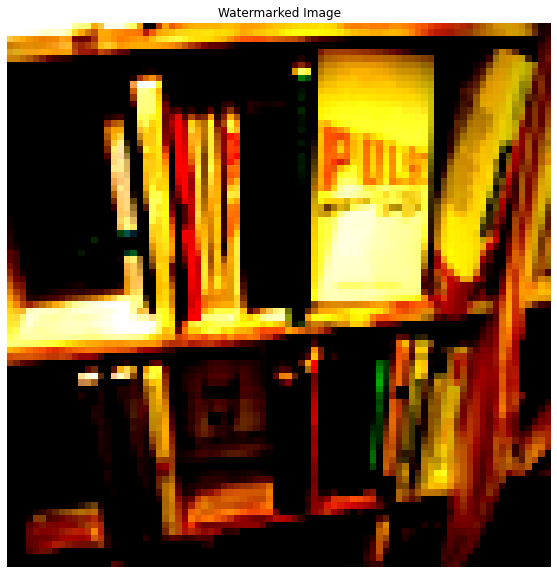

  9%|▉         | 1/11 [00:08<01:23,  8.35s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 14: Target opacity: 0, Labeled correctly: 0.5333333333333333, Correctly Predicted Target: False, Base class predicted: False


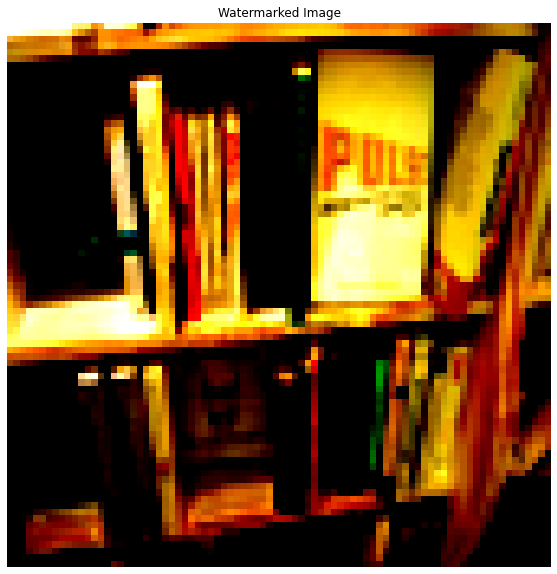

 18%|█▊        | 2/11 [00:16<01:14,  8.27s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 14: Target opacity: 0.05, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: False, Base class predicted: False


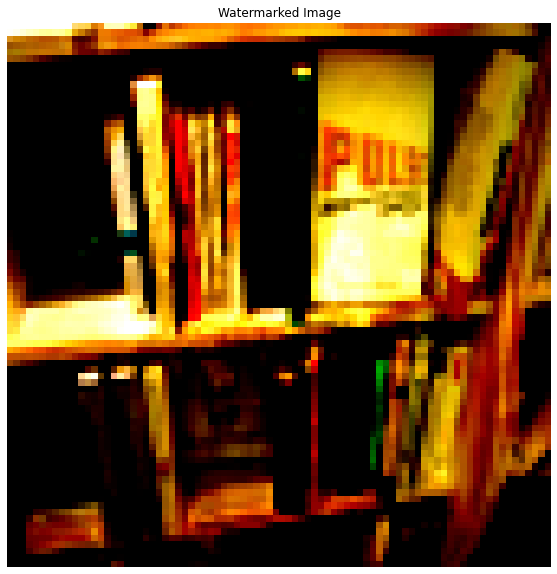

 27%|██▋       | 3/11 [00:24<01:05,  8.17s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 14: Target opacity: 0.1, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: False, Base class predicted: False


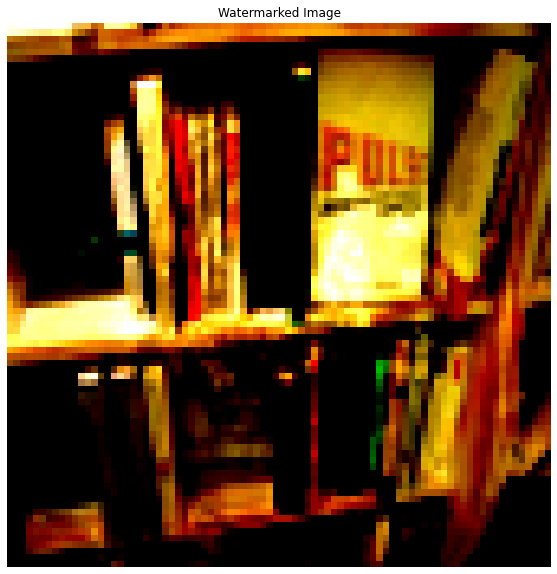

 36%|███▋      | 4/11 [00:32<00:56,  8.09s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 14: Target opacity: 0.15, Labeled correctly: 0.56, Correctly Predicted Target: False, Base class predicted: False


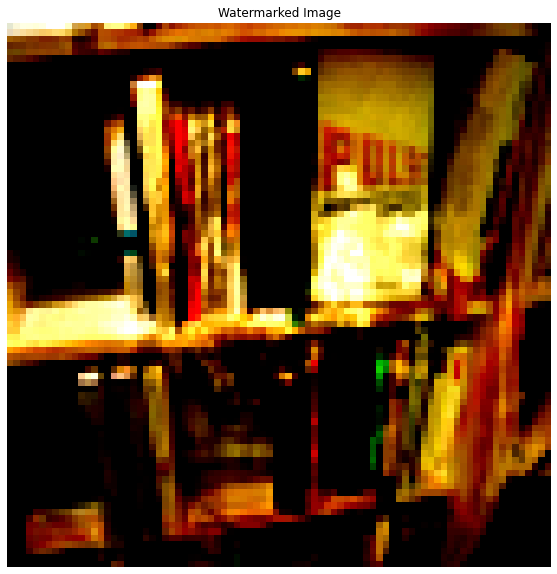

 45%|████▌     | 5/11 [00:40<00:48,  8.02s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 14: Target opacity: 0.2, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: False, Base class predicted: False


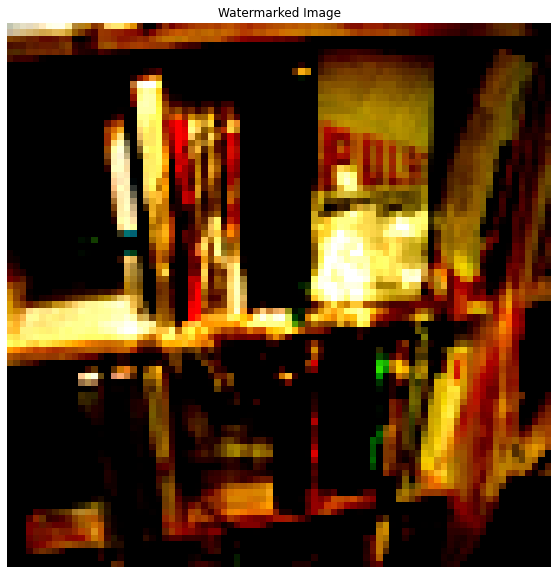

 55%|█████▍    | 6/11 [00:48<00:40,  8.04s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 14: Target opacity: 0.25, Labeled correctly: 0.56, Correctly Predicted Target: False, Base class predicted: False


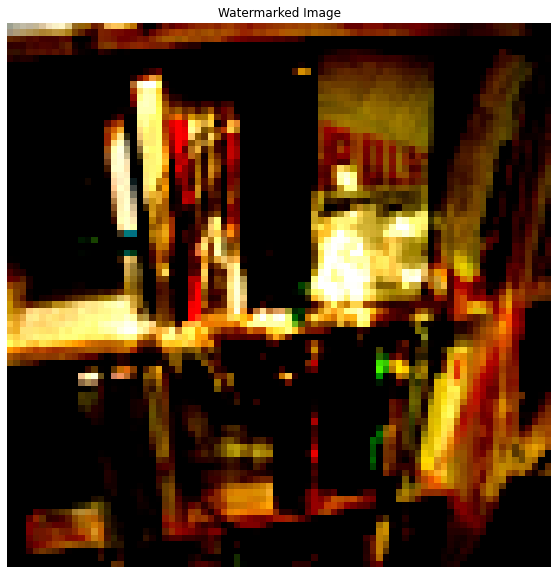

 64%|██████▎   | 7/11 [00:56<00:32,  8.01s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 14: Target opacity: 0.3, Labeled correctly: 0.56, Correctly Predicted Target: False, Base class predicted: False


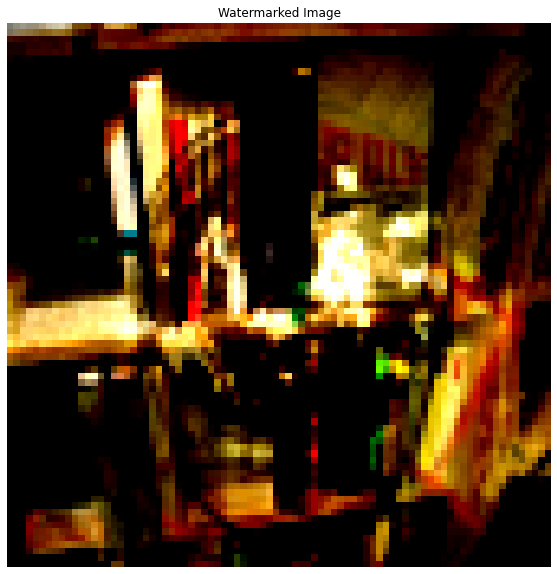

 73%|███████▎  | 8/11 [01:04<00:24,  8.06s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 14: Target opacity: 0.35, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: False, Base class predicted: False


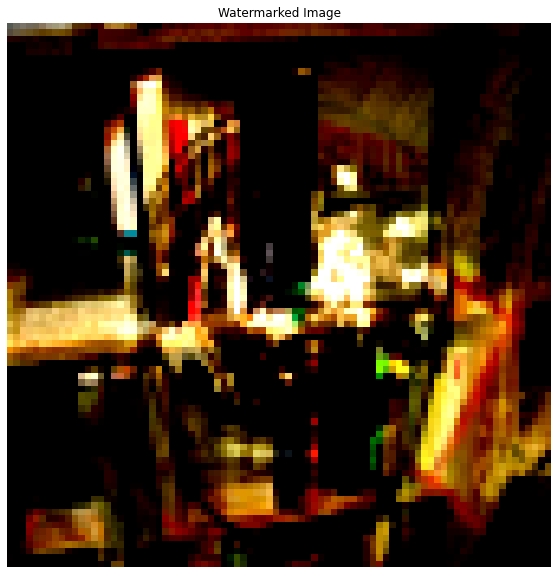

 82%|████████▏ | 9/11 [01:12<00:16,  8.06s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 14: Target opacity: 0.4, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: False, Base class predicted: True


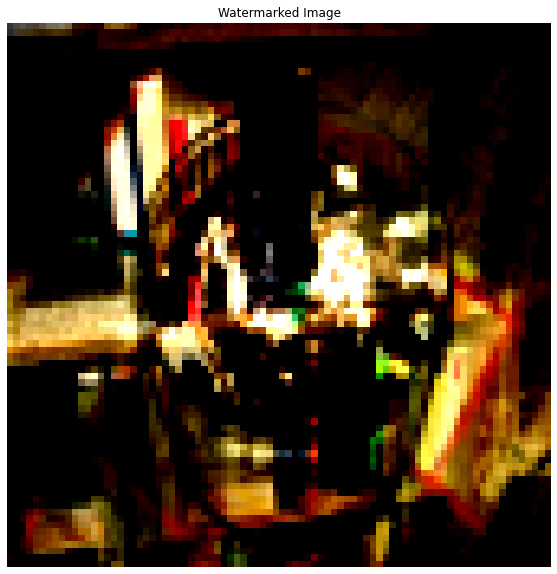

 91%|█████████ | 10/11 [01:20<00:08,  8.06s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 14: Target opacity: 0.45, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: False, Base class predicted: True


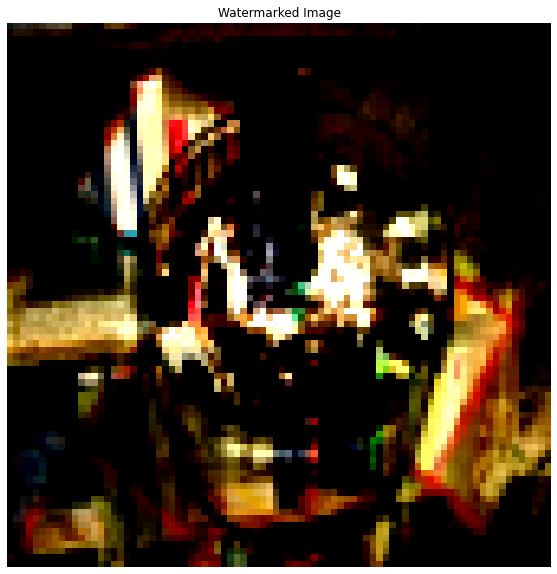

100%|██████████| 11/11 [01:28<00:00,  8.07s/it]

Iteration 14: Target opacity: 0.5, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: False, Base class predicted: True



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


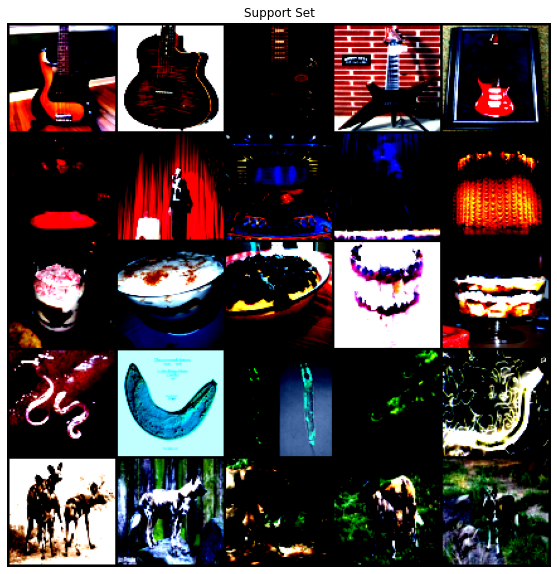

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 1, 1, 1, 1,
         1]])


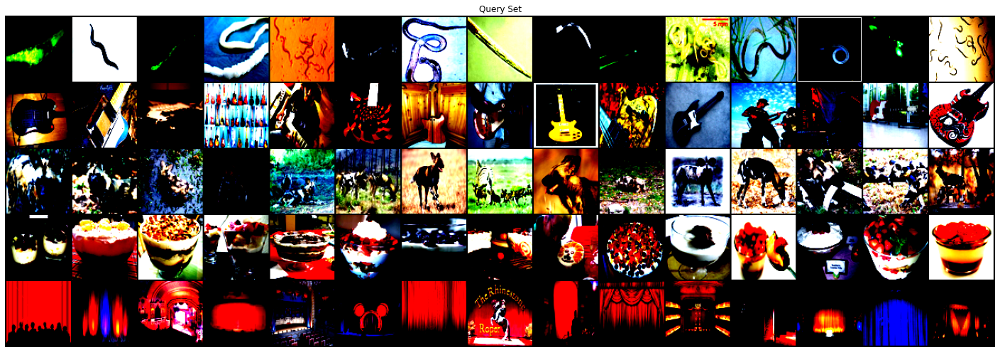

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3,
         3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
         4, 4, 4]])
target_class 2
unique_classes [0, 1, 3, 4]
base_class 4
target_indices [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14]
target_index 6
base_indices [5 6 7 8 9]
base_index 9


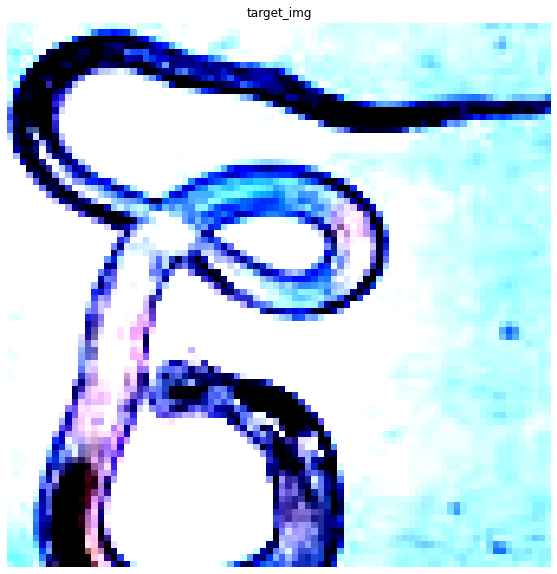

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


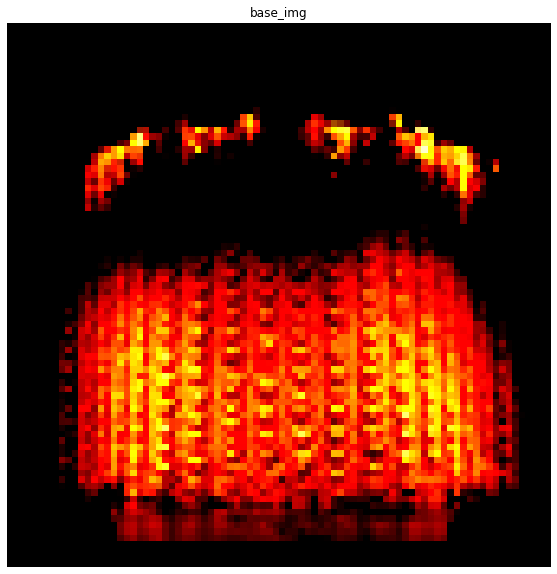

  0%|          | 3/1000 [00:00<00:34, 29.23it/s]

Iteration 0
loss: tensor(20.9883, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(15.1621, grad_fn=<PowBackward0>)
Iteration 2
loss: tensor(11.8332, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(35.9112, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(69.0343, grad_fn=<PowBackward0>)
Iteration 5
loss: 

  1%|          | 9/1000 [00:00<00:36, 27.01it/s]

tensor(2.8060, grad_fn=<PowBackward0>)
Iteration 6
loss: tensor(13.4030, grad_fn=<PowBackward0>)
Iteration 7
loss: tensor(14.4228, grad_fn=<PowBackward0>)
Iteration 8
loss: tensor(84.3339, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(0.8038, grad_fn=<PowBackward0>)
Iteration 10
loss: tensor(4.8919, grad_fn=<PowBackward0>)


  2%|▏         | 15/1000 [00:00<00:40, 24.14it/s]

Iteration 11
loss: tensor(10.7982, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(47.8897, grad_fn=<PowBackward0>)
Iteration 13
loss: tensor(11.1756, grad_fn=<PowBackward0>)
Iteration 14
loss: tensor(58.8321, grad_fn=<PowBackward0>)
Iteration 15
loss: tensor(1.5718, grad_fn=<PowBackward0>)


  2%|▏         | 18/1000 [00:00<00:40, 24.12it/s]

Iteration 16
loss: tensor(29.5367, grad_fn=<PowBackward0>)
Iteration 17
loss: tensor(12.6867, grad_fn=<PowBackward0>)
Iteration 18
loss: tensor(59.7911, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(7.5924, grad_fn=<PowBackward0>)
Iteration 20
loss: tensor(29.8009, grad_fn=<PowBackward0>)


  2%|▏         | 24/1000 [00:00<00:39, 24.76it/s]

Iteration 21
loss: tensor(2.6051, grad_fn=<PowBackward0>)
Iteration 22
loss: tensor(50.7635, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(15.5182, grad_fn=<PowBackward0>)
Iteration 24
loss: tensor(70.7437, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(6.7422, grad_fn=<PowBackward0>)
Iteration 26
loss: tensor(41.8309, grad_fn=<PowBackward0>)


  3%|▎         | 30/1000 [00:01<00:38, 25.47it/s]

Iteration 27
loss: tensor(23.6995, grad_fn=<PowBackward0>)
Iteration 28
loss: tensor(48.5149, grad_fn=<PowBackward0>)
Iteration 29
loss: tensor(0.6209, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(14.2673, grad_fn=<PowBackward0>)
Iteration 31
loss: tensor(4.3186, grad_fn=<PowBackward0>)
Iteration 32
loss: 

  4%|▎         | 36/1000 [00:01<00:37, 25.70it/s]

tensor(51.0660, grad_fn=<PowBackward0>)
Iteration 33
loss: tensor(6.5982, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(33.2422, grad_fn=<PowBackward0>)
Iteration 35
loss: tensor(16.8556, grad_fn=<PowBackward0>)
Iteration 36
loss: tensor(59.3749, grad_fn=<PowBackward0>)
Iteration 37
loss: tensor(2.3410, grad_fn=<PowBackward0>)


  4%|▍         | 42/1000 [00:01<00:37, 25.41it/s]

Iteration 38
loss: tensor(34.2357, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(28.1068, grad_fn=<PowBackward0>)
Iteration 40
loss: tensor(52.6074, grad_fn=<PowBackward0>)
Iteration 41
loss: tensor(3.9416, grad_fn=<PowBackward0>)
Iteration 42
loss: tensor(31.5529, grad_fn=<PowBackward0>)


  4%|▍         | 45/1000 [00:01<00:40, 23.74it/s]

Iteration 43
loss: tensor(17.3660, grad_fn=<PowBackward0>)
Iteration 44
loss: tensor(95.4656, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(3.3482, grad_fn=<PowBackward0>)
Iteration 46
loss: tensor(14.0720, grad_fn=<PowBackward0>)
Iteration 47
loss: tensor(24.5637, grad_fn=<PowBackward0>)


  5%|▌         | 51/1000 [00:02<00:38, 24.42it/s]

Iteration 48
loss: tensor(66.5824, grad_fn=<PowBackward0>)
Iteration 49
loss: tensor(10.7994, grad_fn=<PowBackward0>)
Iteration 50
loss: tensor(39.1104, grad_fn=<PowBackward0>)
Iteration 51
loss: tensor(10.0681, grad_fn=<PowBackward0>)
Iteration 52
loss: tensor(73.7009, grad_fn=<PowBackward0>)
Iteration 53
loss: tensor(2.0785, grad_fn=<PowBackward0>)


  6%|▌         | 57/1000 [00:02<00:37, 24.94it/s]

Iteration 54
loss: tensor(12.7261, grad_fn=<PowBackward0>)
Iteration 55
loss: tensor(18.8969, grad_fn=<PowBackward0>)
Iteration 56
loss: tensor(65.3396, grad_fn=<PowBackward0>)
Iteration 57
loss: tensor(1.0940, grad_fn=<PowBackward0>)
Iteration 58


  6%|▋         | 63/1000 [00:02<00:37, 24.89it/s]

loss: tensor(0.9676, grad_fn=<PowBackward0>)
Iteration 59
loss: tensor(66.0936, grad_fn=<PowBackward0>)
Iteration 60
loss: tensor(7.5682, grad_fn=<PowBackward0>)
Iteration 61
loss: tensor(41.2031, grad_fn=<PowBackward0>)
Iteration 62
loss: tensor(1.3151, grad_fn=<PowBackward0>)
Iteration 63
loss: tensor(32.2900, grad_fn=<PowBackward0>)


  7%|▋         | 69/1000 [00:02<00:36, 25.58it/s]

Iteration 64
loss: tensor(20.0480, grad_fn=<PowBackward0>)
Iteration 65
loss: tensor(62.9826, grad_fn=<PowBackward0>)
Iteration 66
loss: tensor(12.0851, grad_fn=<PowBackward0>)
Iteration 67
loss: tensor(33.6390, grad_fn=<PowBackward0>)
Iteration 68
loss: tensor(10.6176, grad_fn=<PowBackward0>)
Iteration 69


  7%|▋         | 72/1000 [00:02<00:38, 24.38it/s]

loss: tensor(22.6177, grad_fn=<PowBackward0>)
Iteration 70
loss: tensor(13.9143, grad_fn=<PowBackward0>)
Iteration 71
loss: tensor(78.1458, grad_fn=<PowBackward0>)
Iteration 72
loss: tensor(12.3991, grad_fn=<PowBackward0>)
Iteration 73
loss: tensor(46.5119, grad_fn=<PowBackward0>)
Iteration 74
loss: tensor(5.5878, grad_fn=<PowBackward0>)


  8%|▊         | 78/1000 [00:03<00:35, 25.72it/s]

Iteration 75
loss: tensor(36.4575, grad_fn=<PowBackward0>)
Iteration 76
loss: tensor(5.3293, grad_fn=<PowBackward0>)
Iteration 77
loss: tensor(31.5883, grad_fn=<PowBackward0>)
Iteration 78
loss: tensor(2.8729, grad_fn=<PowBackward0>)
Iteration 79
loss: tensor(29.2684, grad_fn=<PowBackward0>)
Iteration 80
loss: tensor(23.9561, grad_fn=<PowBackward0>)


  8%|▊         | 84/1000 [00:03<00:34, 26.53it/s]

Iteration 81
loss: tensor(107.1659, grad_fn=<PowBackward0>)
Iteration 82
loss: tensor(3.0573, grad_fn=<PowBackward0>)
Iteration 83
loss: tensor(3.9916, grad_fn=<PowBackward0>)
Iteration 84
loss: tensor(85.1931, grad_fn=<PowBackward0>)
Iteration 85
loss: tensor(3.1926, grad_fn=<PowBackward0>)
Iteration 86


  9%|▉         | 90/1000 [00:03<00:35, 25.98it/s]

loss: tensor(25.8757, grad_fn=<PowBackward0>)
Iteration 87
loss: tensor(19.8237, grad_fn=<PowBackward0>)
Iteration 88
loss: tensor(84.2495, grad_fn=<PowBackward0>)
Iteration 89
loss: tensor(4.3796, grad_fn=<PowBackward0>)
Iteration 90
loss: tensor(16.5408, grad_fn=<PowBackward0>)
Iteration 91
loss: tensor(9.0110, grad_fn=<PowBackward0>)


 10%|▉         | 96/1000 [00:03<00:33, 26.75it/s]

Iteration 92
loss: tensor(70.6092, grad_fn=<PowBackward0>)
Iteration 93
loss: tensor(4.5367, grad_fn=<PowBackward0>)
Iteration 94
loss: tensor(30.2339, grad_fn=<PowBackward0>)
Iteration 95
loss: tensor(4.3906, grad_fn=<PowBackward0>)
Iteration 96
loss: tensor(47.5651, grad_fn=<PowBackward0>)
Iteration 97
loss: tensor(13.2696, grad_fn=<PowBackward0>)


 10%|█         | 102/1000 [00:04<00:33, 26.63it/s]

Iteration 98
loss: tensor(53.5692, grad_fn=<PowBackward0>)
Iteration 99
loss: tensor(5.6147, grad_fn=<PowBackward0>)
Iteration 100
loss: tensor(43.3006, grad_fn=<PowBackward0>)
Iteration 101
loss: tensor(16.6319, grad_fn=<PowBackward0>)
Iteration 102
loss: tensor(48.1505, grad_fn=<PowBackward0>)
Iteration 103


 11%|█         | 108/1000 [00:04<00:33, 26.57it/s]

loss: tensor(14.7292, grad_fn=<PowBackward0>)
Iteration 104
loss: tensor(35.7908, grad_fn=<PowBackward0>)
Iteration 105
loss: tensor(7.1224, grad_fn=<PowBackward0>)
Iteration 106
loss: tensor(41.2962, grad_fn=<PowBackward0>)
Iteration 107
loss: tensor(1.6660, grad_fn=<PowBackward0>)
Iteration 108
loss: tensor(14.8492, grad_fn=<PowBackward0>)


 11%|█▏        | 114/1000 [00:04<00:32, 26.91it/s]

Iteration 109
loss: tensor(21.7600, grad_fn=<PowBackward0>)
Iteration 110
loss: tensor(64.7821, grad_fn=<PowBackward0>)
Iteration 111
loss: tensor(11.2075, grad_fn=<PowBackward0>)
Iteration 112
loss: tensor(33.5579, grad_fn=<PowBackward0>)
Iteration 113
loss: tensor(3.3878, grad_fn=<PowBackward0>)
Iteration 114
loss:

 12%|█▏        | 117/1000 [00:04<00:32, 26.81it/s]

 tensor(36.6644, grad_fn=<PowBackward0>)
Iteration 115
loss: tensor(13.5019, grad_fn=<PowBackward0>)
Iteration 116
loss: tensor(48.5394, grad_fn=<PowBackward0>)
Iteration 117
loss: tensor(11.1376, grad_fn=<PowBackward0>)
Iteration 118
loss: tensor(39.5071, grad_fn=<PowBackward0>)
Iteration 119
loss: tensor(6.9115, grad_fn=<PowBackward0>)


 12%|█▏        | 123/1000 [00:04<00:32, 26.77it/s]

Iteration 120
loss: tensor(34.9687, grad_fn=<PowBackward0>)
Iteration 121
loss: tensor(4.4976, grad_fn=<PowBackward0>)
Iteration 122
loss: tensor(46.1338, grad_fn=<PowBackward0>)
Iteration 123
loss: tensor(2.2512, grad_fn=<PowBackward0>)
Iteration 124
loss: tensor(35.8028, grad_fn=<PowBackward0>)
Iteration 125


 13%|█▎        | 129/1000 [00:05<00:34, 25.31it/s]

loss: tensor(23.0655, grad_fn=<PowBackward0>)
Iteration 126
loss: tensor(84.1027, grad_fn=<PowBackward0>)
Iteration 127
loss: tensor(20.8850, grad_fn=<PowBackward0>)
Iteration 128
loss: tensor(28.8515, grad_fn=<PowBackward0>)
Iteration 129
loss: tensor(7.5710, grad_fn=<PowBackward0>)
Iteration 130
loss:

 14%|█▎        | 135/1000 [00:05<00:33, 25.62it/s]

 tensor(47.2677, grad_fn=<PowBackward0>)
Iteration 131
loss: tensor(8.0524, grad_fn=<PowBackward0>)
Iteration 132
loss: tensor(29.9646, grad_fn=<PowBackward0>)
Iteration 133
loss: tensor(10.0964, grad_fn=<PowBackward0>)
Iteration 134
loss: tensor(37.0676, grad_fn=<PowBackward0>)
Iteration 135
loss: tensor(0.6005, grad_fn=<PowBackward0>)

 14%|█▍        | 138/1000 [00:05<00:34, 24.85it/s]


Iteration 136
loss: tensor(9.7345, grad_fn=<PowBackward0>)
Iteration 137
loss: tensor(8.1913, grad_fn=<PowBackward0>)
Iteration 138
loss: tensor(56.3810, grad_fn=<PowBackward0>)
Iteration 139
loss: tensor(0.9249, grad_fn=<PowBackward0>)
Iteration 140
loss: tensor(8.9676, grad_fn=<PowBackward0>)


 14%|█▍        | 144/1000 [00:05<00:33, 25.67it/s]

Iteration 141
loss: tensor(6.6558, grad_fn=<PowBackward0>)
Iteration 142
loss: tensor(92.3695, grad_fn=<PowBackward0>)
Iteration 143
loss: tensor(9.0074, grad_fn=<PowBackward0>)
Iteration 144
loss: tensor(28.3478, grad_fn=<PowBackward0>)
Iteration 145
loss: tensor(11.4711, grad_fn=<PowBackward0>)
Iteration 146


 15%|█▌        | 150/1000 [00:05<00:32, 25.82it/s]

loss: tensor(77.2497, grad_fn=<PowBackward0>)
Iteration 147
loss: tensor(16.8004, grad_fn=<PowBackward0>)
Iteration 148
loss: tensor(52.7800, grad_fn=<PowBackward0>)
Iteration 149
loss: tensor(5.5010, grad_fn=<PowBackward0>)
Iteration 150
loss: tensor(43.6738, grad_fn=<PowBackward0>)
Iteration 151


 16%|█▌        | 156/1000 [00:06<00:33, 25.08it/s]

loss: tensor(9.8047, grad_fn=<PowBackward0>)
Iteration 152
loss: tensor(34.4978, grad_fn=<PowBackward0>)
Iteration 153
loss: tensor(12.2164, grad_fn=<PowBackward0>)
Iteration 154
loss: tensor(49.6339, grad_fn=<PowBackward0>)
Iteration 155
loss: tensor(16.8253, grad_fn=<PowBackward0>)
Iteration 156
loss: tensor(46.2744, grad_fn=<PowBackward0>)


 16%|█▌        | 162/1000 [00:06<00:32, 25.46it/s]

Iteration 157
loss: tensor(1.3469, grad_fn=<PowBackward0>)
Iteration 158
loss: tensor(21.3200, grad_fn=<PowBackward0>)
Iteration 159
loss: tensor(9.5858, grad_fn=<PowBackward0>)
Iteration 160
loss: tensor(51.2720, grad_fn=<PowBackward0>)
Iteration 161
loss: tensor(3.5529, grad_fn=<PowBackward0>)
Iteration 162


 16%|█▋        | 165/1000 [00:06<00:33, 25.23it/s]

loss: tensor(30.4717, grad_fn=<PowBackward0>)
Iteration 163
loss: tensor(12.7768, grad_fn=<PowBackward0>)
Iteration 164
loss: tensor(54.7114, grad_fn=<PowBackward0>)
Iteration 165
loss: tensor(11.6900, grad_fn=<PowBackward0>)
Iteration 166
loss: tensor(27.5434, grad_fn=<PowBackward0>)
Iteration 167


 17%|█▋        | 171/1000 [00:06<00:34, 24.25it/s]

loss: tensor(20.5864, grad_fn=<PowBackward0>)
Iteration 168
loss: tensor(62.6303, grad_fn=<PowBackward0>)
Iteration 169
loss: tensor(0.2845, grad_fn=<PowBackward0>)
Iteration 170
loss: tensor(8.7370, grad_fn=<PowBackward0>)
Iteration 171
loss: tensor(13.5517, grad_fn=<PowBackward0>)
Iteration 172
loss: tensor(85.1980, grad_fn=<PowBackward0>)

 18%|█▊        | 177/1000 [00:06<00:34, 23.95it/s]


Iteration 173
loss: tensor(4.2965, grad_fn=<PowBackward0>)
Iteration 174
loss: tensor(27.0343, grad_fn=<PowBackward0>)
Iteration 175
loss: tensor(22.2987, grad_fn=<PowBackward0>)
Iteration 176
loss: tensor(72.4384, grad_fn=<PowBackward0>)
Iteration 177


 18%|█▊        | 180/1000 [00:07<00:34, 23.90it/s]

loss: tensor(3.6267, grad_fn=<PowBackward0>)
Iteration 178
loss: tensor(25.8550, grad_fn=<PowBackward0>)
Iteration 179
loss: tensor(17.2607, grad_fn=<PowBackward0>)
Iteration 180
loss: tensor(39.0867, grad_fn=<PowBackward0>)
Iteration 181
loss: tensor(13.6396, grad_fn=<PowBackward0>)
Iteration 182
loss: tensor(43.9563, grad_fn=<PowBackward0>)


 19%|█▊        | 186/1000 [00:07<00:34, 23.94it/s]

Iteration 183
loss: tensor(12.1621, grad_fn=<PowBackward0>)
Iteration 184
loss: tensor(49.9468, grad_fn=<PowBackward0>)
Iteration 185
loss: tensor(8.2057, grad_fn=<PowBackward0>)
Iteration 186
loss: tensor(33.1275, grad_fn=<PowBackward0>)
Iteration 187
loss: tensor(17.1834, grad_fn=<PowBackward0>)


 19%|█▉        | 189/1000 [00:07<00:34, 23.75it/s]

Iteration 188
loss: tensor(55.4470, grad_fn=<PowBackward0>)
Iteration 189
loss: tensor(13.4830, grad_fn=<PowBackward0>)
Iteration 190
loss: tensor(31.1097, grad_fn=<PowBackward0>)
Iteration 191
loss: tensor(17.3800, grad_fn=<PowBackward0>)


 20%|█▉        | 195/1000 [00:07<00:36, 22.36it/s]

Iteration 192
loss: tensor(48.1875, grad_fn=<PowBackward0>)
Iteration 193
loss: tensor(6.9896, grad_fn=<PowBackward0>)
Iteration 194
loss: tensor(37.8495, grad_fn=<PowBackward0>)
Iteration 195
loss: tensor(12.7872, grad_fn=<PowBackward0>)
Iteration 196
loss: tensor(30.5784, grad_fn=<PowBackward0>)
Iteration 197


 20%|██        | 201/1000 [00:08<00:33, 23.64it/s]

loss: tensor(9.8254, grad_fn=<PowBackward0>)
Iteration 198
loss: tensor(50.2067, grad_fn=<PowBackward0>)
Iteration 199
loss: tensor(12.3495, grad_fn=<PowBackward0>)
Iteration 200
loss: tensor(36.1915, grad_fn=<PowBackward0>)
Iteration 201
loss: tensor(0.4793, grad_fn=<PowBackward0>)
Iteration 202
loss: tensor(2.3434, grad_fn=<PowBackward0>)


 21%|██        | 207/1000 [00:08<00:34, 23.11it/s]

Iteration 203
loss: tensor(15.9288, grad_fn=<PowBackward0>)
Iteration 204
loss: tensor(63.7748, grad_fn=<PowBackward0>)
Iteration 205
loss: tensor(7.6011, grad_fn=<PowBackward0>)
Iteration 206
loss: tensor(17.2689, grad_fn=<PowBackward0>)
Iteration 207


 21%|██        | 210/1000 [00:08<00:33, 23.40it/s]

loss: tensor(11.2437, grad_fn=<PowBackward0>)
Iteration 208
loss: tensor(23.0765, grad_fn=<PowBackward0>)
Iteration 209
loss: tensor(14.3794, grad_fn=<PowBackward0>)
Iteration 210
loss: tensor(33.2653, grad_fn=<PowBackward0>)
Iteration 211
loss: tensor(8.8568, grad_fn=<PowBackward0>)
Iteration 212
loss: tensor(10.3062, grad_fn=<PowBackward0>)


 22%|██▏       | 216/1000 [00:08<00:32, 24.39it/s]

Iteration 213
loss: tensor(9.5942, grad_fn=<PowBackward0>)
Iteration 214
loss: tensor(39.0746, grad_fn=<PowBackward0>)
Iteration 215
loss: tensor(7.6778, grad_fn=<PowBackward0>)
Iteration 216
loss: tensor(9.8035, grad_fn=<PowBackward0>)
Iteration 217
loss: tensor(6.4018, grad_fn=<PowBackward0>)


 22%|██▏       | 222/1000 [00:08<00:30, 25.17it/s]

Iteration 218
loss: tensor(24.7011, grad_fn=<PowBackward0>)
Iteration 219
loss: tensor(16.0486, grad_fn=<PowBackward0>)
Iteration 220
loss: tensor(34.4131, grad_fn=<PowBackward0>)
Iteration 221
loss: tensor(6.2275, grad_fn=<PowBackward0>)
Iteration 222
loss: tensor(22.3721, grad_fn=<PowBackward0>)
Iteration 223
loss: tensor(5.5850, grad_fn=<PowBackward0>)


 23%|██▎       | 228/1000 [00:09<00:31, 24.71it/s]

Iteration 224
loss: tensor(20.4577, grad_fn=<PowBackward0>)
Iteration 225
loss: tensor(5.2294, grad_fn=<PowBackward0>)
Iteration 226
loss: tensor(22.3684, grad_fn=<PowBackward0>)
Iteration 227
loss: tensor(11.0740, grad_fn=<PowBackward0>)
Iteration 228
loss: tensor(28.8563, grad_fn=<PowBackward0>)


 23%|██▎       | 234/1000 [00:09<00:30, 25.44it/s]

Iteration 229
loss: tensor(2.3106, grad_fn=<PowBackward0>)
Iteration 230
loss: tensor(5.1473, grad_fn=<PowBackward0>)
Iteration 231
loss: tensor(4.9214, grad_fn=<PowBackward0>)
Iteration 232
loss: tensor(28.4529, grad_fn=<PowBackward0>)
Iteration 233
loss: tensor(6.2936, grad_fn=<PowBackward0>)
Iteration 234


 24%|██▎       | 237/1000 [00:09<00:30, 24.67it/s]

loss: tensor(24.4621, grad_fn=<PowBackward0>)
Iteration 235
loss: tensor(6.8173, grad_fn=<PowBackward0>)
Iteration 236
loss: tensor(33.2182, grad_fn=<PowBackward0>)
Iteration 237
loss: tensor(10.1210, grad_fn=<PowBackward0>)
Iteration 238
loss: tensor(16.5466, grad_fn=<PowBackward0>)
Iteration 239
loss:

 24%|██▍       | 243/1000 [00:09<00:29, 25.25it/s]

 tensor(3.6063, grad_fn=<PowBackward0>)
Iteration 240
loss: tensor(12.7010, grad_fn=<PowBackward0>)
Iteration 241
loss: tensor(9.4398, grad_fn=<PowBackward0>)
Iteration 242
loss: tensor(56.7004, grad_fn=<PowBackward0>)
Iteration 243
loss: tensor(7.5937, grad_fn=<PowBackward0>)
Iteration 244
loss: tensor(24.1844, grad_fn=<PowBackward0>)


 25%|██▍       | 249/1000 [00:09<00:29, 25.87it/s]

Iteration 245
loss: tensor(3.1431, grad_fn=<PowBackward0>)
Iteration 246
loss: tensor(19.9380, grad_fn=<PowBackward0>)
Iteration 247
loss: tensor(4.2021, grad_fn=<PowBackward0>)
Iteration 248
loss: tensor(17.8900, grad_fn=<PowBackward0>)
Iteration 249
loss: tensor(16.5079, grad_fn=<PowBackward0>)
Iteration 250


 26%|██▌       | 255/1000 [00:10<00:28, 26.22it/s]

loss: tensor(42.1669, grad_fn=<PowBackward0>)
Iteration 251
loss: tensor(8.1999, grad_fn=<PowBackward0>)
Iteration 252
loss: tensor(20.7957, grad_fn=<PowBackward0>)
Iteration 253
loss: tensor(7.8562, grad_fn=<PowBackward0>)
Iteration 254
loss: tensor(42.6985, grad_fn=<PowBackward0>)
Iteration 255
loss: tensor(5.8338, grad_fn=<PowBackward0>)


 26%|██▌       | 261/1000 [00:10<00:28, 26.27it/s]

Iteration 256
loss: tensor(12.2304, grad_fn=<PowBackward0>)
Iteration 257
loss: tensor(10.2907, grad_fn=<PowBackward0>)
Iteration 258
loss: tensor(35.6792, grad_fn=<PowBackward0>)
Iteration 259
loss: tensor(17.0267, grad_fn=<PowBackward0>)
Iteration 260
loss: tensor(29.7072, grad_fn=<PowBackward0>)
Iteration 261


 26%|██▋       | 264/1000 [00:10<00:28, 26.02it/s]

loss: tensor(9.2407, grad_fn=<PowBackward0>)
Iteration 262
loss: tensor(32.2705, grad_fn=<PowBackward0>)
Iteration 263
loss: tensor(8.1707, grad_fn=<PowBackward0>)
Iteration 264
loss: tensor(28.9912, grad_fn=<PowBackward0>)
Iteration 265
loss: tensor(9.0102, grad_fn=<PowBackward0>)
Iteration 266
loss: tensor(26.1921, grad_fn=<PowBackward0>)


 27%|██▋       | 270/1000 [00:10<00:29, 25.10it/s]

Iteration 267
loss: tensor(8.4823, grad_fn=<PowBackward0>)
Iteration 268
loss: tensor(25.9185, grad_fn=<PowBackward0>)
Iteration 269
loss: tensor(4.8666, grad_fn=<PowBackward0>)
Iteration 270
loss: tensor(28.9516, grad_fn=<PowBackward0>)
Iteration 271
loss: tensor(5.7636, grad_fn=<PowBackward0>)
Iteration 272


 28%|██▊       | 276/1000 [00:11<00:31, 23.16it/s]

loss: tensor(14.9313, grad_fn=<PowBackward0>)
Iteration 273
loss: tensor(8.6271, grad_fn=<PowBackward0>)
Iteration 274
loss: tensor(27.9989, grad_fn=<PowBackward0>)
Iteration 275
loss: tensor(8.2303, grad_fn=<PowBackward0>)
Iteration 276
loss: tensor(20.7634, grad_fn=<PowBackward0>)


 28%|██▊       | 282/1000 [00:11<00:29, 24.61it/s]

Iteration 277
loss: tensor(13.3455, grad_fn=<PowBackward0>)
Iteration 278
loss: tensor(27.1153, grad_fn=<PowBackward0>)
Iteration 279
loss: tensor(7.1939, grad_fn=<PowBackward0>)
Iteration 280
loss: tensor(23.2472, grad_fn=<PowBackward0>)
Iteration 281
loss: tensor(13.5782, grad_fn=<PowBackward0>)
Iteration 282


 28%|██▊       | 285/1000 [00:11<00:28, 24.95it/s]

loss: tensor(21.0357, grad_fn=<PowBackward0>)
Iteration 283
loss: tensor(9.0937, grad_fn=<PowBackward0>)
Iteration 284
loss: tensor(24.5301, grad_fn=<PowBackward0>)
Iteration 285
loss: tensor(4.8237, grad_fn=<PowBackward0>)
Iteration 286
loss: tensor(14.7122, grad_fn=<PowBackward0>)
Iteration 287
loss: tensor(14.4281, grad_fn=<PowBackward0>)


 29%|██▉       | 291/1000 [00:11<00:28, 25.24it/s]

Iteration 288
loss: tensor(45.4058, grad_fn=<PowBackward0>)
Iteration 289
loss: tensor(9.9647, grad_fn=<PowBackward0>)
Iteration 290
loss: tensor(30.3468, grad_fn=<PowBackward0>)
Iteration 291
loss: tensor(5.8634, grad_fn=<PowBackward0>)
Iteration 292
loss: tensor(18.7268, grad_fn=<PowBackward0>)
Iteration 293
loss: tensor(6.8763, grad_fn=<PowBackward0>)


 30%|██▉       | 297/1000 [00:11<00:27, 25.47it/s]

Iteration 294
loss: tensor(18.1476, grad_fn=<PowBackward0>)
Iteration 295
loss: tensor(8.4547, grad_fn=<PowBackward0>)
Iteration 296
loss: tensor(30.5865, grad_fn=<PowBackward0>)
Iteration 297
loss: tensor(8.2849, grad_fn=<PowBackward0>)
Iteration 298
loss: tensor(24.1488, grad_fn=<PowBackward0>)
Iteration 299


 30%|███       | 303/1000 [00:12<00:27, 25.28it/s]

loss: tensor(1.5964, grad_fn=<PowBackward0>)
Iteration 300
loss: tensor(6.6362, grad_fn=<PowBackward0>)
Iteration 301
loss: tensor(12.6878, grad_fn=<PowBackward0>)
Iteration 302
loss: tensor(11.4105, grad_fn=<PowBackward0>)
Iteration 303
loss: tensor(3.8678, grad_fn=<PowBackward0>)
Iteration 304
loss: 

 31%|███       | 309/1000 [00:12<00:27, 25.18it/s]

tensor(5.7328, grad_fn=<PowBackward0>)
Iteration 305
loss: tensor(1.2420, grad_fn=<PowBackward0>)
Iteration 306
loss: tensor(2.1025, grad_fn=<PowBackward0>)
Iteration 307
loss: tensor(1.1500, grad_fn=<PowBackward0>)
Iteration 308
loss: tensor(5.7895, grad_fn=<PowBackward0>)
Iteration 309


 31%|███       | 312/1000 [00:12<00:28, 24.33it/s]

loss: tensor(4.2826, grad_fn=<PowBackward0>)
Iteration 310
loss: tensor(13.4287, grad_fn=<PowBackward0>)
Iteration 311
loss: tensor(6.4154, grad_fn=<PowBackward0>)
Iteration 312
loss: tensor(14.9839, grad_fn=<PowBackward0>)
Iteration 313
loss: tensor(6.8860, grad_fn=<PowBackward0>)
Iteration 314
loss:

 32%|███▏      | 318/1000 [00:12<00:27, 24.79it/s]

 tensor(5.2165, grad_fn=<PowBackward0>)
Iteration 315
loss: tensor(3.4286, grad_fn=<PowBackward0>)
Iteration 316
loss: tensor(7.5079, grad_fn=<PowBackward0>)
Iteration 317
loss: tensor(5.6416, grad_fn=<PowBackward0>)
Iteration 318
loss: tensor(11.2276, grad_fn=<PowBackward0>)
Iteration 319
loss: tensor(3.4800, grad_fn=<PowBackward0>)


 32%|███▏      | 324/1000 [00:12<00:25, 26.40it/s]

Iteration 320
loss: tensor(8.2861, grad_fn=<PowBackward0>)
Iteration 321
loss: tensor(7.0432, grad_fn=<PowBackward0>)
Iteration 322
loss: tensor(19.9649, grad_fn=<PowBackward0>)
Iteration 323
loss: tensor(11.8458, grad_fn=<PowBackward0>)
Iteration 324
loss: tensor(26.9486, grad_fn=<PowBackward0>)
Iteration 325
loss: tensor(8.2640, grad_fn=<PowBackward0>)


 33%|███▎      | 330/1000 [00:13<00:26, 25.26it/s]

Iteration 326
loss: tensor(16.6174, grad_fn=<PowBackward0>)
Iteration 327
loss: tensor(4.3112, grad_fn=<PowBackward0>)
Iteration 328
loss: tensor(8.1432, grad_fn=<PowBackward0>)
Iteration 329
loss: tensor(6.0724, grad_fn=<PowBackward0>)
Iteration 330
loss: tensor(13.3710, grad_fn=<PowBackward0>)


 34%|███▎      | 336/1000 [00:13<00:25, 26.06it/s]

Iteration 331
loss: tensor(6.7555, grad_fn=<PowBackward0>)
Iteration 332
loss: tensor(11.5194, grad_fn=<PowBackward0>)
Iteration 333
loss: tensor(6.8440, grad_fn=<PowBackward0>)
Iteration 334
loss: tensor(8.0271, grad_fn=<PowBackward0>)
Iteration 335
loss: tensor(4.8100, grad_fn=<PowBackward0>)
Iteration 336
loss: 

 34%|███▍      | 339/1000 [00:13<00:25, 25.81it/s]

tensor(4.4006, grad_fn=<PowBackward0>)
Iteration 337
loss: tensor(1.8106, grad_fn=<PowBackward0>)
Iteration 338
loss: tensor(6.0739, grad_fn=<PowBackward0>)
Iteration 339
loss: tensor(5.1772, grad_fn=<PowBackward0>)
Iteration 340
loss: tensor(12.9838, grad_fn=<PowBackward0>)
Iteration 341
loss: tensor(8.1744, grad_fn=<PowBackward0>)


 34%|███▍      | 345/1000 [00:13<00:25, 26.10it/s]

Iteration 342
loss: tensor(16.2228, grad_fn=<PowBackward0>)
Iteration 343
loss: tensor(9.1786, grad_fn=<PowBackward0>)
Iteration 344
loss: tensor(7.8434, grad_fn=<PowBackward0>)
Iteration 345
loss: tensor(3.9661, grad_fn=<PowBackward0>)
Iteration 346
loss: tensor(6.1908, grad_fn=<PowBackward0>)
Iteration 347
loss: tensor(3.5799, grad_fn=<PowBackward0>)


 35%|███▌      | 351/1000 [00:13<00:24, 26.09it/s]

Iteration 348
loss: tensor(4.2375, grad_fn=<PowBackward0>)
Iteration 349
loss: tensor(1.7011, grad_fn=<PowBackward0>)
Iteration 350
loss: tensor(4.3041, grad_fn=<PowBackward0>)
Iteration 351
loss: tensor(4.0755, grad_fn=<PowBackward0>)
Iteration 352
loss: tensor(9.0343, grad_fn=<PowBackward0>)
Iteration 353


 36%|███▌      | 357/1000 [00:14<00:25, 25.11it/s]

loss: tensor(7.3155, grad_fn=<PowBackward0>)
Iteration 354
loss: tensor(15.9808, grad_fn=<PowBackward0>)
Iteration 355
loss: tensor(4.1391, grad_fn=<PowBackward0>)
Iteration 356
loss: tensor(7.6615, grad_fn=<PowBackward0>)
Iteration 357
loss: tensor(4.2517, grad_fn=<PowBackward0>)
Iteration 358


 36%|███▋      | 363/1000 [00:14<00:24, 25.77it/s]

loss: tensor(5.0465, grad_fn=<PowBackward0>)
Iteration 359
loss: tensor(3.6686, grad_fn=<PowBackward0>)
Iteration 360
loss: tensor(6.2245, grad_fn=<PowBackward0>)
Iteration 361
loss: tensor(3.2346, grad_fn=<PowBackward0>)
Iteration 362
loss: tensor(7.9890, grad_fn=<PowBackward0>)
Iteration 363
loss: tensor(7.7267, grad_fn=<PowBackward0>)


 37%|███▋      | 369/1000 [00:14<00:23, 26.38it/s]

Iteration 364
loss: tensor(16.3847, grad_fn=<PowBackward0>)
Iteration 365
loss: tensor(7.6963, grad_fn=<PowBackward0>)
Iteration 366
loss: tensor(7.1390, grad_fn=<PowBackward0>)
Iteration 367
loss: tensor(3.5413, grad_fn=<PowBackward0>)
Iteration 368
loss: tensor(4.0163, grad_fn=<PowBackward0>)
Iteration 369
loss: tensor(3.1309, grad_fn=<PowBackward0>)


 37%|███▋      | 372/1000 [00:14<00:23, 26.54it/s]

Iteration 370
loss: tensor(4.2995, grad_fn=<PowBackward0>)
Iteration 371
loss: tensor(3.4852, grad_fn=<PowBackward0>)
Iteration 372
loss: tensor(8.8798, grad_fn=<PowBackward0>)
Iteration 373
loss: tensor(4.6329, grad_fn=<PowBackward0>)
Iteration 374
loss: tensor(8.7698, grad_fn=<PowBackward0>)


 38%|███▊      | 378/1000 [00:15<00:23, 26.56it/s]

Iteration 375
loss: tensor(6.3971, grad_fn=<PowBackward0>)
Iteration 376
loss: tensor(11.5036, grad_fn=<PowBackward0>)
Iteration 377
loss: tensor(5.5477, grad_fn=<PowBackward0>)
Iteration 378
loss: tensor(7.9250, grad_fn=<PowBackward0>)
Iteration 379
loss: tensor(2.2362, grad_fn=<PowBackward0>)
Iteration 380


 38%|███▊      | 384/1000 [00:15<00:23, 26.05it/s]

loss: tensor(2.6788, grad_fn=<PowBackward0>)
Iteration 381
loss: tensor(2.4035, grad_fn=<PowBackward0>)
Iteration 382
loss: tensor(3.7520, grad_fn=<PowBackward0>)
Iteration 383
loss: tensor(2.6797, grad_fn=<PowBackward0>)
Iteration 384
loss: tensor(6.6690, grad_fn=<PowBackward0>)
Iteration 385
loss: tensor(5.7779, grad_fn=<PowBackward0>)


 39%|███▉      | 390/1000 [00:15<00:23, 25.75it/s]

Iteration 386
loss: tensor(9.7311, grad_fn=<PowBackward0>)
Iteration 387
loss: tensor(14.3891, grad_fn=<PowBackward0>)
Iteration 388
loss: tensor(18.3986, grad_fn=<PowBackward0>)
Iteration 389
loss: tensor(3.5409, grad_fn=<PowBackward0>)
Iteration 390
loss: tensor(7.0813, grad_fn=<PowBackward0>)
Iteration 391


 40%|███▉      | 396/1000 [00:15<00:23, 25.48it/s]

loss: tensor(6.0641, grad_fn=<PowBackward0>)
Iteration 392
loss: tensor(9.3025, grad_fn=<PowBackward0>)
Iteration 393
loss: tensor(2.4816, grad_fn=<PowBackward0>)
Iteration 394
loss: tensor(4.1590, grad_fn=<PowBackward0>)
Iteration 395
loss: tensor(4.9224, grad_fn=<PowBackward0>)
Iteration 396
loss: tensor(13.0849, grad_fn=<PowBackward0>)

 40%|███▉      | 399/1000 [00:15<00:23, 25.59it/s]


Iteration 397
loss: tensor(8.0337, grad_fn=<PowBackward0>)
Iteration 398
loss: tensor(5.7064, grad_fn=<PowBackward0>)
Iteration 399
loss: tensor(2.8188, grad_fn=<PowBackward0>)
Iteration 400
loss: tensor(3.6599, grad_fn=<PowBackward0>)
Iteration 401
loss: tensor(3.5521, grad_fn=<PowBackward0>)


 40%|████      | 405/1000 [00:16<00:23, 24.92it/s]

Iteration 402
loss: tensor(0.2453, grad_fn=<PowBackward0>)
Iteration 403
loss: tensor(0.0493, grad_fn=<PowBackward0>)
Iteration 404
loss: tensor(0.0838, grad_fn=<PowBackward0>)
Iteration 405
loss: tensor(0.0790, grad_fn=<PowBackward0>)
Iteration 406


 41%|████      | 411/1000 [00:16<00:24, 24.34it/s]

loss: tensor(0.0800, grad_fn=<PowBackward0>)
Iteration 407
loss: tensor(0.0851, grad_fn=<PowBackward0>)
Iteration 408
loss: tensor(0.0894, grad_fn=<PowBackward0>)
Iteration 409
loss: tensor(0.0841, grad_fn=<PowBackward0>)
Iteration 410
loss: tensor(0.0819, grad_fn=<PowBackward0>)
Iteration 411
loss: tensor(0.0847, grad_fn=<PowBackward0>)


 42%|████▏     | 417/1000 [00:16<00:22, 25.77it/s]

Iteration 412
loss: tensor(0.0708, grad_fn=<PowBackward0>)
Iteration 413
loss: tensor(0.1157, grad_fn=<PowBackward0>)
Iteration 414
loss: tensor(0.0794, grad_fn=<PowBackward0>)
Iteration 415
loss: tensor(0.5301, grad_fn=<PowBackward0>)
Iteration 416
loss: tensor(1.0696, grad_fn=<PowBackward0>)
Iteration 417


 42%|████▏     | 423/1000 [00:16<00:22, 25.58it/s]

loss: tensor(7.2053, grad_fn=<PowBackward0>)
Iteration 418
loss: tensor(5.2916, grad_fn=<PowBackward0>)
Iteration 419
loss: tensor(10.8681, grad_fn=<PowBackward0>)
Iteration 420
loss: tensor(8.1565, grad_fn=<PowBackward0>)
Iteration 421
loss: tensor(4.0804, grad_fn=<PowBackward0>)
Iteration 422
loss: tensor(1.6965, grad_fn=<PowBackward0>)
Iteration 423


 43%|████▎     | 426/1000 [00:16<00:22, 25.46it/s]

loss: tensor(1.1048, grad_fn=<PowBackward0>)
Iteration 424
loss: tensor(0.5055, grad_fn=<PowBackward0>)
Iteration 425
loss: tensor(0.5317, grad_fn=<PowBackward0>)
Iteration 426
loss: tensor(0.2266, grad_fn=<PowBackward0>)
Iteration 427
loss: tensor(0.5214, grad_fn=<PowBackward0>)
Iteration 428
loss: tensor(0.4063, grad_fn=<PowBackward0>)


 43%|████▎     | 432/1000 [00:17<00:21, 26.25it/s]

Iteration 429
loss: tensor(1.0939, grad_fn=<PowBackward0>)
Iteration 430
loss: tensor(1.0875, grad_fn=<PowBackward0>)
Iteration 431
loss: tensor(2.1953, grad_fn=<PowBackward0>)
Iteration 432
loss: tensor(1.8344, grad_fn=<PowBackward0>)
Iteration 433
loss: tensor(3.0310, grad_fn=<PowBackward0>)
Iteration 434


 44%|████▍     | 438/1000 [00:17<00:22, 24.56it/s]

loss: tensor(2.6270, grad_fn=<PowBackward0>)
Iteration 435
loss: tensor(4.1123, grad_fn=<PowBackward0>)
Iteration 436
loss: tensor(2.6311, grad_fn=<PowBackward0>)
Iteration 437
loss: tensor(2.9458, grad_fn=<PowBackward0>)
Iteration 438
loss: tensor(1.8343, grad_fn=<PowBackward0>)
Iteration 439


 44%|████▍     | 444/1000 [00:17<00:22, 25.07it/s]

loss: tensor(1.2969, grad_fn=<PowBackward0>)
Iteration 440
loss: tensor(0.5715, grad_fn=<PowBackward0>)
Iteration 441
loss: tensor(0.8874, grad_fn=<PowBackward0>)
Iteration 442
loss: tensor(0.4881, grad_fn=<PowBackward0>)
Iteration 443
loss: tensor(1.4433, grad_fn=<PowBackward0>)
Iteration 444
loss: tensor(1.5002, grad_fn=<PowBackward0>)


 45%|████▍     | 447/1000 [00:17<00:24, 22.37it/s]

Iteration 445
loss: tensor(2.2317, grad_fn=<PowBackward0>)
Iteration 446
loss: tensor(1.2620, grad_fn=<PowBackward0>)
Iteration 447
loss: tensor(3.2168, grad_fn=<PowBackward0>)
Iteration 448
loss: tensor(3.0319, grad_fn=<PowBackward0>)


 45%|████▌     | 453/1000 [00:18<00:22, 24.22it/s]

Iteration 449
loss: tensor(2.1526, grad_fn=<PowBackward0>)
Iteration 450
loss: tensor(1.2650, grad_fn=<PowBackward0>)
Iteration 451
loss: tensor(2.3460, grad_fn=<PowBackward0>)
Iteration 452
loss: tensor(1.7370, grad_fn=<PowBackward0>)
Iteration 453
loss: tensor(1.7264, grad_fn=<PowBackward0>)
Iteration 454


 46%|████▌     | 459/1000 [00:18<00:22, 24.31it/s]

loss: tensor(1.0887, grad_fn=<PowBackward0>)
Iteration 455
loss: tensor(1.4750, grad_fn=<PowBackward0>)
Iteration 456
loss: tensor(0.9859, grad_fn=<PowBackward0>)
Iteration 457
loss: tensor(1.3645, grad_fn=<PowBackward0>)
Iteration 458
loss: tensor(0.8895, grad_fn=<PowBackward0>)
Iteration 459


 46%|████▌     | 462/1000 [00:18<00:21, 24.56it/s]

loss: tensor(1.4671, grad_fn=<PowBackward0>)
Iteration 460
loss: tensor(1.1319, grad_fn=<PowBackward0>)
Iteration 461
loss: tensor(1.4473, grad_fn=<PowBackward0>)
Iteration 462
loss: tensor(0.9087, grad_fn=<PowBackward0>)
Iteration 463
loss: tensor(2.0741, grad_fn=<PowBackward0>)
Iteration 464
loss: tensor(1.7134, grad_fn=<PowBackward0>)


 47%|████▋     | 468/1000 [00:18<00:20, 25.43it/s]

Iteration 465
loss: tensor(7.4318, grad_fn=<PowBackward0>)
Iteration 466
loss: tensor(5.5585, grad_fn=<PowBackward0>)
Iteration 467
loss: tensor(6.2348, grad_fn=<PowBackward0>)
Iteration 468
loss: tensor(1.8890, grad_fn=<PowBackward0>)
Iteration 469
loss: tensor(1.0326, grad_fn=<PowBackward0>)
Iteration 470
loss: tensor(0.2730, grad_fn=<PowBackward0>)

 47%|████▋     | 474/1000 [00:18<00:20, 25.45it/s]


Iteration 471
loss: tensor(0.2268, grad_fn=<PowBackward0>)
Iteration 472
loss: tensor(0.0535, grad_fn=<PowBackward0>)
Iteration 473
loss: tensor(0.2099, grad_fn=<PowBackward0>)
Iteration 474
loss: tensor(0.0919, grad_fn=<PowBackward0>)
Iteration 475
loss: tensor(0.3690, grad_fn=<PowBackward0>)


 48%|████▊     | 480/1000 [00:19<00:20, 25.20it/s]

Iteration 476
loss: tensor(0.2669, grad_fn=<PowBackward0>)
Iteration 477
loss: tensor(1.0976, grad_fn=<PowBackward0>)
Iteration 478
loss: tensor(1.2197, grad_fn=<PowBackward0>)
Iteration 479
loss: tensor(2.5545, grad_fn=<PowBackward0>)
Iteration 480
loss: tensor(1.8523, grad_fn=<PowBackward0>)
Iteration 481


 49%|████▊     | 486/1000 [00:19<00:21, 24.00it/s]

loss: tensor(4.3901, grad_fn=<PowBackward0>)
Iteration 482
loss: tensor(2.0799, grad_fn=<PowBackward0>)
Iteration 483
loss: tensor(2.2835, grad_fn=<PowBackward0>)
Iteration 484
loss: tensor(0.9433, grad_fn=<PowBackward0>)
Iteration 485
loss: tensor(0.7579, grad_fn=<PowBackward0>)


 49%|████▉     | 489/1000 [00:19<00:20, 24.45it/s]

Iteration 486
loss: tensor(0.3672, grad_fn=<PowBackward0>)
Iteration 487
loss: tensor(0.8388, grad_fn=<PowBackward0>)
Iteration 488
loss: tensor(0.6260, grad_fn=<PowBackward0>)
Iteration 489
loss: tensor(1.2602, grad_fn=<PowBackward0>)
Iteration 490
loss: tensor(1.1070, grad_fn=<PowBackward0>)
Iteration 491
loss: tensor(1.5811, grad_fn=<PowBackward0>)


 50%|████▉     | 495/1000 [00:19<00:20, 25.18it/s]

Iteration 492
loss: tensor(1.0052, grad_fn=<PowBackward0>)
Iteration 493
loss: tensor(1.1758, grad_fn=<PowBackward0>)
Iteration 494
loss: tensor(0.6350, grad_fn=<PowBackward0>)
Iteration 495
loss: tensor(1.6950, grad_fn=<PowBackward0>)
Iteration 496
loss: tensor(1.3112, grad_fn=<PowBackward0>)
Iteration 497


 50%|█████     | 501/1000 [00:19<00:19, 26.03it/s]

loss: tensor(1.2115, grad_fn=<PowBackward0>)
Iteration 498
loss: tensor(0.5470, grad_fn=<PowBackward0>)
Iteration 499
loss: tensor(1.3912, grad_fn=<PowBackward0>)
Iteration 500
loss: tensor(0.9845, grad_fn=<PowBackward0>)
Iteration 501
loss: tensor(2.1398, grad_fn=<PowBackward0>)
Iteration 502
loss: tensor(0.1005, grad_fn=<PowBackward0>)


 51%|█████     | 507/1000 [00:20<00:18, 26.30it/s]

Iteration 503
loss: tensor(0.0402, grad_fn=<PowBackward0>)
Iteration 504
loss: tensor(0.0348, grad_fn=<PowBackward0>)
Iteration 505
loss: tensor(0.0383, grad_fn=<PowBackward0>)
Iteration 506
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 507
loss: tensor(0.0464, grad_fn=<PowBackward0>)
Iteration 508


 51%|█████▏    | 513/1000 [00:20<00:18, 25.81it/s]

loss: tensor(0.0466, grad_fn=<PowBackward0>)
Iteration 509
loss: tensor(0.0491, grad_fn=<PowBackward0>)
Iteration 510
loss: tensor(0.0492, grad_fn=<PowBackward0>)
Iteration 511
loss: tensor(0.0530, grad_fn=<PowBackward0>)
Iteration 512
loss: tensor(0.0502, grad_fn=<PowBackward0>)
Iteration 513


 52%|█████▏    | 516/1000 [00:20<00:18, 25.92it/s]

loss: tensor(0.0525, grad_fn=<PowBackward0>)
Iteration 514
loss: tensor(0.0534, grad_fn=<PowBackward0>)
Iteration 515
loss: tensor(0.0513, grad_fn=<PowBackward0>)
Iteration 516
loss: tensor(0.0515, grad_fn=<PowBackward0>)
Iteration 517
loss: tensor(0.0521, grad_fn=<PowBackward0>)
Iteration 518
loss: tensor(0.0481, grad_fn=<PowBackward0>)


 52%|█████▏    | 522/1000 [00:20<00:18, 25.58it/s]

Iteration 519
loss: tensor(0.0536, grad_fn=<PowBackward0>)
Iteration 520
loss: tensor(0.0485, grad_fn=<PowBackward0>)
Iteration 521
loss: tensor(0.0506, grad_fn=<PowBackward0>)
Iteration 522
loss: tensor(0.0471, grad_fn=<PowBackward0>)
Iteration 523
loss: tensor(0.0485, grad_fn=<PowBackward0>)
Iteration 524


 53%|█████▎    | 528/1000 [00:21<00:18, 25.24it/s]

loss: tensor(0.0465, grad_fn=<PowBackward0>)
Iteration 525
loss: tensor(0.0491, grad_fn=<PowBackward0>)
Iteration 526
loss: tensor(0.0454, grad_fn=<PowBackward0>)
Iteration 527
loss: tensor(0.0495, grad_fn=<PowBackward0>)
Iteration 528
loss: tensor(0.0459, grad_fn=<PowBackward0>)
Iteration 529


 53%|█████▎    | 534/1000 [00:21<00:18, 25.52it/s]

loss: tensor(0.0479, grad_fn=<PowBackward0>)
Iteration 530
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 531
loss: tensor(0.0511, grad_fn=<PowBackward0>)
Iteration 532
loss: tensor(0.0416, grad_fn=<PowBackward0>)
Iteration 533
loss: tensor(0.0485, grad_fn=<PowBackward0>)
Iteration 534
loss: tensor(0.0400, grad_fn=<PowBackward0>)


 54%|█████▍    | 540/1000 [00:21<00:18, 24.84it/s]

Iteration 535
loss: tensor(0.0551, grad_fn=<PowBackward0>)
Iteration 536
loss: tensor(0.0355, grad_fn=<PowBackward0>)
Iteration 537
loss: tensor(0.0645, grad_fn=<PowBackward0>)
Iteration 538
loss: tensor(0.0332, grad_fn=<PowBackward0>)
Iteration 539
loss: tensor(0.0743, grad_fn=<PowBackward0>)


 55%|█████▍    | 546/1000 [00:21<00:17, 25.73it/s]

Iteration 540
loss: tensor(0.0320, grad_fn=<PowBackward0>)
Iteration 541
loss: tensor(0.0829, grad_fn=<PowBackward0>)
Iteration 542
loss: tensor(0.0326, grad_fn=<PowBackward0>)
Iteration 543
loss: tensor(0.1033, grad_fn=<PowBackward0>)
Iteration 544
loss: tensor(0.0391, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(0.1154, grad_fn=<PowBackward0>)


 55%|█████▍    | 549/1000 [00:21<00:17, 25.97it/s]

Iteration 546
loss: tensor(0.0430, grad_fn=<PowBackward0>)
Iteration 547
loss: tensor(0.1314, grad_fn=<PowBackward0>)
Iteration 548
loss: tensor(0.0442, grad_fn=<PowBackward0>)
Iteration 549
loss: tensor(0.1256, grad_fn=<PowBackward0>)
Iteration 550
loss: tensor(0.0374, grad_fn=<PowBackward0>)
Iteration 551
loss: tensor(0.1320, grad_fn=<PowBackward0>)


 56%|█████▌    | 555/1000 [00:22<00:16, 26.40it/s]

Iteration 552
loss: tensor(0.0517, grad_fn=<PowBackward0>)
Iteration 553
loss: tensor(0.1333, grad_fn=<PowBackward0>)
Iteration 554
loss: tensor(0.0388, grad_fn=<PowBackward0>)
Iteration 555
loss: tensor(0.1194, grad_fn=<PowBackward0>)
Iteration 556
loss: tensor(0.0391, grad_fn=<PowBackward0>)
Iteration 557
loss: tensor(0.1409, grad_fn=<PowBackward0>)

 56%|█████▌    | 561/1000 [00:22<00:18, 24.37it/s]


Iteration 558
loss: tensor(0.0512, grad_fn=<PowBackward0>)
Iteration 559
loss: tensor(0.1389, grad_fn=<PowBackward0>)
Iteration 560
loss: tensor(0.0434, grad_fn=<PowBackward0>)
Iteration 561
loss: tensor(0.1272, grad_fn=<PowBackward0>)


 57%|█████▋    | 567/1000 [00:22<00:17, 24.91it/s]

Iteration 562
loss: tensor(0.0447, grad_fn=<PowBackward0>)
Iteration 563
loss: tensor(0.1287, grad_fn=<PowBackward0>)
Iteration 564
loss: tensor(0.0405, grad_fn=<PowBackward0>)
Iteration 565
loss: tensor(0.1377, grad_fn=<PowBackward0>)
Iteration 566
loss: tensor(0.0483, grad_fn=<PowBackward0>)
Iteration 567


 57%|█████▋    | 570/1000 [00:22<00:17, 24.99it/s]

loss: tensor(0.1351, grad_fn=<PowBackward0>)
Iteration 568
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 569
loss: tensor(0.1279, grad_fn=<PowBackward0>)
Iteration 570
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 571
loss: tensor(0.1373, grad_fn=<PowBackward0>)
Iteration 572
loss: tensor(0.0476, grad_fn=<PowBackward0>)


 58%|█████▊    | 576/1000 [00:22<00:16, 25.38it/s]

Iteration 573
loss: tensor(0.1706, grad_fn=<PowBackward0>)
Iteration 574
loss: tensor(0.0568, grad_fn=<PowBackward0>)
Iteration 575
loss: tensor(0.1501, grad_fn=<PowBackward0>)
Iteration 576
loss: tensor(0.0480, grad_fn=<PowBackward0>)
Iteration 577
loss: tensor(0.1629, grad_fn=<PowBackward0>)
Iteration 578


 58%|█████▊    | 582/1000 [00:23<00:16, 25.73it/s]

loss: tensor(0.0698, grad_fn=<PowBackward0>)
Iteration 579
loss: tensor(0.1686, grad_fn=<PowBackward0>)
Iteration 580
loss: tensor(0.0543, grad_fn=<PowBackward0>)
Iteration 581
loss: tensor(0.1312, grad_fn=<PowBackward0>)
Iteration 582
loss: tensor(0.0355, grad_fn=<PowBackward0>)
Iteration 583
loss: tensor(0.1199, grad_fn=<PowBackward0>)


 59%|█████▉    | 588/1000 [00:23<00:16, 25.45it/s]

Iteration 584
loss: tensor(0.0452, grad_fn=<PowBackward0>)
Iteration 585
loss: tensor(0.1167, grad_fn=<PowBackward0>)
Iteration 586
loss: tensor(0.0339, grad_fn=<PowBackward0>)
Iteration 587
loss: tensor(0.1112, grad_fn=<PowBackward0>)
Iteration 588
loss: tensor(0.0401, grad_fn=<PowBackward0>)


 59%|█████▉    | 594/1000 [00:23<00:15, 25.91it/s]

Iteration 589
loss: tensor(0.1137, grad_fn=<PowBackward0>)
Iteration 590
loss: tensor(0.0367, grad_fn=<PowBackward0>)
Iteration 591
loss: tensor(0.1227, grad_fn=<PowBackward0>)
Iteration 592
loss: tensor(0.0439, grad_fn=<PowBackward0>)
Iteration 593
loss: tensor(0.1144, grad_fn=<PowBackward0>)
Iteration 594


 60%|█████▉    | 597/1000 [00:23<00:15, 25.25it/s]

loss: tensor(0.0377, grad_fn=<PowBackward0>)
Iteration 595
loss: tensor(0.1341, grad_fn=<PowBackward0>)
Iteration 596
loss: tensor(0.0563, grad_fn=<PowBackward0>)
Iteration 597
loss: tensor(0.1430, grad_fn=<PowBackward0>)
Iteration 598
loss: tensor(0.0431, grad_fn=<PowBackward0>)
Iteration 599
loss: tensor(0.1217, grad_fn=<PowBackward0>)


 60%|██████    | 603/1000 [00:23<00:15, 25.57it/s]

Iteration 600
loss: tensor(0.0381, grad_fn=<PowBackward0>)
Iteration 601
loss: tensor(0.0639, grad_fn=<PowBackward0>)
Iteration 602
loss: tensor(0.0365, grad_fn=<PowBackward0>)
Iteration 603
loss: tensor(0.0402, grad_fn=<PowBackward0>)
Iteration 604
loss: tensor(0.0396, grad_fn=<PowBackward0>)
Iteration 605


 61%|██████    | 609/1000 [00:24<00:15, 25.32it/s]

loss: tensor(0.0393, grad_fn=<PowBackward0>)
Iteration 606
loss: tensor(0.0402, grad_fn=<PowBackward0>)
Iteration 607
loss: tensor(0.0397, grad_fn=<PowBackward0>)
Iteration 608
loss: tensor(0.0416, grad_fn=<PowBackward0>)
Iteration 609
loss: tensor(0.0400, grad_fn=<PowBackward0>)
Iteration 610


 61%|██████    | 612/1000 [00:24<00:16, 23.35it/s]

loss: tensor(0.0415, grad_fn=<PowBackward0>)
Iteration 611
loss: tensor(0.0415, grad_fn=<PowBackward0>)
Iteration 612
loss: tensor(0.0407, grad_fn=<PowBackward0>)
Iteration 613
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 614
loss: tensor(0.0429, grad_fn=<PowBackward0>)


 62%|██████▏   | 618/1000 [00:24<00:16, 23.87it/s]

Iteration 615
loss: tensor(0.0417, grad_fn=<PowBackward0>)
Iteration 616
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 617
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 618
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 619
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 620


 62%|██████▏   | 624/1000 [00:24<00:15, 24.94it/s]

loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 621
loss: tensor(0.0426, grad_fn=<PowBackward0>)
Iteration 622
loss: tensor(0.0418, grad_fn=<PowBackward0>)
Iteration 623
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 624
loss: tensor(0.0445, grad_fn=<PowBackward0>)
Iteration 625
loss: tensor(0.0431, grad_fn=<PowBackward0>)


 63%|██████▎   | 630/1000 [00:25<00:14, 25.49it/s]

Iteration 626
loss: tensor(0.0430, grad_fn=<PowBackward0>)
Iteration 627
loss: tensor(0.0427, grad_fn=<PowBackward0>)
Iteration 628
loss: tensor(0.0428, grad_fn=<PowBackward0>)
Iteration 629
loss: tensor(0.0418, grad_fn=<PowBackward0>)
Iteration 630
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 631


 64%|██████▎   | 636/1000 [00:25<00:14, 25.52it/s]

loss: tensor(0.0427, grad_fn=<PowBackward0>)
Iteration 632
loss: tensor(0.0428, grad_fn=<PowBackward0>)
Iteration 633
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 634
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 635
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 636
loss: tensor(0.0446, grad_fn=<PowBackward0>)


 64%|██████▍   | 639/1000 [00:25<00:14, 24.61it/s]

Iteration 637
loss: tensor(0.0418, grad_fn=<PowBackward0>)
Iteration 638
loss: tensor(0.0455, grad_fn=<PowBackward0>)
Iteration 639
loss: tensor(0.0418, grad_fn=<PowBackward0>)
Iteration 640
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 641
loss: tensor(0.0426, grad_fn=<PowBackward0>)


 64%|██████▍   | 645/1000 [00:25<00:14, 24.69it/s]

Iteration 642
loss: tensor(0.0429, grad_fn=<PowBackward0>)
Iteration 643
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 644
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 645
loss: tensor(0.0435, grad_fn=<PowBackward0>)
Iteration 646
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 647


 65%|██████▌   | 651/1000 [00:25<00:13, 25.22it/s]

loss: tensor(0.0437, grad_fn=<PowBackward0>)
Iteration 648
loss: tensor(0.0431, grad_fn=<PowBackward0>)
Iteration 649
loss: tensor(0.0452, grad_fn=<PowBackward0>)
Iteration 650
loss: tensor(0.0413, grad_fn=<PowBackward0>)
Iteration 651
loss: tensor(0.0434, grad_fn=<PowBackward0>)
Iteration 652
loss: tensor(0.0422, grad_fn=<PowBackward0>)


 66%|██████▌   | 657/1000 [00:26<00:13, 24.88it/s]

Iteration 653
loss: tensor(0.0436, grad_fn=<PowBackward0>)
Iteration 654
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 655
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 656
loss: tensor(0.0427, grad_fn=<PowBackward0>)
Iteration 657
loss: tensor(0.0443, grad_fn=<PowBackward0>)


 66%|██████▋   | 663/1000 [00:26<00:13, 24.83it/s]

Iteration 658
loss: tensor(0.0426, grad_fn=<PowBackward0>)
Iteration 659
loss: tensor(0.0431, grad_fn=<PowBackward0>)
Iteration 660
loss: tensor(0.0419, grad_fn=<PowBackward0>)
Iteration 661
loss: tensor(0.0450, grad_fn=<PowBackward0>)
Iteration 662
loss: tensor(0.0419, grad_fn=<PowBackward0>)


 67%|██████▋   | 666/1000 [00:26<00:13, 24.89it/s]

Iteration 663
loss: tensor(0.0436, grad_fn=<PowBackward0>)
Iteration 664
loss: tensor(0.0416, grad_fn=<PowBackward0>)
Iteration 665
loss: tensor(0.0437, grad_fn=<PowBackward0>)
Iteration 666
loss: tensor(0.0417, grad_fn=<PowBackward0>)
Iteration 667
loss: tensor(0.0427, grad_fn=<PowBackward0>)
Iteration 668
loss: tensor(0.0433, grad_fn=<PowBackward0>)


 67%|██████▋   | 672/1000 [00:26<00:12, 25.82it/s]

Iteration 669
loss: tensor(0.0441, grad_fn=<PowBackward0>)
Iteration 670
loss: tensor(0.0426, grad_fn=<PowBackward0>)
Iteration 671
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 672
loss: tensor(0.0443, grad_fn=<PowBackward0>)
Iteration 673
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 674


 68%|██████▊   | 678/1000 [00:26<00:12, 25.02it/s]

loss: tensor(0.0427, grad_fn=<PowBackward0>)
Iteration 675
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 676
loss: tensor(0.0430, grad_fn=<PowBackward0>)
Iteration 677
loss: tensor(0.0428, grad_fn=<PowBackward0>)
Iteration 678
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 679
loss: tensor(0.0436, grad_fn=<PowBackward0>)


 68%|██████▊   | 684/1000 [00:27<00:12, 25.54it/s]

Iteration 680
loss: tensor(0.0435, grad_fn=<PowBackward0>)
Iteration 681
loss: tensor(0.0429, grad_fn=<PowBackward0>)
Iteration 682
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 683
loss: tensor(0.0440, grad_fn=<PowBackward0>)
Iteration 684
loss: tensor(0.0426, grad_fn=<PowBackward0>)


 69%|██████▊   | 687/1000 [00:27<00:13, 23.63it/s]

Iteration 685
loss: tensor(0.0432, grad_fn=<PowBackward0>)
Iteration 686
loss: tensor(0.0420, grad_fn=<PowBackward0>)
Iteration 687
loss: tensor(0.0429, grad_fn=<PowBackward0>)
Iteration 688
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 689
loss: tensor(0.0427, grad_fn=<PowBackward0>)


 69%|██████▉   | 693/1000 [00:27<00:13, 23.56it/s]

Iteration 690
loss: tensor(0.0434, grad_fn=<PowBackward0>)
Iteration 691
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 692
loss: tensor(0.0431, grad_fn=<PowBackward0>)
Iteration 693
loss: tensor(0.0420, grad_fn=<PowBackward0>)
Iteration 694
loss: tensor(0.0434, grad_fn=<PowBackward0>)
Iteration 695


 70%|██████▉   | 699/1000 [00:27<00:13, 22.76it/s]

loss: tensor(0.0436, grad_fn=<PowBackward0>)
Iteration 696
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 697
loss: tensor(0.0428, grad_fn=<PowBackward0>)
Iteration 698
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 699


 70%|███████   | 702/1000 [00:28<00:12, 23.09it/s]

loss: tensor(0.0427, grad_fn=<PowBackward0>)
Iteration 700
loss: tensor(0.0426, grad_fn=<PowBackward0>)
Iteration 701
loss: tensor(0.0339, grad_fn=<PowBackward0>)
Iteration 702
loss: tensor(0.0379, grad_fn=<PowBackward0>)
Iteration 703
loss: tensor(0.0395, grad_fn=<PowBackward0>)
Iteration 704
loss: tensor(0.0405, grad_fn=<PowBackward0>)


 71%|███████   | 708/1000 [00:28<00:11, 25.03it/s]

Iteration 705
loss: tensor(0.0407, grad_fn=<PowBackward0>)
Iteration 706
loss: tensor(0.0407, grad_fn=<PowBackward0>)
Iteration 707
loss: tensor(0.0416, grad_fn=<PowBackward0>)
Iteration 708
loss: tensor(0.0413, grad_fn=<PowBackward0>)
Iteration 709
loss: tensor(0.0413, grad_fn=<PowBackward0>)
Iteration 710
loss: tensor(0.0417, grad_fn=<PowBackward0>)


 71%|███████▏  | 714/1000 [00:28<00:11, 24.29it/s]

Iteration 711
loss: tensor(0.0411, grad_fn=<PowBackward0>)
Iteration 712
loss: tensor(0.0416, grad_fn=<PowBackward0>)
Iteration 713
loss: tensor(0.0417, grad_fn=<PowBackward0>)
Iteration 714
loss: tensor(0.0415, grad_fn=<PowBackward0>)
Iteration 715
loss: tensor(0.0419, grad_fn=<PowBackward0>)


 72%|███████▏  | 720/1000 [00:28<00:11, 25.07it/s]

Iteration 716
loss: tensor(0.0426, grad_fn=<PowBackward0>)
Iteration 717
loss: tensor(0.0418, grad_fn=<PowBackward0>)
Iteration 718
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 719
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 720
loss: tensor(0.0414, grad_fn=<PowBackward0>)
Iteration 721


 73%|███████▎  | 726/1000 [00:28<00:10, 25.72it/s]

loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 722
loss: tensor(0.0420, grad_fn=<PowBackward0>)
Iteration 723
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 724
loss: tensor(0.0418, grad_fn=<PowBackward0>)
Iteration 725
loss: tensor(0.0417, grad_fn=<PowBackward0>)
Iteration 726
loss: tensor(0.0422, grad_fn=<PowBackward0>)


 73%|███████▎  | 732/1000 [00:29<00:10, 25.79it/s]

Iteration 727
loss: tensor(0.0420, grad_fn=<PowBackward0>)
Iteration 728
loss: tensor(0.0427, grad_fn=<PowBackward0>)
Iteration 729
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 730
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 731
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 732


 74%|███████▎  | 735/1000 [00:29<00:10, 25.99it/s]

loss: tensor(0.0419, grad_fn=<PowBackward0>)
Iteration 733
loss: tensor(0.0428, grad_fn=<PowBackward0>)
Iteration 734
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 735
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 736
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 737
loss: tensor(0.0422, grad_fn=<PowBackward0>)


 74%|███████▍  | 741/1000 [00:29<00:10, 25.33it/s]

Iteration 738
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 739
loss: tensor(0.0428, grad_fn=<PowBackward0>)
Iteration 740
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 742
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 743


 75%|███████▍  | 747/1000 [00:29<00:09, 25.95it/s]

loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 744
loss: tensor(0.0426, grad_fn=<PowBackward0>)
Iteration 745
loss: tensor(0.0426, grad_fn=<PowBackward0>)
Iteration 746
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 747
loss: tensor(0.0427, grad_fn=<PowBackward0>)
Iteration 748
loss: tensor(0.0422, grad_fn=<PowBackward0>)


 75%|███████▌  | 753/1000 [00:29<00:09, 26.62it/s]

Iteration 749
loss: tensor(0.0420, grad_fn=<PowBackward0>)
Iteration 750
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 751
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 752
loss: tensor(0.0432, grad_fn=<PowBackward0>)
Iteration 753
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 754
loss:

 76%|███████▌  | 759/1000 [00:30<00:09, 25.21it/s]

 tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 755
loss: tensor(0.0427, grad_fn=<PowBackward0>)
Iteration 756
loss: tensor(0.0427, grad_fn=<PowBackward0>)
Iteration 757
loss: tensor(0.0426, grad_fn=<PowBackward0>)
Iteration 758
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 759


 76%|███████▌  | 762/1000 [00:30<00:09, 25.13it/s]

loss: tensor(0.0428, grad_fn=<PowBackward0>)
Iteration 760
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 761
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 762
loss: tensor(0.0426, grad_fn=<PowBackward0>)
Iteration 763
loss: tensor(0.0429, grad_fn=<PowBackward0>)
Iteration 764
loss: tensor(0.0425, grad_fn=<PowBackward0>)


 77%|███████▋  | 768/1000 [00:30<00:09, 24.53it/s]

Iteration 765
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 766
loss: tensor(0.0426, grad_fn=<PowBackward0>)
Iteration 767
loss: tensor(0.0427, grad_fn=<PowBackward0>)
Iteration 768
loss: tensor(0.0434, grad_fn=<PowBackward0>)
Iteration 769
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 770


 77%|███████▋  | 774/1000 [00:30<00:09, 24.14it/s]

loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 771
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 772
loss: tensor(0.0426, grad_fn=<PowBackward0>)
Iteration 773
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 774
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 775


 78%|███████▊  | 780/1000 [00:31<00:08, 25.23it/s]

loss: tensor(0.0426, grad_fn=<PowBackward0>)
Iteration 776
loss: tensor(0.0433, grad_fn=<PowBackward0>)
Iteration 777
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 778
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 779
loss: tensor(0.0433, grad_fn=<PowBackward0>)
Iteration 780
loss: tensor(0.0425, grad_fn=<PowBackward0>)


 79%|███████▊  | 786/1000 [00:31<00:08, 25.50it/s]

Iteration 781
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 782
loss: tensor(0.0428, grad_fn=<PowBackward0>)
Iteration 783
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 784
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 785
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 786


 79%|███████▉  | 789/1000 [00:31<00:08, 25.53it/s]

loss: tensor(0.0426, grad_fn=<PowBackward0>)
Iteration 787
loss: tensor(0.0433, grad_fn=<PowBackward0>)
Iteration 788
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 789
loss: tensor(0.0427, grad_fn=<PowBackward0>)
Iteration 790
loss: tensor(0.0428, grad_fn=<PowBackward0>)
Iteration 791


 80%|███████▉  | 795/1000 [00:31<00:08, 24.03it/s]

loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 792
loss: tensor(0.0434, grad_fn=<PowBackward0>)
Iteration 793
loss: tensor(0.0428, grad_fn=<PowBackward0>)
Iteration 794
loss: tensor(0.0427, grad_fn=<PowBackward0>)
Iteration 795
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 796


 80%|████████  | 801/1000 [00:31<00:08, 24.69it/s]

loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 797
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 798
loss: tensor(0.0427, grad_fn=<PowBackward0>)
Iteration 799
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 800
loss: tensor(0.0432, grad_fn=<PowBackward0>)
Iteration 801
loss: tensor(0.0364, grad_fn=<PowBackward0>)


 81%|████████  | 807/1000 [00:32<00:07, 25.07it/s]

Iteration 802
loss: tensor(0.0378, grad_fn=<PowBackward0>)
Iteration 803
loss: tensor(0.0390, grad_fn=<PowBackward0>)
Iteration 804
loss: tensor(0.0398, grad_fn=<PowBackward0>)
Iteration 805
loss: tensor(0.0405, grad_fn=<PowBackward0>)
Iteration 806
loss: tensor(0.0410, grad_fn=<PowBackward0>)
Iteration 807


 81%|████████  | 810/1000 [00:32<00:07, 24.74it/s]

loss: tensor(0.0412, grad_fn=<PowBackward0>)
Iteration 808
loss: tensor(0.0414, grad_fn=<PowBackward0>)
Iteration 809
loss: tensor(0.0414, grad_fn=<PowBackward0>)
Iteration 810
loss: tensor(0.0414, grad_fn=<PowBackward0>)
Iteration 811
loss: tensor(0.0418, grad_fn=<PowBackward0>)
Iteration 812


 82%|████████▏ | 816/1000 [00:32<00:07, 23.94it/s]

loss: tensor(0.0417, grad_fn=<PowBackward0>)
Iteration 813
loss: tensor(0.0415, grad_fn=<PowBackward0>)
Iteration 814
loss: tensor(0.0416, grad_fn=<PowBackward0>)
Iteration 815
loss: tensor(0.0419, grad_fn=<PowBackward0>)
Iteration 816
loss: tensor(0.0417, grad_fn=<PowBackward0>)
Iteration 817


 82%|████████▏ | 822/1000 [00:32<00:07, 24.83it/s]

loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 818
loss: tensor(0.0419, grad_fn=<PowBackward0>)
Iteration 819
loss: tensor(0.0420, grad_fn=<PowBackward0>)
Iteration 820
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 821
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 822
loss: tensor(0.0422, grad_fn=<PowBackward0>)


 83%|████████▎ | 828/1000 [00:33<00:06, 25.35it/s]

Iteration 823
loss: tensor(0.0419, grad_fn=<PowBackward0>)
Iteration 824
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 825
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 826
loss: tensor(0.0419, grad_fn=<PowBackward0>)
Iteration 827
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 828


 83%|████████▎ | 831/1000 [00:33<00:06, 25.56it/s]

loss: tensor(0.0420, grad_fn=<PowBackward0>)
Iteration 829
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 830
loss: tensor(0.0420, grad_fn=<PowBackward0>)
Iteration 831
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 833
loss: tensor(0.0424, grad_fn=<PowBackward0>)


 84%|████████▎ | 837/1000 [00:33<00:06, 24.81it/s]

Iteration 834
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 835
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 836
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 837
loss: tensor(0.0420, grad_fn=<PowBackward0>)
Iteration 838
loss: tensor(0.0422, grad_fn=<PowBackward0>)


 84%|████████▍ | 843/1000 [00:33<00:06, 24.70it/s]

Iteration 839
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 840
loss: tensor(0.0420, grad_fn=<PowBackward0>)
Iteration 841
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 842
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 843
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 844


 85%|████████▍ | 849/1000 [00:33<00:05, 26.35it/s]

loss: tensor(0.0426, grad_fn=<PowBackward0>)
Iteration 845
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 846
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 847
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 848
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 849
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration

 86%|████████▌ | 855/1000 [00:34<00:05, 26.45it/s]

 850
loss: tensor(0.0420, grad_fn=<PowBackward0>)
Iteration 851
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 852
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 853
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 854
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 855


 86%|████████▌ | 858/1000 [00:34<00:05, 26.50it/s]

loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 856
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 857
loss: tensor(0.0426, grad_fn=<PowBackward0>)
Iteration 858
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 859
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 860
loss: tensor(0.0424, grad_fn=<PowBackward0>)


 86%|████████▋ | 864/1000 [00:34<00:05, 26.98it/s]

Iteration 861
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 862
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 863
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 864
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 865
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 866


 87%|████████▋ | 870/1000 [00:34<00:05, 25.48it/s]

loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 867
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 868
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 869
loss: tensor(0.0427, grad_fn=<PowBackward0>)
Iteration 870
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 871


 88%|████████▊ | 876/1000 [00:34<00:04, 26.53it/s]

loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 872
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 873
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 874
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 875
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 876
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 877


 88%|████████▊ | 882/1000 [00:35<00:04, 25.79it/s]

loss: tensor(0.0426, grad_fn=<PowBackward0>)
Iteration 878
loss: tensor(0.0426, grad_fn=<PowBackward0>)
Iteration 879
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 880
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 881
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 882


 89%|████████▉ | 888/1000 [00:35<00:04, 27.03it/s]

loss: tensor(0.0427, grad_fn=<PowBackward0>)
Iteration 883
loss: tensor(0.0426, grad_fn=<PowBackward0>)
Iteration 884
loss: tensor(0.0426, grad_fn=<PowBackward0>)
Iteration 885
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 886
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 887
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 888


 89%|████████▉ | 891/1000 [00:35<00:04, 26.82it/s]

loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 889
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 890
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 891
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 892
loss: tensor(0.0426, grad_fn=<PowBackward0>)
Iteration 893
loss: tensor(0.0426, grad_fn=<PowBackward0>)


 90%|████████▉ | 897/1000 [00:35<00:04, 25.30it/s]

Iteration 894
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 895
loss: tensor(0.0427, grad_fn=<PowBackward0>)
Iteration 896
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 897
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 898
loss: tensor(0.0424, grad_fn=<PowBackward0>)


 90%|█████████ | 903/1000 [00:35<00:03, 25.41it/s]

Iteration 899
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 900
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 901
loss: tensor(0.0392, grad_fn=<PowBackward0>)
Iteration 902
loss: tensor(0.0399, grad_fn=<PowBackward0>)
Iteration 903
loss: tensor(0.0401, grad_fn=<PowBackward0>)
Iteration 904


 91%|█████████ | 909/1000 [00:36<00:03, 25.57it/s]

loss: tensor(0.0404, grad_fn=<PowBackward0>)
Iteration 905
loss: tensor(0.0407, grad_fn=<PowBackward0>)
Iteration 906
loss: tensor(0.0408, grad_fn=<PowBackward0>)
Iteration 907
loss: tensor(0.0410, grad_fn=<PowBackward0>)
Iteration 908
loss: tensor(0.0411, grad_fn=<PowBackward0>)
Iteration 909
loss: tensor(0.0411, grad_fn=<PowBackward0>)


 92%|█████████▏| 915/1000 [00:36<00:03, 25.34it/s]

Iteration 910
loss: tensor(0.0413, grad_fn=<PowBackward0>)
Iteration 911
loss: tensor(0.0414, grad_fn=<PowBackward0>)
Iteration 912
loss: tensor(0.0415, grad_fn=<PowBackward0>)
Iteration 913
loss: tensor(0.0418, grad_fn=<PowBackward0>)
Iteration 914
loss: tensor(0.0416, grad_fn=<PowBackward0>)
Iteration 915


 92%|█████████▏| 918/1000 [00:36<00:03, 25.12it/s]

loss: tensor(0.0417, grad_fn=<PowBackward0>)
Iteration 916
loss: tensor(0.0418, grad_fn=<PowBackward0>)
Iteration 917
loss: tensor(0.0418, grad_fn=<PowBackward0>)
Iteration 918
loss: tensor(0.0417, grad_fn=<PowBackward0>)
Iteration 919
loss: tensor(0.0420, grad_fn=<PowBackward0>)
Iteration 920


 92%|█████████▏| 924/1000 [00:36<00:03, 24.62it/s]

loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 921
loss: tensor(0.0420, grad_fn=<PowBackward0>)
Iteration 922
loss: tensor(0.0420, grad_fn=<PowBackward0>)
Iteration 923
loss: tensor(0.0420, grad_fn=<PowBackward0>)
Iteration 924
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 925
loss: tensor(0.0421, grad_fn=<PowBackward0>)


 93%|█████████▎| 930/1000 [00:36<00:02, 25.79it/s]

Iteration 926
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 927
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 928
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 929
loss: tensor(0.0420, grad_fn=<PowBackward0>)
Iteration 930
loss: tensor(0.0420, grad_fn=<PowBackward0>)
Iteration 931


 94%|█████████▎| 936/1000 [00:37<00:02, 25.48it/s]

loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 932
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 933
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 934
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 935
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 936
loss: tensor(0.0422, grad_fn=<PowBackward0>)


 94%|█████████▍| 942/1000 [00:37<00:02, 25.29it/s]

Iteration 937
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 938
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 939
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 940
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 941
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 942


 94%|█████████▍| 945/1000 [00:37<00:02, 25.36it/s]

loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 943
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 944
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 945
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 946
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 947
loss: tensor(0.0423, grad_fn=<PowBackward0>)


 95%|█████████▌| 951/1000 [00:37<00:01, 24.74it/s]

Iteration 948
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 949
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 950
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 951
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 952
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 953


 96%|█████████▌| 957/1000 [00:38<00:01, 23.18it/s]

loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 954
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 955
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 956
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 957


 96%|█████████▌| 960/1000 [00:38<00:01, 23.68it/s]

loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 958
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 959
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 960
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 961
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 962
loss: tensor(0.0423, grad_fn=<PowBackward0>)


 97%|█████████▋| 966/1000 [00:38<00:01, 24.26it/s]

Iteration 963
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 964
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 965
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 966
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 967
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 968


 97%|█████████▋| 972/1000 [00:38<00:01, 23.74it/s]

loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 969
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 970
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 971
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 972
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 973


 98%|█████████▊| 978/1000 [00:38<00:00, 24.91it/s]

loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 974
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 975
loss: tensor(0.0426, grad_fn=<PowBackward0>)
Iteration 976
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 977
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 978
loss: tensor(0.0423, grad_fn=<PowBackward0>)


 98%|█████████▊| 984/1000 [00:39<00:00, 24.80it/s]

Iteration 979
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 980
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 981
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 982
loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 983
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration

 99%|█████████▊| 987/1000 [00:39<00:00, 24.48it/s]

 984
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 985
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 986
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 987
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 988
loss: tensor(0.0426, grad_fn=<PowBackward0>)


 99%|█████████▉| 993/1000 [00:39<00:00, 23.86it/s]

Iteration 989
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 990
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 991
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 992
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 993
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 994


100%|█████████▉| 999/1000 [00:39<00:00, 24.61it/s]

loss: tensor(0.0422, grad_fn=<PowBackward0>)
Iteration 995
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 996
loss: tensor(0.0423, grad_fn=<PowBackward0>)
Iteration 997
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 998
loss: tensor(0.0424, grad_fn=<PowBackward0>)
Iteration 999


100%|██████████| 1000/1000 [00:39<00:00, 25.07it/s]


loss: tensor(0.0425, grad_fn=<PowBackward0>)


  0%|          | 0/11 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


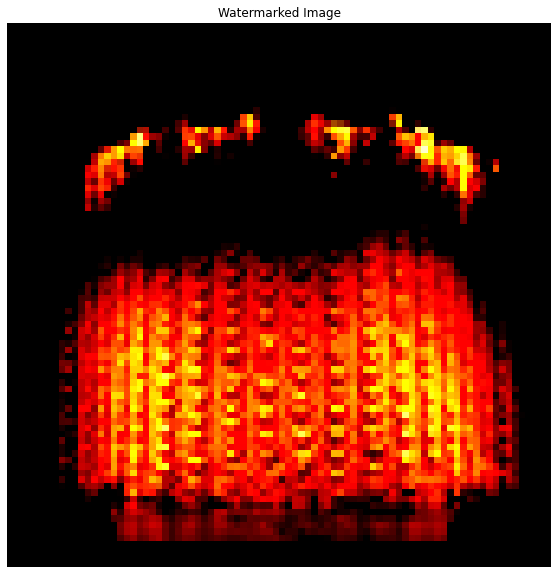

  9%|▉         | 1/11 [00:08<01:21,  8.11s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 15: Target opacity: 0, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: True, Base class predicted: False


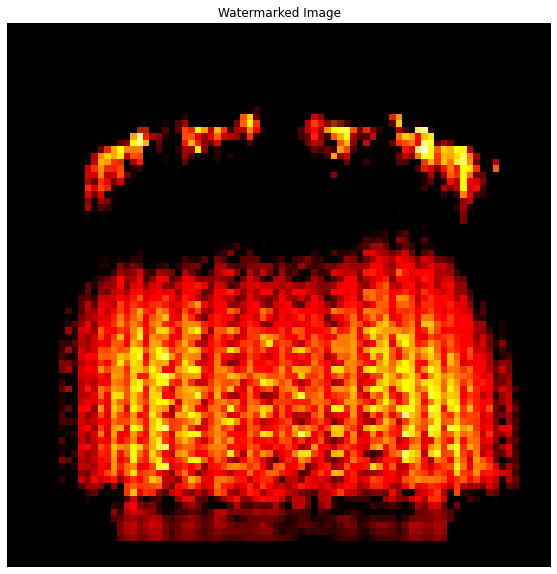

 18%|█▊        | 2/11 [00:16<01:13,  8.15s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 15: Target opacity: 0.05, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: True, Base class predicted: False


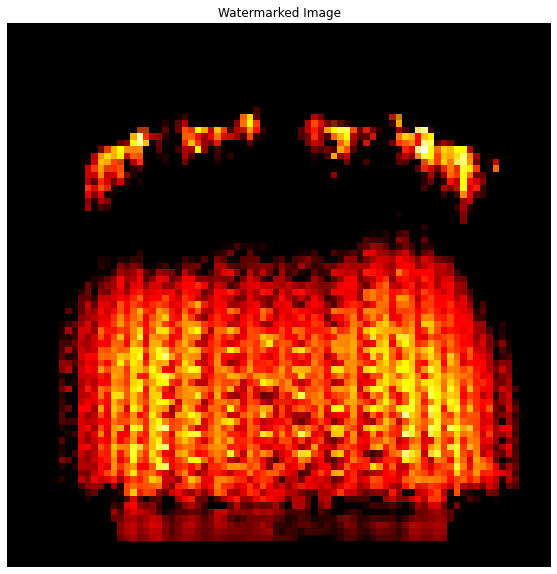

 27%|██▋       | 3/11 [00:24<01:04,  8.07s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 15: Target opacity: 0.1, Labeled correctly: 0.5733333333333334, Correctly Predicted Target: True, Base class predicted: False


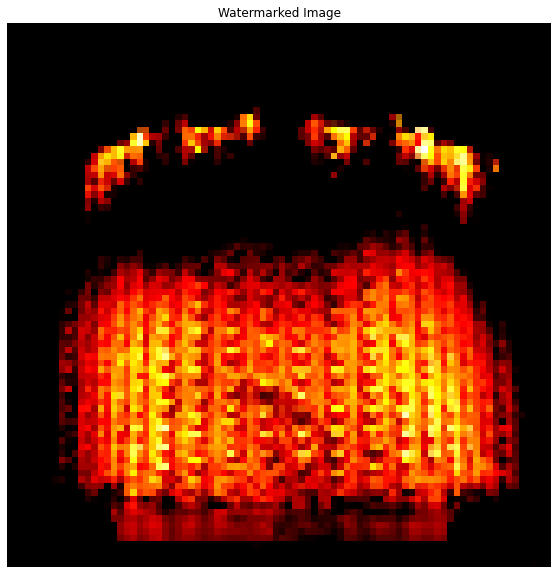

 36%|███▋      | 4/11 [00:32<00:56,  8.10s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 15: Target opacity: 0.15, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: True, Base class predicted: False


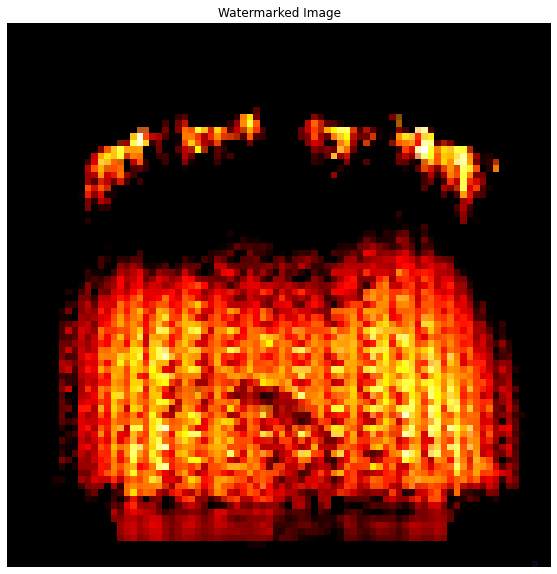

 45%|████▌     | 5/11 [00:40<00:48,  8.08s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 15: Target opacity: 0.2, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: True, Base class predicted: False


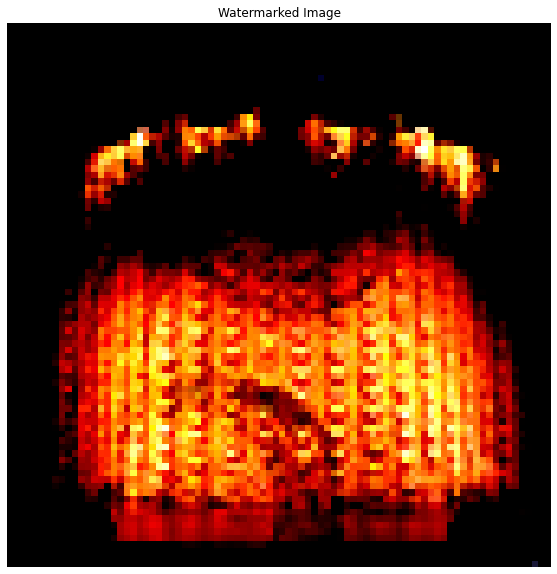

 55%|█████▍    | 6/11 [00:48<00:40,  8.07s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 15: Target opacity: 0.25, Labeled correctly: 0.6, Correctly Predicted Target: True, Base class predicted: False


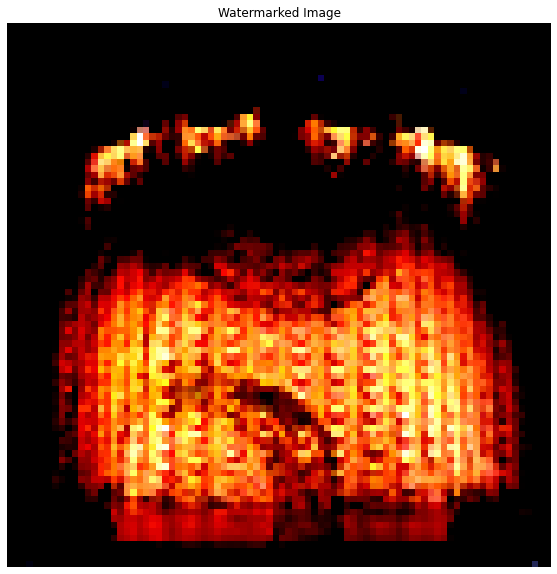

 64%|██████▎   | 7/11 [00:56<00:32,  8.03s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 15: Target opacity: 0.3, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: True, Base class predicted: False


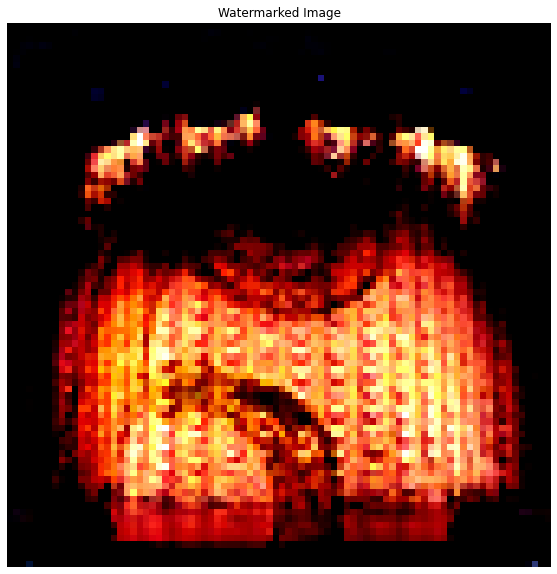

 73%|███████▎  | 8/11 [01:04<00:24,  8.06s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 15: Target opacity: 0.35, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: True, Base class predicted: False


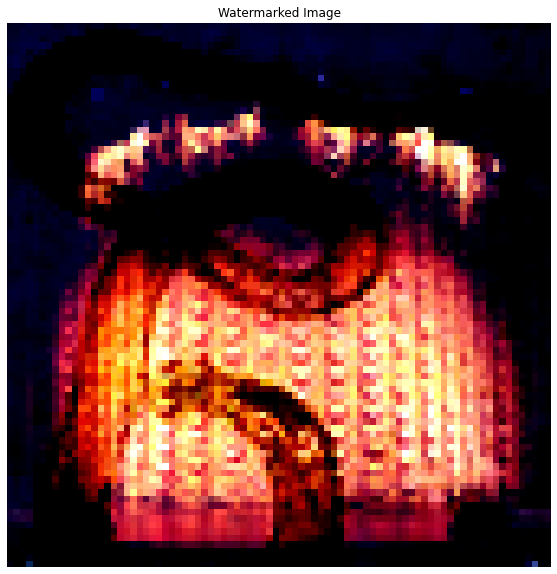

 82%|████████▏ | 9/11 [01:12<00:16,  8.04s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 15: Target opacity: 0.4, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: True, Base class predicted: False


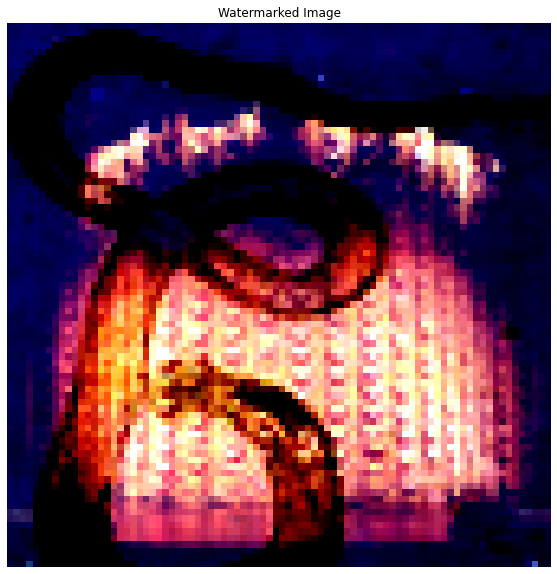

 91%|█████████ | 10/11 [01:20<00:08,  8.05s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 15: Target opacity: 0.45, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: True, Base class predicted: False


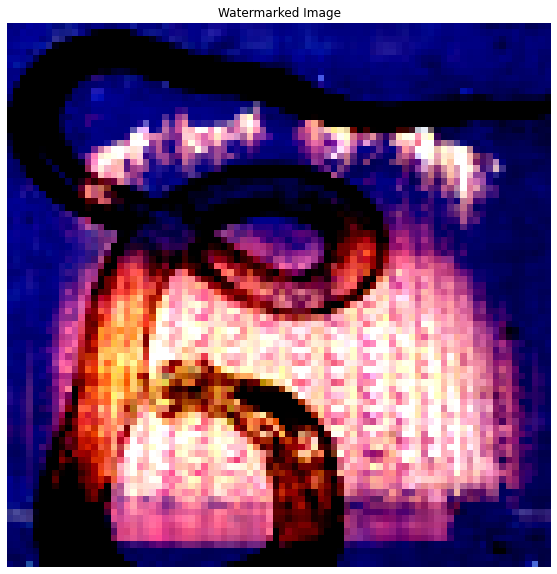

100%|██████████| 11/11 [01:28<00:00,  8.06s/it]

Iteration 15: Target opacity: 0.5, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: True, Base class predicted: False



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


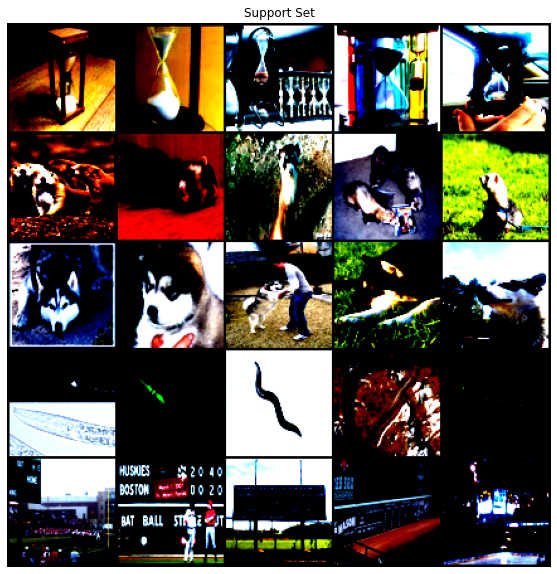

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 4, 4, 4, 4, 4, 2, 2, 2, 2, 2, 0, 0, 0, 0,
         0]])


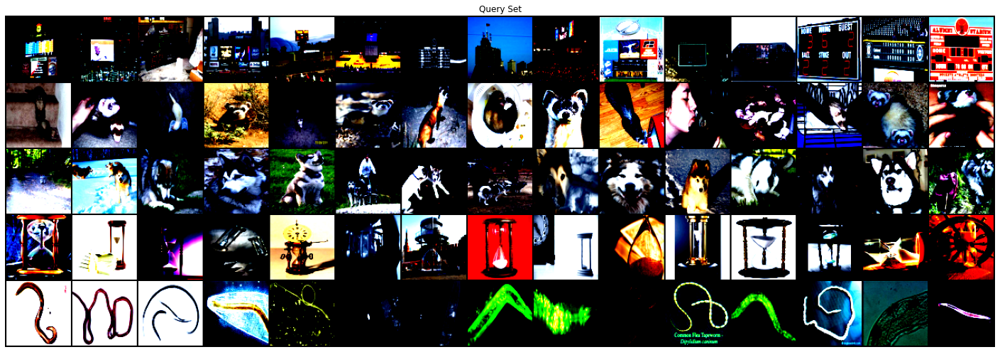

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1,
         1, 1, 1, 1, 1, 1, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 3, 3, 3,
         3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
         2, 2, 2]])
target_class 0
unique_classes [1, 2, 3, 4]
base_class 4
target_indices [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14]
target_index 13
base_indices [10 11 12 13 14]
base_index 11


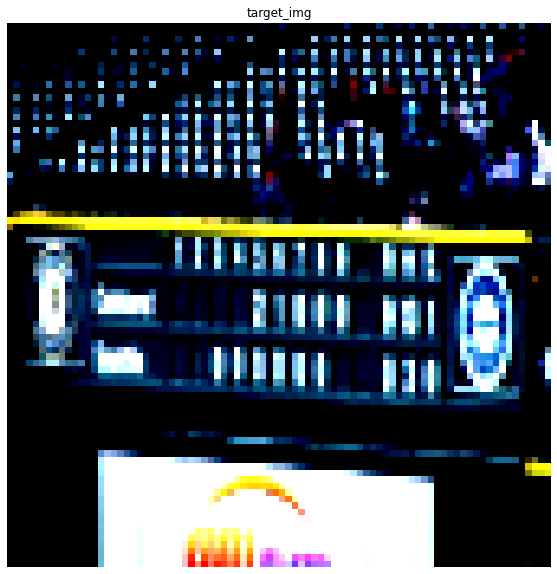

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


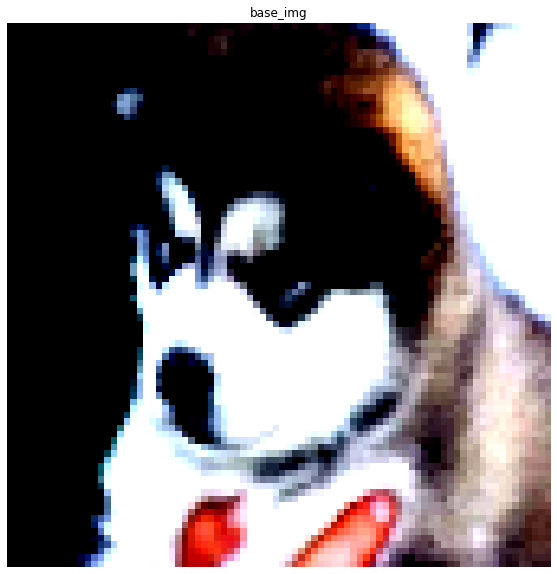

  0%|          | 3/1000 [00:00<00:35, 28.13it/s]

Iteration 0
loss: tensor(0.0952, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(94.8546, grad_fn=<PowBackward0>)
Iteration 2
loss: tensor(12.7729, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(5.6300, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(31.1944, grad_fn=<PowBackward0>)
Iteration 5


  1%|          | 9/1000 [00:00<00:40, 24.70it/s]

loss: tensor(54.9106, grad_fn=<PowBackward0>)
Iteration 6
loss: tensor(13.9810, grad_fn=<PowBackward0>)
Iteration 7
loss: tensor(32.2778, grad_fn=<PowBackward0>)
Iteration 8
loss: tensor(21.7949, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(50.7957, grad_fn=<PowBackward0>)
Iteration 10
loss: tensor(33.5779, grad_fn=<PowBackward0>)


  2%|▏         | 15/1000 [00:00<00:38, 25.30it/s]

Iteration 11
loss: tensor(7.7013, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(21.8337, grad_fn=<PowBackward0>)
Iteration 13
loss: tensor(85.8503, grad_fn=<PowBackward0>)
Iteration 14
loss: tensor(21.2672, grad_fn=<PowBackward0>)
Iteration 15
loss: tensor(32.5768, grad_fn=<PowBackward0>)
Iteration 16


  2%|▏         | 21/1000 [00:00<00:37, 25.99it/s]

loss: tensor(31.5272, grad_fn=<PowBackward0>)
Iteration 17
loss: tensor(40.1032, grad_fn=<PowBackward0>)
Iteration 18
loss: tensor(10.8394, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(15.7772, grad_fn=<PowBackward0>)
Iteration 20
loss: tensor(30.3367, grad_fn=<PowBackward0>)
Iteration 21


  2%|▏         | 24/1000 [00:00<00:38, 25.13it/s]

loss: tensor(54.2169, grad_fn=<PowBackward0>)
Iteration 22
loss: tensor(11.4828, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(28.8644, grad_fn=<PowBackward0>)
Iteration 24
loss: tensor(18.8937, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(73.4952, grad_fn=<PowBackward0>)
Iteration 26
loss: tensor(26.9929, grad_fn=<PowBackward0>)


  3%|▎         | 30/1000 [00:01<00:36, 26.23it/s]

Iteration 27
loss: tensor(25.5880, grad_fn=<PowBackward0>)
Iteration 28
loss: tensor(18.5981, grad_fn=<PowBackward0>)
Iteration 29
loss: tensor(75.5350, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(31.7213, grad_fn=<PowBackward0>)
Iteration 31
loss: tensor(33.3074, grad_fn=<PowBackward0>)
Iteration 32
loss: tensor(25.2128, grad_fn=<PowBackward0>)


  4%|▎         | 36/1000 [00:01<00:37, 25.58it/s]

Iteration 33
loss: tensor(45.5532, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(33.9519, grad_fn=<PowBackward0>)
Iteration 35
loss: tensor(12.0597, grad_fn=<PowBackward0>)
Iteration 36
loss: tensor(31.2024, grad_fn=<PowBackward0>)
Iteration 37
loss: tensor(43.2917, grad_fn=<PowBackward0>)
Iteration 38


  4%|▍         | 42/1000 [00:01<00:36, 26.08it/s]

loss: tensor(18.6200, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(32.8780, grad_fn=<PowBackward0>)
Iteration 40
loss: tensor(11.3465, grad_fn=<PowBackward0>)
Iteration 41
loss: tensor(14.6267, grad_fn=<PowBackward0>)
Iteration 42
loss: tensor(34.4023, grad_fn=<PowBackward0>)
Iteration 43
loss: tensor(35.9041, grad_fn=<PowBackward0>)
Iteration

  5%|▍         | 48/1000 [00:01<00:36, 26.42it/s]

 44
loss: tensor(20.6514, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(41.2183, grad_fn=<PowBackward0>)
Iteration 46
loss: tensor(21.7542, grad_fn=<PowBackward0>)
Iteration 47
loss: tensor(10.5184, grad_fn=<PowBackward0>)
Iteration 48
loss: tensor(35.0999, grad_fn=<PowBackward0>)
Iteration 49
loss: tensor(47.4220, grad_fn=<PowBackward0>)

  5%|▌         | 54/1000 [00:02<00:35, 26.32it/s]


Iteration 50
loss: tensor(25.0262, grad_fn=<PowBackward0>)
Iteration 51
loss: tensor(37.3543, grad_fn=<PowBackward0>)
Iteration 52
loss: tensor(37.0872, grad_fn=<PowBackward0>)
Iteration 53
loss: tensor(42.4579, grad_fn=<PowBackward0>)
Iteration 54
loss: tensor(17.9316, grad_fn=<PowBackward0>)


  6%|▌         | 60/1000 [00:02<00:35, 26.44it/s]

Iteration 55
loss: tensor(33.9213, grad_fn=<PowBackward0>)
Iteration 56
loss: tensor(15.8044, grad_fn=<PowBackward0>)
Iteration 57
loss: tensor(19.5184, grad_fn=<PowBackward0>)
Iteration 58
loss: tensor(19.0335, grad_fn=<PowBackward0>)
Iteration 59
loss: tensor(10.8864, grad_fn=<PowBackward0>)
Iteration 60


  6%|▋         | 63/1000 [00:02<00:36, 25.65it/s]

loss: tensor(53.8634, grad_fn=<PowBackward0>)
Iteration 61
loss: tensor(31.6481, grad_fn=<PowBackward0>)
Iteration 62
loss: tensor(36.1470, grad_fn=<PowBackward0>)
Iteration 63
loss: tensor(24.6964, grad_fn=<PowBackward0>)
Iteration 64
loss: tensor(23.3497, grad_fn=<PowBackward0>)
Iteration 65


  7%|▋         | 69/1000 [00:02<00:37, 24.79it/s]

loss: tensor(57.5606, grad_fn=<PowBackward0>)
Iteration 66
loss: tensor(29.2052, grad_fn=<PowBackward0>)
Iteration 67
loss: tensor(51.5273, grad_fn=<PowBackward0>)
Iteration 68
loss: tensor(21.0899, grad_fn=<PowBackward0>)
Iteration 69
loss: tensor(35.0333, grad_fn=<PowBackward0>)
Iteration 70
loss: tensor(24.2330, grad_fn=<PowBackward0>)


  8%|▊         | 75/1000 [00:02<00:36, 25.03it/s]

Iteration 71
loss: tensor(22.0848, grad_fn=<PowBackward0>)
Iteration 72
loss: tensor(25.7969, grad_fn=<PowBackward0>)
Iteration 73
loss: tensor(49.5769, grad_fn=<PowBackward0>)
Iteration 74
loss: tensor(21.0305, grad_fn=<PowBackward0>)
Iteration 75
loss: tensor(38.7279, grad_fn=<PowBackward0>)
Iteration

  8%|▊         | 81/1000 [00:03<00:36, 25.48it/s]

 76
loss: tensor(30.5796, grad_fn=<PowBackward0>)
Iteration 77
loss: tensor(38.4414, grad_fn=<PowBackward0>)
Iteration 78
loss: tensor(14.6773, grad_fn=<PowBackward0>)
Iteration 79
loss: tensor(32.7695, grad_fn=<PowBackward0>)
Iteration 80
loss: tensor(31.7924, grad_fn=<PowBackward0>)
Iteration 81


  8%|▊         | 84/1000 [00:03<00:36, 25.20it/s]

loss: tensor(39.4123, grad_fn=<PowBackward0>)
Iteration 82
loss: tensor(25.8396, grad_fn=<PowBackward0>)
Iteration 83
loss: tensor(37.7657, grad_fn=<PowBackward0>)
Iteration 84
loss: tensor(16.0549, grad_fn=<PowBackward0>)
Iteration 85
loss: tensor(41.1944, grad_fn=<PowBackward0>)
Iteration 86
loss: tensor(28.5311, grad_fn=<PowBackward0>)


  9%|▉         | 90/1000 [00:03<00:35, 25.50it/s]

Iteration 87
loss: tensor(42.5978, grad_fn=<PowBackward0>)
Iteration 88
loss: tensor(7.3604, grad_fn=<PowBackward0>)
Iteration 89
loss: tensor(37.7199, grad_fn=<PowBackward0>)
Iteration 90
loss: tensor(49.6100, grad_fn=<PowBackward0>)
Iteration 91
loss: tensor(16.6854, grad_fn=<PowBackward0>)
Iteration 92


 10%|▉         | 96/1000 [00:03<00:35, 25.51it/s]

loss: tensor(19.4243, grad_fn=<PowBackward0>)
Iteration 93
loss: tensor(18.2199, grad_fn=<PowBackward0>)
Iteration 94
loss: tensor(21.1023, grad_fn=<PowBackward0>)
Iteration 95
loss: tensor(20.1190, grad_fn=<PowBackward0>)
Iteration 96
loss: tensor(34.0038, grad_fn=<PowBackward0>)
Iteration 97
loss: tensor(34.0214, grad_fn=<PowBackward0>)


 10%|█         | 102/1000 [00:04<00:34, 25.67it/s]

Iteration 98
loss: tensor(29.9693, grad_fn=<PowBackward0>)
Iteration 99
loss: tensor(52.3661, grad_fn=<PowBackward0>)
Iteration 100
loss: tensor(27.7293, grad_fn=<PowBackward0>)
Iteration 101
loss: tensor(32.7519, grad_fn=<PowBackward0>)
Iteration 102
loss: tensor(5.6431, grad_fn=<PowBackward0>)
Iteration 103


 11%|█         | 108/1000 [00:04<00:35, 25.23it/s]

loss: tensor(18.2250, grad_fn=<PowBackward0>)
Iteration 104
loss: tensor(29.0513, grad_fn=<PowBackward0>)
Iteration 105
loss: tensor(41.7833, grad_fn=<PowBackward0>)
Iteration 106
loss: tensor(16.4294, grad_fn=<PowBackward0>)
Iteration 107
loss: tensor(28.5913, grad_fn=<PowBackward0>)
Iteration 108


 11%|█         | 111/1000 [00:04<00:36, 24.07it/s]

loss: tensor(12.0185, grad_fn=<PowBackward0>)
Iteration 109
loss: tensor(40.5851, grad_fn=<PowBackward0>)
Iteration 110
loss: tensor(32.3442, grad_fn=<PowBackward0>)
Iteration 111
loss: tensor(33.3982, grad_fn=<PowBackward0>)
Iteration 112
loss: tensor(16.2860, grad_fn=<PowBackward0>)
Iteration 113
loss: tensor(46.2045, grad_fn=<PowBackward0>)

 12%|█▏        | 117/1000 [00:04<00:35, 24.83it/s]


Iteration 114
loss: tensor(27.0420, grad_fn=<PowBackward0>)
Iteration 115
loss: tensor(29.2193, grad_fn=<PowBackward0>)
Iteration 116
loss: tensor(23.3852, grad_fn=<PowBackward0>)
Iteration 117
loss: tensor(37.1354, grad_fn=<PowBackward0>)
Iteration 118


 12%|█▏        | 123/1000 [00:04<00:36, 24.14it/s]

loss: tensor(25.9401, grad_fn=<PowBackward0>)
Iteration 119
loss: tensor(27.7251, grad_fn=<PowBackward0>)
Iteration 120
loss: tensor(12.2748, grad_fn=<PowBackward0>)
Iteration 121
loss: tensor(37.1533, grad_fn=<PowBackward0>)
Iteration 122
loss: tensor(25.3209, grad_fn=<PowBackward0>)
Iteration 123


 13%|█▎        | 126/1000 [00:04<00:35, 24.37it/s]

loss: tensor(53.9319, grad_fn=<PowBackward0>)
Iteration 124
loss: tensor(32.8157, grad_fn=<PowBackward0>)
Iteration 125
loss: tensor(44.1150, grad_fn=<PowBackward0>)
Iteration 126
loss: tensor(35.1447, grad_fn=<PowBackward0>)
Iteration 127
loss: tensor(15.7218, grad_fn=<PowBackward0>)
Iteration 128
loss: tensor(23.9958, grad_fn=<PowBackward0>)


 13%|█▎        | 132/1000 [00:05<00:35, 24.22it/s]

Iteration 129
loss: tensor(46.7826, grad_fn=<PowBackward0>)
Iteration 130
loss: tensor(31.3802, grad_fn=<PowBackward0>)
Iteration 131
loss: tensor(26.0223, grad_fn=<PowBackward0>)
Iteration 132
loss: tensor(10.8484, grad_fn=<PowBackward0>)
Iteration 133
loss: tensor(47.9464, grad_fn=<PowBackward0>)
Iteration 134


 14%|█▍        | 138/1000 [00:05<00:34, 24.96it/s]

loss: tensor(15.9850, grad_fn=<PowBackward0>)
Iteration 135
loss: tensor(9.8874, grad_fn=<PowBackward0>)
Iteration 136
loss: tensor(42.4928, grad_fn=<PowBackward0>)
Iteration 137
loss: tensor(66.7162, grad_fn=<PowBackward0>)
Iteration 138
loss: tensor(33.6415, grad_fn=<PowBackward0>)
Iteration 139
loss: tensor(25.4106, grad_fn=<PowBackward0>)


 14%|█▍        | 144/1000 [00:05<00:33, 25.27it/s]

Iteration 140
loss: tensor(22.7181, grad_fn=<PowBackward0>)
Iteration 141
loss: tensor(55.2274, grad_fn=<PowBackward0>)
Iteration 142
loss: tensor(7.4647, grad_fn=<PowBackward0>)
Iteration 143
loss: tensor(21.1808, grad_fn=<PowBackward0>)
Iteration 144
loss: tensor(32.4362, grad_fn=<PowBackward0>)
Iteration 145


 15%|█▌        | 150/1000 [00:05<00:35, 23.99it/s]

loss: tensor(30.7233, grad_fn=<PowBackward0>)
Iteration 146
loss: tensor(28.9010, grad_fn=<PowBackward0>)
Iteration 147
loss: tensor(28.2226, grad_fn=<PowBackward0>)
Iteration 148
loss: tensor(14.9049, grad_fn=<PowBackward0>)
Iteration 149
loss: tensor(32.5541, grad_fn=<PowBackward0>)
Iteration 150


 16%|█▌        | 156/1000 [00:06<00:33, 25.44it/s]

loss: tensor(31.3038, grad_fn=<PowBackward0>)
Iteration 151
loss: tensor(60.0528, grad_fn=<PowBackward0>)
Iteration 152
loss: tensor(29.3141, grad_fn=<PowBackward0>)
Iteration 153
loss: tensor(43.6536, grad_fn=<PowBackward0>)
Iteration 154
loss: tensor(17.2361, grad_fn=<PowBackward0>)
Iteration 155
loss: tensor(27.5932, grad_fn=<PowBackward0>)


 16%|█▌        | 159/1000 [00:06<00:33, 25.21it/s]

Iteration 156
loss: tensor(30.9458, grad_fn=<PowBackward0>)
Iteration 157
loss: tensor(26.8595, grad_fn=<PowBackward0>)
Iteration 158
loss: tensor(9.7893, grad_fn=<PowBackward0>)
Iteration 159
loss: tensor(30.3174, grad_fn=<PowBackward0>)
Iteration 160
loss: tensor(38.6667, grad_fn=<PowBackward0>)
Iteration 161


 16%|█▋        | 165/1000 [00:06<00:32, 25.43it/s]

loss: tensor(52.5233, grad_fn=<PowBackward0>)
Iteration 162
loss: tensor(20.2735, grad_fn=<PowBackward0>)
Iteration 163
loss: tensor(25.4235, grad_fn=<PowBackward0>)
Iteration 164
loss: tensor(31.2238, grad_fn=<PowBackward0>)
Iteration 165
loss: tensor(29.1164, grad_fn=<PowBackward0>)
Iteration 166
loss: 

 17%|█▋        | 171/1000 [00:06<00:32, 25.40it/s]

tensor(17.8491, grad_fn=<PowBackward0>)
Iteration 167
loss: tensor(36.1067, grad_fn=<PowBackward0>)
Iteration 168
loss: tensor(23.2102, grad_fn=<PowBackward0>)
Iteration 169
loss: tensor(17.2273, grad_fn=<PowBackward0>)
Iteration 170
loss: tensor(13.8542, grad_fn=<PowBackward0>)
Iteration 171
loss: tensor(38.2461, grad_fn=<PowBackward0>)
Iteration 172


 18%|█▊        | 177/1000 [00:07<00:31, 26.27it/s]

loss: tensor(24.3963, grad_fn=<PowBackward0>)
Iteration 173
loss: tensor(51.7553, grad_fn=<PowBackward0>)
Iteration 174
loss: tensor(14.6920, grad_fn=<PowBackward0>)
Iteration 175
loss: tensor(49.1447, grad_fn=<PowBackward0>)
Iteration 176
loss: tensor(11.6345, grad_fn=<PowBackward0>)
Iteration 177
loss: tensor(23.5433, grad_fn=<PowBackward0>)


 18%|█▊        | 183/1000 [00:07<00:31, 25.93it/s]

Iteration 178
loss: tensor(50.3627, grad_fn=<PowBackward0>)
Iteration 179
loss: tensor(44.9291, grad_fn=<PowBackward0>)
Iteration 180
loss: tensor(14.7075, grad_fn=<PowBackward0>)
Iteration 181
loss: tensor(9.6299, grad_fn=<PowBackward0>)
Iteration 182
loss: tensor(43.8149, grad_fn=<PowBackward0>)
Iteration 183

 19%|█▊        | 186/1000 [00:07<00:31, 25.60it/s]


loss: tensor(24.4146, grad_fn=<PowBackward0>)
Iteration 184
loss: tensor(19.1395, grad_fn=<PowBackward0>)
Iteration 185
loss: tensor(30.7072, grad_fn=<PowBackward0>)
Iteration 186
loss: tensor(26.5553, grad_fn=<PowBackward0>)
Iteration 187
loss: tensor(42.9595, grad_fn=<PowBackward0>)
Iteration 188


 19%|█▉        | 192/1000 [00:07<00:32, 24.50it/s]

loss: tensor(31.2126, grad_fn=<PowBackward0>)
Iteration 189
loss: tensor(36.8309, grad_fn=<PowBackward0>)
Iteration 190
loss: tensor(17.2408, grad_fn=<PowBackward0>)
Iteration 191
loss: tensor(39.7355, grad_fn=<PowBackward0>)
Iteration 192
loss: tensor(22.7199, grad_fn=<PowBackward0>)


 20%|█▉        | 198/1000 [00:07<00:31, 25.07it/s]

Iteration 193
loss: tensor(41.7322, grad_fn=<PowBackward0>)
Iteration 194
loss: tensor(25.9637, grad_fn=<PowBackward0>)
Iteration 195
loss: tensor(15.9641, grad_fn=<PowBackward0>)
Iteration 196
loss: tensor(33.4724, grad_fn=<PowBackward0>)
Iteration 197
loss: tensor(25.2360, grad_fn=<PowBackward0>)
Iteration 198


 20%|██        | 201/1000 [00:07<00:31, 25.07it/s]

loss: tensor(11.9421, grad_fn=<PowBackward0>)
Iteration 199
loss: tensor(43.0792, grad_fn=<PowBackward0>)
Iteration 200
loss: tensor(16.1124, grad_fn=<PowBackward0>)
Iteration 201
loss: tensor(30.9978, grad_fn=<PowBackward0>)
Iteration 202
loss: tensor(6.2657, grad_fn=<PowBackward0>)
Iteration 203
loss: tensor(16.9200, grad_fn=<PowBackward0>)


 21%|██        | 207/1000 [00:08<00:34, 23.22it/s]

Iteration 204
loss: tensor(17.3631, grad_fn=<PowBackward0>)
Iteration 205
loss: tensor(31.6808, grad_fn=<PowBackward0>)
Iteration 206
loss: tensor(21.0516, grad_fn=<PowBackward0>)
Iteration 207
loss: tensor(45.7734, grad_fn=<PowBackward0>)
Iteration 208
loss: tensor(23.7584, grad_fn=<PowBackward0>)


 21%|██▏       | 213/1000 [00:08<00:31, 24.85it/s]

Iteration 209
loss: tensor(20.3783, grad_fn=<PowBackward0>)
Iteration 210
loss: tensor(12.4460, grad_fn=<PowBackward0>)
Iteration 211
loss: tensor(20.1673, grad_fn=<PowBackward0>)
Iteration 212
loss: tensor(20.4377, grad_fn=<PowBackward0>)
Iteration 213
loss: tensor(29.0609, grad_fn=<PowBackward0>)
Iteration 214
loss:

 22%|██▏       | 219/1000 [00:08<00:30, 25.32it/s]

 tensor(26.5722, grad_fn=<PowBackward0>)
Iteration 215
loss: tensor(15.2767, grad_fn=<PowBackward0>)
Iteration 216
loss: tensor(11.0420, grad_fn=<PowBackward0>)
Iteration 217
loss: tensor(16.2988, grad_fn=<PowBackward0>)
Iteration 218
loss: tensor(21.7644, grad_fn=<PowBackward0>)
Iteration 219
loss: tensor(14.6989, grad_fn=<PowBackward0>)


 22%|██▎       | 225/1000 [00:08<00:30, 25.29it/s]

Iteration 220
loss: tensor(21.5208, grad_fn=<PowBackward0>)
Iteration 221
loss: tensor(28.1611, grad_fn=<PowBackward0>)
Iteration 222
loss: tensor(21.7582, grad_fn=<PowBackward0>)
Iteration 223
loss: tensor(38.5109, grad_fn=<PowBackward0>)
Iteration 224
loss: tensor(16.8662, grad_fn=<PowBackward0>)
Iteration 225


 23%|██▎       | 228/1000 [00:09<00:31, 24.80it/s]

loss: tensor(20.7764, grad_fn=<PowBackward0>)
Iteration 226
loss: tensor(5.2835, grad_fn=<PowBackward0>)
Iteration 227
loss: tensor(8.0712, grad_fn=<PowBackward0>)
Iteration 228
loss: tensor(16.2315, grad_fn=<PowBackward0>)
Iteration 229
loss: tensor(18.6097, grad_fn=<PowBackward0>)
Iteration 230
loss: tensor(21.4020, grad_fn=<PowBackward0>)


 23%|██▎       | 234/1000 [00:09<00:30, 25.01it/s]

Iteration 231
loss: tensor(21.8274, grad_fn=<PowBackward0>)
Iteration 232
loss: tensor(13.9505, grad_fn=<PowBackward0>)
Iteration 233
loss: tensor(20.4210, grad_fn=<PowBackward0>)
Iteration 234
loss: tensor(13.8076, grad_fn=<PowBackward0>)
Iteration 235
loss: tensor(21.1172, grad_fn=<PowBackward0>)
Iteration 236


 24%|██▍       | 240/1000 [00:09<00:29, 26.16it/s]

loss: tensor(20.7554, grad_fn=<PowBackward0>)
Iteration 237
loss: tensor(20.3450, grad_fn=<PowBackward0>)
Iteration 238
loss: tensor(22.1488, grad_fn=<PowBackward0>)
Iteration 239
loss: tensor(10.6241, grad_fn=<PowBackward0>)
Iteration 240
loss: tensor(31.1640, grad_fn=<PowBackward0>)
Iteration 241
loss: tensor(24.7361, grad_fn=<PowBackward0>)
Iteration 242

 25%|██▍       | 246/1000 [00:09<00:29, 25.41it/s]


loss: tensor(19.2745, grad_fn=<PowBackward0>)
Iteration 243
loss: tensor(20.7950, grad_fn=<PowBackward0>)
Iteration 244
loss: tensor(16.2696, grad_fn=<PowBackward0>)
Iteration 245
loss: tensor(19.8214, grad_fn=<PowBackward0>)
Iteration 246
loss: tensor(42.8002, grad_fn=<PowBackward0>)
Iteration 247


 25%|██▌       | 252/1000 [00:09<00:28, 26.51it/s]

loss: tensor(54.1357, grad_fn=<PowBackward0>)
Iteration 248
loss: tensor(31.8521, grad_fn=<PowBackward0>)
Iteration 249
loss: tensor(20.3153, grad_fn=<PowBackward0>)
Iteration 250
loss: tensor(16.4828, grad_fn=<PowBackward0>)
Iteration 251
loss: tensor(23.9195, grad_fn=<PowBackward0>)
Iteration 252
loss: tensor(21.6847, grad_fn=<PowBackward0>)
Iteration 

 26%|██▌       | 258/1000 [00:10<00:27, 26.69it/s]

253
loss: tensor(33.1531, grad_fn=<PowBackward0>)
Iteration 254
loss: tensor(32.1037, grad_fn=<PowBackward0>)
Iteration 255
loss: tensor(31.2108, grad_fn=<PowBackward0>)
Iteration 256
loss: tensor(25.0565, grad_fn=<PowBackward0>)
Iteration 257
loss: tensor(19.0108, grad_fn=<PowBackward0>)
Iteration 258


 26%|██▌       | 261/1000 [00:10<00:27, 26.79it/s]

loss: tensor(14.6707, grad_fn=<PowBackward0>)
Iteration 259
loss: tensor(22.5081, grad_fn=<PowBackward0>)
Iteration 260
loss: tensor(15.9288, grad_fn=<PowBackward0>)
Iteration 261
loss: tensor(27.7581, grad_fn=<PowBackward0>)
Iteration 262
loss: tensor(33.2112, grad_fn=<PowBackward0>)
Iteration 263
loss: tensor(27.6660, grad_fn=<PowBackward0>)


 27%|██▋       | 267/1000 [00:10<00:28, 26.14it/s]

Iteration 264
loss: tensor(11.2010, grad_fn=<PowBackward0>)
Iteration 265
loss: tensor(27.7052, grad_fn=<PowBackward0>)
Iteration 266
loss: tensor(22.5497, grad_fn=<PowBackward0>)
Iteration 267
loss: tensor(30.0665, grad_fn=<PowBackward0>)
Iteration 268
loss: tensor(24.0836, grad_fn=<PowBackward0>)
Iteration 269


 27%|██▋       | 273/1000 [00:10<00:28, 25.68it/s]

loss: tensor(16.8349, grad_fn=<PowBackward0>)
Iteration 270
loss: tensor(13.1360, grad_fn=<PowBackward0>)
Iteration 271
loss: tensor(37.4505, grad_fn=<PowBackward0>)
Iteration 272
loss: tensor(12.3574, grad_fn=<PowBackward0>)
Iteration 273
loss: tensor(26.9733, grad_fn=<PowBackward0>)
Iteration 274
loss:

 28%|██▊       | 279/1000 [00:11<00:28, 25.19it/s]

 tensor(18.2873, grad_fn=<PowBackward0>)
Iteration 275
loss: tensor(34.1535, grad_fn=<PowBackward0>)
Iteration 276
loss: tensor(21.8991, grad_fn=<PowBackward0>)
Iteration 277
loss: tensor(31.3540, grad_fn=<PowBackward0>)
Iteration 278
loss: tensor(18.9069, grad_fn=<PowBackward0>)
Iteration 279
loss:

 28%|██▊       | 282/1000 [00:11<00:28, 25.27it/s]

 tensor(29.0813, grad_fn=<PowBackward0>)
Iteration 280
loss: tensor(11.9495, grad_fn=<PowBackward0>)
Iteration 281
loss: tensor(15.2412, grad_fn=<PowBackward0>)
Iteration 282
loss: tensor(9.2756, grad_fn=<PowBackward0>)
Iteration 283
loss: tensor(23.4535, grad_fn=<PowBackward0>)
Iteration 284
loss: tensor(27.9994, grad_fn=<PowBackward0>)


 29%|██▉       | 288/1000 [00:11<00:27, 25.58it/s]

Iteration 285
loss: tensor(37.3822, grad_fn=<PowBackward0>)
Iteration 286
loss: tensor(10.1405, grad_fn=<PowBackward0>)
Iteration 287
loss: tensor(15.9303, grad_fn=<PowBackward0>)
Iteration 288
loss: tensor(17.9344, grad_fn=<PowBackward0>)
Iteration 289
loss: tensor(28.4400, grad_fn=<PowBackward0>)
Iteration 290
loss: tensor(13.9033, grad_fn=<PowBackward0>)


 29%|██▉       | 294/1000 [00:11<00:26, 26.36it/s]

Iteration 291
loss: tensor(29.6771, grad_fn=<PowBackward0>)
Iteration 292
loss: tensor(19.4531, grad_fn=<PowBackward0>)
Iteration 293
loss: tensor(19.8086, grad_fn=<PowBackward0>)
Iteration 294
loss: tensor(14.8303, grad_fn=<PowBackward0>)
Iteration 295
loss: tensor(19.6339, grad_fn=<PowBackward0>)
Iteration 296
loss:

 30%|███       | 300/1000 [00:11<00:27, 25.69it/s]

 tensor(31.0033, grad_fn=<PowBackward0>)
Iteration 297
loss: tensor(27.5758, grad_fn=<PowBackward0>)
Iteration 298
loss: tensor(19.8380, grad_fn=<PowBackward0>)
Iteration 299
loss: tensor(33.0334, grad_fn=<PowBackward0>)
Iteration 300
loss: tensor(10.2184, grad_fn=<PowBackward0>)
Iteration 301
loss: tensor(20.1193, grad_fn=<PowBackward0>)

 31%|███       | 306/1000 [00:12<00:27, 25.69it/s]


Iteration 302
loss: tensor(6.7884, grad_fn=<PowBackward0>)
Iteration 303
loss: tensor(6.5876, grad_fn=<PowBackward0>)
Iteration 304
loss: tensor(4.4063, grad_fn=<PowBackward0>)
Iteration 305
loss: tensor(6.1629, grad_fn=<PowBackward0>)
Iteration 306
loss: tensor(13.0960, grad_fn=<PowBackward0>)
Iteration 307


 31%|███       | 312/1000 [00:12<00:26, 26.43it/s]

loss: tensor(13.3405, grad_fn=<PowBackward0>)
Iteration 308
loss: tensor(13.8184, grad_fn=<PowBackward0>)
Iteration 309
loss: tensor(15.5470, grad_fn=<PowBackward0>)
Iteration 310
loss: tensor(9.2050, grad_fn=<PowBackward0>)
Iteration 311
loss: tensor(9.0146, grad_fn=<PowBackward0>)
Iteration 312
loss: tensor(5.5771, grad_fn=<PowBackward0>)


 32%|███▏      | 318/1000 [00:12<00:26, 25.78it/s]

Iteration 313
loss: tensor(5.6451, grad_fn=<PowBackward0>)
Iteration 314
loss: tensor(8.2303, grad_fn=<PowBackward0>)
Iteration 315
loss: tensor(10.1101, grad_fn=<PowBackward0>)
Iteration 316
loss: tensor(10.2660, grad_fn=<PowBackward0>)
Iteration 317
loss: tensor(7.0719, grad_fn=<PowBackward0>)
Iteration 318


 32%|███▏      | 321/1000 [00:12<00:26, 25.44it/s]

loss: tensor(9.2057, grad_fn=<PowBackward0>)
Iteration 319
loss: tensor(14.1955, grad_fn=<PowBackward0>)
Iteration 320
loss: tensor(8.8211, grad_fn=<PowBackward0>)
Iteration 321
loss: tensor(4.7000, grad_fn=<PowBackward0>)
Iteration 322
loss: tensor(2.5627, grad_fn=<PowBackward0>)
Iteration 323


 33%|███▎      | 327/1000 [00:12<00:26, 25.16it/s]

loss: tensor(1.8134, grad_fn=<PowBackward0>)
Iteration 324
loss: tensor(3.8439, grad_fn=<PowBackward0>)
Iteration 325
loss: tensor(6.9531, grad_fn=<PowBackward0>)
Iteration 326
loss: tensor(11.9553, grad_fn=<PowBackward0>)
Iteration 327
loss: tensor(12.2665, grad_fn=<PowBackward0>)
Iteration 328
loss: tensor(6.5091, grad_fn=<PowBackward0>)


 33%|███▎      | 333/1000 [00:13<00:25, 25.66it/s]

Iteration 329
loss: tensor(4.5092, grad_fn=<PowBackward0>)
Iteration 330
loss: tensor(5.3747, grad_fn=<PowBackward0>)
Iteration 331
loss: tensor(11.9751, grad_fn=<PowBackward0>)
Iteration 332
loss: tensor(14.7226, grad_fn=<PowBackward0>)
Iteration 333
loss: tensor(12.8931, grad_fn=<PowBackward0>)
Iteration 334


 34%|███▍      | 339/1000 [00:13<00:25, 25.74it/s]

loss: tensor(9.4036, grad_fn=<PowBackward0>)
Iteration 335
loss: tensor(4.1060, grad_fn=<PowBackward0>)
Iteration 336
loss: tensor(5.7527, grad_fn=<PowBackward0>)
Iteration 337
loss: tensor(7.2695, grad_fn=<PowBackward0>)
Iteration 338
loss: tensor(7.4725, grad_fn=<PowBackward0>)
Iteration 339
loss: tensor(8.2060, grad_fn=<PowBackward0>)


 34%|███▍      | 345/1000 [00:13<00:25, 26.19it/s]

Iteration 340
loss: tensor(12.6151, grad_fn=<PowBackward0>)
Iteration 341
loss: tensor(20.3264, grad_fn=<PowBackward0>)
Iteration 342
loss: tensor(9.6529, grad_fn=<PowBackward0>)
Iteration 343
loss: tensor(9.8571, grad_fn=<PowBackward0>)
Iteration 344
loss: tensor(9.5893, grad_fn=<PowBackward0>)
Iteration 345
loss:

 35%|███▍      | 348/1000 [00:13<00:25, 25.58it/s]

 tensor(4.7400, grad_fn=<PowBackward0>)
Iteration 346
loss: tensor(2.7344, grad_fn=<PowBackward0>)
Iteration 347
loss: tensor(9.1864, grad_fn=<PowBackward0>)
Iteration 348
loss: tensor(13.2822, grad_fn=<PowBackward0>)
Iteration 349
loss: tensor(15.4422, grad_fn=<PowBackward0>)
Iteration 350
loss: tensor(8.0357, grad_fn=<PowBackward0>)


 35%|███▌      | 354/1000 [00:13<00:24, 26.00it/s]

Iteration 351
loss: tensor(16.4603, grad_fn=<PowBackward0>)
Iteration 352
loss: tensor(16.6272, grad_fn=<PowBackward0>)
Iteration 353
loss: tensor(13.2937, grad_fn=<PowBackward0>)
Iteration 354
loss: tensor(7.6209, grad_fn=<PowBackward0>)
Iteration 355
loss: tensor(6.9520, grad_fn=<PowBackward0>)
Iteration 356


 36%|███▌      | 360/1000 [00:14<00:25, 25.08it/s]

loss: tensor(4.6703, grad_fn=<PowBackward0>)
Iteration 357
loss: tensor(4.9683, grad_fn=<PowBackward0>)
Iteration 358
loss: tensor(8.1314, grad_fn=<PowBackward0>)
Iteration 359
loss: tensor(17.1258, grad_fn=<PowBackward0>)
Iteration 360
loss: tensor(13.5756, grad_fn=<PowBackward0>)
Iteration 361


 37%|███▋      | 366/1000 [00:14<00:25, 25.11it/s]

loss: tensor(7.0478, grad_fn=<PowBackward0>)
Iteration 362
loss: tensor(7.1450, grad_fn=<PowBackward0>)
Iteration 363
loss: tensor(8.9651, grad_fn=<PowBackward0>)
Iteration 364
loss: tensor(8.1530, grad_fn=<PowBackward0>)
Iteration 365
loss: tensor(8.1896, grad_fn=<PowBackward0>)
Iteration 366
loss: tensor(10.3238, grad_fn=<PowBackward0>)


 37%|███▋      | 372/1000 [00:14<00:24, 25.29it/s]

Iteration 367
loss: tensor(6.8032, grad_fn=<PowBackward0>)
Iteration 368
loss: tensor(9.1630, grad_fn=<PowBackward0>)
Iteration 369
loss: tensor(15.4371, grad_fn=<PowBackward0>)
Iteration 370
loss: tensor(8.4373, grad_fn=<PowBackward0>)
Iteration 371
loss: tensor(5.7808, grad_fn=<PowBackward0>)
Iteration 372


 38%|███▊      | 375/1000 [00:14<00:24, 25.02it/s]

loss: tensor(6.8225, grad_fn=<PowBackward0>)
Iteration 373
loss: tensor(8.5858, grad_fn=<PowBackward0>)
Iteration 374
loss: tensor(13.8522, grad_fn=<PowBackward0>)
Iteration 375
loss: tensor(19.3879, grad_fn=<PowBackward0>)
Iteration 376
loss: tensor(5.9016, grad_fn=<PowBackward0>)
Iteration 377
loss: tensor(8.1988, grad_fn=<PowBackward0>)


 38%|███▊      | 381/1000 [00:15<00:24, 25.02it/s]

Iteration 378
loss: tensor(13.7936, grad_fn=<PowBackward0>)
Iteration 379
loss: tensor(11.4436, grad_fn=<PowBackward0>)
Iteration 380
loss: tensor(10.5384, grad_fn=<PowBackward0>)
Iteration 381
loss: tensor(11.9947, grad_fn=<PowBackward0>)
Iteration 382
loss: tensor(11.3066, grad_fn=<PowBackward0>)
Iteration 383


 39%|███▊      | 387/1000 [00:15<00:23, 25.55it/s]

loss: tensor(8.6568, grad_fn=<PowBackward0>)
Iteration 384
loss: tensor(8.2571, grad_fn=<PowBackward0>)
Iteration 385
loss: tensor(5.0733, grad_fn=<PowBackward0>)
Iteration 386
loss: tensor(6.1525, grad_fn=<PowBackward0>)
Iteration 387
loss: tensor(7.7538, grad_fn=<PowBackward0>)
Iteration 388
loss: tensor(7.7648, grad_fn=<PowBackward0>)


 39%|███▉      | 393/1000 [00:15<00:23, 25.64it/s]

Iteration 389
loss: tensor(11.9205, grad_fn=<PowBackward0>)
Iteration 390
loss: tensor(16.5189, grad_fn=<PowBackward0>)
Iteration 391
loss: tensor(12.5365, grad_fn=<PowBackward0>)
Iteration 392
loss: tensor(7.2029, grad_fn=<PowBackward0>)
Iteration 393
loss: tensor(4.6297, grad_fn=<PowBackward0>)
Iteration 394


 40%|███▉      | 399/1000 [00:15<00:23, 25.61it/s]

loss: tensor(4.2667, grad_fn=<PowBackward0>)
Iteration 395
loss: tensor(4.1438, grad_fn=<PowBackward0>)
Iteration 396
loss: tensor(4.4676, grad_fn=<PowBackward0>)
Iteration 397
loss: tensor(3.9452, grad_fn=<PowBackward0>)
Iteration 398
loss: tensor(16.1144, grad_fn=<PowBackward0>)
Iteration 399
loss: tensor(18.8725, grad_fn=<PowBackward0>)


 40%|████      | 405/1000 [00:16<00:23, 24.80it/s]

Iteration 400
loss: tensor(6.0949, grad_fn=<PowBackward0>)
Iteration 401
loss: tensor(16.4848, grad_fn=<PowBackward0>)
Iteration 402
loss: tensor(3.4619, grad_fn=<PowBackward0>)
Iteration 403
loss: tensor(0.5803, grad_fn=<PowBackward0>)
Iteration 404
loss: tensor(0.0823, grad_fn=<PowBackward0>)


 41%|████      | 408/1000 [00:16<00:24, 23.89it/s]

Iteration 405
loss: tensor(0.0580, grad_fn=<PowBackward0>)
Iteration 406
loss: tensor(0.0260, grad_fn=<PowBackward0>)
Iteration 407
loss: tensor(0.0321, grad_fn=<PowBackward0>)
Iteration 408
loss: tensor(0.0559, grad_fn=<PowBackward0>)
Iteration 409
loss: tensor(0.1317, grad_fn=<PowBackward0>)


 41%|████▏     | 414/1000 [00:16<00:23, 24.50it/s]

Iteration 410
loss: tensor(0.4660, grad_fn=<PowBackward0>)
Iteration 411
loss: tensor(1.4363, grad_fn=<PowBackward0>)
Iteration 412
loss: tensor(4.9208, grad_fn=<PowBackward0>)
Iteration 413
loss: tensor(9.3723, grad_fn=<PowBackward0>)
Iteration 414
loss: tensor(6.2424, grad_fn=<PowBackward0>)
Iteration 415


 42%|████▏     | 420/1000 [00:16<00:22, 26.03it/s]

loss: tensor(2.5848, grad_fn=<PowBackward0>)
Iteration 416
loss: tensor(1.7053, grad_fn=<PowBackward0>)
Iteration 417
loss: tensor(1.1354, grad_fn=<PowBackward0>)
Iteration 418
loss: tensor(0.6319, grad_fn=<PowBackward0>)
Iteration 419
loss: tensor(0.5812, grad_fn=<PowBackward0>)
Iteration 420
loss: tensor(0.4967, grad_fn=<PowBackward0>)
Iteration 421


 42%|████▏     | 423/1000 [00:16<00:22, 25.28it/s]

loss: tensor(0.6105, grad_fn=<PowBackward0>)
Iteration 422
loss: tensor(1.4919, grad_fn=<PowBackward0>)
Iteration 423
loss: tensor(3.1650, grad_fn=<PowBackward0>)
Iteration 424
loss: tensor(5.3487, grad_fn=<PowBackward0>)
Iteration 425
loss: tensor(7.1510, grad_fn=<PowBackward0>)


 43%|████▎     | 429/1000 [00:16<00:22, 25.09it/s]

Iteration 426
loss: tensor(6.9371, grad_fn=<PowBackward0>)
Iteration 427
loss: tensor(5.9676, grad_fn=<PowBackward0>)
Iteration 428
loss: tensor(5.1045, grad_fn=<PowBackward0>)
Iteration 429
loss: tensor(2.9709, grad_fn=<PowBackward0>)
Iteration 430
loss: tensor(1.9941, grad_fn=<PowBackward0>)
Iteration 431


 44%|████▎     | 435/1000 [00:17<00:22, 24.62it/s]

loss: tensor(0.9853, grad_fn=<PowBackward0>)
Iteration 432
loss: tensor(0.4887, grad_fn=<PowBackward0>)
Iteration 433
loss: tensor(0.4849, grad_fn=<PowBackward0>)
Iteration 434
loss: tensor(1.0064, grad_fn=<PowBackward0>)
Iteration 435
loss: tensor(2.5586, grad_fn=<PowBackward0>)
Iteration 436
loss: tensor(4.1996, grad_fn=<PowBackward0>)


 44%|████▍     | 441/1000 [00:17<00:22, 24.70it/s]

Iteration 437
loss: tensor(3.5437, grad_fn=<PowBackward0>)
Iteration 438
loss: tensor(3.9504, grad_fn=<PowBackward0>)
Iteration 439
loss: tensor(6.4436, grad_fn=<PowBackward0>)
Iteration 440
loss: tensor(5.8919, grad_fn=<PowBackward0>)
Iteration 441
loss: tensor(3.0298, grad_fn=<PowBackward0>)
Iteration

 45%|████▍     | 447/1000 [00:17<00:22, 24.95it/s]

 442
loss: tensor(1.8086, grad_fn=<PowBackward0>)
Iteration 443
loss: tensor(1.4402, grad_fn=<PowBackward0>)
Iteration 444
loss: tensor(1.3863, grad_fn=<PowBackward0>)
Iteration 445
loss: tensor(1.0579, grad_fn=<PowBackward0>)
Iteration 446
loss: tensor(0.9995, grad_fn=<PowBackward0>)
Iteration

 45%|████▌     | 450/1000 [00:17<00:22, 24.94it/s]

 447
loss: tensor(0.8625, grad_fn=<PowBackward0>)
Iteration 448
loss: tensor(0.8484, grad_fn=<PowBackward0>)
Iteration 449
loss: tensor(0.8784, grad_fn=<PowBackward0>)
Iteration 450
loss: tensor(0.9959, grad_fn=<PowBackward0>)
Iteration 451
loss: tensor(1.6438, grad_fn=<PowBackward0>)


 46%|████▌     | 456/1000 [00:18<00:22, 24.71it/s]

Iteration 452
loss: tensor(2.6476, grad_fn=<PowBackward0>)
Iteration 453
loss: tensor(2.9255, grad_fn=<PowBackward0>)
Iteration 454
loss: tensor(3.7182, grad_fn=<PowBackward0>)
Iteration 455
loss: tensor(5.1354, grad_fn=<PowBackward0>)
Iteration 456
loss: tensor(5.2724, grad_fn=<PowBackward0>)
Iteration 457


 46%|████▌     | 459/1000 [00:18<00:21, 25.17it/s]

loss: tensor(4.8951, grad_fn=<PowBackward0>)
Iteration 458
loss: tensor(3.6077, grad_fn=<PowBackward0>)
Iteration 459
loss: tensor(2.3447, grad_fn=<PowBackward0>)
Iteration 460
loss: tensor(1.6700, grad_fn=<PowBackward0>)
Iteration 461
loss: tensor(1.4643, grad_fn=<PowBackward0>)


 46%|████▋     | 465/1000 [00:18<00:22, 24.01it/s]

Iteration 462
loss: tensor(1.8171, grad_fn=<PowBackward0>)
Iteration 463
loss: tensor(2.1588, grad_fn=<PowBackward0>)
Iteration 464
loss: tensor(2.7149, grad_fn=<PowBackward0>)
Iteration 465
loss: tensor(2.0068, grad_fn=<PowBackward0>)
Iteration 466
loss: tensor(2.4559, grad_fn=<PowBackward0>)
Iteration 467
loss: tensor(3.9005, grad_fn=<PowBackward0>)


 47%|████▋     | 471/1000 [00:18<00:21, 25.16it/s]

Iteration 468
loss: tensor(4.6393, grad_fn=<PowBackward0>)
Iteration 469
loss: tensor(3.7602, grad_fn=<PowBackward0>)
Iteration 470
loss: tensor(2.2039, grad_fn=<PowBackward0>)
Iteration 471
loss: tensor(2.0425, grad_fn=<PowBackward0>)
Iteration 472
loss: tensor(1.8124, grad_fn=<PowBackward0>)
Iteration 473


 48%|████▊     | 477/1000 [00:18<00:21, 24.89it/s]

loss: tensor(1.3212, grad_fn=<PowBackward0>)
Iteration 474
loss: tensor(1.1845, grad_fn=<PowBackward0>)
Iteration 475
loss: tensor(1.2196, grad_fn=<PowBackward0>)
Iteration 476
loss: tensor(1.1934, grad_fn=<PowBackward0>)
Iteration 477
loss: tensor(1.2008, grad_fn=<PowBackward0>)
Iteration 478


 48%|████▊     | 483/1000 [00:19<00:21, 24.19it/s]

loss: tensor(2.3143, grad_fn=<PowBackward0>)
Iteration 479
loss: tensor(3.9551, grad_fn=<PowBackward0>)
Iteration 480
loss: tensor(4.0026, grad_fn=<PowBackward0>)
Iteration 481
loss: tensor(3.9342, grad_fn=<PowBackward0>)
Iteration 482
loss: tensor(3.4406, grad_fn=<PowBackward0>)
Iteration 483


 49%|████▊     | 486/1000 [00:19<00:21, 24.16it/s]

loss: tensor(2.9240, grad_fn=<PowBackward0>)
Iteration 484
loss: tensor(3.1156, grad_fn=<PowBackward0>)
Iteration 485
loss: tensor(2.8664, grad_fn=<PowBackward0>)
Iteration 486
loss: tensor(1.9656, grad_fn=<PowBackward0>)
Iteration 487
loss: tensor(1.8351, grad_fn=<PowBackward0>)
Iteration 488
loss: tensor(1.9817, grad_fn=<PowBackward0>)


 49%|████▉     | 492/1000 [00:19<00:20, 25.04it/s]

Iteration 489
loss: tensor(1.4573, grad_fn=<PowBackward0>)
Iteration 490
loss: tensor(1.0359, grad_fn=<PowBackward0>)
Iteration 491
loss: tensor(1.5153, grad_fn=<PowBackward0>)
Iteration 492
loss: tensor(2.8931, grad_fn=<PowBackward0>)
Iteration 493
loss: tensor(3.3912, grad_fn=<PowBackward0>)
Iteration 494
loss: tensor(3.1497, grad_fn=<PowBackward0>)


 50%|████▉     | 498/1000 [00:19<00:20, 24.95it/s]

Iteration 495
loss: tensor(3.0538, grad_fn=<PowBackward0>)
Iteration 496
loss: tensor(2.2152, grad_fn=<PowBackward0>)
Iteration 497
loss: tensor(1.6178, grad_fn=<PowBackward0>)
Iteration 498
loss: tensor(1.3292, grad_fn=<PowBackward0>)
Iteration 499
loss: tensor(1.0746, grad_fn=<PowBackward0>)
Iteration 500


 50%|█████     | 504/1000 [00:20<00:20, 24.78it/s]

loss: tensor(1.4974, grad_fn=<PowBackward0>)
Iteration 501
loss: tensor(2.6853, grad_fn=<PowBackward0>)
Iteration 502
loss: tensor(0.0601, grad_fn=<PowBackward0>)
Iteration 503
loss: tensor(0.0024, grad_fn=<PowBackward0>)
Iteration 504
loss: tensor(0.0019, grad_fn=<PowBackward0>)
Iteration

 51%|█████     | 510/1000 [00:20<00:19, 24.82it/s]

 505
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 506
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 507
loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 508
loss: tensor(0.0005, grad_fn=<PowBackward0>)
Iteration 509
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 510


 51%|█████▏    | 513/1000 [00:20<00:19, 24.81it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 511
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 512
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 513
loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 514
loss: tensor(0.0012, grad_fn=<PowBackward0>)
Iteration 515
loss: tensor(0.0045, grad_fn=<PowBackward0>)


 52%|█████▏    | 519/1000 [00:20<00:18, 26.02it/s]

Iteration 516
loss: tensor(0.0209, grad_fn=<PowBackward0>)
Iteration 517
loss: tensor(0.0947, grad_fn=<PowBackward0>)
Iteration 518
loss: tensor(0.3857, grad_fn=<PowBackward0>)
Iteration 519
loss: tensor(1.0914, grad_fn=<PowBackward0>)
Iteration 520
loss: tensor(1.8991, grad_fn=<PowBackward0>)
Iteration 521
loss: tensor(2.6872, grad_fn=<PowBackward0>)


 52%|█████▎    | 525/1000 [00:20<00:18, 26.04it/s]

Iteration 522
loss: tensor(2.7666, grad_fn=<PowBackward0>)
Iteration 523
loss: tensor(2.1094, grad_fn=<PowBackward0>)
Iteration 524
loss: tensor(1.1849, grad_fn=<PowBackward0>)
Iteration 525
loss: tensor(0.4577, grad_fn=<PowBackward0>)
Iteration 526
loss: tensor(0.1738, grad_fn=<PowBackward0>)
Iteration 527


 53%|█████▎    | 531/1000 [00:21<00:19, 23.59it/s]

loss: tensor(0.0638, grad_fn=<PowBackward0>)
Iteration 528
loss: tensor(0.0317, grad_fn=<PowBackward0>)
Iteration 529
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 530
loss: tensor(0.0099, grad_fn=<PowBackward0>)
Iteration 531
loss: tensor(0.0054, grad_fn=<PowBackward0>)


 53%|█████▎    | 534/1000 [00:21<00:19, 24.09it/s]

Iteration 532
loss: tensor(0.0066, grad_fn=<PowBackward0>)
Iteration 533
loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 534
loss: tensor(0.0091, grad_fn=<PowBackward0>)
Iteration 535
loss: tensor(0.0134, grad_fn=<PowBackward0>)
Iteration 536
loss: tensor(0.0207, grad_fn=<PowBackward0>)


 54%|█████▍    | 540/1000 [00:21<00:19, 23.97it/s]

Iteration 537
loss: tensor(0.0315, grad_fn=<PowBackward0>)
Iteration 538
loss: tensor(0.0648, grad_fn=<PowBackward0>)
Iteration 539
loss: tensor(0.1200, grad_fn=<PowBackward0>)
Iteration 540
loss: tensor(0.2820, grad_fn=<PowBackward0>)
Iteration 541
loss: tensor(0.6227, grad_fn=<PowBackward0>)
Iteration 542


 55%|█████▍    | 546/1000 [00:21<00:18, 24.68it/s]

loss: tensor(0.9251, grad_fn=<PowBackward0>)
Iteration 543
loss: tensor(1.3848, grad_fn=<PowBackward0>)
Iteration 544
loss: tensor(1.8042, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(2.2372, grad_fn=<PowBackward0>)
Iteration 546
loss: tensor(2.7828, grad_fn=<PowBackward0>)
Iteration 547


 55%|█████▌    | 552/1000 [00:21<00:18, 23.80it/s]

loss: tensor(3.2294, grad_fn=<PowBackward0>)
Iteration 548
loss: tensor(2.3880, grad_fn=<PowBackward0>)
Iteration 549
loss: tensor(1.3377, grad_fn=<PowBackward0>)
Iteration 550
loss: tensor(0.5397, grad_fn=<PowBackward0>)
Iteration 551
loss: tensor(0.2069, grad_fn=<PowBackward0>)
Iteration 552


 56%|█████▌    | 555/1000 [00:22<00:18, 23.99it/s]

loss: tensor(0.0732, grad_fn=<PowBackward0>)
Iteration 553
loss: tensor(0.0336, grad_fn=<PowBackward0>)
Iteration 554
loss: tensor(0.0165, grad_fn=<PowBackward0>)
Iteration 555
loss: tensor(0.0093, grad_fn=<PowBackward0>)
Iteration 556
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 557
loss: tensor(0.0049, grad_fn=<PowBackward0>)


 56%|█████▌    | 561/1000 [00:22<00:17, 25.23it/s]

Iteration 558
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 559
loss: tensor(0.0049, grad_fn=<PowBackward0>)
Iteration 560
loss: tensor(0.0068, grad_fn=<PowBackward0>)
Iteration 561
loss: tensor(0.0088, grad_fn=<PowBackward0>)
Iteration 562
loss: tensor(0.0163, grad_fn=<PowBackward0>)
Iteration 563


 57%|█████▋    | 567/1000 [00:22<00:17, 24.67it/s]

loss: tensor(0.0248, grad_fn=<PowBackward0>)
Iteration 564
loss: tensor(0.0496, grad_fn=<PowBackward0>)
Iteration 565
loss: tensor(0.0812, grad_fn=<PowBackward0>)
Iteration 566
loss: tensor(0.1445, grad_fn=<PowBackward0>)
Iteration 567
loss: tensor(0.2715, grad_fn=<PowBackward0>)
Iteration 568
loss: tensor(0.4943, grad_fn=<PowBackward0>)

 57%|█████▋    | 573/1000 [00:22<00:16, 25.20it/s]


Iteration 569
loss: tensor(0.7921, grad_fn=<PowBackward0>)
Iteration 570
loss: tensor(1.0893, grad_fn=<PowBackward0>)
Iteration 571
loss: tensor(1.6406, grad_fn=<PowBackward0>)
Iteration 572
loss: tensor(2.0566, grad_fn=<PowBackward0>)
Iteration 573
loss: tensor(2.1181, grad_fn=<PowBackward0>)


 58%|█████▊    | 579/1000 [00:23<00:17, 24.76it/s]

Iteration 574
loss: tensor(1.7796, grad_fn=<PowBackward0>)
Iteration 575
loss: tensor(1.3068, grad_fn=<PowBackward0>)
Iteration 576
loss: tensor(0.7354, grad_fn=<PowBackward0>)
Iteration 577
loss: tensor(0.3695, grad_fn=<PowBackward0>)
Iteration 578
loss: tensor(0.1853, grad_fn=<PowBackward0>)


 58%|█████▊    | 585/1000 [00:23<00:16, 25.76it/s]

Iteration 579
loss: tensor(0.0960, grad_fn=<PowBackward0>)
Iteration 580
loss: tensor(0.0528, grad_fn=<PowBackward0>)
Iteration 581
loss: tensor(0.0293, grad_fn=<PowBackward0>)
Iteration 582
loss: tensor(0.0208, grad_fn=<PowBackward0>)
Iteration 583
loss: tensor(0.0153, grad_fn=<PowBackward0>)
Iteration 584
loss: tensor(0.0134, grad_fn=<PowBackward0>)


 59%|█████▉    | 588/1000 [00:23<00:15, 25.95it/s]

Iteration 585
loss: tensor(0.0122, grad_fn=<PowBackward0>)
Iteration 586
loss: tensor(0.0175, grad_fn=<PowBackward0>)
Iteration 587
loss: tensor(0.0224, grad_fn=<PowBackward0>)
Iteration 588
loss: tensor(0.0350, grad_fn=<PowBackward0>)
Iteration 589
loss: tensor(0.0495, grad_fn=<PowBackward0>)
Iteration 590
loss: tensor(0.0763, grad_fn=<PowBackward0>)


 59%|█████▉    | 594/1000 [00:23<00:15, 26.51it/s]

Iteration 591
loss: tensor(0.1106, grad_fn=<PowBackward0>)
Iteration 592
loss: tensor(0.1725, grad_fn=<PowBackward0>)
Iteration 593
loss: tensor(0.2703, grad_fn=<PowBackward0>)
Iteration 594
loss: tensor(0.4537, grad_fn=<PowBackward0>)
Iteration 595
loss: tensor(0.8299, grad_fn=<PowBackward0>)
Iteration 596
loss: tensor(1.4035, grad_fn=<PowBackward0>)


 60%|██████    | 600/1000 [00:23<00:14, 26.90it/s]

Iteration 597
loss: tensor(2.0715, grad_fn=<PowBackward0>)
Iteration 598
loss: tensor(2.3640, grad_fn=<PowBackward0>)
Iteration 599
loss: tensor(2.2065, grad_fn=<PowBackward0>)
Iteration 600
loss: tensor(1.5944, grad_fn=<PowBackward0>)
Iteration 601
loss: tensor(0.9671, grad_fn=<PowBackward0>)
Iteration 602
loss: tensor(0.0126, grad_fn=<PowBackward0>)


 61%|██████    | 606/1000 [00:24<00:15, 25.35it/s]

Iteration 603
loss: tensor(0.0029, grad_fn=<PowBackward0>)
Iteration 604
loss: tensor(0.0024, grad_fn=<PowBackward0>)
Iteration 605
loss: tensor(0.0020, grad_fn=<PowBackward0>)
Iteration 606
loss: tensor(0.0017, grad_fn=<PowBackward0>)
Iteration 607
loss: tensor(0.0015, grad_fn=<PowBackward0>)


 61%|██████    | 612/1000 [00:24<00:15, 24.79it/s]

Iteration 608
loss: tensor(0.0013, grad_fn=<PowBackward0>)
Iteration 609
loss: tensor(0.0011, grad_fn=<PowBackward0>)
Iteration 610
loss: tensor(0.0010, grad_fn=<PowBackward0>)
Iteration 611
loss: tensor(0.0009, grad_fn=<PowBackward0>)
Iteration 612
loss: tensor(0.0008, grad_fn=<PowBackward0>)
Iteration 613


 62%|██████▏   | 618/1000 [00:24<00:15, 25.21it/s]

loss: tensor(0.0007, grad_fn=<PowBackward0>)
Iteration 614
loss: tensor(0.0006, grad_fn=<PowBackward0>)
Iteration 615
loss: tensor(0.0005, grad_fn=<PowBackward0>)
Iteration 616
loss: tensor(0.0004, grad_fn=<PowBackward0>)
Iteration 617
loss: tensor(0.0004, grad_fn=<PowBackward0>)
Iteration 618
loss: tensor(0.0004, grad_fn=<PowBackward0>)


 62%|██████▏   | 624/1000 [00:24<00:14, 26.07it/s]

Iteration 619
loss: tensor(0.0004, grad_fn=<PowBackward0>)
Iteration 620
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 621
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 622
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 623
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 624


 63%|██████▎   | 627/1000 [00:24<00:14, 25.57it/s]

loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 625
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 626
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 627
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 628
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 629
loss: tensor(0.0003, grad_fn=<PowBackward0>)


 63%|██████▎   | 633/1000 [00:25<00:15, 24.14it/s]

Iteration 630
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 631
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 632
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 633
loss: tensor(0.0003, grad_fn=<PowBackward0>)
Iteration 634
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 64%|██████▍   | 639/1000 [00:25<00:14, 24.51it/s]

Iteration 635
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 636
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 637
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 638
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 639
loss: tensor(0.0002, grad_fn=<PowBackward0>)


 64%|██████▍   | 645/1000 [00:25<00:14, 25.05it/s]

Iteration 640
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 641
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 642
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 643
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 644
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 645


 65%|██████▍   | 648/1000 [00:25<00:13, 25.19it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 646
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 647
loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 648
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 649
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 650
loss: tensor(0.0001, grad_fn=<PowBackward0>)


 65%|██████▌   | 654/1000 [00:26<00:13, 25.18it/s]

Iteration 651
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 652
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 653
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 654
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 655
loss: tensor(0.0001, grad_fn=<PowBackward0>)


 66%|██████▌   | 660/1000 [00:26<00:13, 24.47it/s]

Iteration 656
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 657
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 658
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 659
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 660
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration

 66%|██████▋   | 663/1000 [00:26<00:14, 23.69it/s]

 661
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 662
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 663
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 664
loss: tensor(0.0001, grad_fn=<PowBackward0>)
Iteration 665
loss: tensor(9.8590e-05, grad_fn=<PowBackward0>)


 67%|██████▋   | 669/1000 [00:26<00:13, 24.28it/s]

Iteration 666
loss: tensor(9.4823e-05, grad_fn=<PowBackward0>)
Iteration 667
loss: tensor(9.0272e-05, grad_fn=<PowBackward0>)
Iteration 668
loss: tensor(8.6952e-05, grad_fn=<PowBackward0>)
Iteration 669
loss: tensor(8.6411e-05, grad_fn=<PowBackward0>)
Iteration 670
loss: tensor(8.3787e-05, grad_fn=<PowBackward0>)
Iteration 671


 68%|██████▊   | 675/1000 [00:26<00:12, 25.13it/s]

loss: tensor(8.3095e-05, grad_fn=<PowBackward0>)
Iteration 672
loss: tensor(8.1070e-05, grad_fn=<PowBackward0>)
Iteration 673
loss: tensor(8.2003e-05, grad_fn=<PowBackward0>)
Iteration 674
loss: tensor(7.7815e-05, grad_fn=<PowBackward0>)
Iteration 675
loss: tensor(7.9272e-05, grad_fn=<PowBackward0>)
Iteration 676
loss: tensor(7.6054e-05, grad_fn=<PowBackward0>)


 68%|██████▊   | 681/1000 [00:27<00:13, 24.15it/s]

Iteration 677
loss: tensor(7.6601e-05, grad_fn=<PowBackward0>)
Iteration 678
loss: tensor(7.4196e-05, grad_fn=<PowBackward0>)
Iteration 679
loss: tensor(7.4549e-05, grad_fn=<PowBackward0>)
Iteration 680
loss: tensor(7.2832e-05, grad_fn=<PowBackward0>)
Iteration 681
loss: tensor(7.2856e-05, grad_fn=<PowBackward0>)


 69%|██████▊   | 687/1000 [00:27<00:12, 24.98it/s]

Iteration 682
loss: tensor(7.1575e-05, grad_fn=<PowBackward0>)
Iteration 683
loss: tensor(7.1479e-05, grad_fn=<PowBackward0>)
Iteration 684
loss: tensor(7.0485e-05, grad_fn=<PowBackward0>)
Iteration 685
loss: tensor(7.0395e-05, grad_fn=<PowBackward0>)
Iteration 686
loss: tensor(6.9645e-05, grad_fn=<PowBackward0>)
Iteration 687


 69%|██████▉   | 690/1000 [00:27<00:12, 25.73it/s]

loss: tensor(6.9579e-05, grad_fn=<PowBackward0>)
Iteration 688
loss: tensor(6.9040e-05, grad_fn=<PowBackward0>)
Iteration 689
loss: tensor(6.9972e-05, grad_fn=<PowBackward0>)
Iteration 690
loss: tensor(6.4652e-05, grad_fn=<PowBackward0>)
Iteration 691
loss: tensor(6.9308e-05, grad_fn=<PowBackward0>)
Iteration 692
loss: tensor(6.3430e-05, grad_fn=<PowBackward0>)


 70%|██████▉   | 696/1000 [00:27<00:11, 25.79it/s]

Iteration 693
loss: tensor(6.8806e-05, grad_fn=<PowBackward0>)
Iteration 694
loss: tensor(6.2083e-05, grad_fn=<PowBackward0>)
Iteration 695
loss: tensor(6.8507e-05, grad_fn=<PowBackward0>)
Iteration 696
loss: tensor(6.0711e-05, grad_fn=<PowBackward0>)
Iteration 697
loss: tensor(6.8524e-05, grad_fn=<PowBackward0>)
Iteration 698


 70%|███████   | 702/1000 [00:27<00:11, 25.82it/s]

loss: tensor(5.9427e-05, grad_fn=<PowBackward0>)
Iteration 699
loss: tensor(6.9164e-05, grad_fn=<PowBackward0>)
Iteration 700
loss: tensor(5.8001e-05, grad_fn=<PowBackward0>)
Iteration 701
loss: tensor(4.0945e-05, grad_fn=<PowBackward0>)
Iteration 702
loss: tensor(6.2337e-05, grad_fn=<PowBackward0>)
Iteration 703
loss: tensor(6.0309e-05, grad_fn=<PowBackward0>)


 71%|███████   | 708/1000 [00:28<00:11, 25.31it/s]

Iteration 704
loss: tensor(6.0498e-05, grad_fn=<PowBackward0>)
Iteration 705
loss: tensor(6.0493e-05, grad_fn=<PowBackward0>)
Iteration 706
loss: tensor(6.0542e-05, grad_fn=<PowBackward0>)
Iteration 707
loss: tensor(6.0675e-05, grad_fn=<PowBackward0>)
Iteration 708
loss: tensor(6.0798e-05, grad_fn=<PowBackward0>)


 71%|███████   | 711/1000 [00:28<00:11, 25.07it/s]

Iteration 709
loss: tensor(6.0587e-05, grad_fn=<PowBackward0>)
Iteration 710
loss: tensor(6.0756e-05, grad_fn=<PowBackward0>)
Iteration 711
loss: tensor(6.0786e-05, grad_fn=<PowBackward0>)
Iteration 712
loss: tensor(6.0811e-05, grad_fn=<PowBackward0>)
Iteration 713
loss: tensor(6.0853e-05, grad_fn=<PowBackward0>)

 72%|███████▏  | 717/1000 [00:28<00:11, 24.39it/s]


Iteration 714
loss: tensor(6.0950e-05, grad_fn=<PowBackward0>)
Iteration 715
loss: tensor(6.0919e-05, grad_fn=<PowBackward0>)
Iteration 716
loss: tensor(6.0900e-05, grad_fn=<PowBackward0>)
Iteration 717
loss: tensor(6.0987e-05, grad_fn=<PowBackward0>)
Iteration 718
loss: tensor(6.1822e-05, grad_fn=<PowBackward0>)


 72%|███████▏  | 723/1000 [00:28<00:10, 25.43it/s]

Iteration 719
loss: tensor(6.0884e-05, grad_fn=<PowBackward0>)
Iteration 720
loss: tensor(6.0794e-05, grad_fn=<PowBackward0>)
Iteration 721
loss: tensor(6.0897e-05, grad_fn=<PowBackward0>)
Iteration 722
loss: tensor(6.1018e-05, grad_fn=<PowBackward0>)
Iteration 723
loss: tensor(6.0959e-05, grad_fn=<PowBackward0>)
Iteration 724


 73%|███████▎  | 729/1000 [00:29<00:10, 25.65it/s]

loss: tensor(6.1280e-05, grad_fn=<PowBackward0>)
Iteration 725
loss: tensor(6.1171e-05, grad_fn=<PowBackward0>)
Iteration 726
loss: tensor(6.1573e-05, grad_fn=<PowBackward0>)
Iteration 727
loss: tensor(6.1201e-05, grad_fn=<PowBackward0>)
Iteration 728
loss: tensor(6.1364e-05, grad_fn=<PowBackward0>)
Iteration 729
loss: tensor(6.1611e-05, grad_fn=<PowBackward0>)


 73%|███████▎  | 732/1000 [00:29<00:10, 24.49it/s]

Iteration 730
loss: tensor(6.1448e-05, grad_fn=<PowBackward0>)
Iteration 731
loss: tensor(6.1691e-05, grad_fn=<PowBackward0>)
Iteration 732
loss: tensor(6.1659e-05, grad_fn=<PowBackward0>)
Iteration 733
loss: tensor(6.1868e-05, grad_fn=<PowBackward0>)
Iteration 734
loss: tensor(6.1637e-05, grad_fn=<PowBackward0>)


 74%|███████▍  | 738/1000 [00:29<00:11, 23.47it/s]

Iteration 735
loss: tensor(6.1810e-05, grad_fn=<PowBackward0>)
Iteration 736
loss: tensor(6.1838e-05, grad_fn=<PowBackward0>)
Iteration 737
loss: tensor(6.1834e-05, grad_fn=<PowBackward0>)
Iteration 738
loss: tensor(6.1942e-05, grad_fn=<PowBackward0>)
Iteration 739
loss: tensor(6.1869e-05, grad_fn=<PowBackward0>)


 74%|███████▍  | 744/1000 [00:29<00:10, 24.80it/s]

Iteration 740
loss: tensor(6.1972e-05, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(6.1914e-05, grad_fn=<PowBackward0>)
Iteration 742
loss: tensor(6.2667e-05, grad_fn=<PowBackward0>)
Iteration 743
loss: tensor(6.1817e-05, grad_fn=<PowBackward0>)
Iteration 744
loss: tensor(6.1741e-05, grad_fn=<PowBackward0>)
Iteration 745


 75%|███████▌  | 750/1000 [00:29<00:09, 25.68it/s]

loss: tensor(6.1867e-05, grad_fn=<PowBackward0>)
Iteration 746
loss: tensor(6.1929e-05, grad_fn=<PowBackward0>)
Iteration 747
loss: tensor(6.1812e-05, grad_fn=<PowBackward0>)
Iteration 748
loss: tensor(6.1864e-05, grad_fn=<PowBackward0>)
Iteration 749
loss: tensor(6.2062e-05, grad_fn=<PowBackward0>)
Iteration 750
loss: tensor(6.1878e-05, grad_fn=<PowBackward0>)


 76%|███████▌  | 756/1000 [00:30<00:09, 25.62it/s]

Iteration 751
loss: tensor(6.1828e-05, grad_fn=<PowBackward0>)
Iteration 752
loss: tensor(6.2082e-05, grad_fn=<PowBackward0>)
Iteration 753
loss: tensor(6.1826e-05, grad_fn=<PowBackward0>)
Iteration 754
loss: tensor(6.2138e-05, grad_fn=<PowBackward0>)
Iteration 755
loss: tensor(6.1906e-05, grad_fn=<PowBackward0>)
Iteration 756


 76%|███████▌  | 759/1000 [00:30<00:09, 24.45it/s]

loss: tensor(6.2165e-05, grad_fn=<PowBackward0>)
Iteration 757
loss: tensor(6.1942e-05, grad_fn=<PowBackward0>)
Iteration 758
loss: tensor(6.2034e-05, grad_fn=<PowBackward0>)
Iteration 759
loss: tensor(6.2042e-05, grad_fn=<PowBackward0>)
Iteration 760
loss: tensor(6.1924e-05, grad_fn=<PowBackward0>)
Iteration 761
loss: tensor(6.2144e-05, grad_fn=<PowBackward0>)


 76%|███████▋  | 765/1000 [00:30<00:09, 25.04it/s]

Iteration 762
loss: tensor(6.2052e-05, grad_fn=<PowBackward0>)
Iteration 763
loss: tensor(6.2197e-05, grad_fn=<PowBackward0>)
Iteration 764
loss: tensor(6.2012e-05, grad_fn=<PowBackward0>)
Iteration 765
loss: tensor(6.2010e-05, grad_fn=<PowBackward0>)
Iteration 766
loss: tensor(6.2111e-05, grad_fn=<PowBackward0>)
Iteration 767
loss: tensor(6.2073e-05, grad_fn=<PowBackward0>)

 77%|███████▋  | 771/1000 [00:30<00:08, 25.69it/s]


Iteration 768
loss: tensor(6.2898e-05, grad_fn=<PowBackward0>)
Iteration 769
loss: tensor(6.1839e-05, grad_fn=<PowBackward0>)
Iteration 770
loss: tensor(6.2172e-05, grad_fn=<PowBackward0>)
Iteration 771
loss: tensor(6.1832e-05, grad_fn=<PowBackward0>)
Iteration 772
loss: tensor(6.2148e-05, grad_fn=<PowBackward0>)


 78%|███████▊  | 777/1000 [00:30<00:08, 25.76it/s]

Iteration 773
loss: tensor(6.1881e-05, grad_fn=<PowBackward0>)
Iteration 774
loss: tensor(6.1972e-05, grad_fn=<PowBackward0>)
Iteration 775
loss: tensor(6.2063e-05, grad_fn=<PowBackward0>)
Iteration 776
loss: tensor(6.1993e-05, grad_fn=<PowBackward0>)
Iteration 777
loss: tensor(6.1999e-05, grad_fn=<PowBackward0>)


 78%|███████▊  | 780/1000 [00:31<00:09, 24.40it/s]

Iteration 778
loss: tensor(6.1942e-05, grad_fn=<PowBackward0>)
Iteration 779
loss: tensor(6.2178e-05, grad_fn=<PowBackward0>)
Iteration 780
loss: tensor(6.1935e-05, grad_fn=<PowBackward0>)
Iteration 781
loss: tensor(6.2009e-05, grad_fn=<PowBackward0>)
Iteration 782
loss: tensor(6.2091e-05, grad_fn=<PowBackward0>)


 79%|███████▊  | 786/1000 [00:31<00:08, 24.55it/s]

Iteration 783
loss: tensor(6.2143e-05, grad_fn=<PowBackward0>)
Iteration 784
loss: tensor(6.1887e-05, grad_fn=<PowBackward0>)
Iteration 785
loss: tensor(6.2040e-05, grad_fn=<PowBackward0>)
Iteration 786
loss: tensor(6.2206e-05, grad_fn=<PowBackward0>)
Iteration 787
loss: tensor(6.1878e-05, grad_fn=<PowBackward0>)


 79%|███████▉  | 792/1000 [00:31<00:08, 24.60it/s]

Iteration 788
loss: tensor(6.2036e-05, grad_fn=<PowBackward0>)
Iteration 789
loss: tensor(6.2078e-05, grad_fn=<PowBackward0>)
Iteration 790
loss: tensor(6.1914e-05, grad_fn=<PowBackward0>)
Iteration 791
loss: tensor(6.2127e-05, grad_fn=<PowBackward0>)
Iteration 792
loss: tensor(6.2014e-05, grad_fn=<PowBackward0>)
Iteration 793


 80%|███████▉  | 798/1000 [00:31<00:07, 25.69it/s]

loss: tensor(6.2089e-05, grad_fn=<PowBackward0>)
Iteration 794
loss: tensor(6.1928e-05, grad_fn=<PowBackward0>)
Iteration 795
loss: tensor(6.3003e-05, grad_fn=<PowBackward0>)
Iteration 796
loss: tensor(6.1715e-05, grad_fn=<PowBackward0>)
Iteration 797
loss: tensor(6.1821e-05, grad_fn=<PowBackward0>)
Iteration 798
loss: tensor(6.1962e-05, grad_fn=<PowBackward0>)


 80%|████████  | 804/1000 [00:32<00:07, 26.07it/s]

Iteration 799
loss: tensor(6.1861e-05, grad_fn=<PowBackward0>)
Iteration 800
loss: tensor(6.2003e-05, grad_fn=<PowBackward0>)
Iteration 801
loss: tensor(4.5254e-05, grad_fn=<PowBackward0>)
Iteration 802
loss: tensor(5.2247e-05, grad_fn=<PowBackward0>)
Iteration 803
loss: tensor(5.6503e-05, grad_fn=<PowBackward0>)
Iteration 804


 81%|████████  | 807/1000 [00:32<00:07, 26.39it/s]

loss: tensor(5.8609e-05, grad_fn=<PowBackward0>)
Iteration 805
loss: tensor(5.9680e-05, grad_fn=<PowBackward0>)
Iteration 806
loss: tensor(6.0214e-05, grad_fn=<PowBackward0>)
Iteration 807
loss: tensor(6.0436e-05, grad_fn=<PowBackward0>)
Iteration 808
loss: tensor(6.0625e-05, grad_fn=<PowBackward0>)
Iteration 809
loss: tensor(6.0660e-05, grad_fn=<PowBackward0>)


 81%|████████▏ | 813/1000 [00:32<00:07, 25.34it/s]

Iteration 810
loss: tensor(6.0834e-05, grad_fn=<PowBackward0>)
Iteration 811
loss: tensor(6.0785e-05, grad_fn=<PowBackward0>)
Iteration 812
loss: tensor(6.0778e-05, grad_fn=<PowBackward0>)
Iteration 813
loss: tensor(6.0855e-05, grad_fn=<PowBackward0>)
Iteration 814
loss: tensor(6.0869e-05, grad_fn=<PowBackward0>)


 82%|████████▏ | 819/1000 [00:32<00:07, 25.72it/s]

Iteration 815
loss: tensor(6.0998e-05, grad_fn=<PowBackward0>)
Iteration 816
loss: tensor(6.0930e-05, grad_fn=<PowBackward0>)
Iteration 817
loss: tensor(6.1081e-05, grad_fn=<PowBackward0>)
Iteration 818
loss: tensor(6.1050e-05, grad_fn=<PowBackward0>)
Iteration 819
loss: tensor(6.1013e-05, grad_fn=<PowBackward0>)
Iteration 820


 82%|████████▎ | 825/1000 [00:32<00:06, 25.41it/s]

loss: tensor(6.1093e-05, grad_fn=<PowBackward0>)
Iteration 821
loss: tensor(6.1090e-05, grad_fn=<PowBackward0>)
Iteration 822
loss: tensor(6.1131e-05, grad_fn=<PowBackward0>)
Iteration 823
loss: tensor(6.1119e-05, grad_fn=<PowBackward0>)
Iteration 824
loss: tensor(6.1266e-05, grad_fn=<PowBackward0>)
Iteration 825
loss: tensor(6.1106e-05, grad_fn=<PowBackward0>)

 83%|████████▎ | 828/1000 [00:32<00:06, 25.47it/s]


Iteration 826
loss: tensor(6.1149e-05, grad_fn=<PowBackward0>)
Iteration 827
loss: tensor(6.1242e-05, grad_fn=<PowBackward0>)
Iteration 828
loss: tensor(6.1192e-05, grad_fn=<PowBackward0>)
Iteration 829
loss: tensor(6.1303e-05, grad_fn=<PowBackward0>)
Iteration 830
loss: tensor(6.1298e-05, grad_fn=<PowBackward0>)


 83%|████████▎ | 834/1000 [00:33<00:06, 25.14it/s]

Iteration 831
loss: tensor(6.1491e-05, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(6.1267e-05, grad_fn=<PowBackward0>)
Iteration 833
loss: tensor(6.1395e-05, grad_fn=<PowBackward0>)
Iteration 834
loss: tensor(6.1355e-05, grad_fn=<PowBackward0>)
Iteration 835
loss: tensor(6.1367e-05, grad_fn=<PowBackward0>)
Iteration 836


 84%|████████▍ | 840/1000 [00:33<00:06, 26.54it/s]

loss: tensor(6.1416e-05, grad_fn=<PowBackward0>)
Iteration 837
loss: tensor(6.1448e-05, grad_fn=<PowBackward0>)
Iteration 838
loss: tensor(6.1429e-05, grad_fn=<PowBackward0>)
Iteration 839
loss: tensor(6.1417e-05, grad_fn=<PowBackward0>)
Iteration 840
loss: tensor(6.1520e-05, grad_fn=<PowBackward0>)
Iteration 841
loss: tensor(6.1499e-05, grad_fn=<PowBackward0>)
Iteration 842


 85%|████████▍ | 846/1000 [00:33<00:05, 26.06it/s]

loss: tensor(6.1462e-05, grad_fn=<PowBackward0>)
Iteration 843
loss: tensor(6.1570e-05, grad_fn=<PowBackward0>)
Iteration 844
loss: tensor(6.1527e-05, grad_fn=<PowBackward0>)
Iteration 845
loss: tensor(6.1543e-05, grad_fn=<PowBackward0>)
Iteration 846
loss: tensor(6.1535e-05, grad_fn=<PowBackward0>)
Iteration 847
loss: tensor(6.1607e-05, grad_fn=<PowBackward0>)


 85%|████████▌ | 852/1000 [00:33<00:05, 26.24it/s]

Iteration 848
loss: tensor(6.1524e-05, grad_fn=<PowBackward0>)
Iteration 849
loss: tensor(6.1542e-05, grad_fn=<PowBackward0>)
Iteration 850
loss: tensor(6.1571e-05, grad_fn=<PowBackward0>)
Iteration 851
loss: tensor(6.1575e-05, grad_fn=<PowBackward0>)
Iteration 852
loss: tensor(6.1609e-05, grad_fn=<PowBackward0>)
Iteration 853


 86%|████████▌ | 858/1000 [00:34<00:05, 25.67it/s]

loss: tensor(6.1571e-05, grad_fn=<PowBackward0>)
Iteration 854
loss: tensor(6.1640e-05, grad_fn=<PowBackward0>)
Iteration 855
loss: tensor(6.1620e-05, grad_fn=<PowBackward0>)
Iteration 856
loss: tensor(6.1682e-05, grad_fn=<PowBackward0>)
Iteration 857
loss: tensor(6.1550e-05, grad_fn=<PowBackward0>)
Iteration 858
loss: tensor(6.1634e-05, grad_fn=<PowBackward0>)


 86%|████████▌ | 861/1000 [00:34<00:05, 24.89it/s]

Iteration 859
loss: tensor(6.1646e-05, grad_fn=<PowBackward0>)
Iteration 860
loss: tensor(6.1616e-05, grad_fn=<PowBackward0>)
Iteration 861
loss: tensor(6.1690e-05, grad_fn=<PowBackward0>)
Iteration 862
loss: tensor(6.1696e-05, grad_fn=<PowBackward0>)
Iteration 863
loss: tensor(6.1683e-05, grad_fn=<PowBackward0>)


 87%|████████▋ | 867/1000 [00:34<00:05, 24.96it/s]

Iteration 864
loss: tensor(6.1639e-05, grad_fn=<PowBackward0>)
Iteration 865
loss: tensor(6.1640e-05, grad_fn=<PowBackward0>)
Iteration 866
loss: tensor(6.2063e-05, grad_fn=<PowBackward0>)
Iteration 867
loss: tensor(6.1769e-05, grad_fn=<PowBackward0>)
Iteration 868
loss: tensor(6.1734e-05, grad_fn=<PowBackward0>)
Iteration 869


 87%|████████▋ | 873/1000 [00:34<00:04, 25.41it/s]

loss: tensor(6.1724e-05, grad_fn=<PowBackward0>)
Iteration 870
loss: tensor(6.1671e-05, grad_fn=<PowBackward0>)
Iteration 871
loss: tensor(6.1625e-05, grad_fn=<PowBackward0>)
Iteration 872
loss: tensor(6.1628e-05, grad_fn=<PowBackward0>)
Iteration 873
loss: tensor(6.1646e-05, grad_fn=<PowBackward0>)
Iteration 874
loss: tensor(6.1612e-05, grad_fn=<PowBackward0>)


 88%|████████▊ | 879/1000 [00:34<00:04, 24.46it/s]

Iteration 875
loss: tensor(6.1732e-05, grad_fn=<PowBackward0>)
Iteration 876
loss: tensor(6.1621e-05, grad_fn=<PowBackward0>)
Iteration 877
loss: tensor(6.1708e-05, grad_fn=<PowBackward0>)
Iteration 878
loss: tensor(6.1667e-05, grad_fn=<PowBackward0>)
Iteration 879
loss: tensor(6.1685e-05, grad_fn=<PowBackward0>)


 88%|████████▊ | 885/1000 [00:35<00:04, 25.03it/s]

Iteration 880
loss: tensor(6.1733e-05, grad_fn=<PowBackward0>)
Iteration 881
loss: tensor(6.1686e-05, grad_fn=<PowBackward0>)
Iteration 882
loss: tensor(6.1767e-05, grad_fn=<PowBackward0>)
Iteration 883
loss: tensor(6.1686e-05, grad_fn=<PowBackward0>)
Iteration 884
loss: tensor(6.1728e-05, grad_fn=<PowBackward0>)
Iteration 885


 89%|████████▉ | 888/1000 [00:35<00:04, 23.17it/s]

loss: tensor(6.1673e-05, grad_fn=<PowBackward0>)
Iteration 886
loss: tensor(6.1781e-05, grad_fn=<PowBackward0>)
Iteration 887
loss: tensor(6.1698e-05, grad_fn=<PowBackward0>)
Iteration 888
loss: tensor(6.1667e-05, grad_fn=<PowBackward0>)
Iteration 889
loss: tensor(6.1730e-05, grad_fn=<PowBackward0>)
Iteration 890


 89%|████████▉ | 894/1000 [00:35<00:04, 25.02it/s]

loss: tensor(6.1672e-05, grad_fn=<PowBackward0>)
Iteration 891
loss: tensor(6.1749e-05, grad_fn=<PowBackward0>)
Iteration 892
loss: tensor(6.1762e-05, grad_fn=<PowBackward0>)
Iteration 893
loss: tensor(6.1746e-05, grad_fn=<PowBackward0>)
Iteration 894
loss: tensor(6.1725e-05, grad_fn=<PowBackward0>)
Iteration 895
loss: tensor(6.1738e-05, grad_fn=<PowBackward0>)


 90%|█████████ | 900/1000 [00:35<00:03, 25.95it/s]

Iteration 896
loss: tensor(6.1772e-05, grad_fn=<PowBackward0>)
Iteration 897
loss: tensor(6.1758e-05, grad_fn=<PowBackward0>)
Iteration 898
loss: tensor(6.1833e-05, grad_fn=<PowBackward0>)
Iteration 899
loss: tensor(6.1706e-05, grad_fn=<PowBackward0>)
Iteration 900
loss: tensor(6.1797e-05, grad_fn=<PowBackward0>)
Iteration 901
loss:

 91%|█████████ | 906/1000 [00:36<00:03, 25.13it/s]

 tensor(5.2089e-05, grad_fn=<PowBackward0>)
Iteration 902
loss: tensor(5.4306e-05, grad_fn=<PowBackward0>)
Iteration 903
loss: tensor(5.6129e-05, grad_fn=<PowBackward0>)
Iteration 904
loss: tensor(5.7357e-05, grad_fn=<PowBackward0>)
Iteration 905
loss: tensor(5.8271e-05, grad_fn=<PowBackward0>)
Iteration 906


 91%|█████████ | 909/1000 [00:36<00:03, 24.02it/s]

loss: tensor(5.9031e-05, grad_fn=<PowBackward0>)
Iteration 907
loss: tensor(5.9507e-05, grad_fn=<PowBackward0>)
Iteration 908
loss: tensor(5.9997e-05, grad_fn=<PowBackward0>)
Iteration 909
loss: tensor(6.0276e-05, grad_fn=<PowBackward0>)
Iteration 910
loss: tensor(6.0486e-05, grad_fn=<PowBackward0>)
Iteration 911


 92%|█████████▏| 915/1000 [00:36<00:03, 24.37it/s]

loss: tensor(6.0693e-05, grad_fn=<PowBackward0>)
Iteration 912
loss: tensor(6.0838e-05, grad_fn=<PowBackward0>)
Iteration 913
loss: tensor(6.0896e-05, grad_fn=<PowBackward0>)
Iteration 914
loss: tensor(6.0938e-05, grad_fn=<PowBackward0>)
Iteration 915
loss: tensor(6.1064e-05, grad_fn=<PowBackward0>)
Iteration 916
loss: tensor(6.1041e-05, grad_fn=<PowBackward0>)


 92%|█████████▏| 921/1000 [00:36<00:03, 25.57it/s]

Iteration 917
loss: tensor(6.1058e-05, grad_fn=<PowBackward0>)
Iteration 918
loss: tensor(6.1154e-05, grad_fn=<PowBackward0>)
Iteration 919
loss: tensor(6.1097e-05, grad_fn=<PowBackward0>)
Iteration 920
loss: tensor(6.1156e-05, grad_fn=<PowBackward0>)
Iteration 921
loss: tensor(6.1140e-05, grad_fn=<PowBackward0>)
Iteration 922
loss: tensor(6.1220e-05, grad_fn=<PowBackward0>)


 93%|█████████▎| 927/1000 [00:36<00:02, 25.80it/s]

Iteration 923
loss: tensor(6.1188e-05, grad_fn=<PowBackward0>)
Iteration 924
loss: tensor(6.1221e-05, grad_fn=<PowBackward0>)
Iteration 925
loss: tensor(6.1215e-05, grad_fn=<PowBackward0>)
Iteration 926
loss: tensor(6.1220e-05, grad_fn=<PowBackward0>)
Iteration 927
loss: tensor(6.1227e-05, grad_fn=<PowBackward0>)


 93%|█████████▎| 933/1000 [00:37<00:02, 25.79it/s]

Iteration 928
loss: tensor(6.1225e-05, grad_fn=<PowBackward0>)
Iteration 929
loss: tensor(6.1269e-05, grad_fn=<PowBackward0>)
Iteration 930
loss: tensor(6.1232e-05, grad_fn=<PowBackward0>)
Iteration 931
loss: tensor(6.1298e-05, grad_fn=<PowBackward0>)
Iteration 932
loss: tensor(6.1224e-05, grad_fn=<PowBackward0>)
Iteration 933


 94%|█████████▎| 936/1000 [00:37<00:02, 25.63it/s]

loss: tensor(6.1204e-05, grad_fn=<PowBackward0>)
Iteration 934
loss: tensor(6.1291e-05, grad_fn=<PowBackward0>)
Iteration 935
loss: tensor(6.1271e-05, grad_fn=<PowBackward0>)
Iteration 936
loss: tensor(6.1346e-05, grad_fn=<PowBackward0>)
Iteration 937
loss: tensor(6.1298e-05, grad_fn=<PowBackward0>)
Iteration 938
loss: tensor(6.1332e-05, grad_fn=<PowBackward0>)


 94%|█████████▍| 942/1000 [00:37<00:02, 25.67it/s]

Iteration 939
loss: tensor(6.1305e-05, grad_fn=<PowBackward0>)
Iteration 940
loss: tensor(6.1328e-05, grad_fn=<PowBackward0>)
Iteration 941
loss: tensor(6.1352e-05, grad_fn=<PowBackward0>)
Iteration 942
loss: tensor(6.1295e-05, grad_fn=<PowBackward0>)
Iteration 943
loss: tensor(6.1378e-05, grad_fn=<PowBackward0>)
Iteration 944


 95%|█████████▍| 948/1000 [00:37<00:02, 25.10it/s]

loss: tensor(6.1349e-05, grad_fn=<PowBackward0>)
Iteration 945
loss: tensor(6.1394e-05, grad_fn=<PowBackward0>)
Iteration 946
loss: tensor(6.1324e-05, grad_fn=<PowBackward0>)
Iteration 947
loss: tensor(6.1383e-05, grad_fn=<PowBackward0>)
Iteration 948
loss: tensor(6.1350e-05, grad_fn=<PowBackward0>)
Iteration 949
loss: tensor(6.1375e-05, grad_fn=<PowBackward0>)


 95%|█████████▌| 954/1000 [00:37<00:01, 25.24it/s]

Iteration 950
loss: tensor(6.1390e-05, grad_fn=<PowBackward0>)
Iteration 951
loss: tensor(6.1383e-05, grad_fn=<PowBackward0>)
Iteration 952
loss: tensor(6.1414e-05, grad_fn=<PowBackward0>)
Iteration 953
loss: tensor(6.1371e-05, grad_fn=<PowBackward0>)
Iteration 954
loss: tensor(6.1443e-05, grad_fn=<PowBackward0>)
Iteration 955


 96%|█████████▌| 960/1000 [00:38<00:01, 24.33it/s]

loss: tensor(6.1389e-05, grad_fn=<PowBackward0>)
Iteration 956
loss: tensor(6.1445e-05, grad_fn=<PowBackward0>)
Iteration 957
loss: tensor(6.1410e-05, grad_fn=<PowBackward0>)
Iteration 958
loss: tensor(6.1421e-05, grad_fn=<PowBackward0>)
Iteration 959
loss: tensor(6.1419e-05, grad_fn=<PowBackward0>)


 96%|█████████▋| 963/1000 [00:38<00:01, 23.85it/s]

Iteration 960
loss: tensor(6.1413e-05, grad_fn=<PowBackward0>)
Iteration 961
loss: tensor(6.1481e-05, grad_fn=<PowBackward0>)
Iteration 962
loss: tensor(6.1437e-05, grad_fn=<PowBackward0>)
Iteration 963
loss: tensor(6.1451e-05, grad_fn=<PowBackward0>)
Iteration 964
loss: tensor(6.1455e-05, grad_fn=<PowBackward0>)
Iteration 965


 97%|█████████▋| 969/1000 [00:38<00:01, 23.28it/s]

loss: tensor(6.1452e-05, grad_fn=<PowBackward0>)
Iteration 966
loss: tensor(6.1504e-05, grad_fn=<PowBackward0>)
Iteration 967
loss: tensor(6.1460e-05, grad_fn=<PowBackward0>)
Iteration 968
loss: tensor(6.1500e-05, grad_fn=<PowBackward0>)
Iteration 969
loss: tensor(6.1458e-05, grad_fn=<PowBackward0>)


 98%|█████████▊| 975/1000 [00:38<00:01, 24.76it/s]

Iteration 970
loss: tensor(6.1486e-05, grad_fn=<PowBackward0>)
Iteration 971
loss: tensor(6.1456e-05, grad_fn=<PowBackward0>)
Iteration 972
loss: tensor(6.1518e-05, grad_fn=<PowBackward0>)
Iteration 973
loss: tensor(6.1452e-05, grad_fn=<PowBackward0>)
Iteration 974
loss: tensor(6.1450e-05, grad_fn=<PowBackward0>)
Iteration 975


 98%|█████████▊| 981/1000 [00:39<00:00, 25.66it/s]

loss: tensor(6.1457e-05, grad_fn=<PowBackward0>)
Iteration 976
loss: tensor(6.1453e-05, grad_fn=<PowBackward0>)
Iteration 977
loss: tensor(6.1480e-05, grad_fn=<PowBackward0>)
Iteration 978
loss: tensor(6.1470e-05, grad_fn=<PowBackward0>)
Iteration 979
loss: tensor(6.1485e-05, grad_fn=<PowBackward0>)
Iteration 980
loss: tensor(6.1453e-05, grad_fn=<PowBackward0>)
Iteration

 98%|█████████▊| 984/1000 [00:39<00:00, 25.18it/s]

 981
loss: tensor(6.1460e-05, grad_fn=<PowBackward0>)
Iteration 982
loss: tensor(6.1473e-05, grad_fn=<PowBackward0>)
Iteration 983
loss: tensor(6.1435e-05, grad_fn=<PowBackward0>)
Iteration 984
loss: tensor(6.1458e-05, grad_fn=<PowBackward0>)
Iteration 985
loss: tensor(6.1466e-05, grad_fn=<PowBackward0>)


 99%|█████████▉| 990/1000 [00:39<00:00, 24.41it/s]

Iteration 986
loss: tensor(6.1480e-05, grad_fn=<PowBackward0>)
Iteration 987
loss: tensor(6.1676e-05, grad_fn=<PowBackward0>)
Iteration 988
loss: tensor(6.1625e-05, grad_fn=<PowBackward0>)
Iteration 989
loss: tensor(6.1578e-05, grad_fn=<PowBackward0>)
Iteration 990
loss: tensor(6.1575e-05, grad_fn=<PowBackward0>)


100%|█████████▉| 996/1000 [00:39<00:00, 25.28it/s]

Iteration 991
loss: tensor(6.1488e-05, grad_fn=<PowBackward0>)
Iteration 992
loss: tensor(6.1546e-05, grad_fn=<PowBackward0>)
Iteration 993
loss: tensor(6.1458e-05, grad_fn=<PowBackward0>)
Iteration 994
loss: tensor(6.1467e-05, grad_fn=<PowBackward0>)
Iteration 995
loss: tensor(6.1471e-05, grad_fn=<PowBackward0>)
Iteration 996


100%|██████████| 1000/1000 [00:39<00:00, 25.09it/s]


loss: tensor(6.1436e-05, grad_fn=<PowBackward0>)
Iteration 997
loss: tensor(6.1480e-05, grad_fn=<PowBackward0>)
Iteration 998
loss: tensor(6.1435e-05, grad_fn=<PowBackward0>)
Iteration 999
loss: tensor(6.1514e-05, grad_fn=<PowBackward0>)


  0%|          | 0/11 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


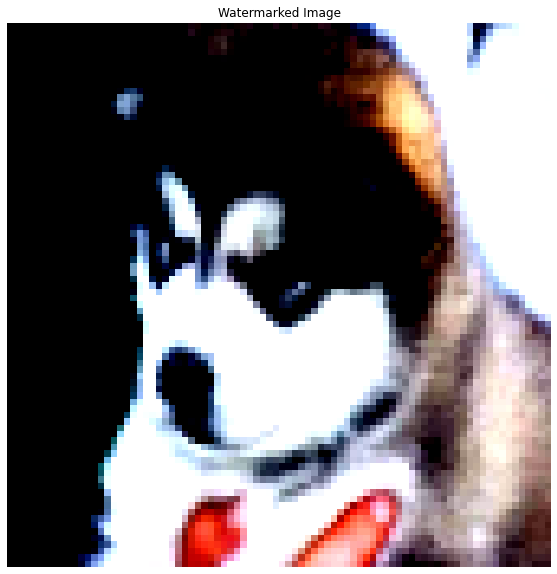

  9%|▉         | 1/11 [00:08<01:21,  8.18s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 16: Target opacity: 0, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


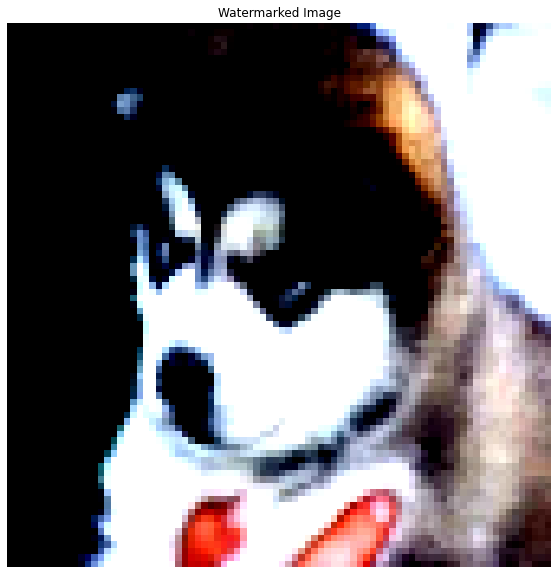

 18%|█▊        | 2/11 [00:16<01:13,  8.16s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 16: Target opacity: 0.05, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


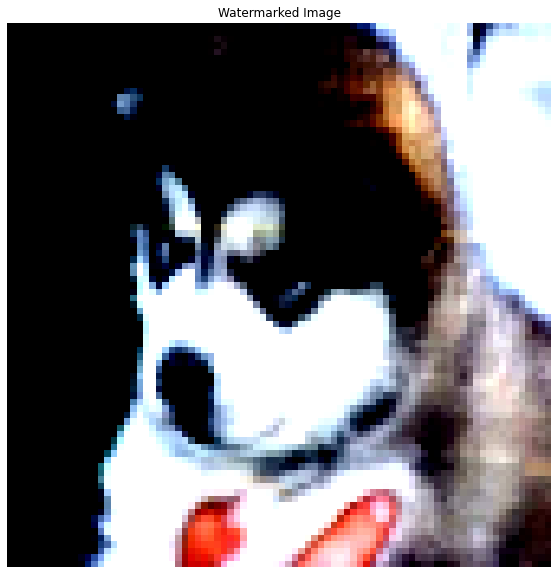

 27%|██▋       | 3/11 [00:24<01:05,  8.13s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 16: Target opacity: 0.1, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


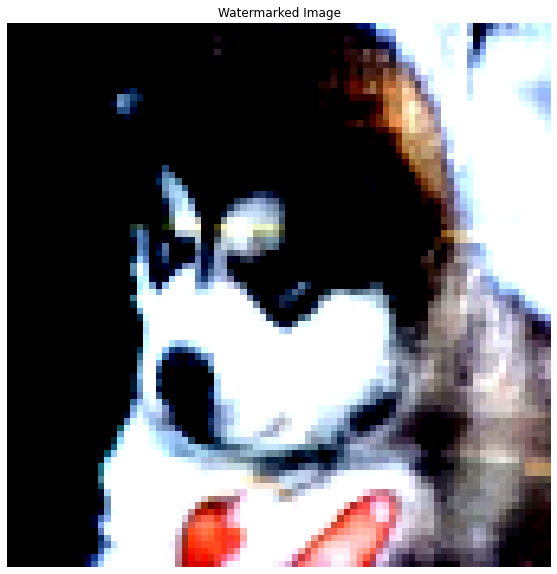

 36%|███▋      | 4/11 [00:32<00:56,  8.12s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 16: Target opacity: 0.15, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


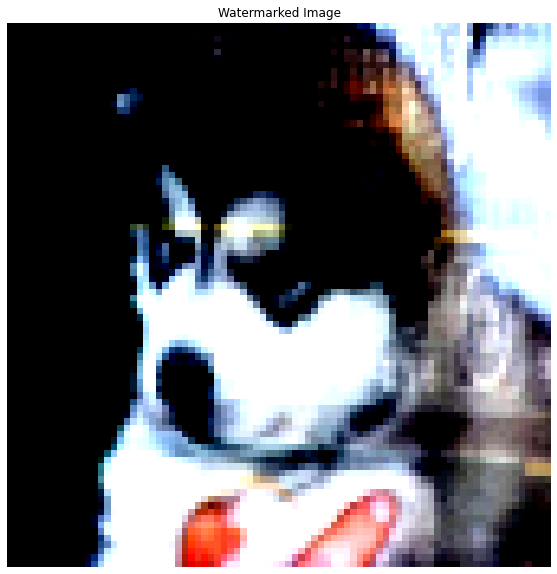

 45%|████▌     | 5/11 [00:40<00:48,  8.05s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 16: Target opacity: 0.2, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: True, Base class predicted: False


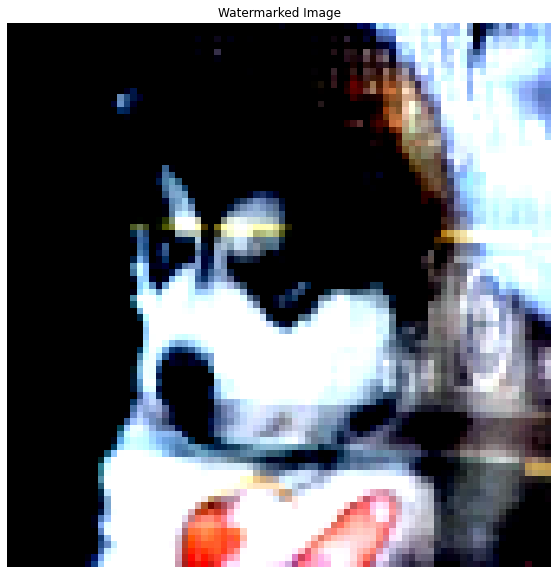

 55%|█████▍    | 6/11 [00:48<00:39,  7.99s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 16: Target opacity: 0.25, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: True, Base class predicted: False


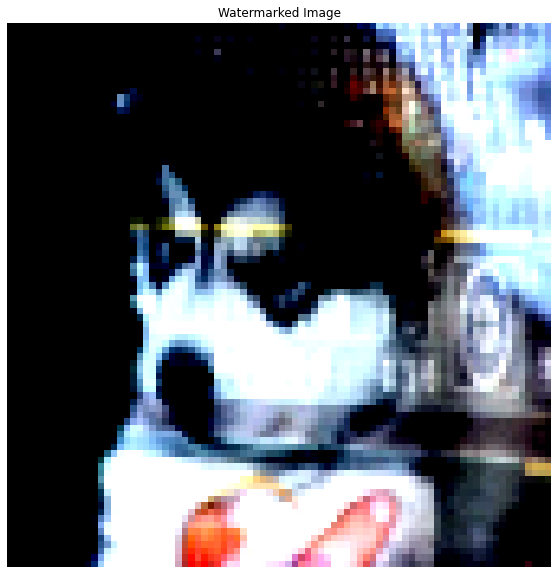

 64%|██████▎   | 7/11 [00:56<00:31,  7.96s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 16: Target opacity: 0.3, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: True, Base class predicted: False


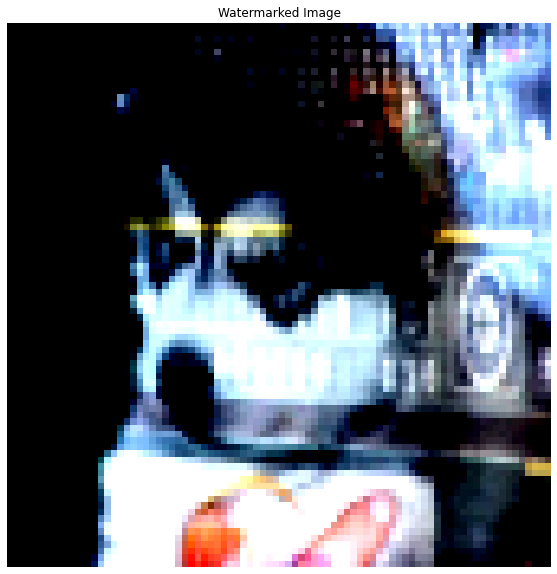

 73%|███████▎  | 8/11 [01:04<00:23,  7.98s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 16: Target opacity: 0.35, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


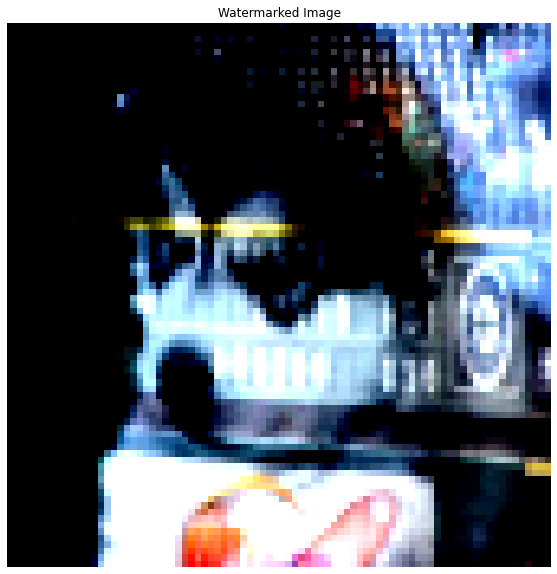

 82%|████████▏ | 9/11 [01:12<00:16,  8.01s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 16: Target opacity: 0.4, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


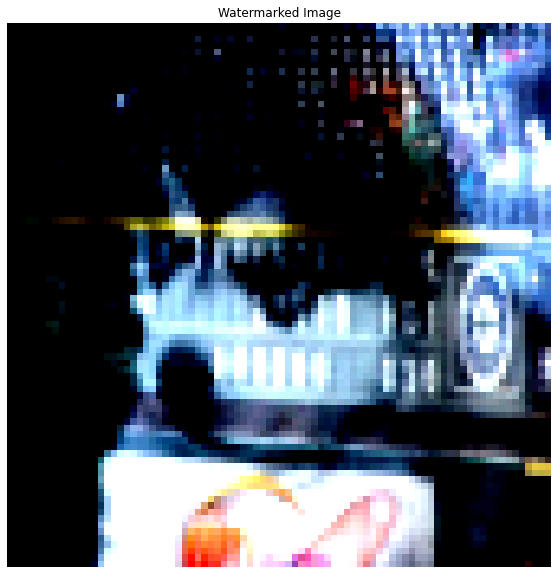

 91%|█████████ | 10/11 [01:20<00:08,  8.01s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 16: Target opacity: 0.45, Labeled correctly: 0.64, Correctly Predicted Target: True, Base class predicted: False


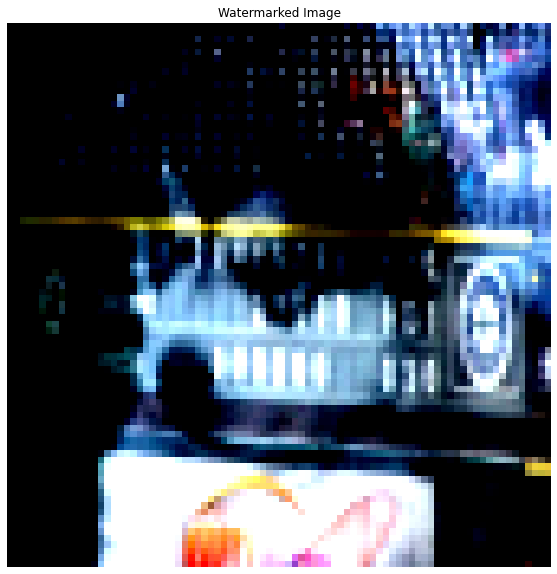

100%|██████████| 11/11 [01:28<00:00,  8.04s/it]

Iteration 16: Target opacity: 0.5, Labeled correctly: 0.6133333333333333, Correctly Predicted Target: True, Base class predicted: False



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


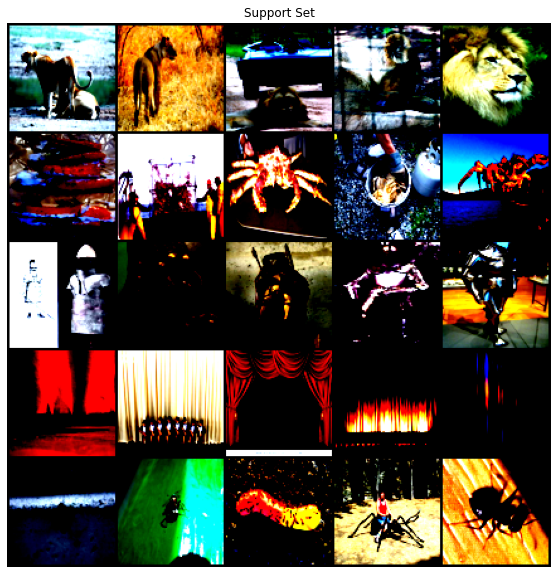

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[4, 4, 4, 4, 4, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 3, 3, 3, 3,
         3]])


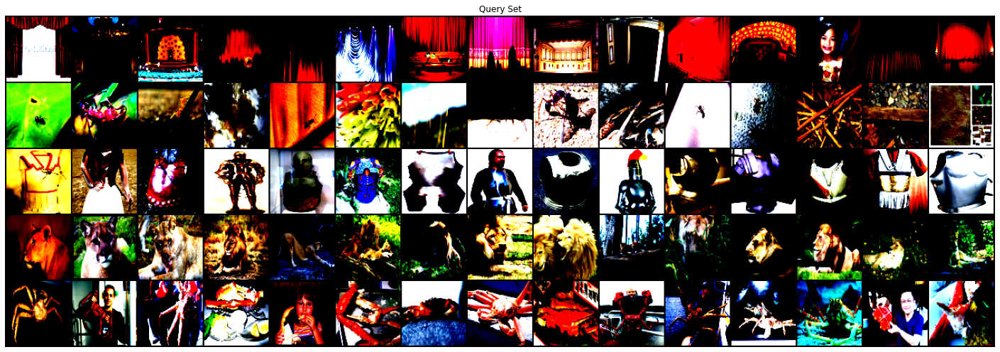

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 3, 3, 3, 3,
         3, 3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 4, 4, 4,
         4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
         2, 2, 2]])
target_class 3
unique_classes [0, 1, 2, 4]
base_class 0
target_indices [15 16 17 18 19 20 21 22 23 24 25 26 27 28 29]
target_index 27
base_indices [15 16 17 18 19]
base_index 17


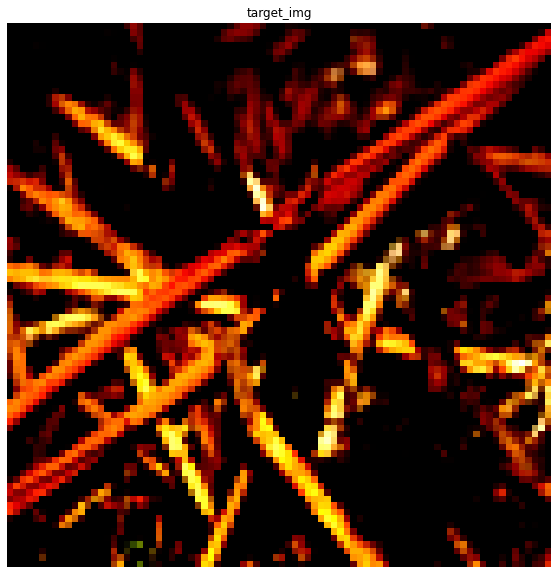

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


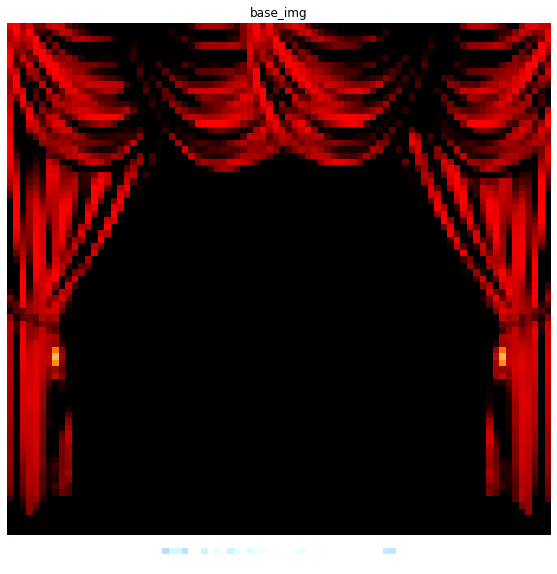

  0%|          | 3/1000 [00:00<00:37, 26.94it/s]

Iteration 0
loss: tensor(10.3974, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(17.3641, grad_fn=<PowBackward0>)
Iteration 2
loss: tensor(23.4210, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(0.4826, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(1.5305, grad_fn=<PowBackward0>)


  1%|          | 9/1000 [00:00<00:39, 25.12it/s]

Iteration 5
loss: tensor(0.5120, grad_fn=<PowBackward0>)
Iteration 6
loss: tensor(16.9887, grad_fn=<PowBackward0>)
Iteration 7
loss: tensor(10.2321, grad_fn=<PowBackward0>)
Iteration 8
loss: tensor(48.9520, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(9.1697, grad_fn=<PowBackward0>)
Iteration 10
loss:

  2%|▏         | 15/1000 [00:00<00:39, 25.08it/s]

 tensor(23.3738, grad_fn=<PowBackward0>)
Iteration 11
loss: tensor(1.8813, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(62.3101, grad_fn=<PowBackward0>)
Iteration 13
loss: tensor(16.7993, grad_fn=<PowBackward0>)
Iteration 14
loss: tensor(50.3904, grad_fn=<PowBackward0>)
Iteration 15
loss:

  2%|▏         | 18/1000 [00:00<00:38, 25.26it/s]

 tensor(0.0815, grad_fn=<PowBackward0>)
Iteration 16
loss: tensor(0.0320, grad_fn=<PowBackward0>)
Iteration 17
loss: tensor(22.2943, grad_fn=<PowBackward0>)
Iteration 18
loss: tensor(16.3323, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(32.1996, grad_fn=<PowBackward0>)
Iteration 20


  2%|▏         | 24/1000 [00:00<00:39, 24.54it/s]

loss: tensor(12.2097, grad_fn=<PowBackward0>)
Iteration 21
loss: tensor(39.8141, grad_fn=<PowBackward0>)
Iteration 22
loss: tensor(7.5109, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(67.1021, grad_fn=<PowBackward0>)
Iteration 24
loss: tensor(3.3266, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(31.9878, grad_fn=<PowBackward0>)


  3%|▎         | 30/1000 [00:01<00:40, 24.03it/s]

Iteration 26
loss: tensor(5.0062, grad_fn=<PowBackward0>)
Iteration 27
loss: tensor(14.6974, grad_fn=<PowBackward0>)
Iteration 28
loss: tensor(19.3895, grad_fn=<PowBackward0>)
Iteration 29
loss: tensor(53.4871, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(1.4780, grad_fn=<PowBackward0>)


  4%|▎         | 36/1000 [00:01<00:38, 25.00it/s]

Iteration 31
loss: tensor(4.7106, grad_fn=<PowBackward0>)
Iteration 32
loss: tensor(68.8180, grad_fn=<PowBackward0>)
Iteration 33
loss: tensor(7.7250, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(15.0462, grad_fn=<PowBackward0>)
Iteration 35
loss: tensor(19.3947, grad_fn=<PowBackward0>)
Iteration 36


  4%|▍         | 39/1000 [00:01<00:39, 24.63it/s]

loss: tensor(23.3604, grad_fn=<PowBackward0>)
Iteration 37
loss: tensor(1.8678, grad_fn=<PowBackward0>)
Iteration 38
loss: tensor(92.5931, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(3.0624, grad_fn=<PowBackward0>)
Iteration 40
loss: tensor(31.9431, grad_fn=<PowBackward0>)
Iteration 41
loss: tensor(9.4968, grad_fn=<PowBackward0>)


  4%|▍         | 45/1000 [00:01<00:37, 25.42it/s]

Iteration 42
loss: tensor(109.7578, grad_fn=<PowBackward0>)
Iteration 43
loss: tensor(2.2522, grad_fn=<PowBackward0>)
Iteration 44
loss: tensor(9.3426, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(7.1919, grad_fn=<PowBackward0>)
Iteration 46
loss: tensor(64.9157, grad_fn=<PowBackward0>)
Iteration 47


  5%|▌         | 51/1000 [00:02<00:37, 25.41it/s]

loss: tensor(3.8757, grad_fn=<PowBackward0>)
Iteration 48
loss: tensor(7.7102, grad_fn=<PowBackward0>)
Iteration 49
loss: tensor(16.1802, grad_fn=<PowBackward0>)
Iteration 50
loss: tensor(70.7837, grad_fn=<PowBackward0>)
Iteration 51
loss: tensor(3.1529, grad_fn=<PowBackward0>)
Iteration 52
loss: tensor(37.9889, grad_fn=<PowBackward0>)


  6%|▌         | 57/1000 [00:02<00:38, 24.73it/s]

Iteration 53
loss: tensor(21.4003, grad_fn=<PowBackward0>)
Iteration 54
loss: tensor(30.8015, grad_fn=<PowBackward0>)
Iteration 55
loss: tensor(10.7525, grad_fn=<PowBackward0>)
Iteration 56
loss: tensor(46.3538, grad_fn=<PowBackward0>)
Iteration 57


  6%|▌         | 60/1000 [00:02<00:38, 24.12it/s]

loss: tensor(4.5716, grad_fn=<PowBackward0>)
Iteration 58
loss: tensor(62.5669, grad_fn=<PowBackward0>)
Iteration 59
loss: tensor(7.4562, grad_fn=<PowBackward0>)
Iteration 60
loss: tensor(46.6808, grad_fn=<PowBackward0>)
Iteration 61
loss: tensor(0.3695, grad_fn=<PowBackward0>)
Iteration 62
loss: tensor(10.2147, grad_fn=<PowBackward0>)


  7%|▋         | 66/1000 [00:02<00:36, 25.30it/s]

Iteration 63
loss: tensor(8.5053, grad_fn=<PowBackward0>)
Iteration 64
loss: tensor(83.7710, grad_fn=<PowBackward0>)
Iteration 65
loss: tensor(0.4332, grad_fn=<PowBackward0>)
Iteration 66
loss: tensor(4.7764, grad_fn=<PowBackward0>)
Iteration 67
loss: tensor(16.1225, grad_fn=<PowBackward0>)
Iteration 68
loss: tensor(50.6478, grad_fn=<PowBackward0>)


  7%|▋         | 72/1000 [00:02<00:35, 25.84it/s]

Iteration 69
loss: tensor(14.7931, grad_fn=<PowBackward0>)
Iteration 70
loss: tensor(47.3835, grad_fn=<PowBackward0>)
Iteration 71
loss: tensor(7.7795, grad_fn=<PowBackward0>)
Iteration 72
loss: tensor(48.9816, grad_fn=<PowBackward0>)
Iteration 73
loss: tensor(1.0583, grad_fn=<PowBackward0>)
Iteration 74
loss: tensor(19.9976, grad_fn=<PowBackward0>)


  8%|▊         | 78/1000 [00:03<00:35, 26.29it/s]

Iteration 75
loss: tensor(25.6163, grad_fn=<PowBackward0>)
Iteration 76
loss: tensor(52.4073, grad_fn=<PowBackward0>)
Iteration 77
loss: tensor(22.5865, grad_fn=<PowBackward0>)
Iteration 78
loss: tensor(64.0950, grad_fn=<PowBackward0>)
Iteration 79
loss: tensor(26.7360, grad_fn=<PowBackward0>)


  8%|▊         | 84/1000 [00:03<00:35, 25.45it/s]

Iteration 80
loss: tensor(37.4750, grad_fn=<PowBackward0>)
Iteration 81
loss: tensor(23.2255, grad_fn=<PowBackward0>)
Iteration 82
loss: tensor(45.5880, grad_fn=<PowBackward0>)
Iteration 83
loss: tensor(5.5358, grad_fn=<PowBackward0>)
Iteration 84
loss: tensor(34.9880, grad_fn=<PowBackward0>)


  9%|▉         | 90/1000 [00:03<00:34, 26.49it/s]

Iteration 85
loss: tensor(31.7790, grad_fn=<PowBackward0>)
Iteration 86
loss: tensor(14.2043, grad_fn=<PowBackward0>)
Iteration 87
loss: tensor(3.7051, grad_fn=<PowBackward0>)
Iteration 88
loss: tensor(57.4489, grad_fn=<PowBackward0>)
Iteration 89
loss: tensor(4.3243, grad_fn=<PowBackward0>)
Iteration 90
loss: tensor(22.9252, grad_fn=<PowBackward0>)


 10%|▉         | 96/1000 [00:03<00:34, 26.38it/s]

Iteration 91
loss: tensor(9.5628, grad_fn=<PowBackward0>)
Iteration 92
loss: tensor(43.1399, grad_fn=<PowBackward0>)
Iteration 93
loss: tensor(14.8426, grad_fn=<PowBackward0>)
Iteration 94
loss: tensor(41.3443, grad_fn=<PowBackward0>)
Iteration 95
loss: tensor(3.1024, grad_fn=<PowBackward0>)
Iteration 96


 10%|█         | 102/1000 [00:04<00:33, 26.66it/s]

loss: tensor(50.3779, grad_fn=<PowBackward0>)
Iteration 97
loss: tensor(22.2193, grad_fn=<PowBackward0>)
Iteration 98
loss: tensor(16.5278, grad_fn=<PowBackward0>)
Iteration 99
loss: tensor(6.0744, grad_fn=<PowBackward0>)
Iteration 100
loss: tensor(60.8895, grad_fn=<PowBackward0>)
Iteration 101
loss: tensor(0.6831, grad_fn=<PowBackward0>)


 10%|█         | 105/1000 [00:04<00:33, 26.46it/s]

Iteration 102
loss: tensor(5.0740, grad_fn=<PowBackward0>)
Iteration 103
loss: tensor(17.1670, grad_fn=<PowBackward0>)
Iteration 104
loss: tensor(40.0147, grad_fn=<PowBackward0>)
Iteration 105
loss: tensor(10.5413, grad_fn=<PowBackward0>)
Iteration 106
loss: tensor(54.6616, grad_fn=<PowBackward0>)
Iteration 107


 11%|█         | 111/1000 [00:04<00:35, 25.33it/s]

loss: tensor(13.3778, grad_fn=<PowBackward0>)
Iteration 108
loss: tensor(42.5188, grad_fn=<PowBackward0>)
Iteration 109
loss: tensor(13.2058, grad_fn=<PowBackward0>)
Iteration 110
loss: tensor(58.8288, grad_fn=<PowBackward0>)
Iteration 111
loss: tensor(2.3407, grad_fn=<PowBackward0>)
Iteration 112
loss: tensor(22.3209, grad_fn=<PowBackward0>)


 12%|█▏        | 117/1000 [00:04<00:34, 25.91it/s]

Iteration 113
loss: tensor(24.5614, grad_fn=<PowBackward0>)
Iteration 114
loss: tensor(62.3111, grad_fn=<PowBackward0>)
Iteration 115
loss: tensor(17.9562, grad_fn=<PowBackward0>)
Iteration 116
loss: tensor(32.6887, grad_fn=<PowBackward0>)
Iteration 117
loss: tensor(8.0341, grad_fn=<PowBackward0>)
Iteration 118


 12%|█▏        | 123/1000 [00:04<00:34, 25.74it/s]

loss: tensor(60.2712, grad_fn=<PowBackward0>)
Iteration 119
loss: tensor(5.2695, grad_fn=<PowBackward0>)
Iteration 120
loss: tensor(17.0649, grad_fn=<PowBackward0>)
Iteration 121
loss: tensor(12.8703, grad_fn=<PowBackward0>)
Iteration 122
loss: tensor(71.9202, grad_fn=<PowBackward0>)
Iteration 123
loss: tensor(8.7075, grad_fn=<PowBackward0>)


 13%|█▎        | 129/1000 [00:05<00:34, 25.29it/s]

Iteration 124
loss: tensor(39.3112, grad_fn=<PowBackward0>)
Iteration 125
loss: tensor(5.8318, grad_fn=<PowBackward0>)
Iteration 126
loss: tensor(50.0264, grad_fn=<PowBackward0>)
Iteration 127
loss: tensor(9.8091, grad_fn=<PowBackward0>)
Iteration 128
loss: tensor(68.2194, grad_fn=<PowBackward0>)
Iteration

 13%|█▎        | 132/1000 [00:05<00:34, 25.11it/s]

 129
loss: tensor(22.0548, grad_fn=<PowBackward0>)
Iteration 130
loss: tensor(59.9278, grad_fn=<PowBackward0>)
Iteration 131
loss: tensor(29.2620, grad_fn=<PowBackward0>)
Iteration 132
loss: tensor(26.6607, grad_fn=<PowBackward0>)
Iteration 133
loss: tensor(12.8994, grad_fn=<PowBackward0>)
Iteration

 14%|█▍        | 138/1000 [00:05<00:34, 25.27it/s]

 134
loss: tensor(34.3424, grad_fn=<PowBackward0>)
Iteration 135
loss: tensor(20.4201, grad_fn=<PowBackward0>)
Iteration 136
loss: tensor(56.0030, grad_fn=<PowBackward0>)
Iteration 137
loss: tensor(8.6860, grad_fn=<PowBackward0>)
Iteration 138
loss: tensor(35.7805, grad_fn=<PowBackward0>)
Iteration 139


 14%|█▍        | 144/1000 [00:05<00:33, 25.83it/s]

loss: tensor(11.1006, grad_fn=<PowBackward0>)
Iteration 140
loss: tensor(52.4328, grad_fn=<PowBackward0>)
Iteration 141
loss: tensor(20.6448, grad_fn=<PowBackward0>)
Iteration 142
loss: tensor(27.9297, grad_fn=<PowBackward0>)
Iteration 143
loss: tensor(7.7466, grad_fn=<PowBackward0>)
Iteration 144
loss: tensor(43.3737, grad_fn=<PowBackward0>)


 15%|█▌        | 150/1000 [00:05<00:33, 25.64it/s]

Iteration 145
loss: tensor(3.0391, grad_fn=<PowBackward0>)
Iteration 146
loss: tensor(28.1780, grad_fn=<PowBackward0>)
Iteration 147
loss: tensor(13.1681, grad_fn=<PowBackward0>)
Iteration 148
loss: tensor(32.1270, grad_fn=<PowBackward0>)
Iteration 149
loss: tensor(10.4543, grad_fn=<PowBackward0>)
Iteration 150


 16%|█▌        | 156/1000 [00:06<00:32, 26.34it/s]

loss: tensor(60.2725, grad_fn=<PowBackward0>)
Iteration 151
loss: tensor(7.8439, grad_fn=<PowBackward0>)
Iteration 152
loss: tensor(39.6873, grad_fn=<PowBackward0>)
Iteration 153
loss: tensor(0.3005, grad_fn=<PowBackward0>)
Iteration 154
loss: tensor(3.3951, grad_fn=<PowBackward0>)
Iteration 155
loss: tensor(18.8894, grad_fn=<PowBackward0>)


 16%|█▌        | 159/1000 [00:06<00:32, 25.78it/s]

Iteration 156
loss: tensor(61.9768, grad_fn=<PowBackward0>)
Iteration 157
loss: tensor(1.6319, grad_fn=<PowBackward0>)
Iteration 158
loss: tensor(19.3963, grad_fn=<PowBackward0>)
Iteration 159
loss: tensor(7.6398, grad_fn=<PowBackward0>)
Iteration 160
loss: tensor(84.1556, grad_fn=<PowBackward0>)
Iteration 161


 16%|█▋        | 165/1000 [00:06<00:33, 25.09it/s]

loss: tensor(0.5936, grad_fn=<PowBackward0>)
Iteration 162
loss: tensor(1.2094, grad_fn=<PowBackward0>)
Iteration 163
loss: tensor(26.1529, grad_fn=<PowBackward0>)
Iteration 164
loss: tensor(1.9791, grad_fn=<PowBackward0>)
Iteration 165
loss: tensor(56.3907, grad_fn=<PowBackward0>)
Iteration 166
loss: tensor(16.8179, grad_fn=<PowBackward0>)


 17%|█▋        | 171/1000 [00:06<00:31, 26.13it/s]

Iteration 167
loss: tensor(83.6483, grad_fn=<PowBackward0>)
Iteration 168
loss: tensor(6.9335, grad_fn=<PowBackward0>)
Iteration 169
loss: tensor(61.8333, grad_fn=<PowBackward0>)
Iteration 170
loss: tensor(2.1923, grad_fn=<PowBackward0>)
Iteration 171
loss: tensor(27.8090, grad_fn=<PowBackward0>)
Iteration 172


 18%|█▊        | 177/1000 [00:06<00:31, 26.49it/s]

loss: tensor(32.8423, grad_fn=<PowBackward0>)
Iteration 173
loss: tensor(83.6128, grad_fn=<PowBackward0>)
Iteration 174
loss: tensor(6.8566, grad_fn=<PowBackward0>)
Iteration 175
loss: tensor(46.0779, grad_fn=<PowBackward0>)
Iteration 176
loss: tensor(11.8009, grad_fn=<PowBackward0>)
Iteration 177
loss: tensor(53.8829, grad_fn=<PowBackward0>)
Iteration 178


 18%|█▊        | 183/1000 [00:07<00:30, 26.81it/s]

loss: tensor(11.8024, grad_fn=<PowBackward0>)
Iteration 179
loss: tensor(58.9200, grad_fn=<PowBackward0>)
Iteration 180
loss: tensor(17.7995, grad_fn=<PowBackward0>)
Iteration 181
loss: tensor(38.7180, grad_fn=<PowBackward0>)
Iteration 182
loss: tensor(41.0684, grad_fn=<PowBackward0>)
Iteration 183
loss: tensor(54.6295, grad_fn=<PowBackward0>)
Iteration 184


 19%|█▉        | 189/1000 [00:07<00:31, 25.52it/s]

loss: tensor(6.3180, grad_fn=<PowBackward0>)
Iteration 185
loss: tensor(31.7099, grad_fn=<PowBackward0>)
Iteration 186
loss: tensor(5.7135, grad_fn=<PowBackward0>)
Iteration 187
loss: tensor(30.0174, grad_fn=<PowBackward0>)
Iteration 188
loss: tensor(23.3289, grad_fn=<PowBackward0>)
Iteration 189
loss: tensor(32.3660, grad_fn=<PowBackward0>)


 20%|█▉        | 195/1000 [00:07<00:31, 25.64it/s]

Iteration 190
loss: tensor(5.7260, grad_fn=<PowBackward0>)
Iteration 191
loss: tensor(56.8234, grad_fn=<PowBackward0>)
Iteration 192
loss: tensor(5.6628, grad_fn=<PowBackward0>)
Iteration 193
loss: tensor(36.9164, grad_fn=<PowBackward0>)
Iteration 194
loss: tensor(7.9048, grad_fn=<PowBackward0>)
Iteration 195


 20%|█▉        | 198/1000 [00:07<00:31, 25.84it/s]

loss: tensor(82.6967, grad_fn=<PowBackward0>)
Iteration 196
loss: tensor(14.5746, grad_fn=<PowBackward0>)
Iteration 197
loss: tensor(41.5164, grad_fn=<PowBackward0>)
Iteration 198
loss: tensor(4.3031, grad_fn=<PowBackward0>)
Iteration 199
loss: tensor(22.7372, grad_fn=<PowBackward0>)
Iteration 200
loss: tensor(21.1935, grad_fn=<PowBackward0>)


 20%|██        | 204/1000 [00:08<00:30, 25.84it/s]

Iteration 201
loss: tensor(95.7223, grad_fn=<PowBackward0>)
Iteration 202
loss: tensor(3.2308, grad_fn=<PowBackward0>)
Iteration 203
loss: tensor(23.5157, grad_fn=<PowBackward0>)
Iteration 204
loss: tensor(14.0183, grad_fn=<PowBackward0>)
Iteration 205
loss: tensor(47.9216, grad_fn=<PowBackward0>)
Iteration 206


 21%|██        | 210/1000 [00:08<00:31, 24.98it/s]

loss: tensor(4.7489, grad_fn=<PowBackward0>)
Iteration 207
loss: tensor(17.9907, grad_fn=<PowBackward0>)
Iteration 208
loss: tensor(25.1173, grad_fn=<PowBackward0>)
Iteration 209
loss: tensor(68.8066, grad_fn=<PowBackward0>)
Iteration 210
loss: tensor(7.5691, grad_fn=<PowBackward0>)
Iteration 211


 22%|██▏       | 216/1000 [00:08<00:30, 25.77it/s]

loss: tensor(11.3207, grad_fn=<PowBackward0>)
Iteration 212
loss: tensor(12.5076, grad_fn=<PowBackward0>)
Iteration 213
loss: tensor(45.7240, grad_fn=<PowBackward0>)
Iteration 214
loss: tensor(8.0335, grad_fn=<PowBackward0>)
Iteration 215
loss: tensor(14.7682, grad_fn=<PowBackward0>)
Iteration 216
loss: tensor(24.1254, grad_fn=<PowBackward0>)


 22%|██▏       | 222/1000 [00:08<00:29, 26.19it/s]

Iteration 217
loss: tensor(27.9483, grad_fn=<PowBackward0>)
Iteration 218
loss: tensor(7.3916, grad_fn=<PowBackward0>)
Iteration 219
loss: tensor(50.2908, grad_fn=<PowBackward0>)
Iteration 220
loss: tensor(9.6715, grad_fn=<PowBackward0>)
Iteration 221
loss: tensor(37.6643, grad_fn=<PowBackward0>)
Iteration 222


 22%|██▎       | 225/1000 [00:08<00:30, 25.66it/s]

loss: tensor(7.2089, grad_fn=<PowBackward0>)
Iteration 223
loss: tensor(22.1012, grad_fn=<PowBackward0>)
Iteration 224
loss: tensor(8.9470, grad_fn=<PowBackward0>)
Iteration 225
loss: tensor(21.9027, grad_fn=<PowBackward0>)
Iteration 226
loss: tensor(11.5428, grad_fn=<PowBackward0>)
Iteration 227


 23%|██▎       | 231/1000 [00:09<00:30, 25.03it/s]

loss: tensor(26.0155, grad_fn=<PowBackward0>)
Iteration 228
loss: tensor(11.1039, grad_fn=<PowBackward0>)
Iteration 229
loss: tensor(39.0378, grad_fn=<PowBackward0>)
Iteration 230
loss: tensor(8.7405, grad_fn=<PowBackward0>)
Iteration 231
loss: tensor(41.2638, grad_fn=<PowBackward0>)
Iteration 232
loss: tensor(9.1139, grad_fn=<PowBackward0>)


 24%|██▎       | 237/1000 [00:09<00:30, 25.30it/s]

Iteration 233
loss: tensor(52.4567, grad_fn=<PowBackward0>)
Iteration 234
loss: tensor(7.4676, grad_fn=<PowBackward0>)
Iteration 235
loss: tensor(46.0483, grad_fn=<PowBackward0>)
Iteration 236
loss: tensor(12.4872, grad_fn=<PowBackward0>)
Iteration 237
loss: tensor(23.2066, grad_fn=<PowBackward0>)
Iteration 238


 24%|██▍       | 240/1000 [00:09<00:31, 23.85it/s]

loss: tensor(17.5283, grad_fn=<PowBackward0>)
Iteration 239
loss: tensor(34.4289, grad_fn=<PowBackward0>)
Iteration 240
loss: tensor(21.5335, grad_fn=<PowBackward0>)
Iteration 241
loss: tensor(27.3197, grad_fn=<PowBackward0>)
Iteration 242
loss: tensor(18.7362, grad_fn=<PowBackward0>)


 25%|██▍       | 246/1000 [00:09<00:30, 24.38it/s]

Iteration 243
loss: tensor(65.2548, grad_fn=<PowBackward0>)
Iteration 244
loss: tensor(9.7988, grad_fn=<PowBackward0>)
Iteration 245
loss: tensor(13.9066, grad_fn=<PowBackward0>)
Iteration 246
loss: tensor(6.0694, grad_fn=<PowBackward0>)
Iteration 247
loss: tensor(38.6072, grad_fn=<PowBackward0>)
Iteration 248


 25%|██▌       | 252/1000 [00:09<00:30, 24.55it/s]

loss: tensor(8.1589, grad_fn=<PowBackward0>)
Iteration 249
loss: tensor(41.2705, grad_fn=<PowBackward0>)
Iteration 250
loss: tensor(16.2440, grad_fn=<PowBackward0>)
Iteration 251
loss: tensor(35.5901, grad_fn=<PowBackward0>)
Iteration 252
loss: tensor(8.4214, grad_fn=<PowBackward0>)
Iteration 253


 26%|██▌       | 258/1000 [00:10<00:30, 24.63it/s]

loss: tensor(24.3268, grad_fn=<PowBackward0>)
Iteration 254
loss: tensor(10.9316, grad_fn=<PowBackward0>)
Iteration 255
loss: tensor(36.3181, grad_fn=<PowBackward0>)
Iteration 256
loss: tensor(17.0611, grad_fn=<PowBackward0>)
Iteration 257
loss: tensor(49.5788, grad_fn=<PowBackward0>)
Iteration 258
loss: tensor(17.3475, grad_fn=<PowBackward0>)


 26%|██▋       | 264/1000 [00:10<00:29, 24.65it/s]

Iteration 259
loss: tensor(45.6429, grad_fn=<PowBackward0>)
Iteration 260
loss: tensor(6.1331, grad_fn=<PowBackward0>)
Iteration 261
loss: tensor(51.6574, grad_fn=<PowBackward0>)
Iteration 262
loss: tensor(24.3607, grad_fn=<PowBackward0>)
Iteration 263
loss: tensor(56.1732, grad_fn=<PowBackward0>)
Iteration 264


 27%|██▋       | 270/1000 [00:10<00:28, 25.77it/s]

loss: tensor(8.4156, grad_fn=<PowBackward0>)
Iteration 265
loss: tensor(39.4913, grad_fn=<PowBackward0>)
Iteration 266
loss: tensor(14.8057, grad_fn=<PowBackward0>)
Iteration 267
loss: tensor(42.0500, grad_fn=<PowBackward0>)
Iteration 268
loss: tensor(4.9050, grad_fn=<PowBackward0>)
Iteration 269
loss: tensor(20.1203, grad_fn=<PowBackward0>)


 27%|██▋       | 273/1000 [00:10<00:29, 25.06it/s]

Iteration 270
loss: tensor(10.0019, grad_fn=<PowBackward0>)
Iteration 271
loss: tensor(42.4797, grad_fn=<PowBackward0>)
Iteration 272
loss: tensor(14.1486, grad_fn=<PowBackward0>)
Iteration 273
loss: tensor(42.2676, grad_fn=<PowBackward0>)
Iteration 274
loss: tensor(11.7710, grad_fn=<PowBackward0>)
Iteration 275


 28%|██▊       | 279/1000 [00:11<00:29, 24.21it/s]

loss: tensor(58.4169, grad_fn=<PowBackward0>)
Iteration 276
loss: tensor(4.9099, grad_fn=<PowBackward0>)
Iteration 277
loss: tensor(13.9062, grad_fn=<PowBackward0>)
Iteration 278
loss: tensor(14.8244, grad_fn=<PowBackward0>)
Iteration 279
loss: tensor(47.1050, grad_fn=<PowBackward0>)
Iteration 280


 28%|██▊       | 285/1000 [00:11<00:28, 25.25it/s]

loss: tensor(5.0847, grad_fn=<PowBackward0>)
Iteration 281
loss: tensor(24.6527, grad_fn=<PowBackward0>)
Iteration 282
loss: tensor(15.0575, grad_fn=<PowBackward0>)
Iteration 283
loss: tensor(39.1207, grad_fn=<PowBackward0>)
Iteration 284
loss: tensor(14.6647, grad_fn=<PowBackward0>)
Iteration 285
loss: tensor(22.1861, grad_fn=<PowBackward0>)


 29%|██▉       | 288/1000 [00:11<00:28, 25.06it/s]

Iteration 286
loss: tensor(10.9407, grad_fn=<PowBackward0>)
Iteration 287
loss: tensor(43.1269, grad_fn=<PowBackward0>)
Iteration 288
loss: tensor(10.6724, grad_fn=<PowBackward0>)
Iteration 289
loss: tensor(63.0544, grad_fn=<PowBackward0>)
Iteration 290
loss: tensor(12.8994, grad_fn=<PowBackward0>)


 29%|██▉       | 294/1000 [00:11<00:28, 24.41it/s]

Iteration 291
loss: tensor(62.4396, grad_fn=<PowBackward0>)
Iteration 292
loss: tensor(16.0211, grad_fn=<PowBackward0>)
Iteration 293
loss: tensor(45.7268, grad_fn=<PowBackward0>)
Iteration 294
loss: tensor(31.1526, grad_fn=<PowBackward0>)
Iteration 295
loss: tensor(25.8411, grad_fn=<PowBackward0>)
Iteration 296


 30%|███       | 300/1000 [00:11<00:26, 25.98it/s]

loss: tensor(6.4612, grad_fn=<PowBackward0>)
Iteration 297
loss: tensor(37.2594, grad_fn=<PowBackward0>)
Iteration 298
loss: tensor(25.3027, grad_fn=<PowBackward0>)
Iteration 299
loss: tensor(34.2035, grad_fn=<PowBackward0>)
Iteration 300
loss: tensor(12.6008, grad_fn=<PowBackward0>)
Iteration 301
loss: tensor(36.2990, grad_fn=<PowBackward0>)


 31%|███       | 306/1000 [00:12<00:26, 26.00it/s]

Iteration 302
loss: tensor(0.6652, grad_fn=<PowBackward0>)
Iteration 303
loss: tensor(2.0932, grad_fn=<PowBackward0>)
Iteration 304
loss: tensor(0.6716, grad_fn=<PowBackward0>)
Iteration 305
loss: tensor(5.7885, grad_fn=<PowBackward0>)
Iteration 306
loss: tensor(7.8609, grad_fn=<PowBackward0>)
Iteration 307


 31%|███       | 312/1000 [00:12<00:26, 26.17it/s]

loss: tensor(27.3627, grad_fn=<PowBackward0>)
Iteration 308
loss: tensor(11.9473, grad_fn=<PowBackward0>)
Iteration 309
loss: tensor(45.2075, grad_fn=<PowBackward0>)
Iteration 310
loss: tensor(14.0727, grad_fn=<PowBackward0>)
Iteration 311
loss: tensor(22.1220, grad_fn=<PowBackward0>)
Iteration 312
loss: tensor(13.1579, grad_fn=<PowBackward0>)
Iteration 313


 32%|███▏      | 318/1000 [00:12<00:26, 25.52it/s]

loss: tensor(19.3818, grad_fn=<PowBackward0>)
Iteration 314
loss: tensor(7.8698, grad_fn=<PowBackward0>)
Iteration 315
loss: tensor(6.0373, grad_fn=<PowBackward0>)
Iteration 316
loss: tensor(5.7970, grad_fn=<PowBackward0>)
Iteration 317
loss: tensor(12.6301, grad_fn=<PowBackward0>)
Iteration 318
loss: tensor(12.7032, grad_fn=<PowBackward0>)


 32%|███▏      | 324/1000 [00:12<00:26, 25.45it/s]

Iteration 319
loss: tensor(11.7423, grad_fn=<PowBackward0>)
Iteration 320
loss: tensor(4.6868, grad_fn=<PowBackward0>)
Iteration 321
loss: tensor(6.7195, grad_fn=<PowBackward0>)
Iteration 322
loss: tensor(4.6963, grad_fn=<PowBackward0>)
Iteration 323
loss: tensor(18.5168, grad_fn=<PowBackward0>)
Iteration 324


 33%|███▎      | 327/1000 [00:12<00:27, 24.92it/s]

loss: tensor(5.0492, grad_fn=<PowBackward0>)
Iteration 325
loss: tensor(18.4650, grad_fn=<PowBackward0>)
Iteration 326
loss: tensor(8.3605, grad_fn=<PowBackward0>)
Iteration 327
loss: tensor(16.2658, grad_fn=<PowBackward0>)
Iteration 328
loss: tensor(6.7647, grad_fn=<PowBackward0>)
Iteration 329
loss: tensor(10.4949, grad_fn=<PowBackward0>)


 33%|███▎      | 333/1000 [00:13<00:25, 25.71it/s]

Iteration 330
loss: tensor(5.5413, grad_fn=<PowBackward0>)
Iteration 331
loss: tensor(10.5426, grad_fn=<PowBackward0>)
Iteration 332
loss: tensor(7.3045, grad_fn=<PowBackward0>)
Iteration 333
loss: tensor(13.3692, grad_fn=<PowBackward0>)
Iteration 334
loss: tensor(9.0507, grad_fn=<PowBackward0>)
Iteration 335
loss: tensor(17.3307, grad_fn=<PowBackward0>)


 34%|███▍      | 339/1000 [00:13<00:25, 26.41it/s]

Iteration 336
loss: tensor(5.4205, grad_fn=<PowBackward0>)
Iteration 337
loss: tensor(8.4487, grad_fn=<PowBackward0>)
Iteration 338
loss: tensor(6.9214, grad_fn=<PowBackward0>)
Iteration 339
loss: tensor(12.2329, grad_fn=<PowBackward0>)
Iteration 340
loss: tensor(4.9682, grad_fn=<PowBackward0>)
Iteration 341
loss: tensor(20.0205, grad_fn=<PowBackward0>)


 34%|███▍      | 345/1000 [00:13<00:25, 25.21it/s]

Iteration 342
loss: tensor(8.0779, grad_fn=<PowBackward0>)
Iteration 343
loss: tensor(10.9762, grad_fn=<PowBackward0>)
Iteration 344
loss: tensor(6.3983, grad_fn=<PowBackward0>)
Iteration 345
loss: tensor(8.5641, grad_fn=<PowBackward0>)
Iteration 346
loss: tensor(8.0416, grad_fn=<PowBackward0>)
Iteration 347


 35%|███▌      | 351/1000 [00:13<00:24, 25.99it/s]

loss: tensor(15.9565, grad_fn=<PowBackward0>)
Iteration 348
loss: tensor(7.7790, grad_fn=<PowBackward0>)
Iteration 349
loss: tensor(18.3893, grad_fn=<PowBackward0>)
Iteration 350
loss: tensor(9.7060, grad_fn=<PowBackward0>)
Iteration 351
loss: tensor(15.7366, grad_fn=<PowBackward0>)
Iteration 352
loss: tensor(13.9489, grad_fn=<PowBackward0>)


 36%|███▌      | 357/1000 [00:14<00:24, 25.86it/s]

Iteration 353
loss: tensor(12.7071, grad_fn=<PowBackward0>)
Iteration 354
loss: tensor(5.1545, grad_fn=<PowBackward0>)
Iteration 355
loss: tensor(15.8528, grad_fn=<PowBackward0>)
Iteration 356
loss: tensor(10.2219, grad_fn=<PowBackward0>)
Iteration 357
loss: tensor(10.5791, grad_fn=<PowBackward0>)
Iteration 358


 36%|███▋      | 363/1000 [00:14<00:24, 26.30it/s]

loss: tensor(7.9385, grad_fn=<PowBackward0>)
Iteration 359
loss: tensor(21.3747, grad_fn=<PowBackward0>)
Iteration 360
loss: tensor(12.9989, grad_fn=<PowBackward0>)
Iteration 361
loss: tensor(19.3611, grad_fn=<PowBackward0>)
Iteration 362
loss: tensor(10.9345, grad_fn=<PowBackward0>)
Iteration 363
loss: tensor(18.9246, grad_fn=<PowBackward0>)


 37%|███▋      | 369/1000 [00:14<00:24, 25.94it/s]

Iteration 364
loss: tensor(6.0824, grad_fn=<PowBackward0>)
Iteration 365
loss: tensor(7.4720, grad_fn=<PowBackward0>)
Iteration 366
loss: tensor(3.6078, grad_fn=<PowBackward0>)
Iteration 367
loss: tensor(5.0002, grad_fn=<PowBackward0>)
Iteration 368
loss: tensor(9.2369, grad_fn=<PowBackward0>)
Iteration 369


 37%|███▋      | 372/1000 [00:14<00:24, 25.90it/s]

loss: tensor(12.9761, grad_fn=<PowBackward0>)
Iteration 370
loss: tensor(5.4322, grad_fn=<PowBackward0>)
Iteration 371
loss: tensor(18.7722, grad_fn=<PowBackward0>)
Iteration 372
loss: tensor(12.8222, grad_fn=<PowBackward0>)
Iteration 373
loss: tensor(14.9806, grad_fn=<PowBackward0>)
Iteration 374
loss: tensor(4.8452, grad_fn=<PowBackward0>)


 38%|███▊      | 378/1000 [00:14<00:24, 25.67it/s]

Iteration 375
loss: tensor(10.3211, grad_fn=<PowBackward0>)
Iteration 376
loss: tensor(11.4983, grad_fn=<PowBackward0>)
Iteration 377
loss: tensor(20.8942, grad_fn=<PowBackward0>)
Iteration 378
loss: tensor(3.4383, grad_fn=<PowBackward0>)
Iteration 379
loss: tensor(19.6443, grad_fn=<PowBackward0>)


 38%|███▊      | 384/1000 [00:15<00:24, 25.22it/s]

Iteration 380
loss: tensor(5.0919, grad_fn=<PowBackward0>)
Iteration 381
loss: tensor(11.4748, grad_fn=<PowBackward0>)
Iteration 382
loss: tensor(3.7867, grad_fn=<PowBackward0>)
Iteration 383
loss: tensor(10.3793, grad_fn=<PowBackward0>)
Iteration 384
loss: tensor(11.8135, grad_fn=<PowBackward0>)
Iteration 385


 39%|███▉      | 390/1000 [00:15<00:23, 25.50it/s]

loss: tensor(17.0201, grad_fn=<PowBackward0>)
Iteration 386
loss: tensor(7.9820, grad_fn=<PowBackward0>)
Iteration 387
loss: tensor(13.7606, grad_fn=<PowBackward0>)
Iteration 388
loss: tensor(16.1751, grad_fn=<PowBackward0>)
Iteration 389
loss: tensor(24.2323, grad_fn=<PowBackward0>)
Iteration 390
loss: tensor(8.9258, grad_fn=<PowBackward0>)


 40%|███▉      | 396/1000 [00:15<00:24, 24.93it/s]

Iteration 391
loss: tensor(13.2916, grad_fn=<PowBackward0>)
Iteration 392
loss: tensor(8.9901, grad_fn=<PowBackward0>)
Iteration 393
loss: tensor(15.4987, grad_fn=<PowBackward0>)
Iteration 394
loss: tensor(11.7697, grad_fn=<PowBackward0>)
Iteration 395
loss: tensor(14.2263, grad_fn=<PowBackward0>)


 40%|███▉      | 399/1000 [00:15<00:23, 25.17it/s]

Iteration 396
loss: tensor(13.0793, grad_fn=<PowBackward0>)
Iteration 397
loss: tensor(12.6714, grad_fn=<PowBackward0>)
Iteration 398
loss: tensor(6.0801, grad_fn=<PowBackward0>)
Iteration 399
loss: tensor(10.4250, grad_fn=<PowBackward0>)
Iteration 400
loss: tensor(6.9691, grad_fn=<PowBackward0>)
Iteration 401


 40%|████      | 405/1000 [00:15<00:23, 25.19it/s]

loss: tensor(17.4741, grad_fn=<PowBackward0>)
Iteration 402
loss: tensor(1.6416, grad_fn=<PowBackward0>)
Iteration 403
loss: tensor(0.3921, grad_fn=<PowBackward0>)
Iteration 404
loss: tensor(0.1043, grad_fn=<PowBackward0>)
Iteration 405
loss: tensor(0.1708, grad_fn=<PowBackward0>)
Iteration 406
loss: tensor(0.0881, grad_fn=<PowBackward0>)


 41%|████      | 411/1000 [00:16<00:23, 25.40it/s]

Iteration 407
loss: tensor(0.1942, grad_fn=<PowBackward0>)
Iteration 408
loss: tensor(0.0961, grad_fn=<PowBackward0>)
Iteration 409
loss: tensor(0.4773, grad_fn=<PowBackward0>)
Iteration 410
loss: tensor(0.7662, grad_fn=<PowBackward0>)
Iteration 411
loss: tensor(6.4260, grad_fn=<PowBackward0>)
Iteration 412


 42%|████▏     | 417/1000 [00:16<00:23, 25.33it/s]

loss: tensor(8.3282, grad_fn=<PowBackward0>)
Iteration 413
loss: tensor(15.0970, grad_fn=<PowBackward0>)
Iteration 414
loss: tensor(10.4828, grad_fn=<PowBackward0>)
Iteration 415
loss: tensor(7.1450, grad_fn=<PowBackward0>)
Iteration 416
loss: tensor(2.9466, grad_fn=<PowBackward0>)
Iteration 417
loss: tensor(1.1645, grad_fn=<PowBackward0>)


 42%|████▏     | 420/1000 [00:16<00:23, 24.32it/s]

Iteration 418
loss: tensor(0.2259, grad_fn=<PowBackward0>)
Iteration 419
loss: tensor(0.2073, grad_fn=<PowBackward0>)
Iteration 420
loss: tensor(0.0892, grad_fn=<PowBackward0>)
Iteration 421
loss: tensor(0.2161, grad_fn=<PowBackward0>)
Iteration 422
loss: tensor(0.2957, grad_fn=<PowBackward0>)


 43%|████▎     | 426/1000 [00:16<00:23, 24.89it/s]

Iteration 423
loss: tensor(1.4373, grad_fn=<PowBackward0>)
Iteration 424
loss: tensor(2.9657, grad_fn=<PowBackward0>)
Iteration 425
loss: tensor(15.4803, grad_fn=<PowBackward0>)
Iteration 426
loss: tensor(9.5511, grad_fn=<PowBackward0>)
Iteration 427
loss: tensor(13.5938, grad_fn=<PowBackward0>)
Iteration 428
loss: 

 43%|████▎     | 432/1000 [00:17<00:22, 25.46it/s]

tensor(2.4939, grad_fn=<PowBackward0>)
Iteration 429
loss: tensor(1.5515, grad_fn=<PowBackward0>)
Iteration 430
loss: tensor(0.2170, grad_fn=<PowBackward0>)
Iteration 431
loss: tensor(0.3156, grad_fn=<PowBackward0>)
Iteration 432
loss: tensor(0.1170, grad_fn=<PowBackward0>)
Iteration 433
loss: tensor(0.5647, grad_fn=<PowBackward0>)


 44%|████▍     | 438/1000 [00:17<00:21, 26.18it/s]

Iteration 434
loss: tensor(0.5560, grad_fn=<PowBackward0>)
Iteration 435
loss: tensor(2.0166, grad_fn=<PowBackward0>)
Iteration 436
loss: tensor(2.3560, grad_fn=<PowBackward0>)
Iteration 437
loss: tensor(5.4775, grad_fn=<PowBackward0>)
Iteration 438
loss: tensor(2.7763, grad_fn=<PowBackward0>)
Iteration 439


 44%|████▍     | 444/1000 [00:17<00:20, 26.96it/s]

loss: tensor(8.6349, grad_fn=<PowBackward0>)
Iteration 440
loss: tensor(3.6561, grad_fn=<PowBackward0>)
Iteration 441
loss: tensor(5.0721, grad_fn=<PowBackward0>)
Iteration 442
loss: tensor(3.5879, grad_fn=<PowBackward0>)
Iteration 443
loss: tensor(3.9068, grad_fn=<PowBackward0>)
Iteration 444
loss: tensor(2.1559, grad_fn=<PowBackward0>)


 45%|████▌     | 450/1000 [00:17<00:20, 26.38it/s]

Iteration 445
loss: tensor(2.3565, grad_fn=<PowBackward0>)
Iteration 446
loss: tensor(1.4584, grad_fn=<PowBackward0>)
Iteration 447
loss: tensor(1.5767, grad_fn=<PowBackward0>)
Iteration 448
loss: tensor(1.1507, grad_fn=<PowBackward0>)
Iteration 449
loss: tensor(2.3833, grad_fn=<PowBackward0>)
Iteration 450


 45%|████▌     | 453/1000 [00:17<00:20, 27.06it/s]

loss: tensor(1.5761, grad_fn=<PowBackward0>)
Iteration 451
loss: tensor(3.0912, grad_fn=<PowBackward0>)
Iteration 452
loss: tensor(3.1308, grad_fn=<PowBackward0>)
Iteration 453
loss: tensor(4.1091, grad_fn=<PowBackward0>)
Iteration 454
loss: tensor(4.9007, grad_fn=<PowBackward0>)
Iteration 455
loss: tensor(25.3208, grad_fn=<PowBackward0>)


 46%|████▌     | 459/1000 [00:18<00:21, 25.62it/s]

Iteration 456
loss: tensor(11.1214, grad_fn=<PowBackward0>)
Iteration 457
loss: tensor(13.2098, grad_fn=<PowBackward0>)
Iteration 458
loss: tensor(0.9591, grad_fn=<PowBackward0>)
Iteration 459
loss: tensor(0.5559, grad_fn=<PowBackward0>)
Iteration 460
loss: tensor(0.4822, grad_fn=<PowBackward0>)
Iteration 461


 46%|████▋     | 465/1000 [00:18<00:20, 26.02it/s]

loss: tensor(1.0342, grad_fn=<PowBackward0>)
Iteration 462
loss: tensor(1.5570, grad_fn=<PowBackward0>)
Iteration 463
loss: tensor(3.5396, grad_fn=<PowBackward0>)
Iteration 464
loss: tensor(3.1273, grad_fn=<PowBackward0>)
Iteration 465
loss: tensor(4.0490, grad_fn=<PowBackward0>)
Iteration 466
loss: tensor(2.6775, grad_fn=<PowBackward0>)


 47%|████▋     | 471/1000 [00:18<00:19, 26.50it/s]

Iteration 467
loss: tensor(3.3692, grad_fn=<PowBackward0>)
Iteration 468
loss: tensor(2.7447, grad_fn=<PowBackward0>)
Iteration 469
loss: tensor(4.6716, grad_fn=<PowBackward0>)
Iteration 470
loss: tensor(4.6779, grad_fn=<PowBackward0>)
Iteration 471
loss: tensor(7.1498, grad_fn=<PowBackward0>)
Iteration 472
loss: tensor(4.4388, grad_fn=<PowBackward0>)


 48%|████▊     | 477/1000 [00:18<00:19, 26.39it/s]

Iteration 473
loss: tensor(3.1760, grad_fn=<PowBackward0>)
Iteration 474
loss: tensor(2.6675, grad_fn=<PowBackward0>)
Iteration 475
loss: tensor(2.8804, grad_fn=<PowBackward0>)
Iteration 476
loss: tensor(1.6702, grad_fn=<PowBackward0>)
Iteration 477
loss: tensor(2.8685, grad_fn=<PowBackward0>)
Iteration 478


 48%|████▊     | 480/1000 [00:18<00:19, 26.45it/s]

loss: tensor(2.2382, grad_fn=<PowBackward0>)
Iteration 479
loss: tensor(3.5684, grad_fn=<PowBackward0>)
Iteration 480
loss: tensor(3.9779, grad_fn=<PowBackward0>)
Iteration 481
loss: tensor(9.5942, grad_fn=<PowBackward0>)
Iteration 482
loss: tensor(7.2807, grad_fn=<PowBackward0>)


 49%|████▊     | 486/1000 [00:19<00:21, 24.09it/s]

Iteration 483
loss: tensor(7.0827, grad_fn=<PowBackward0>)
Iteration 484
loss: tensor(5.5153, grad_fn=<PowBackward0>)
Iteration 485
loss: tensor(2.1936, grad_fn=<PowBackward0>)
Iteration 486
loss: tensor(1.5376, grad_fn=<PowBackward0>)
Iteration 487
loss: tensor(1.0537, grad_fn=<PowBackward0>)
Iteration 488
loss: tensor(0.7833, grad_fn=<PowBackward0>)


 49%|████▉     | 492/1000 [00:19<00:20, 24.81it/s]

Iteration 489
loss: tensor(1.1531, grad_fn=<PowBackward0>)
Iteration 490
loss: tensor(1.0693, grad_fn=<PowBackward0>)
Iteration 491
loss: tensor(2.5449, grad_fn=<PowBackward0>)
Iteration 492
loss: tensor(3.2365, grad_fn=<PowBackward0>)
Iteration 493
loss: tensor(7.3978, grad_fn=<PowBackward0>)
Iteration 494


 50%|████▉     | 498/1000 [00:19<00:19, 25.91it/s]

loss: tensor(8.7082, grad_fn=<PowBackward0>)
Iteration 495
loss: tensor(12.5451, grad_fn=<PowBackward0>)
Iteration 496
loss: tensor(6.9178, grad_fn=<PowBackward0>)
Iteration 497
loss: tensor(13.6475, grad_fn=<PowBackward0>)
Iteration 498
loss: tensor(5.7188, grad_fn=<PowBackward0>)
Iteration 499
loss: tensor(1.6923, grad_fn=<PowBackward0>)


 50%|█████     | 504/1000 [00:19<00:19, 25.41it/s]

Iteration 500
loss: tensor(0.7095, grad_fn=<PowBackward0>)
Iteration 501
loss: tensor(0.6182, grad_fn=<PowBackward0>)
Iteration 502
loss: tensor(0.0592, grad_fn=<PowBackward0>)
Iteration 503
loss: tensor(0.0568, grad_fn=<PowBackward0>)
Iteration 504
loss: tensor(0.0587, grad_fn=<PowBackward0>)
Iteration 505


 51%|█████     | 510/1000 [00:20<00:18, 26.35it/s]

loss: tensor(0.0603, grad_fn=<PowBackward0>)
Iteration 506
loss: tensor(0.0611, grad_fn=<PowBackward0>)
Iteration 507
loss: tensor(0.0598, grad_fn=<PowBackward0>)
Iteration 508
loss: tensor(0.0609, grad_fn=<PowBackward0>)
Iteration 509
loss: tensor(0.0611, grad_fn=<PowBackward0>)
Iteration 510
loss: tensor(0.0640, grad_fn=<PowBackward0>)
Iteration

 52%|█████▏    | 516/1000 [00:20<00:17, 27.05it/s]

 511
loss: tensor(0.0651, grad_fn=<PowBackward0>)
Iteration 512
loss: tensor(0.0647, grad_fn=<PowBackward0>)
Iteration 513
loss: tensor(0.0670, grad_fn=<PowBackward0>)
Iteration 514
loss: tensor(0.0695, grad_fn=<PowBackward0>)
Iteration 515
loss: tensor(0.0696, grad_fn=<PowBackward0>)
Iteration 516
loss:

 52%|█████▏    | 522/1000 [00:20<00:17, 27.09it/s]

 tensor(0.0707, grad_fn=<PowBackward0>)
Iteration 517
loss: tensor(0.0714, grad_fn=<PowBackward0>)
Iteration 518
loss: tensor(0.0707, grad_fn=<PowBackward0>)
Iteration 519
loss: tensor(0.0729, grad_fn=<PowBackward0>)
Iteration 520
loss: tensor(0.0716, grad_fn=<PowBackward0>)
Iteration 521
loss: tensor(0.0734, grad_fn=<PowBackward0>)


 52%|█████▎    | 525/1000 [00:20<00:17, 26.69it/s]

Iteration 522
loss: tensor(0.0711, grad_fn=<PowBackward0>)
Iteration 523
loss: tensor(0.0816, grad_fn=<PowBackward0>)
Iteration 524
loss: tensor(0.0723, grad_fn=<PowBackward0>)
Iteration 525
loss: tensor(0.1071, grad_fn=<PowBackward0>)
Iteration 526
loss: tensor(0.1017, grad_fn=<PowBackward0>)
Iteration 527


 53%|█████▎    | 531/1000 [00:20<00:18, 25.91it/s]

loss: tensor(0.2099, grad_fn=<PowBackward0>)
Iteration 528
loss: tensor(0.2117, grad_fn=<PowBackward0>)
Iteration 529
loss: tensor(0.5476, grad_fn=<PowBackward0>)
Iteration 530
loss: tensor(0.5874, grad_fn=<PowBackward0>)
Iteration 531
loss: tensor(1.3578, grad_fn=<PowBackward0>)
Iteration 532
loss: tensor(0.9138, grad_fn=<PowBackward0>)

 54%|█████▎    | 537/1000 [00:21<00:18, 24.44it/s]


Iteration 533
loss: tensor(1.1933, grad_fn=<PowBackward0>)
Iteration 534
loss: tensor(0.5808, grad_fn=<PowBackward0>)
Iteration 535
loss: tensor(1.0548, grad_fn=<PowBackward0>)
Iteration 536
loss: tensor(1.0469, grad_fn=<PowBackward0>)
Iteration 537


 54%|█████▍    | 543/1000 [00:21<00:18, 25.36it/s]

loss: tensor(0.7814, grad_fn=<PowBackward0>)
Iteration 538
loss: tensor(0.3213, grad_fn=<PowBackward0>)
Iteration 539
loss: tensor(0.2825, grad_fn=<PowBackward0>)
Iteration 540
loss: tensor(0.1444, grad_fn=<PowBackward0>)
Iteration 541
loss: tensor(0.1698, grad_fn=<PowBackward0>)
Iteration 542
loss: tensor(0.1061, grad_fn=<PowBackward0>)
Iteration 543


 55%|█████▍    | 546/1000 [00:21<00:17, 25.73it/s]

loss: tensor(0.1547, grad_fn=<PowBackward0>)
Iteration 544
loss: tensor(0.0816, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(0.1619, grad_fn=<PowBackward0>)
Iteration 546
loss: tensor(0.1270, grad_fn=<PowBackward0>)
Iteration 547
loss: tensor(0.1954, grad_fn=<PowBackward0>)
Iteration 548
loss: tensor(0.1270, grad_fn=<PowBackward0>)


 55%|█████▌    | 552/1000 [00:21<00:18, 24.75it/s]

Iteration 549
loss: tensor(0.2452, grad_fn=<PowBackward0>)
Iteration 550
loss: tensor(0.1947, grad_fn=<PowBackward0>)
Iteration 551
loss: tensor(0.3879, grad_fn=<PowBackward0>)
Iteration 552
loss: tensor(0.2780, grad_fn=<PowBackward0>)
Iteration 553
loss: tensor(0.5098, grad_fn=<PowBackward0>)
Iteration 554


 56%|█████▌    | 558/1000 [00:21<00:17, 25.21it/s]

loss: tensor(0.4338, grad_fn=<PowBackward0>)
Iteration 555
loss: tensor(0.7190, grad_fn=<PowBackward0>)
Iteration 556
loss: tensor(0.4852, grad_fn=<PowBackward0>)
Iteration 557
loss: tensor(0.7121, grad_fn=<PowBackward0>)
Iteration 558
loss: tensor(0.4331, grad_fn=<PowBackward0>)
Iteration 559
loss: tensor(0.4175, grad_fn=<PowBackward0>)


 56%|█████▋    | 564/1000 [00:22<00:16, 25.90it/s]

Iteration 560
loss: tensor(0.2434, grad_fn=<PowBackward0>)
Iteration 561
loss: tensor(0.3011, grad_fn=<PowBackward0>)
Iteration 562
loss: tensor(0.1638, grad_fn=<PowBackward0>)
Iteration 563
loss: tensor(0.2745, grad_fn=<PowBackward0>)
Iteration 564
loss: tensor(0.1737, grad_fn=<PowBackward0>)
Iteration 565


 57%|█████▋    | 570/1000 [00:22<00:16, 26.35it/s]

loss: tensor(0.2209, grad_fn=<PowBackward0>)
Iteration 566
loss: tensor(0.1040, grad_fn=<PowBackward0>)
Iteration 567
loss: tensor(0.2224, grad_fn=<PowBackward0>)
Iteration 568
loss: tensor(0.1471, grad_fn=<PowBackward0>)
Iteration 569
loss: tensor(0.2322, grad_fn=<PowBackward0>)
Iteration 570
loss: tensor(0.1669, grad_fn=<PowBackward0>)


 58%|█████▊    | 576/1000 [00:22<00:16, 26.01it/s]

Iteration 571
loss: tensor(0.2645, grad_fn=<PowBackward0>)
Iteration 572
loss: tensor(0.1418, grad_fn=<PowBackward0>)
Iteration 573
loss: tensor(0.3293, grad_fn=<PowBackward0>)
Iteration 574
loss: tensor(0.2156, grad_fn=<PowBackward0>)
Iteration 575
loss: tensor(0.3311, grad_fn=<PowBackward0>)
Iteration 576


 58%|█████▊    | 579/1000 [00:22<00:17, 24.31it/s]

loss: tensor(0.2371, grad_fn=<PowBackward0>)
Iteration 577
loss: tensor(0.4784, grad_fn=<PowBackward0>)
Iteration 578
loss: tensor(0.3410, grad_fn=<PowBackward0>)
Iteration 579
loss: tensor(0.7518, grad_fn=<PowBackward0>)
Iteration 580
loss: tensor(0.6549, grad_fn=<PowBackward0>)
Iteration 581


 58%|█████▊    | 585/1000 [00:23<00:16, 24.90it/s]

loss: tensor(3.5888, grad_fn=<PowBackward0>)
Iteration 582
loss: tensor(0.8106, grad_fn=<PowBackward0>)
Iteration 583
loss: tensor(6.3622, grad_fn=<PowBackward0>)
Iteration 584
loss: tensor(7.4498, grad_fn=<PowBackward0>)
Iteration 585
loss: tensor(2.3887, grad_fn=<PowBackward0>)
Iteration 586
loss: tensor(0.6614, grad_fn=<PowBackward0>)


 59%|█████▉    | 591/1000 [00:23<00:16, 25.30it/s]

Iteration 587
loss: tensor(0.2538, grad_fn=<PowBackward0>)
Iteration 588
loss: tensor(0.0894, grad_fn=<PowBackward0>)
Iteration 589
loss: tensor(0.0840, grad_fn=<PowBackward0>)
Iteration 590
loss: tensor(0.0570, grad_fn=<PowBackward0>)
Iteration 591
loss: tensor(0.0661, grad_fn=<PowBackward0>)
Iteration 592


 60%|█████▉    | 597/1000 [00:23<00:15, 26.20it/s]

loss: tensor(0.0547, grad_fn=<PowBackward0>)
Iteration 593
loss: tensor(0.0628, grad_fn=<PowBackward0>)
Iteration 594
loss: tensor(0.0550, grad_fn=<PowBackward0>)
Iteration 595
loss: tensor(0.0626, grad_fn=<PowBackward0>)
Iteration 596
loss: tensor(0.0550, grad_fn=<PowBackward0>)
Iteration 597
loss: tensor(0.0642, grad_fn=<PowBackward0>)


 60%|██████    | 600/1000 [00:23<00:15, 25.31it/s]

Iteration 598
loss: tensor(0.0561, grad_fn=<PowBackward0>)
Iteration 599
loss: tensor(0.0684, grad_fn=<PowBackward0>)
Iteration 600
loss: tensor(0.0562, grad_fn=<PowBackward0>)
Iteration 601
loss: tensor(0.0561, grad_fn=<PowBackward0>)
Iteration 602
loss: tensor(0.0527, grad_fn=<PowBackward0>)


 61%|██████    | 606/1000 [00:23<00:15, 25.26it/s]

Iteration 603
loss: tensor(0.0532, grad_fn=<PowBackward0>)
Iteration 604
loss: tensor(0.0539, grad_fn=<PowBackward0>)
Iteration 605
loss: tensor(0.0551, grad_fn=<PowBackward0>)
Iteration 606
loss: tensor(0.0548, grad_fn=<PowBackward0>)
Iteration 607
loss: tensor(0.0553, grad_fn=<PowBackward0>)
Iteration 608


 61%|██████    | 612/1000 [00:24<00:15, 24.81it/s]

loss: tensor(0.0565, grad_fn=<PowBackward0>)
Iteration 609
loss: tensor(0.0565, grad_fn=<PowBackward0>)
Iteration 610
loss: tensor(0.0565, grad_fn=<PowBackward0>)
Iteration 611
loss: tensor(0.0569, grad_fn=<PowBackward0>)
Iteration 612
loss: tensor(0.0583, grad_fn=<PowBackward0>)
Iteration 613


 62%|██████▏   | 618/1000 [00:24<00:15, 24.82it/s]

loss: tensor(0.0591, grad_fn=<PowBackward0>)
Iteration 614
loss: tensor(0.0578, grad_fn=<PowBackward0>)
Iteration 615
loss: tensor(0.0622, grad_fn=<PowBackward0>)
Iteration 616
loss: tensor(0.0597, grad_fn=<PowBackward0>)
Iteration 617
loss: tensor(0.0619, grad_fn=<PowBackward0>)
Iteration 618
loss: tensor(0.0611, grad_fn=<PowBackward0>)


 62%|██████▏   | 624/1000 [00:24<00:14, 25.69it/s]

Iteration 619
loss: tensor(0.0621, grad_fn=<PowBackward0>)
Iteration 620
loss: tensor(0.0625, grad_fn=<PowBackward0>)
Iteration 621
loss: tensor(0.0618, grad_fn=<PowBackward0>)
Iteration 622
loss: tensor(0.0624, grad_fn=<PowBackward0>)
Iteration 623
loss: tensor(0.0626, grad_fn=<PowBackward0>)
Iteration 624


 63%|██████▎   | 627/1000 [00:24<00:14, 25.37it/s]

loss: tensor(0.0623, grad_fn=<PowBackward0>)
Iteration 625
loss: tensor(0.0639, grad_fn=<PowBackward0>)
Iteration 626
loss: tensor(0.0625, grad_fn=<PowBackward0>)
Iteration 627
loss: tensor(0.0628, grad_fn=<PowBackward0>)
Iteration 628
loss: tensor(0.0631, grad_fn=<PowBackward0>)
Iteration 629
loss: tensor(0.0634, grad_fn=<PowBackward0>)


 63%|██████▎   | 633/1000 [00:24<00:14, 24.75it/s]

Iteration 630
loss: tensor(0.0624, grad_fn=<PowBackward0>)
Iteration 631
loss: tensor(0.0641, grad_fn=<PowBackward0>)
Iteration 632
loss: tensor(0.0630, grad_fn=<PowBackward0>)
Iteration 633
loss: tensor(0.0633, grad_fn=<PowBackward0>)
Iteration 634
loss: tensor(0.0641, grad_fn=<PowBackward0>)
Iteration 635


 64%|██████▍   | 639/1000 [00:25<00:15, 23.69it/s]

loss: tensor(0.0629, grad_fn=<PowBackward0>)
Iteration 636
loss: tensor(0.0627, grad_fn=<PowBackward0>)
Iteration 637
loss: tensor(0.0650, grad_fn=<PowBackward0>)
Iteration 638
loss: tensor(0.0622, grad_fn=<PowBackward0>)
Iteration 639
loss: tensor(0.0634, grad_fn=<PowBackward0>)


 64%|██████▍   | 645/1000 [00:25<00:14, 24.10it/s]

Iteration 640
loss: tensor(0.0644, grad_fn=<PowBackward0>)
Iteration 641
loss: tensor(0.0624, grad_fn=<PowBackward0>)
Iteration 642
loss: tensor(0.0635, grad_fn=<PowBackward0>)
Iteration 643
loss: tensor(0.0640, grad_fn=<PowBackward0>)
Iteration 644
loss: tensor(0.0633, grad_fn=<PowBackward0>)
Iteration 645


 65%|██████▍   | 648/1000 [00:25<00:14, 23.62it/s]

loss: tensor(0.0634, grad_fn=<PowBackward0>)
Iteration 646
loss: tensor(0.0653, grad_fn=<PowBackward0>)
Iteration 647
loss: tensor(0.0626, grad_fn=<PowBackward0>)
Iteration 648
loss: tensor(0.0640, grad_fn=<PowBackward0>)
Iteration 649
loss: tensor(0.0648, grad_fn=<PowBackward0>)
Iteration 650


 65%|██████▌   | 654/1000 [00:25<00:14, 23.16it/s]

loss: tensor(0.0625, grad_fn=<PowBackward0>)
Iteration 651
loss: tensor(0.0638, grad_fn=<PowBackward0>)
Iteration 652
loss: tensor(0.0658, grad_fn=<PowBackward0>)
Iteration 653
loss: tensor(0.0625, grad_fn=<PowBackward0>)
Iteration 654
loss: tensor(0.0650, grad_fn=<PowBackward0>)


 66%|██████▌   | 660/1000 [00:26<00:13, 24.91it/s]

Iteration 655
loss: tensor(0.0616, grad_fn=<PowBackward0>)
Iteration 656
loss: tensor(0.0639, grad_fn=<PowBackward0>)
Iteration 657
loss: tensor(0.0619, grad_fn=<PowBackward0>)
Iteration 658
loss: tensor(0.0627, grad_fn=<PowBackward0>)
Iteration 659
loss: tensor(0.0612, grad_fn=<PowBackward0>)
Iteration 660
loss: tensor(0.0614, grad_fn=<PowBackward0>)


 67%|██████▋   | 666/1000 [00:26<00:12, 26.54it/s]

Iteration 661
loss: tensor(0.0620, grad_fn=<PowBackward0>)
Iteration 662
loss: tensor(0.0609, grad_fn=<PowBackward0>)
Iteration 663
loss: tensor(0.0608, grad_fn=<PowBackward0>)
Iteration 664
loss: tensor(0.0603, grad_fn=<PowBackward0>)
Iteration 665
loss: tensor(0.0623, grad_fn=<PowBackward0>)
Iteration 666
loss: tensor(0.0600, grad_fn=<PowBackward0>)


 67%|██████▋   | 672/1000 [00:26<00:11, 27.50it/s]

Iteration 667
loss: tensor(0.0603, grad_fn=<PowBackward0>)
Iteration 668
loss: tensor(0.0601, grad_fn=<PowBackward0>)
Iteration 669
loss: tensor(0.0605, grad_fn=<PowBackward0>)
Iteration 670
loss: tensor(0.0623, grad_fn=<PowBackward0>)
Iteration 671
loss: tensor(0.0582, grad_fn=<PowBackward0>)
Iteration 672
loss: tensor(0.0614, grad_fn=<PowBackward0>)


 68%|██████▊   | 678/1000 [00:26<00:11, 27.90it/s]

Iteration 673
loss: tensor(0.0592, grad_fn=<PowBackward0>)
Iteration 674
loss: tensor(0.0604, grad_fn=<PowBackward0>)
Iteration 675
loss: tensor(0.0583, grad_fn=<PowBackward0>)
Iteration 676
loss: tensor(0.0622, grad_fn=<PowBackward0>)
Iteration 677
loss: tensor(0.0574, grad_fn=<PowBackward0>)
Iteration 678
loss: tensor(0.0616, grad_fn=<PowBackward0>)


 68%|██████▊   | 681/1000 [00:26<00:12, 26.48it/s]

Iteration 679
loss: tensor(0.0570, grad_fn=<PowBackward0>)
Iteration 680
loss: tensor(0.0605, grad_fn=<PowBackward0>)
Iteration 681
loss: tensor(0.0589, grad_fn=<PowBackward0>)
Iteration 682
loss: tensor(0.0595, grad_fn=<PowBackward0>)
Iteration 683
loss: tensor(0.0586, grad_fn=<PowBackward0>)


 69%|██████▊   | 687/1000 [00:27<00:11, 26.22it/s]

Iteration 684
loss: tensor(0.0595, grad_fn=<PowBackward0>)
Iteration 685
loss: tensor(0.0593, grad_fn=<PowBackward0>)
Iteration 686
loss: tensor(0.0582, grad_fn=<PowBackward0>)
Iteration 687
loss: tensor(0.0603, grad_fn=<PowBackward0>)
Iteration 688
loss: tensor(0.0576, grad_fn=<PowBackward0>)
Iteration 689


 69%|██████▉   | 693/1000 [00:27<00:11, 25.64it/s]

loss: tensor(0.0597, grad_fn=<PowBackward0>)
Iteration 690
loss: tensor(0.0585, grad_fn=<PowBackward0>)
Iteration 691
loss: tensor(0.0602, grad_fn=<PowBackward0>)
Iteration 692
loss: tensor(0.0581, grad_fn=<PowBackward0>)
Iteration 693
loss: tensor(0.0598, grad_fn=<PowBackward0>)
Iteration 694
loss: tensor(0.0580, grad_fn=<PowBackward0>)


 70%|██████▉   | 699/1000 [00:27<00:11, 25.90it/s]

Iteration 695
loss: tensor(0.0591, grad_fn=<PowBackward0>)
Iteration 696
loss: tensor(0.0593, grad_fn=<PowBackward0>)
Iteration 697
loss: tensor(0.0576, grad_fn=<PowBackward0>)
Iteration 698
loss: tensor(0.0593, grad_fn=<PowBackward0>)
Iteration 699
loss: tensor(0.0591, grad_fn=<PowBackward0>)
Iteration 700
loss:

 70%|███████   | 705/1000 [00:27<00:11, 25.73it/s]

 tensor(0.0584, grad_fn=<PowBackward0>)
Iteration 701
loss: tensor(0.0520, grad_fn=<PowBackward0>)
Iteration 702
loss: tensor(0.0534, grad_fn=<PowBackward0>)
Iteration 703
loss: tensor(0.0543, grad_fn=<PowBackward0>)
Iteration 704
loss: tensor(0.0549, grad_fn=<PowBackward0>)
Iteration 705
loss: tensor(0.0554, grad_fn=<PowBackward0>)

 71%|███████   | 708/1000 [00:27<00:11, 25.04it/s]


Iteration 706
loss: tensor(0.0553, grad_fn=<PowBackward0>)
Iteration 707
loss: tensor(0.0562, grad_fn=<PowBackward0>)
Iteration 708
loss: tensor(0.0557, grad_fn=<PowBackward0>)
Iteration 709
loss: tensor(0.0559, grad_fn=<PowBackward0>)
Iteration 710
loss: tensor(0.0559, grad_fn=<PowBackward0>)


 71%|███████▏  | 714/1000 [00:28<00:10, 26.12it/s]

Iteration 711
loss: tensor(0.0563, grad_fn=<PowBackward0>)
Iteration 712
loss: tensor(0.0559, grad_fn=<PowBackward0>)
Iteration 713
loss: tensor(0.0564, grad_fn=<PowBackward0>)
Iteration 714
loss: tensor(0.0565, grad_fn=<PowBackward0>)
Iteration 715
loss: tensor(0.0562, grad_fn=<PowBackward0>)
Iteration 716
loss: tensor(0.0568, grad_fn=<PowBackward0>)


 72%|███████▏  | 720/1000 [00:28<00:10, 26.07it/s]

Iteration 717
loss: tensor(0.0564, grad_fn=<PowBackward0>)
Iteration 718
loss: tensor(0.0565, grad_fn=<PowBackward0>)
Iteration 719
loss: tensor(0.0566, grad_fn=<PowBackward0>)
Iteration 720
loss: tensor(0.0567, grad_fn=<PowBackward0>)
Iteration 721
loss: tensor(0.0568, grad_fn=<PowBackward0>)
Iteration 722
loss: tensor(0.0578, grad_fn=<PowBackward0>)


 73%|███████▎  | 726/1000 [00:28<00:10, 25.32it/s]

Iteration 723
loss: tensor(0.0567, grad_fn=<PowBackward0>)
Iteration 724
loss: tensor(0.0567, grad_fn=<PowBackward0>)
Iteration 725
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 726
loss: tensor(0.0567, grad_fn=<PowBackward0>)
Iteration 727
loss: tensor(0.0578, grad_fn=<PowBackward0>)
Iteration 

 73%|███████▎  | 732/1000 [00:28<00:11, 23.96it/s]

728
loss: tensor(0.0571, grad_fn=<PowBackward0>)
Iteration 729
loss: tensor(0.0569, grad_fn=<PowBackward0>)
Iteration 730
loss: tensor(0.0574, grad_fn=<PowBackward0>)
Iteration 731
loss: tensor(0.0574, grad_fn=<PowBackward0>)
Iteration 732
loss: tensor(0.0575, grad_fn=<PowBackward0>)


 74%|███████▎  | 735/1000 [00:28<00:10, 24.28it/s]

Iteration 733
loss: tensor(0.0570, grad_fn=<PowBackward0>)
Iteration 734
loss: tensor(0.0581, grad_fn=<PowBackward0>)
Iteration 735
loss: tensor(0.0574, grad_fn=<PowBackward0>)
Iteration 736
loss: tensor(0.0576, grad_fn=<PowBackward0>)
Iteration 737
loss: tensor(0.0574, grad_fn=<PowBackward0>)

 74%|███████▍  | 741/1000 [00:29<00:10, 23.62it/s]


Iteration 738
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 739
loss: tensor(0.0576, grad_fn=<PowBackward0>)
Iteration 740
loss: tensor(0.0580, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(0.0577, grad_fn=<PowBackward0>)
Iteration 742
loss: tensor(0.0574, grad_fn=<PowBackward0>)


 75%|███████▍  | 747/1000 [00:29<00:10, 25.22it/s]

Iteration 743
loss: tensor(0.0579, grad_fn=<PowBackward0>)
Iteration 744
loss: tensor(0.0577, grad_fn=<PowBackward0>)
Iteration 745
loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 746
loss: tensor(0.0587, grad_fn=<PowBackward0>)
Iteration 747
loss: tensor(0.0571, grad_fn=<PowBackward0>)
Iteration 748


 75%|███████▌  | 753/1000 [00:29<00:09, 25.57it/s]

loss: tensor(0.0577, grad_fn=<PowBackward0>)
Iteration 749
loss: tensor(0.0584, grad_fn=<PowBackward0>)
Iteration 750
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 751
loss: tensor(0.0584, grad_fn=<PowBackward0>)
Iteration 752
loss: tensor(0.0577, grad_fn=<PowBackward0>)
Iteration 753
loss: tensor(0.0575, grad_fn=<PowBackward0>)


 76%|███████▌  | 759/1000 [00:29<00:09, 25.51it/s]

Iteration 754
loss: tensor(0.0578, grad_fn=<PowBackward0>)
Iteration 755
loss: tensor(0.0586, grad_fn=<PowBackward0>)
Iteration 756
loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 757
loss: tensor(0.0581, grad_fn=<PowBackward0>)
Iteration 758
loss: tensor(0.0579, grad_fn=<PowBackward0>)
Iteration 759


 76%|███████▌  | 762/1000 [00:30<00:09, 25.19it/s]

loss: tensor(0.0579, grad_fn=<PowBackward0>)
Iteration 760
loss: tensor(0.0579, grad_fn=<PowBackward0>)
Iteration 761
loss: tensor(0.0582, grad_fn=<PowBackward0>)
Iteration 762
loss: tensor(0.0580, grad_fn=<PowBackward0>)
Iteration 763
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 764
loss: tensor(0.0586, grad_fn=<PowBackward0>)


 77%|███████▋  | 768/1000 [00:30<00:09, 25.48it/s]

Iteration 765
loss: tensor(0.0574, grad_fn=<PowBackward0>)
Iteration 766
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 767
loss: tensor(0.0582, grad_fn=<PowBackward0>)
Iteration 768
loss: tensor(0.0580, grad_fn=<PowBackward0>)
Iteration 769
loss: tensor(0.0577, grad_fn=<PowBackward0>)


 77%|███████▋  | 774/1000 [00:30<00:09, 24.67it/s]

Iteration 770
loss: tensor(0.0583, grad_fn=<PowBackward0>)
Iteration 771
loss: tensor(0.0579, grad_fn=<PowBackward0>)
Iteration 772
loss: tensor(0.0577, grad_fn=<PowBackward0>)
Iteration 773
loss: tensor(0.0587, grad_fn=<PowBackward0>)
Iteration 774
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 775


 78%|███████▊  | 780/1000 [00:30<00:08, 25.82it/s]

loss: tensor(0.0576, grad_fn=<PowBackward0>)
Iteration 776
loss: tensor(0.0583, grad_fn=<PowBackward0>)
Iteration 777
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 778
loss: tensor(0.0577, grad_fn=<PowBackward0>)
Iteration 779
loss: tensor(0.0587, grad_fn=<PowBackward0>)
Iteration 780
loss: tensor(0.0574, grad_fn=<PowBackward0>)


 79%|███████▊  | 786/1000 [00:31<00:08, 25.26it/s]

Iteration 781
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 782
loss: tensor(0.0579, grad_fn=<PowBackward0>)
Iteration 783
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 784
loss: tensor(0.0582, grad_fn=<PowBackward0>)
Iteration 785
loss: tensor(0.0578, grad_fn=<PowBackward0>)


 79%|███████▉  | 789/1000 [00:31<00:08, 24.94it/s]

Iteration 786
loss: tensor(0.0577, grad_fn=<PowBackward0>)
Iteration 787
loss: tensor(0.0582, grad_fn=<PowBackward0>)
Iteration 788
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 789
loss: tensor(0.0580, grad_fn=<PowBackward0>)
Iteration 790
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 791


 80%|███████▉  | 795/1000 [00:31<00:08, 25.52it/s]

loss: tensor(0.0576, grad_fn=<PowBackward0>)
Iteration 792
loss: tensor(0.0581, grad_fn=<PowBackward0>)
Iteration 793
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 794
loss: tensor(0.0579, grad_fn=<PowBackward0>)
Iteration 795
loss: tensor(0.0586, grad_fn=<PowBackward0>)
Iteration 796
loss: tensor(0.0574, grad_fn=<PowBackward0>)


 80%|████████  | 801/1000 [00:31<00:07, 26.12it/s]

Iteration 797
loss: tensor(0.0580, grad_fn=<PowBackward0>)
Iteration 798
loss: tensor(0.0579, grad_fn=<PowBackward0>)
Iteration 799
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 800
loss: tensor(0.0578, grad_fn=<PowBackward0>)
Iteration 801
loss: tensor(0.0549, grad_fn=<PowBackward0>)
Iteration 802


 81%|████████  | 807/1000 [00:31<00:07, 24.38it/s]

loss: tensor(0.0550, grad_fn=<PowBackward0>)
Iteration 803
loss: tensor(0.0554, grad_fn=<PowBackward0>)
Iteration 804
loss: tensor(0.0555, grad_fn=<PowBackward0>)
Iteration 805
loss: tensor(0.0556, grad_fn=<PowBackward0>)
Iteration 806
loss: tensor(0.0560, grad_fn=<PowBackward0>)


 81%|████████  | 810/1000 [00:31<00:07, 24.43it/s]

Iteration 807
loss: tensor(0.0558, grad_fn=<PowBackward0>)
Iteration 808
loss: tensor(0.0564, grad_fn=<PowBackward0>)
Iteration 809
loss: tensor(0.0562, grad_fn=<PowBackward0>)
Iteration 810
loss: tensor(0.0561, grad_fn=<PowBackward0>)
Iteration 811
loss: tensor(0.0566, grad_fn=<PowBackward0>)
Iteration 812


 82%|████████▏ | 816/1000 [00:32<00:07, 24.83it/s]

loss: tensor(0.0563, grad_fn=<PowBackward0>)
Iteration 813
loss: tensor(0.0563, grad_fn=<PowBackward0>)
Iteration 814
loss: tensor(0.0564, grad_fn=<PowBackward0>)
Iteration 815
loss: tensor(0.0565, grad_fn=<PowBackward0>)
Iteration 816
loss: tensor(0.0563, grad_fn=<PowBackward0>)
Iteration 817
loss: tensor(0.0568, grad_fn=<PowBackward0>)


 82%|████████▏ | 822/1000 [00:32<00:06, 25.78it/s]

Iteration 818
loss: tensor(0.0566, grad_fn=<PowBackward0>)
Iteration 819
loss: tensor(0.0567, grad_fn=<PowBackward0>)
Iteration 820
loss: tensor(0.0567, grad_fn=<PowBackward0>)
Iteration 821
loss: tensor(0.0566, grad_fn=<PowBackward0>)
Iteration 822
loss: tensor(0.0568, grad_fn=<PowBackward0>)
Iteration 823
loss: tensor(0.0568, grad_fn=<PowBackward0>)

 83%|████████▎ | 828/1000 [00:32<00:06, 25.55it/s]


Iteration 824
loss: tensor(0.0566, grad_fn=<PowBackward0>)
Iteration 825
loss: tensor(0.0568, grad_fn=<PowBackward0>)
Iteration 826
loss: tensor(0.0567, grad_fn=<PowBackward0>)
Iteration 827
loss: tensor(0.0571, grad_fn=<PowBackward0>)
Iteration 828
loss: tensor(0.0567, grad_fn=<PowBackward0>)


 83%|████████▎ | 834/1000 [00:32<00:06, 26.11it/s]

Iteration 829
loss: tensor(0.0567, grad_fn=<PowBackward0>)
Iteration 830
loss: tensor(0.0571, grad_fn=<PowBackward0>)
Iteration 831
loss: tensor(0.0566, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(0.0569, grad_fn=<PowBackward0>)
Iteration 833
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 834


 84%|████████▎ | 837/1000 [00:33<00:06, 24.43it/s]

loss: tensor(0.0567, grad_fn=<PowBackward0>)
Iteration 835
loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 836
loss: tensor(0.0570, grad_fn=<PowBackward0>)
Iteration 837
loss: tensor(0.0571, grad_fn=<PowBackward0>)
Iteration 838
loss: tensor(0.0569, grad_fn=<PowBackward0>)
Iteration 839
loss: tensor(0.0574, grad_fn=<PowBackward0>)


 84%|████████▍ | 843/1000 [00:33<00:06, 24.98it/s]

Iteration 840
loss: tensor(0.0570, grad_fn=<PowBackward0>)
Iteration 841
loss: tensor(0.0571, grad_fn=<PowBackward0>)
Iteration 842
loss: tensor(0.0569, grad_fn=<PowBackward0>)
Iteration 843
loss: tensor(0.0574, grad_fn=<PowBackward0>)
Iteration 844
loss: tensor(0.0569, grad_fn=<PowBackward0>)
Iteration 845


 85%|████████▍ | 849/1000 [00:33<00:06, 24.66it/s]

loss: tensor(0.0574, grad_fn=<PowBackward0>)
Iteration 846
loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 847
loss: tensor(0.0571, grad_fn=<PowBackward0>)
Iteration 848
loss: tensor(0.0570, grad_fn=<PowBackward0>)
Iteration 849
loss: tensor(0.0574, grad_fn=<PowBackward0>)
Iteration 850


 86%|████████▌ | 855/1000 [00:33<00:05, 25.60it/s]

loss: tensor(0.0571, grad_fn=<PowBackward0>)
Iteration 851
loss: tensor(0.0574, grad_fn=<PowBackward0>)
Iteration 852
loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 853
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 854
loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 855
loss: tensor(0.0573, grad_fn=<PowBackward0>)


 86%|████████▌ | 858/1000 [00:33<00:05, 24.77it/s]

Iteration 856
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 857
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 858
loss: tensor(0.0576, grad_fn=<PowBackward0>)
Iteration 859
loss: tensor(0.0574, grad_fn=<PowBackward0>)
Iteration 860
loss: tensor(0.0572, grad_fn=<PowBackward0>)


 86%|████████▋ | 864/1000 [00:34<00:05, 24.93it/s]

Iteration 861
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 862
loss: tensor(0.0574, grad_fn=<PowBackward0>)
Iteration 863
loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 864
loss: tensor(0.0576, grad_fn=<PowBackward0>)
Iteration 865
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 866


 87%|████████▋ | 870/1000 [00:34<00:05, 25.17it/s]

loss: tensor(0.0574, grad_fn=<PowBackward0>)
Iteration 867
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 868
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 869
loss: tensor(0.0576, grad_fn=<PowBackward0>)
Iteration 870
loss: tensor(0.0577, grad_fn=<PowBackward0>)
Iteration 871
loss: tensor(0.0572, grad_fn=<PowBackward0>)


 88%|████████▊ | 876/1000 [00:34<00:04, 25.64it/s]

Iteration 872
loss: tensor(0.0576, grad_fn=<PowBackward0>)
Iteration 873
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 874
loss: tensor(0.0576, grad_fn=<PowBackward0>)
Iteration 875
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 876
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 877


 88%|████████▊ | 882/1000 [00:34<00:04, 24.81it/s]

loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 878
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 879
loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 880
loss: tensor(0.0576, grad_fn=<PowBackward0>)
Iteration 881
loss: tensor(0.0574, grad_fn=<PowBackward0>)
Iteration 882


 88%|████████▊ | 885/1000 [00:34<00:04, 24.30it/s]

loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 883
loss: tensor(0.0576, grad_fn=<PowBackward0>)
Iteration 884
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 885
loss: tensor(0.0576, grad_fn=<PowBackward0>)
Iteration 886
loss: tensor(0.0577, grad_fn=<PowBackward0>)
Iteration 887
loss: tensor(0.0574, grad_fn=<PowBackward0>)


 89%|████████▉ | 891/1000 [00:35<00:04, 24.68it/s]

Iteration 888
loss: tensor(0.0577, grad_fn=<PowBackward0>)
Iteration 889
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 890
loss: tensor(0.0577, grad_fn=<PowBackward0>)
Iteration 891
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 892
loss: tensor(0.0576, grad_fn=<PowBackward0>)
Iteration 893


 90%|████████▉ | 897/1000 [00:35<00:03, 26.09it/s]

loss: tensor(0.0576, grad_fn=<PowBackward0>)
Iteration 894
loss: tensor(0.0576, grad_fn=<PowBackward0>)
Iteration 895
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 896
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 897
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 898
loss: tensor(0.0579, grad_fn=<PowBackward0>)
Iteration 899


 90%|█████████ | 903/1000 [00:35<00:03, 25.90it/s]

loss: tensor(0.0576, grad_fn=<PowBackward0>)
Iteration 900
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 901
loss: tensor(0.0560, grad_fn=<PowBackward0>)
Iteration 902
loss: tensor(0.0560, grad_fn=<PowBackward0>)
Iteration 903
loss: tensor(0.0562, grad_fn=<PowBackward0>)
Iteration 904
loss: tensor(0.0563, grad_fn=<PowBackward0>)


 91%|█████████ | 909/1000 [00:35<00:03, 26.40it/s]

Iteration 905
loss: tensor(0.0564, grad_fn=<PowBackward0>)
Iteration 906
loss: tensor(0.0563, grad_fn=<PowBackward0>)
Iteration 907
loss: tensor(0.0565, grad_fn=<PowBackward0>)
Iteration 908
loss: tensor(0.0565, grad_fn=<PowBackward0>)
Iteration 909
loss: tensor(0.0565, grad_fn=<PowBackward0>)
Iteration

 92%|█████████▏| 915/1000 [00:36<00:03, 26.60it/s]

 910
loss: tensor(0.0566, grad_fn=<PowBackward0>)
Iteration 911
loss: tensor(0.0567, grad_fn=<PowBackward0>)
Iteration 912
loss: tensor(0.0567, grad_fn=<PowBackward0>)
Iteration 913
loss: tensor(0.0567, grad_fn=<PowBackward0>)
Iteration 914
loss: tensor(0.0568, grad_fn=<PowBackward0>)
Iteration 915
loss:

 92%|█████████▏| 918/1000 [00:36<00:03, 26.24it/s]

 tensor(0.0567, grad_fn=<PowBackward0>)
Iteration 916
loss: tensor(0.0566, grad_fn=<PowBackward0>)
Iteration 917
loss: tensor(0.0568, grad_fn=<PowBackward0>)
Iteration 918
loss: tensor(0.0568, grad_fn=<PowBackward0>)
Iteration 919
loss: tensor(0.0567, grad_fn=<PowBackward0>)
Iteration 920
loss: tensor(0.0568, grad_fn=<PowBackward0>)


 92%|█████████▏| 924/1000 [00:36<00:02, 26.46it/s]

Iteration 921
loss: tensor(0.0570, grad_fn=<PowBackward0>)
Iteration 922
loss: tensor(0.0567, grad_fn=<PowBackward0>)
Iteration 923
loss: tensor(0.0569, grad_fn=<PowBackward0>)
Iteration 924
loss: tensor(0.0569, grad_fn=<PowBackward0>)
Iteration 925
loss: tensor(0.0568, grad_fn=<PowBackward0>)
Iteration 926


 93%|█████████▎| 930/1000 [00:36<00:02, 25.84it/s]

loss: tensor(0.0569, grad_fn=<PowBackward0>)
Iteration 927
loss: tensor(0.0569, grad_fn=<PowBackward0>)
Iteration 928
loss: tensor(0.0569, grad_fn=<PowBackward0>)
Iteration 929
loss: tensor(0.0569, grad_fn=<PowBackward0>)
Iteration 930
loss: tensor(0.0570, grad_fn=<PowBackward0>)
Iteration 931
loss: tensor(0.0570, grad_fn=<PowBackward0>)


 94%|█████████▎| 936/1000 [00:36<00:02, 25.78it/s]

Iteration 932
loss: tensor(0.0569, grad_fn=<PowBackward0>)
Iteration 933
loss: tensor(0.0571, grad_fn=<PowBackward0>)
Iteration 934
loss: tensor(0.0570, grad_fn=<PowBackward0>)
Iteration 935
loss: tensor(0.0568, grad_fn=<PowBackward0>)
Iteration 936
loss: tensor(0.0571, grad_fn=<PowBackward0>)


 94%|█████████▍| 942/1000 [00:37<00:02, 25.23it/s]

Iteration 937
loss: tensor(0.0569, grad_fn=<PowBackward0>)
Iteration 938
loss: tensor(0.0569, grad_fn=<PowBackward0>)
Iteration 939
loss: tensor(0.0571, grad_fn=<PowBackward0>)
Iteration 940
loss: tensor(0.0570, grad_fn=<PowBackward0>)
Iteration 941
loss: tensor(0.0570, grad_fn=<PowBackward0>)
Iteration 942


 95%|█████████▍| 948/1000 [00:37<00:02, 25.89it/s]

loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 943
loss: tensor(0.0570, grad_fn=<PowBackward0>)
Iteration 944
loss: tensor(0.0570, grad_fn=<PowBackward0>)
Iteration 945
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 946
loss: tensor(0.0570, grad_fn=<PowBackward0>)
Iteration 947
loss: tensor(0.0571, grad_fn=<PowBackward0>)


 95%|█████████▌| 951/1000 [00:37<00:01, 25.68it/s]

Iteration 948
loss: tensor(0.0570, grad_fn=<PowBackward0>)
Iteration 949
loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 950
loss: tensor(0.0570, grad_fn=<PowBackward0>)
Iteration 951
loss: tensor(0.0570, grad_fn=<PowBackward0>)
Iteration 952
loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 953
loss:

 96%|█████████▌| 957/1000 [00:37<00:01, 26.26it/s]

 tensor(0.0571, grad_fn=<PowBackward0>)
Iteration 954
loss: tensor(0.0571, grad_fn=<PowBackward0>)
Iteration 955
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 956
loss: tensor(0.0570, grad_fn=<PowBackward0>)
Iteration 957
loss: tensor(0.0571, grad_fn=<PowBackward0>)
Iteration 958
loss: tensor(0.0573, grad_fn=<PowBackward0>)


 96%|█████████▋| 963/1000 [00:37<00:01, 25.36it/s]

Iteration 959
loss: tensor(0.0571, grad_fn=<PowBackward0>)
Iteration 960
loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 961
loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 962
loss: tensor(0.0571, grad_fn=<PowBackward0>)
Iteration 963
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 964


 97%|█████████▋| 969/1000 [00:38<00:01, 25.39it/s]

loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 965
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 966
loss: tensor(0.0571, grad_fn=<PowBackward0>)
Iteration 967
loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 968
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 969
loss: tensor(0.0572, grad_fn=<PowBackward0>)


 98%|█████████▊| 975/1000 [00:38<00:00, 25.61it/s]

Iteration 970
loss: tensor(0.0571, grad_fn=<PowBackward0>)
Iteration 971
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 972
loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 973
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 974
loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 975


 98%|█████████▊| 978/1000 [00:38<00:00, 25.67it/s]

loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 976
loss: tensor(0.0574, grad_fn=<PowBackward0>)
Iteration 977
loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 978
loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 979
loss: tensor(0.0574, grad_fn=<PowBackward0>)
Iteration 980
loss: tensor(0.0572, grad_fn=<PowBackward0>)


 98%|█████████▊| 984/1000 [00:38<00:00, 25.40it/s]

Iteration 981
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 982
loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 983
loss: tensor(0.0574, grad_fn=<PowBackward0>)
Iteration 984
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 985
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 986


 99%|█████████▉| 990/1000 [00:39<00:00, 26.15it/s]

loss: tensor(0.0574, grad_fn=<PowBackward0>)
Iteration 987
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 988
loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 989
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 990
loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 991
loss: tensor(0.0572, grad_fn=<PowBackward0>)


100%|█████████▉| 996/1000 [00:39<00:00, 23.35it/s]

Iteration 992
loss: tensor(0.0576, grad_fn=<PowBackward0>)
Iteration 993
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 994
loss: tensor(0.0572, grad_fn=<PowBackward0>)
Iteration 995
loss: tensor(0.0574, grad_fn=<PowBackward0>)


100%|██████████| 1000/1000 [00:39<00:00, 25.33it/s]


Iteration 996
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 997
loss: tensor(0.0573, grad_fn=<PowBackward0>)
Iteration 998
loss: tensor(0.0575, grad_fn=<PowBackward0>)
Iteration 999
loss: tensor(0.0573, grad_fn=<PowBackward0>)


  0%|          | 0/11 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


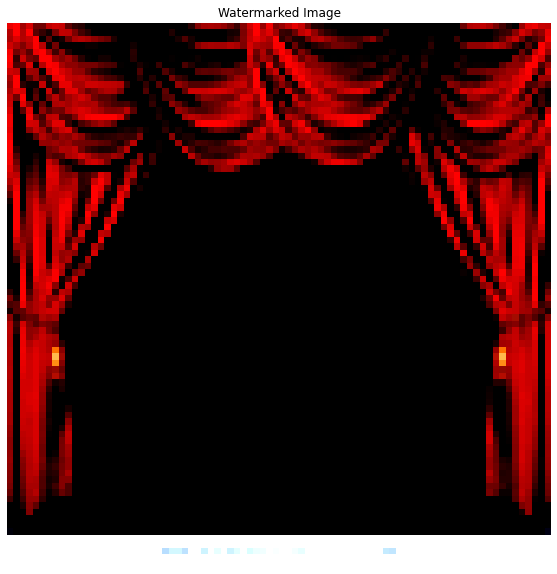

  9%|▉         | 1/11 [00:08<01:20,  8.06s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 17: Target opacity: 0, Labeled correctly: 0.64, Correctly Predicted Target: False, Base class predicted: False


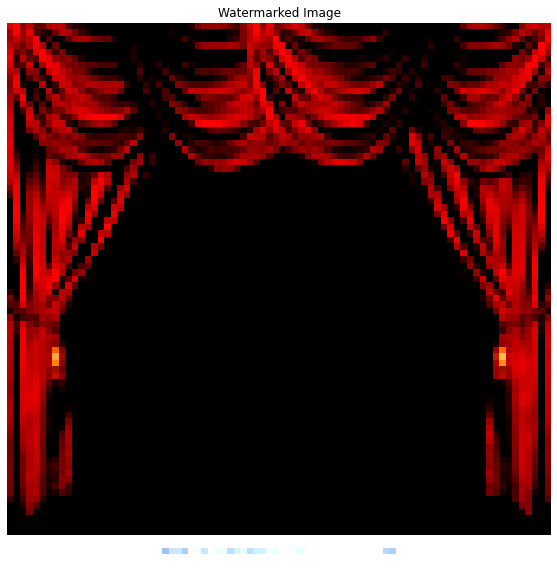

 18%|█▊        | 2/11 [00:16<01:13,  8.14s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 17: Target opacity: 0.05, Labeled correctly: 0.64, Correctly Predicted Target: False, Base class predicted: False


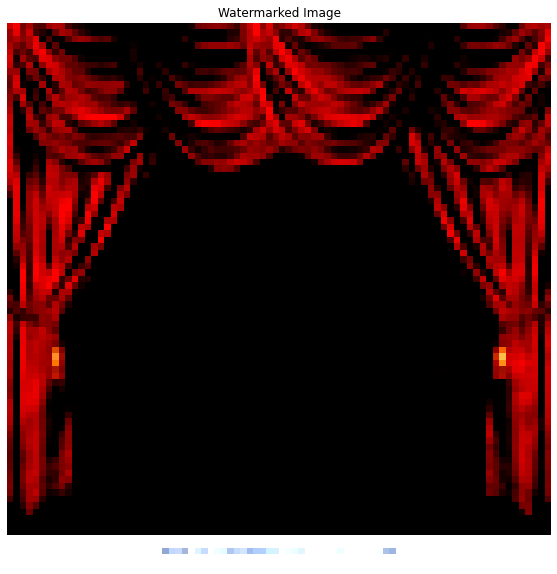

 27%|██▋       | 3/11 [00:24<01:05,  8.20s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 17: Target opacity: 0.1, Labeled correctly: 0.64, Correctly Predicted Target: False, Base class predicted: False


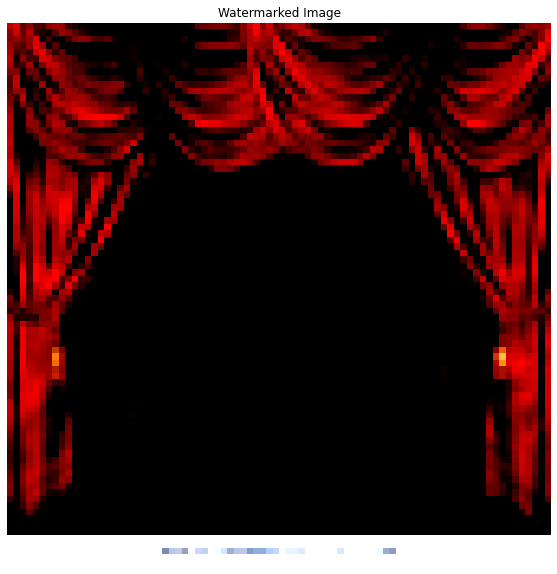

 36%|███▋      | 4/11 [00:32<00:57,  8.24s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 17: Target opacity: 0.15, Labeled correctly: 0.6133333333333333, Correctly Predicted Target: False, Base class predicted: False


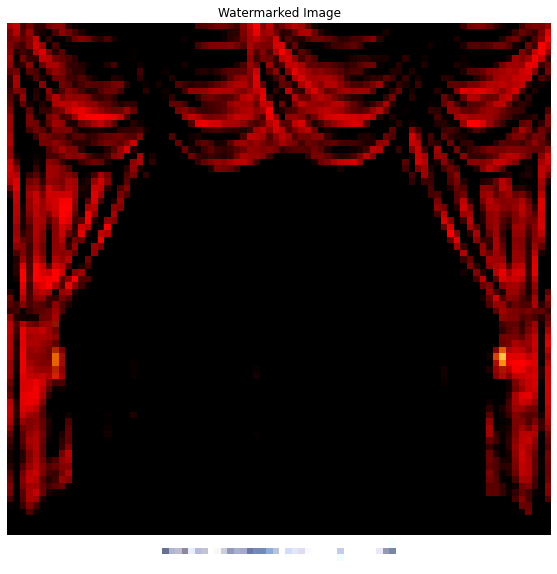

 45%|████▌     | 5/11 [00:40<00:49,  8.19s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 17: Target opacity: 0.2, Labeled correctly: 0.6266666666666667, Correctly Predicted Target: False, Base class predicted: False


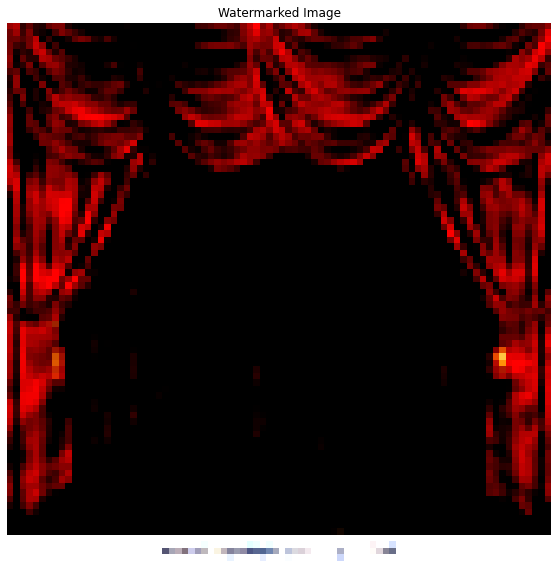

 55%|█████▍    | 6/11 [00:48<00:40,  8.12s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 17: Target opacity: 0.25, Labeled correctly: 0.6266666666666667, Correctly Predicted Target: False, Base class predicted: False


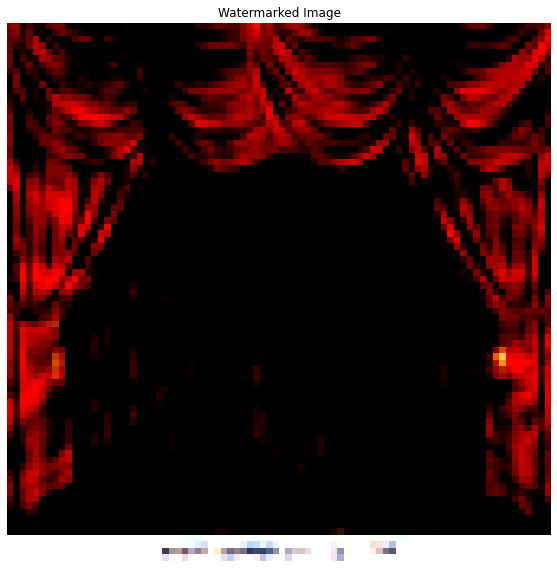

 64%|██████▎   | 7/11 [00:57<00:32,  8.14s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 17: Target opacity: 0.3, Labeled correctly: 0.6, Correctly Predicted Target: False, Base class predicted: False


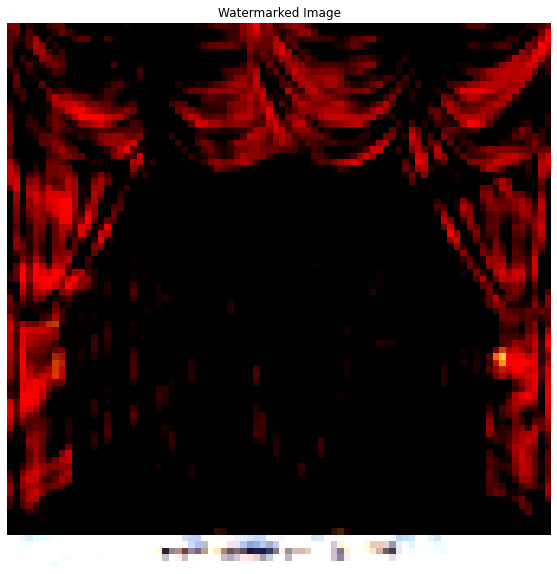

 73%|███████▎  | 8/11 [01:05<00:24,  8.10s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 17: Target opacity: 0.35, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: False, Base class predicted: False


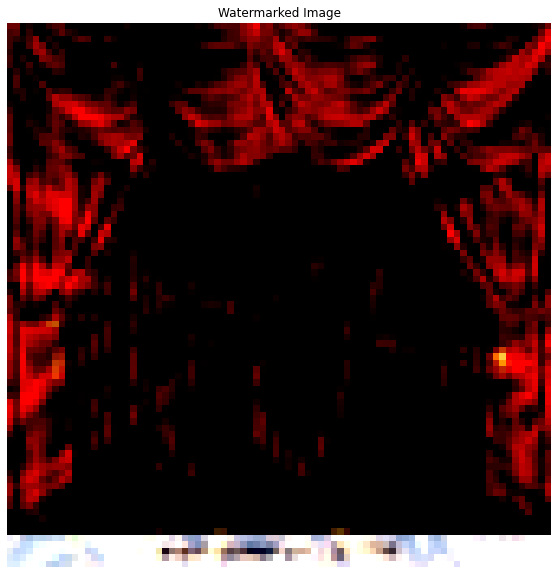

 82%|████████▏ | 9/11 [01:13<00:16,  8.08s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 17: Target opacity: 0.4, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: False, Base class predicted: False


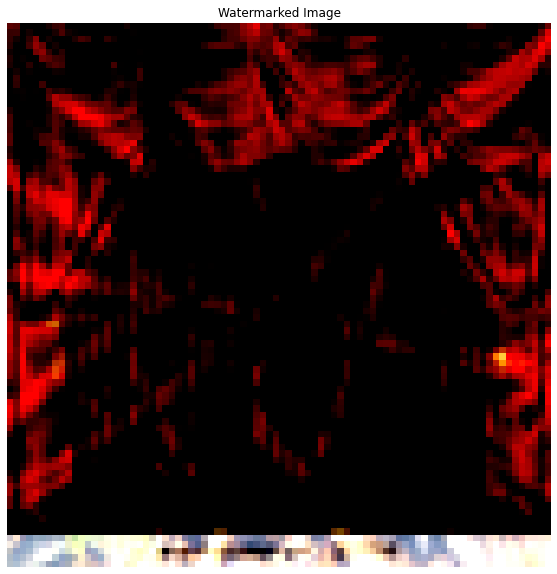

 91%|█████████ | 10/11 [01:21<00:08,  8.08s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 17: Target opacity: 0.45, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: False, Base class predicted: False


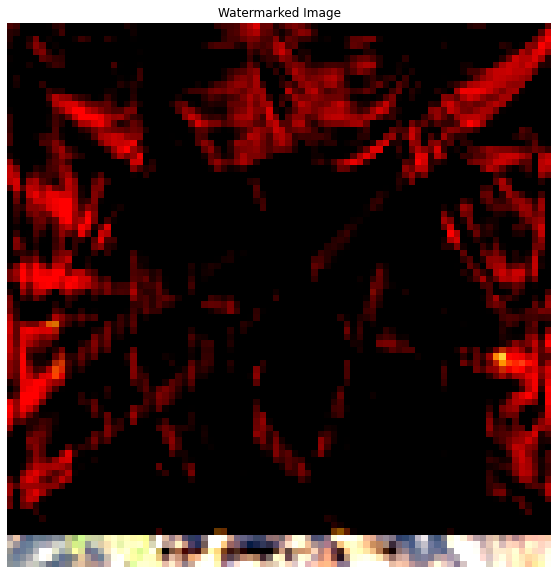

100%|██████████| 11/11 [01:29<00:00,  8.11s/it]

Iteration 17: Target opacity: 0.5, Labeled correctly: 0.5733333333333334, Correctly Predicted Target: False, Base class predicted: False



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


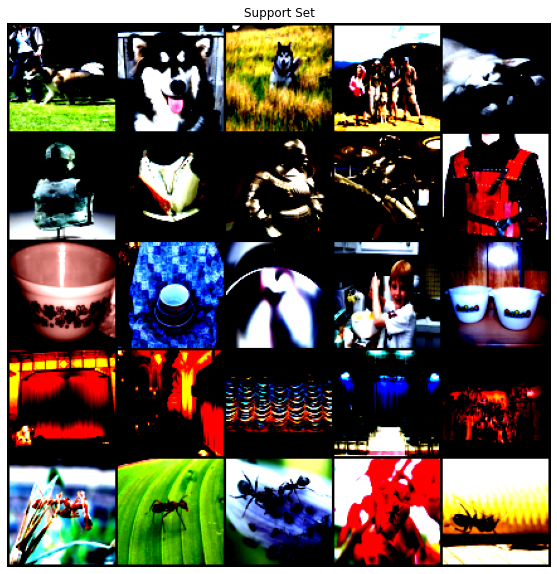

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 2, 2, 2, 2,
         2]])


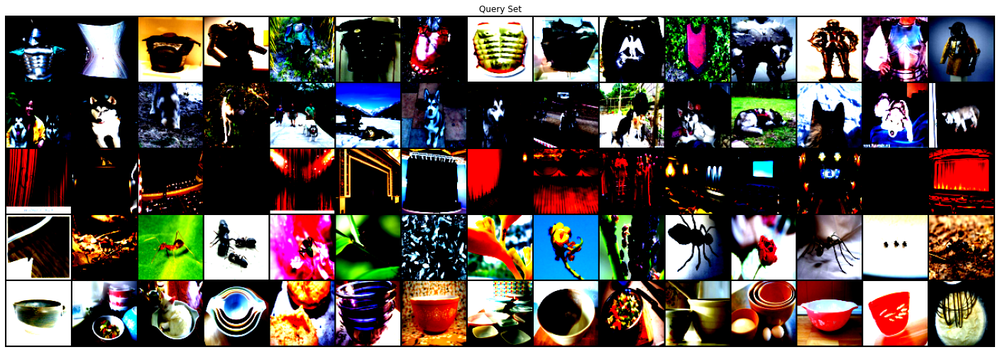

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 4, 4, 4, 4,
         4, 4, 4, 4, 4, 4, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 2, 2, 2,
         2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3,
         3, 3, 3]])
target_class 0
unique_classes [1, 2, 3, 4]
base_class 3
target_indices [ 0  1  2  3  4  5  6  7  8  9 10 11 12 13 14]
target_index 5
base_indices [10 11 12 13 14]
base_index 13


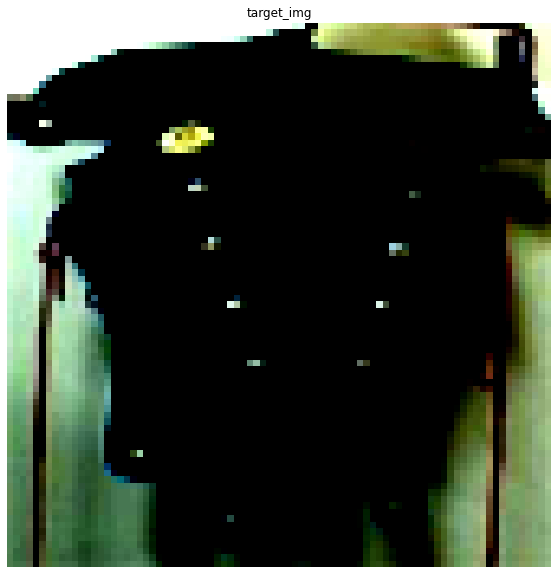

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


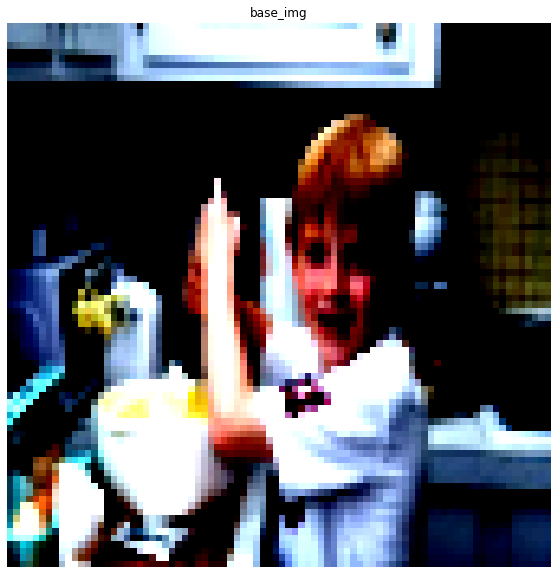

  0%|          | 3/1000 [00:00<00:34, 28.87it/s]

Iteration 0
loss: tensor(4.2297, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(89.8797, grad_fn=<PowBackward0>)
Iteration 2
loss: tensor(23.1564, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(17.8845, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(73.7605, grad_fn=<PowBackward0>)
Iteration 5
loss: tensor(31.4097, grad_fn=<PowBackward0>)

  1%|          | 9/1000 [00:00<00:37, 26.35it/s]


Iteration 6
loss: tensor(35.4105, grad_fn=<PowBackward0>)
Iteration 7
loss: tensor(33.8160, grad_fn=<PowBackward0>)
Iteration 8
loss: tensor(45.7837, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(13.4589, grad_fn=<PowBackward0>)
Iteration 10
loss: tensor(37.8903, grad_fn=<PowBackward0>)


  2%|▏         | 15/1000 [00:00<00:39, 24.63it/s]

Iteration 11
loss: tensor(50.1042, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(38.3392, grad_fn=<PowBackward0>)
Iteration 13
loss: tensor(24.6271, grad_fn=<PowBackward0>)
Iteration 14
loss: tensor(56.1624, grad_fn=<PowBackward0>)
Iteration 15
loss: tensor(23.7006, grad_fn=<PowBackward0>)


  2%|▏         | 21/1000 [00:00<00:38, 25.29it/s]

Iteration 16
loss: tensor(47.8678, grad_fn=<PowBackward0>)
Iteration 17
loss: tensor(10.2560, grad_fn=<PowBackward0>)
Iteration 18
loss: tensor(31.6067, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(66.0909, grad_fn=<PowBackward0>)
Iteration 20
loss: tensor(31.7699, grad_fn=<PowBackward0>)
Iteration 21


  3%|▎         | 27/1000 [00:01<00:37, 26.18it/s]

loss: tensor(21.0245, grad_fn=<PowBackward0>)
Iteration 22
loss: tensor(40.8401, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(25.5691, grad_fn=<PowBackward0>)
Iteration 24
loss: tensor(40.4375, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(19.4879, grad_fn=<PowBackward0>)
Iteration 26
loss: tensor(76.0967, grad_fn=<PowBackward0>)


  3%|▎         | 30/1000 [00:01<00:38, 25.42it/s]

Iteration 27
loss: tensor(17.9374, grad_fn=<PowBackward0>)
Iteration 28
loss: tensor(20.1845, grad_fn=<PowBackward0>)
Iteration 29
loss: tensor(31.5937, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(100.1769, grad_fn=<PowBackward0>)
Iteration 31
loss: tensor(19.3507, grad_fn=<PowBackward0>)


  4%|▎         | 36/1000 [00:01<00:38, 25.36it/s]

Iteration 32
loss: tensor(23.2457, grad_fn=<PowBackward0>)
Iteration 33
loss: tensor(49.7464, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(39.5557, grad_fn=<PowBackward0>)
Iteration 35
loss: tensor(3.7495, grad_fn=<PowBackward0>)
Iteration 36
loss: tensor(25.1067, grad_fn=<PowBackward0>)
Iteration 37


  4%|▍         | 42/1000 [00:01<00:37, 25.41it/s]

loss: tensor(42.5826, grad_fn=<PowBackward0>)
Iteration 38
loss: tensor(38.1192, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(11.7028, grad_fn=<PowBackward0>)
Iteration 40
loss: tensor(54.3141, grad_fn=<PowBackward0>)
Iteration 41
loss: tensor(16.7163, grad_fn=<PowBackward0>)
Iteration 42
loss: tensor(27.3982, grad_fn=<PowBackward0>)


  5%|▍         | 48/1000 [00:01<00:36, 26.25it/s]

Iteration 43
loss: tensor(19.9271, grad_fn=<PowBackward0>)
Iteration 44
loss: tensor(76.7981, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(18.4767, grad_fn=<PowBackward0>)
Iteration 46
loss: tensor(25.1349, grad_fn=<PowBackward0>)
Iteration 47
loss: tensor(17.4849, grad_fn=<PowBackward0>)
Iteration 48
loss: 

  5%|▌         | 51/1000 [00:02<00:37, 25.27it/s]

tensor(78.0113, grad_fn=<PowBackward0>)
Iteration 49
loss: tensor(9.8262, grad_fn=<PowBackward0>)
Iteration 50
loss: tensor(13.8551, grad_fn=<PowBackward0>)
Iteration 51
loss: tensor(36.3843, grad_fn=<PowBackward0>)
Iteration 52
loss: tensor(115.2629, grad_fn=<PowBackward0>)
Iteration 53
loss: tensor(12.2689, grad_fn=<PowBackward0>)


  6%|▌         | 57/1000 [00:02<00:36, 25.76it/s]

Iteration 54
loss: tensor(23.3387, grad_fn=<PowBackward0>)
Iteration 55
loss: tensor(33.0968, grad_fn=<PowBackward0>)
Iteration 56
loss: tensor(54.8063, grad_fn=<PowBackward0>)
Iteration 57
loss: tensor(17.9965, grad_fn=<PowBackward0>)
Iteration 58
loss: tensor(25.2654, grad_fn=<PowBackward0>)
Iteration 59


  6%|▋         | 63/1000 [00:02<00:36, 25.81it/s]

loss: tensor(16.3733, grad_fn=<PowBackward0>)
Iteration 60
loss: tensor(75.7541, grad_fn=<PowBackward0>)
Iteration 61
loss: tensor(35.7416, grad_fn=<PowBackward0>)
Iteration 62
loss: tensor(19.8772, grad_fn=<PowBackward0>)
Iteration 63
loss: tensor(25.5253, grad_fn=<PowBackward0>)
Iteration 64
loss: tensor(97.2336, grad_fn=<PowBackward0>)

  7%|▋         | 69/1000 [00:02<00:35, 25.96it/s]


Iteration 65
loss: tensor(23.8912, grad_fn=<PowBackward0>)
Iteration 66
loss: tensor(25.4927, grad_fn=<PowBackward0>)
Iteration 67
loss: tensor(20.7280, grad_fn=<PowBackward0>)
Iteration 68
loss: tensor(60.4799, grad_fn=<PowBackward0>)
Iteration 69
loss: tensor(25.6151, grad_fn=<PowBackward0>)


  8%|▊         | 75/1000 [00:02<00:35, 26.14it/s]

Iteration 70
loss: tensor(40.4969, grad_fn=<PowBackward0>)
Iteration 71
loss: tensor(16.0275, grad_fn=<PowBackward0>)
Iteration 72
loss: tensor(40.6533, grad_fn=<PowBackward0>)
Iteration 73
loss: tensor(30.3075, grad_fn=<PowBackward0>)
Iteration 74
loss: tensor(35.1091, grad_fn=<PowBackward0>)
Iteration 75


  8%|▊         | 81/1000 [00:03<00:34, 26.37it/s]

loss: tensor(20.5310, grad_fn=<PowBackward0>)
Iteration 76
loss: tensor(57.9490, grad_fn=<PowBackward0>)
Iteration 77
loss: tensor(25.1218, grad_fn=<PowBackward0>)
Iteration 78
loss: tensor(17.0051, grad_fn=<PowBackward0>)
Iteration 79
loss: tensor(21.0851, grad_fn=<PowBackward0>)
Iteration 80
loss: tensor(82.4708, grad_fn=<PowBackward0>)


  8%|▊         | 84/1000 [00:03<00:35, 26.09it/s]

Iteration 81
loss: tensor(14.6193, grad_fn=<PowBackward0>)
Iteration 82
loss: tensor(26.9595, grad_fn=<PowBackward0>)
Iteration 83
loss: tensor(34.3472, grad_fn=<PowBackward0>)
Iteration 84
loss: tensor(84.4838, grad_fn=<PowBackward0>)
Iteration 85
loss: tensor(1.4416, grad_fn=<PowBackward0>)
Iteration 86


  9%|▉         | 90/1000 [00:03<00:35, 25.33it/s]

loss: tensor(8.0617, grad_fn=<PowBackward0>)
Iteration 87
loss: tensor(25.6782, grad_fn=<PowBackward0>)
Iteration 88
loss: tensor(70.3546, grad_fn=<PowBackward0>)
Iteration 89
loss: tensor(20.9565, grad_fn=<PowBackward0>)
Iteration 90
loss: tensor(25.5527, grad_fn=<PowBackward0>)
Iteration 91


 10%|▉         | 96/1000 [00:03<00:36, 24.49it/s]

loss: tensor(35.4005, grad_fn=<PowBackward0>)
Iteration 92
loss: tensor(38.9233, grad_fn=<PowBackward0>)
Iteration 93
loss: tensor(20.7756, grad_fn=<PowBackward0>)
Iteration 94
loss: tensor(18.3872, grad_fn=<PowBackward0>)
Iteration 95
loss: tensor(19.8905, grad_fn=<PowBackward0>)
Iteration 96


 10%|█         | 102/1000 [00:03<00:35, 25.53it/s]

loss: tensor(81.1506, grad_fn=<PowBackward0>)
Iteration 97
loss: tensor(14.2742, grad_fn=<PowBackward0>)
Iteration 98
loss: tensor(28.1087, grad_fn=<PowBackward0>)
Iteration 99
loss: tensor(29.7791, grad_fn=<PowBackward0>)
Iteration 100
loss: tensor(44.9873, grad_fn=<PowBackward0>)
Iteration 101
loss: tensor(29.5648, grad_fn=<PowBackward0>)
Iteration 102


 10%|█         | 105/1000 [00:04<00:35, 25.53it/s]

loss: tensor(8.1983, grad_fn=<PowBackward0>)
Iteration 103
loss: tensor(23.9608, grad_fn=<PowBackward0>)
Iteration 104
loss: tensor(51.3801, grad_fn=<PowBackward0>)
Iteration 105
loss: tensor(29.3509, grad_fn=<PowBackward0>)
Iteration 106
loss: tensor(22.9998, grad_fn=<PowBackward0>)
Iteration 107
loss: tensor(22.8629, grad_fn=<PowBackward0>)


 11%|█         | 111/1000 [00:04<00:34, 25.64it/s]

Iteration 108
loss: tensor(26.0144, grad_fn=<PowBackward0>)
Iteration 109
loss: tensor(21.2965, grad_fn=<PowBackward0>)
Iteration 110
loss: tensor(66.4757, grad_fn=<PowBackward0>)
Iteration 111
loss: tensor(28.4933, grad_fn=<PowBackward0>)
Iteration 112
loss: tensor(24.1345, grad_fn=<PowBackward0>)
Iteration 113
loss: tensor(19.8886, grad_fn=<PowBackward0>)


 12%|█▏        | 117/1000 [00:04<00:34, 25.71it/s]

Iteration 114
loss: tensor(64.1710, grad_fn=<PowBackward0>)
Iteration 115
loss: tensor(24.3984, grad_fn=<PowBackward0>)
Iteration 116
loss: tensor(20.3196, grad_fn=<PowBackward0>)
Iteration 117
loss: tensor(25.3489, grad_fn=<PowBackward0>)
Iteration 118
loss: tensor(76.3549, grad_fn=<PowBackward0>)
Iteration 119


 12%|█▏        | 123/1000 [00:04<00:33, 25.94it/s]

loss: tensor(29.2291, grad_fn=<PowBackward0>)
Iteration 120
loss: tensor(19.1520, grad_fn=<PowBackward0>)
Iteration 121
loss: tensor(19.1737, grad_fn=<PowBackward0>)
Iteration 122
loss: tensor(63.3266, grad_fn=<PowBackward0>)
Iteration 123
loss: tensor(8.8062, grad_fn=<PowBackward0>)
Iteration 124
loss: tensor(14.3727, grad_fn=<PowBackward0>)


 13%|█▎        | 129/1000 [00:05<00:32, 26.45it/s]

Iteration 125
loss: tensor(15.7755, grad_fn=<PowBackward0>)
Iteration 126
loss: tensor(82.6012, grad_fn=<PowBackward0>)
Iteration 127
loss: tensor(43.3278, grad_fn=<PowBackward0>)
Iteration 128
loss: tensor(6.1506, grad_fn=<PowBackward0>)
Iteration 129
loss: tensor(8.5501, grad_fn=<PowBackward0>)
Iteration 130


 14%|█▎        | 135/1000 [00:05<00:33, 25.89it/s]

loss: tensor(61.1684, grad_fn=<PowBackward0>)
Iteration 131
loss: tensor(25.9328, grad_fn=<PowBackward0>)
Iteration 132
loss: tensor(17.8201, grad_fn=<PowBackward0>)
Iteration 133
loss: tensor(23.1501, grad_fn=<PowBackward0>)
Iteration 134
loss: tensor(63.4434, grad_fn=<PowBackward0>)
Iteration 135
loss: tensor(33.5077, grad_fn=<PowBackward0>)


 14%|█▍        | 141/1000 [00:05<00:32, 26.14it/s]

Iteration 136
loss: tensor(17.5557, grad_fn=<PowBackward0>)
Iteration 137
loss: tensor(26.9158, grad_fn=<PowBackward0>)
Iteration 138
loss: tensor(52.2394, grad_fn=<PowBackward0>)
Iteration 139
loss: tensor(37.7726, grad_fn=<PowBackward0>)
Iteration 140
loss: tensor(26.1406, grad_fn=<PowBackward0>)
Iteration 141
loss:

 14%|█▍        | 144/1000 [00:05<00:33, 25.44it/s]

 tensor(23.2652, grad_fn=<PowBackward0>)
Iteration 142
loss: tensor(46.1461, grad_fn=<PowBackward0>)
Iteration 143
loss: tensor(33.4252, grad_fn=<PowBackward0>)
Iteration 144
loss: tensor(43.5512, grad_fn=<PowBackward0>)
Iteration 145
loss: tensor(41.1319, grad_fn=<PowBackward0>)
Iteration 146
loss: tensor(26.0018, grad_fn=<PowBackward0>)


 15%|█▌        | 150/1000 [00:05<00:32, 26.30it/s]

Iteration 147
loss: tensor(39.5568, grad_fn=<PowBackward0>)
Iteration 148
loss: tensor(40.6155, grad_fn=<PowBackward0>)
Iteration 149
loss: tensor(18.9930, grad_fn=<PowBackward0>)
Iteration 150
loss: tensor(28.9475, grad_fn=<PowBackward0>)
Iteration 151
loss: tensor(35.4365, grad_fn=<PowBackward0>)


 16%|█▌        | 156/1000 [00:06<00:33, 25.29it/s]

Iteration 152
loss: tensor(23.7189, grad_fn=<PowBackward0>)
Iteration 153
loss: tensor(18.7759, grad_fn=<PowBackward0>)
Iteration 154
loss: tensor(29.3043, grad_fn=<PowBackward0>)
Iteration 155
loss: tensor(19.6197, grad_fn=<PowBackward0>)
Iteration 156
loss: tensor(37.3746, grad_fn=<PowBackward0>)
Iteration 157


 16%|█▌        | 162/1000 [00:06<00:32, 25.46it/s]

loss: tensor(24.0366, grad_fn=<PowBackward0>)
Iteration 158
loss: tensor(53.8404, grad_fn=<PowBackward0>)
Iteration 159
loss: tensor(16.4090, grad_fn=<PowBackward0>)
Iteration 160
loss: tensor(55.4407, grad_fn=<PowBackward0>)
Iteration 161
loss: tensor(26.5071, grad_fn=<PowBackward0>)
Iteration 162
loss: tensor(35.4675, grad_fn=<PowBackward0>)


 17%|█▋        | 168/1000 [00:06<00:32, 25.81it/s]

Iteration 163
loss: tensor(33.9664, grad_fn=<PowBackward0>)
Iteration 164
loss: tensor(37.7212, grad_fn=<PowBackward0>)
Iteration 165
loss: tensor(24.5767, grad_fn=<PowBackward0>)
Iteration 166
loss: tensor(27.3473, grad_fn=<PowBackward0>)
Iteration 167
loss: tensor(15.7988, grad_fn=<PowBackward0>)
Iteration 168


 17%|█▋        | 171/1000 [00:06<00:33, 25.08it/s]

loss: tensor(42.0263, grad_fn=<PowBackward0>)
Iteration 169
loss: tensor(21.5407, grad_fn=<PowBackward0>)
Iteration 170
loss: tensor(29.9370, grad_fn=<PowBackward0>)
Iteration 171
loss: tensor(14.3307, grad_fn=<PowBackward0>)
Iteration 172
loss: tensor(55.7081, grad_fn=<PowBackward0>)
Iteration 173
loss: tensor(27.4330, grad_fn=<PowBackward0>)


 18%|█▊        | 177/1000 [00:06<00:32, 25.02it/s]

Iteration 174
loss: tensor(43.2323, grad_fn=<PowBackward0>)
Iteration 175
loss: tensor(12.5189, grad_fn=<PowBackward0>)
Iteration 176
loss: tensor(15.2451, grad_fn=<PowBackward0>)
Iteration 177
loss: tensor(29.6795, grad_fn=<PowBackward0>)
Iteration 178
loss: tensor(24.6460, grad_fn=<PowBackward0>)
Iteration 179


 18%|█▊        | 183/1000 [00:07<00:31, 25.57it/s]

loss: tensor(21.9012, grad_fn=<PowBackward0>)
Iteration 180
loss: tensor(10.3129, grad_fn=<PowBackward0>)
Iteration 181
loss: tensor(10.9204, grad_fn=<PowBackward0>)
Iteration 182
loss: tensor(57.0916, grad_fn=<PowBackward0>)
Iteration 183
loss: tensor(40.6369, grad_fn=<PowBackward0>)
Iteration 184
loss: tensor(13.2348, grad_fn=<PowBackward0>)


 19%|█▉        | 189/1000 [00:07<00:30, 26.30it/s]

Iteration 185
loss: tensor(25.4360, grad_fn=<PowBackward0>)
Iteration 186
loss: tensor(53.9247, grad_fn=<PowBackward0>)
Iteration 187
loss: tensor(40.1282, grad_fn=<PowBackward0>)
Iteration 188
loss: tensor(31.3947, grad_fn=<PowBackward0>)
Iteration 189
loss: tensor(20.4917, grad_fn=<PowBackward0>)
Iteration 190


 20%|█▉        | 195/1000 [00:07<00:32, 25.13it/s]

loss: tensor(10.9255, grad_fn=<PowBackward0>)
Iteration 191
loss: tensor(13.2850, grad_fn=<PowBackward0>)
Iteration 192
loss: tensor(52.3685, grad_fn=<PowBackward0>)
Iteration 193
loss: tensor(35.1855, grad_fn=<PowBackward0>)
Iteration 194
loss: tensor(37.4021, grad_fn=<PowBackward0>)
Iteration 195


 20%|█▉        | 198/1000 [00:07<00:32, 24.89it/s]

loss: tensor(26.5921, grad_fn=<PowBackward0>)
Iteration 196
loss: tensor(36.4423, grad_fn=<PowBackward0>)
Iteration 197
loss: tensor(20.5565, grad_fn=<PowBackward0>)
Iteration 198
loss: tensor(19.9012, grad_fn=<PowBackward0>)
Iteration 199
loss: tensor(28.9918, grad_fn=<PowBackward0>)
Iteration 200
loss: tensor(29.1428, grad_fn=<PowBackward0>)


 20%|██        | 204/1000 [00:07<00:30, 26.04it/s]

Iteration 201
loss: tensor(26.6378, grad_fn=<PowBackward0>)
Iteration 202
loss: tensor(6.1461, grad_fn=<PowBackward0>)
Iteration 203
loss: tensor(5.5406, grad_fn=<PowBackward0>)
Iteration 204
loss: tensor(10.1372, grad_fn=<PowBackward0>)
Iteration 205
loss: tensor(18.7162, grad_fn=<PowBackward0>)
Iteration 206


 21%|██        | 210/1000 [00:08<00:30, 25.76it/s]

loss: tensor(26.9174, grad_fn=<PowBackward0>)
Iteration 207
loss: tensor(28.2208, grad_fn=<PowBackward0>)
Iteration 208
loss: tensor(17.6683, grad_fn=<PowBackward0>)
Iteration 209
loss: tensor(13.2288, grad_fn=<PowBackward0>)
Iteration 210
loss: tensor(11.9076, grad_fn=<PowBackward0>)
Iteration 211
loss: tensor(18.6853, grad_fn=<PowBackward0>)
Iteration 212


 22%|██▏       | 216/1000 [00:08<00:30, 25.90it/s]

loss: tensor(28.2329, grad_fn=<PowBackward0>)
Iteration 213
loss: tensor(16.9104, grad_fn=<PowBackward0>)
Iteration 214
loss: tensor(13.2893, grad_fn=<PowBackward0>)
Iteration 215
loss: tensor(15.4873, grad_fn=<PowBackward0>)
Iteration 216
loss: tensor(15.1216, grad_fn=<PowBackward0>)
Iteration 217
loss: tensor(18.1586, grad_fn=<PowBackward0>)


 22%|██▏       | 222/1000 [00:08<00:30, 25.17it/s]

Iteration 218
loss: tensor(37.4473, grad_fn=<PowBackward0>)
Iteration 219
loss: tensor(27.0049, grad_fn=<PowBackward0>)
Iteration 220
loss: tensor(18.7905, grad_fn=<PowBackward0>)
Iteration 221
loss: tensor(13.8675, grad_fn=<PowBackward0>)
Iteration 222
loss: tensor(21.2822, grad_fn=<PowBackward0>)


 23%|██▎       | 228/1000 [00:08<00:29, 26.00it/s]

Iteration 223
loss: tensor(17.3273, grad_fn=<PowBackward0>)
Iteration 224
loss: tensor(20.0333, grad_fn=<PowBackward0>)
Iteration 225
loss: tensor(15.6049, grad_fn=<PowBackward0>)
Iteration 226
loss: tensor(25.8094, grad_fn=<PowBackward0>)
Iteration 227
loss: tensor(11.0265, grad_fn=<PowBackward0>)
Iteration 228


 23%|██▎       | 231/1000 [00:09<00:31, 24.25it/s]

loss: tensor(14.2829, grad_fn=<PowBackward0>)
Iteration 229
loss: tensor(14.6364, grad_fn=<PowBackward0>)
Iteration 230
loss: tensor(23.2337, grad_fn=<PowBackward0>)
Iteration 231
loss: tensor(20.2579, grad_fn=<PowBackward0>)
Iteration 232
loss: tensor(20.7676, grad_fn=<PowBackward0>)
Iteration 233
loss: tensor(28.4621, grad_fn=<PowBackward0>)


 24%|██▎       | 237/1000 [00:09<00:29, 25.71it/s]

Iteration 234
loss: tensor(19.0963, grad_fn=<PowBackward0>)
Iteration 235
loss: tensor(9.3080, grad_fn=<PowBackward0>)
Iteration 236
loss: tensor(15.8779, grad_fn=<PowBackward0>)
Iteration 237
loss: tensor(20.8288, grad_fn=<PowBackward0>)
Iteration 238
loss: tensor(14.9155, grad_fn=<PowBackward0>)
Iteration 239


 24%|██▍       | 243/1000 [00:09<00:29, 25.73it/s]

loss: tensor(15.8229, grad_fn=<PowBackward0>)
Iteration 240
loss: tensor(14.1046, grad_fn=<PowBackward0>)
Iteration 241
loss: tensor(12.0748, grad_fn=<PowBackward0>)
Iteration 242
loss: tensor(33.7344, grad_fn=<PowBackward0>)
Iteration 243
loss: tensor(25.6956, grad_fn=<PowBackward0>)
Iteration 244
loss: tensor(27.6096, grad_fn=<PowBackward0>)


 25%|██▍       | 249/1000 [00:09<00:29, 25.23it/s]

Iteration 245
loss: tensor(21.0250, grad_fn=<PowBackward0>)
Iteration 246
loss: tensor(32.1748, grad_fn=<PowBackward0>)
Iteration 247
loss: tensor(16.1589, grad_fn=<PowBackward0>)
Iteration 248
loss: tensor(11.9515, grad_fn=<PowBackward0>)
Iteration 249
loss: tensor(14.3246, grad_fn=<PowBackward0>)


 26%|██▌       | 255/1000 [00:09<00:29, 25.59it/s]

Iteration 250
loss: tensor(27.4214, grad_fn=<PowBackward0>)
Iteration 251
loss: tensor(17.0710, grad_fn=<PowBackward0>)
Iteration 252
loss: tensor(19.9407, grad_fn=<PowBackward0>)
Iteration 253
loss: tensor(15.3158, grad_fn=<PowBackward0>)
Iteration 254
loss: tensor(11.2564, grad_fn=<PowBackward0>)
Iteration 255


 26%|██▌       | 258/1000 [00:10<00:29, 25.36it/s]

loss: tensor(19.3589, grad_fn=<PowBackward0>)
Iteration 256
loss: tensor(24.9316, grad_fn=<PowBackward0>)
Iteration 257
loss: tensor(12.0253, grad_fn=<PowBackward0>)
Iteration 258
loss: tensor(8.6425, grad_fn=<PowBackward0>)
Iteration 259
loss: tensor(10.1119, grad_fn=<PowBackward0>)
Iteration 260
loss: tensor(33.2551, grad_fn=<PowBackward0>)


 26%|██▋       | 264/1000 [00:10<00:29, 24.81it/s]

Iteration 261
loss: tensor(32.3756, grad_fn=<PowBackward0>)
Iteration 262
loss: tensor(15.8166, grad_fn=<PowBackward0>)
Iteration 263
loss: tensor(17.0098, grad_fn=<PowBackward0>)
Iteration 264
loss: tensor(19.4735, grad_fn=<PowBackward0>)
Iteration 265
loss: tensor(15.1850, grad_fn=<PowBackward0>)
Iteration 266


 27%|██▋       | 270/1000 [00:10<00:28, 25.79it/s]

loss: tensor(23.8389, grad_fn=<PowBackward0>)
Iteration 267
loss: tensor(15.5128, grad_fn=<PowBackward0>)
Iteration 268
loss: tensor(16.6612, grad_fn=<PowBackward0>)
Iteration 269
loss: tensor(20.3048, grad_fn=<PowBackward0>)
Iteration 270
loss: tensor(20.2455, grad_fn=<PowBackward0>)
Iteration 271
loss: tensor(17.8095, grad_fn=<PowBackward0>)


 28%|██▊       | 276/1000 [00:10<00:28, 25.47it/s]

Iteration 272
loss: tensor(11.9003, grad_fn=<PowBackward0>)
Iteration 273
loss: tensor(13.5331, grad_fn=<PowBackward0>)
Iteration 274
loss: tensor(20.6004, grad_fn=<PowBackward0>)
Iteration 275
loss: tensor(18.3297, grad_fn=<PowBackward0>)
Iteration 276
loss: tensor(13.7958, grad_fn=<PowBackward0>)
Iteration 277


 28%|██▊       | 282/1000 [00:11<00:27, 25.86it/s]

loss: tensor(8.6648, grad_fn=<PowBackward0>)
Iteration 278
loss: tensor(19.4422, grad_fn=<PowBackward0>)
Iteration 279
loss: tensor(31.0193, grad_fn=<PowBackward0>)
Iteration 280
loss: tensor(19.4626, grad_fn=<PowBackward0>)
Iteration 281
loss: tensor(19.3110, grad_fn=<PowBackward0>)
Iteration 282


 28%|██▊       | 285/1000 [00:11<00:29, 24.53it/s]

loss: tensor(11.7825, grad_fn=<PowBackward0>)
Iteration 283
loss: tensor(11.3661, grad_fn=<PowBackward0>)
Iteration 284
loss: tensor(18.1667, grad_fn=<PowBackward0>)
Iteration 285
loss: tensor(21.1229, grad_fn=<PowBackward0>)
Iteration 286
loss: tensor(14.4499, grad_fn=<PowBackward0>)
Iteration 287
loss: tensor(16.0811, grad_fn=<PowBackward0>)


 29%|██▉       | 291/1000 [00:11<00:28, 25.03it/s]

Iteration 288
loss: tensor(17.2100, grad_fn=<PowBackward0>)
Iteration 289
loss: tensor(11.2448, grad_fn=<PowBackward0>)
Iteration 290
loss: tensor(13.2715, grad_fn=<PowBackward0>)
Iteration 291
loss: tensor(16.9165, grad_fn=<PowBackward0>)
Iteration 292
loss: tensor(29.5035, grad_fn=<PowBackward0>)
Iteration 293


 30%|██▉       | 297/1000 [00:11<00:27, 25.42it/s]

loss: tensor(16.4042, grad_fn=<PowBackward0>)
Iteration 294
loss: tensor(19.8327, grad_fn=<PowBackward0>)
Iteration 295
loss: tensor(22.2077, grad_fn=<PowBackward0>)
Iteration 296
loss: tensor(22.4789, grad_fn=<PowBackward0>)
Iteration 297
loss: tensor(11.5666, grad_fn=<PowBackward0>)
Iteration 298
loss: tensor(15.3129, grad_fn=<PowBackward0>)

 30%|███       | 303/1000 [00:11<00:27, 25.14it/s]


Iteration 299
loss: tensor(12.4162, grad_fn=<PowBackward0>)
Iteration 300
loss: tensor(29.9700, grad_fn=<PowBackward0>)
Iteration 301
loss: tensor(23.0522, grad_fn=<PowBackward0>)
Iteration 302
loss: tensor(0.6842, grad_fn=<PowBackward0>)
Iteration 303


 31%|███       | 309/1000 [00:12<00:26, 26.27it/s]

loss: tensor(0.2986, grad_fn=<PowBackward0>)
Iteration 304
loss: tensor(0.0733, grad_fn=<PowBackward0>)
Iteration 305
loss: tensor(0.1147, grad_fn=<PowBackward0>)
Iteration 306
loss: tensor(0.2677, grad_fn=<PowBackward0>)
Iteration 307
loss: tensor(0.7253, grad_fn=<PowBackward0>)
Iteration 308
loss: tensor(5.2486, grad_fn=<PowBackward0>)


 31%|███       | 312/1000 [00:12<00:26, 26.22it/s]

Iteration 309
loss: tensor(16.8635, grad_fn=<PowBackward0>)
Iteration 310
loss: tensor(21.9998, grad_fn=<PowBackward0>)
Iteration 311
loss: tensor(9.8426, grad_fn=<PowBackward0>)
Iteration 312
loss: tensor(2.5912, grad_fn=<PowBackward0>)
Iteration 313
loss: tensor(0.7780, grad_fn=<PowBackward0>)
Iteration 314
loss: tensor(0.8741, grad_fn=<PowBackward0>)


 32%|███▏      | 318/1000 [00:12<00:26, 25.28it/s]

Iteration 315
loss: tensor(0.5171, grad_fn=<PowBackward0>)
Iteration 316
loss: tensor(1.9229, grad_fn=<PowBackward0>)
Iteration 317
loss: tensor(3.8093, grad_fn=<PowBackward0>)
Iteration 318
loss: tensor(12.9406, grad_fn=<PowBackward0>)
Iteration 319
loss: tensor(12.4547, grad_fn=<PowBackward0>)


 32%|███▏      | 324/1000 [00:12<00:26, 25.18it/s]

Iteration 320
loss: tensor(9.9925, grad_fn=<PowBackward0>)
Iteration 321
loss: tensor(7.3108, grad_fn=<PowBackward0>)
Iteration 322
loss: tensor(5.7466, grad_fn=<PowBackward0>)
Iteration 323
loss: tensor(4.1048, grad_fn=<PowBackward0>)
Iteration 324
loss: tensor(5.4697, grad_fn=<PowBackward0>)
Iteration 325


 33%|███▎      | 330/1000 [00:12<00:27, 24.59it/s]

loss: tensor(6.1323, grad_fn=<PowBackward0>)
Iteration 326
loss: tensor(8.0770, grad_fn=<PowBackward0>)
Iteration 327
loss: tensor(7.5980, grad_fn=<PowBackward0>)
Iteration 328
loss: tensor(12.3713, grad_fn=<PowBackward0>)
Iteration 329
loss: tensor(13.8597, grad_fn=<PowBackward0>)
Iteration 330
loss: tensor(11.4584, grad_fn=<PowBackward0>)


 34%|███▎      | 336/1000 [00:13<00:27, 24.58it/s]

Iteration 331
loss: tensor(5.5607, grad_fn=<PowBackward0>)
Iteration 332
loss: tensor(4.3515, grad_fn=<PowBackward0>)
Iteration 333
loss: tensor(2.7531, grad_fn=<PowBackward0>)
Iteration 334
loss: tensor(3.3044, grad_fn=<PowBackward0>)
Iteration 335
loss: tensor(3.1106, grad_fn=<PowBackward0>)


 34%|███▍      | 339/1000 [00:13<00:26, 24.63it/s]

Iteration 336
loss: tensor(5.0237, grad_fn=<PowBackward0>)
Iteration 337
loss: tensor(5.3395, grad_fn=<PowBackward0>)
Iteration 338
loss: tensor(7.9649, grad_fn=<PowBackward0>)
Iteration 339
loss: tensor(7.8522, grad_fn=<PowBackward0>)
Iteration 340
loss: tensor(9.1606, grad_fn=<PowBackward0>)
Iteration 341


 34%|███▍      | 345/1000 [00:13<00:25, 25.59it/s]

loss: tensor(7.0647, grad_fn=<PowBackward0>)
Iteration 342
loss: tensor(5.2938, grad_fn=<PowBackward0>)
Iteration 343
loss: tensor(3.9020, grad_fn=<PowBackward0>)
Iteration 344
loss: tensor(5.4788, grad_fn=<PowBackward0>)
Iteration 345
loss: tensor(4.4797, grad_fn=<PowBackward0>)
Iteration 346
loss: tensor(5.3839, grad_fn=<PowBackward0>)


 35%|███▌      | 351/1000 [00:13<00:25, 25.57it/s]

Iteration 347
loss: tensor(5.4055, grad_fn=<PowBackward0>)
Iteration 348
loss: tensor(8.8753, grad_fn=<PowBackward0>)
Iteration 349
loss: tensor(8.0614, grad_fn=<PowBackward0>)
Iteration 350
loss: tensor(8.5795, grad_fn=<PowBackward0>)
Iteration 351
loss: tensor(7.2764, grad_fn=<PowBackward0>)
Iteration 352


 36%|███▌      | 357/1000 [00:14<00:25, 25.69it/s]

loss: tensor(10.2787, grad_fn=<PowBackward0>)
Iteration 353
loss: tensor(9.2892, grad_fn=<PowBackward0>)
Iteration 354
loss: tensor(7.2510, grad_fn=<PowBackward0>)
Iteration 355
loss: tensor(5.3560, grad_fn=<PowBackward0>)
Iteration 356
loss: tensor(6.2236, grad_fn=<PowBackward0>)
Iteration 357
loss: tensor(4.4928, grad_fn=<PowBackward0>)


 36%|███▌      | 360/1000 [00:14<00:25, 24.91it/s]

Iteration 358
loss: tensor(5.3819, grad_fn=<PowBackward0>)
Iteration 359
loss: tensor(5.7255, grad_fn=<PowBackward0>)
Iteration 360
loss: tensor(9.7801, grad_fn=<PowBackward0>)
Iteration 361
loss: tensor(8.6077, grad_fn=<PowBackward0>)
Iteration 362
loss: tensor(7.0830, grad_fn=<PowBackward0>)


 37%|███▋      | 366/1000 [00:14<00:25, 25.03it/s]

Iteration 363
loss: tensor(5.6935, grad_fn=<PowBackward0>)
Iteration 364
loss: tensor(7.4942, grad_fn=<PowBackward0>)
Iteration 365
loss: tensor(8.5834, grad_fn=<PowBackward0>)
Iteration 366
loss: tensor(9.4727, grad_fn=<PowBackward0>)
Iteration 367
loss: tensor(7.0548, grad_fn=<PowBackward0>)
Iteration 368


 37%|███▋      | 372/1000 [00:14<00:24, 25.16it/s]

loss: tensor(8.4904, grad_fn=<PowBackward0>)
Iteration 369
loss: tensor(7.5138, grad_fn=<PowBackward0>)
Iteration 370
loss: tensor(4.9454, grad_fn=<PowBackward0>)
Iteration 371
loss: tensor(4.6729, grad_fn=<PowBackward0>)
Iteration 372
loss: tensor(7.0682, grad_fn=<PowBackward0>)
Iteration 373
loss: tensor(4.7043, grad_fn=<PowBackward0>)


 38%|███▊      | 378/1000 [00:14<00:24, 25.77it/s]

Iteration 374
loss: tensor(7.8874, grad_fn=<PowBackward0>)
Iteration 375
loss: tensor(11.5784, grad_fn=<PowBackward0>)
Iteration 376
loss: tensor(11.6707, grad_fn=<PowBackward0>)
Iteration 377
loss: tensor(7.8614, grad_fn=<PowBackward0>)
Iteration 378
loss: tensor(8.0258, grad_fn=<PowBackward0>)
Iteration 379


 38%|███▊      | 384/1000 [00:15<00:24, 25.45it/s]

loss: tensor(5.3924, grad_fn=<PowBackward0>)
Iteration 380
loss: tensor(5.1714, grad_fn=<PowBackward0>)
Iteration 381
loss: tensor(5.1527, grad_fn=<PowBackward0>)
Iteration 382
loss: tensor(10.4799, grad_fn=<PowBackward0>)
Iteration 383
loss: tensor(10.8041, grad_fn=<PowBackward0>)
Iteration 384
loss: tensor(9.8228, grad_fn=<PowBackward0>)


 39%|███▉      | 390/1000 [00:15<00:23, 25.87it/s]

Iteration 385
loss: tensor(6.1359, grad_fn=<PowBackward0>)
Iteration 386
loss: tensor(6.1543, grad_fn=<PowBackward0>)
Iteration 387
loss: tensor(5.4274, grad_fn=<PowBackward0>)
Iteration 388
loss: tensor(5.2041, grad_fn=<PowBackward0>)
Iteration 389
loss: tensor(3.1002, grad_fn=<PowBackward0>)
Iteration 390


 40%|███▉      | 396/1000 [00:15<00:23, 26.19it/s]

loss: tensor(4.1191, grad_fn=<PowBackward0>)
Iteration 391
loss: tensor(3.6026, grad_fn=<PowBackward0>)
Iteration 392
loss: tensor(5.7592, grad_fn=<PowBackward0>)
Iteration 393
loss: tensor(8.3880, grad_fn=<PowBackward0>)
Iteration 394
loss: tensor(11.1737, grad_fn=<PowBackward0>)
Iteration 395
loss: tensor(10.8413, grad_fn=<PowBackward0>)


 40%|███▉      | 399/1000 [00:15<00:22, 26.40it/s]

Iteration 396
loss: tensor(7.6542, grad_fn=<PowBackward0>)
Iteration 397
loss: tensor(3.3195, grad_fn=<PowBackward0>)
Iteration 398
loss: tensor(2.6574, grad_fn=<PowBackward0>)
Iteration 399
loss: tensor(1.1799, grad_fn=<PowBackward0>)
Iteration 400
loss: tensor(2.4095, grad_fn=<PowBackward0>)
Iteration 401
loss: tensor(3.9518, grad_fn=<PowBackward0>)


 40%|████      | 405/1000 [00:15<00:23, 24.98it/s]

Iteration 402
loss: tensor(0.4360, grad_fn=<PowBackward0>)
Iteration 403
loss: tensor(0.0351, grad_fn=<PowBackward0>)
Iteration 404
loss: tensor(0.0574, grad_fn=<PowBackward0>)
Iteration 405
loss: tensor(0.0305, grad_fn=<PowBackward0>)
Iteration 406
loss: tensor(0.0406, grad_fn=<PowBackward0>)


 41%|████      | 411/1000 [00:16<00:22, 25.62it/s]

Iteration 407
loss: tensor(0.0274, grad_fn=<PowBackward0>)
Iteration 408
loss: tensor(0.0368, grad_fn=<PowBackward0>)
Iteration 409
loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 410
loss: tensor(0.0394, grad_fn=<PowBackward0>)
Iteration 411
loss: tensor(0.0164, grad_fn=<PowBackward0>)
Iteration 412
loss: tensor(0.0810, grad_fn=<PowBackward0>)


 42%|████▏     | 417/1000 [00:16<00:22, 26.17it/s]

Iteration 413
loss: tensor(0.0720, grad_fn=<PowBackward0>)
Iteration 414
loss: tensor(0.4507, grad_fn=<PowBackward0>)
Iteration 415
loss: tensor(1.0203, grad_fn=<PowBackward0>)
Iteration 416
loss: tensor(4.0077, grad_fn=<PowBackward0>)
Iteration 417
loss: tensor(7.2081, grad_fn=<PowBackward0>)
Iteration 418
loss:

 42%|████▏     | 423/1000 [00:16<00:21, 27.30it/s]

 tensor(7.9518, grad_fn=<PowBackward0>)
Iteration 419
loss: tensor(3.8789, grad_fn=<PowBackward0>)
Iteration 420
loss: tensor(1.3694, grad_fn=<PowBackward0>)
Iteration 421
loss: tensor(0.2346, grad_fn=<PowBackward0>)
Iteration 422
loss: tensor(0.1876, grad_fn=<PowBackward0>)
Iteration 423
loss: tensor(0.0382, grad_fn=<PowBackward0>)
Iteration 424


 43%|████▎     | 429/1000 [00:16<00:21, 25.99it/s]

loss: tensor(0.0985, grad_fn=<PowBackward0>)
Iteration 425
loss: tensor(0.0303, grad_fn=<PowBackward0>)
Iteration 426
loss: tensor(0.1335, grad_fn=<PowBackward0>)
Iteration 427
loss: tensor(0.0827, grad_fn=<PowBackward0>)
Iteration 428
loss: tensor(0.3148, grad_fn=<PowBackward0>)
Iteration 429
loss: tensor(0.3431, grad_fn=<PowBackward0>)


 44%|████▎     | 435/1000 [00:17<00:21, 26.59it/s]

Iteration 430
loss: tensor(1.0239, grad_fn=<PowBackward0>)
Iteration 431
loss: tensor(1.4753, grad_fn=<PowBackward0>)
Iteration 432
loss: tensor(2.5308, grad_fn=<PowBackward0>)
Iteration 433
loss: tensor(3.0253, grad_fn=<PowBackward0>)
Iteration 434
loss: tensor(5.4916, grad_fn=<PowBackward0>)
Iteration 435
loss: tensor(5.0733, grad_fn=<PowBackward0>)


 44%|████▍     | 441/1000 [00:17<00:20, 26.94it/s]

Iteration 436
loss: tensor(3.9551, grad_fn=<PowBackward0>)
Iteration 437
loss: tensor(1.9051, grad_fn=<PowBackward0>)
Iteration 438
loss: tensor(1.6069, grad_fn=<PowBackward0>)
Iteration 439
loss: tensor(0.8781, grad_fn=<PowBackward0>)
Iteration 440
loss: tensor(0.8121, grad_fn=<PowBackward0>)
Iteration 441
loss: tensor(0.3685, grad_fn=<PowBackward0>)


 45%|████▍     | 447/1000 [00:17<00:20, 26.43it/s]

Iteration 442
loss: tensor(0.5172, grad_fn=<PowBackward0>)
Iteration 443
loss: tensor(0.3191, grad_fn=<PowBackward0>)
Iteration 444
loss: tensor(0.6383, grad_fn=<PowBackward0>)
Iteration 445
loss: tensor(0.5770, grad_fn=<PowBackward0>)
Iteration 446
loss: tensor(1.0608, grad_fn=<PowBackward0>)
Iteration 447


 45%|████▌     | 450/1000 [00:17<00:21, 26.00it/s]

loss: tensor(1.0271, grad_fn=<PowBackward0>)
Iteration 448
loss: tensor(1.9546, grad_fn=<PowBackward0>)
Iteration 449
loss: tensor(1.8327, grad_fn=<PowBackward0>)
Iteration 450
loss: tensor(2.6508, grad_fn=<PowBackward0>)
Iteration 451
loss: tensor(2.0560, grad_fn=<PowBackward0>)
Iteration 452
loss: tensor(2.2101, grad_fn=<PowBackward0>)


 46%|████▌     | 456/1000 [00:17<00:20, 26.05it/s]

Iteration 453
loss: tensor(1.5140, grad_fn=<PowBackward0>)
Iteration 454
loss: tensor(1.4053, grad_fn=<PowBackward0>)
Iteration 455
loss: tensor(0.7746, grad_fn=<PowBackward0>)
Iteration 456
loss: tensor(0.7776, grad_fn=<PowBackward0>)
Iteration 457
loss: tensor(0.4175, grad_fn=<PowBackward0>)
Iteration 458


 46%|████▌     | 462/1000 [00:18<00:20, 25.75it/s]

loss: tensor(0.7226, grad_fn=<PowBackward0>)
Iteration 459
loss: tensor(0.5861, grad_fn=<PowBackward0>)
Iteration 460
loss: tensor(1.1244, grad_fn=<PowBackward0>)
Iteration 461
loss: tensor(1.0468, grad_fn=<PowBackward0>)
Iteration 462
loss: tensor(1.6315, grad_fn=<PowBackward0>)
Iteration 463
loss: tensor(1.5477, grad_fn=<PowBackward0>)


 47%|████▋     | 468/1000 [00:18<00:21, 25.09it/s]

Iteration 464
loss: tensor(2.5169, grad_fn=<PowBackward0>)
Iteration 465
loss: tensor(2.3989, grad_fn=<PowBackward0>)
Iteration 466
loss: tensor(2.5035, grad_fn=<PowBackward0>)
Iteration 467
loss: tensor(1.3174, grad_fn=<PowBackward0>)
Iteration 468
loss: tensor(1.2517, grad_fn=<PowBackward0>)


 47%|████▋     | 474/1000 [00:18<00:20, 25.83it/s]

Iteration 469
loss: tensor(0.8016, grad_fn=<PowBackward0>)
Iteration 470
loss: tensor(1.0750, grad_fn=<PowBackward0>)
Iteration 471
loss: tensor(0.7455, grad_fn=<PowBackward0>)
Iteration 472
loss: tensor(0.9303, grad_fn=<PowBackward0>)
Iteration 473
loss: tensor(0.6818, grad_fn=<PowBackward0>)
Iteration 474


 48%|████▊     | 477/1000 [00:18<00:20, 25.42it/s]

loss: tensor(1.1719, grad_fn=<PowBackward0>)
Iteration 475
loss: tensor(1.0467, grad_fn=<PowBackward0>)
Iteration 476
loss: tensor(1.6536, grad_fn=<PowBackward0>)
Iteration 477
loss: tensor(1.4143, grad_fn=<PowBackward0>)
Iteration 478
loss: tensor(2.1736, grad_fn=<PowBackward0>)
Iteration 479
loss: tensor(1.8307, grad_fn=<PowBackward0>)


 48%|████▊     | 483/1000 [00:18<00:19, 26.28it/s]

Iteration 480
loss: tensor(2.1121, grad_fn=<PowBackward0>)
Iteration 481
loss: tensor(1.2508, grad_fn=<PowBackward0>)
Iteration 482
loss: tensor(1.0495, grad_fn=<PowBackward0>)
Iteration 483
loss: tensor(0.5051, grad_fn=<PowBackward0>)
Iteration 484
loss: tensor(0.5438, grad_fn=<PowBackward0>)
Iteration 485


 49%|████▉     | 489/1000 [00:19<00:21, 23.67it/s]

loss: tensor(0.2573, grad_fn=<PowBackward0>)
Iteration 486
loss: tensor(0.5202, grad_fn=<PowBackward0>)
Iteration 487
loss: tensor(0.3995, grad_fn=<PowBackward0>)
Iteration 488
loss: tensor(0.8090, grad_fn=<PowBackward0>)
Iteration 489
loss: tensor(0.7108, grad_fn=<PowBackward0>)


 49%|████▉     | 492/1000 [00:19<00:21, 23.88it/s]

Iteration 490
loss: tensor(1.2291, grad_fn=<PowBackward0>)
Iteration 491
loss: tensor(1.0296, grad_fn=<PowBackward0>)
Iteration 492
loss: tensor(1.8220, grad_fn=<PowBackward0>)
Iteration 493
loss: tensor(1.9638, grad_fn=<PowBackward0>)
Iteration 494
loss: tensor(2.9135, grad_fn=<PowBackward0>)


 50%|████▉     | 498/1000 [00:19<00:20, 24.25it/s]

Iteration 495
loss: tensor(2.8084, grad_fn=<PowBackward0>)
Iteration 496
loss: tensor(3.3808, grad_fn=<PowBackward0>)
Iteration 497
loss: tensor(2.1813, grad_fn=<PowBackward0>)
Iteration 498
loss: tensor(2.0854, grad_fn=<PowBackward0>)
Iteration 499
loss: tensor(1.1300, grad_fn=<PowBackward0>)
Iteration 500


 50%|█████     | 504/1000 [00:19<00:19, 25.67it/s]

loss: tensor(0.9735, grad_fn=<PowBackward0>)
Iteration 501
loss: tensor(0.7511, grad_fn=<PowBackward0>)
Iteration 502
loss: tensor(0.0170, grad_fn=<PowBackward0>)
Iteration 503
loss: tensor(0.0195, grad_fn=<PowBackward0>)
Iteration 504
loss: tensor(0.0186, grad_fn=<PowBackward0>)
Iteration 505
loss: tensor(0.0185, grad_fn=<PowBackward0>)


 51%|█████     | 510/1000 [00:20<00:19, 24.71it/s]

Iteration 506
loss: tensor(0.0183, grad_fn=<PowBackward0>)
Iteration 507
loss: tensor(0.0178, grad_fn=<PowBackward0>)
Iteration 508
loss: tensor(0.0179, grad_fn=<PowBackward0>)
Iteration 509
loss: tensor(0.0172, grad_fn=<PowBackward0>)
Iteration 510
loss: tensor(0.0175, grad_fn=<PowBackward0>)


 52%|█████▏    | 516/1000 [00:20<00:19, 25.20it/s]

Iteration 511
loss: tensor(0.0173, grad_fn=<PowBackward0>)
Iteration 512
loss: tensor(0.0167, grad_fn=<PowBackward0>)
Iteration 513
loss: tensor(0.0168, grad_fn=<PowBackward0>)
Iteration 514
loss: tensor(0.0165, grad_fn=<PowBackward0>)
Iteration 515
loss: tensor(0.0165, grad_fn=<PowBackward0>)
Iteration 516


 52%|█████▏    | 519/1000 [00:20<00:18, 25.54it/s]

loss: tensor(0.0163, grad_fn=<PowBackward0>)
Iteration 517
loss: tensor(0.0162, grad_fn=<PowBackward0>)
Iteration 518
loss: tensor(0.0166, grad_fn=<PowBackward0>)
Iteration 519
loss: tensor(0.0158, grad_fn=<PowBackward0>)
Iteration 520
loss: tensor(0.0162, grad_fn=<PowBackward0>)
Iteration 521
loss: tensor(0.0154, grad_fn=<PowBackward0>)


 52%|█████▎    | 525/1000 [00:20<00:18, 25.17it/s]

Iteration 522
loss: tensor(0.0163, grad_fn=<PowBackward0>)
Iteration 523
loss: tensor(0.0156, grad_fn=<PowBackward0>)
Iteration 524
loss: tensor(0.0159, grad_fn=<PowBackward0>)
Iteration 525
loss: tensor(0.0152, grad_fn=<PowBackward0>)
Iteration 526
loss: tensor(0.0155, grad_fn=<PowBackward0>)
Iteration 527


 53%|█████▎    | 531/1000 [00:20<00:18, 25.31it/s]

loss: tensor(0.0157, grad_fn=<PowBackward0>)
Iteration 528
loss: tensor(0.0155, grad_fn=<PowBackward0>)
Iteration 529
loss: tensor(0.0151, grad_fn=<PowBackward0>)
Iteration 530
loss: tensor(0.0155, grad_fn=<PowBackward0>)
Iteration 531
loss: tensor(0.0150, grad_fn=<PowBackward0>)
Iteration 532


 54%|█████▎    | 537/1000 [00:21<00:18, 24.88it/s]

loss: tensor(0.0155, grad_fn=<PowBackward0>)
Iteration 533
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 534
loss: tensor(0.0152, grad_fn=<PowBackward0>)
Iteration 535
loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 536
loss: tensor(0.0155, grad_fn=<PowBackward0>)
Iteration 537
loss: tensor(0.0144, grad_fn=<PowBackward0>)


 54%|█████▍    | 543/1000 [00:21<00:17, 25.49it/s]

Iteration 538
loss: tensor(0.0153, grad_fn=<PowBackward0>)
Iteration 539
loss: tensor(0.0141, grad_fn=<PowBackward0>)
Iteration 540
loss: tensor(0.0158, grad_fn=<PowBackward0>)
Iteration 541
loss: tensor(0.0138, grad_fn=<PowBackward0>)
Iteration 542
loss: tensor(0.0157, grad_fn=<PowBackward0>)
Iteration 543


 55%|█████▍    | 546/1000 [00:21<00:17, 25.33it/s]

loss: tensor(0.0136, grad_fn=<PowBackward0>)
Iteration 544
loss: tensor(0.0161, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(0.0136, grad_fn=<PowBackward0>)
Iteration 546
loss: tensor(0.0156, grad_fn=<PowBackward0>)
Iteration 547
loss: tensor(0.0133, grad_fn=<PowBackward0>)
Iteration 548
loss: tensor(0.0162, grad_fn=<PowBackward0>)


 55%|█████▌    | 552/1000 [00:21<00:17, 26.14it/s]

Iteration 549
loss: tensor(0.0131, grad_fn=<PowBackward0>)
Iteration 550
loss: tensor(0.0160, grad_fn=<PowBackward0>)
Iteration 551
loss: tensor(0.0130, grad_fn=<PowBackward0>)
Iteration 552
loss: tensor(0.0164, grad_fn=<PowBackward0>)
Iteration 553
loss: tensor(0.0131, grad_fn=<PowBackward0>)
Iteration 554
loss: tensor(0.0161, grad_fn=<PowBackward0>)

 56%|█████▌    | 558/1000 [00:21<00:16, 26.44it/s]


Iteration 555
loss: tensor(0.0131, grad_fn=<PowBackward0>)
Iteration 556
loss: tensor(0.0164, grad_fn=<PowBackward0>)
Iteration 557
loss: tensor(0.0132, grad_fn=<PowBackward0>)
Iteration 558
loss: tensor(0.0163, grad_fn=<PowBackward0>)
Iteration 559
loss: tensor(0.0137, grad_fn=<PowBackward0>)
Iteration 560
loss: tensor(0.0164, grad_fn=<PowBackward0>)


 56%|█████▋    | 564/1000 [00:22<00:17, 25.29it/s]

Iteration 561
loss: tensor(0.0134, grad_fn=<PowBackward0>)
Iteration 562
loss: tensor(0.0163, grad_fn=<PowBackward0>)
Iteration 563
loss: tensor(0.0139, grad_fn=<PowBackward0>)
Iteration 564
loss: tensor(0.0161, grad_fn=<PowBackward0>)
Iteration 565
loss: tensor(0.0136, grad_fn=<PowBackward0>)
Iteration 566


 57%|█████▋    | 570/1000 [00:22<00:16, 25.42it/s]

loss: tensor(0.0161, grad_fn=<PowBackward0>)
Iteration 567
loss: tensor(0.0136, grad_fn=<PowBackward0>)
Iteration 568
loss: tensor(0.0165, grad_fn=<PowBackward0>)
Iteration 569
loss: tensor(0.0133, grad_fn=<PowBackward0>)
Iteration 570
loss: tensor(0.0164, grad_fn=<PowBackward0>)
Iteration 571
loss: tensor(0.0135, grad_fn=<PowBackward0>)


 58%|█████▊    | 576/1000 [00:22<00:17, 24.30it/s]

Iteration 572
loss: tensor(0.0165, grad_fn=<PowBackward0>)
Iteration 573
loss: tensor(0.0133, grad_fn=<PowBackward0>)
Iteration 574
loss: tensor(0.0165, grad_fn=<PowBackward0>)
Iteration 575
loss: tensor(0.0135, grad_fn=<PowBackward0>)
Iteration 576
loss: 

 58%|█████▊    | 579/1000 [00:22<00:17, 24.55it/s]

tensor(0.0166, grad_fn=<PowBackward0>)
Iteration 577
loss: tensor(0.0132, grad_fn=<PowBackward0>)
Iteration 578
loss: tensor(0.0167, grad_fn=<PowBackward0>)
Iteration 579
loss: tensor(0.0133, grad_fn=<PowBackward0>)
Iteration 580
loss: tensor(0.0166, grad_fn=<PowBackward0>)
Iteration 581
loss: tensor(0.0130, grad_fn=<PowBackward0>)


 58%|█████▊    | 585/1000 [00:22<00:16, 25.19it/s]

Iteration 582
loss: tensor(0.0169, grad_fn=<PowBackward0>)
Iteration 583
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 584
loss: tensor(0.0176, grad_fn=<PowBackward0>)
Iteration 585
loss: tensor(0.0125, grad_fn=<PowBackward0>)
Iteration 586
loss: tensor(0.0179, grad_fn=<PowBackward0>)


 59%|█████▉    | 591/1000 [00:23<00:16, 24.27it/s]

Iteration 587
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 588
loss: tensor(0.0181, grad_fn=<PowBackward0>)
Iteration 589
loss: tensor(0.0123, grad_fn=<PowBackward0>)
Iteration 590
loss: tensor(0.0183, grad_fn=<PowBackward0>)
Iteration 591
loss: tensor(0.0122, grad_fn=<PowBackward0>)
Iteration 592


 60%|█████▉    | 597/1000 [00:23<00:16, 24.37it/s]

loss: tensor(0.0190, grad_fn=<PowBackward0>)
Iteration 593
loss: tensor(0.0121, grad_fn=<PowBackward0>)
Iteration 594
loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 595
loss: tensor(0.0124, grad_fn=<PowBackward0>)
Iteration 596
loss: tensor(0.0192, grad_fn=<PowBackward0>)
Iteration 597


 60%|██████    | 600/1000 [00:23<00:16, 24.15it/s]

loss: tensor(0.0120, grad_fn=<PowBackward0>)
Iteration 598
loss: tensor(0.0193, grad_fn=<PowBackward0>)
Iteration 599
loss: tensor(0.0120, grad_fn=<PowBackward0>)
Iteration 600
loss: tensor(0.0198, grad_fn=<PowBackward0>)
Iteration 601
loss: tensor(0.0114, grad_fn=<PowBackward0>)
Iteration 602
loss: tensor(0.0140, grad_fn=<PowBackward0>)


 61%|██████    | 606/1000 [00:23<00:16, 24.43it/s]

Iteration 603
loss: tensor(0.0142, grad_fn=<PowBackward0>)
Iteration 604
loss: tensor(0.0141, grad_fn=<PowBackward0>)
Iteration 605
loss: tensor(0.0143, grad_fn=<PowBackward0>)
Iteration 606
loss: tensor(0.0141, grad_fn=<PowBackward0>)
Iteration 607
loss: tensor(0.0141, grad_fn=<PowBackward0>)
Iteration 608


 61%|██████    | 612/1000 [00:24<00:15, 24.72it/s]

loss: tensor(0.0144, grad_fn=<PowBackward0>)
Iteration 609
loss: tensor(0.0143, grad_fn=<PowBackward0>)
Iteration 610
loss: tensor(0.0144, grad_fn=<PowBackward0>)
Iteration 611
loss: tensor(0.0143, grad_fn=<PowBackward0>)
Iteration 612
loss: tensor(0.0142, grad_fn=<PowBackward0>)
Iteration 613
loss: tensor(0.0147, grad_fn=<PowBackward0>)


 62%|██████▏   | 618/1000 [00:24<00:15, 25.09it/s]

Iteration 614
loss: tensor(0.0144, grad_fn=<PowBackward0>)
Iteration 615
loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 616
loss: tensor(0.0143, grad_fn=<PowBackward0>)
Iteration 617
loss: tensor(0.0144, grad_fn=<PowBackward0>)
Iteration 618
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 619


 62%|██████▏   | 624/1000 [00:24<00:14, 25.23it/s]

loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 620
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 621
loss: tensor(0.0144, grad_fn=<PowBackward0>)
Iteration 622
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 623
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 624
loss:

 63%|██████▎   | 627/1000 [00:24<00:14, 25.46it/s]

 tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 625
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 626
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 627
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 628
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 629
loss: tensor(0.0145, grad_fn=<PowBackward0>)


 63%|██████▎   | 633/1000 [00:24<00:14, 26.11it/s]

Iteration 630
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 631
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 632
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 633
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 634
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 635
loss: tensor(0.0149, grad_fn=<PowBackward0>)


 64%|██████▍   | 639/1000 [00:25<00:13, 25.93it/s]

Iteration 636
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 637
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 638
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 639
loss: tensor(0.0149, grad_fn=<PowBackward0>)
Iteration 640
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 641


 64%|██████▍   | 645/1000 [00:25<00:14, 25.29it/s]

loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 642
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 643
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 644
loss: tensor(0.0149, grad_fn=<PowBackward0>)
Iteration 645
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 646
loss: tensor(0.0147, grad_fn=<PowBackward0>)


 65%|██████▌   | 651/1000 [00:25<00:13, 25.68it/s]

Iteration 647
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 648
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 649
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 650
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 651
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 652


 66%|██████▌   | 657/1000 [00:25<00:13, 25.75it/s]

loss: tensor(0.0149, grad_fn=<PowBackward0>)
Iteration 653
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 654
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 655
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 656
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 657
loss: tensor(0.0148, grad_fn=<PowBackward0>)


 66%|██████▋   | 663/1000 [00:26<00:13, 25.10it/s]

Iteration 658
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 659
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 660
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 661
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 662
loss: tensor(0.0148, grad_fn=<PowBackward0>)


 67%|██████▋   | 666/1000 [00:26<00:13, 24.43it/s]

Iteration 663
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 664
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 665
loss: tensor(0.0150, grad_fn=<PowBackward0>)
Iteration 666
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 667
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 668


 67%|██████▋   | 672/1000 [00:26<00:12, 25.33it/s]

loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 669
loss: tensor(0.0150, grad_fn=<PowBackward0>)
Iteration 670
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 671
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 672
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 673
loss: tensor(0.0148, grad_fn=<PowBackward0>)


 68%|██████▊   | 678/1000 [00:26<00:12, 25.13it/s]

Iteration 674
loss: tensor(0.0149, grad_fn=<PowBackward0>)
Iteration 675
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 676
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 677
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 678
loss: tensor(0.0150, grad_fn=<PowBackward0>)
Iteration 679


 68%|██████▊   | 684/1000 [00:26<00:12, 25.35it/s]

loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 680
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 681
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 682
loss: tensor(0.0149, grad_fn=<PowBackward0>)
Iteration 683
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 684
loss: tensor(0.0148, grad_fn=<PowBackward0>)


 69%|██████▉   | 690/1000 [00:27<00:12, 24.98it/s]

Iteration 685
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 686
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 687
loss: tensor(0.0149, grad_fn=<PowBackward0>)
Iteration 688
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 689
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 690


 69%|██████▉   | 693/1000 [00:27<00:12, 24.82it/s]

loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 691
loss: tensor(0.0150, grad_fn=<PowBackward0>)
Iteration 692
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 693
loss: tensor(0.0149, grad_fn=<PowBackward0>)
Iteration 694
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 695
loss: tensor(0.0151, grad_fn=<PowBackward0>)


 70%|██████▉   | 699/1000 [00:27<00:11, 25.60it/s]

Iteration 696
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 697
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 698
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 699
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 700
loss: tensor(0.0149, grad_fn=<PowBackward0>)
Iteration 701
loss: tensor(0.0117, grad_fn=<PowBackward0>)


 70%|███████   | 705/1000 [00:27<00:11, 25.98it/s]

Iteration 702
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 703
loss: tensor(0.0137, grad_fn=<PowBackward0>)
Iteration 704
loss: tensor(0.0140, grad_fn=<PowBackward0>)
Iteration 705
loss: tensor(0.0142, grad_fn=<PowBackward0>)
Iteration 706
loss: tensor(0.0143, grad_fn=<PowBackward0>)
Iteration 707


 71%|███████   | 711/1000 [00:27<00:11, 25.54it/s]

loss: tensor(0.0144, grad_fn=<PowBackward0>)
Iteration 708
loss: tensor(0.0144, grad_fn=<PowBackward0>)
Iteration 709
loss: tensor(0.0144, grad_fn=<PowBackward0>)
Iteration 710
loss: tensor(0.0144, grad_fn=<PowBackward0>)
Iteration 711
loss: tensor(0.0144, grad_fn=<PowBackward0>)
Iteration 712


 72%|███████▏  | 717/1000 [00:28<00:11, 25.29it/s]

loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 713
loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 714
loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 715
loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 716
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 717
loss: tensor(0.0145, grad_fn=<PowBackward0>)


 72%|███████▏  | 723/1000 [00:28<00:11, 24.89it/s]

Iteration 718
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 719
loss: tensor(0.0144, grad_fn=<PowBackward0>)
Iteration 720
loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 721
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 722
loss: tensor(0.0145, grad_fn=<PowBackward0>)


 73%|███████▎  | 726/1000 [00:28<00:10, 25.27it/s]

Iteration 723
loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 724
loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 725
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 726
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 727
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 728
loss: tensor(0.0146, grad_fn=<PowBackward0>)


 73%|███████▎  | 732/1000 [00:28<00:10, 26.04it/s]

Iteration 729
loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 730
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 731
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 732
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 733
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 734
loss: tensor(0.0147, grad_fn=<PowBackward0>)


 74%|███████▍  | 738/1000 [00:29<00:09, 26.67it/s]

Iteration 735
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 736
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 737
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 738
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 739
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 740


 74%|███████▍  | 744/1000 [00:29<00:10, 24.13it/s]

loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 742
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 743
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 744
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 745
loss: tensor(0.0146, grad_fn=<PowBackward0>)


 75%|███████▌  | 750/1000 [00:29<00:09, 25.37it/s]

Iteration 746
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 747
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 748
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 749
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 750
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 751


 76%|███████▌  | 756/1000 [00:29<00:09, 25.34it/s]

loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 752
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 753
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 754
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 755
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 756
loss: tensor(0.0148, grad_fn=<PowBackward0>)

 76%|███████▌  | 759/1000 [00:29<00:09, 25.25it/s]


Iteration 757
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 758
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 759
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 760
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 761
loss: tensor(0.0148, grad_fn=<PowBackward0>)


 76%|███████▋  | 765/1000 [00:30<00:09, 25.25it/s]

Iteration 762
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 763
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 764
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 765
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 766
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 767


 77%|███████▋  | 771/1000 [00:30<00:09, 24.77it/s]

loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 768
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 769
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 770
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 771
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 772


 78%|███████▊  | 777/1000 [00:30<00:08, 24.87it/s]

loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 773
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 774
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 775
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 776
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 777


 78%|███████▊  | 780/1000 [00:30<00:08, 25.17it/s]

loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 778
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 779
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 780
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 781
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 782
loss: tensor(0.0147, grad_fn=<PowBackward0>)


 79%|███████▊  | 786/1000 [00:30<00:08, 25.06it/s]

Iteration 783
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 784
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 785
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 786
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 787
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 788


 79%|███████▉  | 792/1000 [00:31<00:08, 24.89it/s]

loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 789
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 790
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 791
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 792
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 793


 80%|███████▉  | 798/1000 [00:31<00:08, 23.70it/s]

loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 794
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 795
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 796
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 797
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 798


 80%|████████  | 801/1000 [00:31<00:08, 24.07it/s]

loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 799
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 800
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 801
loss: tensor(0.0130, grad_fn=<PowBackward0>)
Iteration 802
loss: tensor(0.0134, grad_fn=<PowBackward0>)
Iteration 803
loss: tensor(0.0136, grad_fn=<PowBackward0>)


 81%|████████  | 807/1000 [00:31<00:07, 25.32it/s]

Iteration 804
loss: tensor(0.0139, grad_fn=<PowBackward0>)
Iteration 805
loss: tensor(0.0140, grad_fn=<PowBackward0>)
Iteration 806
loss: tensor(0.0142, grad_fn=<PowBackward0>)
Iteration 807
loss: tensor(0.0143, grad_fn=<PowBackward0>)
Iteration 808
loss: tensor(0.0143, grad_fn=<PowBackward0>)
Iteration 809
loss: tensor(0.0144, grad_fn=<PowBackward0>)

 81%|████████▏ | 813/1000 [00:32<00:07, 25.36it/s]


Iteration 810
loss: tensor(0.0144, grad_fn=<PowBackward0>)
Iteration 811
loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 812
loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 813
loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 814
loss: tensor(0.0145, grad_fn=<PowBackward0>)


 82%|████████▏ | 819/1000 [00:32<00:07, 24.60it/s]

Iteration 815
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 816
loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 817
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 818
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 819
loss: tensor(0.0146, grad_fn=<PowBackward0>)


 82%|████████▎ | 825/1000 [00:32<00:06, 25.14it/s]

Iteration 820
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 821
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 822
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 823
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 824
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 825


 83%|████████▎ | 828/1000 [00:32<00:06, 25.19it/s]

loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 826
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 827
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 828
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 829
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 830
loss: tensor(0.0146, grad_fn=<PowBackward0>)


 83%|████████▎ | 834/1000 [00:32<00:06, 25.54it/s]

Iteration 831
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 833
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 834
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 835
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 836
loss: tensor(0.0146, grad_fn=<PowBackward0>)

 84%|████████▍ | 840/1000 [00:33<00:06, 24.89it/s]


Iteration 837
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 838
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 839
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 840
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 841


 85%|████████▍ | 846/1000 [00:33<00:06, 25.26it/s]

loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 842
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 843
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 844
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 845
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 846
loss: tensor(0.0146, grad_fn=<PowBackward0>)


 85%|████████▌ | 852/1000 [00:33<00:05, 25.43it/s]

Iteration 847
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 848
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 849
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 850
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 851
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 852


 86%|████████▌ | 858/1000 [00:33<00:05, 26.63it/s]

loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 853
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 854
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 855
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 856
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 857
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 858


 86%|████████▋ | 864/1000 [00:34<00:05, 26.92it/s]

loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 859
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 860
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 861
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 862
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 863
loss: tensor(0.0147, grad_fn=<PowBackward0>)


 87%|████████▋ | 867/1000 [00:34<00:04, 26.66it/s]

Iteration 864
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 865
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 866
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 867
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 868
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 869


 87%|████████▋ | 873/1000 [00:34<00:05, 25.10it/s]

loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 870
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 871
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 872
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 873
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 874


 88%|████████▊ | 879/1000 [00:34<00:04, 25.23it/s]

loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 875
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 876
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 877
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 878
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 879
loss: tensor(0.0147, grad_fn=<PowBackward0>)


 88%|████████▊ | 885/1000 [00:34<00:04, 25.21it/s]

Iteration 880
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 881
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 882
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 883
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 884
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 885


 89%|████████▉ | 888/1000 [00:35<00:04, 25.53it/s]

loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 886
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 887
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 888
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 889
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 890
loss: tensor(0.0147, grad_fn=<PowBackward0>)


 89%|████████▉ | 894/1000 [00:35<00:04, 25.91it/s]

Iteration 891
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 892
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 893
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 894
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 895
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 896


 90%|█████████ | 900/1000 [00:35<00:03, 25.90it/s]

loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 897
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 898
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 899
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 900
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 901
loss: tensor(0.0138, grad_fn=<PowBackward0>)


 91%|█████████ | 906/1000 [00:35<00:03, 24.99it/s]

Iteration 902
loss: tensor(0.0139, grad_fn=<PowBackward0>)
Iteration 903
loss: tensor(0.0140, grad_fn=<PowBackward0>)
Iteration 904
loss: tensor(0.0140, grad_fn=<PowBackward0>)
Iteration 905
loss: tensor(0.0141, grad_fn=<PowBackward0>)
Iteration 906
loss: tensor(0.0142, grad_fn=<PowBackward0>)
Iteration 907


 91%|█████████ | 912/1000 [00:35<00:03, 25.57it/s]

loss: tensor(0.0142, grad_fn=<PowBackward0>)
Iteration 908
loss: tensor(0.0143, grad_fn=<PowBackward0>)
Iteration 909
loss: tensor(0.0143, grad_fn=<PowBackward0>)
Iteration 910
loss: tensor(0.0144, grad_fn=<PowBackward0>)
Iteration 911
loss: tensor(0.0144, grad_fn=<PowBackward0>)
Iteration 912
loss: tensor(0.0144, grad_fn=<PowBackward0>)


 92%|█████████▏| 918/1000 [00:36<00:03, 25.13it/s]

Iteration 913
loss: tensor(0.0144, grad_fn=<PowBackward0>)
Iteration 914
loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 915
loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 916
loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 917
loss: tensor(0.0145, grad_fn=<PowBackward0>)


 92%|█████████▏| 921/1000 [00:36<00:03, 24.03it/s]

Iteration 918
loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 919
loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 920
loss: tensor(0.0145, grad_fn=<PowBackward0>)
Iteration 921
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 922
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 923


 93%|█████████▎| 927/1000 [00:36<00:02, 25.62it/s]

loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 924
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 925
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 926
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 927
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 928
loss: tensor(0.0146, grad_fn=<PowBackward0>)


 93%|█████████▎| 933/1000 [00:36<00:02, 26.04it/s]

Iteration 929
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 930
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 931
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 932
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 933
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 934


 94%|█████████▍| 939/1000 [00:37<00:02, 26.47it/s]

loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 935
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 936
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 937
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 938
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 939
loss: tensor(0.0146, grad_fn=<PowBackward0>)


 94%|█████████▍| 942/1000 [00:37<00:02, 26.74it/s]

Iteration 940
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 941
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 942
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 943
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 944
loss: tensor(0.0146, grad_fn=<PowBackward0>)


 95%|█████████▍| 948/1000 [00:37<00:02, 25.02it/s]

Iteration 945
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 946
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 947
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 948
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 949
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 950


 95%|█████████▌| 954/1000 [00:37<00:01, 25.14it/s]

loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 951
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 952
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 953
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 954
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 955
loss: tensor(0.0147, grad_fn=<PowBackward0>)


 96%|█████████▌| 960/1000 [00:37<00:01, 25.28it/s]

Iteration 956
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 957
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 958
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 959
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 960
loss: 

 96%|█████████▋| 963/1000 [00:37<00:01, 25.62it/s]

tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 961
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 962
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 963
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 964
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 965
loss: tensor(0.0147, grad_fn=<PowBackward0>)


 97%|█████████▋| 969/1000 [00:38<00:01, 25.78it/s]

Iteration 966
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 967
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 968
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 969
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 970
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 971
loss: tensor(0.0146, grad_fn=<PowBackward0>)

 98%|█████████▊| 975/1000 [00:38<00:01, 24.93it/s]


Iteration 972
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 973
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 974
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 975
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 976


 98%|█████████▊| 981/1000 [00:38<00:00, 25.87it/s]

loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 977
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 978
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 979
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 980
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 981
loss: 

 98%|█████████▊| 984/1000 [00:38<00:00, 23.86it/s]

tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 982
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 983
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 984
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 985
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 986


 99%|█████████▉| 990/1000 [00:39<00:00, 24.23it/s]

loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 987
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 988
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 989
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 990
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 991
loss: tensor(0.0147, grad_fn=<PowBackward0>)


100%|█████████▉| 996/1000 [00:39<00:00, 24.92it/s]

Iteration 992
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 993
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 994
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 995
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 996
loss: tensor(0.0147, grad_fn=<PowBackward0>)


100%|██████████| 1000/1000 [00:39<00:00, 25.31it/s]


Iteration 997
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 998
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 999
loss: tensor(0.0147, grad_fn=<PowBackward0>)


  0%|          | 0/11 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


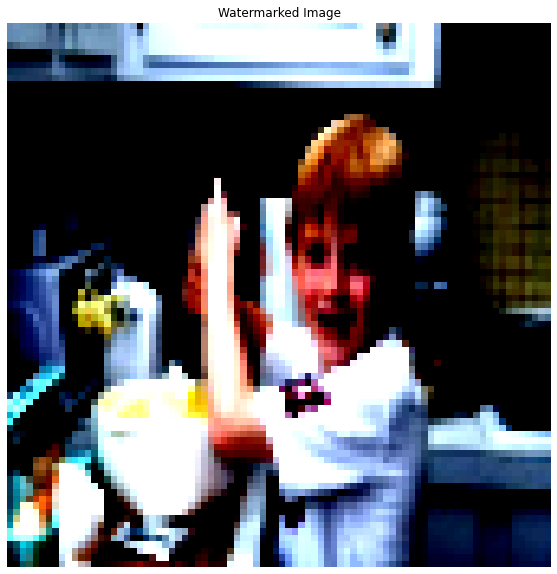

  9%|▉         | 1/11 [00:08<01:23,  8.34s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 18: Target opacity: 0, Labeled correctly: 0.56, Correctly Predicted Target: True, Base class predicted: False


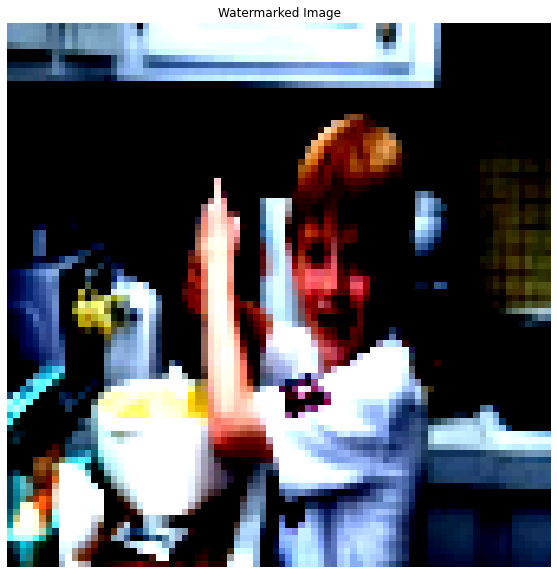

 18%|█▊        | 2/11 [00:16<01:14,  8.30s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 18: Target opacity: 0.05, Labeled correctly: 0.56, Correctly Predicted Target: True, Base class predicted: False


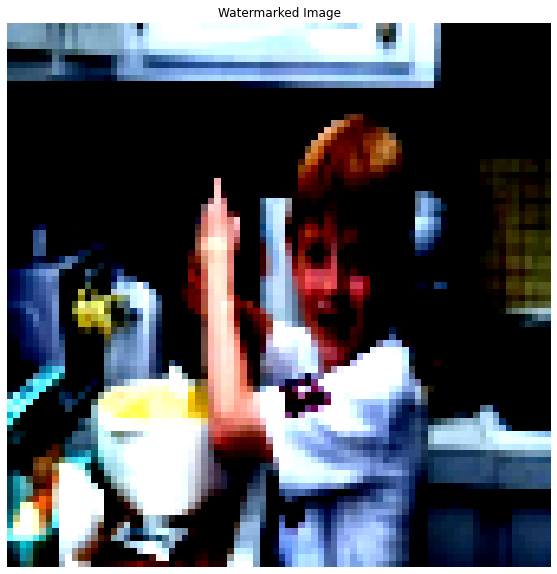

 27%|██▋       | 3/11 [00:24<01:06,  8.28s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 18: Target opacity: 0.1, Labeled correctly: 0.56, Correctly Predicted Target: True, Base class predicted: False


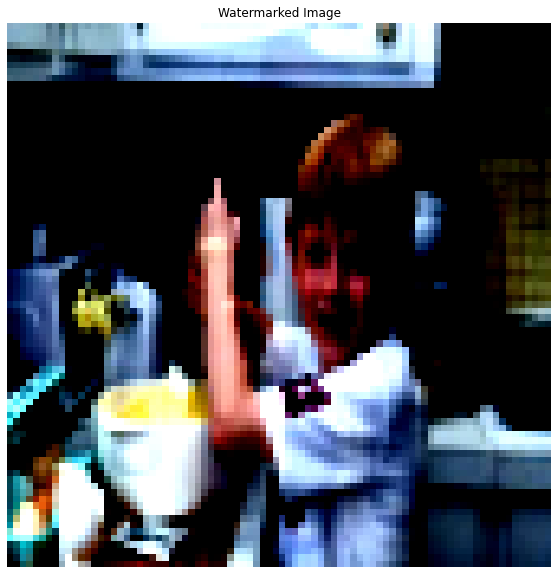

 36%|███▋      | 4/11 [00:32<00:57,  8.18s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 18: Target opacity: 0.15, Labeled correctly: 0.56, Correctly Predicted Target: True, Base class predicted: False


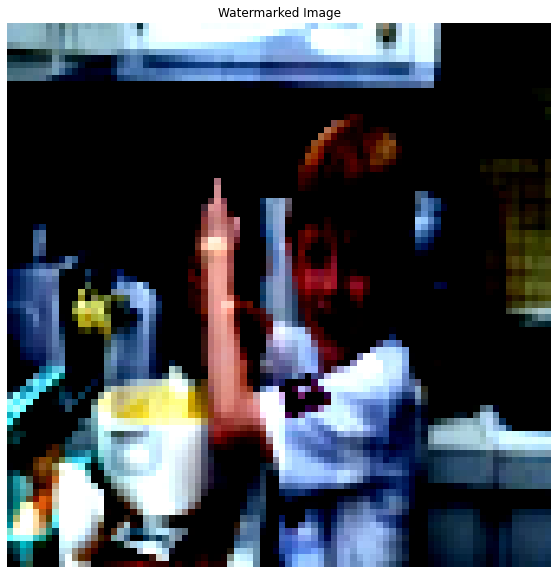

 45%|████▌     | 5/11 [00:40<00:48,  8.11s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 18: Target opacity: 0.2, Labeled correctly: 0.56, Correctly Predicted Target: True, Base class predicted: False


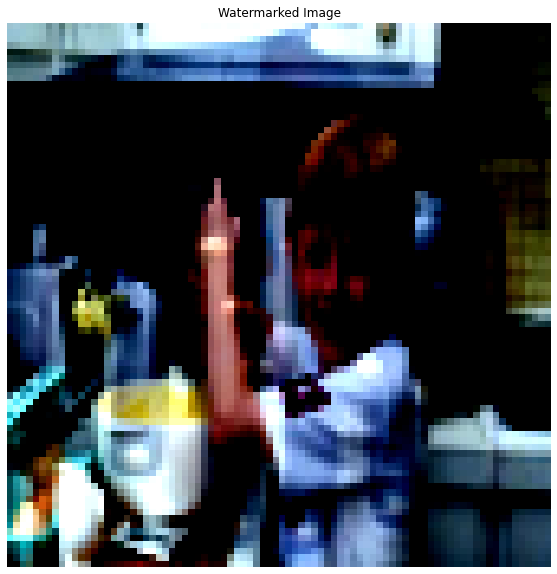

 55%|█████▍    | 6/11 [00:48<00:40,  8.03s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 18: Target opacity: 0.25, Labeled correctly: 0.56, Correctly Predicted Target: True, Base class predicted: False


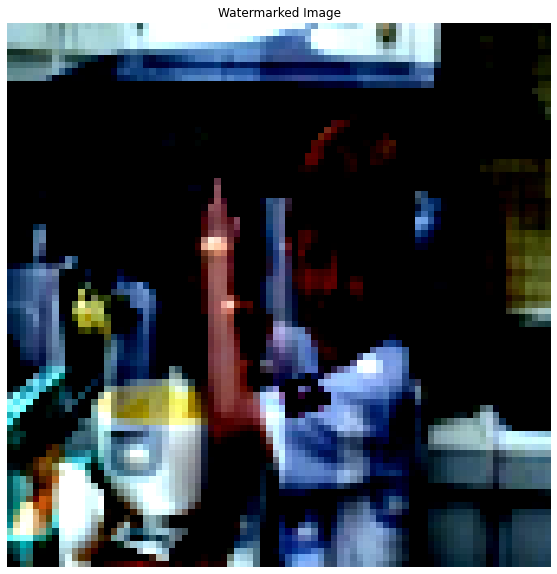

 64%|██████▎   | 7/11 [00:56<00:32,  8.00s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 18: Target opacity: 0.3, Labeled correctly: 0.56, Correctly Predicted Target: True, Base class predicted: False


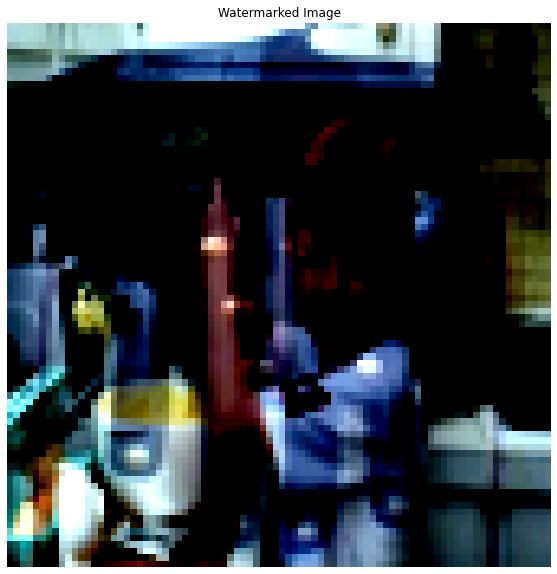

 73%|███████▎  | 8/11 [01:04<00:23,  7.96s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 18: Target opacity: 0.35, Labeled correctly: 0.56, Correctly Predicted Target: True, Base class predicted: False


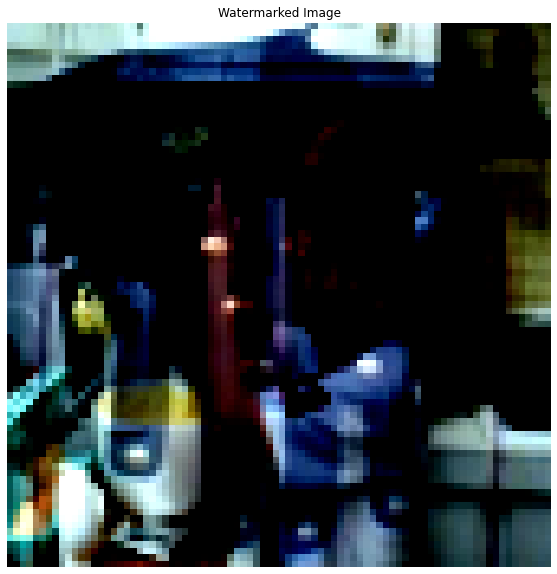

 82%|████████▏ | 9/11 [01:12<00:15,  7.96s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 18: Target opacity: 0.4, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: True, Base class predicted: False


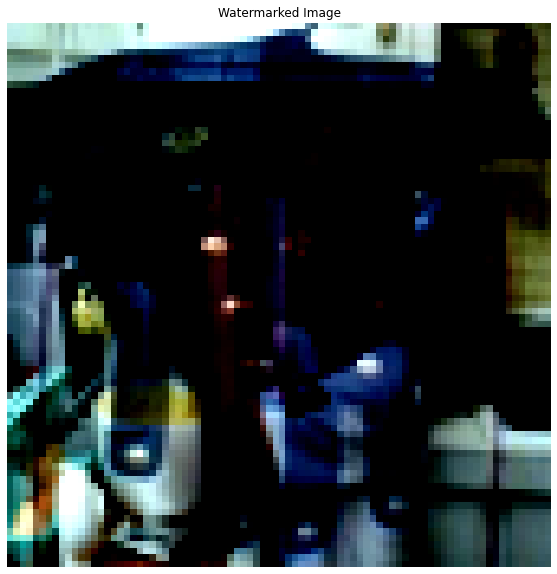

 91%|█████████ | 10/11 [01:20<00:07,  7.93s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 18: Target opacity: 0.45, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: True, Base class predicted: False


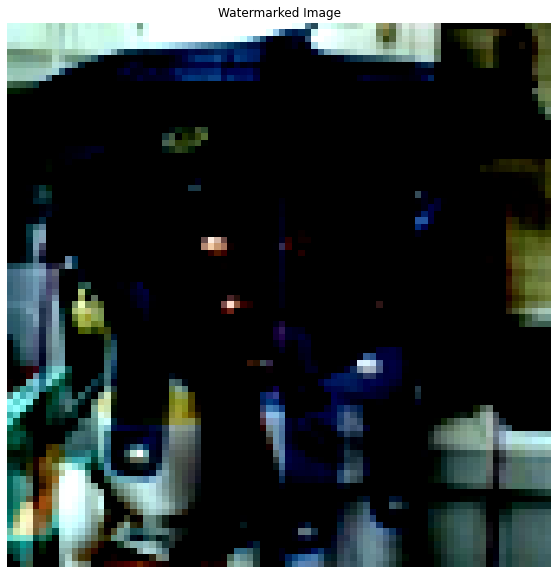

100%|██████████| 11/11 [01:28<00:00,  8.04s/it]

Iteration 18: Target opacity: 0.5, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: True, Base class predicted: False



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


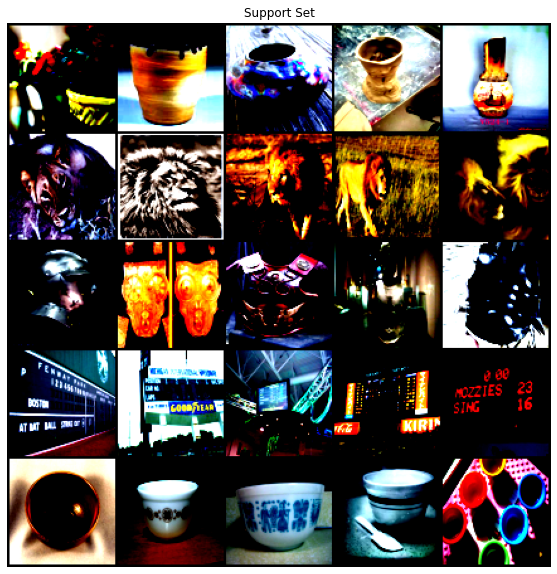

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 1, 1, 1, 1,
         1]])


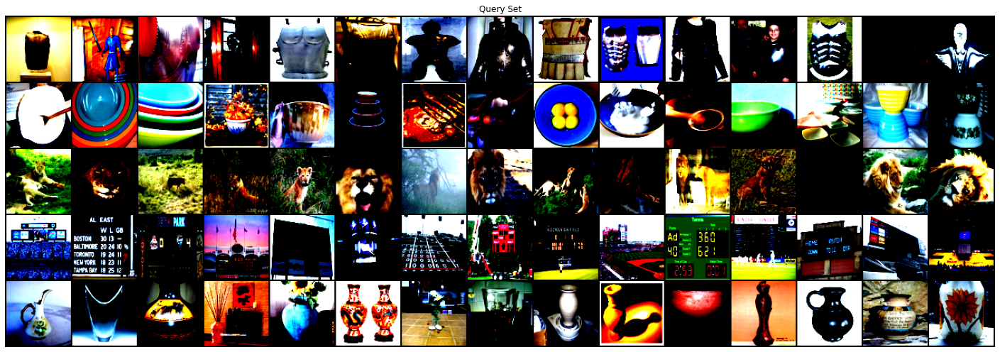

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1, 1, 1, 1, 1, 1, 1,
         1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2,
         2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
         4, 4, 4]])
target_class 2
unique_classes [0, 1, 3, 4]
base_class 1
target_indices [45 46 47 48 49 50 51 52 53 54 55 56 57 58 59]
target_index 56
base_indices [20 21 22 23 24]
base_index 20


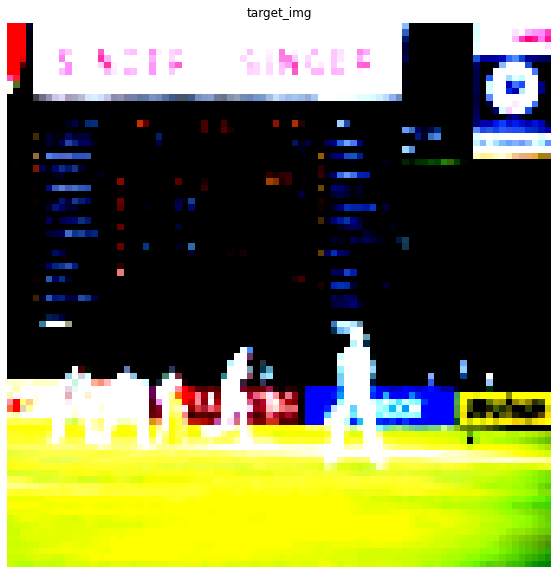

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


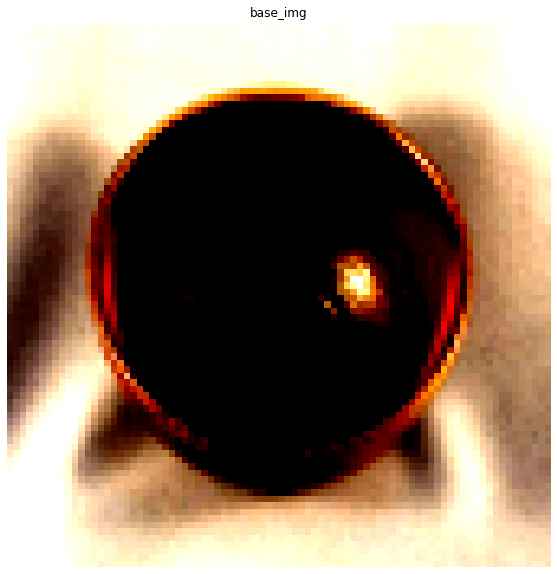

  0%|          | 3/1000 [00:00<00:40, 24.77it/s]

Iteration 0
loss: tensor(11.3976, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(35.0174, grad_fn=<PowBackward0>)
Iteration 2
loss: tensor(16.0091, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(11.4127, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(56.7821, grad_fn=<PowBackward0>)
Iteration 5


  1%|          | 9/1000 [00:00<00:36, 27.04it/s]

loss: tensor(0.9707, grad_fn=<PowBackward0>)
Iteration 6
loss: tensor(0.9134, grad_fn=<PowBackward0>)
Iteration 7
loss: tensor(51.0730, grad_fn=<PowBackward0>)
Iteration 8
loss: tensor(7.8071, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(32.7239, grad_fn=<PowBackward0>)
Iteration 10
loss: tensor(18.0177, grad_fn=<PowBackward0>)
Iteration 

  2%|▏         | 15/1000 [00:00<00:37, 26.15it/s]

11
loss: tensor(67.5012, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(9.8329, grad_fn=<PowBackward0>)
Iteration 13
loss: tensor(11.3384, grad_fn=<PowBackward0>)
Iteration 14
loss: tensor(2.4396, grad_fn=<PowBackward0>)
Iteration 15
loss: tensor(22.6323, grad_fn=<PowBackward0>)
Iteration 16


  2%|▏         | 21/1000 [00:00<00:38, 25.72it/s]

loss: tensor(3.3613, grad_fn=<PowBackward0>)
Iteration 17
loss: tensor(22.4613, grad_fn=<PowBackward0>)
Iteration 18
loss: tensor(6.4909, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(52.0121, grad_fn=<PowBackward0>)
Iteration 20
loss: tensor(12.8867, grad_fn=<PowBackward0>)
Iteration 21
loss: tensor(59.1888, grad_fn=<PowBackward0>)


  3%|▎         | 27/1000 [00:01<00:37, 25.92it/s]

Iteration 22
loss: tensor(9.8769, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(32.5662, grad_fn=<PowBackward0>)
Iteration 24
loss: tensor(9.0738, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(46.2545, grad_fn=<PowBackward0>)
Iteration 26
loss: tensor(28.2650, grad_fn=<PowBackward0>)
Iteration 27


  3%|▎         | 33/1000 [00:01<00:36, 26.46it/s]

loss: tensor(49.7844, grad_fn=<PowBackward0>)
Iteration 28
loss: tensor(19.8331, grad_fn=<PowBackward0>)
Iteration 29
loss: tensor(30.6984, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(11.7312, grad_fn=<PowBackward0>)
Iteration 31
loss: tensor(29.8478, grad_fn=<PowBackward0>)
Iteration 32
loss: tensor(2.5430, grad_fn=<PowBackward0>)
Iteration 33


  4%|▎         | 36/1000 [00:01<00:37, 26.04it/s]

loss: tensor(34.6881, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(32.2907, grad_fn=<PowBackward0>)
Iteration 35
loss: tensor(36.7617, grad_fn=<PowBackward0>)
Iteration 36
loss: tensor(5.0813, grad_fn=<PowBackward0>)
Iteration 37
loss: tensor(51.0314, grad_fn=<PowBackward0>)
Iteration 38
loss: 

  4%|▍         | 42/1000 [00:01<00:36, 26.14it/s]

tensor(3.1208, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(36.7277, grad_fn=<PowBackward0>)
Iteration 40
loss: tensor(17.4362, grad_fn=<PowBackward0>)
Iteration 41
loss: tensor(58.4429, grad_fn=<PowBackward0>)
Iteration 42
loss: tensor(0.2716, grad_fn=<PowBackward0>)
Iteration 43
loss: tensor(3.6076, grad_fn=<PowBackward0>)


  5%|▍         | 48/1000 [00:01<00:36, 26.44it/s]

Iteration 44
loss: tensor(27.7109, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(40.1656, grad_fn=<PowBackward0>)
Iteration 46
loss: tensor(0.5594, grad_fn=<PowBackward0>)
Iteration 47
loss: tensor(6.5248, grad_fn=<PowBackward0>)
Iteration 48
loss: tensor(21.9626, grad_fn=<PowBackward0>)
Iteration 49


  5%|▌         | 54/1000 [00:02<00:37, 25.15it/s]

loss: tensor(49.1979, grad_fn=<PowBackward0>)
Iteration 50
loss: tensor(6.6538, grad_fn=<PowBackward0>)
Iteration 51
loss: tensor(53.6252, grad_fn=<PowBackward0>)
Iteration 52
loss: tensor(2.1418, grad_fn=<PowBackward0>)
Iteration 53
loss: tensor(15.4906, grad_fn=<PowBackward0>)


  6%|▌         | 57/1000 [00:02<00:36, 25.73it/s]

Iteration 54
loss: tensor(32.9190, grad_fn=<PowBackward0>)
Iteration 55
loss: tensor(21.5712, grad_fn=<PowBackward0>)
Iteration 56
loss: tensor(9.9976, grad_fn=<PowBackward0>)
Iteration 57
loss: tensor(31.5961, grad_fn=<PowBackward0>)
Iteration 58
loss: tensor(29.4263, grad_fn=<PowBackward0>)
Iteration 59
loss: tensor(43.1388, grad_fn=<PowBackward0>)


  6%|▋         | 63/1000 [00:02<00:34, 26.79it/s]

Iteration 60
loss: tensor(5.6977, grad_fn=<PowBackward0>)
Iteration 61
loss: tensor(7.1067, grad_fn=<PowBackward0>)
Iteration 62
loss: tensor(7.1542, grad_fn=<PowBackward0>)
Iteration 63
loss: tensor(92.5770, grad_fn=<PowBackward0>)
Iteration 64
loss: tensor(0.3929, grad_fn=<PowBackward0>)
Iteration 65
loss: tensor(25.6541, grad_fn=<PowBackward0>)


  7%|▋         | 69/1000 [00:02<00:35, 26.54it/s]

Iteration 66
loss: tensor(32.8944, grad_fn=<PowBackward0>)
Iteration 67
loss: tensor(23.5704, grad_fn=<PowBackward0>)
Iteration 68
loss: tensor(32.7628, grad_fn=<PowBackward0>)
Iteration 69
loss: tensor(34.4541, grad_fn=<PowBackward0>)
Iteration 70
loss: tensor(25.9084, grad_fn=<PowBackward0>)


  8%|▊         | 75/1000 [00:02<00:35, 26.25it/s]

Iteration 71
loss: tensor(0.1502, grad_fn=<PowBackward0>)
Iteration 72
loss: tensor(5.7673, grad_fn=<PowBackward0>)
Iteration 73
loss: tensor(59.0871, grad_fn=<PowBackward0>)
Iteration 74
loss: tensor(31.8818, grad_fn=<PowBackward0>)
Iteration 75
loss: tensor(12.9951, grad_fn=<PowBackward0>)
Iteration 76


  8%|▊         | 81/1000 [00:03<00:35, 25.58it/s]

loss: tensor(64.0322, grad_fn=<PowBackward0>)
Iteration 77
loss: tensor(15.2767, grad_fn=<PowBackward0>)
Iteration 78
loss: tensor(17.6635, grad_fn=<PowBackward0>)
Iteration 79
loss: tensor(36.7437, grad_fn=<PowBackward0>)
Iteration 80
loss: tensor(25.0270, grad_fn=<PowBackward0>)
Iteration 81
loss: tensor(31.3696, grad_fn=<PowBackward0>)


  9%|▊         | 87/1000 [00:03<00:36, 25.16it/s]

Iteration 82
loss: tensor(65.0024, grad_fn=<PowBackward0>)
Iteration 83
loss: tensor(2.8832, grad_fn=<PowBackward0>)
Iteration 84
loss: tensor(26.8893, grad_fn=<PowBackward0>)
Iteration 85
loss: tensor(25.3753, grad_fn=<PowBackward0>)
Iteration 86
loss: tensor(65.0082, grad_fn=<PowBackward0>)


  9%|▉         | 90/1000 [00:03<00:36, 25.11it/s]

Iteration 87
loss: tensor(0.5691, grad_fn=<PowBackward0>)
Iteration 88
loss: tensor(0.8714, grad_fn=<PowBackward0>)
Iteration 89
loss: tensor(27.7866, grad_fn=<PowBackward0>)
Iteration 90
loss: tensor(23.8261, grad_fn=<PowBackward0>)
Iteration 91
loss: tensor(30.8497, grad_fn=<PowBackward0>)
Iteration 92


 10%|▉         | 96/1000 [00:03<00:35, 25.35it/s]

loss: tensor(11.9176, grad_fn=<PowBackward0>)
Iteration 93
loss: tensor(56.7388, grad_fn=<PowBackward0>)
Iteration 94
loss: tensor(14.2940, grad_fn=<PowBackward0>)
Iteration 95
loss: tensor(16.3904, grad_fn=<PowBackward0>)
Iteration 96
loss: tensor(10.2693, grad_fn=<PowBackward0>)
Iteration 97
loss: tensor(75.3805, grad_fn=<PowBackward0>)


 10%|█         | 102/1000 [00:03<00:36, 24.72it/s]

Iteration 98
loss: tensor(12.6573, grad_fn=<PowBackward0>)
Iteration 99
loss: tensor(37.9351, grad_fn=<PowBackward0>)
Iteration 100
loss: tensor(3.4443, grad_fn=<PowBackward0>)
Iteration 101
loss: tensor(41.7963, grad_fn=<PowBackward0>)
Iteration 102
loss: tensor(1.3620, grad_fn=<PowBackward0>)


 11%|█         | 108/1000 [00:04<00:36, 24.73it/s]

Iteration 103
loss: tensor(16.4430, grad_fn=<PowBackward0>)
Iteration 104
loss: tensor(41.2670, grad_fn=<PowBackward0>)
Iteration 105
loss: tensor(79.5613, grad_fn=<PowBackward0>)
Iteration 106
loss: tensor(13.8457, grad_fn=<PowBackward0>)
Iteration 107
loss: tensor(44.4244, grad_fn=<PowBackward0>)
Iteration 108


 11%|█         | 111/1000 [00:04<00:36, 24.37it/s]

loss: tensor(11.0718, grad_fn=<PowBackward0>)
Iteration 109
loss: tensor(35.4209, grad_fn=<PowBackward0>)
Iteration 110
loss: tensor(22.8540, grad_fn=<PowBackward0>)
Iteration 111
loss: tensor(37.1768, grad_fn=<PowBackward0>)
Iteration 112
loss: tensor(14.6049, grad_fn=<PowBackward0>)
Iteration 113


 12%|█▏        | 117/1000 [00:04<00:35, 24.66it/s]

loss: tensor(30.2442, grad_fn=<PowBackward0>)
Iteration 114
loss: tensor(23.4499, grad_fn=<PowBackward0>)
Iteration 115
loss: tensor(57.7071, grad_fn=<PowBackward0>)
Iteration 116
loss: tensor(7.0776, grad_fn=<PowBackward0>)
Iteration 117
loss: tensor(18.9816, grad_fn=<PowBackward0>)
Iteration 118
loss: tensor(36.6367, grad_fn=<PowBackward0>)


 12%|█▏        | 123/1000 [00:04<00:35, 24.88it/s]

Iteration 119
loss: tensor(31.3665, grad_fn=<PowBackward0>)
Iteration 120
loss: tensor(15.8095, grad_fn=<PowBackward0>)
Iteration 121
loss: tensor(61.4236, grad_fn=<PowBackward0>)
Iteration 122
loss: tensor(3.9706, grad_fn=<PowBackward0>)
Iteration 123
loss: tensor(38.3209, grad_fn=<PowBackward0>)
Iteration 124


 13%|█▎        | 129/1000 [00:05<00:35, 24.88it/s]

loss: tensor(24.1252, grad_fn=<PowBackward0>)
Iteration 125
loss: tensor(14.3609, grad_fn=<PowBackward0>)
Iteration 126
loss: tensor(29.1059, grad_fn=<PowBackward0>)
Iteration 127
loss: tensor(27.7348, grad_fn=<PowBackward0>)
Iteration 128
loss: tensor(6.0174, grad_fn=<PowBackward0>)
Iteration 129
loss:

 13%|█▎        | 132/1000 [00:05<00:34, 24.91it/s]

 tensor(43.5221, grad_fn=<PowBackward0>)
Iteration 130
loss: tensor(10.8866, grad_fn=<PowBackward0>)
Iteration 131
loss: tensor(16.3542, grad_fn=<PowBackward0>)
Iteration 132
loss: tensor(37.0426, grad_fn=<PowBackward0>)
Iteration 133
loss: tensor(44.8368, grad_fn=<PowBackward0>)
Iteration 134
loss: tensor(11.7542, grad_fn=<PowBackward0>)


 14%|█▍        | 138/1000 [00:05<00:34, 25.11it/s]

Iteration 135
loss: tensor(41.6241, grad_fn=<PowBackward0>)
Iteration 136
loss: tensor(20.2447, grad_fn=<PowBackward0>)
Iteration 137
loss: tensor(34.1333, grad_fn=<PowBackward0>)
Iteration 138
loss: tensor(14.3688, grad_fn=<PowBackward0>)
Iteration 139
loss: tensor(57.2264, grad_fn=<PowBackward0>)
Iteration 140


 14%|█▍        | 144/1000 [00:05<00:34, 24.57it/s]

loss: tensor(12.7689, grad_fn=<PowBackward0>)
Iteration 141
loss: tensor(16.1114, grad_fn=<PowBackward0>)
Iteration 142
loss: tensor(22.7341, grad_fn=<PowBackward0>)
Iteration 143
loss: tensor(33.0996, grad_fn=<PowBackward0>)
Iteration 144
loss: tensor(19.4089, grad_fn=<PowBackward0>)
Iteration 145


 15%|█▌        | 150/1000 [00:05<00:34, 24.81it/s]

loss: tensor(25.3645, grad_fn=<PowBackward0>)
Iteration 146
loss: tensor(16.9785, grad_fn=<PowBackward0>)
Iteration 147
loss: tensor(19.3125, grad_fn=<PowBackward0>)
Iteration 148
loss: tensor(31.9956, grad_fn=<PowBackward0>)
Iteration 149
loss: tensor(44.6795, grad_fn=<PowBackward0>)
Iteration 150


 15%|█▌        | 153/1000 [00:06<00:35, 23.88it/s]

loss: tensor(17.6410, grad_fn=<PowBackward0>)
Iteration 151
loss: tensor(18.7132, grad_fn=<PowBackward0>)
Iteration 152
loss: tensor(35.5336, grad_fn=<PowBackward0>)
Iteration 153
loss: tensor(29.3823, grad_fn=<PowBackward0>)
Iteration 154
loss: tensor(18.3280, grad_fn=<PowBackward0>)
Iteration 155
loss: tensor(37.9938, grad_fn=<PowBackward0>)


 16%|█▌        | 159/1000 [00:06<00:33, 24.96it/s]

Iteration 156
loss: tensor(1.5229, grad_fn=<PowBackward0>)
Iteration 157
loss: tensor(28.0096, grad_fn=<PowBackward0>)
Iteration 158
loss: tensor(9.7854, grad_fn=<PowBackward0>)
Iteration 159
loss: tensor(43.2164, grad_fn=<PowBackward0>)
Iteration 160
loss: tensor(13.1381, grad_fn=<PowBackward0>)
Iteration 161
loss: tensor(66.5920, grad_fn=<PowBackward0>)


 16%|█▋        | 165/1000 [00:06<00:32, 26.01it/s]

Iteration 162
loss: tensor(10.3176, grad_fn=<PowBackward0>)
Iteration 163
loss: tensor(57.9548, grad_fn=<PowBackward0>)
Iteration 164
loss: tensor(26.6096, grad_fn=<PowBackward0>)
Iteration 165
loss: tensor(41.8634, grad_fn=<PowBackward0>)
Iteration 166
loss: tensor(7.1382, grad_fn=<PowBackward0>)
Iteration 167


 17%|█▋        | 171/1000 [00:06<00:33, 24.85it/s]

loss: tensor(64.4782, grad_fn=<PowBackward0>)
Iteration 168
loss: tensor(7.3600, grad_fn=<PowBackward0>)
Iteration 169
loss: tensor(41.9943, grad_fn=<PowBackward0>)
Iteration 170
loss: tensor(16.5910, grad_fn=<PowBackward0>)
Iteration 171
loss: tensor(41.5537, grad_fn=<PowBackward0>)
Iteration 172


 18%|█▊        | 177/1000 [00:07<00:33, 24.84it/s]

loss: tensor(11.3246, grad_fn=<PowBackward0>)
Iteration 173
loss: tensor(47.3109, grad_fn=<PowBackward0>)
Iteration 174
loss: tensor(20.4158, grad_fn=<PowBackward0>)
Iteration 175
loss: tensor(27.7878, grad_fn=<PowBackward0>)
Iteration 176
loss: tensor(10.1198, grad_fn=<PowBackward0>)
Iteration 177
loss: tensor(50.5767, grad_fn=<PowBackward0>)


 18%|█▊        | 183/1000 [00:07<00:32, 25.16it/s]

Iteration 178
loss: tensor(13.8577, grad_fn=<PowBackward0>)
Iteration 179
loss: tensor(39.4908, grad_fn=<PowBackward0>)
Iteration 180
loss: tensor(19.7145, grad_fn=<PowBackward0>)
Iteration 181
loss: tensor(39.4588, grad_fn=<PowBackward0>)
Iteration 182
loss: tensor(31.9830, grad_fn=<PowBackward0>)
Iteration 183


 19%|█▊        | 186/1000 [00:07<00:31, 25.47it/s]

loss: tensor(25.4645, grad_fn=<PowBackward0>)
Iteration 184
loss: tensor(16.6690, grad_fn=<PowBackward0>)
Iteration 185
loss: tensor(38.9151, grad_fn=<PowBackward0>)
Iteration 186
loss: tensor(21.2486, grad_fn=<PowBackward0>)
Iteration 187
loss: tensor(46.0079, grad_fn=<PowBackward0>)
Iteration 188
loss: tensor(21.0941, grad_fn=<PowBackward0>)


 19%|█▉        | 192/1000 [00:07<00:31, 25.31it/s]

Iteration 189
loss: tensor(43.1980, grad_fn=<PowBackward0>)
Iteration 190
loss: tensor(13.1013, grad_fn=<PowBackward0>)
Iteration 191
loss: tensor(14.6702, grad_fn=<PowBackward0>)
Iteration 192
loss: tensor(17.0908, grad_fn=<PowBackward0>)
Iteration 193
loss: tensor(41.5916, grad_fn=<PowBackward0>)
Iteration 194


 20%|█▉        | 198/1000 [00:07<00:31, 25.51it/s]

loss: tensor(15.1609, grad_fn=<PowBackward0>)
Iteration 195
loss: tensor(50.3535, grad_fn=<PowBackward0>)
Iteration 196
loss: tensor(11.2987, grad_fn=<PowBackward0>)
Iteration 197
loss: tensor(36.4895, grad_fn=<PowBackward0>)
Iteration 198
loss: tensor(1.3415, grad_fn=<PowBackward0>)
Iteration 199
loss: tensor(45.8126, grad_fn=<PowBackward0>)


 20%|██        | 204/1000 [00:08<00:32, 24.66it/s]

Iteration 200
loss: tensor(31.3952, grad_fn=<PowBackward0>)
Iteration 201
loss: tensor(53.6043, grad_fn=<PowBackward0>)
Iteration 202
loss: tensor(7.0918, grad_fn=<PowBackward0>)
Iteration 203
loss: tensor(18.5447, grad_fn=<PowBackward0>)
Iteration 204
loss: tensor(7.5305, grad_fn=<PowBackward0>)


 21%|██        | 210/1000 [00:08<00:31, 25.24it/s]

Iteration 205
loss: tensor(65.9002, grad_fn=<PowBackward0>)
Iteration 206
loss: tensor(17.1230, grad_fn=<PowBackward0>)
Iteration 207
loss: tensor(31.8087, grad_fn=<PowBackward0>)
Iteration 208
loss: tensor(16.4004, grad_fn=<PowBackward0>)
Iteration 209
loss: tensor(41.6348, grad_fn=<PowBackward0>)
Iteration 210


 22%|██▏       | 216/1000 [00:08<00:29, 26.50it/s]

loss: tensor(11.9163, grad_fn=<PowBackward0>)
Iteration 211
loss: tensor(63.6315, grad_fn=<PowBackward0>)
Iteration 212
loss: tensor(4.5384, grad_fn=<PowBackward0>)
Iteration 213
loss: tensor(48.1773, grad_fn=<PowBackward0>)
Iteration 214
loss: tensor(30.2972, grad_fn=<PowBackward0>)
Iteration 215
loss: tensor(61.7285, grad_fn=<PowBackward0>)
Iteration 216


 22%|██▏       | 219/1000 [00:08<00:30, 25.88it/s]

loss: tensor(24.3049, grad_fn=<PowBackward0>)
Iteration 217
loss: tensor(40.0419, grad_fn=<PowBackward0>)
Iteration 218
loss: tensor(11.5812, grad_fn=<PowBackward0>)
Iteration 219
loss: tensor(20.0307, grad_fn=<PowBackward0>)
Iteration 220
loss: tensor(16.0231, grad_fn=<PowBackward0>)
Iteration 221
loss: tensor(26.5462, grad_fn=<PowBackward0>)


 22%|██▎       | 225/1000 [00:08<00:29, 26.37it/s]

Iteration 222
loss: tensor(16.1899, grad_fn=<PowBackward0>)
Iteration 223
loss: tensor(31.4029, grad_fn=<PowBackward0>)
Iteration 224
loss: tensor(11.9212, grad_fn=<PowBackward0>)
Iteration 225
loss: tensor(9.3537, grad_fn=<PowBackward0>)
Iteration 226
loss: tensor(23.6814, grad_fn=<PowBackward0>)
Iteration 227


 23%|██▎       | 231/1000 [00:09<00:30, 25.34it/s]

loss: tensor(36.3566, grad_fn=<PowBackward0>)
Iteration 228
loss: tensor(15.3189, grad_fn=<PowBackward0>)
Iteration 229
loss: tensor(37.1576, grad_fn=<PowBackward0>)
Iteration 230
loss: tensor(19.9202, grad_fn=<PowBackward0>)
Iteration 231
loss: tensor(14.3130, grad_fn=<PowBackward0>)
Iteration 232
loss: tensor(13.7738, grad_fn=<PowBackward0>)


 24%|██▎       | 237/1000 [00:09<00:28, 26.60it/s]

Iteration 233
loss: tensor(46.2150, grad_fn=<PowBackward0>)
Iteration 234
loss: tensor(10.3736, grad_fn=<PowBackward0>)
Iteration 235
loss: tensor(22.4009, grad_fn=<PowBackward0>)
Iteration 236
loss: tensor(9.8159, grad_fn=<PowBackward0>)
Iteration 237
loss: tensor(37.2292, grad_fn=<PowBackward0>)
Iteration 238
loss: tensor(8.9845, grad_fn=<PowBackward0>)


 24%|██▍       | 243/1000 [00:09<00:29, 25.97it/s]

Iteration 239
loss: tensor(26.2181, grad_fn=<PowBackward0>)
Iteration 240
loss: tensor(22.8352, grad_fn=<PowBackward0>)
Iteration 241
loss: tensor(11.1282, grad_fn=<PowBackward0>)
Iteration 242
loss: tensor(12.6165, grad_fn=<PowBackward0>)
Iteration 243
loss: tensor(38.8623, grad_fn=<PowBackward0>)
Iteration 244


 25%|██▍       | 249/1000 [00:09<00:28, 26.42it/s]

loss: tensor(6.7941, grad_fn=<PowBackward0>)
Iteration 245
loss: tensor(15.4678, grad_fn=<PowBackward0>)
Iteration 246
loss: tensor(31.3713, grad_fn=<PowBackward0>)
Iteration 247
loss: tensor(53.4352, grad_fn=<PowBackward0>)
Iteration 248
loss: tensor(2.8869, grad_fn=<PowBackward0>)
Iteration 249
loss: tensor(9.7768, grad_fn=<PowBackward0>)


 26%|██▌       | 255/1000 [00:10<00:28, 26.16it/s]

Iteration 250
loss: tensor(10.2481, grad_fn=<PowBackward0>)
Iteration 251
loss: tensor(33.2847, grad_fn=<PowBackward0>)
Iteration 252
loss: tensor(15.7979, grad_fn=<PowBackward0>)
Iteration 253
loss: tensor(9.0958, grad_fn=<PowBackward0>)
Iteration 254
loss: tensor(12.5928, grad_fn=<PowBackward0>)
Iteration 255


 26%|██▌       | 258/1000 [00:10<00:31, 23.43it/s]

loss: tensor(15.3507, grad_fn=<PowBackward0>)
Iteration 256
loss: tensor(9.6456, grad_fn=<PowBackward0>)
Iteration 257
loss: tensor(34.8656, grad_fn=<PowBackward0>)
Iteration 258
loss: tensor(9.9648, grad_fn=<PowBackward0>)
Iteration 259
loss: tensor(31.6208, grad_fn=<PowBackward0>)


 26%|██▋       | 264/1000 [00:10<00:30, 24.11it/s]

Iteration 260
loss: tensor(9.1096, grad_fn=<PowBackward0>)
Iteration 261
loss: tensor(5.0306, grad_fn=<PowBackward0>)
Iteration 262
loss: tensor(14.6576, grad_fn=<PowBackward0>)
Iteration 263
loss: tensor(27.9024, grad_fn=<PowBackward0>)
Iteration 264
loss: tensor(12.4370, grad_fn=<PowBackward0>)
Iteration

 27%|██▋       | 270/1000 [00:10<00:28, 25.41it/s]

 265
loss: tensor(8.3147, grad_fn=<PowBackward0>)
Iteration 266
loss: tensor(29.6751, grad_fn=<PowBackward0>)
Iteration 267
loss: tensor(30.9660, grad_fn=<PowBackward0>)
Iteration 268
loss: tensor(20.9148, grad_fn=<PowBackward0>)
Iteration 269
loss: tensor(22.4487, grad_fn=<PowBackward0>)
Iteration 270


 27%|██▋       | 273/1000 [00:10<00:28, 25.22it/s]

loss: tensor(30.0445, grad_fn=<PowBackward0>)
Iteration 271
loss: tensor(22.7858, grad_fn=<PowBackward0>)
Iteration 272
loss: tensor(6.3827, grad_fn=<PowBackward0>)
Iteration 273
loss: tensor(38.7470, grad_fn=<PowBackward0>)
Iteration 274
loss: tensor(10.7332, grad_fn=<PowBackward0>)
Iteration 275
loss: tensor(16.9609, grad_fn=<PowBackward0>)


 28%|██▊       | 279/1000 [00:11<00:28, 25.10it/s]

Iteration 276
loss: tensor(25.0886, grad_fn=<PowBackward0>)
Iteration 277
loss: tensor(33.0267, grad_fn=<PowBackward0>)
Iteration 278
loss: tensor(17.4750, grad_fn=<PowBackward0>)
Iteration 279
loss: tensor(19.0151, grad_fn=<PowBackward0>)
Iteration 280
loss: tensor(24.7516, grad_fn=<PowBackward0>)
Iteration 281
loss: tensor(11.8777, grad_fn=<PowBackward0>)

 28%|██▊       | 285/1000 [00:11<00:28, 25.06it/s]


Iteration 282
loss: tensor(18.6220, grad_fn=<PowBackward0>)
Iteration 283
loss: tensor(22.1117, grad_fn=<PowBackward0>)
Iteration 284
loss: tensor(40.1394, grad_fn=<PowBackward0>)
Iteration 285
loss: tensor(48.9705, grad_fn=<PowBackward0>)
Iteration 286
loss: tensor(6.4055, grad_fn=<PowBackward0>)


 29%|██▉       | 291/1000 [00:11<00:26, 26.29it/s]

Iteration 287
loss: tensor(18.1486, grad_fn=<PowBackward0>)
Iteration 288
loss: tensor(9.5303, grad_fn=<PowBackward0>)
Iteration 289
loss: tensor(33.4730, grad_fn=<PowBackward0>)
Iteration 290
loss: tensor(31.8539, grad_fn=<PowBackward0>)
Iteration 291
loss: tensor(12.1667, grad_fn=<PowBackward0>)
Iteration 292


 30%|██▉       | 297/1000 [00:11<00:26, 26.35it/s]

loss: tensor(13.4020, grad_fn=<PowBackward0>)
Iteration 293
loss: tensor(49.9771, grad_fn=<PowBackward0>)
Iteration 294
loss: tensor(14.4248, grad_fn=<PowBackward0>)
Iteration 295
loss: tensor(20.1393, grad_fn=<PowBackward0>)
Iteration 296
loss: tensor(7.5507, grad_fn=<PowBackward0>)
Iteration 297
loss: tensor(11.9397, grad_fn=<PowBackward0>)


 30%|███       | 303/1000 [00:11<00:26, 26.56it/s]

Iteration 298
loss: tensor(25.9436, grad_fn=<PowBackward0>)
Iteration 299
loss: tensor(50.4141, grad_fn=<PowBackward0>)
Iteration 300
loss: tensor(12.4290, grad_fn=<PowBackward0>)
Iteration 301
loss: tensor(8.5430, grad_fn=<PowBackward0>)
Iteration 302
loss: tensor(2.0637, grad_fn=<PowBackward0>)
Iteration 303


 31%|███       | 309/1000 [00:12<00:25, 26.93it/s]

loss: tensor(0.6802, grad_fn=<PowBackward0>)
Iteration 304
loss: tensor(1.0877, grad_fn=<PowBackward0>)
Iteration 305
loss: tensor(1.9547, grad_fn=<PowBackward0>)
Iteration 306
loss: tensor(9.8658, grad_fn=<PowBackward0>)
Iteration 307
loss: tensor(8.2650, grad_fn=<PowBackward0>)
Iteration 308
loss: tensor(8.8459, grad_fn=<PowBackward0>)


 31%|███       | 312/1000 [00:12<00:25, 26.69it/s]

Iteration 309
loss: tensor(12.3596, grad_fn=<PowBackward0>)
Iteration 310
loss: tensor(9.4814, grad_fn=<PowBackward0>)
Iteration 311
loss: tensor(2.7234, grad_fn=<PowBackward0>)
Iteration 312
loss: tensor(1.8341, grad_fn=<PowBackward0>)
Iteration 313
loss: tensor(1.9908, grad_fn=<PowBackward0>)
Iteration 314
loss: tensor(5.5453, grad_fn=<PowBackward0>)


 32%|███▏      | 318/1000 [00:12<00:25, 26.95it/s]

Iteration 315
loss: tensor(11.9610, grad_fn=<PowBackward0>)
Iteration 316
loss: tensor(8.3242, grad_fn=<PowBackward0>)
Iteration 317
loss: tensor(14.3882, grad_fn=<PowBackward0>)
Iteration 318
loss: tensor(12.0718, grad_fn=<PowBackward0>)
Iteration 319
loss: tensor(3.9435, grad_fn=<PowBackward0>)
Iteration 320
loss: tensor(12.3116, grad_fn=<PowBackward0>)


 32%|███▏      | 324/1000 [00:12<00:24, 27.06it/s]

Iteration 321
loss: tensor(15.8350, grad_fn=<PowBackward0>)
Iteration 322
loss: tensor(14.1666, grad_fn=<PowBackward0>)
Iteration 323
loss: tensor(9.3293, grad_fn=<PowBackward0>)
Iteration 324
loss: tensor(5.3398, grad_fn=<PowBackward0>)
Iteration 325
loss: tensor(4.1430, grad_fn=<PowBackward0>)
Iteration 326
loss: tensor(10.6358, grad_fn=<PowBackward0>)


 33%|███▎      | 330/1000 [00:12<00:24, 27.22it/s]

Iteration 327
loss: tensor(16.7753, grad_fn=<PowBackward0>)
Iteration 328
loss: tensor(9.0529, grad_fn=<PowBackward0>)
Iteration 329
loss: tensor(6.3523, grad_fn=<PowBackward0>)
Iteration 330
loss: tensor(5.8315, grad_fn=<PowBackward0>)
Iteration 331
loss: tensor(3.6637, grad_fn=<PowBackward0>)
Iteration 332
loss: tensor(5.8108, grad_fn=<PowBackward0>)


 34%|███▎      | 336/1000 [00:13<00:24, 27.40it/s]

Iteration 333
loss: tensor(9.2347, grad_fn=<PowBackward0>)
Iteration 334
loss: tensor(13.1020, grad_fn=<PowBackward0>)
Iteration 335
loss: tensor(7.4660, grad_fn=<PowBackward0>)
Iteration 336
loss: tensor(4.0514, grad_fn=<PowBackward0>)
Iteration 337
loss: tensor(40.0129, grad_fn=<PowBackward0>)
Iteration 338


 34%|███▍      | 342/1000 [00:13<00:24, 26.67it/s]

loss: tensor(21.6082, grad_fn=<PowBackward0>)
Iteration 339
loss: tensor(8.4014, grad_fn=<PowBackward0>)
Iteration 340
loss: tensor(9.2853, grad_fn=<PowBackward0>)
Iteration 341
loss: tensor(7.2962, grad_fn=<PowBackward0>)
Iteration 342
loss: tensor(6.7662, grad_fn=<PowBackward0>)
Iteration 343
loss: tensor(19.0752, grad_fn=<PowBackward0>)
Iteration 344


 35%|███▍      | 348/1000 [00:13<00:23, 27.31it/s]

loss: tensor(10.2939, grad_fn=<PowBackward0>)
Iteration 345
loss: tensor(9.4141, grad_fn=<PowBackward0>)
Iteration 346
loss: tensor(6.8757, grad_fn=<PowBackward0>)
Iteration 347
loss: tensor(13.9217, grad_fn=<PowBackward0>)
Iteration 348
loss: tensor(13.5118, grad_fn=<PowBackward0>)
Iteration 349
loss: tensor(5.6213, grad_fn=<PowBackward0>)


 35%|███▌      | 354/1000 [00:13<00:25, 25.38it/s]

Iteration 350
loss: tensor(6.4564, grad_fn=<PowBackward0>)
Iteration 351
loss: tensor(7.7495, grad_fn=<PowBackward0>)
Iteration 352
loss: tensor(10.0851, grad_fn=<PowBackward0>)
Iteration 353
loss: tensor(29.3059, grad_fn=<PowBackward0>)
Iteration 354
loss: tensor(20.1632, grad_fn=<PowBackward0>)


 36%|███▌      | 360/1000 [00:14<00:24, 26.10it/s]

Iteration 355
loss: tensor(20.0374, grad_fn=<PowBackward0>)
Iteration 356
loss: tensor(5.9525, grad_fn=<PowBackward0>)
Iteration 357
loss: tensor(5.1230, grad_fn=<PowBackward0>)
Iteration 358
loss: tensor(5.3444, grad_fn=<PowBackward0>)
Iteration 359
loss: tensor(7.6687, grad_fn=<PowBackward0>)
Iteration 360
loss:

 36%|███▋      | 363/1000 [00:14<00:24, 25.83it/s]

 tensor(10.6353, grad_fn=<PowBackward0>)
Iteration 361
loss: tensor(8.0518, grad_fn=<PowBackward0>)
Iteration 362
loss: tensor(8.4815, grad_fn=<PowBackward0>)
Iteration 363
loss: tensor(11.5980, grad_fn=<PowBackward0>)
Iteration 364
loss: tensor(5.9118, grad_fn=<PowBackward0>)
Iteration 365
loss: tensor(14.2823, grad_fn=<PowBackward0>)


 37%|███▋      | 369/1000 [00:14<00:23, 26.49it/s]

Iteration 366
loss: tensor(10.9273, grad_fn=<PowBackward0>)
Iteration 367
loss: tensor(8.0009, grad_fn=<PowBackward0>)
Iteration 368
loss: tensor(10.2574, grad_fn=<PowBackward0>)
Iteration 369
loss: tensor(16.9239, grad_fn=<PowBackward0>)
Iteration 370
loss: tensor(12.8568, grad_fn=<PowBackward0>)
Iteration 371
loss: tensor(14.0125, grad_fn=<PowBackward0>)


 38%|███▊      | 375/1000 [00:14<00:24, 25.99it/s]

Iteration 372
loss: tensor(8.3015, grad_fn=<PowBackward0>)
Iteration 373
loss: tensor(21.3533, grad_fn=<PowBackward0>)
Iteration 374
loss: tensor(7.5729, grad_fn=<PowBackward0>)
Iteration 375
loss: tensor(6.6262, grad_fn=<PowBackward0>)
Iteration 376
loss: tensor(6.1906, grad_fn=<PowBackward0>)
Iteration 377


 38%|███▊      | 381/1000 [00:14<00:23, 26.24it/s]

loss: tensor(10.4701, grad_fn=<PowBackward0>)
Iteration 378
loss: tensor(12.2502, grad_fn=<PowBackward0>)
Iteration 379
loss: tensor(13.6968, grad_fn=<PowBackward0>)
Iteration 380
loss: tensor(15.1050, grad_fn=<PowBackward0>)
Iteration 381
loss: tensor(13.9878, grad_fn=<PowBackward0>)
Iteration 382
loss: tensor(12.8758, grad_fn=<PowBackward0>)


 39%|███▊      | 387/1000 [00:15<00:23, 25.83it/s]

Iteration 383
loss: tensor(10.2071, grad_fn=<PowBackward0>)
Iteration 384
loss: tensor(3.7905, grad_fn=<PowBackward0>)
Iteration 385
loss: tensor(6.6682, grad_fn=<PowBackward0>)
Iteration 386
loss: tensor(11.8492, grad_fn=<PowBackward0>)
Iteration 387
loss: tensor(11.8645, grad_fn=<PowBackward0>)
Iteration 388


 39%|███▉      | 393/1000 [00:15<00:23, 26.15it/s]

loss: tensor(7.5210, grad_fn=<PowBackward0>)
Iteration 389
loss: tensor(6.4435, grad_fn=<PowBackward0>)
Iteration 390
loss: tensor(7.3102, grad_fn=<PowBackward0>)
Iteration 391
loss: tensor(10.4913, grad_fn=<PowBackward0>)
Iteration 392
loss: tensor(13.1522, grad_fn=<PowBackward0>)
Iteration 393
loss: tensor(11.2922, grad_fn=<PowBackward0>)


 40%|███▉      | 399/1000 [00:15<00:23, 25.98it/s]

Iteration 394
loss: tensor(6.4203, grad_fn=<PowBackward0>)
Iteration 395
loss: tensor(9.0873, grad_fn=<PowBackward0>)
Iteration 396
loss: tensor(7.3385, grad_fn=<PowBackward0>)
Iteration 397
loss: tensor(10.7191, grad_fn=<PowBackward0>)
Iteration 398
loss: tensor(8.2368, grad_fn=<PowBackward0>)
Iteration 399


 40%|████      | 402/1000 [00:15<00:23, 25.72it/s]

loss: tensor(10.4912, grad_fn=<PowBackward0>)
Iteration 400
loss: tensor(11.9004, grad_fn=<PowBackward0>)
Iteration 401
loss: tensor(12.3508, grad_fn=<PowBackward0>)
Iteration 402
loss: tensor(0.1941, grad_fn=<PowBackward0>)
Iteration 403
loss: tensor(0.0721, grad_fn=<PowBackward0>)
Iteration 404
loss: tensor(0.0306, grad_fn=<PowBackward0>)


 41%|████      | 408/1000 [00:15<00:22, 26.37it/s]

Iteration 405
loss: tensor(0.0357, grad_fn=<PowBackward0>)
Iteration 406
loss: tensor(0.0210, grad_fn=<PowBackward0>)
Iteration 407
loss: tensor(0.0278, grad_fn=<PowBackward0>)
Iteration 408
loss: tensor(0.0137, grad_fn=<PowBackward0>)
Iteration 409
loss: tensor(0.0666, grad_fn=<PowBackward0>)
Iteration 410


 41%|████▏     | 414/1000 [00:16<00:22, 26.13it/s]

loss: tensor(0.2987, grad_fn=<PowBackward0>)
Iteration 411
loss: tensor(5.9625, grad_fn=<PowBackward0>)
Iteration 412
loss: tensor(15.4883, grad_fn=<PowBackward0>)
Iteration 413
loss: tensor(4.6261, grad_fn=<PowBackward0>)
Iteration 414
loss: tensor(2.1956, grad_fn=<PowBackward0>)
Iteration 415
loss: tensor(1.4818, grad_fn=<PowBackward0>)
Iteration

 42%|████▏     | 420/1000 [00:16<00:22, 25.84it/s]

 416
loss: tensor(0.8329, grad_fn=<PowBackward0>)
Iteration 417
loss: tensor(0.9592, grad_fn=<PowBackward0>)
Iteration 418
loss: tensor(0.8316, grad_fn=<PowBackward0>)
Iteration 419
loss: tensor(3.0523, grad_fn=<PowBackward0>)
Iteration 420
loss: tensor(4.3510, grad_fn=<PowBackward0>)


 43%|████▎     | 426/1000 [00:16<00:21, 26.62it/s]

Iteration 421
loss: tensor(6.7569, grad_fn=<PowBackward0>)
Iteration 422
loss: tensor(6.9604, grad_fn=<PowBackward0>)
Iteration 423
loss: tensor(5.2916, grad_fn=<PowBackward0>)
Iteration 424
loss: tensor(1.9523, grad_fn=<PowBackward0>)
Iteration 425
loss: tensor(1.0132, grad_fn=<PowBackward0>)
Iteration 426
loss: tensor(0.4728, grad_fn=<PowBackward0>)


 43%|████▎     | 432/1000 [00:16<00:22, 25.70it/s]

Iteration 427
loss: tensor(0.6181, grad_fn=<PowBackward0>)
Iteration 428
loss: tensor(0.7771, grad_fn=<PowBackward0>)
Iteration 429
loss: tensor(2.5740, grad_fn=<PowBackward0>)
Iteration 430
loss: tensor(6.1046, grad_fn=<PowBackward0>)
Iteration 431
loss: tensor(9.8935, grad_fn=<PowBackward0>)
Iteration 432


 44%|████▎     | 435/1000 [00:16<00:22, 25.18it/s]

loss: tensor(10.1949, grad_fn=<PowBackward0>)
Iteration 433
loss: tensor(8.0473, grad_fn=<PowBackward0>)
Iteration 434
loss: tensor(6.6897, grad_fn=<PowBackward0>)
Iteration 435
loss: tensor(3.0265, grad_fn=<PowBackward0>)
Iteration 436
loss: tensor(1.3044, grad_fn=<PowBackward0>)
Iteration 437
loss: tensor(2.1954, grad_fn=<PowBackward0>)


 44%|████▍     | 441/1000 [00:17<00:21, 26.09it/s]

Iteration 438
loss: tensor(2.4226, grad_fn=<PowBackward0>)
Iteration 439
loss: tensor(2.9371, grad_fn=<PowBackward0>)
Iteration 440
loss: tensor(1.9243, grad_fn=<PowBackward0>)
Iteration 441
loss: tensor(2.4546, grad_fn=<PowBackward0>)
Iteration 442
loss: tensor(2.3005, grad_fn=<PowBackward0>)
Iteration 443


 45%|████▍     | 447/1000 [00:17<00:21, 25.77it/s]

loss: tensor(3.5015, grad_fn=<PowBackward0>)
Iteration 444
loss: tensor(2.9775, grad_fn=<PowBackward0>)
Iteration 445
loss: tensor(4.1068, grad_fn=<PowBackward0>)
Iteration 446
loss: tensor(3.6700, grad_fn=<PowBackward0>)
Iteration 447
loss: tensor(4.1863, grad_fn=<PowBackward0>)
Iteration 448
loss: tensor(4.2904, grad_fn=<PowBackward0>)


 45%|████▌     | 453/1000 [00:17<00:21, 25.88it/s]

Iteration 449
loss: tensor(3.7899, grad_fn=<PowBackward0>)
Iteration 450
loss: tensor(2.1251, grad_fn=<PowBackward0>)
Iteration 451
loss: tensor(1.2901, grad_fn=<PowBackward0>)
Iteration 452
loss: tensor(0.8222, grad_fn=<PowBackward0>)
Iteration 453
loss: tensor(1.1150, grad_fn=<PowBackward0>)
Iteration 454


 46%|████▌     | 459/1000 [00:17<00:21, 25.67it/s]

loss: tensor(1.6517, grad_fn=<PowBackward0>)
Iteration 455
loss: tensor(3.8244, grad_fn=<PowBackward0>)
Iteration 456
loss: tensor(6.3915, grad_fn=<PowBackward0>)
Iteration 457
loss: tensor(8.1360, grad_fn=<PowBackward0>)
Iteration 458
loss: tensor(4.0290, grad_fn=<PowBackward0>)
Iteration 459
loss: tensor(2.1578, grad_fn=<PowBackward0>)


 46%|████▋     | 465/1000 [00:18<00:20, 26.02it/s]

Iteration 460
loss: tensor(2.1115, grad_fn=<PowBackward0>)
Iteration 461
loss: tensor(2.5384, grad_fn=<PowBackward0>)
Iteration 462
loss: tensor(1.6608, grad_fn=<PowBackward0>)
Iteration 463
loss: tensor(2.5371, grad_fn=<PowBackward0>)
Iteration 464
loss: tensor(3.1660, grad_fn=<PowBackward0>)
Iteration 465


 47%|████▋     | 468/1000 [00:18<00:20, 25.86it/s]

loss: tensor(3.2626, grad_fn=<PowBackward0>)
Iteration 466
loss: tensor(2.5369, grad_fn=<PowBackward0>)
Iteration 467
loss: tensor(1.9916, grad_fn=<PowBackward0>)
Iteration 468
loss: tensor(1.2824, grad_fn=<PowBackward0>)
Iteration 469
loss: tensor(1.4502, grad_fn=<PowBackward0>)
Iteration 470
loss: tensor(1.6140, grad_fn=<PowBackward0>)


 47%|████▋     | 474/1000 [00:18<00:20, 25.58it/s]

Iteration 471
loss: tensor(3.8861, grad_fn=<PowBackward0>)
Iteration 472
loss: tensor(7.6393, grad_fn=<PowBackward0>)
Iteration 473
loss: tensor(8.9479, grad_fn=<PowBackward0>)
Iteration 474
loss: tensor(6.4244, grad_fn=<PowBackward0>)
Iteration 475
loss: tensor(5.0866, grad_fn=<PowBackward0>)
Iteration 476


 48%|████▊     | 480/1000 [00:18<00:20, 25.91it/s]

loss: tensor(2.8539, grad_fn=<PowBackward0>)
Iteration 477
loss: tensor(1.7762, grad_fn=<PowBackward0>)
Iteration 478
loss: tensor(0.8287, grad_fn=<PowBackward0>)
Iteration 479
loss: tensor(0.6642, grad_fn=<PowBackward0>)
Iteration 480
loss: tensor(0.4009, grad_fn=<PowBackward0>)
Iteration 481
loss: tensor(0.8417, grad_fn=<PowBackward0>)


 49%|████▊     | 486/1000 [00:18<00:19, 25.75it/s]

Iteration 482
loss: tensor(1.8633, grad_fn=<PowBackward0>)
Iteration 483
loss: tensor(4.2372, grad_fn=<PowBackward0>)
Iteration 484
loss: tensor(6.4344, grad_fn=<PowBackward0>)
Iteration 485
loss: tensor(6.9081, grad_fn=<PowBackward0>)
Iteration 486
loss: tensor(4.8765, grad_fn=<PowBackward0>)
Iteration 487


 49%|████▉     | 492/1000 [00:19<00:19, 26.14it/s]

loss: tensor(3.5192, grad_fn=<PowBackward0>)
Iteration 488
loss: tensor(1.8711, grad_fn=<PowBackward0>)
Iteration 489
loss: tensor(1.4627, grad_fn=<PowBackward0>)
Iteration 490
loss: tensor(0.8020, grad_fn=<PowBackward0>)
Iteration 491
loss: tensor(1.1686, grad_fn=<PowBackward0>)
Iteration 492
loss: tensor(1.2129, grad_fn=<PowBackward0>)


 50%|████▉     | 498/1000 [00:19<00:19, 25.65it/s]

Iteration 493
loss: tensor(2.3099, grad_fn=<PowBackward0>)
Iteration 494
loss: tensor(3.4991, grad_fn=<PowBackward0>)
Iteration 495
loss: tensor(8.2738, grad_fn=<PowBackward0>)
Iteration 496
loss: tensor(9.6364, grad_fn=<PowBackward0>)
Iteration 497
loss: tensor(9.8921, grad_fn=<PowBackward0>)
Iteration 498


 50%|█████     | 504/1000 [00:19<00:18, 26.23it/s]

loss: tensor(6.8627, grad_fn=<PowBackward0>)
Iteration 499
loss: tensor(3.1448, grad_fn=<PowBackward0>)
Iteration 500
loss: tensor(1.7599, grad_fn=<PowBackward0>)
Iteration 501
loss: tensor(1.3143, grad_fn=<PowBackward0>)
Iteration 502
loss: tensor(0.0120, grad_fn=<PowBackward0>)
Iteration 503
loss: tensor(0.0049, grad_fn=<PowBackward0>)


 51%|█████     | 507/1000 [00:19<00:19, 25.44it/s]

Iteration 504
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 505
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 506
loss: tensor(0.0053, grad_fn=<PowBackward0>)
Iteration 507
loss: tensor(0.0071, grad_fn=<PowBackward0>)
Iteration 508
loss: tensor(0.0065, grad_fn=<PowBackward0>)
Iteration 509
loss:

 51%|█████▏    | 513/1000 [00:20<00:18, 25.96it/s]

 tensor(0.0071, grad_fn=<PowBackward0>)
Iteration 510
loss: tensor(0.0082, grad_fn=<PowBackward0>)
Iteration 511
loss: tensor(0.0084, grad_fn=<PowBackward0>)
Iteration 512
loss: tensor(0.0088, grad_fn=<PowBackward0>)
Iteration 513
loss: tensor(0.0095, grad_fn=<PowBackward0>)
Iteration 514
loss: tensor(0.0092, grad_fn=<PowBackward0>)


 52%|█████▏    | 519/1000 [00:20<00:18, 26.52it/s]

Iteration 515
loss: tensor(0.0115, grad_fn=<PowBackward0>)
Iteration 516
loss: tensor(0.0107, grad_fn=<PowBackward0>)
Iteration 517
loss: tensor(0.0156, grad_fn=<PowBackward0>)
Iteration 518
loss: tensor(0.0117, grad_fn=<PowBackward0>)
Iteration 519
loss: tensor(0.0344, grad_fn=<PowBackward0>)
Iteration 520


 52%|█████▎    | 525/1000 [00:20<00:19, 24.73it/s]

loss: tensor(0.0697, grad_fn=<PowBackward0>)
Iteration 521
loss: tensor(0.4722, grad_fn=<PowBackward0>)
Iteration 522
loss: tensor(1.7772, grad_fn=<PowBackward0>)
Iteration 523
loss: tensor(3.6277, grad_fn=<PowBackward0>)
Iteration 524
loss: tensor(5.0104, grad_fn=<PowBackward0>)


 53%|█████▎    | 528/1000 [00:20<00:19, 24.49it/s]

Iteration 525
loss: tensor(3.7837, grad_fn=<PowBackward0>)
Iteration 526
loss: tensor(1.7222, grad_fn=<PowBackward0>)
Iteration 527
loss: tensor(0.9918, grad_fn=<PowBackward0>)
Iteration 528
loss: tensor(0.4942, grad_fn=<PowBackward0>)
Iteration 529
loss: tensor(0.2864, grad_fn=<PowBackward0>)
Iteration 530


 53%|█████▎    | 534/1000 [00:20<00:18, 25.73it/s]

loss: tensor(0.0902, grad_fn=<PowBackward0>)
Iteration 531
loss: tensor(0.0949, grad_fn=<PowBackward0>)
Iteration 532
loss: tensor(0.0395, grad_fn=<PowBackward0>)
Iteration 533
loss: tensor(0.0911, grad_fn=<PowBackward0>)
Iteration 534
loss: tensor(0.0841, grad_fn=<PowBackward0>)
Iteration 535
loss: tensor(0.1976, grad_fn=<PowBackward0>)
Iteration 536


 54%|█████▍    | 540/1000 [00:21<00:17, 26.57it/s]

loss: tensor(0.3001, grad_fn=<PowBackward0>)
Iteration 537
loss: tensor(0.6146, grad_fn=<PowBackward0>)
Iteration 538
loss: tensor(0.8627, grad_fn=<PowBackward0>)
Iteration 539
loss: tensor(1.7482, grad_fn=<PowBackward0>)
Iteration 540
loss: tensor(2.4640, grad_fn=<PowBackward0>)
Iteration 541
loss: tensor(2.5508, grad_fn=<PowBackward0>)


 55%|█████▍    | 546/1000 [00:21<00:17, 25.84it/s]

Iteration 542
loss: tensor(2.3804, grad_fn=<PowBackward0>)
Iteration 543
loss: tensor(1.6401, grad_fn=<PowBackward0>)
Iteration 544
loss: tensor(0.7370, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(0.5160, grad_fn=<PowBackward0>)
Iteration 546
loss: tensor(0.2670, grad_fn=<PowBackward0>)
Iteration

 55%|█████▌    | 552/1000 [00:21<00:17, 25.52it/s]

 547
loss: tensor(0.2173, grad_fn=<PowBackward0>)
Iteration 548
loss: tensor(0.1234, grad_fn=<PowBackward0>)
Iteration 549
loss: tensor(0.1572, grad_fn=<PowBackward0>)
Iteration 550
loss: tensor(0.1422, grad_fn=<PowBackward0>)
Iteration 551
loss: tensor(0.2563, grad_fn=<PowBackward0>)
Iteration 552


 56%|█████▌    | 555/1000 [00:21<00:17, 25.32it/s]

loss: tensor(0.3279, grad_fn=<PowBackward0>)
Iteration 553
loss: tensor(0.5327, grad_fn=<PowBackward0>)
Iteration 554
loss: tensor(0.6739, grad_fn=<PowBackward0>)
Iteration 555
loss: tensor(0.9617, grad_fn=<PowBackward0>)
Iteration 556
loss: tensor(1.1873, grad_fn=<PowBackward0>)
Iteration 557
loss: tensor(2.2437, grad_fn=<PowBackward0>)


 56%|█████▌    | 561/1000 [00:21<00:16, 26.14it/s]

Iteration 558
loss: tensor(2.8352, grad_fn=<PowBackward0>)
Iteration 559
loss: tensor(4.4793, grad_fn=<PowBackward0>)
Iteration 560
loss: tensor(3.4172, grad_fn=<PowBackward0>)
Iteration 561
loss: tensor(1.8800, grad_fn=<PowBackward0>)
Iteration 562
loss: tensor(0.8873, grad_fn=<PowBackward0>)
Iteration 563
loss: tensor(0.4169, grad_fn=<PowBackward0>)


 57%|█████▋    | 567/1000 [00:22<00:16, 26.24it/s]

Iteration 564
loss: tensor(0.1492, grad_fn=<PowBackward0>)
Iteration 565
loss: tensor(0.1084, grad_fn=<PowBackward0>)
Iteration 566
loss: tensor(0.0464, grad_fn=<PowBackward0>)
Iteration 567
loss: tensor(0.0592, grad_fn=<PowBackward0>)
Iteration 568
loss: tensor(0.0478, grad_fn=<PowBackward0>)
Iteration 569
loss: tensor(0.0750, grad_fn=<PowBackward0>)


 57%|█████▋    | 573/1000 [00:22<00:15, 26.93it/s]

Iteration 570
loss: tensor(0.0769, grad_fn=<PowBackward0>)
Iteration 571
loss: tensor(0.2798, grad_fn=<PowBackward0>)
Iteration 572
loss: tensor(0.6376, grad_fn=<PowBackward0>)
Iteration 573
loss: tensor(1.2549, grad_fn=<PowBackward0>)
Iteration 574
loss: tensor(1.6922, grad_fn=<PowBackward0>)
Iteration 575


 58%|█████▊    | 579/1000 [00:22<00:16, 25.88it/s]

loss: tensor(2.1168, grad_fn=<PowBackward0>)
Iteration 576
loss: tensor(1.7274, grad_fn=<PowBackward0>)
Iteration 577
loss: tensor(2.5287, grad_fn=<PowBackward0>)
Iteration 578
loss: tensor(2.1965, grad_fn=<PowBackward0>)
Iteration 579
loss: tensor(1.8338, grad_fn=<PowBackward0>)
Iteration 580
loss: tensor(0.9783, grad_fn=<PowBackward0>)


 58%|█████▊    | 585/1000 [00:22<00:17, 23.80it/s]

Iteration 581
loss: tensor(0.6330, grad_fn=<PowBackward0>)
Iteration 582
loss: tensor(0.3207, grad_fn=<PowBackward0>)
Iteration 583
loss: tensor(0.3060, grad_fn=<PowBackward0>)
Iteration 584
loss: tensor(0.1519, grad_fn=<PowBackward0>)
Iteration 585


 59%|█████▉    | 588/1000 [00:22<00:16, 24.64it/s]

loss: tensor(0.1984, grad_fn=<PowBackward0>)
Iteration 586
loss: tensor(0.1312, grad_fn=<PowBackward0>)
Iteration 587
loss: tensor(0.2295, grad_fn=<PowBackward0>)
Iteration 588
loss: tensor(0.2076, grad_fn=<PowBackward0>)
Iteration 589
loss: tensor(0.3680, grad_fn=<PowBackward0>)
Iteration 590
loss: tensor(0.3483, grad_fn=<PowBackward0>)


 59%|█████▉    | 594/1000 [00:23<00:15, 25.80it/s]

Iteration 591
loss: tensor(0.7714, grad_fn=<PowBackward0>)
Iteration 592
loss: tensor(1.3792, grad_fn=<PowBackward0>)
Iteration 593
loss: tensor(2.5217, grad_fn=<PowBackward0>)
Iteration 594
loss: tensor(2.7107, grad_fn=<PowBackward0>)
Iteration 595
loss: tensor(2.9818, grad_fn=<PowBackward0>)
Iteration 596
loss: tensor(2.1787, grad_fn=<PowBackward0>)


 60%|██████    | 600/1000 [00:23<00:15, 26.41it/s]

Iteration 597
loss: tensor(2.2103, grad_fn=<PowBackward0>)
Iteration 598
loss: tensor(1.7906, grad_fn=<PowBackward0>)
Iteration 599
loss: tensor(1.6375, grad_fn=<PowBackward0>)
Iteration 600
loss: tensor(1.4704, grad_fn=<PowBackward0>)
Iteration 601
loss: tensor(1.7044, grad_fn=<PowBackward0>)
Iteration 602


 61%|██████    | 606/1000 [00:23<00:15, 25.91it/s]

loss: tensor(0.0002, grad_fn=<PowBackward0>)
Iteration 603
loss: tensor(0.0017, grad_fn=<PowBackward0>)
Iteration 604
loss: tensor(0.0021, grad_fn=<PowBackward0>)
Iteration 605
loss: tensor(0.0027, grad_fn=<PowBackward0>)
Iteration 606
loss: tensor(0.0032, grad_fn=<PowBackward0>)
Iteration 607
loss: tensor(0.0038, grad_fn=<PowBackward0>)


 61%|██████    | 612/1000 [00:23<00:15, 25.85it/s]

Iteration 608
loss: tensor(0.0044, grad_fn=<PowBackward0>)
Iteration 609
loss: tensor(0.0050, grad_fn=<PowBackward0>)
Iteration 610
loss: tensor(0.0056, grad_fn=<PowBackward0>)
Iteration 611
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 612
loss: tensor(0.0076, grad_fn=<PowBackward0>)
Iteration 613


 62%|██████▏   | 618/1000 [00:24<00:14, 26.41it/s]

loss: tensor(0.0079, grad_fn=<PowBackward0>)
Iteration 614
loss: tensor(0.0086, grad_fn=<PowBackward0>)
Iteration 615
loss: tensor(0.0087, grad_fn=<PowBackward0>)
Iteration 616
loss: tensor(0.0093, grad_fn=<PowBackward0>)
Iteration 617
loss: tensor(0.0104, grad_fn=<PowBackward0>)
Iteration 618
loss: tensor(0.0101, grad_fn=<PowBackward0>)
Iteration 619


 62%|██████▏   | 624/1000 [00:24<00:14, 26.82it/s]

loss: tensor(0.0111, grad_fn=<PowBackward0>)
Iteration 620
loss: tensor(0.0111, grad_fn=<PowBackward0>)
Iteration 621
loss: tensor(0.0121, grad_fn=<PowBackward0>)
Iteration 622
loss: tensor(0.0120, grad_fn=<PowBackward0>)
Iteration 623
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 624
loss: tensor(0.0128, grad_fn=<PowBackward0>)


 63%|██████▎   | 630/1000 [00:24<00:14, 26.18it/s]

Iteration 625
loss: tensor(0.0140, grad_fn=<PowBackward0>)
Iteration 626
loss: tensor(0.0134, grad_fn=<PowBackward0>)
Iteration 627
loss: tensor(0.0154, grad_fn=<PowBackward0>)
Iteration 628
loss: tensor(0.0138, grad_fn=<PowBackward0>)
Iteration 629
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 630


 63%|██████▎   | 633/1000 [00:24<00:14, 26.18it/s]

loss: tensor(0.0154, grad_fn=<PowBackward0>)
Iteration 631
loss: tensor(0.0345, grad_fn=<PowBackward0>)
Iteration 632
loss: tensor(0.0432, grad_fn=<PowBackward0>)
Iteration 633
loss: tensor(0.1541, grad_fn=<PowBackward0>)
Iteration 634
loss: tensor(0.3469, grad_fn=<PowBackward0>)
Iteration 635
loss: tensor(0.7540, grad_fn=<PowBackward0>)


 64%|██████▍   | 639/1000 [00:24<00:13, 25.93it/s]

Iteration 636
loss: tensor(1.3151, grad_fn=<PowBackward0>)
Iteration 637
loss: tensor(1.0025, grad_fn=<PowBackward0>)
Iteration 638
loss: tensor(0.4768, grad_fn=<PowBackward0>)
Iteration 639
loss: tensor(0.1741, grad_fn=<PowBackward0>)
Iteration 640
loss: tensor(0.0381, grad_fn=<PowBackward0>)
Iteration 641


 64%|██████▍   | 645/1000 [00:25<00:13, 26.05it/s]

loss: tensor(0.0196, grad_fn=<PowBackward0>)
Iteration 642
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 643
loss: tensor(0.0094, grad_fn=<PowBackward0>)
Iteration 644
loss: tensor(0.0065, grad_fn=<PowBackward0>)
Iteration 645
loss: tensor(0.0099, grad_fn=<PowBackward0>)
Iteration 646
loss: tensor(0.0079, grad_fn=<PowBackward0>)


 65%|██████▌   | 651/1000 [00:25<00:13, 25.30it/s]

Iteration 647
loss: tensor(0.0113, grad_fn=<PowBackward0>)
Iteration 648
loss: tensor(0.0090, grad_fn=<PowBackward0>)
Iteration 649
loss: tensor(0.0136, grad_fn=<PowBackward0>)
Iteration 650
loss: tensor(0.0103, grad_fn=<PowBackward0>)
Iteration 651
loss: tensor(0.0190, grad_fn=<PowBackward0>)


 66%|██████▌   | 657/1000 [00:25<00:13, 25.60it/s]

Iteration 652
loss: tensor(0.0150, grad_fn=<PowBackward0>)
Iteration 653
loss: tensor(0.0389, grad_fn=<PowBackward0>)
Iteration 654
loss: tensor(0.0447, grad_fn=<PowBackward0>)
Iteration 655
loss: tensor(0.1414, grad_fn=<PowBackward0>)
Iteration 656
loss: tensor(0.2637, grad_fn=<PowBackward0>)
Iteration 657


 66%|██████▋   | 663/1000 [00:25<00:12, 26.29it/s]

loss: tensor(0.4497, grad_fn=<PowBackward0>)
Iteration 658
loss: tensor(0.6326, grad_fn=<PowBackward0>)
Iteration 659
loss: tensor(0.5542, grad_fn=<PowBackward0>)
Iteration 660
loss: tensor(0.4093, grad_fn=<PowBackward0>)
Iteration 661
loss: tensor(0.2654, grad_fn=<PowBackward0>)
Iteration 662
loss: tensor(0.1167, grad_fn=<PowBackward0>)


 67%|██████▋   | 666/1000 [00:25<00:12, 26.36it/s]

Iteration 663
loss: tensor(0.0835, grad_fn=<PowBackward0>)
Iteration 664
loss: tensor(0.0411, grad_fn=<PowBackward0>)
Iteration 665
loss: tensor(0.0375, grad_fn=<PowBackward0>)
Iteration 666
loss: tensor(0.0200, grad_fn=<PowBackward0>)
Iteration 667
loss: tensor(0.0256, grad_fn=<PowBackward0>)
Iteration 668
loss: tensor(0.0138, grad_fn=<PowBackward0>)


 67%|██████▋   | 672/1000 [00:26<00:12, 26.75it/s]

Iteration 669
loss: tensor(0.0344, grad_fn=<PowBackward0>)
Iteration 670
loss: tensor(0.0319, grad_fn=<PowBackward0>)
Iteration 671
loss: tensor(0.0738, grad_fn=<PowBackward0>)
Iteration 672
loss: tensor(0.0927, grad_fn=<PowBackward0>)
Iteration 673
loss: tensor(0.1549, grad_fn=<PowBackward0>)
Iteration 674
loss: tensor(0.1765, grad_fn=<PowBackward0>)


 68%|██████▊   | 678/1000 [00:26<00:11, 27.05it/s]

Iteration 675
loss: tensor(0.2563, grad_fn=<PowBackward0>)
Iteration 676
loss: tensor(0.2928, grad_fn=<PowBackward0>)
Iteration 677
loss: tensor(0.2729, grad_fn=<PowBackward0>)
Iteration 678
loss: tensor(0.2141, grad_fn=<PowBackward0>)
Iteration 679
loss: tensor(0.1710, grad_fn=<PowBackward0>)
Iteration 680
loss: tensor(0.0964, grad_fn=<PowBackward0>)


 68%|██████▊   | 684/1000 [00:26<00:11, 26.66it/s]

Iteration 681
loss: tensor(0.0981, grad_fn=<PowBackward0>)
Iteration 682
loss: tensor(0.0674, grad_fn=<PowBackward0>)
Iteration 683
loss: tensor(0.0738, grad_fn=<PowBackward0>)
Iteration 684
loss: tensor(0.0527, grad_fn=<PowBackward0>)
Iteration 685
loss: tensor(0.0712, grad_fn=<PowBackward0>)


 69%|██████▉   | 690/1000 [00:26<00:12, 24.89it/s]

Iteration 686
loss: tensor(0.0675, grad_fn=<PowBackward0>)
Iteration 687
loss: tensor(0.0808, grad_fn=<PowBackward0>)
Iteration 688
loss: tensor(0.0615, grad_fn=<PowBackward0>)
Iteration 689
loss: tensor(0.0785, grad_fn=<PowBackward0>)
Iteration 690
loss: tensor(0.0707, grad_fn=<PowBackward0>)


 70%|██████▉   | 696/1000 [00:27<00:12, 25.28it/s]

Iteration 691
loss: tensor(0.0857, grad_fn=<PowBackward0>)
Iteration 692
loss: tensor(0.0709, grad_fn=<PowBackward0>)
Iteration 693
loss: tensor(0.0967, grad_fn=<PowBackward0>)
Iteration 694
loss: tensor(0.0955, grad_fn=<PowBackward0>)
Iteration 695
loss: tensor(0.1072, grad_fn=<PowBackward0>)
Iteration 696


 70%|██████▉   | 699/1000 [00:27<00:12, 24.87it/s]

loss: tensor(0.0811, grad_fn=<PowBackward0>)
Iteration 697
loss: tensor(0.1146, grad_fn=<PowBackward0>)
Iteration 698
loss: tensor(0.1291, grad_fn=<PowBackward0>)
Iteration 699
loss: tensor(0.1508, grad_fn=<PowBackward0>)
Iteration 700
loss: tensor(0.1326, grad_fn=<PowBackward0>)
Iteration 701
loss: tensor(0.1239, grad_fn=<PowBackward0>)


 70%|███████   | 705/1000 [00:27<00:11, 25.31it/s]

Iteration 702
loss: tensor(0.0078, grad_fn=<PowBackward0>)
Iteration 703
loss: tensor(0.0079, grad_fn=<PowBackward0>)
Iteration 704
loss: tensor(0.0082, grad_fn=<PowBackward0>)
Iteration 705
loss: tensor(0.0086, grad_fn=<PowBackward0>)
Iteration 706
loss: tensor(0.0090, grad_fn=<PowBackward0>)


 71%|███████   | 711/1000 [00:27<00:11, 24.98it/s]

Iteration 707
loss: tensor(0.0093, grad_fn=<PowBackward0>)
Iteration 708
loss: tensor(0.0095, grad_fn=<PowBackward0>)
Iteration 709
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 710
loss: tensor(0.0099, grad_fn=<PowBackward0>)
Iteration 711
loss: tensor(0.0101, grad_fn=<PowBackward0>)
Iteration 712


 72%|███████▏  | 717/1000 [00:27<00:10, 26.07it/s]

loss: tensor(0.0104, grad_fn=<PowBackward0>)
Iteration 713
loss: tensor(0.0104, grad_fn=<PowBackward0>)
Iteration 714
loss: tensor(0.0106, grad_fn=<PowBackward0>)
Iteration 715
loss: tensor(0.0107, grad_fn=<PowBackward0>)
Iteration 716
loss: tensor(0.0108, grad_fn=<PowBackward0>)
Iteration 717
loss: tensor(0.0109, grad_fn=<PowBackward0>)
Iteration 718


 72%|███████▏  | 723/1000 [00:28<00:10, 26.62it/s]

loss: tensor(0.0110, grad_fn=<PowBackward0>)
Iteration 719
loss: tensor(0.0110, grad_fn=<PowBackward0>)
Iteration 720
loss: tensor(0.0110, grad_fn=<PowBackward0>)
Iteration 721
loss: tensor(0.0111, grad_fn=<PowBackward0>)
Iteration 722
loss: tensor(0.0111, grad_fn=<PowBackward0>)
Iteration 723
loss: tensor(0.0112, grad_fn=<PowBackward0>)


 73%|███████▎  | 729/1000 [00:28<00:09, 27.38it/s]

Iteration 724
loss: tensor(0.0113, grad_fn=<PowBackward0>)
Iteration 725
loss: tensor(0.0111, grad_fn=<PowBackward0>)
Iteration 726
loss: tensor(0.0113, grad_fn=<PowBackward0>)
Iteration 727
loss: tensor(0.0112, grad_fn=<PowBackward0>)
Iteration 728
loss: tensor(0.0113, grad_fn=<PowBackward0>)
Iteration 729
loss: 

 74%|███████▎  | 735/1000 [00:28<00:10, 26.15it/s]

tensor(0.0112, grad_fn=<PowBackward0>)
Iteration 730
loss: tensor(0.0113, grad_fn=<PowBackward0>)
Iteration 731
loss: tensor(0.0112, grad_fn=<PowBackward0>)
Iteration 732
loss: tensor(0.0113, grad_fn=<PowBackward0>)
Iteration 733
loss: tensor(0.0111, grad_fn=<PowBackward0>)
Iteration 734
loss: tensor(0.0114, grad_fn=<PowBackward0>)
Iteration 735


 74%|███████▍  | 738/1000 [00:28<00:10, 25.72it/s]

loss: tensor(0.0111, grad_fn=<PowBackward0>)
Iteration 736
loss: tensor(0.0114, grad_fn=<PowBackward0>)
Iteration 737
loss: tensor(0.0111, grad_fn=<PowBackward0>)
Iteration 738
loss: tensor(0.0114, grad_fn=<PowBackward0>)
Iteration 739
loss: tensor(0.0111, grad_fn=<PowBackward0>)
Iteration 740


 74%|███████▍  | 744/1000 [00:28<00:10, 25.17it/s]

loss: tensor(0.0114, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(0.0110, grad_fn=<PowBackward0>)
Iteration 742
loss: tensor(0.0114, grad_fn=<PowBackward0>)
Iteration 743
loss: tensor(0.0109, grad_fn=<PowBackward0>)
Iteration 744
loss: tensor(0.0114, grad_fn=<PowBackward0>)
Iteration 745


 75%|███████▌  | 750/1000 [00:29<00:09, 25.15it/s]

loss: tensor(0.0108, grad_fn=<PowBackward0>)
Iteration 746
loss: tensor(0.0115, grad_fn=<PowBackward0>)
Iteration 747
loss: tensor(0.0107, grad_fn=<PowBackward0>)
Iteration 748
loss: tensor(0.0116, grad_fn=<PowBackward0>)
Iteration 749
loss: tensor(0.0105, grad_fn=<PowBackward0>)
Iteration 750
loss: tensor(0.0118, grad_fn=<PowBackward0>)


 75%|███████▌  | 753/1000 [00:29<00:10, 24.67it/s]

Iteration 751
loss: tensor(0.0104, grad_fn=<PowBackward0>)
Iteration 752
loss: tensor(0.0120, grad_fn=<PowBackward0>)
Iteration 753
loss: tensor(0.0103, grad_fn=<PowBackward0>)
Iteration 754
loss: tensor(0.0124, grad_fn=<PowBackward0>)
Iteration 755
loss: tensor(0.0102, grad_fn=<PowBackward0>)


 76%|███████▌  | 759/1000 [00:29<00:10, 23.76it/s]

Iteration 756
loss: tensor(0.0130, grad_fn=<PowBackward0>)
Iteration 757
loss: tensor(0.0102, grad_fn=<PowBackward0>)
Iteration 758
loss: tensor(0.0139, grad_fn=<PowBackward0>)
Iteration 759
loss: tensor(0.0103, grad_fn=<PowBackward0>)
Iteration 760
loss: tensor(0.0146, grad_fn=<PowBackward0>)


 76%|███████▋  | 765/1000 [00:29<00:10, 23.16it/s]

Iteration 761
loss: tensor(0.0105, grad_fn=<PowBackward0>)
Iteration 762
loss: tensor(0.0155, grad_fn=<PowBackward0>)
Iteration 763
loss: tensor(0.0110, grad_fn=<PowBackward0>)
Iteration 764
loss: tensor(0.0171, grad_fn=<PowBackward0>)
Iteration 765
loss: tensor(0.0116, grad_fn=<PowBackward0>)


 77%|███████▋  | 768/1000 [00:29<00:09, 23.74it/s]

Iteration 766
loss: tensor(0.0190, grad_fn=<PowBackward0>)
Iteration 767
loss: tensor(0.0130, grad_fn=<PowBackward0>)
Iteration 768
loss: tensor(0.0225, grad_fn=<PowBackward0>)
Iteration 769
loss: tensor(0.0157, grad_fn=<PowBackward0>)
Iteration 770
loss: tensor(0.0277, grad_fn=<PowBackward0>)


 77%|███████▋  | 774/1000 [00:30<00:09, 23.88it/s]

Iteration 771
loss: tensor(0.0194, grad_fn=<PowBackward0>)
Iteration 772
loss: tensor(0.0342, grad_fn=<PowBackward0>)
Iteration 773
loss: tensor(0.0256, grad_fn=<PowBackward0>)
Iteration 774
loss: tensor(0.0420, grad_fn=<PowBackward0>)
Iteration 775
loss: tensor(0.0317, grad_fn=<PowBackward0>)
Iteration 776


 78%|███████▊  | 780/1000 [00:30<00:09, 22.01it/s]

loss: tensor(0.0485, grad_fn=<PowBackward0>)
Iteration 777
loss: tensor(0.0374, grad_fn=<PowBackward0>)
Iteration 778
loss: tensor(0.0537, grad_fn=<PowBackward0>)
Iteration 779
loss: tensor(0.0382, grad_fn=<PowBackward0>)
Iteration 780


 78%|███████▊  | 783/1000 [00:30<00:09, 21.92it/s]

loss: tensor(0.0521, grad_fn=<PowBackward0>)
Iteration 781
loss: tensor(0.0350, grad_fn=<PowBackward0>)
Iteration 782
loss: tensor(0.0488, grad_fn=<PowBackward0>)
Iteration 783
loss: tensor(0.0323, grad_fn=<PowBackward0>)
Iteration 784
loss: tensor(0.0444, grad_fn=<PowBackward0>)
Iteration 785
loss: tensor(0.0272, grad_fn=<PowBackward0>)


 79%|███████▉  | 789/1000 [00:30<00:08, 24.43it/s]

Iteration 786
loss: tensor(0.0391, grad_fn=<PowBackward0>)
Iteration 787
loss: tensor(0.0242, grad_fn=<PowBackward0>)
Iteration 788
loss: tensor(0.0354, grad_fn=<PowBackward0>)
Iteration 789
loss: tensor(0.0210, grad_fn=<PowBackward0>)
Iteration 790
loss: tensor(0.0317, grad_fn=<PowBackward0>)


 80%|███████▉  | 795/1000 [00:31<00:08, 24.60it/s]

Iteration 791
loss: tensor(0.0196, grad_fn=<PowBackward0>)
Iteration 792
loss: tensor(0.0311, grad_fn=<PowBackward0>)
Iteration 793
loss: tensor(0.0190, grad_fn=<PowBackward0>)
Iteration 794
loss: tensor(0.0288, grad_fn=<PowBackward0>)
Iteration 795
loss: tensor(0.0169, grad_fn=<PowBackward0>)
Iteration 796


 80%|████████  | 801/1000 [00:31<00:07, 25.95it/s]

loss: tensor(0.0266, grad_fn=<PowBackward0>)
Iteration 797
loss: tensor(0.0163, grad_fn=<PowBackward0>)
Iteration 798
loss: tensor(0.0265, grad_fn=<PowBackward0>)
Iteration 799
loss: tensor(0.0162, grad_fn=<PowBackward0>)
Iteration 800
loss: tensor(0.0262, grad_fn=<PowBackward0>)
Iteration 801
loss: tensor(0.0208, grad_fn=<PowBackward0>)
Iteration 802


 81%|████████  | 807/1000 [00:31<00:07, 26.18it/s]

loss: tensor(0.0090, grad_fn=<PowBackward0>)
Iteration 803
loss: tensor(0.0093, grad_fn=<PowBackward0>)
Iteration 804
loss: tensor(0.0093, grad_fn=<PowBackward0>)
Iteration 805
loss: tensor(0.0093, grad_fn=<PowBackward0>)
Iteration 806
loss: tensor(0.0094, grad_fn=<PowBackward0>)
Iteration 807
loss: tensor(0.0094, grad_fn=<PowBackward0>)


 81%|████████  | 810/1000 [00:31<00:07, 25.43it/s]

Iteration 808
loss: tensor(0.0094, grad_fn=<PowBackward0>)
Iteration 809
loss: tensor(0.0094, grad_fn=<PowBackward0>)
Iteration 810
loss: tensor(0.0094, grad_fn=<PowBackward0>)
Iteration 811
loss: tensor(0.0094, grad_fn=<PowBackward0>)
Iteration 812
loss: tensor(0.0094, grad_fn=<PowBackward0>)


 82%|████████▏ | 816/1000 [00:31<00:07, 24.35it/s]

Iteration 813
loss: tensor(0.0095, grad_fn=<PowBackward0>)
Iteration 814
loss: tensor(0.0095, grad_fn=<PowBackward0>)
Iteration 815
loss: tensor(0.0095, grad_fn=<PowBackward0>)
Iteration 816
loss: tensor(0.0095, grad_fn=<PowBackward0>)
Iteration 817
loss: tensor(0.0095, grad_fn=<PowBackward0>)


 82%|████████▏ | 822/1000 [00:32<00:07, 24.40it/s]

Iteration 818
loss: tensor(0.0095, grad_fn=<PowBackward0>)
Iteration 819
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 820
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 821
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 822
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 823


 83%|████████▎ | 828/1000 [00:32<00:06, 25.56it/s]

loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 824
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 825
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 826
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 827
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 828
loss: tensor(0.0096, grad_fn=<PowBackward0>)


 83%|████████▎ | 831/1000 [00:32<00:06, 25.89it/s]

Iteration 829
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 830
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 831
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 833
loss: tensor(0.0097, grad_fn=<PowBackward0>)

 84%|████████▎ | 837/1000 [00:32<00:06, 24.17it/s]


Iteration 834
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 835
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 836
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 837
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 838
loss: tensor(0.0098, grad_fn=<PowBackward0>)


 84%|████████▍ | 843/1000 [00:33<00:06, 25.14it/s]

Iteration 839
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 840
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 841
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 842
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 843
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 844
loss: 

 85%|████████▍ | 849/1000 [00:33<00:05, 25.75it/s]

tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 845
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 846
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 847
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 848
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 849
loss: tensor(0.0098, grad_fn=<PowBackward0>)


 86%|████████▌ | 855/1000 [00:33<00:05, 25.64it/s]

Iteration 850
loss: tensor(0.0099, grad_fn=<PowBackward0>)
Iteration 851
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 852
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 853
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 854
loss: tensor(0.0099, grad_fn=<PowBackward0>)
Iteration 855


 86%|████████▌ | 858/1000 [00:33<00:06, 22.82it/s]

loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 856
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 857
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 858
loss: tensor(0.0099, grad_fn=<PowBackward0>)
Iteration 859
loss: tensor(0.0098, grad_fn=<PowBackward0>)


 86%|████████▋ | 864/1000 [00:33<00:05, 24.58it/s]

Iteration 860
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 861
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 862
loss: tensor(0.0099, grad_fn=<PowBackward0>)
Iteration 863
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 864
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 865


 87%|████████▋ | 870/1000 [00:34<00:05, 25.77it/s]

loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 866
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 867
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 868
loss: tensor(0.0099, grad_fn=<PowBackward0>)
Iteration 869
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 870
loss: tensor(0.0099, grad_fn=<PowBackward0>)
Iteration 871

 88%|████████▊ | 876/1000 [00:34<00:04, 26.27it/s]


loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 872
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 873
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 874
loss: tensor(0.0099, grad_fn=<PowBackward0>)
Iteration 875
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 876
loss:

 88%|████████▊ | 879/1000 [00:34<00:04, 26.07it/s]

 tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 877
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 878
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 879
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 880
loss: tensor(0.0099, grad_fn=<PowBackward0>)
Iteration 881
loss: tensor(0.0098, grad_fn=<PowBackward0>)


 88%|████████▊ | 885/1000 [00:34<00:04, 25.76it/s]

Iteration 882
loss: tensor(0.0099, grad_fn=<PowBackward0>)
Iteration 883
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 884
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 885
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 886
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 887


 89%|████████▉ | 891/1000 [00:34<00:04, 25.91it/s]

loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 888
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 889
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 890
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 891
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 892
loss: tensor(0.0098, grad_fn=<PowBackward0>)


 90%|████████▉ | 897/1000 [00:35<00:03, 25.83it/s]

Iteration 893
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 894
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 895
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 896
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 897
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 898


 90%|█████████ | 903/1000 [00:35<00:03, 25.69it/s]

loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 899
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 900
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 901
loss: tensor(0.0091, grad_fn=<PowBackward0>)
Iteration 902
loss: tensor(0.0094, grad_fn=<PowBackward0>)
Iteration 903
loss: tensor(0.0095, grad_fn=<PowBackward0>)


 91%|█████████ | 906/1000 [00:35<00:03, 26.18it/s]

Iteration 904
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 905
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 906
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 907
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 908
loss: tensor(0.0096, grad_fn=<PowBackward0>)


 91%|█████████ | 912/1000 [00:35<00:03, 24.57it/s]

Iteration 909
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 910
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 911
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 912
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 913
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 914


 92%|█████████▏| 918/1000 [00:36<00:03, 25.71it/s]

loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 915
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 916
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 917
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 918
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 919
loss: tensor(0.0096, grad_fn=<PowBackward0>)


 92%|█████████▏| 924/1000 [00:36<00:02, 26.34it/s]

Iteration 920
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 921
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 922
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 923
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 924
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 925
loss:

 93%|█████████▎| 930/1000 [00:36<00:02, 26.93it/s]

 tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 926
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 927
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 928
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 929
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 930
loss: tensor(0.0097, grad_fn=<PowBackward0>)


 94%|█████████▎| 936/1000 [00:36<00:02, 26.07it/s]

Iteration 931
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 932
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 933
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 934
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 935
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 936


 94%|█████████▍| 939/1000 [00:36<00:02, 24.83it/s]

loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 937
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 938
loss: tensor(0.0096, grad_fn=<PowBackward0>)
Iteration 939
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 940
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 941
loss: tensor(0.0097, grad_fn=<PowBackward0>)


 94%|█████████▍| 945/1000 [00:37<00:02, 24.90it/s]

Iteration 942
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 943
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 944
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 945
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 946
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 947
loss: tensor(0.0097, grad_fn=<PowBackward0>)

 95%|█████████▌| 951/1000 [00:37<00:01, 26.12it/s]


Iteration 948
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 949
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 950
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 951
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 952
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 953


 96%|█████████▌| 957/1000 [00:37<00:01, 25.49it/s]

loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 954
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 955
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 956
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 957
loss: tensor(0.0097, grad_fn=<PowBackward0>)


 96%|█████████▋| 963/1000 [00:37<00:01, 24.71it/s]

Iteration 958
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 959
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 960
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 961
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 962
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 963


 97%|█████████▋| 966/1000 [00:37<00:01, 25.08it/s]

loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 964
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 965
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 966
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 967
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 968
loss: tensor(0.0097, grad_fn=<PowBackward0>)


 97%|█████████▋| 972/1000 [00:38<00:01, 25.79it/s]

Iteration 969
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 970
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 971
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 972
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 973
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 974
loss: tensor(0.0097, grad_fn=<PowBackward0>)


 98%|█████████▊| 978/1000 [00:38<00:00, 25.65it/s]

Iteration 975
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 976
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 977
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 978
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 979
loss: tensor(0.0097, grad_fn=<PowBackward0>)


 98%|█████████▊| 984/1000 [00:38<00:00, 25.55it/s]

Iteration 980
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 981
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 982
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 983
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 984
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 985
loss: 

 99%|█████████▉| 990/1000 [00:38<00:00, 24.31it/s]

tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 986
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 987
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 988
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 989
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 990


 99%|█████████▉| 993/1000 [00:38<00:00, 24.56it/s]

loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 991
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 992
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 993
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 994
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 995


100%|██████████| 1000/1000 [00:39<00:00, 25.48it/s]


loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 996
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 997
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 998
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 999
loss: tensor(0.0097, grad_fn=<PowBackward0>)


  0%|          | 0/11 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


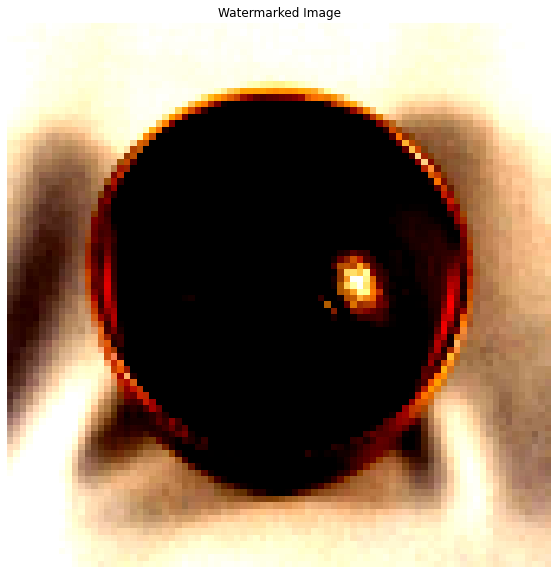

  9%|▉         | 1/11 [00:08<01:20,  8.05s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 19: Target opacity: 0, Labeled correctly: 0.6, Correctly Predicted Target: True, Base class predicted: False


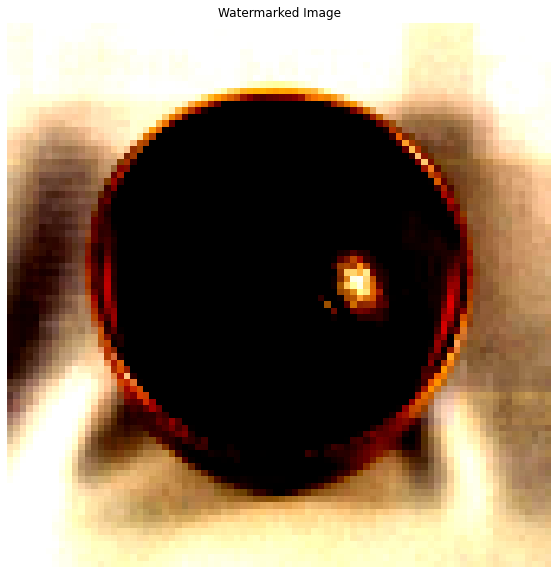

 18%|█▊        | 2/11 [00:16<01:12,  8.06s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 19: Target opacity: 0.05, Labeled correctly: 0.6133333333333333, Correctly Predicted Target: True, Base class predicted: False


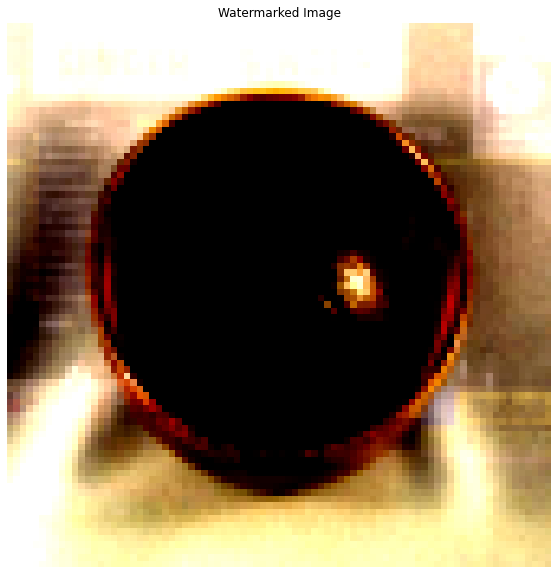

 27%|██▋       | 3/11 [00:24<01:04,  8.04s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 19: Target opacity: 0.1, Labeled correctly: 0.6, Correctly Predicted Target: True, Base class predicted: False


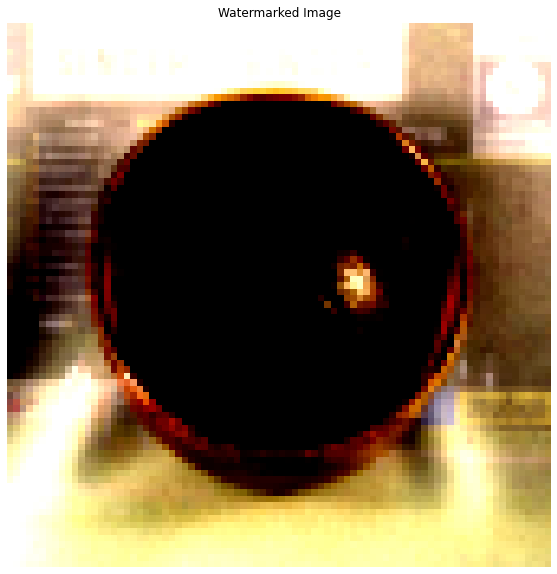

 36%|███▋      | 4/11 [00:32<00:56,  8.05s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 19: Target opacity: 0.15, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: True, Base class predicted: False


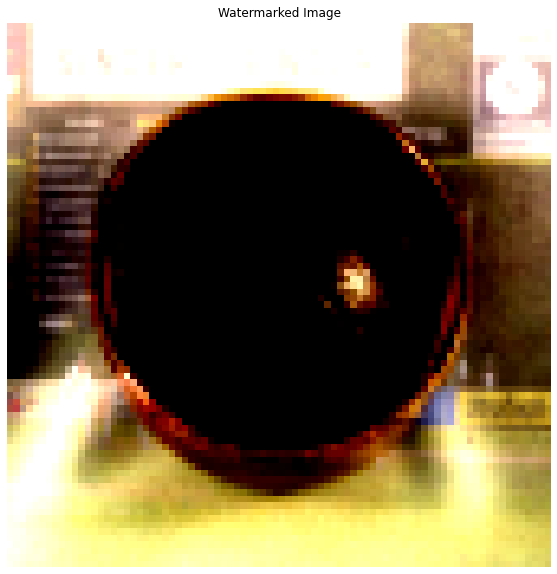

 45%|████▌     | 5/11 [00:40<00:48,  8.02s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 19: Target opacity: 0.2, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: True, Base class predicted: False


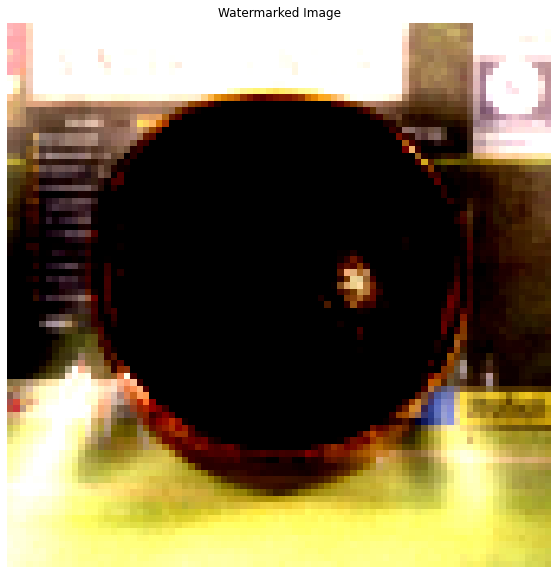

 55%|█████▍    | 6/11 [00:48<00:40,  8.01s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 19: Target opacity: 0.25, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: True, Base class predicted: False


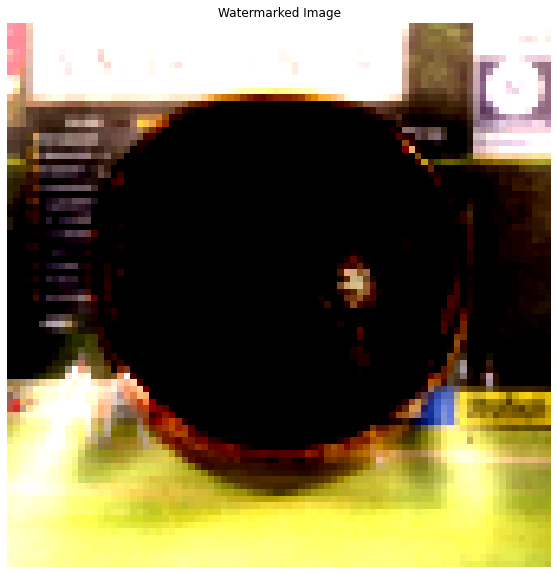

 64%|██████▎   | 7/11 [00:56<00:32,  8.00s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 19: Target opacity: 0.3, Labeled correctly: 0.5733333333333334, Correctly Predicted Target: True, Base class predicted: False


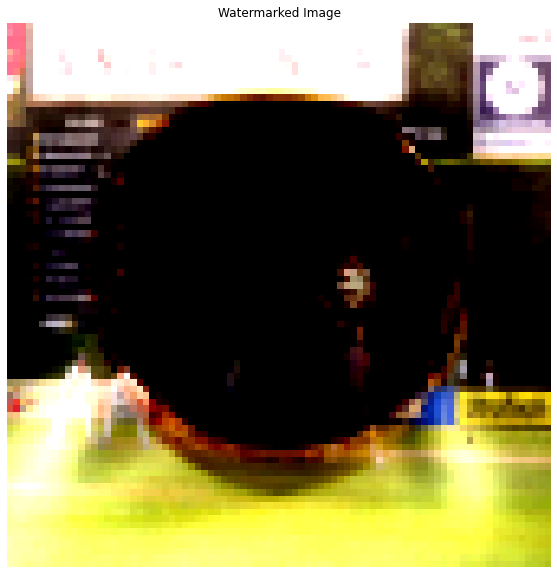

 73%|███████▎  | 8/11 [01:04<00:24,  8.04s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 19: Target opacity: 0.35, Labeled correctly: 0.5733333333333334, Correctly Predicted Target: True, Base class predicted: False


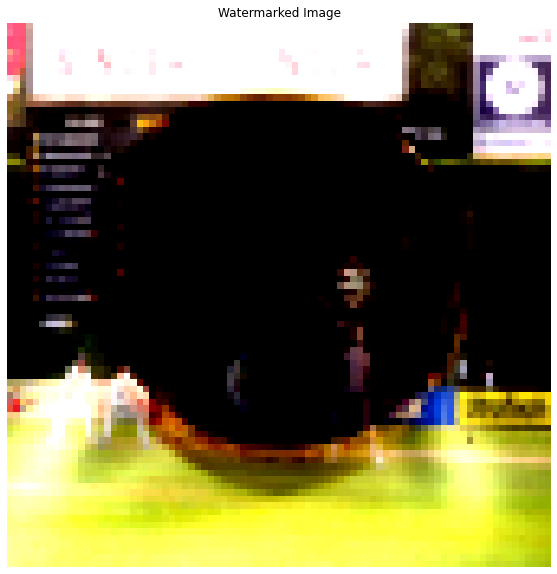

 82%|████████▏ | 9/11 [01:12<00:16,  8.02s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 19: Target opacity: 0.4, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: True, Base class predicted: False


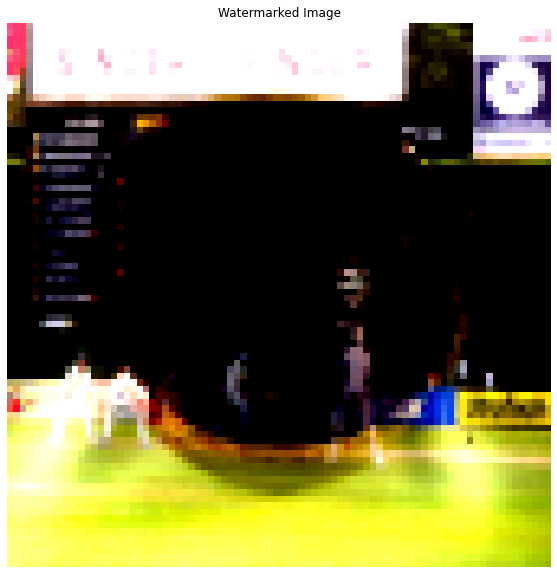

 91%|█████████ | 10/11 [01:20<00:07,  8.00s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 19: Target opacity: 0.45, Labeled correctly: 0.5866666666666667, Correctly Predicted Target: True, Base class predicted: False


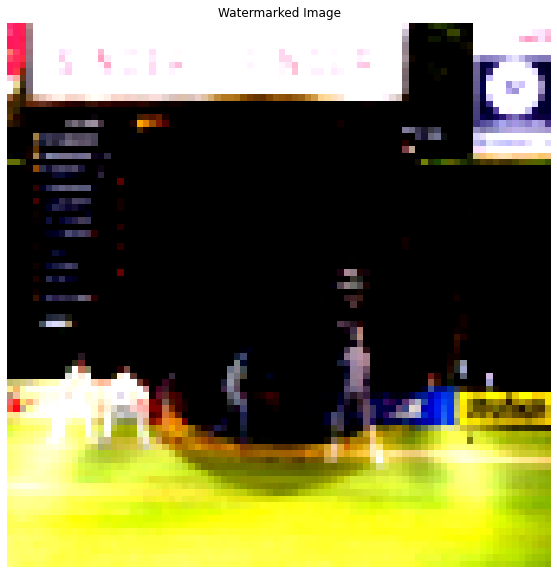

100%|██████████| 11/11 [01:28<00:00,  8.02s/it]

Iteration 19: Target opacity: 0.5, Labeled correctly: 0.5733333333333334, Correctly Predicted Target: True, Base class predicted: False



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


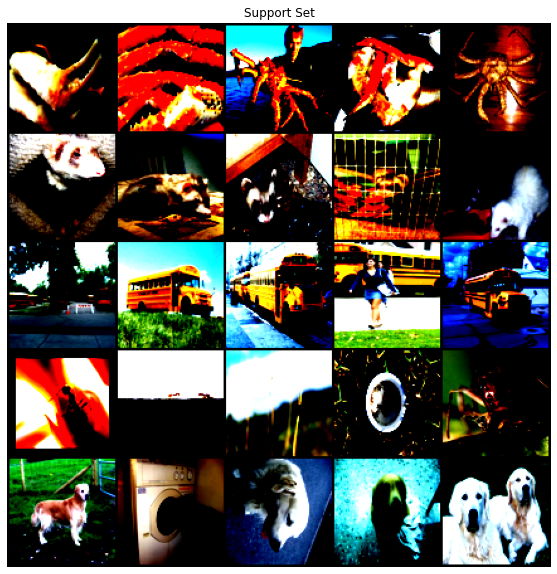

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 1, 1, 1, 1,
         1]])


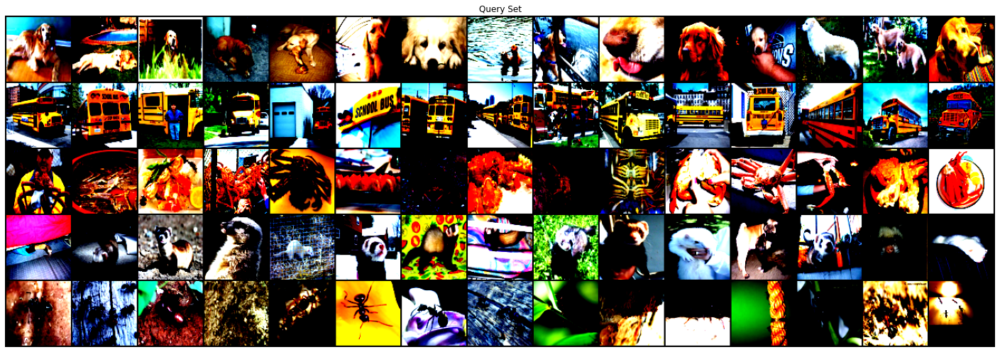

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3,
         3, 3, 3, 3, 3, 3, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2,
         2, 2, 2]])
target_class 0
unique_classes [1, 2, 3, 4]
base_class 1
target_indices [45 46 47 48 49 50 51 52 53 54 55 56 57 58 59]
target_index 45
base_indices [20 21 22 23 24]
base_index 23


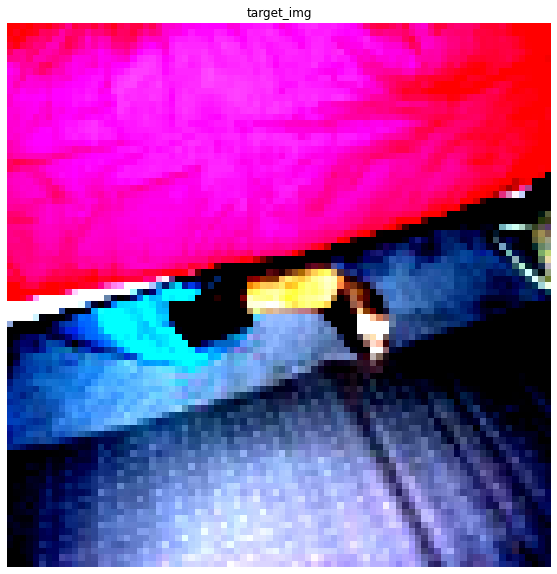

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


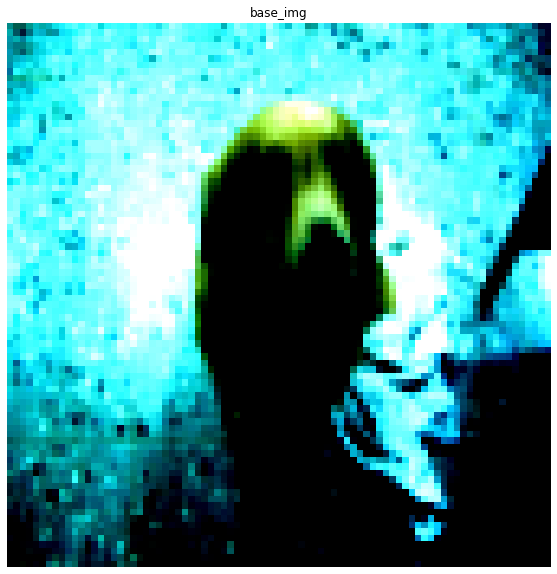

  0%|          | 3/1000 [00:00<00:41, 23.86it/s]

Iteration 0
loss: tensor(0.3049, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(58.9986, grad_fn=<PowBackward0>)
Iteration 2
loss: tensor(28.5217, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(29.3624, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(21.3726, grad_fn=<PowBackward0>)


  1%|          | 9/1000 [00:00<00:39, 25.03it/s]

Iteration 5
loss: tensor(46.8566, grad_fn=<PowBackward0>)
Iteration 6
loss: tensor(3.1103, grad_fn=<PowBackward0>)
Iteration 7
loss: tensor(17.7265, grad_fn=<PowBackward0>)
Iteration 8
loss: tensor(39.3810, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(31.8581, grad_fn=<PowBackward0>)
Iteration 10


  2%|▏         | 15/1000 [00:00<00:40, 24.11it/s]

loss: tensor(18.1826, grad_fn=<PowBackward0>)
Iteration 11
loss: tensor(24.9992, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(11.6839, grad_fn=<PowBackward0>)
Iteration 13
loss: tensor(10.9163, grad_fn=<PowBackward0>)
Iteration 14
loss: tensor(21.5504, grad_fn=<PowBackward0>)
Iteration 15


  2%|▏         | 18/1000 [00:00<00:41, 23.86it/s]

loss: tensor(36.7039, grad_fn=<PowBackward0>)
Iteration 16
loss: tensor(17.9711, grad_fn=<PowBackward0>)
Iteration 17
loss: tensor(45.4014, grad_fn=<PowBackward0>)
Iteration 18
loss: tensor(30.5288, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(18.0020, grad_fn=<PowBackward0>)
Iteration 20
loss: tensor(16.7066, grad_fn=<PowBackward0>)


  2%|▏         | 24/1000 [00:00<00:38, 25.25it/s]

Iteration 21
loss: tensor(25.7424, grad_fn=<PowBackward0>)
Iteration 22
loss: tensor(38.6526, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(12.3989, grad_fn=<PowBackward0>)
Iteration 24
loss: tensor(15.2459, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(16.2411, grad_fn=<PowBackward0>)
Iteration 26


  3%|▎         | 30/1000 [00:01<00:38, 25.45it/s]

loss: tensor(22.0908, grad_fn=<PowBackward0>)
Iteration 27
loss: tensor(32.6780, grad_fn=<PowBackward0>)
Iteration 28
loss: tensor(40.8870, grad_fn=<PowBackward0>)
Iteration 29
loss: tensor(30.5189, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(11.0164, grad_fn=<PowBackward0>)
Iteration 31
loss: tensor(22.4384, grad_fn=<PowBackward0>)


  4%|▎         | 36/1000 [00:01<00:39, 24.64it/s]

Iteration 32
loss: tensor(22.1122, grad_fn=<PowBackward0>)
Iteration 33
loss: tensor(19.7892, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(17.5590, grad_fn=<PowBackward0>)
Iteration 35
loss: tensor(14.1649, grad_fn=<PowBackward0>)
Iteration 36
loss: tensor(30.5178, grad_fn=<PowBackward0>)


  4%|▍         | 39/1000 [00:01<00:42, 22.85it/s]

Iteration 37
loss: tensor(26.2104, grad_fn=<PowBackward0>)
Iteration 38
loss: tensor(20.4242, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(45.0804, grad_fn=<PowBackward0>)
Iteration 40
loss: tensor(22.0177, grad_fn=<PowBackward0>)
Iteration 41


  4%|▍         | 45/1000 [00:01<00:41, 23.18it/s]

loss: tensor(34.3841, grad_fn=<PowBackward0>)
Iteration 42
loss: tensor(10.3261, grad_fn=<PowBackward0>)
Iteration 43
loss: tensor(34.7782, grad_fn=<PowBackward0>)
Iteration 44
loss: tensor(9.1037, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(10.9981, grad_fn=<PowBackward0>)
Iteration 46
loss: tensor(38.6860, grad_fn=<PowBackward0>)


  5%|▌         | 51/1000 [00:02<00:38, 24.48it/s]

Iteration 47
loss: tensor(15.1027, grad_fn=<PowBackward0>)
Iteration 48
loss: tensor(8.0326, grad_fn=<PowBackward0>)
Iteration 49
loss: tensor(57.0049, grad_fn=<PowBackward0>)
Iteration 50
loss: tensor(10.4194, grad_fn=<PowBackward0>)
Iteration 51
loss: tensor(4.1114, grad_fn=<PowBackward0>)
Iteration 52


  6%|▌         | 57/1000 [00:02<00:37, 25.48it/s]

loss: tensor(44.6465, grad_fn=<PowBackward0>)
Iteration 53
loss: tensor(27.6742, grad_fn=<PowBackward0>)
Iteration 54
loss: tensor(3.3759, grad_fn=<PowBackward0>)
Iteration 55
loss: tensor(24.4766, grad_fn=<PowBackward0>)
Iteration 56
loss: tensor(29.3619, grad_fn=<PowBackward0>)
Iteration 57
loss: tensor(10.1683, grad_fn=<PowBackward0>)


  6%|▋         | 63/1000 [00:02<00:37, 24.97it/s]

Iteration 58
loss: tensor(5.7540, grad_fn=<PowBackward0>)
Iteration 59
loss: tensor(26.2916, grad_fn=<PowBackward0>)
Iteration 60
loss: tensor(26.6700, grad_fn=<PowBackward0>)
Iteration 61
loss: tensor(25.4917, grad_fn=<PowBackward0>)
Iteration 62
loss: tensor(33.7018, grad_fn=<PowBackward0>)


  7%|▋         | 66/1000 [00:02<00:37, 24.72it/s]

Iteration 63
loss: tensor(23.0485, grad_fn=<PowBackward0>)
Iteration 64
loss: tensor(34.0478, grad_fn=<PowBackward0>)
Iteration 65
loss: tensor(23.4955, grad_fn=<PowBackward0>)
Iteration 66
loss: tensor(22.8335, grad_fn=<PowBackward0>)
Iteration 67
loss: tensor(28.6691, grad_fn=<PowBackward0>)
Iteration 68


  7%|▋         | 72/1000 [00:02<00:37, 24.94it/s]

loss: tensor(5.7929, grad_fn=<PowBackward0>)
Iteration 69
loss: tensor(39.5876, grad_fn=<PowBackward0>)
Iteration 70
loss: tensor(16.6322, grad_fn=<PowBackward0>)
Iteration 71
loss: tensor(7.7403, grad_fn=<PowBackward0>)
Iteration 72
loss: tensor(20.4019, grad_fn=<PowBackward0>)
Iteration 73
loss: tensor(43.3280, grad_fn=<PowBackward0>)


  8%|▊         | 78/1000 [00:03<00:36, 25.58it/s]

Iteration 74
loss: tensor(15.9786, grad_fn=<PowBackward0>)
Iteration 75
loss: tensor(26.5311, grad_fn=<PowBackward0>)
Iteration 76
loss: tensor(23.4712, grad_fn=<PowBackward0>)
Iteration 77
loss: tensor(10.8405, grad_fn=<PowBackward0>)
Iteration 78
loss: tensor(30.3541, grad_fn=<PowBackward0>)
Iteration 79


  8%|▊         | 84/1000 [00:03<00:36, 24.85it/s]

loss: tensor(21.6658, grad_fn=<PowBackward0>)
Iteration 80
loss: tensor(12.1990, grad_fn=<PowBackward0>)
Iteration 81
loss: tensor(29.0957, grad_fn=<PowBackward0>)
Iteration 82
loss: tensor(20.2595, grad_fn=<PowBackward0>)
Iteration 83
loss: tensor(27.5705, grad_fn=<PowBackward0>)
Iteration 84


  9%|▉         | 90/1000 [00:03<00:35, 25.97it/s]

loss: tensor(32.4579, grad_fn=<PowBackward0>)
Iteration 85
loss: tensor(31.1179, grad_fn=<PowBackward0>)
Iteration 86
loss: tensor(12.3746, grad_fn=<PowBackward0>)
Iteration 87
loss: tensor(24.2894, grad_fn=<PowBackward0>)
Iteration 88
loss: tensor(14.9502, grad_fn=<PowBackward0>)
Iteration 89
loss: tensor(31.2937, grad_fn=<PowBackward0>)


  9%|▉         | 93/1000 [00:03<00:36, 25.11it/s]

Iteration 90
loss: tensor(16.6384, grad_fn=<PowBackward0>)
Iteration 91
loss: tensor(15.3002, grad_fn=<PowBackward0>)
Iteration 92
loss: tensor(18.3297, grad_fn=<PowBackward0>)
Iteration 93
loss: tensor(21.0721, grad_fn=<PowBackward0>)
Iteration 94
loss: tensor(24.4113, grad_fn=<PowBackward0>)
Iteration 95


 10%|▉         | 99/1000 [00:03<00:34, 26.06it/s]

loss: tensor(15.5232, grad_fn=<PowBackward0>)
Iteration 96
loss: tensor(45.3506, grad_fn=<PowBackward0>)
Iteration 97
loss: tensor(23.6319, grad_fn=<PowBackward0>)
Iteration 98
loss: tensor(9.0774, grad_fn=<PowBackward0>)
Iteration 99
loss: tensor(35.7020, grad_fn=<PowBackward0>)
Iteration 100
loss: tensor(18.6242, grad_fn=<PowBackward0>)
Iteration 101


 10%|█         | 105/1000 [00:04<00:33, 26.70it/s]

loss: tensor(54.7687, grad_fn=<PowBackward0>)
Iteration 102
loss: tensor(1.1963, grad_fn=<PowBackward0>)
Iteration 103
loss: tensor(6.3530, grad_fn=<PowBackward0>)
Iteration 104
loss: tensor(32.5042, grad_fn=<PowBackward0>)
Iteration 105
loss: tensor(58.1886, grad_fn=<PowBackward0>)
Iteration 106
loss: tensor(5.1636, grad_fn=<PowBackward0>)


 11%|█         | 111/1000 [00:04<00:33, 26.44it/s]

Iteration 107
loss: tensor(21.8755, grad_fn=<PowBackward0>)
Iteration 108
loss: tensor(6.3642, grad_fn=<PowBackward0>)
Iteration 109
loss: tensor(46.3873, grad_fn=<PowBackward0>)
Iteration 110
loss: tensor(26.7565, grad_fn=<PowBackward0>)
Iteration 111
loss: tensor(22.1149, grad_fn=<PowBackward0>)
Iteration 112


 12%|█▏        | 117/1000 [00:04<00:34, 25.81it/s]

loss: tensor(29.5468, grad_fn=<PowBackward0>)
Iteration 113
loss: tensor(19.0805, grad_fn=<PowBackward0>)
Iteration 114
loss: tensor(22.6496, grad_fn=<PowBackward0>)
Iteration 115
loss: tensor(15.9656, grad_fn=<PowBackward0>)
Iteration 116
loss: tensor(24.9616, grad_fn=<PowBackward0>)
Iteration 117


 12%|█▏        | 120/1000 [00:04<00:37, 23.72it/s]

loss: tensor(15.7639, grad_fn=<PowBackward0>)
Iteration 118
loss: tensor(29.9812, grad_fn=<PowBackward0>)
Iteration 119
loss: tensor(40.2036, grad_fn=<PowBackward0>)
Iteration 120
loss: tensor(21.1554, grad_fn=<PowBackward0>)
Iteration 121
loss: tensor(32.4519, grad_fn=<PowBackward0>)
Iteration 122
loss: tensor(6.6101, grad_fn=<PowBackward0>)

 13%|█▎        | 126/1000 [00:05<00:34, 25.21it/s]


Iteration 123
loss: tensor(15.8431, grad_fn=<PowBackward0>)
Iteration 124
loss: tensor(38.3214, grad_fn=<PowBackward0>)
Iteration 125
loss: tensor(69.4988, grad_fn=<PowBackward0>)
Iteration 126
loss: tensor(13.2271, grad_fn=<PowBackward0>)
Iteration 127
loss: tensor(60.9918, grad_fn=<PowBackward0>)


 13%|█▎        | 132/1000 [00:05<00:33, 25.69it/s]

Iteration 128
loss: tensor(10.3602, grad_fn=<PowBackward0>)
Iteration 129
loss: tensor(35.6347, grad_fn=<PowBackward0>)
Iteration 130
loss: tensor(15.2382, grad_fn=<PowBackward0>)
Iteration 131
loss: tensor(41.2114, grad_fn=<PowBackward0>)
Iteration 132
loss: tensor(23.5540, grad_fn=<PowBackward0>)
Iteration 133


 14%|█▍        | 138/1000 [00:05<00:33, 25.42it/s]

loss: tensor(32.8597, grad_fn=<PowBackward0>)
Iteration 134
loss: tensor(14.3504, grad_fn=<PowBackward0>)
Iteration 135
loss: tensor(24.2799, grad_fn=<PowBackward0>)
Iteration 136
loss: tensor(19.7748, grad_fn=<PowBackward0>)
Iteration 137
loss: tensor(28.1751, grad_fn=<PowBackward0>)
Iteration 138
loss: tensor(4.7797, grad_fn=<PowBackward0>)


 14%|█▍        | 141/1000 [00:05<00:33, 25.85it/s]

Iteration 139
loss: tensor(15.0861, grad_fn=<PowBackward0>)
Iteration 140
loss: tensor(27.5198, grad_fn=<PowBackward0>)
Iteration 141
loss: tensor(27.1201, grad_fn=<PowBackward0>)
Iteration 142
loss: tensor(19.7659, grad_fn=<PowBackward0>)
Iteration 143
loss: tensor(20.6559, grad_fn=<PowBackward0>)


 15%|█▍        | 147/1000 [00:05<00:33, 25.43it/s]

Iteration 144
loss: tensor(15.5912, grad_fn=<PowBackward0>)
Iteration 145
loss: tensor(23.0043, grad_fn=<PowBackward0>)
Iteration 146
loss: tensor(12.2497, grad_fn=<PowBackward0>)
Iteration 147
loss: tensor(27.5492, grad_fn=<PowBackward0>)
Iteration 148
loss: tensor(28.4533, grad_fn=<PowBackward0>)
Iteration 149
loss: tensor(41.0872, grad_fn=<PowBackward0>)


 15%|█▌        | 153/1000 [00:06<00:31, 26.76it/s]

Iteration 150
loss: tensor(4.3348, grad_fn=<PowBackward0>)
Iteration 151
loss: tensor(10.1538, grad_fn=<PowBackward0>)
Iteration 152
loss: tensor(22.6863, grad_fn=<PowBackward0>)
Iteration 153
loss: tensor(66.1290, grad_fn=<PowBackward0>)
Iteration 154
loss: tensor(25.9339, grad_fn=<PowBackward0>)
Iteration 155
loss: tensor(24.2778, grad_fn=<PowBackward0>)

 16%|█▌        | 159/1000 [00:06<00:32, 26.00it/s]


Iteration 156
loss: tensor(20.3400, grad_fn=<PowBackward0>)
Iteration 157
loss: tensor(19.0266, grad_fn=<PowBackward0>)
Iteration 158
loss: tensor(9.3218, grad_fn=<PowBackward0>)
Iteration 159
loss: tensor(42.9923, grad_fn=<PowBackward0>)
Iteration 160
loss: tensor(17.3557, grad_fn=<PowBackward0>)

 16%|█▋        | 165/1000 [00:06<00:33, 25.12it/s]


Iteration 161
loss: tensor(36.8034, grad_fn=<PowBackward0>)
Iteration 162
loss: tensor(27.5711, grad_fn=<PowBackward0>)
Iteration 163
loss: tensor(52.2030, grad_fn=<PowBackward0>)
Iteration 164
loss: tensor(8.5634, grad_fn=<PowBackward0>)
Iteration 165


 17%|█▋        | 168/1000 [00:06<00:33, 24.96it/s]

loss: tensor(17.2662, grad_fn=<PowBackward0>)
Iteration 166
loss: tensor(19.8773, grad_fn=<PowBackward0>)
Iteration 167
loss: tensor(46.9187, grad_fn=<PowBackward0>)
Iteration 168
loss: tensor(12.4755, grad_fn=<PowBackward0>)
Iteration 169
loss: tensor(28.5383, grad_fn=<PowBackward0>)
Iteration 170


 17%|█▋        | 174/1000 [00:06<00:32, 25.07it/s]

loss: tensor(23.2523, grad_fn=<PowBackward0>)
Iteration 171
loss: tensor(20.5605, grad_fn=<PowBackward0>)
Iteration 172
loss: tensor(33.0697, grad_fn=<PowBackward0>)
Iteration 173
loss: tensor(15.8856, grad_fn=<PowBackward0>)
Iteration 174
loss: tensor(10.4413, grad_fn=<PowBackward0>)
Iteration 175
loss: tensor(18.6290, grad_fn=<PowBackward0>)


 18%|█▊        | 180/1000 [00:07<00:32, 25.19it/s]

Iteration 176
loss: tensor(30.4270, grad_fn=<PowBackward0>)
Iteration 177
loss: tensor(22.0586, grad_fn=<PowBackward0>)
Iteration 178
loss: tensor(12.9434, grad_fn=<PowBackward0>)
Iteration 179
loss: tensor(23.6141, grad_fn=<PowBackward0>)
Iteration 180
loss: tensor(23.8559, grad_fn=<PowBackward0>)
Iteration

 19%|█▊        | 186/1000 [00:07<00:32, 25.12it/s]

 181
loss: tensor(22.5015, grad_fn=<PowBackward0>)
Iteration 182
loss: tensor(35.2538, grad_fn=<PowBackward0>)
Iteration 183
loss: tensor(21.2922, grad_fn=<PowBackward0>)
Iteration 184
loss: tensor(16.5345, grad_fn=<PowBackward0>)
Iteration 185
loss: tensor(28.0437, grad_fn=<PowBackward0>)
Iteration 186


 19%|█▉        | 189/1000 [00:07<00:32, 25.21it/s]

loss: tensor(18.7303, grad_fn=<PowBackward0>)
Iteration 187
loss: tensor(13.1060, grad_fn=<PowBackward0>)
Iteration 188
loss: tensor(21.1637, grad_fn=<PowBackward0>)
Iteration 189
loss: tensor(41.7423, grad_fn=<PowBackward0>)
Iteration 190
loss: tensor(5.5980, grad_fn=<PowBackward0>)
Iteration 191
loss: tensor(67.2202, grad_fn=<PowBackward0>)


 20%|█▉        | 195/1000 [00:07<00:32, 24.66it/s]

Iteration 192
loss: tensor(29.1186, grad_fn=<PowBackward0>)
Iteration 193
loss: tensor(17.0745, grad_fn=<PowBackward0>)
Iteration 194
loss: tensor(24.1296, grad_fn=<PowBackward0>)
Iteration 195
loss: tensor(54.9557, grad_fn=<PowBackward0>)
Iteration 196
loss: tensor(26.1764, grad_fn=<PowBackward0>)


 20%|██        | 201/1000 [00:08<00:32, 24.44it/s]

Iteration 197
loss: tensor(7.6397, grad_fn=<PowBackward0>)
Iteration 198
loss: tensor(22.2493, grad_fn=<PowBackward0>)
Iteration 199
loss: tensor(18.5340, grad_fn=<PowBackward0>)
Iteration 200
loss: tensor(38.3809, grad_fn=<PowBackward0>)
Iteration 201
loss: tensor(17.0388, grad_fn=<PowBackward0>)


 21%|██        | 207/1000 [00:08<00:31, 24.89it/s]

Iteration 202
loss: tensor(11.9395, grad_fn=<PowBackward0>)
Iteration 203
loss: tensor(12.3470, grad_fn=<PowBackward0>)
Iteration 204
loss: tensor(1.4110, grad_fn=<PowBackward0>)
Iteration 205
loss: tensor(7.2391, grad_fn=<PowBackward0>)
Iteration 206
loss: tensor(16.3062, grad_fn=<PowBackward0>)
Iteration 207


 21%|██        | 210/1000 [00:08<00:31, 25.28it/s]

loss: tensor(18.7347, grad_fn=<PowBackward0>)
Iteration 208
loss: tensor(22.2913, grad_fn=<PowBackward0>)
Iteration 209
loss: tensor(41.0797, grad_fn=<PowBackward0>)
Iteration 210
loss: tensor(11.6155, grad_fn=<PowBackward0>)
Iteration 211
loss: tensor(25.9104, grad_fn=<PowBackward0>)
Iteration 212
loss: tensor(12.0092, grad_fn=<PowBackward0>)


 22%|██▏       | 216/1000 [00:08<00:30, 25.67it/s]

Iteration 213
loss: tensor(24.2873, grad_fn=<PowBackward0>)
Iteration 214
loss: tensor(19.5662, grad_fn=<PowBackward0>)
Iteration 215
loss: tensor(7.9507, grad_fn=<PowBackward0>)
Iteration 216
loss: tensor(10.1808, grad_fn=<PowBackward0>)
Iteration 217
loss: tensor(17.6235, grad_fn=<PowBackward0>)
Iteration 218


 22%|██▏       | 222/1000 [00:08<00:30, 25.41it/s]

loss: tensor(4.4156, grad_fn=<PowBackward0>)
Iteration 219
loss: tensor(29.3078, grad_fn=<PowBackward0>)
Iteration 220
loss: tensor(19.1161, grad_fn=<PowBackward0>)
Iteration 221
loss: tensor(40.6958, grad_fn=<PowBackward0>)
Iteration 222
loss: tensor(7.9672, grad_fn=<PowBackward0>)
Iteration 223
loss: tensor(26.7158, grad_fn=<PowBackward0>)


 23%|██▎       | 228/1000 [00:09<00:29, 25.89it/s]

Iteration 224
loss: tensor(18.0836, grad_fn=<PowBackward0>)
Iteration 225
loss: tensor(22.7884, grad_fn=<PowBackward0>)
Iteration 226
loss: tensor(22.5824, grad_fn=<PowBackward0>)
Iteration 227
loss: tensor(11.0074, grad_fn=<PowBackward0>)
Iteration 228
loss: tensor(16.5285, grad_fn=<PowBackward0>)
Iteration 229


 23%|██▎       | 234/1000 [00:09<00:29, 25.95it/s]

loss: tensor(11.6017, grad_fn=<PowBackward0>)
Iteration 230
loss: tensor(21.0661, grad_fn=<PowBackward0>)
Iteration 231
loss: tensor(16.9888, grad_fn=<PowBackward0>)
Iteration 232
loss: tensor(22.2316, grad_fn=<PowBackward0>)
Iteration 233
loss: tensor(42.1876, grad_fn=<PowBackward0>)
Iteration 234
loss: tensor(4.6406, grad_fn=<PowBackward0>)


 24%|██▍       | 240/1000 [00:09<00:30, 25.21it/s]

Iteration 235
loss: tensor(18.9783, grad_fn=<PowBackward0>)
Iteration 236
loss: tensor(21.9421, grad_fn=<PowBackward0>)
Iteration 237
loss: tensor(25.8185, grad_fn=<PowBackward0>)
Iteration 238
loss: tensor(21.8792, grad_fn=<PowBackward0>)
Iteration 239
loss: tensor(17.9242, grad_fn=<PowBackward0>)


 24%|██▍       | 243/1000 [00:09<00:30, 24.55it/s]

Iteration 240
loss: tensor(19.4062, grad_fn=<PowBackward0>)
Iteration 241
loss: tensor(16.0366, grad_fn=<PowBackward0>)
Iteration 242
loss: tensor(24.4597, grad_fn=<PowBackward0>)
Iteration 243
loss: tensor(15.8368, grad_fn=<PowBackward0>)
Iteration 244
loss: tensor(22.1636, grad_fn=<PowBackward0>)
Iteration 245


 25%|██▍       | 249/1000 [00:09<00:30, 24.95it/s]

loss: tensor(23.0031, grad_fn=<PowBackward0>)
Iteration 246
loss: tensor(6.7618, grad_fn=<PowBackward0>)
Iteration 247
loss: tensor(36.0073, grad_fn=<PowBackward0>)
Iteration 248
loss: tensor(14.7439, grad_fn=<PowBackward0>)
Iteration 249
loss: tensor(13.5289, grad_fn=<PowBackward0>)
Iteration 250
loss: tensor(13.3930, grad_fn=<PowBackward0>)


 26%|██▌       | 255/1000 [00:10<00:30, 24.70it/s]

Iteration 251
loss: tensor(21.7485, grad_fn=<PowBackward0>)
Iteration 252
loss: tensor(24.0082, grad_fn=<PowBackward0>)
Iteration 253
loss: tensor(9.4370, grad_fn=<PowBackward0>)
Iteration 254
loss: tensor(15.8104, grad_fn=<PowBackward0>)
Iteration 255
loss: tensor(41.6257, grad_fn=<PowBackward0>)


 26%|██▌       | 261/1000 [00:10<00:29, 25.46it/s]

Iteration 256
loss: tensor(27.9217, grad_fn=<PowBackward0>)
Iteration 257
loss: tensor(36.6225, grad_fn=<PowBackward0>)
Iteration 258
loss: tensor(10.0898, grad_fn=<PowBackward0>)
Iteration 259
loss: tensor(14.5676, grad_fn=<PowBackward0>)
Iteration 260
loss: tensor(5.8921, grad_fn=<PowBackward0>)
Iteration 261


 26%|██▋       | 264/1000 [00:10<00:28, 25.95it/s]

loss: tensor(24.0688, grad_fn=<PowBackward0>)
Iteration 262
loss: tensor(20.4845, grad_fn=<PowBackward0>)
Iteration 263
loss: tensor(11.7077, grad_fn=<PowBackward0>)
Iteration 264
loss: tensor(12.2346, grad_fn=<PowBackward0>)
Iteration 265
loss: tensor(12.3331, grad_fn=<PowBackward0>)
Iteration 266
loss: tensor(10.7279, grad_fn=<PowBackward0>)


 27%|██▋       | 270/1000 [00:10<00:28, 25.76it/s]

Iteration 267
loss: tensor(21.2552, grad_fn=<PowBackward0>)
Iteration 268
loss: tensor(9.3567, grad_fn=<PowBackward0>)
Iteration 269
loss: tensor(23.4019, grad_fn=<PowBackward0>)
Iteration 270
loss: tensor(2.5874, grad_fn=<PowBackward0>)
Iteration 271
loss: tensor(3.2310, grad_fn=<PowBackward0>)
Iteration 272


 28%|██▊       | 276/1000 [00:10<00:27, 26.06it/s]

loss: tensor(19.8881, grad_fn=<PowBackward0>)
Iteration 273
loss: tensor(17.0587, grad_fn=<PowBackward0>)
Iteration 274
loss: tensor(11.5826, grad_fn=<PowBackward0>)
Iteration 275
loss: tensor(27.9128, grad_fn=<PowBackward0>)
Iteration 276
loss: tensor(7.1055, grad_fn=<PowBackward0>)
Iteration 277
loss: tensor(14.4834, grad_fn=<PowBackward0>)


 28%|██▊       | 282/1000 [00:11<00:27, 25.94it/s]

Iteration 278
loss: tensor(18.4873, grad_fn=<PowBackward0>)
Iteration 279
loss: tensor(13.5637, grad_fn=<PowBackward0>)
Iteration 280
loss: tensor(22.3428, grad_fn=<PowBackward0>)
Iteration 281
loss: tensor(26.4871, grad_fn=<PowBackward0>)
Iteration 282
loss: tensor(11.8019, grad_fn=<PowBackward0>)
Iteration 283


 29%|██▉       | 288/1000 [00:11<00:26, 26.52it/s]

loss: tensor(30.3575, grad_fn=<PowBackward0>)
Iteration 284
loss: tensor(2.7005, grad_fn=<PowBackward0>)
Iteration 285
loss: tensor(6.7984, grad_fn=<PowBackward0>)
Iteration 286
loss: tensor(22.4550, grad_fn=<PowBackward0>)
Iteration 287
loss: tensor(22.1415, grad_fn=<PowBackward0>)
Iteration 288
loss: tensor(11.9148, grad_fn=<PowBackward0>)


 29%|██▉       | 291/1000 [00:11<00:27, 25.60it/s]

Iteration 289
loss: tensor(8.6346, grad_fn=<PowBackward0>)
Iteration 290
loss: tensor(20.9773, grad_fn=<PowBackward0>)
Iteration 291
loss: tensor(40.5644, grad_fn=<PowBackward0>)
Iteration 292
loss: tensor(15.9364, grad_fn=<PowBackward0>)
Iteration 293
loss: tensor(30.6417, grad_fn=<PowBackward0>)


 30%|██▉       | 297/1000 [00:11<00:30, 22.68it/s]

Iteration 294
loss: tensor(22.5332, grad_fn=<PowBackward0>)
Iteration 295
loss: tensor(11.1766, grad_fn=<PowBackward0>)
Iteration 296
loss: tensor(10.9011, grad_fn=<PowBackward0>)
Iteration 297
loss: tensor(31.0321, grad_fn=<PowBackward0>)


 30%|███       | 303/1000 [00:12<00:29, 23.73it/s]

Iteration 298
loss: tensor(5.5722, grad_fn=<PowBackward0>)
Iteration 299
loss: tensor(15.9473, grad_fn=<PowBackward0>)
Iteration 300
loss: tensor(15.5179, grad_fn=<PowBackward0>)
Iteration 301
loss: tensor(12.5437, grad_fn=<PowBackward0>)
Iteration 302
loss: tensor(1.4244, grad_fn=<PowBackward0>)
Iteration 303


 31%|███       | 306/1000 [00:12<00:28, 24.14it/s]

loss: tensor(9.0158, grad_fn=<PowBackward0>)
Iteration 304
loss: tensor(4.6866, grad_fn=<PowBackward0>)
Iteration 305
loss: tensor(9.4746, grad_fn=<PowBackward0>)
Iteration 306
loss: tensor(11.2266, grad_fn=<PowBackward0>)
Iteration 307
loss: tensor(11.3744, grad_fn=<PowBackward0>)
Iteration 308
loss: tensor(5.9110, grad_fn=<PowBackward0>)


 31%|███       | 312/1000 [00:12<00:27, 24.63it/s]

Iteration 309
loss: tensor(10.7114, grad_fn=<PowBackward0>)
Iteration 310
loss: tensor(6.1131, grad_fn=<PowBackward0>)
Iteration 311
loss: tensor(5.2401, grad_fn=<PowBackward0>)
Iteration 312
loss: tensor(3.8082, grad_fn=<PowBackward0>)
Iteration 313
loss: tensor(5.7597, grad_fn=<PowBackward0>)


 32%|███▏      | 318/1000 [00:12<00:27, 24.76it/s]

Iteration 314
loss: tensor(14.3404, grad_fn=<PowBackward0>)
Iteration 315
loss: tensor(19.5510, grad_fn=<PowBackward0>)
Iteration 316
loss: tensor(7.1649, grad_fn=<PowBackward0>)
Iteration 317
loss: tensor(7.7297, grad_fn=<PowBackward0>)
Iteration 318
loss: tensor(9.1848, grad_fn=<PowBackward0>)
Iteration 319


 32%|███▏      | 324/1000 [00:12<00:27, 24.52it/s]

loss: tensor(4.8768, grad_fn=<PowBackward0>)
Iteration 320
loss: tensor(5.6378, grad_fn=<PowBackward0>)
Iteration 321
loss: tensor(10.6431, grad_fn=<PowBackward0>)
Iteration 322
loss: tensor(9.5594, grad_fn=<PowBackward0>)
Iteration 323
loss: tensor(17.8856, grad_fn=<PowBackward0>)
Iteration 324
loss: 

 33%|███▎      | 330/1000 [00:13<00:25, 25.89it/s]

tensor(13.4573, grad_fn=<PowBackward0>)
Iteration 325
loss: tensor(9.7051, grad_fn=<PowBackward0>)
Iteration 326
loss: tensor(10.0507, grad_fn=<PowBackward0>)
Iteration 327
loss: tensor(10.2169, grad_fn=<PowBackward0>)
Iteration 328
loss: tensor(7.9270, grad_fn=<PowBackward0>)
Iteration 329
loss: tensor(5.7198, grad_fn=<PowBackward0>)


 33%|███▎      | 333/1000 [00:13<00:25, 25.73it/s]

Iteration 330
loss: tensor(3.7914, grad_fn=<PowBackward0>)
Iteration 331
loss: tensor(5.0824, grad_fn=<PowBackward0>)
Iteration 332
loss: tensor(7.7144, grad_fn=<PowBackward0>)
Iteration 333
loss: tensor(9.2513, grad_fn=<PowBackward0>)
Iteration 334
loss: tensor(6.8324, grad_fn=<PowBackward0>)
Iteration 335


 34%|███▍      | 339/1000 [00:13<00:26, 25.31it/s]

loss: tensor(14.8338, grad_fn=<PowBackward0>)
Iteration 336
loss: tensor(9.1139, grad_fn=<PowBackward0>)
Iteration 337
loss: tensor(9.7493, grad_fn=<PowBackward0>)
Iteration 338
loss: tensor(16.3449, grad_fn=<PowBackward0>)
Iteration 339
loss: tensor(5.6697, grad_fn=<PowBackward0>)
Iteration 340
loss: tensor(4.6974, grad_fn=<PowBackward0>)


 34%|███▍      | 345/1000 [00:13<00:25, 25.77it/s]

Iteration 341
loss: tensor(9.8695, grad_fn=<PowBackward0>)
Iteration 342
loss: tensor(10.7941, grad_fn=<PowBackward0>)
Iteration 343
loss: tensor(6.5271, grad_fn=<PowBackward0>)
Iteration 344
loss: tensor(7.9556, grad_fn=<PowBackward0>)
Iteration 345
loss: tensor(14.2257, grad_fn=<PowBackward0>)


 35%|███▌      | 351/1000 [00:13<00:25, 25.69it/s]

Iteration 346
loss: tensor(10.7489, grad_fn=<PowBackward0>)
Iteration 347
loss: tensor(7.0253, grad_fn=<PowBackward0>)
Iteration 348
loss: tensor(3.2427, grad_fn=<PowBackward0>)
Iteration 349
loss: tensor(3.6702, grad_fn=<PowBackward0>)
Iteration 350
loss: tensor(4.8556, grad_fn=<PowBackward0>)
Iteration 351


 35%|███▌      | 354/1000 [00:14<00:24, 25.99it/s]

loss: tensor(10.9149, grad_fn=<PowBackward0>)
Iteration 352
loss: tensor(14.2425, grad_fn=<PowBackward0>)
Iteration 353
loss: tensor(10.2295, grad_fn=<PowBackward0>)
Iteration 354
loss: tensor(19.2194, grad_fn=<PowBackward0>)
Iteration 355
loss: tensor(18.9537, grad_fn=<PowBackward0>)
Iteration 356
loss: tensor(5.1021, grad_fn=<PowBackward0>)


 36%|███▌      | 360/1000 [00:14<00:24, 26.03it/s]

Iteration 357
loss: tensor(5.8510, grad_fn=<PowBackward0>)
Iteration 358
loss: tensor(4.8209, grad_fn=<PowBackward0>)
Iteration 359
loss: tensor(4.9456, grad_fn=<PowBackward0>)
Iteration 360
loss: tensor(7.6605, grad_fn=<PowBackward0>)
Iteration 361
loss: tensor(6.9471, grad_fn=<PowBackward0>)
Iteration 362


 37%|███▋      | 366/1000 [00:14<00:24, 26.06it/s]

loss: tensor(9.0411, grad_fn=<PowBackward0>)
Iteration 363
loss: tensor(5.9321, grad_fn=<PowBackward0>)
Iteration 364
loss: tensor(2.6187, grad_fn=<PowBackward0>)
Iteration 365
loss: tensor(1.9383, grad_fn=<PowBackward0>)
Iteration 366
loss: tensor(3.0132, grad_fn=<PowBackward0>)
Iteration 367
loss: tensor(5.1832, grad_fn=<PowBackward0>)


 37%|███▋      | 372/1000 [00:14<00:23, 26.73it/s]

Iteration 368
loss: tensor(4.6083, grad_fn=<PowBackward0>)
Iteration 369
loss: tensor(14.6907, grad_fn=<PowBackward0>)
Iteration 370
loss: tensor(10.0101, grad_fn=<PowBackward0>)
Iteration 371
loss: tensor(17.1902, grad_fn=<PowBackward0>)
Iteration 372
loss: tensor(12.3056, grad_fn=<PowBackward0>)
Iteration 373
loss: tensor(5.5852, grad_fn=<PowBackward0>)


 38%|███▊      | 378/1000 [00:15<00:23, 25.92it/s]

Iteration 374
loss: tensor(7.2147, grad_fn=<PowBackward0>)
Iteration 375
loss: tensor(12.0194, grad_fn=<PowBackward0>)
Iteration 376
loss: tensor(8.9096, grad_fn=<PowBackward0>)
Iteration 377
loss: tensor(1.8926, grad_fn=<PowBackward0>)
Iteration 378
loss: tensor(2.7436, grad_fn=<PowBackward0>)
Iteration 379


 38%|███▊      | 384/1000 [00:15<00:24, 25.38it/s]

loss: tensor(8.0272, grad_fn=<PowBackward0>)
Iteration 380
loss: tensor(5.1197, grad_fn=<PowBackward0>)
Iteration 381
loss: tensor(14.4341, grad_fn=<PowBackward0>)
Iteration 382
loss: tensor(11.1107, grad_fn=<PowBackward0>)
Iteration 383
loss: tensor(6.5737, grad_fn=<PowBackward0>)
Iteration 384
loss:

 39%|███▊      | 387/1000 [00:15<00:24, 25.43it/s]

 tensor(7.0936, grad_fn=<PowBackward0>)
Iteration 385
loss: tensor(13.2701, grad_fn=<PowBackward0>)
Iteration 386
loss: tensor(4.5977, grad_fn=<PowBackward0>)
Iteration 387
loss: tensor(5.0204, grad_fn=<PowBackward0>)
Iteration 388
loss: tensor(9.1328, grad_fn=<PowBackward0>)
Iteration 389
loss: tensor(23.5569, grad_fn=<PowBackward0>)


 39%|███▉      | 393/1000 [00:15<00:23, 25.78it/s]

Iteration 390
loss: tensor(16.5857, grad_fn=<PowBackward0>)
Iteration 391
loss: tensor(14.1878, grad_fn=<PowBackward0>)
Iteration 392
loss: tensor(7.0292, grad_fn=<PowBackward0>)
Iteration 393
loss: tensor(3.0942, grad_fn=<PowBackward0>)
Iteration 394
loss: tensor(2.3921, grad_fn=<PowBackward0>)
Iteration 395


 40%|███▉      | 399/1000 [00:15<00:24, 24.89it/s]

loss: tensor(3.9945, grad_fn=<PowBackward0>)
Iteration 396
loss: tensor(6.1527, grad_fn=<PowBackward0>)
Iteration 397
loss: tensor(11.9782, grad_fn=<PowBackward0>)
Iteration 398
loss: tensor(6.2304, grad_fn=<PowBackward0>)
Iteration 399
loss: tensor(11.8099, grad_fn=<PowBackward0>)
Iteration 400


 40%|████      | 405/1000 [00:16<00:24, 24.67it/s]

loss: tensor(9.9124, grad_fn=<PowBackward0>)
Iteration 401
loss: tensor(9.7349, grad_fn=<PowBackward0>)
Iteration 402
loss: tensor(1.5166, grad_fn=<PowBackward0>)
Iteration 403
loss: tensor(0.4129, grad_fn=<PowBackward0>)
Iteration 404
loss: tensor(0.0959, grad_fn=<PowBackward0>)
Iteration 405


 41%|████      | 408/1000 [00:16<00:23, 25.08it/s]

loss: tensor(0.1548, grad_fn=<PowBackward0>)
Iteration 406
loss: tensor(0.1658, grad_fn=<PowBackward0>)
Iteration 407
loss: tensor(0.5785, grad_fn=<PowBackward0>)
Iteration 408
loss: tensor(1.6450, grad_fn=<PowBackward0>)
Iteration 409
loss: tensor(5.0457, grad_fn=<PowBackward0>)
Iteration 410
loss: tensor(5.0001, grad_fn=<PowBackward0>)


 41%|████▏     | 414/1000 [00:16<00:22, 25.59it/s]

Iteration 411
loss: tensor(5.2138, grad_fn=<PowBackward0>)
Iteration 412
loss: tensor(3.0257, grad_fn=<PowBackward0>)
Iteration 413
loss: tensor(3.1018, grad_fn=<PowBackward0>)
Iteration 414
loss: tensor(2.3206, grad_fn=<PowBackward0>)
Iteration 415
loss: tensor(2.4870, grad_fn=<PowBackward0>)
Iteration 416
loss: tensor(1.8427, grad_fn=<PowBackward0>)


 42%|████▏     | 420/1000 [00:16<00:22, 25.96it/s]

Iteration 417
loss: tensor(1.9414, grad_fn=<PowBackward0>)
Iteration 418
loss: tensor(1.4276, grad_fn=<PowBackward0>)
Iteration 419
loss: tensor(1.8448, grad_fn=<PowBackward0>)
Iteration 420
loss: tensor(1.4924, grad_fn=<PowBackward0>)
Iteration 421
loss: tensor(2.6949, grad_fn=<PowBackward0>)
Iteration 422


 43%|████▎     | 426/1000 [00:16<00:22, 25.93it/s]

loss: tensor(3.0742, grad_fn=<PowBackward0>)
Iteration 423
loss: tensor(3.4605, grad_fn=<PowBackward0>)
Iteration 424
loss: tensor(4.3208, grad_fn=<PowBackward0>)
Iteration 425
loss: tensor(5.1941, grad_fn=<PowBackward0>)
Iteration 426
loss: tensor(4.1245, grad_fn=<PowBackward0>)
Iteration 427
loss: tensor(4.1116, grad_fn=<PowBackward0>)


 43%|████▎     | 432/1000 [00:17<00:22, 25.68it/s]

Iteration 428
loss: tensor(2.7884, grad_fn=<PowBackward0>)
Iteration 429
loss: tensor(1.3114, grad_fn=<PowBackward0>)
Iteration 430
loss: tensor(1.2405, grad_fn=<PowBackward0>)
Iteration 431
loss: tensor(3.0021, grad_fn=<PowBackward0>)
Iteration 432
loss: tensor(2.5399, grad_fn=<PowBackward0>)
Iteration 433


 44%|████▍     | 438/1000 [00:17<00:21, 25.79it/s]

loss: tensor(1.8318, grad_fn=<PowBackward0>)
Iteration 434
loss: tensor(1.7229, grad_fn=<PowBackward0>)
Iteration 435
loss: tensor(2.3854, grad_fn=<PowBackward0>)
Iteration 436
loss: tensor(1.6755, grad_fn=<PowBackward0>)
Iteration 437
loss: tensor(1.8801, grad_fn=<PowBackward0>)
Iteration 438
loss: tensor(5.6852, grad_fn=<PowBackward0>)


 44%|████▍     | 444/1000 [00:17<00:20, 26.66it/s]

Iteration 439
loss: tensor(4.1647, grad_fn=<PowBackward0>)
Iteration 440
loss: tensor(5.7128, grad_fn=<PowBackward0>)
Iteration 441
loss: tensor(6.4207, grad_fn=<PowBackward0>)
Iteration 442
loss: tensor(7.0358, grad_fn=<PowBackward0>)
Iteration 443
loss: tensor(5.3495, grad_fn=<PowBackward0>)
Iteration 444
loss: tensor(1.5015, grad_fn=<PowBackward0>)


 45%|████▌     | 450/1000 [00:17<00:20, 26.92it/s]

Iteration 445
loss: tensor(1.4186, grad_fn=<PowBackward0>)
Iteration 446
loss: tensor(1.6108, grad_fn=<PowBackward0>)
Iteration 447
loss: tensor(1.9674, grad_fn=<PowBackward0>)
Iteration 448
loss: tensor(2.0225, grad_fn=<PowBackward0>)
Iteration 449
loss: tensor(2.1769, grad_fn=<PowBackward0>)
Iteration 450


 45%|████▌     | 453/1000 [00:17<00:20, 26.92it/s]

loss: tensor(2.2809, grad_fn=<PowBackward0>)
Iteration 451
loss: tensor(2.5280, grad_fn=<PowBackward0>)
Iteration 452
loss: tensor(3.4975, grad_fn=<PowBackward0>)
Iteration 453
loss: tensor(6.0036, grad_fn=<PowBackward0>)
Iteration 454
loss: tensor(10.2988, grad_fn=<PowBackward0>)
Iteration 455
loss: tensor(4.8774, grad_fn=<PowBackward0>)


 46%|████▌     | 459/1000 [00:18<00:20, 26.13it/s]

Iteration 456
loss: tensor(4.5400, grad_fn=<PowBackward0>)
Iteration 457
loss: tensor(5.2928, grad_fn=<PowBackward0>)
Iteration 458
loss: tensor(1.9680, grad_fn=<PowBackward0>)
Iteration 459
loss: tensor(0.7544, grad_fn=<PowBackward0>)
Iteration 460
loss: tensor(0.8336, grad_fn=<PowBackward0>)
Iteration 461
loss: tensor(1.1584, grad_fn=<PowBackward0>)


 46%|████▋     | 465/1000 [00:18<00:19, 26.97it/s]

Iteration 462
loss: tensor(1.4821, grad_fn=<PowBackward0>)
Iteration 463
loss: tensor(2.4965, grad_fn=<PowBackward0>)
Iteration 464
loss: tensor(3.9539, grad_fn=<PowBackward0>)
Iteration 465
loss: tensor(4.3473, grad_fn=<PowBackward0>)
Iteration 466
loss: tensor(6.6061, grad_fn=<PowBackward0>)
Iteration 467
loss: tensor(4.5807, grad_fn=<PowBackward0>)


 47%|████▋     | 471/1000 [00:18<00:20, 25.99it/s]

Iteration 468
loss: tensor(4.1622, grad_fn=<PowBackward0>)
Iteration 469
loss: tensor(4.6819, grad_fn=<PowBackward0>)
Iteration 470
loss: tensor(7.1545, grad_fn=<PowBackward0>)
Iteration 471
loss: tensor(2.7995, grad_fn=<PowBackward0>)
Iteration 472
loss: tensor(1.9729, grad_fn=<PowBackward0>)
Iteration 473


 48%|████▊     | 477/1000 [00:18<00:20, 25.79it/s]

loss: tensor(1.0290, grad_fn=<PowBackward0>)
Iteration 474
loss: tensor(0.6223, grad_fn=<PowBackward0>)
Iteration 475
loss: tensor(0.3863, grad_fn=<PowBackward0>)
Iteration 476
loss: tensor(0.4374, grad_fn=<PowBackward0>)
Iteration 477
loss: tensor(0.9756, grad_fn=<PowBackward0>)
Iteration 478
loss: tensor(2.4120, grad_fn=<PowBackward0>)


 48%|████▊     | 483/1000 [00:19<00:20, 24.78it/s]

Iteration 479
loss: tensor(5.0842, grad_fn=<PowBackward0>)
Iteration 480
loss: tensor(5.8986, grad_fn=<PowBackward0>)
Iteration 481
loss: tensor(3.0624, grad_fn=<PowBackward0>)
Iteration 482
loss: tensor(2.2962, grad_fn=<PowBackward0>)
Iteration 483
loss: tensor(1.4745, grad_fn=<PowBackward0>)


 49%|████▉     | 489/1000 [00:19<00:20, 25.40it/s]

Iteration 484
loss: tensor(1.5489, grad_fn=<PowBackward0>)
Iteration 485
loss: tensor(1.3201, grad_fn=<PowBackward0>)
Iteration 486
loss: tensor(1.1610, grad_fn=<PowBackward0>)
Iteration 487
loss: tensor(1.1210, grad_fn=<PowBackward0>)
Iteration 488
loss: tensor(1.6796, grad_fn=<PowBackward0>)
Iteration 489


 49%|████▉     | 492/1000 [00:19<00:20, 25.21it/s]

loss: tensor(1.7947, grad_fn=<PowBackward0>)
Iteration 490
loss: tensor(2.8349, grad_fn=<PowBackward0>)
Iteration 491
loss: tensor(3.8365, grad_fn=<PowBackward0>)
Iteration 492
loss: tensor(8.0715, grad_fn=<PowBackward0>)
Iteration 493
loss: tensor(7.8080, grad_fn=<PowBackward0>)
Iteration 494


 50%|████▉     | 498/1000 [00:19<00:20, 24.83it/s]

loss: tensor(5.5184, grad_fn=<PowBackward0>)
Iteration 495
loss: tensor(2.1913, grad_fn=<PowBackward0>)
Iteration 496
loss: tensor(0.8441, grad_fn=<PowBackward0>)
Iteration 497
loss: tensor(0.4702, grad_fn=<PowBackward0>)
Iteration 498
loss: tensor(0.3701, grad_fn=<PowBackward0>)
Iteration 499
loss: tensor(0.3648, grad_fn=<PowBackward0>)


 50%|█████     | 504/1000 [00:19<00:19, 25.68it/s]

Iteration 500
loss: tensor(0.4242, grad_fn=<PowBackward0>)
Iteration 501
loss: tensor(1.2752, grad_fn=<PowBackward0>)
Iteration 502
loss: tensor(0.4453, grad_fn=<PowBackward0>)
Iteration 503
loss: tensor(0.1052, grad_fn=<PowBackward0>)
Iteration 504
loss: tensor(0.0483, grad_fn=<PowBackward0>)
Iteration 505


 51%|█████     | 510/1000 [00:20<00:19, 25.34it/s]

loss: tensor(0.0325, grad_fn=<PowBackward0>)
Iteration 506
loss: tensor(0.0305, grad_fn=<PowBackward0>)
Iteration 507
loss: tensor(0.0264, grad_fn=<PowBackward0>)
Iteration 508
loss: tensor(0.0315, grad_fn=<PowBackward0>)
Iteration 509
loss: tensor(0.0374, grad_fn=<PowBackward0>)
Iteration 510


 51%|█████▏    | 513/1000 [00:20<00:19, 25.28it/s]

loss: tensor(0.1018, grad_fn=<PowBackward0>)
Iteration 511
loss: tensor(0.3349, grad_fn=<PowBackward0>)
Iteration 512
loss: tensor(0.9830, grad_fn=<PowBackward0>)
Iteration 513
loss: tensor(1.8760, grad_fn=<PowBackward0>)
Iteration 514
loss: tensor(1.8061, grad_fn=<PowBackward0>)
Iteration 515
loss: tensor(1.0454, grad_fn=<PowBackward0>)


 52%|█████▏    | 519/1000 [00:20<00:18, 25.32it/s]

Iteration 516
loss: tensor(0.5260, grad_fn=<PowBackward0>)
Iteration 517
loss: tensor(0.2583, grad_fn=<PowBackward0>)
Iteration 518
loss: tensor(0.1435, grad_fn=<PowBackward0>)
Iteration 519
loss: tensor(0.0828, grad_fn=<PowBackward0>)
Iteration 520
loss: tensor(0.0651, grad_fn=<PowBackward0>)
Iteration 521


 52%|█████▎    | 525/1000 [00:20<00:18, 25.65it/s]

loss: tensor(0.0533, grad_fn=<PowBackward0>)
Iteration 522
loss: tensor(0.0765, grad_fn=<PowBackward0>)
Iteration 523
loss: tensor(0.1200, grad_fn=<PowBackward0>)
Iteration 524
loss: tensor(0.2120, grad_fn=<PowBackward0>)
Iteration 525
loss: tensor(0.3549, grad_fn=<PowBackward0>)
Iteration 526
loss: tensor(0.6528, grad_fn=<PowBackward0>)


 53%|█████▎    | 531/1000 [00:21<00:18, 25.46it/s]

Iteration 527
loss: tensor(0.9036, grad_fn=<PowBackward0>)
Iteration 528
loss: tensor(0.9983, grad_fn=<PowBackward0>)
Iteration 529
loss: tensor(1.1519, grad_fn=<PowBackward0>)
Iteration 530
loss: tensor(1.5954, grad_fn=<PowBackward0>)
Iteration 531
loss: tensor(1.2173, grad_fn=<PowBackward0>)


 54%|█████▎    | 537/1000 [00:21<00:18, 25.42it/s]

Iteration 532
loss: tensor(0.7843, grad_fn=<PowBackward0>)
Iteration 533
loss: tensor(0.8023, grad_fn=<PowBackward0>)
Iteration 534
loss: tensor(0.5215, grad_fn=<PowBackward0>)
Iteration 535
loss: tensor(0.2996, grad_fn=<PowBackward0>)
Iteration 536
loss: tensor(0.1840, grad_fn=<PowBackward0>)
Iteration 537


 54%|█████▍    | 540/1000 [00:21<00:17, 25.66it/s]

loss: tensor(0.1181, grad_fn=<PowBackward0>)
Iteration 538
loss: tensor(0.0961, grad_fn=<PowBackward0>)
Iteration 539
loss: tensor(0.1018, grad_fn=<PowBackward0>)
Iteration 540
loss: tensor(0.1336, grad_fn=<PowBackward0>)
Iteration 541
loss: tensor(0.1781, grad_fn=<PowBackward0>)
Iteration 542
loss: tensor(0.2578, grad_fn=<PowBackward0>)


 55%|█████▍    | 546/1000 [00:21<00:17, 26.29it/s]

Iteration 543
loss: tensor(0.3916, grad_fn=<PowBackward0>)
Iteration 544
loss: tensor(0.5327, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(0.6781, grad_fn=<PowBackward0>)
Iteration 546
loss: tensor(0.8864, grad_fn=<PowBackward0>)
Iteration 547
loss: tensor(1.3829, grad_fn=<PowBackward0>)
Iteration 548
loss: tensor(1.9123, grad_fn=<PowBackward0>)


 55%|█████▌    | 552/1000 [00:21<00:17, 25.79it/s]

Iteration 549
loss: tensor(2.1960, grad_fn=<PowBackward0>)
Iteration 550
loss: tensor(2.1774, grad_fn=<PowBackward0>)
Iteration 551
loss: tensor(0.5523, grad_fn=<PowBackward0>)
Iteration 552
loss: tensor(0.3069, grad_fn=<PowBackward0>)
Iteration 553
loss: tensor(0.0998, grad_fn=<PowBackward0>)


 56%|█████▌    | 558/1000 [00:22<00:19, 22.65it/s]

Iteration 554
loss: tensor(0.0532, grad_fn=<PowBackward0>)
Iteration 555
loss: tensor(0.0349, grad_fn=<PowBackward0>)
Iteration 556
loss: tensor(0.0328, grad_fn=<PowBackward0>)
Iteration 557
loss: tensor(0.0262, grad_fn=<PowBackward0>)
Iteration

 56%|█████▌    | 561/1000 [00:22<00:18, 23.34it/s]

 558
loss: tensor(0.0269, grad_fn=<PowBackward0>)
Iteration 559
loss: tensor(0.0262, grad_fn=<PowBackward0>)
Iteration 560
loss: tensor(0.0401, grad_fn=<PowBackward0>)
Iteration 561
loss: tensor(0.0413, grad_fn=<PowBackward0>)
Iteration 562
loss: tensor(0.0816, grad_fn=<PowBackward0>)
Iteration 563


 57%|█████▋    | 567/1000 [00:22<00:17, 24.27it/s]

loss: tensor(0.1830, grad_fn=<PowBackward0>)
Iteration 564
loss: tensor(0.4544, grad_fn=<PowBackward0>)
Iteration 565
loss: tensor(0.7140, grad_fn=<PowBackward0>)
Iteration 566
loss: tensor(1.3133, grad_fn=<PowBackward0>)
Iteration 567
loss: tensor(1.6365, grad_fn=<PowBackward0>)
Iteration 568
loss: tensor(2.8776, grad_fn=<PowBackward0>)


 57%|█████▋    | 573/1000 [00:22<00:17, 24.44it/s]

Iteration 569
loss: tensor(7.6492, grad_fn=<PowBackward0>)
Iteration 570
loss: tensor(4.6482, grad_fn=<PowBackward0>)
Iteration 571
loss: tensor(1.3571, grad_fn=<PowBackward0>)
Iteration 572
loss: tensor(0.2392, grad_fn=<PowBackward0>)
Iteration 573
loss: tensor(0.0616, grad_fn=<PowBackward0>)


 58%|█████▊    | 579/1000 [00:22<00:16, 25.61it/s]

Iteration 574
loss: tensor(0.0215, grad_fn=<PowBackward0>)
Iteration 575
loss: tensor(0.0232, grad_fn=<PowBackward0>)
Iteration 576
loss: tensor(0.0205, grad_fn=<PowBackward0>)
Iteration 577
loss: tensor(0.0226, grad_fn=<PowBackward0>)
Iteration 578
loss: tensor(0.0217, grad_fn=<PowBackward0>)
Iteration 579
loss: tensor(0.0217, grad_fn=<PowBackward0>)

 58%|█████▊    | 582/1000 [00:23<00:16, 25.78it/s]


Iteration 580
loss: tensor(0.0207, grad_fn=<PowBackward0>)
Iteration 581
loss: tensor(0.0207, grad_fn=<PowBackward0>)
Iteration 582
loss: tensor(0.0199, grad_fn=<PowBackward0>)
Iteration 583
loss: tensor(0.0218, grad_fn=<PowBackward0>)
Iteration 584
loss: tensor(0.0318, grad_fn=<PowBackward0>)


 59%|█████▉    | 588/1000 [00:23<00:16, 24.79it/s]

Iteration 585
loss: tensor(0.0987, grad_fn=<PowBackward0>)
Iteration 586
loss: tensor(0.5662, grad_fn=<PowBackward0>)
Iteration 587
loss: tensor(2.0136, grad_fn=<PowBackward0>)
Iteration 588
loss: tensor(2.0336, grad_fn=<PowBackward0>)
Iteration 589
loss: tensor(1.3661, grad_fn=<PowBackward0>)


 59%|█████▉    | 594/1000 [00:23<00:15, 25.60it/s]

Iteration 590
loss: tensor(0.5373, grad_fn=<PowBackward0>)
Iteration 591
loss: tensor(0.2393, grad_fn=<PowBackward0>)
Iteration 592
loss: tensor(0.1037, grad_fn=<PowBackward0>)
Iteration 593
loss: tensor(0.0664, grad_fn=<PowBackward0>)
Iteration 594
loss: tensor(0.0462, grad_fn=<PowBackward0>)
Iteration 595
loss: tensor(0.0444, grad_fn=<PowBackward0>)


 60%|██████    | 600/1000 [00:23<00:15, 25.69it/s]

Iteration 596
loss: tensor(0.0435, grad_fn=<PowBackward0>)
Iteration 597
loss: tensor(0.0643, grad_fn=<PowBackward0>)
Iteration 598
loss: tensor(0.1109, grad_fn=<PowBackward0>)
Iteration 599
loss: tensor(0.1846, grad_fn=<PowBackward0>)
Iteration 600
loss: tensor(0.4128, grad_fn=<PowBackward0>)
Iteration 601


 61%|██████    | 606/1000 [00:24<00:14, 26.41it/s]

loss: tensor(0.8336, grad_fn=<PowBackward0>)
Iteration 602
loss: tensor(0.0321, grad_fn=<PowBackward0>)
Iteration 603
loss: tensor(0.0186, grad_fn=<PowBackward0>)
Iteration 604
loss: tensor(0.0183, grad_fn=<PowBackward0>)
Iteration 605
loss: tensor(0.0180, grad_fn=<PowBackward0>)
Iteration 606
loss: tensor(0.0178, grad_fn=<PowBackward0>)
Iteration 607


 61%|██████    | 612/1000 [00:24<00:15, 24.93it/s]

loss: tensor(0.0175, grad_fn=<PowBackward0>)
Iteration 608
loss: tensor(0.0172, grad_fn=<PowBackward0>)
Iteration 609
loss: tensor(0.0169, grad_fn=<PowBackward0>)
Iteration 610
loss: tensor(0.0165, grad_fn=<PowBackward0>)
Iteration 611
loss: tensor(0.0163, grad_fn=<PowBackward0>)
Iteration 612


 62%|██████▏   | 618/1000 [00:24<00:14, 25.73it/s]

loss: tensor(0.0161, grad_fn=<PowBackward0>)
Iteration 613
loss: tensor(0.0159, grad_fn=<PowBackward0>)
Iteration 614
loss: tensor(0.0158, grad_fn=<PowBackward0>)
Iteration 615
loss: tensor(0.0156, grad_fn=<PowBackward0>)
Iteration 616
loss: tensor(0.0158, grad_fn=<PowBackward0>)
Iteration 617
loss: tensor(0.0159, grad_fn=<PowBackward0>)


 62%|██████▏   | 621/1000 [00:24<00:14, 25.94it/s]

Iteration 618
loss: tensor(0.0183, grad_fn=<PowBackward0>)
Iteration 619
loss: tensor(0.0256, grad_fn=<PowBackward0>)
Iteration 620
loss: tensor(0.0550, grad_fn=<PowBackward0>)
Iteration 621
loss: tensor(0.1434, grad_fn=<PowBackward0>)
Iteration 622
loss: tensor(0.4896, grad_fn=<PowBackward0>)
Iteration 623


 63%|██████▎   | 627/1000 [00:24<00:15, 24.48it/s]

loss: tensor(0.1197, grad_fn=<PowBackward0>)
Iteration 624
loss: tensor(0.0201, grad_fn=<PowBackward0>)
Iteration 625
loss: tensor(0.0150, grad_fn=<PowBackward0>)
Iteration 626
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 627
loss: tensor(0.0144, grad_fn=<PowBackward0>)
Iteration 628
loss: tensor(0.0141, grad_fn=<PowBackward0>)


 63%|██████▎   | 633/1000 [00:25<00:14, 25.40it/s]

Iteration 629
loss: tensor(0.0138, grad_fn=<PowBackward0>)
Iteration 630
loss: tensor(0.0137, grad_fn=<PowBackward0>)
Iteration 631
loss: tensor(0.0137, grad_fn=<PowBackward0>)
Iteration 632
loss: tensor(0.0133, grad_fn=<PowBackward0>)
Iteration 633
loss: tensor(0.0132, grad_fn=<PowBackward0>)
Iteration 634


 64%|██████▍   | 639/1000 [00:25<00:14, 25.53it/s]

loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 635
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 636
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 637
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 638
loss: tensor(0.0122, grad_fn=<PowBackward0>)
Iteration 639
loss:

 64%|██████▍   | 642/1000 [00:25<00:14, 24.82it/s]

 tensor(0.0122, grad_fn=<PowBackward0>)
Iteration 640
loss: tensor(0.0118, grad_fn=<PowBackward0>)
Iteration 641
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 642
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 643
loss: tensor(0.0161, grad_fn=<PowBackward0>)
Iteration 644
loss: tensor(0.0228, grad_fn=<PowBackward0>)


 65%|██████▍   | 648/1000 [00:25<00:13, 25.47it/s]

Iteration 645
loss: tensor(0.0478, grad_fn=<PowBackward0>)
Iteration 646
loss: tensor(0.0876, grad_fn=<PowBackward0>)
Iteration 647
loss: tensor(0.1715, grad_fn=<PowBackward0>)
Iteration 648
loss: tensor(0.2468, grad_fn=<PowBackward0>)
Iteration 649
loss: tensor(0.1943, grad_fn=<PowBackward0>)
Iteration 650


 65%|██████▌   | 654/1000 [00:25<00:13, 25.99it/s]

loss: tensor(0.1350, grad_fn=<PowBackward0>)
Iteration 651
loss: tensor(0.0845, grad_fn=<PowBackward0>)
Iteration 652
loss: tensor(0.0634, grad_fn=<PowBackward0>)
Iteration 653
loss: tensor(0.0741, grad_fn=<PowBackward0>)
Iteration 654
loss: tensor(0.0788, grad_fn=<PowBackward0>)
Iteration 655
loss: tensor(0.0915, grad_fn=<PowBackward0>)


 66%|██████▌   | 660/1000 [00:26<00:13, 25.98it/s]

Iteration 656
loss: tensor(0.1033, grad_fn=<PowBackward0>)
Iteration 657
loss: tensor(0.0987, grad_fn=<PowBackward0>)
Iteration 658
loss: tensor(0.0957, grad_fn=<PowBackward0>)
Iteration 659
loss: tensor(0.1076, grad_fn=<PowBackward0>)
Iteration 660
loss: tensor(0.1150, grad_fn=<PowBackward0>)
Iteration 661


 67%|██████▋   | 666/1000 [00:26<00:13, 25.29it/s]

loss: tensor(0.1380, grad_fn=<PowBackward0>)
Iteration 662
loss: tensor(0.1422, grad_fn=<PowBackward0>)
Iteration 663
loss: tensor(0.1230, grad_fn=<PowBackward0>)
Iteration 664
loss: tensor(0.1069, grad_fn=<PowBackward0>)
Iteration 665
loss: tensor(0.1100, grad_fn=<PowBackward0>)
Iteration 666
loss: tensor(0.1102, grad_fn=<PowBackward0>)


 67%|██████▋   | 672/1000 [00:26<00:12, 25.36it/s]

Iteration 667
loss: tensor(0.0962, grad_fn=<PowBackward0>)
Iteration 668
loss: tensor(0.0826, grad_fn=<PowBackward0>)
Iteration 669
loss: tensor(0.0926, grad_fn=<PowBackward0>)
Iteration 670
loss: tensor(0.0937, grad_fn=<PowBackward0>)
Iteration 671
loss: tensor(0.1003, grad_fn=<PowBackward0>)
Iteration 672


 68%|██████▊   | 675/1000 [00:26<00:12, 25.55it/s]

loss: tensor(0.1002, grad_fn=<PowBackward0>)
Iteration 673
loss: tensor(0.1128, grad_fn=<PowBackward0>)
Iteration 674
loss: tensor(0.1098, grad_fn=<PowBackward0>)
Iteration 675
loss: tensor(0.0824, grad_fn=<PowBackward0>)
Iteration 676
loss: tensor(0.0608, grad_fn=<PowBackward0>)
Iteration 677
loss: tensor(0.0735, grad_fn=<PowBackward0>)


 68%|██████▊   | 681/1000 [00:26<00:12, 26.10it/s]

Iteration 678
loss: tensor(0.0723, grad_fn=<PowBackward0>)
Iteration 679
loss: tensor(0.0623, grad_fn=<PowBackward0>)
Iteration 680
loss: tensor(0.0495, grad_fn=<PowBackward0>)
Iteration 681
loss: tensor(0.0421, grad_fn=<PowBackward0>)
Iteration 682
loss: tensor(0.0317, grad_fn=<PowBackward0>)
Iteration 683


 69%|██████▊   | 687/1000 [00:27<00:11, 26.64it/s]

loss: tensor(0.0299, grad_fn=<PowBackward0>)
Iteration 684
loss: tensor(0.0236, grad_fn=<PowBackward0>)
Iteration 685
loss: tensor(0.0241, grad_fn=<PowBackward0>)
Iteration 686
loss: tensor(0.0221, grad_fn=<PowBackward0>)
Iteration 687
loss: tensor(0.0259, grad_fn=<PowBackward0>)
Iteration 688
loss: tensor(0.0231, grad_fn=<PowBackward0>)


 69%|██████▉   | 693/1000 [00:27<00:11, 26.60it/s]

Iteration 689
loss: tensor(0.0329, grad_fn=<PowBackward0>)
Iteration 690
loss: tensor(0.0356, grad_fn=<PowBackward0>)
Iteration 691
loss: tensor(0.0396, grad_fn=<PowBackward0>)
Iteration 692
loss: tensor(0.0392, grad_fn=<PowBackward0>)
Iteration 693
loss: tensor(0.0445, grad_fn=<PowBackward0>)
Iteration 694
loss: tensor(0.0413, grad_fn=<PowBackward0>)


 70%|██████▉   | 699/1000 [00:27<00:11, 26.78it/s]

Iteration 695
loss: tensor(0.0442, grad_fn=<PowBackward0>)
Iteration 696
loss: tensor(0.0419, grad_fn=<PowBackward0>)
Iteration 697
loss: tensor(0.0447, grad_fn=<PowBackward0>)
Iteration 698
loss: tensor(0.0425, grad_fn=<PowBackward0>)
Iteration 699
loss: tensor(0.0519, grad_fn=<PowBackward0>)
Iteration 700
loss: tensor(0.0538, grad_fn=<PowBackward0>)


 70%|███████   | 705/1000 [00:27<00:10, 27.26it/s]

Iteration 701
loss: tensor(0.0548, grad_fn=<PowBackward0>)
Iteration 702
loss: tensor(0.0080, grad_fn=<PowBackward0>)
Iteration 703
loss: tensor(0.0080, grad_fn=<PowBackward0>)
Iteration 704
loss: tensor(0.0079, grad_fn=<PowBackward0>)
Iteration 705
loss: tensor(0.0078, grad_fn=<PowBackward0>)
Iteration 706
loss: 

 71%|███████   | 711/1000 [00:28<00:10, 27.23it/s]

tensor(0.0078, grad_fn=<PowBackward0>)
Iteration 707
loss: tensor(0.0077, grad_fn=<PowBackward0>)
Iteration 708
loss: tensor(0.0076, grad_fn=<PowBackward0>)
Iteration 709
loss: tensor(0.0076, grad_fn=<PowBackward0>)
Iteration 710
loss: tensor(0.0075, grad_fn=<PowBackward0>)
Iteration 711
loss: tensor(0.0074, grad_fn=<PowBackward0>)
Iteration 712
loss: tensor(0.0073, grad_fn=<PowBackward0>)


 72%|███████▏  | 717/1000 [00:28<00:10, 26.56it/s]

Iteration 713
loss: tensor(0.0072, grad_fn=<PowBackward0>)
Iteration 714
loss: tensor(0.0072, grad_fn=<PowBackward0>)
Iteration 715
loss: tensor(0.0071, grad_fn=<PowBackward0>)
Iteration 716
loss: tensor(0.0071, grad_fn=<PowBackward0>)
Iteration 717
loss: tensor(0.0070, grad_fn=<PowBackward0>)


 72%|███████▏  | 723/1000 [00:28<00:10, 25.54it/s]

Iteration 718
loss: tensor(0.0070, grad_fn=<PowBackward0>)
Iteration 719
loss: tensor(0.0070, grad_fn=<PowBackward0>)
Iteration 720
loss: tensor(0.0069, grad_fn=<PowBackward0>)
Iteration 721
loss: tensor(0.0070, grad_fn=<PowBackward0>)
Iteration 722
loss: tensor(0.0069, grad_fn=<PowBackward0>)
Iteration 723


 73%|███████▎  | 726/1000 [00:28<00:10, 25.78it/s]

loss: tensor(0.0068, grad_fn=<PowBackward0>)
Iteration 724
loss: tensor(0.0069, grad_fn=<PowBackward0>)
Iteration 725
loss: tensor(0.0069, grad_fn=<PowBackward0>)
Iteration 726
loss: tensor(0.0068, grad_fn=<PowBackward0>)
Iteration 727
loss: tensor(0.0068, grad_fn=<PowBackward0>)
Iteration 728
loss: tensor(0.0068, grad_fn=<PowBackward0>)


 73%|███████▎  | 732/1000 [00:28<00:10, 25.56it/s]

Iteration 729
loss: tensor(0.0068, grad_fn=<PowBackward0>)
Iteration 730
loss: tensor(0.0068, grad_fn=<PowBackward0>)
Iteration 731
loss: tensor(0.0067, grad_fn=<PowBackward0>)
Iteration 732
loss: tensor(0.0067, grad_fn=<PowBackward0>)
Iteration 733
loss: tensor(0.0067, grad_fn=<PowBackward0>)
Iteration 734


 74%|███████▍  | 738/1000 [00:29<00:10, 25.09it/s]

loss: tensor(0.0067, grad_fn=<PowBackward0>)
Iteration 735
loss: tensor(0.0066, grad_fn=<PowBackward0>)
Iteration 736
loss: tensor(0.0066, grad_fn=<PowBackward0>)
Iteration 737
loss: tensor(0.0065, grad_fn=<PowBackward0>)
Iteration 738
loss: tensor(0.0066, grad_fn=<PowBackward0>)
Iteration 739
loss: tensor(0.0065, grad_fn=<PowBackward0>)

 74%|███████▍  | 744/1000 [00:29<00:10, 24.70it/s]


Iteration 740
loss: tensor(0.0065, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 742
loss: tensor(0.0065, grad_fn=<PowBackward0>)
Iteration 743
loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 744


 75%|███████▌  | 750/1000 [00:29<00:09, 26.04it/s]

loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 745
loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 746
loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 747
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 748
loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 749
loss: tensor(0.0063, grad_fn=<PowBackward0>)


 75%|███████▌  | 753/1000 [00:29<00:09, 26.12it/s]

Iteration 750
loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 751
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 752
loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 753
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 754
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 755


 76%|███████▌  | 759/1000 [00:29<00:09, 25.88it/s]

loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 756
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 757
loss: tensor(0.0065, grad_fn=<PowBackward0>)
Iteration 758
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 759
loss: tensor(0.0065, grad_fn=<PowBackward0>)
Iteration 760
loss: tensor(0.0063, grad_fn=<PowBackward0>)


 76%|███████▋  | 765/1000 [00:30<00:09, 25.73it/s]

Iteration 761
loss: tensor(0.0068, grad_fn=<PowBackward0>)
Iteration 762
loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 763
loss: tensor(0.0071, grad_fn=<PowBackward0>)
Iteration 764
loss: tensor(0.0068, grad_fn=<PowBackward0>)
Iteration 765
loss: tensor(0.0081, grad_fn=<PowBackward0>)
Iteration 766


 77%|███████▋  | 771/1000 [00:30<00:08, 25.61it/s]

loss: tensor(0.0074, grad_fn=<PowBackward0>)
Iteration 767
loss: tensor(0.0093, grad_fn=<PowBackward0>)
Iteration 768
loss: tensor(0.0085, grad_fn=<PowBackward0>)
Iteration 769
loss: tensor(0.0119, grad_fn=<PowBackward0>)
Iteration 770
loss: tensor(0.0107, grad_fn=<PowBackward0>)
Iteration 771
loss: tensor(0.0148, grad_fn=<PowBackward0>)


 78%|███████▊  | 777/1000 [00:30<00:08, 25.59it/s]

Iteration 772
loss: tensor(0.0122, grad_fn=<PowBackward0>)
Iteration 773
loss: tensor(0.0170, grad_fn=<PowBackward0>)
Iteration 774
loss: tensor(0.0136, grad_fn=<PowBackward0>)
Iteration 775
loss: tensor(0.0171, grad_fn=<PowBackward0>)
Iteration 776
loss: tensor(0.0121, grad_fn=<PowBackward0>)
Iteration 777


 78%|███████▊  | 780/1000 [00:30<00:08, 25.07it/s]

loss: tensor(0.0138, grad_fn=<PowBackward0>)
Iteration 778
loss: tensor(0.0100, grad_fn=<PowBackward0>)
Iteration 779
loss: tensor(0.0111, grad_fn=<PowBackward0>)
Iteration 780
loss: tensor(0.0089, grad_fn=<PowBackward0>)
Iteration 781
loss: tensor(0.0106, grad_fn=<PowBackward0>)
Iteration 782
loss: tensor(0.0084, grad_fn=<PowBackward0>)


 79%|███████▊  | 786/1000 [00:31<00:08, 26.26it/s]

Iteration 783
loss: tensor(0.0093, grad_fn=<PowBackward0>)
Iteration 784
loss: tensor(0.0078, grad_fn=<PowBackward0>)
Iteration 785
loss: tensor(0.0086, grad_fn=<PowBackward0>)
Iteration 786
loss: tensor(0.0074, grad_fn=<PowBackward0>)
Iteration 787
loss: tensor(0.0081, grad_fn=<PowBackward0>)
Iteration 788
loss: tensor(0.0072, grad_fn=<PowBackward0>)


 79%|███████▉  | 792/1000 [00:31<00:07, 26.14it/s]

Iteration 789
loss: tensor(0.0084, grad_fn=<PowBackward0>)
Iteration 790
loss: tensor(0.0074, grad_fn=<PowBackward0>)
Iteration 791
loss: tensor(0.0085, grad_fn=<PowBackward0>)
Iteration 792
loss: tensor(0.0075, grad_fn=<PowBackward0>)
Iteration 793
loss: tensor(0.0088, grad_fn=<PowBackward0>)
Iteration 794


 80%|███████▉  | 798/1000 [00:31<00:08, 24.84it/s]

loss: tensor(0.0079, grad_fn=<PowBackward0>)
Iteration 795
loss: tensor(0.0104, grad_fn=<PowBackward0>)
Iteration 796
loss: tensor(0.0092, grad_fn=<PowBackward0>)
Iteration 797
loss: tensor(0.0118, grad_fn=<PowBackward0>)
Iteration 798
loss: tensor(0.0100, grad_fn=<PowBackward0>)
Iteration 799


 80%|████████  | 804/1000 [00:31<00:07, 24.91it/s]

loss: tensor(0.0130, grad_fn=<PowBackward0>)
Iteration 800
loss: tensor(0.0105, grad_fn=<PowBackward0>)
Iteration 801
loss: tensor(0.0120, grad_fn=<PowBackward0>)
Iteration 802
loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 803
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 804
loss: 

 81%|████████  | 810/1000 [00:31<00:07, 26.10it/s]

tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 805
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 806
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 807
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 808
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 809
loss: tensor(0.0062, grad_fn=<PowBackward0>)


 81%|████████▏ | 813/1000 [00:32<00:07, 24.93it/s]

Iteration 810
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 811
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 812
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 813
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 814
loss: tensor(0.0061, grad_fn=<PowBackward0>)


 82%|████████▏ | 819/1000 [00:32<00:07, 24.17it/s]

Iteration 815
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 816
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 817
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 818
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 819
loss: tensor(0.0061, grad_fn=<PowBackward0>)


 82%|████████▎ | 825/1000 [00:32<00:07, 24.61it/s]

Iteration 820
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 821
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 822
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 823
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 824
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 825


 83%|████████▎ | 828/1000 [00:32<00:07, 24.35it/s]

loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 826
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 827
loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 828
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 829
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 830
loss: tensor(0.0060, grad_fn=<PowBackward0>)


 83%|████████▎ | 834/1000 [00:32<00:06, 25.31it/s]

Iteration 831
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 833
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 834
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 835
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 836


 84%|████████▍ | 840/1000 [00:33<00:06, 25.34it/s]

loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 837
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 838
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 839
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 840
loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 841
loss: tensor(0.0077, grad_fn=<PowBackward0>)


 85%|████████▍ | 846/1000 [00:33<00:06, 24.03it/s]

Iteration 842
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 843
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 844
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 845
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 846


 85%|████████▍ | 849/1000 [00:33<00:06, 23.66it/s]

loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 847
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 848
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 849
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 850
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 851


 86%|████████▌ | 855/1000 [00:33<00:06, 24.15it/s]

loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 852
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 853
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 854
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 855
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 856
loss: tensor(0.0060, grad_fn=<PowBackward0>)


 86%|████████▌ | 861/1000 [00:34<00:05, 24.76it/s]

Iteration 857
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 858
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 859
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 860
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 861
loss: tensor(0.0060, grad_fn=<PowBackward0>)


 87%|████████▋ | 867/1000 [00:34<00:05, 25.46it/s]

Iteration 862
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 863
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 864
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 865
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 866
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 867


 87%|████████▋ | 870/1000 [00:34<00:05, 24.34it/s]

loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 868
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 869
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 870
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 871
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 872


 88%|████████▊ | 876/1000 [00:34<00:04, 24.99it/s]

loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 873
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 874
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 875
loss: tensor(0.0068, grad_fn=<PowBackward0>)
Iteration 876
loss: tensor(0.0072, grad_fn=<PowBackward0>)
Iteration 877
loss: tensor(0.0061, grad_fn=<PowBackward0>)


 88%|████████▊ | 882/1000 [00:34<00:04, 25.13it/s]

Iteration 878
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 879
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 880
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 881
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 882
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 883


 89%|████████▉ | 888/1000 [00:35<00:04, 25.52it/s]

loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 884
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 885
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 886
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 887
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 888
loss: tensor(0.0061, grad_fn=<PowBackward0>)


 89%|████████▉ | 894/1000 [00:35<00:04, 25.03it/s]

Iteration 889
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 890
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 891
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 892
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 893
loss: tensor(0.0062, grad_fn=<PowBackward0>)


 90%|████████▉ | 897/1000 [00:35<00:04, 24.73it/s]

Iteration 894
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 895
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 896
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 897
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 898
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 899


 90%|█████████ | 903/1000 [00:35<00:03, 25.27it/s]

loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 900
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 901
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 902
loss: tensor(0.0060, grad_fn=<PowBackward0>)
Iteration 903
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 904
loss: tensor(0.0060, grad_fn=<PowBackward0>)


 91%|█████████ | 909/1000 [00:35<00:03, 25.44it/s]

Iteration 905
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 906
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 907
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 908
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 909
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 910


 92%|█████████▏| 915/1000 [00:36<00:03, 25.36it/s]

loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 911
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 912
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 913
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 914
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 915
loss: tensor(0.0061, grad_fn=<PowBackward0>)


 92%|█████████▏| 918/1000 [00:36<00:03, 25.16it/s]

Iteration 916
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 917
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 918
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 919
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 920
loss: tensor(0.0061, grad_fn=<PowBackward0>)


 92%|█████████▏| 924/1000 [00:36<00:03, 24.44it/s]

Iteration 921
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 922
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 923
loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 924
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 925
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 926


 93%|█████████▎| 930/1000 [00:36<00:02, 24.94it/s]

loss: tensor(0.0061, grad_fn=<PowBackward0>)
Iteration 927
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 928
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 929
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 930
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 931
loss:

 94%|█████████▎| 936/1000 [00:37<00:02, 25.26it/s]

 tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 932
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 933
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 934
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 935
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 936
loss: tensor(0.0062, grad_fn=<PowBackward0>)


 94%|█████████▍| 942/1000 [00:37<00:02, 26.05it/s]

Iteration 937
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 938
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 939
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 940
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 941
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 942
loss: tensor(0.0062, grad_fn=<PowBackward0>)

 94%|█████████▍| 945/1000 [00:37<00:02, 25.58it/s]


Iteration 943
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 944
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 945
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 946
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 947


 95%|█████████▌| 951/1000 [00:37<00:01, 25.41it/s]

loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 948
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 949
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 950
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 951
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 952
loss: tensor(0.0062, grad_fn=<PowBackward0>)


 96%|█████████▌| 957/1000 [00:37<00:01, 23.94it/s]

Iteration 953
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 954
loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 955
loss: tensor(0.0066, grad_fn=<PowBackward0>)
Iteration 956
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 957
loss:

 96%|█████████▌| 960/1000 [00:38<00:01, 24.30it/s]

 tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 958
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 959
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 960
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 961
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 962
loss: tensor(0.0062, grad_fn=<PowBackward0>)


 97%|█████████▋| 966/1000 [00:38<00:01, 25.08it/s]

Iteration 963
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 964
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 965
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 966
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 967
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 968


 97%|█████████▋| 972/1000 [00:38<00:01, 24.57it/s]

loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 969
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 970
loss: tensor(0.0062, grad_fn=<PowBackward0>)
Iteration 971
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 972
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 973
loss:

 98%|█████████▊| 978/1000 [00:38<00:00, 25.43it/s]

 tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 974
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 975
loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 976
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 977
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 978
loss: tensor(0.0063, grad_fn=<PowBackward0>)


 98%|█████████▊| 984/1000 [00:38<00:00, 26.15it/s]

Iteration 979
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 980
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 981
loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 982
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 983
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 984
loss: tensor(0.0063, grad_fn=<PowBackward0>)

 99%|█████████▉| 990/1000 [00:39<00:00, 26.41it/s]


Iteration 985
loss: tensor(0.0064, grad_fn=<PowBackward0>)
Iteration 986
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 987
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 988
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 989
loss: tensor(0.0063, grad_fn=<PowBackward0>)


 99%|█████████▉| 993/1000 [00:39<00:00, 26.39it/s]

Iteration 990
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 991
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 992
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 993
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 994
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 995
loss:

100%|██████████| 1000/1000 [00:39<00:00, 25.24it/s]

 tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 996
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 997
loss: tensor(0.0063, grad_fn=<PowBackward0>)
Iteration 998
loss: tensor(0.0066, grad_fn=<PowBackward0>)
Iteration 999
loss: tensor(0.0069, grad_fn=<PowBackward0>)



  0%|          | 0/11 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


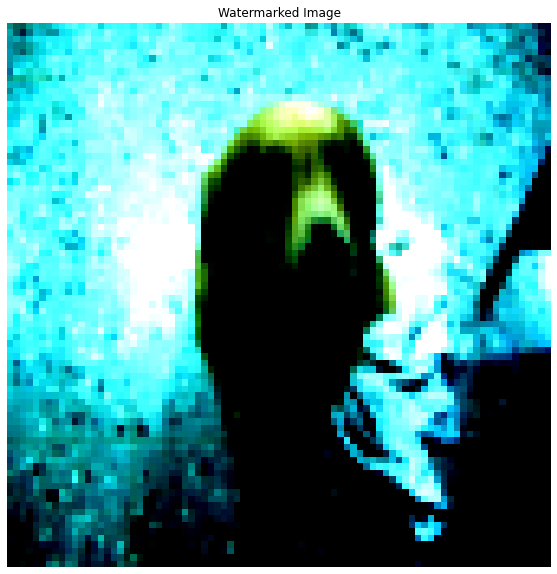

  9%|▉         | 1/11 [00:08<01:21,  8.16s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 20: Target opacity: 0, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: False, Base class predicted: True


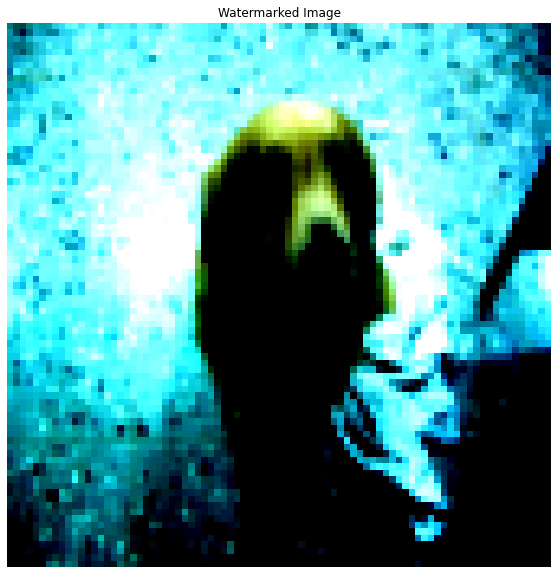

 18%|█▊        | 2/11 [00:16<01:14,  8.26s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 20: Target opacity: 0.05, Labeled correctly: 0.6666666666666666, Correctly Predicted Target: False, Base class predicted: True


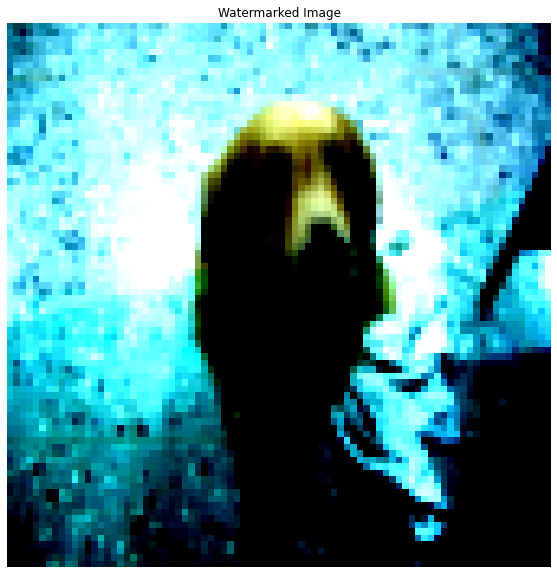

 27%|██▋       | 3/11 [00:24<01:06,  8.32s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 20: Target opacity: 0.1, Labeled correctly: 0.6666666666666666, Correctly Predicted Target: False, Base class predicted: True


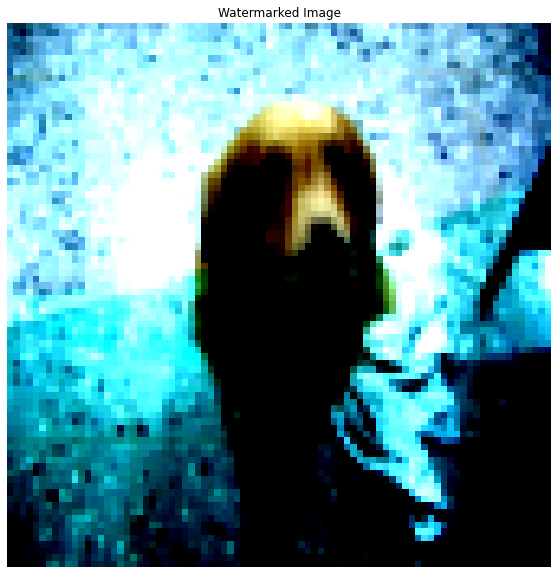

 36%|███▋      | 4/11 [00:33<00:58,  8.31s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 20: Target opacity: 0.15, Labeled correctly: 0.6666666666666666, Correctly Predicted Target: False, Base class predicted: True


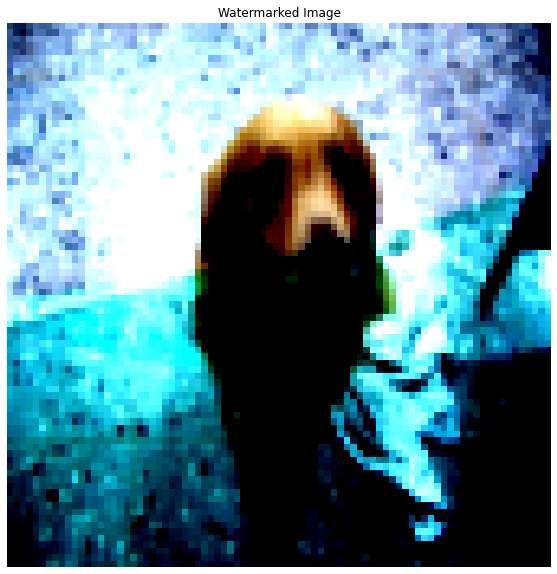

 45%|████▌     | 5/11 [00:41<00:49,  8.24s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 20: Target opacity: 0.2, Labeled correctly: 0.6666666666666666, Correctly Predicted Target: False, Base class predicted: True


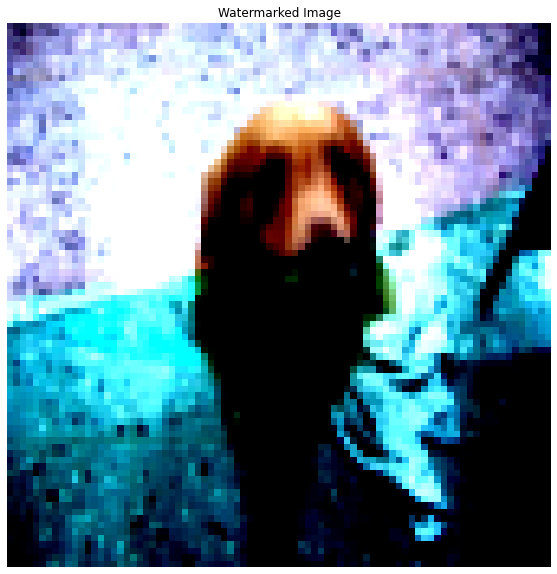

 55%|█████▍    | 6/11 [00:49<00:41,  8.23s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 20: Target opacity: 0.25, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: False, Base class predicted: True


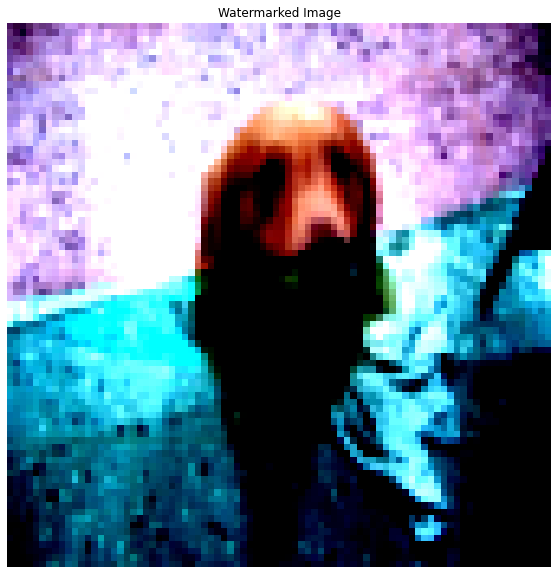

 64%|██████▎   | 7/11 [00:57<00:32,  8.24s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 20: Target opacity: 0.3, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: False, Base class predicted: True


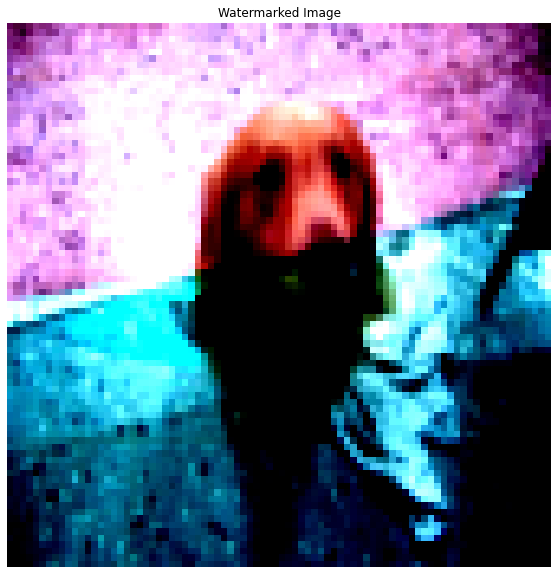

 73%|███████▎  | 8/11 [01:05<00:24,  8.19s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 20: Target opacity: 0.35, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: False, Base class predicted: True


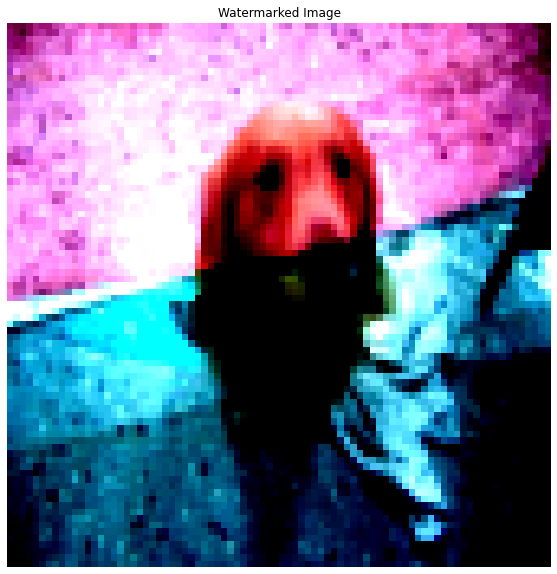

 82%|████████▏ | 9/11 [01:13<00:16,  8.14s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 20: Target opacity: 0.4, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: False, Base class predicted: True


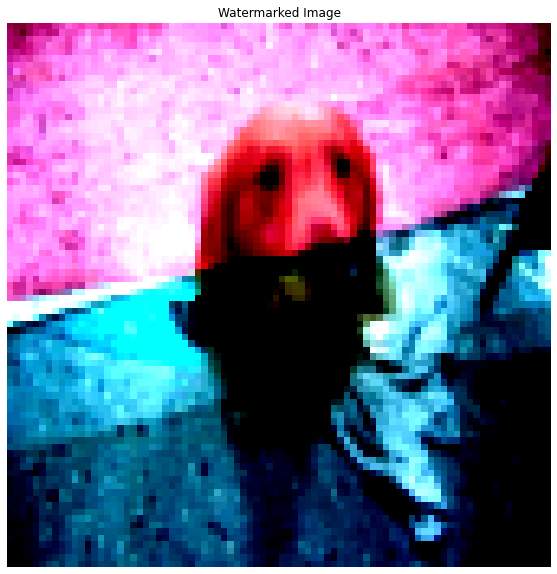

 91%|█████████ | 10/11 [01:21<00:08,  8.11s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 20: Target opacity: 0.45, Labeled correctly: 0.6666666666666666, Correctly Predicted Target: False, Base class predicted: True


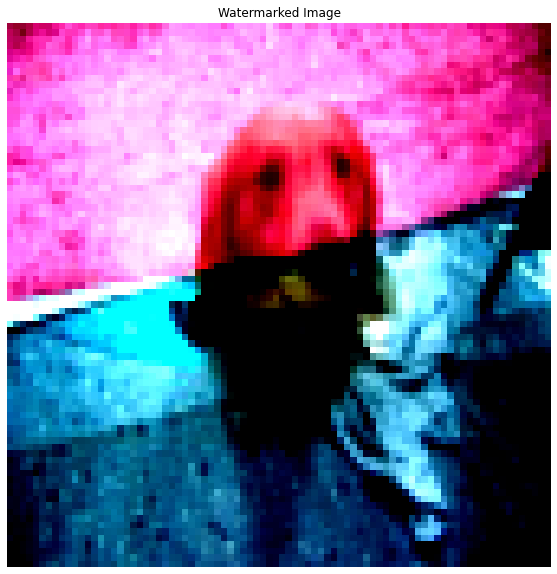

100%|██████████| 11/11 [01:30<00:00,  8.19s/it]

Iteration 20: Target opacity: 0.5, Labeled correctly: 0.6533333333333333, Correctly Predicted Target: False, Base class predicted: True



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


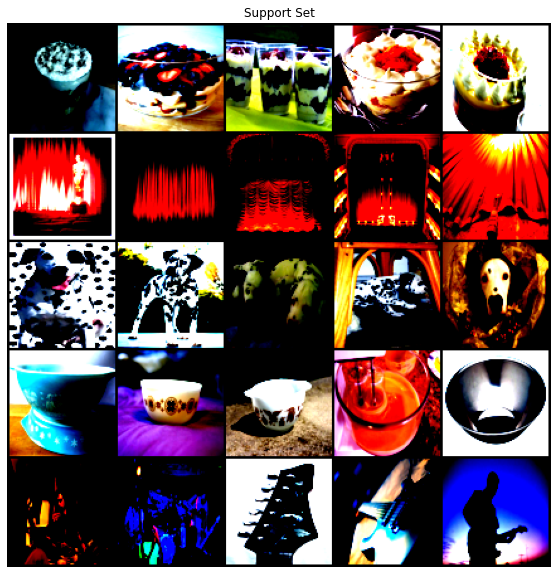

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[4, 4, 4, 4, 4, 1, 1, 1, 1, 1, 2, 2, 2, 2, 2, 0, 0, 0, 0, 0, 3, 3, 3, 3,
         3]])


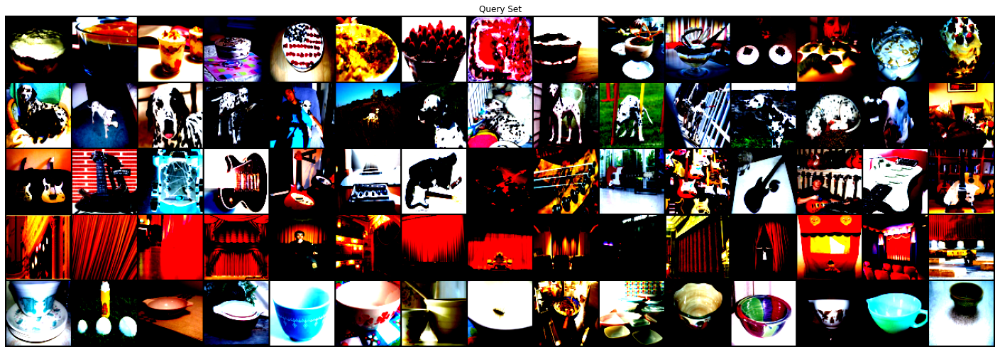

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 2, 2, 2, 2, 2, 2, 2, 2, 2,
         2, 2, 2, 2, 2, 2, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 1, 1, 1,
         1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0,
         0, 0, 0]])
target_class 3
unique_classes [0, 1, 2, 4]
base_class 1
target_indices [30 31 32 33 34 35 36 37 38 39 40 41 42 43 44]
target_index 40
base_indices [5 6 7 8 9]
base_index 7


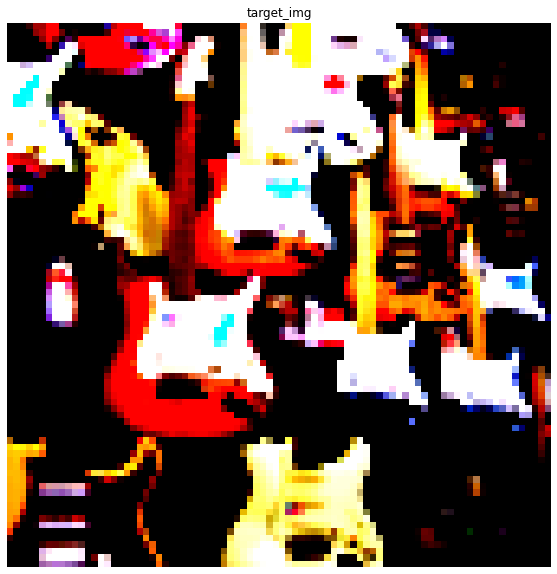

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


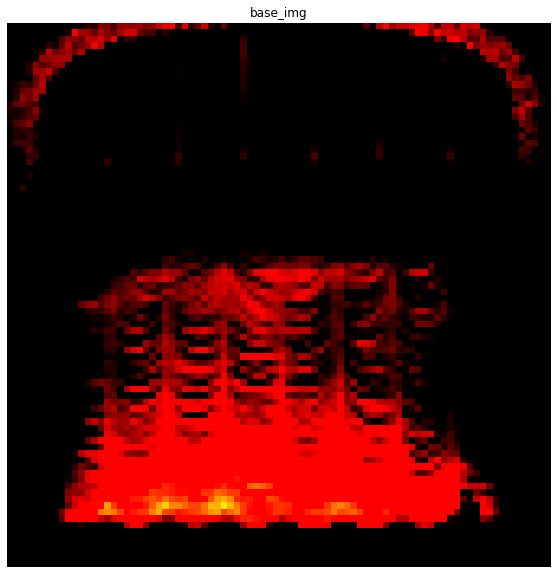

  0%|          | 3/1000 [00:00<00:34, 29.07it/s]

Iteration 0
loss: tensor(8.8415, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(1.2598, grad_fn=<PowBackward0>)
Iteration 2
loss: tensor(0.3835, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(11.9632, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(22.0379, grad_fn=<PowBackward0>)
Iteration 5


  1%|          | 9/1000 [00:00<00:39, 25.31it/s]

loss: tensor(5.7765, grad_fn=<PowBackward0>)
Iteration 6
loss: tensor(25.3204, grad_fn=<PowBackward0>)
Iteration 7
loss: tensor(25.4757, grad_fn=<PowBackward0>)
Iteration 8
loss: tensor(22.3618, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(11.2099, grad_fn=<PowBackward0>)
Iteration 10


  2%|▏         | 15/1000 [00:00<00:37, 26.31it/s]

loss: tensor(18.6242, grad_fn=<PowBackward0>)
Iteration 11
loss: tensor(16.6671, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(30.3732, grad_fn=<PowBackward0>)
Iteration 13
loss: tensor(1.0284, grad_fn=<PowBackward0>)
Iteration 14
loss: tensor(21.0730, grad_fn=<PowBackward0>)
Iteration 15
loss: tensor(4.6193, grad_fn=<PowBackward0>)
Iteration 16


  2%|▏         | 21/1000 [00:00<00:37, 26.12it/s]

loss: tensor(41.2473, grad_fn=<PowBackward0>)
Iteration 17
loss: tensor(8.5205, grad_fn=<PowBackward0>)
Iteration 18
loss: tensor(17.5825, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(7.9263, grad_fn=<PowBackward0>)
Iteration 20
loss: tensor(34.2873, grad_fn=<PowBackward0>)
Iteration 21
loss: tensor(10.1825, grad_fn=<PowBackward0>)


  3%|▎         | 27/1000 [00:01<00:39, 24.94it/s]

Iteration 22
loss: tensor(12.9332, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(22.7730, grad_fn=<PowBackward0>)
Iteration 24
loss: tensor(9.6324, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(16.9795, grad_fn=<PowBackward0>)
Iteration 26
loss: tensor(28.8379, grad_fn=<PowBackward0>)


  3%|▎         | 30/1000 [00:01<00:42, 22.66it/s]

Iteration 27
loss: tensor(0.8854, grad_fn=<PowBackward0>)
Iteration 28
loss: tensor(20.1017, grad_fn=<PowBackward0>)
Iteration 29
loss: tensor(0.1522, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(0.5010, grad_fn=<PowBackward0>)
Iteration 31


  4%|▎         | 36/1000 [00:01<00:41, 23.28it/s]

loss: tensor(27.1512, grad_fn=<PowBackward0>)
Iteration 32
loss: tensor(6.0168, grad_fn=<PowBackward0>)
Iteration 33
loss: tensor(13.9844, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(4.4553, grad_fn=<PowBackward0>)
Iteration 35
loss: tensor(28.5541, grad_fn=<PowBackward0>)
Iteration 36


  4%|▍         | 39/1000 [00:01<00:40, 23.73it/s]

loss: tensor(8.8956, grad_fn=<PowBackward0>)
Iteration 37
loss: tensor(13.7226, grad_fn=<PowBackward0>)
Iteration 38
loss: tensor(1.0921, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(19.4503, grad_fn=<PowBackward0>)
Iteration 40
loss: tensor(4.5682, grad_fn=<PowBackward0>)
Iteration 41
loss: tensor(30.6273, grad_fn=<PowBackward0>)


  4%|▍         | 45/1000 [00:01<00:38, 24.76it/s]

Iteration 42
loss: tensor(9.7638, grad_fn=<PowBackward0>)
Iteration 43
loss: tensor(29.9852, grad_fn=<PowBackward0>)
Iteration 44
loss: tensor(10.0635, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(18.7153, grad_fn=<PowBackward0>)
Iteration 46
loss: tensor(7.5817, grad_fn=<PowBackward0>)
Iteration 47


  5%|▌         | 51/1000 [00:02<00:37, 25.21it/s]

loss: tensor(18.6304, grad_fn=<PowBackward0>)
Iteration 48
loss: tensor(15.2517, grad_fn=<PowBackward0>)
Iteration 49
loss: tensor(10.7731, grad_fn=<PowBackward0>)
Iteration 50
loss: tensor(1.1134, grad_fn=<PowBackward0>)
Iteration 51
loss: tensor(2.8853, grad_fn=<PowBackward0>)
Iteration 52
loss: tensor(21.0903, grad_fn=<PowBackward0>)


  6%|▌         | 57/1000 [00:02<00:35, 26.25it/s]

Iteration 53
loss: tensor(11.0501, grad_fn=<PowBackward0>)
Iteration 54
loss: tensor(17.7142, grad_fn=<PowBackward0>)
Iteration 55
loss: tensor(8.8664, grad_fn=<PowBackward0>)
Iteration 56
loss: tensor(28.8088, grad_fn=<PowBackward0>)
Iteration 57
loss: tensor(9.1098, grad_fn=<PowBackward0>)
Iteration 58


  6%|▋         | 63/1000 [00:02<00:36, 25.37it/s]

loss: tensor(16.6990, grad_fn=<PowBackward0>)
Iteration 59
loss: tensor(15.2487, grad_fn=<PowBackward0>)
Iteration 60
loss: tensor(54.8143, grad_fn=<PowBackward0>)
Iteration 61
loss: tensor(5.5794, grad_fn=<PowBackward0>)
Iteration 62
loss: tensor(25.1796, grad_fn=<PowBackward0>)
Iteration 63


  7%|▋         | 66/1000 [00:02<00:36, 25.46it/s]

loss: tensor(7.1422, grad_fn=<PowBackward0>)
Iteration 64
loss: tensor(28.3595, grad_fn=<PowBackward0>)
Iteration 65
loss: tensor(17.7129, grad_fn=<PowBackward0>)
Iteration 66
loss: tensor(14.1057, grad_fn=<PowBackward0>)
Iteration 67
loss: tensor(2.3932, grad_fn=<PowBackward0>)
Iteration 68
loss: tensor(33.3296, grad_fn=<PowBackward0>)


  7%|▋         | 72/1000 [00:02<00:36, 25.38it/s]

Iteration 69
loss: tensor(1.0955, grad_fn=<PowBackward0>)
Iteration 70
loss: tensor(8.8076, grad_fn=<PowBackward0>)
Iteration 71
loss: tensor(7.2533, grad_fn=<PowBackward0>)
Iteration 72
loss: tensor(31.7457, grad_fn=<PowBackward0>)
Iteration 73
loss: tensor(3.7839, grad_fn=<PowBackward0>)
Iteration 74
loss:

  8%|▊         | 78/1000 [00:03<00:35, 25.73it/s]

 tensor(28.6702, grad_fn=<PowBackward0>)
Iteration 75
loss: tensor(8.8635, grad_fn=<PowBackward0>)
Iteration 76
loss: tensor(21.8080, grad_fn=<PowBackward0>)
Iteration 77
loss: tensor(10.1063, grad_fn=<PowBackward0>)
Iteration 78
loss: tensor(28.7227, grad_fn=<PowBackward0>)
Iteration 79
loss: tensor(1.3459, grad_fn=<PowBackward0>)


  8%|▊         | 84/1000 [00:03<00:37, 24.45it/s]

Iteration 80
loss: tensor(5.8844, grad_fn=<PowBackward0>)
Iteration 81
loss: tensor(11.1058, grad_fn=<PowBackward0>)
Iteration 82
loss: tensor(30.5203, grad_fn=<PowBackward0>)
Iteration 83
loss: tensor(3.4692, grad_fn=<PowBackward0>)
Iteration 84
loss: tensor(18.5582, grad_fn=<PowBackward0>)


  9%|▊         | 87/1000 [00:03<00:38, 23.87it/s]

Iteration 85
loss: tensor(18.5765, grad_fn=<PowBackward0>)
Iteration 86
loss: tensor(23.7151, grad_fn=<PowBackward0>)
Iteration 87
loss: tensor(3.8977, grad_fn=<PowBackward0>)
Iteration 88
loss: tensor(20.5397, grad_fn=<PowBackward0>)
Iteration 89
loss: tensor(4.9210, grad_fn=<PowBackward0>)


  9%|▉         | 93/1000 [00:03<00:38, 23.83it/s]

Iteration 90
loss: tensor(19.7399, grad_fn=<PowBackward0>)
Iteration 91
loss: tensor(0.3527, grad_fn=<PowBackward0>)
Iteration 92
loss: tensor(1.1301, grad_fn=<PowBackward0>)
Iteration 93
loss: tensor(18.1706, grad_fn=<PowBackward0>)
Iteration 94
loss: tensor(35.5310, grad_fn=<PowBackward0>)
Iteration 95


 10%|▉         | 99/1000 [00:04<00:37, 24.30it/s]

loss: tensor(7.0916, grad_fn=<PowBackward0>)
Iteration 96
loss: tensor(18.7022, grad_fn=<PowBackward0>)
Iteration 97
loss: tensor(0.5725, grad_fn=<PowBackward0>)
Iteration 98
loss: tensor(4.3530, grad_fn=<PowBackward0>)
Iteration 99
loss: tensor(9.9659, grad_fn=<PowBackward0>)
Iteration 100


 10%|█         | 105/1000 [00:04<00:37, 24.13it/s]

loss: tensor(44.6063, grad_fn=<PowBackward0>)
Iteration 101
loss: tensor(0.2993, grad_fn=<PowBackward0>)
Iteration 102
loss: tensor(2.2633, grad_fn=<PowBackward0>)
Iteration 103
loss: tensor(15.4040, grad_fn=<PowBackward0>)
Iteration 104
loss: tensor(2.2345, grad_fn=<PowBackward0>)
Iteration 105


 11%|█         | 108/1000 [00:04<00:37, 23.58it/s]

loss: tensor(30.5947, grad_fn=<PowBackward0>)
Iteration 106
loss: tensor(11.7086, grad_fn=<PowBackward0>)
Iteration 107
loss: tensor(25.9146, grad_fn=<PowBackward0>)
Iteration 108
loss: tensor(13.2602, grad_fn=<PowBackward0>)
Iteration 109
loss: tensor(22.6787, grad_fn=<PowBackward0>)


 11%|█▏        | 114/1000 [00:04<00:37, 23.78it/s]

Iteration 110
loss: tensor(13.4635, grad_fn=<PowBackward0>)
Iteration 111
loss: tensor(23.7844, grad_fn=<PowBackward0>)
Iteration 112
loss: tensor(8.2768, grad_fn=<PowBackward0>)
Iteration 113
loss: tensor(13.8674, grad_fn=<PowBackward0>)
Iteration 114
loss: tensor(12.2443, grad_fn=<PowBackward0>)
Iteration 115


 12%|█▏        | 120/1000 [00:04<00:36, 24.18it/s]

loss: tensor(53.4504, grad_fn=<PowBackward0>)
Iteration 116
loss: tensor(2.4317, grad_fn=<PowBackward0>)
Iteration 117
loss: tensor(15.7567, grad_fn=<PowBackward0>)
Iteration 118
loss: tensor(14.8664, grad_fn=<PowBackward0>)
Iteration 119
loss: tensor(32.5634, grad_fn=<PowBackward0>)
Iteration 120
loss:

 12%|█▏        | 123/1000 [00:05<00:36, 24.31it/s]

 tensor(14.7092, grad_fn=<PowBackward0>)
Iteration 121
loss: tensor(21.5998, grad_fn=<PowBackward0>)
Iteration 122
loss: tensor(4.7972, grad_fn=<PowBackward0>)
Iteration 123
loss: tensor(36.5394, grad_fn=<PowBackward0>)
Iteration 124
loss: tensor(11.4784, grad_fn=<PowBackward0>)
Iteration 125
loss: tensor(27.9833, grad_fn=<PowBackward0>)


 13%|█▎        | 129/1000 [00:05<00:35, 24.38it/s]

Iteration 126
loss: tensor(23.3484, grad_fn=<PowBackward0>)
Iteration 127
loss: tensor(22.5467, grad_fn=<PowBackward0>)
Iteration 128
loss: tensor(6.5512, grad_fn=<PowBackward0>)
Iteration 129
loss: tensor(34.1292, grad_fn=<PowBackward0>)
Iteration 130
loss: tensor(9.5783, grad_fn=<PowBackward0>)


 14%|█▎        | 135/1000 [00:05<00:37, 23.15it/s]

Iteration 131
loss: tensor(12.7339, grad_fn=<PowBackward0>)
Iteration 132
loss: tensor(16.1078, grad_fn=<PowBackward0>)
Iteration 133
loss: tensor(32.3050, grad_fn=<PowBackward0>)
Iteration 134
loss: tensor(31.3959, grad_fn=<PowBackward0>)
Iteration 135
loss: tensor(39.9268, grad_fn=<PowBackward0>)


 14%|█▍        | 138/1000 [00:05<00:36, 23.41it/s]

Iteration 136
loss: tensor(0.6657, grad_fn=<PowBackward0>)
Iteration 137
loss: tensor(10.0701, grad_fn=<PowBackward0>)
Iteration 138
loss: tensor(4.2274, grad_fn=<PowBackward0>)
Iteration 139
loss: tensor(14.6406, grad_fn=<PowBackward0>)
Iteration 140
loss: tensor(16.4750, grad_fn=<PowBackward0>)


 14%|█▍        | 144/1000 [00:05<00:36, 23.52it/s]

Iteration 141
loss: tensor(28.7531, grad_fn=<PowBackward0>)
Iteration 142
loss: tensor(7.6527, grad_fn=<PowBackward0>)
Iteration 143
loss: tensor(20.9557, grad_fn=<PowBackward0>)
Iteration 144
loss: tensor(12.2568, grad_fn=<PowBackward0>)
Iteration 145
loss: tensor(37.4225, grad_fn=<PowBackward0>)
Iteration 146


 15%|█▌        | 150/1000 [00:06<00:36, 23.47it/s]

loss: tensor(9.2448, grad_fn=<PowBackward0>)
Iteration 147
loss: tensor(15.4260, grad_fn=<PowBackward0>)
Iteration 148
loss: tensor(2.1419, grad_fn=<PowBackward0>)
Iteration 149
loss: tensor(10.9864, grad_fn=<PowBackward0>)
Iteration 150
loss: tensor(17.1623, grad_fn=<PowBackward0>)
Iteration 151


 16%|█▌        | 156/1000 [00:06<00:35, 23.69it/s]

loss: tensor(17.7451, grad_fn=<PowBackward0>)
Iteration 152
loss: tensor(8.9997, grad_fn=<PowBackward0>)
Iteration 153
loss: tensor(15.8802, grad_fn=<PowBackward0>)
Iteration 154
loss: tensor(22.7280, grad_fn=<PowBackward0>)
Iteration 155
loss: tensor(30.4091, grad_fn=<PowBackward0>)
Iteration 156


 16%|█▌        | 159/1000 [00:06<00:36, 23.07it/s]

loss: tensor(27.4435, grad_fn=<PowBackward0>)
Iteration 157
loss: tensor(34.9484, grad_fn=<PowBackward0>)
Iteration 158
loss: tensor(28.4362, grad_fn=<PowBackward0>)
Iteration 159
loss: tensor(11.8379, grad_fn=<PowBackward0>)
Iteration 160
loss: tensor(38.8385, grad_fn=<PowBackward0>)
Iteration 161


 16%|█▋        | 165/1000 [00:06<00:34, 24.26it/s]

loss: tensor(25.4727, grad_fn=<PowBackward0>)
Iteration 162
loss: tensor(2.1777, grad_fn=<PowBackward0>)
Iteration 163
loss: tensor(16.2284, grad_fn=<PowBackward0>)
Iteration 164
loss: tensor(17.5300, grad_fn=<PowBackward0>)
Iteration 165
loss: tensor(21.9490, grad_fn=<PowBackward0>)
Iteration 166
loss: tensor(9.5779, grad_fn=<PowBackward0>)


 17%|█▋        | 171/1000 [00:07<00:33, 24.84it/s]

Iteration 167
loss: tensor(34.3735, grad_fn=<PowBackward0>)
Iteration 168
loss: tensor(1.7490, grad_fn=<PowBackward0>)
Iteration 169
loss: tensor(16.7525, grad_fn=<PowBackward0>)
Iteration 170
loss: tensor(2.0314, grad_fn=<PowBackward0>)
Iteration 171
loss: tensor(32.4926, grad_fn=<PowBackward0>)
Iteration 172


 18%|█▊        | 177/1000 [00:07<00:33, 24.51it/s]

loss: tensor(11.6965, grad_fn=<PowBackward0>)
Iteration 173
loss: tensor(13.9694, grad_fn=<PowBackward0>)
Iteration 174
loss: tensor(30.2131, grad_fn=<PowBackward0>)
Iteration 175
loss: tensor(20.6898, grad_fn=<PowBackward0>)
Iteration 176
loss: tensor(10.1070, grad_fn=<PowBackward0>)
Iteration 177


 18%|█▊        | 180/1000 [00:07<00:33, 24.13it/s]

loss: tensor(32.3741, grad_fn=<PowBackward0>)
Iteration 178
loss: tensor(14.7321, grad_fn=<PowBackward0>)
Iteration 179
loss: tensor(9.2472, grad_fn=<PowBackward0>)
Iteration 180
loss: tensor(11.0636, grad_fn=<PowBackward0>)
Iteration 181
loss: tensor(26.3464, grad_fn=<PowBackward0>)
Iteration 182


 19%|█▊        | 186/1000 [00:07<00:33, 24.29it/s]

loss: tensor(21.9245, grad_fn=<PowBackward0>)
Iteration 183
loss: tensor(10.5450, grad_fn=<PowBackward0>)
Iteration 184
loss: tensor(8.4652, grad_fn=<PowBackward0>)
Iteration 185
loss: tensor(23.1711, grad_fn=<PowBackward0>)
Iteration 186
loss: tensor(3.5842, grad_fn=<PowBackward0>)
Iteration 187
loss: tensor(26.7414, grad_fn=<PowBackward0>)


 19%|█▉        | 192/1000 [00:07<00:32, 24.87it/s]

Iteration 188
loss: tensor(9.1087, grad_fn=<PowBackward0>)
Iteration 189
loss: tensor(26.8483, grad_fn=<PowBackward0>)
Iteration 190
loss: tensor(17.4138, grad_fn=<PowBackward0>)
Iteration 191
loss: tensor(16.3674, grad_fn=<PowBackward0>)
Iteration 192
loss: tensor(15.1262, grad_fn=<PowBackward0>)
Iteration 193


 20%|█▉        | 198/1000 [00:08<00:33, 24.01it/s]

loss: tensor(43.3353, grad_fn=<PowBackward0>)
Iteration 194
loss: tensor(4.8576, grad_fn=<PowBackward0>)
Iteration 195
loss: tensor(24.3118, grad_fn=<PowBackward0>)
Iteration 196
loss: tensor(27.4375, grad_fn=<PowBackward0>)
Iteration 197
loss: tensor(19.9081, grad_fn=<PowBackward0>)
Iteration 198


 20%|██        | 201/1000 [00:08<00:33, 23.79it/s]

loss: tensor(7.1343, grad_fn=<PowBackward0>)
Iteration 199
loss: tensor(34.0828, grad_fn=<PowBackward0>)
Iteration 200
loss: tensor(5.9576, grad_fn=<PowBackward0>)
Iteration 201
loss: tensor(19.8432, grad_fn=<PowBackward0>)
Iteration 202
loss: tensor(8.0380, grad_fn=<PowBackward0>)
Iteration 203
loss: 

 21%|██        | 207/1000 [00:08<00:33, 23.75it/s]

tensor(23.2719, grad_fn=<PowBackward0>)
Iteration 204
loss: tensor(14.7697, grad_fn=<PowBackward0>)
Iteration 205
loss: tensor(17.7418, grad_fn=<PowBackward0>)
Iteration 206
loss: tensor(10.1473, grad_fn=<PowBackward0>)
Iteration 207
loss: tensor(18.1115, grad_fn=<PowBackward0>)
Iteration 208


 21%|██▏       | 213/1000 [00:08<00:33, 23.38it/s]

loss: tensor(8.7713, grad_fn=<PowBackward0>)
Iteration 209
loss: tensor(16.4718, grad_fn=<PowBackward0>)
Iteration 210
loss: tensor(4.4494, grad_fn=<PowBackward0>)
Iteration 211
loss: tensor(14.2650, grad_fn=<PowBackward0>)
Iteration 212
loss: tensor(1.5382, grad_fn=<PowBackward0>)


 22%|██▏       | 216/1000 [00:08<00:32, 24.20it/s]

Iteration 213
loss: tensor(11.3608, grad_fn=<PowBackward0>)
Iteration 214
loss: tensor(15.8538, grad_fn=<PowBackward0>)
Iteration 215
loss: tensor(21.5086, grad_fn=<PowBackward0>)
Iteration 216
loss: tensor(8.0759, grad_fn=<PowBackward0>)
Iteration 217
loss: tensor(19.1243, grad_fn=<PowBackward0>)
Iteration 218
loss: tensor(10.3936, grad_fn=<PowBackward0>)


 22%|██▏       | 222/1000 [00:09<00:30, 25.63it/s]

Iteration 219
loss: tensor(11.8854, grad_fn=<PowBackward0>)
Iteration 220
loss: tensor(18.3263, grad_fn=<PowBackward0>)
Iteration 221
loss: tensor(24.7426, grad_fn=<PowBackward0>)
Iteration 222
loss: tensor(17.0233, grad_fn=<PowBackward0>)
Iteration 223
loss: tensor(27.9998, grad_fn=<PowBackward0>)
Iteration 224
loss: 

 23%|██▎       | 228/1000 [00:09<00:30, 25.17it/s]

tensor(8.3458, grad_fn=<PowBackward0>)
Iteration 225
loss: tensor(9.5314, grad_fn=<PowBackward0>)
Iteration 226
loss: tensor(11.2364, grad_fn=<PowBackward0>)
Iteration 227
loss: tensor(17.0249, grad_fn=<PowBackward0>)
Iteration 228
loss: tensor(33.8207, grad_fn=<PowBackward0>)
Iteration 229


 23%|██▎       | 234/1000 [00:09<00:31, 24.23it/s]

loss: tensor(6.5205, grad_fn=<PowBackward0>)
Iteration 230
loss: tensor(10.9543, grad_fn=<PowBackward0>)
Iteration 231
loss: tensor(14.9620, grad_fn=<PowBackward0>)
Iteration 232
loss: tensor(11.1091, grad_fn=<PowBackward0>)
Iteration 233
loss: tensor(14.7797, grad_fn=<PowBackward0>)
Iteration 234


 24%|██▎       | 237/1000 [00:09<00:30, 24.84it/s]

loss: tensor(10.0430, grad_fn=<PowBackward0>)
Iteration 235
loss: tensor(14.8784, grad_fn=<PowBackward0>)
Iteration 236
loss: tensor(8.2015, grad_fn=<PowBackward0>)
Iteration 237
loss: tensor(23.2460, grad_fn=<PowBackward0>)
Iteration 238
loss: tensor(21.2405, grad_fn=<PowBackward0>)
Iteration 239


 24%|██▍       | 243/1000 [00:10<00:30, 24.49it/s]

loss: tensor(46.2035, grad_fn=<PowBackward0>)
Iteration 240
loss: tensor(30.9844, grad_fn=<PowBackward0>)
Iteration 241
loss: tensor(10.7134, grad_fn=<PowBackward0>)
Iteration 242
loss: tensor(11.3575, grad_fn=<PowBackward0>)
Iteration 243
loss: tensor(12.6446, grad_fn=<PowBackward0>)
Iteration 244
loss: tensor(22.4037, grad_fn=<PowBackward0>)


 25%|██▍       | 249/1000 [00:10<00:29, 25.10it/s]

Iteration 245
loss: tensor(20.7662, grad_fn=<PowBackward0>)
Iteration 246
loss: tensor(8.5352, grad_fn=<PowBackward0>)
Iteration 247
loss: tensor(8.4599, grad_fn=<PowBackward0>)
Iteration 248
loss: tensor(21.1991, grad_fn=<PowBackward0>)
Iteration 249
loss: tensor(20.3210, grad_fn=<PowBackward0>)
Iteration 250


 26%|██▌       | 255/1000 [00:10<00:29, 25.06it/s]

loss: tensor(13.9149, grad_fn=<PowBackward0>)
Iteration 251
loss: tensor(17.7345, grad_fn=<PowBackward0>)
Iteration 252
loss: tensor(5.5093, grad_fn=<PowBackward0>)
Iteration 253
loss: tensor(16.8231, grad_fn=<PowBackward0>)
Iteration 254
loss: tensor(10.9487, grad_fn=<PowBackward0>)
Iteration 255
loss: tensor(20.8420, grad_fn=<PowBackward0>)


 26%|██▌       | 258/1000 [00:10<00:31, 23.70it/s]

Iteration 256
loss: tensor(16.3028, grad_fn=<PowBackward0>)
Iteration 257
loss: tensor(22.7220, grad_fn=<PowBackward0>)
Iteration 258
loss: tensor(7.1627, grad_fn=<PowBackward0>)
Iteration 259
loss: tensor(5.7902, grad_fn=<PowBackward0>)
Iteration 260
loss: tensor(14.6962, grad_fn=<PowBackward0>)


 26%|██▋       | 264/1000 [00:10<00:29, 25.06it/s]

Iteration 261
loss: tensor(41.3379, grad_fn=<PowBackward0>)
Iteration 262
loss: tensor(11.5491, grad_fn=<PowBackward0>)
Iteration 263
loss: tensor(10.6862, grad_fn=<PowBackward0>)
Iteration 264
loss: tensor(17.3785, grad_fn=<PowBackward0>)
Iteration 265
loss: tensor(9.2615, grad_fn=<PowBackward0>)
Iteration 266
loss: tensor(14.4835, grad_fn=<PowBackward0>)


 27%|██▋       | 270/1000 [00:11<00:29, 25.16it/s]

Iteration 267
loss: tensor(13.3754, grad_fn=<PowBackward0>)
Iteration 268
loss: tensor(10.7996, grad_fn=<PowBackward0>)
Iteration 269
loss: tensor(10.1229, grad_fn=<PowBackward0>)
Iteration 270
loss: tensor(14.7658, grad_fn=<PowBackward0>)
Iteration 271
loss: tensor(30.0785, grad_fn=<PowBackward0>)
Iteration 272


 28%|██▊       | 276/1000 [00:11<00:31, 23.16it/s]

loss: tensor(10.9987, grad_fn=<PowBackward0>)
Iteration 273
loss: tensor(9.6332, grad_fn=<PowBackward0>)
Iteration 274
loss: tensor(7.4370, grad_fn=<PowBackward0>)
Iteration 275
loss: tensor(18.7207, grad_fn=<PowBackward0>)
Iteration 276
loss:

 28%|██▊       | 279/1000 [00:11<00:30, 23.58it/s]

 tensor(20.6834, grad_fn=<PowBackward0>)
Iteration 277
loss: tensor(16.5710, grad_fn=<PowBackward0>)
Iteration 278
loss: tensor(16.7823, grad_fn=<PowBackward0>)
Iteration 279
loss: tensor(17.9657, grad_fn=<PowBackward0>)
Iteration 280
loss: tensor(24.4473, grad_fn=<PowBackward0>)
Iteration 281
loss: tensor(9.1490, grad_fn=<PowBackward0>)


 28%|██▊       | 285/1000 [00:11<00:29, 23.97it/s]

Iteration 282
loss: tensor(8.9660, grad_fn=<PowBackward0>)
Iteration 283
loss: tensor(18.2609, grad_fn=<PowBackward0>)
Iteration 284
loss: tensor(17.6890, grad_fn=<PowBackward0>)
Iteration 285
loss: tensor(16.5016, grad_fn=<PowBackward0>)
Iteration 286
loss: tensor(6.9667, grad_fn=<PowBackward0>)
Iteration 287


 29%|██▉       | 291/1000 [00:11<00:29, 24.44it/s]

loss: tensor(17.6742, grad_fn=<PowBackward0>)
Iteration 288
loss: tensor(9.8258, grad_fn=<PowBackward0>)
Iteration 289
loss: tensor(12.0246, grad_fn=<PowBackward0>)
Iteration 290
loss: tensor(7.0828, grad_fn=<PowBackward0>)
Iteration 291
loss: tensor(17.6604, grad_fn=<PowBackward0>)
Iteration 292
loss: tensor(8.4080, grad_fn=<PowBackward0>)


 30%|██▉       | 297/1000 [00:12<00:27, 25.48it/s]

Iteration 293
loss: tensor(13.7871, grad_fn=<PowBackward0>)
Iteration 294
loss: tensor(15.2577, grad_fn=<PowBackward0>)
Iteration 295
loss: tensor(15.1410, grad_fn=<PowBackward0>)
Iteration 296
loss: tensor(7.7138, grad_fn=<PowBackward0>)
Iteration 297
loss: tensor(18.6915, grad_fn=<PowBackward0>)
Iteration 298


 30%|███       | 303/1000 [00:12<00:27, 25.17it/s]

loss: tensor(6.4665, grad_fn=<PowBackward0>)
Iteration 299
loss: tensor(13.8711, grad_fn=<PowBackward0>)
Iteration 300
loss: tensor(12.1737, grad_fn=<PowBackward0>)
Iteration 301
loss: tensor(42.0152, grad_fn=<PowBackward0>)
Iteration 302
loss: tensor(6.2684, grad_fn=<PowBackward0>)
Iteration 303


 31%|███       | 306/1000 [00:12<00:27, 24.99it/s]

loss: tensor(8.1616, grad_fn=<PowBackward0>)
Iteration 304
loss: tensor(5.1608, grad_fn=<PowBackward0>)
Iteration 305
loss: tensor(9.5833, grad_fn=<PowBackward0>)
Iteration 306
loss: tensor(6.5385, grad_fn=<PowBackward0>)
Iteration 307
loss: tensor(13.6247, grad_fn=<PowBackward0>)
Iteration 308
loss: tensor(2.8040, grad_fn=<PowBackward0>)


 31%|███       | 312/1000 [00:12<00:28, 24.07it/s]

Iteration 309
loss: tensor(9.4096, grad_fn=<PowBackward0>)
Iteration 310
loss: tensor(4.1489, grad_fn=<PowBackward0>)
Iteration 311
loss: tensor(7.8296, grad_fn=<PowBackward0>)
Iteration 312
loss: tensor(10.8048, grad_fn=<PowBackward0>)
Iteration 313
loss: tensor(12.1909, grad_fn=<PowBackward0>)


 32%|███▏      | 318/1000 [00:13<00:27, 25.11it/s]

Iteration 314
loss: tensor(4.5111, grad_fn=<PowBackward0>)
Iteration 315
loss: tensor(5.5757, grad_fn=<PowBackward0>)
Iteration 316
loss: tensor(10.1116, grad_fn=<PowBackward0>)
Iteration 317
loss: tensor(16.8320, grad_fn=<PowBackward0>)
Iteration 318
loss: tensor(4.1530, grad_fn=<PowBackward0>)
Iteration 319
loss: tensor(7.1286, grad_fn=<PowBackward0>)


 32%|███▏      | 324/1000 [00:13<00:26, 25.32it/s]

Iteration 320
loss: tensor(9.0066, grad_fn=<PowBackward0>)
Iteration 321
loss: tensor(6.1569, grad_fn=<PowBackward0>)
Iteration 322
loss: tensor(3.2968, grad_fn=<PowBackward0>)
Iteration 323
loss: tensor(4.3882, grad_fn=<PowBackward0>)
Iteration 324
loss: tensor(3.8465, grad_fn=<PowBackward0>)
Iteration 325


 33%|███▎      | 330/1000 [00:13<00:25, 25.88it/s]

loss: tensor(6.1510, grad_fn=<PowBackward0>)
Iteration 326
loss: tensor(3.6250, grad_fn=<PowBackward0>)
Iteration 327
loss: tensor(10.1356, grad_fn=<PowBackward0>)
Iteration 328
loss: tensor(6.3345, grad_fn=<PowBackward0>)
Iteration 329
loss: tensor(8.2263, grad_fn=<PowBackward0>)
Iteration 330
loss: tensor(5.1856, grad_fn=<PowBackward0>)


 33%|███▎      | 333/1000 [00:13<00:25, 25.93it/s]

Iteration 331
loss: tensor(3.1813, grad_fn=<PowBackward0>)
Iteration 332
loss: tensor(7.8207, grad_fn=<PowBackward0>)
Iteration 333
loss: tensor(10.4640, grad_fn=<PowBackward0>)
Iteration 334
loss: tensor(4.2725, grad_fn=<PowBackward0>)
Iteration 335
loss: tensor(10.4503, grad_fn=<PowBackward0>)


 34%|███▍      | 339/1000 [00:13<00:26, 24.82it/s]

Iteration 336
loss: tensor(8.4524, grad_fn=<PowBackward0>)
Iteration 337
loss: tensor(7.9008, grad_fn=<PowBackward0>)
Iteration 338
loss: tensor(6.4689, grad_fn=<PowBackward0>)
Iteration 339
loss: tensor(6.7360, grad_fn=<PowBackward0>)
Iteration 340
loss: tensor(4.8773, grad_fn=<PowBackward0>)
Iteration 341
loss: tensor(6.0761, grad_fn=<PowBackward0>)

 34%|███▍      | 345/1000 [00:14<00:25, 25.34it/s]


Iteration 342
loss: tensor(6.0059, grad_fn=<PowBackward0>)
Iteration 343
loss: tensor(5.6978, grad_fn=<PowBackward0>)
Iteration 344
loss: tensor(6.8657, grad_fn=<PowBackward0>)
Iteration 345
loss: tensor(4.8220, grad_fn=<PowBackward0>)
Iteration 346
loss: tensor(8.7567, grad_fn=<PowBackward0>)


 35%|███▌      | 351/1000 [00:14<00:25, 25.80it/s]

Iteration 347
loss: tensor(3.6601, grad_fn=<PowBackward0>)
Iteration 348
loss: tensor(8.6810, grad_fn=<PowBackward0>)
Iteration 349
loss: tensor(12.2997, grad_fn=<PowBackward0>)
Iteration 350
loss: tensor(9.0719, grad_fn=<PowBackward0>)
Iteration 351
loss: tensor(5.9805, grad_fn=<PowBackward0>)
Iteration 352


 36%|███▌      | 357/1000 [00:14<00:24, 25.95it/s]

loss: tensor(3.9045, grad_fn=<PowBackward0>)
Iteration 353
loss: tensor(5.1825, grad_fn=<PowBackward0>)
Iteration 354
loss: tensor(3.2188, grad_fn=<PowBackward0>)
Iteration 355
loss: tensor(4.5139, grad_fn=<PowBackward0>)
Iteration 356
loss: tensor(8.0679, grad_fn=<PowBackward0>)
Iteration 357
loss: tensor(15.7922, grad_fn=<PowBackward0>)


 36%|███▋      | 363/1000 [00:14<00:25, 25.40it/s]

Iteration 358
loss: tensor(15.5898, grad_fn=<PowBackward0>)
Iteration 359
loss: tensor(9.8086, grad_fn=<PowBackward0>)
Iteration 360
loss: tensor(6.9327, grad_fn=<PowBackward0>)
Iteration 361
loss: tensor(5.4723, grad_fn=<PowBackward0>)
Iteration 362
loss: tensor(5.7050, grad_fn=<PowBackward0>)


 37%|███▋      | 366/1000 [00:14<00:25, 25.02it/s]

Iteration 363
loss: tensor(5.1235, grad_fn=<PowBackward0>)
Iteration 364
loss: tensor(3.8435, grad_fn=<PowBackward0>)
Iteration 365
loss: tensor(10.0736, grad_fn=<PowBackward0>)
Iteration 366
loss: tensor(7.7236, grad_fn=<PowBackward0>)
Iteration 367
loss: tensor(19.5808, grad_fn=<PowBackward0>)


 37%|███▋      | 372/1000 [00:15<00:25, 24.55it/s]

Iteration 368
loss: tensor(11.1543, grad_fn=<PowBackward0>)
Iteration 369
loss: tensor(7.7333, grad_fn=<PowBackward0>)
Iteration 370
loss: tensor(5.6697, grad_fn=<PowBackward0>)
Iteration 371
loss: tensor(6.0719, grad_fn=<PowBackward0>)
Iteration 372
loss: tensor(2.5025, grad_fn=<PowBackward0>)


 38%|███▊      | 378/1000 [00:15<00:25, 24.36it/s]

Iteration 373
loss: tensor(4.0508, grad_fn=<PowBackward0>)
Iteration 374
loss: tensor(5.5306, grad_fn=<PowBackward0>)
Iteration 375
loss: tensor(11.0583, grad_fn=<PowBackward0>)
Iteration 376
loss: tensor(12.1413, grad_fn=<PowBackward0>)
Iteration 377
loss: tensor(14.8369, grad_fn=<PowBackward0>)


 38%|███▊      | 381/1000 [00:15<00:25, 24.28it/s]

Iteration 378
loss: tensor(11.2822, grad_fn=<PowBackward0>)
Iteration 379
loss: tensor(7.3756, grad_fn=<PowBackward0>)
Iteration 380
loss: tensor(4.0147, grad_fn=<PowBackward0>)
Iteration 381
loss: tensor(3.4753, grad_fn=<PowBackward0>)
Iteration 382
loss: tensor(3.6468, grad_fn=<PowBackward0>)
Iteration 383


 39%|███▊      | 387/1000 [00:15<00:25, 24.28it/s]

loss: tensor(8.2780, grad_fn=<PowBackward0>)
Iteration 384
loss: tensor(8.1029, grad_fn=<PowBackward0>)
Iteration 385
loss: tensor(3.5278, grad_fn=<PowBackward0>)
Iteration 386
loss: tensor(3.1806, grad_fn=<PowBackward0>)
Iteration 387
loss: tensor(4.7620, grad_fn=<PowBackward0>)
Iteration 388


 39%|███▉      | 393/1000 [00:16<00:24, 25.29it/s]

loss: tensor(1.7169, grad_fn=<PowBackward0>)
Iteration 389
loss: tensor(6.2196, grad_fn=<PowBackward0>)
Iteration 390
loss: tensor(6.6610, grad_fn=<PowBackward0>)
Iteration 391
loss: tensor(9.2803, grad_fn=<PowBackward0>)
Iteration 392
loss: tensor(4.8396, grad_fn=<PowBackward0>)
Iteration 393
loss: tensor(9.7884, grad_fn=<PowBackward0>)


 40%|███▉      | 399/1000 [00:16<00:24, 24.61it/s]

Iteration 394
loss: tensor(6.9085, grad_fn=<PowBackward0>)
Iteration 395
loss: tensor(11.2050, grad_fn=<PowBackward0>)
Iteration 396
loss: tensor(7.5579, grad_fn=<PowBackward0>)
Iteration 397
loss: tensor(9.5024, grad_fn=<PowBackward0>)
Iteration 398
loss: tensor(2.7519, grad_fn=<PowBackward0>)


 40%|████      | 402/1000 [00:16<00:24, 24.52it/s]

Iteration 399
loss: tensor(5.5910, grad_fn=<PowBackward0>)
Iteration 400
loss: tensor(4.7811, grad_fn=<PowBackward0>)
Iteration 401
loss: tensor(9.7709, grad_fn=<PowBackward0>)
Iteration 402
loss: tensor(0.5138, grad_fn=<PowBackward0>)
Iteration 403
loss: tensor(0.3666, grad_fn=<PowBackward0>)
Iteration 404


 41%|████      | 408/1000 [00:16<00:23, 24.98it/s]

loss: tensor(0.2419, grad_fn=<PowBackward0>)
Iteration 405
loss: tensor(0.3787, grad_fn=<PowBackward0>)
Iteration 406
loss: tensor(0.3265, grad_fn=<PowBackward0>)
Iteration 407
loss: tensor(0.9927, grad_fn=<PowBackward0>)
Iteration 408
loss: tensor(1.9192, grad_fn=<PowBackward0>)
Iteration 409
loss: tensor(7.6364, grad_fn=<PowBackward0>)


 41%|████▏     | 414/1000 [00:16<00:23, 25.07it/s]

Iteration 410
loss: tensor(7.1927, grad_fn=<PowBackward0>)
Iteration 411
loss: tensor(2.4965, grad_fn=<PowBackward0>)
Iteration 412
loss: tensor(1.4886, grad_fn=<PowBackward0>)
Iteration 413
loss: tensor(0.7254, grad_fn=<PowBackward0>)
Iteration 414
loss: tensor(0.3391, grad_fn=<PowBackward0>)
Iteration 415


 42%|████▏     | 420/1000 [00:17<00:22, 25.33it/s]

loss: tensor(0.3615, grad_fn=<PowBackward0>)
Iteration 416
loss: tensor(0.2362, grad_fn=<PowBackward0>)
Iteration 417
loss: tensor(0.4672, grad_fn=<PowBackward0>)
Iteration 418
loss: tensor(0.7445, grad_fn=<PowBackward0>)
Iteration 419
loss: tensor(2.3542, grad_fn=<PowBackward0>)
Iteration 420
loss: tensor(2.7248, grad_fn=<PowBackward0>)


 43%|████▎     | 426/1000 [00:17<00:22, 25.21it/s]

Iteration 421
loss: tensor(4.4954, grad_fn=<PowBackward0>)
Iteration 422
loss: tensor(2.3259, grad_fn=<PowBackward0>)
Iteration 423
loss: tensor(2.9050, grad_fn=<PowBackward0>)
Iteration 424
loss: tensor(1.7109, grad_fn=<PowBackward0>)
Iteration 425
loss: tensor(2.9584, grad_fn=<PowBackward0>)
Iteration 426


 43%|████▎     | 429/1000 [00:17<00:22, 25.23it/s]

loss: tensor(2.1035, grad_fn=<PowBackward0>)
Iteration 427
loss: tensor(1.4581, grad_fn=<PowBackward0>)
Iteration 428
loss: tensor(2.1992, grad_fn=<PowBackward0>)
Iteration 429
loss: tensor(2.1827, grad_fn=<PowBackward0>)
Iteration 430
loss: tensor(1.4236, grad_fn=<PowBackward0>)
Iteration 431
loss: tensor(1.7048, grad_fn=<PowBackward0>)


 44%|████▎     | 435/1000 [00:17<00:22, 24.94it/s]

Iteration 432
loss: tensor(1.8714, grad_fn=<PowBackward0>)
Iteration 433
loss: tensor(2.4281, grad_fn=<PowBackward0>)
Iteration 434
loss: tensor(2.0534, grad_fn=<PowBackward0>)
Iteration 435
loss: tensor(3.2217, grad_fn=<PowBackward0>)
Iteration 436
loss: tensor(3.1308, grad_fn=<PowBackward0>)
Iteration 437


 44%|████▍     | 441/1000 [00:17<00:23, 24.12it/s]

loss: tensor(3.6323, grad_fn=<PowBackward0>)
Iteration 438
loss: tensor(1.9206, grad_fn=<PowBackward0>)
Iteration 439
loss: tensor(1.6846, grad_fn=<PowBackward0>)
Iteration 440
loss: tensor(1.3843, grad_fn=<PowBackward0>)
Iteration 441
loss: tensor(2.9254, grad_fn=<PowBackward0>)
Iteration 442


 45%|████▍     | 447/1000 [00:18<00:22, 24.90it/s]

loss: tensor(1.5422, grad_fn=<PowBackward0>)
Iteration 443
loss: tensor(2.4672, grad_fn=<PowBackward0>)
Iteration 444
loss: tensor(2.3095, grad_fn=<PowBackward0>)
Iteration 445
loss: tensor(1.6868, grad_fn=<PowBackward0>)
Iteration 446
loss: tensor(0.9192, grad_fn=<PowBackward0>)
Iteration 447
loss: tensor(1.0905, grad_fn=<PowBackward0>)


 45%|████▌     | 450/1000 [00:18<00:23, 23.77it/s]

Iteration 448
loss: tensor(1.4725, grad_fn=<PowBackward0>)
Iteration 449
loss: tensor(4.2283, grad_fn=<PowBackward0>)
Iteration 450
loss: tensor(5.9096, grad_fn=<PowBackward0>)
Iteration 451
loss: tensor(11.7268, grad_fn=<PowBackward0>)
Iteration 452
loss: tensor(9.5637, grad_fn=<PowBackward0>)


 46%|████▌     | 456/1000 [00:18<00:22, 24.59it/s]

Iteration 453
loss: tensor(6.1734, grad_fn=<PowBackward0>)
Iteration 454
loss: tensor(2.7499, grad_fn=<PowBackward0>)
Iteration 455
loss: tensor(1.6279, grad_fn=<PowBackward0>)
Iteration 456
loss: tensor(1.0336, grad_fn=<PowBackward0>)
Iteration 457
loss: tensor(1.0320, grad_fn=<PowBackward0>)
Iteration 458


 46%|████▌     | 462/1000 [00:18<00:22, 23.87it/s]

loss: tensor(0.6496, grad_fn=<PowBackward0>)
Iteration 459
loss: tensor(0.7894, grad_fn=<PowBackward0>)
Iteration 460
loss: tensor(0.6952, grad_fn=<PowBackward0>)
Iteration 461
loss: tensor(2.3243, grad_fn=<PowBackward0>)
Iteration 462
loss: tensor(2.0847, grad_fn=<PowBackward0>)
Iteration 463


 47%|████▋     | 468/1000 [00:19<00:21, 25.06it/s]

loss: tensor(3.3933, grad_fn=<PowBackward0>)
Iteration 464
loss: tensor(4.3540, grad_fn=<PowBackward0>)
Iteration 465
loss: tensor(6.0661, grad_fn=<PowBackward0>)
Iteration 466
loss: tensor(1.6457, grad_fn=<PowBackward0>)
Iteration 467
loss: tensor(1.8906, grad_fn=<PowBackward0>)
Iteration 468
loss: tensor(1.6469, grad_fn=<PowBackward0>)


 47%|████▋     | 471/1000 [00:19<00:21, 24.11it/s]

Iteration 469
loss: tensor(2.1625, grad_fn=<PowBackward0>)
Iteration 470
loss: tensor(1.5447, grad_fn=<PowBackward0>)
Iteration 471
loss: tensor(2.2705, grad_fn=<PowBackward0>)
Iteration 472
loss: tensor(1.7732, grad_fn=<PowBackward0>)
Iteration 473
loss:

 48%|████▊     | 477/1000 [00:19<00:22, 23.57it/s]

 tensor(2.7646, grad_fn=<PowBackward0>)
Iteration 474
loss: tensor(2.3573, grad_fn=<PowBackward0>)
Iteration 475
loss: tensor(3.4447, grad_fn=<PowBackward0>)
Iteration 476
loss: tensor(2.9780, grad_fn=<PowBackward0>)
Iteration 477
loss: tensor(2.5481, grad_fn=<PowBackward0>)
Iteration 478


 48%|████▊     | 483/1000 [00:19<00:21, 24.06it/s]

loss: tensor(2.2415, grad_fn=<PowBackward0>)
Iteration 479
loss: tensor(2.1503, grad_fn=<PowBackward0>)
Iteration 480
loss: tensor(0.8886, grad_fn=<PowBackward0>)
Iteration 481
loss: tensor(0.9512, grad_fn=<PowBackward0>)
Iteration 482
loss: tensor(0.4788, grad_fn=<PowBackward0>)
Iteration 483


 49%|████▊     | 486/1000 [00:19<00:22, 23.24it/s]

loss: tensor(0.5926, grad_fn=<PowBackward0>)
Iteration 484
loss: tensor(0.6378, grad_fn=<PowBackward0>)
Iteration 485
loss: tensor(1.5209, grad_fn=<PowBackward0>)
Iteration 486
loss: tensor(1.5559, grad_fn=<PowBackward0>)
Iteration 487
loss: tensor(4.6810, grad_fn=<PowBackward0>)
Iteration 488
loss:

 49%|████▉     | 492/1000 [00:20<00:21, 24.12it/s]

 tensor(2.5300, grad_fn=<PowBackward0>)
Iteration 489
loss: tensor(7.3652, grad_fn=<PowBackward0>)
Iteration 490
loss: tensor(6.5118, grad_fn=<PowBackward0>)
Iteration 491
loss: tensor(4.1770, grad_fn=<PowBackward0>)
Iteration 492
loss: tensor(1.7713, grad_fn=<PowBackward0>)
Iteration 493


 50%|████▉     | 498/1000 [00:20<00:20, 24.70it/s]

loss: tensor(1.3984, grad_fn=<PowBackward0>)
Iteration 494
loss: tensor(1.2559, grad_fn=<PowBackward0>)
Iteration 495
loss: tensor(3.1501, grad_fn=<PowBackward0>)
Iteration 496
loss: tensor(2.0872, grad_fn=<PowBackward0>)
Iteration 497
loss: tensor(3.6589, grad_fn=<PowBackward0>)
Iteration 498
loss: tensor(1.8847, grad_fn=<PowBackward0>)


 50%|█████     | 501/1000 [00:20<00:20, 24.72it/s]

Iteration 499
loss: tensor(2.0681, grad_fn=<PowBackward0>)
Iteration 500
loss: tensor(1.5791, grad_fn=<PowBackward0>)
Iteration 501
loss: tensor(1.2657, grad_fn=<PowBackward0>)
Iteration 502
loss: tensor(0.1070, grad_fn=<PowBackward0>)
Iteration 503
loss: tensor(0.1045, grad_fn=<PowBackward0>)


 51%|█████     | 507/1000 [00:20<00:19, 25.52it/s]

Iteration 504
loss: tensor(0.0952, grad_fn=<PowBackward0>)
Iteration 505
loss: tensor(0.0891, grad_fn=<PowBackward0>)
Iteration 506
loss: tensor(0.0829, grad_fn=<PowBackward0>)
Iteration 507
loss: tensor(0.0801, grad_fn=<PowBackward0>)
Iteration 508
loss: tensor(0.0779, grad_fn=<PowBackward0>)
Iteration 509


 51%|█████▏    | 513/1000 [00:20<00:19, 25.10it/s]

loss: tensor(0.0730, grad_fn=<PowBackward0>)
Iteration 510
loss: tensor(0.0733, grad_fn=<PowBackward0>)
Iteration 511
loss: tensor(0.0637, grad_fn=<PowBackward0>)
Iteration 512
loss: tensor(0.0660, grad_fn=<PowBackward0>)
Iteration 513
loss: tensor(0.0671, grad_fn=<PowBackward0>)
Iteration 514


 52%|█████▏    | 519/1000 [00:21<00:19, 24.07it/s]

loss: tensor(0.3826, grad_fn=<PowBackward0>)
Iteration 515
loss: tensor(0.8579, grad_fn=<PowBackward0>)
Iteration 516
loss: tensor(2.1147, grad_fn=<PowBackward0>)
Iteration 517
loss: tensor(1.7043, grad_fn=<PowBackward0>)
Iteration 518
loss: tensor(0.9684, grad_fn=<PowBackward0>)
Iteration 519

 52%|█████▏    | 522/1000 [00:21<00:19, 24.31it/s]


loss: tensor(0.5475, grad_fn=<PowBackward0>)
Iteration 520
loss: tensor(0.2197, grad_fn=<PowBackward0>)
Iteration 521
loss: tensor(0.0763, grad_fn=<PowBackward0>)
Iteration 522
loss: tensor(0.0761, grad_fn=<PowBackward0>)
Iteration 523
loss: tensor(0.0405, grad_fn=<PowBackward0>)
Iteration 524


 53%|█████▎    | 528/1000 [00:21<00:19, 24.40it/s]

loss: tensor(0.0587, grad_fn=<PowBackward0>)
Iteration 525
loss: tensor(0.0384, grad_fn=<PowBackward0>)
Iteration 526
loss: tensor(0.0594, grad_fn=<PowBackward0>)
Iteration 527
loss: tensor(0.0384, grad_fn=<PowBackward0>)
Iteration 528
loss: tensor(0.0685, grad_fn=<PowBackward0>)
Iteration 529


 53%|█████▎    | 534/1000 [00:21<00:18, 25.49it/s]

loss: tensor(0.0563, grad_fn=<PowBackward0>)
Iteration 530
loss: tensor(0.1575, grad_fn=<PowBackward0>)
Iteration 531
loss: tensor(0.2014, grad_fn=<PowBackward0>)
Iteration 532
loss: tensor(0.5072, grad_fn=<PowBackward0>)
Iteration 533
loss: tensor(0.4652, grad_fn=<PowBackward0>)
Iteration 534
loss: tensor(0.9003, grad_fn=<PowBackward0>)


 54%|█████▍    | 540/1000 [00:22<00:18, 25.51it/s]

Iteration 535
loss: tensor(0.9653, grad_fn=<PowBackward0>)
Iteration 536
loss: tensor(1.2251, grad_fn=<PowBackward0>)
Iteration 537
loss: tensor(0.7888, grad_fn=<PowBackward0>)
Iteration 538
loss: tensor(0.6425, grad_fn=<PowBackward0>)
Iteration 539
loss: tensor(0.3821, grad_fn=<PowBackward0>)
Iteration 540


 54%|█████▍    | 543/1000 [00:22<00:18, 25.31it/s]

loss: tensor(0.3607, grad_fn=<PowBackward0>)
Iteration 541
loss: tensor(0.2931, grad_fn=<PowBackward0>)
Iteration 542
loss: tensor(0.4410, grad_fn=<PowBackward0>)
Iteration 543
loss: tensor(0.3962, grad_fn=<PowBackward0>)
Iteration 544
loss: tensor(0.7346, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(0.8696, grad_fn=<PowBackward0>)


 55%|█████▍    | 549/1000 [00:22<00:17, 25.45it/s]

Iteration 546
loss: tensor(1.4736, grad_fn=<PowBackward0>)
Iteration 547
loss: tensor(0.7183, grad_fn=<PowBackward0>)
Iteration 548
loss: tensor(1.0109, grad_fn=<PowBackward0>)
Iteration 549
loss: tensor(0.7388, grad_fn=<PowBackward0>)
Iteration 550
loss: tensor(0.6438, grad_fn=<PowBackward0>)
Iteration 551


 56%|█████▌    | 555/1000 [00:22<00:17, 25.83it/s]

loss: tensor(0.3605, grad_fn=<PowBackward0>)
Iteration 552
loss: tensor(0.2592, grad_fn=<PowBackward0>)
Iteration 553
loss: tensor(0.1241, grad_fn=<PowBackward0>)
Iteration 554
loss: tensor(0.1434, grad_fn=<PowBackward0>)
Iteration 555
loss: tensor(0.0713, grad_fn=<PowBackward0>)
Iteration 556
loss: tensor(0.1144, grad_fn=<PowBackward0>)


 56%|█████▌    | 561/1000 [00:22<00:17, 24.53it/s]

Iteration 557
loss: tensor(0.0980, grad_fn=<PowBackward0>)
Iteration 558
loss: tensor(0.2740, grad_fn=<PowBackward0>)
Iteration 559
loss: tensor(0.3591, grad_fn=<PowBackward0>)
Iteration 560
loss: tensor(0.5462, grad_fn=<PowBackward0>)
Iteration 561
loss: tensor(0.4689, grad_fn=<PowBackward0>)


 57%|█████▋    | 567/1000 [00:23<00:17, 24.89it/s]

Iteration 562
loss: tensor(0.9961, grad_fn=<PowBackward0>)
Iteration 563
loss: tensor(1.1447, grad_fn=<PowBackward0>)
Iteration 564
loss: tensor(1.3651, grad_fn=<PowBackward0>)
Iteration 565
loss: tensor(1.1062, grad_fn=<PowBackward0>)
Iteration 566
loss: tensor(2.7621, grad_fn=<PowBackward0>)
Iteration 567


 57%|█████▋    | 570/1000 [00:23<00:17, 25.25it/s]

loss: tensor(2.0317, grad_fn=<PowBackward0>)
Iteration 568
loss: tensor(1.9409, grad_fn=<PowBackward0>)
Iteration 569
loss: tensor(0.6342, grad_fn=<PowBackward0>)
Iteration 570
loss: tensor(0.1888, grad_fn=<PowBackward0>)
Iteration 571
loss: tensor(0.0651, grad_fn=<PowBackward0>)
Iteration 572
loss: tensor(0.0986, grad_fn=<PowBackward0>)


 58%|█████▊    | 576/1000 [00:23<00:16, 25.37it/s]

Iteration 573
loss: tensor(0.0524, grad_fn=<PowBackward0>)
Iteration 574
loss: tensor(0.1008, grad_fn=<PowBackward0>)
Iteration 575
loss: tensor(0.0542, grad_fn=<PowBackward0>)
Iteration 576
loss: tensor(0.1934, grad_fn=<PowBackward0>)
Iteration 577
loss: tensor(0.2271, grad_fn=<PowBackward0>)
Iteration 578


 58%|█████▊    | 582/1000 [00:23<00:15, 26.21it/s]

loss: tensor(0.4970, grad_fn=<PowBackward0>)
Iteration 579
loss: tensor(0.4416, grad_fn=<PowBackward0>)
Iteration 580
loss: tensor(0.7333, grad_fn=<PowBackward0>)
Iteration 581
loss: tensor(0.3984, grad_fn=<PowBackward0>)
Iteration 582
loss: tensor(0.3397, grad_fn=<PowBackward0>)
Iteration 583
loss: tensor(0.1263, grad_fn=<PowBackward0>)


 59%|█████▉    | 588/1000 [00:23<00:16, 24.92it/s]

Iteration 584
loss: tensor(0.1488, grad_fn=<PowBackward0>)
Iteration 585
loss: tensor(0.0681, grad_fn=<PowBackward0>)
Iteration 586
loss: tensor(0.1129, grad_fn=<PowBackward0>)
Iteration 587
loss: tensor(0.0605, grad_fn=<PowBackward0>)
Iteration 588
loss: tensor(0.0927, grad_fn=<PowBackward0>)
Iteration 589


 59%|█████▉    | 594/1000 [00:24<00:15, 25.68it/s]

loss: tensor(0.0492, grad_fn=<PowBackward0>)
Iteration 590
loss: tensor(0.0934, grad_fn=<PowBackward0>)
Iteration 591
loss: tensor(0.0756, grad_fn=<PowBackward0>)
Iteration 592
loss: tensor(0.1942, grad_fn=<PowBackward0>)
Iteration 593
loss: tensor(0.1910, grad_fn=<PowBackward0>)
Iteration 594
loss: tensor(0.4379, grad_fn=<PowBackward0>)


 60%|██████    | 600/1000 [00:24<00:15, 25.75it/s]

Iteration 595
loss: tensor(0.4279, grad_fn=<PowBackward0>)
Iteration 596
loss: tensor(0.6792, grad_fn=<PowBackward0>)
Iteration 597
loss: tensor(0.4232, grad_fn=<PowBackward0>)
Iteration 598
loss: tensor(1.3979, grad_fn=<PowBackward0>)
Iteration 599
loss: tensor(2.6416, grad_fn=<PowBackward0>)
Iteration 600


 60%|██████    | 603/1000 [00:24<00:15, 25.78it/s]

loss: tensor(5.1303, grad_fn=<PowBackward0>)
Iteration 601
loss: tensor(3.2104, grad_fn=<PowBackward0>)
Iteration 602
loss: tensor(0.3101, grad_fn=<PowBackward0>)
Iteration 603
loss: tensor(0.0641, grad_fn=<PowBackward0>)
Iteration 604
loss: tensor(0.0542, grad_fn=<PowBackward0>)
Iteration 605
loss: tensor(0.0504, grad_fn=<PowBackward0>)


 61%|██████    | 609/1000 [00:24<00:15, 25.45it/s]

Iteration 606
loss: tensor(0.0481, grad_fn=<PowBackward0>)
Iteration 607
loss: tensor(0.0461, grad_fn=<PowBackward0>)
Iteration 608
loss: tensor(0.0444, grad_fn=<PowBackward0>)
Iteration 609
loss: tensor(0.0431, grad_fn=<PowBackward0>)
Iteration 610
loss: tensor(0.0418, grad_fn=<PowBackward0>)
Iteration 611


 62%|██████▏   | 615/1000 [00:25<00:15, 24.66it/s]

loss: tensor(0.0407, grad_fn=<PowBackward0>)
Iteration 612
loss: tensor(0.0399, grad_fn=<PowBackward0>)
Iteration 613
loss: tensor(0.0392, grad_fn=<PowBackward0>)
Iteration 614
loss: tensor(0.0387, grad_fn=<PowBackward0>)
Iteration 615
loss: tensor(0.0383, grad_fn=<PowBackward0>)
Iteration 616


 62%|██████▏   | 621/1000 [00:25<00:14, 25.34it/s]

loss: tensor(0.0380, grad_fn=<PowBackward0>)
Iteration 617
loss: tensor(0.0379, grad_fn=<PowBackward0>)
Iteration 618
loss: tensor(0.0377, grad_fn=<PowBackward0>)
Iteration 619
loss: tensor(0.0376, grad_fn=<PowBackward0>)
Iteration 620
loss: tensor(0.0377, grad_fn=<PowBackward0>)
Iteration 621
loss: tensor(0.0377, grad_fn=<PowBackward0>)


 62%|██████▏   | 624/1000 [00:25<00:15, 24.05it/s]

Iteration 622
loss: tensor(0.0378, grad_fn=<PowBackward0>)
Iteration 623
loss: tensor(0.0373, grad_fn=<PowBackward0>)
Iteration 624
loss: tensor(0.0371, grad_fn=<PowBackward0>)
Iteration 625
loss: tensor(0.0364, grad_fn=<PowBackward0>)
Iteration 626
loss: tensor(0.0367, grad_fn=<PowBackward0>)


 63%|██████▎   | 630/1000 [00:25<00:14, 25.02it/s]

Iteration 627
loss: tensor(0.0352, grad_fn=<PowBackward0>)
Iteration 628
loss: tensor(0.0355, grad_fn=<PowBackward0>)
Iteration 629
loss: tensor(0.0335, grad_fn=<PowBackward0>)
Iteration 630
loss: tensor(0.0353, grad_fn=<PowBackward0>)
Iteration 631
loss: tensor(0.0324, grad_fn=<PowBackward0>)
Iteration 632
loss: tensor(0.0344, grad_fn=<PowBackward0>)


 64%|██████▎   | 636/1000 [00:25<00:14, 25.45it/s]

Iteration 633
loss: tensor(0.0313, grad_fn=<PowBackward0>)
Iteration 634
loss: tensor(0.0344, grad_fn=<PowBackward0>)
Iteration 635
loss: tensor(0.0305, grad_fn=<PowBackward0>)
Iteration 636
loss: tensor(0.0351, grad_fn=<PowBackward0>)
Iteration 637
loss: tensor(0.0303, grad_fn=<PowBackward0>)
Iteration 638


 64%|██████▍   | 642/1000 [00:26<00:14, 24.95it/s]

loss: tensor(0.0368, grad_fn=<PowBackward0>)
Iteration 639
loss: tensor(0.0301, grad_fn=<PowBackward0>)
Iteration 640
loss: tensor(0.0400, grad_fn=<PowBackward0>)
Iteration 641
loss: tensor(0.0308, grad_fn=<PowBackward0>)
Iteration 642
loss: tensor(0.0448, grad_fn=<PowBackward0>)
Iteration 643


 65%|██████▍   | 648/1000 [00:26<00:13, 25.36it/s]

loss: tensor(0.0327, grad_fn=<PowBackward0>)
Iteration 644
loss: tensor(0.0467, grad_fn=<PowBackward0>)
Iteration 645
loss: tensor(0.0304, grad_fn=<PowBackward0>)
Iteration 646
loss: tensor(0.0508, grad_fn=<PowBackward0>)
Iteration 647
loss: tensor(0.0390, grad_fn=<PowBackward0>)
Iteration 648
loss: tensor(0.0629, grad_fn=<PowBackward0>)


 65%|██████▌   | 654/1000 [00:26<00:13, 25.80it/s]

Iteration 649
loss: tensor(0.0407, grad_fn=<PowBackward0>)
Iteration 650
loss: tensor(0.0625, grad_fn=<PowBackward0>)
Iteration 651
loss: tensor(0.0411, grad_fn=<PowBackward0>)
Iteration 652
loss: tensor(0.0604, grad_fn=<PowBackward0>)
Iteration 653
loss: tensor(0.0360, grad_fn=<PowBackward0>)
Iteration 654


 66%|██████▌   | 657/1000 [00:26<00:13, 26.01it/s]

loss: tensor(0.0554, grad_fn=<PowBackward0>)
Iteration 655
loss: tensor(0.0353, grad_fn=<PowBackward0>)
Iteration 656
loss: tensor(0.0541, grad_fn=<PowBackward0>)
Iteration 657
loss: tensor(0.0356, grad_fn=<PowBackward0>)
Iteration 658
loss: tensor(0.0490, grad_fn=<PowBackward0>)
Iteration 659
loss: tensor(0.0288, grad_fn=<PowBackward0>)


 66%|██████▋   | 663/1000 [00:26<00:12, 26.40it/s]

Iteration 660
loss: tensor(0.0479, grad_fn=<PowBackward0>)
Iteration 661
loss: tensor(0.0343, grad_fn=<PowBackward0>)
Iteration 662
loss: tensor(0.0477, grad_fn=<PowBackward0>)
Iteration 663
loss: tensor(0.0284, grad_fn=<PowBackward0>)
Iteration 664
loss: tensor(0.0473, grad_fn=<PowBackward0>)


 67%|██████▋   | 669/1000 [00:27<00:12, 25.60it/s]

Iteration 665
loss: tensor(0.0358, grad_fn=<PowBackward0>)
Iteration 666
loss: tensor(0.0551, grad_fn=<PowBackward0>)
Iteration 667
loss: tensor(0.0338, grad_fn=<PowBackward0>)
Iteration 668
loss: tensor(0.0566, grad_fn=<PowBackward0>)
Iteration 669
loss: tensor(0.0420, grad_fn=<PowBackward0>)
Iteration 670


 68%|██████▊   | 675/1000 [00:27<00:12, 26.00it/s]

loss: tensor(0.0750, grad_fn=<PowBackward0>)
Iteration 671
loss: tensor(0.0568, grad_fn=<PowBackward0>)
Iteration 672
loss: tensor(0.0897, grad_fn=<PowBackward0>)
Iteration 673
loss: tensor(0.0635, grad_fn=<PowBackward0>)
Iteration 674
loss: tensor(0.0844, grad_fn=<PowBackward0>)
Iteration 675


 68%|██████▊   | 678/1000 [00:27<00:12, 25.08it/s]

loss: tensor(0.0502, grad_fn=<PowBackward0>)
Iteration 676
loss: tensor(0.0919, grad_fn=<PowBackward0>)
Iteration 677
loss: tensor(0.0710, grad_fn=<PowBackward0>)
Iteration 678
loss: tensor(0.0921, grad_fn=<PowBackward0>)
Iteration 679
loss: tensor(0.0516, grad_fn=<PowBackward0>)
Iteration 680
loss: tensor(0.0873, grad_fn=<PowBackward0>)


 68%|██████▊   | 684/1000 [00:27<00:12, 25.74it/s]

Iteration 681
loss: tensor(0.0591, grad_fn=<PowBackward0>)
Iteration 682
loss: tensor(0.3715, grad_fn=<PowBackward0>)
Iteration 683
loss: tensor(0.3364, grad_fn=<PowBackward0>)
Iteration 684
loss: tensor(0.4428, grad_fn=<PowBackward0>)
Iteration 685
loss: tensor(0.3589, grad_fn=<PowBackward0>)
Iteration 686
loss:

 69%|██████▉   | 690/1000 [00:27<00:11, 25.92it/s]

 tensor(0.3950, grad_fn=<PowBackward0>)
Iteration 687
loss: tensor(0.4358, grad_fn=<PowBackward0>)
Iteration 688
loss: tensor(0.5603, grad_fn=<PowBackward0>)
Iteration 689
loss: tensor(0.3834, grad_fn=<PowBackward0>)
Iteration 690
loss: tensor(0.3425, grad_fn=<PowBackward0>)
Iteration 691


 70%|██████▉   | 696/1000 [00:28<00:12, 24.21it/s]

loss: tensor(0.1376, grad_fn=<PowBackward0>)
Iteration 692
loss: tensor(0.1330, grad_fn=<PowBackward0>)
Iteration 693
loss: tensor(0.0606, grad_fn=<PowBackward0>)
Iteration 694
loss: tensor(0.0618, grad_fn=<PowBackward0>)
Iteration 695
loss: tensor(0.0293, grad_fn=<PowBackward0>)
Iteration 696


 70%|██████▉   | 699/1000 [00:28<00:12, 24.36it/s]

loss: tensor(0.0371, grad_fn=<PowBackward0>)
Iteration 697
loss: tensor(0.0221, grad_fn=<PowBackward0>)
Iteration 698
loss: tensor(0.0292, grad_fn=<PowBackward0>)
Iteration 699
loss: tensor(0.0212, grad_fn=<PowBackward0>)
Iteration 700
loss: tensor(0.0276, grad_fn=<PowBackward0>)
Iteration 701
loss: tensor(0.0217, grad_fn=<PowBackward0>)


 70%|███████   | 705/1000 [00:28<00:12, 24.31it/s]

Iteration 702
loss: tensor(0.0207, grad_fn=<PowBackward0>)
Iteration 703
loss: tensor(0.0206, grad_fn=<PowBackward0>)
Iteration 704
loss: tensor(0.0210, grad_fn=<PowBackward0>)
Iteration 705
loss: tensor(0.0210, grad_fn=<PowBackward0>)
Iteration 706
loss: tensor(0.0209, grad_fn=<PowBackward0>)
Iteration 707


 71%|███████   | 711/1000 [00:28<00:11, 24.18it/s]

loss: tensor(0.0210, grad_fn=<PowBackward0>)
Iteration 708
loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 709
loss: tensor(0.0211, grad_fn=<PowBackward0>)
Iteration 710
loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 711
loss: tensor(0.0213, grad_fn=<PowBackward0>)
Iteration 712


 72%|███████▏  | 717/1000 [00:29<00:11, 23.79it/s]

loss: tensor(0.0216, grad_fn=<PowBackward0>)
Iteration 713
loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 714
loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 715
loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 716
loss: tensor(0.0213, grad_fn=<PowBackward0>)
Iteration 717


 72%|███████▏  | 720/1000 [00:29<00:11, 23.74it/s]

loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 718
loss: tensor(0.0212, grad_fn=<PowBackward0>)
Iteration 719
loss: tensor(0.0212, grad_fn=<PowBackward0>)
Iteration 720
loss: tensor(0.0216, grad_fn=<PowBackward0>)
Iteration 721
loss: tensor(0.0213, grad_fn=<PowBackward0>)
Iteration 722
loss: tensor(0.0214, grad_fn=<PowBackward0>)


 73%|███████▎  | 726/1000 [00:29<00:11, 23.57it/s]

Iteration 723
loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 724
loss: tensor(0.0217, grad_fn=<PowBackward0>)
Iteration 725
loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 726
loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 727


 73%|███████▎  | 732/1000 [00:29<00:11, 23.55it/s]

loss: tensor(0.0213, grad_fn=<PowBackward0>)
Iteration 728
loss: tensor(0.0217, grad_fn=<PowBackward0>)
Iteration 729
loss: tensor(0.0215, grad_fn=<PowBackward0>)
Iteration 730
loss: tensor(0.0212, grad_fn=<PowBackward0>)
Iteration 731
loss: tensor(0.0215, grad_fn=<PowBackward0>)
Iteration 732
loss: tensor(0.0214, grad_fn=<PowBackward0>)


 74%|███████▍  | 738/1000 [00:29<00:10, 24.65it/s]

Iteration 733
loss: tensor(0.0215, grad_fn=<PowBackward0>)
Iteration 734
loss: tensor(0.0218, grad_fn=<PowBackward0>)
Iteration 735
loss: tensor(0.0213, grad_fn=<PowBackward0>)
Iteration 736
loss: tensor(0.0218, grad_fn=<PowBackward0>)
Iteration 737
loss: tensor(0.0213, grad_fn=<PowBackward0>)


 74%|███████▍  | 741/1000 [00:30<00:10, 24.17it/s]

Iteration 738
loss: tensor(0.0216, grad_fn=<PowBackward0>)
Iteration 739
loss: tensor(0.0213, grad_fn=<PowBackward0>)
Iteration 740
loss: tensor(0.0218, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 742
loss: tensor(0.0212, grad_fn=<PowBackward0>)
Iteration 743


 75%|███████▍  | 747/1000 [00:30<00:10, 24.66it/s]

loss: tensor(0.0220, grad_fn=<PowBackward0>)
Iteration 744
loss: tensor(0.0212, grad_fn=<PowBackward0>)
Iteration 745
loss: tensor(0.0216, grad_fn=<PowBackward0>)
Iteration 746
loss: tensor(0.0215, grad_fn=<PowBackward0>)
Iteration 747
loss: tensor(0.0215, grad_fn=<PowBackward0>)
Iteration 748


 75%|███████▌  | 753/1000 [00:30<00:10, 24.38it/s]

loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 749
loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 750
loss: tensor(0.0216, grad_fn=<PowBackward0>)
Iteration 751
loss: tensor(0.0217, grad_fn=<PowBackward0>)
Iteration 752
loss: tensor(0.0212, grad_fn=<PowBackward0>)
Iteration 753


 76%|███████▌  | 756/1000 [00:30<00:09, 24.62it/s]

loss: tensor(0.0217, grad_fn=<PowBackward0>)
Iteration 754
loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 755
loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 756
loss: tensor(0.0216, grad_fn=<PowBackward0>)
Iteration 757
loss: tensor(0.0213, grad_fn=<PowBackward0>)
Iteration 758
loss: tensor(0.0222, grad_fn=<PowBackward0>)


 76%|███████▌  | 762/1000 [00:30<00:09, 24.93it/s]

Iteration 759
loss: tensor(0.0210, grad_fn=<PowBackward0>)
Iteration 760
loss: tensor(0.0218, grad_fn=<PowBackward0>)
Iteration 761
loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 762
loss: tensor(0.0215, grad_fn=<PowBackward0>)
Iteration 763
loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 764


 77%|███████▋  | 768/1000 [00:31<00:09, 24.93it/s]

loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 765
loss: tensor(0.0215, grad_fn=<PowBackward0>)
Iteration 766
loss: tensor(0.0216, grad_fn=<PowBackward0>)
Iteration 767
loss: tensor(0.0230, grad_fn=<PowBackward0>)
Iteration 768
loss: tensor(0.0208, grad_fn=<PowBackward0>)
Iteration 769


 77%|███████▋  | 774/1000 [00:31<00:09, 24.12it/s]

loss: tensor(0.0224, grad_fn=<PowBackward0>)
Iteration 770
loss: tensor(0.0212, grad_fn=<PowBackward0>)
Iteration 771
loss: tensor(0.0219, grad_fn=<PowBackward0>)
Iteration 772
loss: tensor(0.0211, grad_fn=<PowBackward0>)
Iteration 773
loss: tensor(0.0215, grad_fn=<PowBackward0>)
Iteration 774


 78%|███████▊  | 777/1000 [00:31<00:09, 23.21it/s]

loss: tensor(0.0213, grad_fn=<PowBackward0>)
Iteration 775
loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 776
loss: tensor(0.0213, grad_fn=<PowBackward0>)
Iteration 777
loss: tensor(0.0218, grad_fn=<PowBackward0>)
Iteration 778
loss: tensor(0.0211, grad_fn=<PowBackward0>)


 78%|███████▊  | 783/1000 [00:31<00:09, 23.88it/s]

Iteration 779
loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 780
loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 781
loss: tensor(0.0213, grad_fn=<PowBackward0>)
Iteration 782
loss: tensor(0.0217, grad_fn=<PowBackward0>)
Iteration 783
loss: tensor(0.0213, grad_fn=<PowBackward0>)
Iteration 784

 79%|███████▉  | 789/1000 [00:32<00:08, 24.03it/s]


loss: tensor(0.0212, grad_fn=<PowBackward0>)
Iteration 785
loss: tensor(0.0213, grad_fn=<PowBackward0>)
Iteration 786
loss: tensor(0.0213, grad_fn=<PowBackward0>)
Iteration 787
loss: tensor(0.0211, grad_fn=<PowBackward0>)
Iteration 788
loss: tensor(0.0214, grad_fn=<PowBackward0>)


 79%|███████▉  | 792/1000 [00:32<00:08, 23.22it/s]

Iteration 789
loss: tensor(0.0211, grad_fn=<PowBackward0>)
Iteration 790
loss: tensor(0.0213, grad_fn=<PowBackward0>)
Iteration 791
loss: tensor(0.0215, grad_fn=<PowBackward0>)
Iteration 792
loss: tensor(0.0212, grad_fn=<PowBackward0>)
Iteration 793
loss: tensor(0.0210, grad_fn=<PowBackward0>)


 80%|███████▉  | 798/1000 [00:32<00:08, 23.92it/s]

Iteration 794
loss: tensor(0.0213, grad_fn=<PowBackward0>)
Iteration 795
loss: tensor(0.0210, grad_fn=<PowBackward0>)
Iteration 796
loss: tensor(0.0210, grad_fn=<PowBackward0>)
Iteration 797
loss: tensor(0.0211, grad_fn=<PowBackward0>)
Iteration 798
loss: tensor(0.0210, grad_fn=<PowBackward0>)


 80%|████████  | 804/1000 [00:32<00:07, 25.25it/s]

Iteration 799
loss: tensor(0.0211, grad_fn=<PowBackward0>)
Iteration 800
loss: tensor(0.0208, grad_fn=<PowBackward0>)
Iteration 801
loss: tensor(0.0192, grad_fn=<PowBackward0>)
Iteration 802
loss: tensor(0.0198, grad_fn=<PowBackward0>)
Iteration 803
loss: tensor(0.0197, grad_fn=<PowBackward0>)
Iteration 804


 81%|████████  | 807/1000 [00:32<00:07, 24.96it/s]

loss: tensor(0.0198, grad_fn=<PowBackward0>)
Iteration 805
loss: tensor(0.0198, grad_fn=<PowBackward0>)
Iteration 806
loss: tensor(0.0199, grad_fn=<PowBackward0>)
Iteration 807
loss: tensor(0.0198, grad_fn=<PowBackward0>)
Iteration 808
loss: tensor(0.0198, grad_fn=<PowBackward0>)
Iteration 809


 81%|████████▏ | 813/1000 [00:33<00:07, 23.86it/s]

loss: tensor(0.0197, grad_fn=<PowBackward0>)
Iteration 810
loss: tensor(0.0197, grad_fn=<PowBackward0>)
Iteration 811
loss: tensor(0.0196, grad_fn=<PowBackward0>)
Iteration 812
loss: tensor(0.0197, grad_fn=<PowBackward0>)
Iteration 813
loss: tensor(0.0193, grad_fn=<PowBackward0>)
Iteration 814


 82%|████████▏ | 819/1000 [00:33<00:07, 24.39it/s]

loss: tensor(0.0192, grad_fn=<PowBackward0>)
Iteration 815
loss: tensor(0.0191, grad_fn=<PowBackward0>)
Iteration 816
loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 817
loss: tensor(0.0187, grad_fn=<PowBackward0>)
Iteration 818
loss: tensor(0.0182, grad_fn=<PowBackward0>)
Iteration 819
loss: tensor(0.0178, grad_fn=<PowBackward0>)


 82%|████████▎ | 825/1000 [00:33<00:07, 24.84it/s]

Iteration 820
loss: tensor(0.0171, grad_fn=<PowBackward0>)
Iteration 821
loss: tensor(0.0160, grad_fn=<PowBackward0>)
Iteration 822
loss: tensor(0.0143, grad_fn=<PowBackward0>)
Iteration 823
loss: tensor(0.0122, grad_fn=<PowBackward0>)
Iteration 824
loss: tensor(0.0114, grad_fn=<PowBackward0>)
Iteration 825


 83%|████████▎ | 828/1000 [00:33<00:06, 24.93it/s]

loss: tensor(0.0180, grad_fn=<PowBackward0>)
Iteration 826
loss: tensor(0.0118, grad_fn=<PowBackward0>)
Iteration 827
loss: tensor(0.4937, grad_fn=<PowBackward0>)
Iteration 828
loss: tensor(0.0384, grad_fn=<PowBackward0>)
Iteration 829
loss: tensor(0.0251, grad_fn=<PowBackward0>)
Iteration 830
loss: tensor(0.0244, grad_fn=<PowBackward0>)


 83%|████████▎ | 834/1000 [00:33<00:06, 24.79it/s]

Iteration 831
loss: tensor(0.0243, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(0.0241, grad_fn=<PowBackward0>)
Iteration 833
loss: tensor(0.0238, grad_fn=<PowBackward0>)
Iteration 834
loss: tensor(0.0235, grad_fn=<PowBackward0>)
Iteration 835
loss: tensor(0.0233, grad_fn=<PowBackward0>)
Iteration 836


 84%|████████▍ | 840/1000 [00:34<00:06, 24.78it/s]

loss: tensor(0.0230, grad_fn=<PowBackward0>)
Iteration 837
loss: tensor(0.0228, grad_fn=<PowBackward0>)
Iteration 838
loss: tensor(0.0227, grad_fn=<PowBackward0>)
Iteration 839
loss: tensor(0.0225, grad_fn=<PowBackward0>)
Iteration 840
loss: tensor(0.0223, grad_fn=<PowBackward0>)
Iteration 841


 85%|████████▍ | 846/1000 [00:34<00:06, 23.87it/s]

loss: tensor(0.0221, grad_fn=<PowBackward0>)
Iteration 842
loss: tensor(0.0220, grad_fn=<PowBackward0>)
Iteration 843
loss: tensor(0.0219, grad_fn=<PowBackward0>)
Iteration 844
loss: tensor(0.0218, grad_fn=<PowBackward0>)
Iteration 845
loss: tensor(0.0216, grad_fn=<PowBackward0>)
Iteration 846


 85%|████████▍ | 849/1000 [00:34<00:06, 24.15it/s]

loss: tensor(0.0215, grad_fn=<PowBackward0>)
Iteration 847
loss: tensor(0.0215, grad_fn=<PowBackward0>)
Iteration 848
loss: tensor(0.0213, grad_fn=<PowBackward0>)
Iteration 849
loss: tensor(0.0212, grad_fn=<PowBackward0>)
Iteration 850
loss: tensor(0.0211, grad_fn=<PowBackward0>)
Iteration 851
loss: tensor(0.0210, grad_fn=<PowBackward0>)


 86%|████████▌ | 855/1000 [00:34<00:05, 24.96it/s]

Iteration 852
loss: tensor(0.0209, grad_fn=<PowBackward0>)
Iteration 853
loss: tensor(0.0208, grad_fn=<PowBackward0>)
Iteration 854
loss: tensor(0.0207, grad_fn=<PowBackward0>)
Iteration 855
loss: tensor(0.0207, grad_fn=<PowBackward0>)
Iteration 856
loss: tensor(0.0207, grad_fn=<PowBackward0>)
Iteration 857


 86%|████████▌ | 861/1000 [00:35<00:05, 25.06it/s]

loss: tensor(0.0206, grad_fn=<PowBackward0>)
Iteration 858
loss: tensor(0.0205, grad_fn=<PowBackward0>)
Iteration 859
loss: tensor(0.0205, grad_fn=<PowBackward0>)
Iteration 860
loss: tensor(0.0204, grad_fn=<PowBackward0>)
Iteration 861
loss: tensor(0.0204, grad_fn=<PowBackward0>)
Iteration 862
loss: tensor(0.0203, grad_fn=<PowBackward0>)


 87%|████████▋ | 867/1000 [00:35<00:05, 23.40it/s]

Iteration 863
loss: tensor(0.0203, grad_fn=<PowBackward0>)
Iteration 864
loss: tensor(0.0203, grad_fn=<PowBackward0>)
Iteration 865
loss: tensor(0.0202, grad_fn=<PowBackward0>)
Iteration 866
loss: tensor(0.0203, grad_fn=<PowBackward0>)
Iteration 867


 87%|████████▋ | 870/1000 [00:35<00:05, 23.11it/s]

loss: tensor(0.0201, grad_fn=<PowBackward0>)
Iteration 868
loss: tensor(0.0201, grad_fn=<PowBackward0>)
Iteration 869
loss: tensor(0.0201, grad_fn=<PowBackward0>)
Iteration 870
loss: tensor(0.0200, grad_fn=<PowBackward0>)
Iteration 871
loss: tensor(0.0203, grad_fn=<PowBackward0>)
Iteration 872
loss:

 88%|████████▊ | 876/1000 [00:35<00:05, 24.04it/s]

 tensor(0.0200, grad_fn=<PowBackward0>)
Iteration 873
loss: tensor(0.0200, grad_fn=<PowBackward0>)
Iteration 874
loss: tensor(0.0199, grad_fn=<PowBackward0>)
Iteration 875
loss: tensor(0.0199, grad_fn=<PowBackward0>)
Iteration 876
loss: tensor(0.0198, grad_fn=<PowBackward0>)
Iteration 877


 88%|████████▊ | 882/1000 [00:35<00:04, 24.35it/s]

loss: tensor(0.0199, grad_fn=<PowBackward0>)
Iteration 878
loss: tensor(0.0198, grad_fn=<PowBackward0>)
Iteration 879
loss: tensor(0.0199, grad_fn=<PowBackward0>)
Iteration 880
loss: tensor(0.0198, grad_fn=<PowBackward0>)
Iteration 881
loss: tensor(0.0198, grad_fn=<PowBackward0>)
Iteration 882


 88%|████████▊ | 885/1000 [00:36<00:04, 24.23it/s]

loss: tensor(0.0197, grad_fn=<PowBackward0>)
Iteration 883
loss: tensor(0.0197, grad_fn=<PowBackward0>)
Iteration 884
loss: tensor(0.0196, grad_fn=<PowBackward0>)
Iteration 885
loss: tensor(0.0197, grad_fn=<PowBackward0>)
Iteration 886
loss: tensor(0.0198, grad_fn=<PowBackward0>)
Iteration 887
loss: tensor(0.0197, grad_fn=<PowBackward0>)


 89%|████████▉ | 891/1000 [00:36<00:04, 24.27it/s]

Iteration 888
loss: tensor(0.0196, grad_fn=<PowBackward0>)
Iteration 889
loss: tensor(0.0196, grad_fn=<PowBackward0>)
Iteration 890
loss: tensor(0.0196, grad_fn=<PowBackward0>)
Iteration 891
loss: tensor(0.0195, grad_fn=<PowBackward0>)
Iteration 892
loss: tensor(0.0197, grad_fn=<PowBackward0>)


 90%|████████▉ | 897/1000 [00:36<00:04, 24.70it/s]

Iteration 893
loss: tensor(0.0195, grad_fn=<PowBackward0>)
Iteration 894
loss: tensor(0.0196, grad_fn=<PowBackward0>)
Iteration 895
loss: tensor(0.0194, grad_fn=<PowBackward0>)
Iteration 896
loss: tensor(0.0195, grad_fn=<PowBackward0>)
Iteration 897
loss: tensor(0.0194, grad_fn=<PowBackward0>)
Iteration 898


 90%|█████████ | 903/1000 [00:36<00:03, 24.86it/s]

loss: tensor(0.0194, grad_fn=<PowBackward0>)
Iteration 899
loss: tensor(0.0195, grad_fn=<PowBackward0>)
Iteration 900
loss: tensor(0.0194, grad_fn=<PowBackward0>)
Iteration 901
loss: tensor(0.0184, grad_fn=<PowBackward0>)
Iteration 902
loss: tensor(0.0186, grad_fn=<PowBackward0>)
Iteration 903
loss:

 91%|█████████ | 906/1000 [00:36<00:03, 24.22it/s]

 tensor(0.0187, grad_fn=<PowBackward0>)
Iteration 904
loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 905
loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 906
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 907
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 908
loss: tensor(0.0189, grad_fn=<PowBackward0>)


 91%|█████████ | 912/1000 [00:37<00:03, 24.89it/s]

Iteration 909
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 910
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 911
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 912
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 913
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 914


 92%|█████████▏| 918/1000 [00:37<00:03, 24.18it/s]

loss: tensor(0.0190, grad_fn=<PowBackward0>)
Iteration 915
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 916
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 917
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 918
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 919


 92%|█████████▏| 924/1000 [00:37<00:03, 24.76it/s]

loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 920
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 921
loss: tensor(0.0190, grad_fn=<PowBackward0>)
Iteration 922
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 923
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 924
loss: tensor(0.0189, grad_fn=<PowBackward0>)


 93%|█████████▎| 927/1000 [00:37<00:02, 24.53it/s]

Iteration 925
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 926
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 927
loss: tensor(0.0190, grad_fn=<PowBackward0>)
Iteration 928
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 929
loss: tensor(0.0189, grad_fn=<PowBackward0>)


 93%|█████████▎| 933/1000 [00:37<00:02, 24.24it/s]

Iteration 930
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 931
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 932
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 933
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 934
loss: tensor(0.0190, grad_fn=<PowBackward0>)
Iteration 935


 94%|█████████▍| 939/1000 [00:38<00:02, 24.26it/s]

loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 936
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 937
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 938
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 939
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 940


 94%|█████████▍| 945/1000 [00:38<00:02, 24.14it/s]

loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 941
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 942
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 943
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 944
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 945


 95%|█████████▍| 948/1000 [00:38<00:02, 24.31it/s]

loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 946
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 947
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 948
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 949
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 950
loss: tensor(0.0189, grad_fn=<PowBackward0>)


 95%|█████████▌| 954/1000 [00:38<00:01, 24.22it/s]

Iteration 951
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 952
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 953
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 954
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 955
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 956


 96%|█████████▌| 960/1000 [00:39<00:01, 25.01it/s]

loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 957
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 958
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 959
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 960
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 961
loss: tensor(0.0189, grad_fn=<PowBackward0>)


 97%|█████████▋| 966/1000 [00:39<00:01, 24.56it/s]

Iteration 962
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 963
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 964
loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 965
loss: tensor(0.0190, grad_fn=<PowBackward0>)
Iteration 966


 97%|█████████▋| 969/1000 [00:39<00:01, 24.37it/s]

loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 967
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 968
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 969
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 970
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 971
loss: tensor(0.0189, grad_fn=<PowBackward0>)


 98%|█████████▊| 975/1000 [00:39<00:00, 25.16it/s]

Iteration 972
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 973
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 974
loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 975
loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 976
loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 977


 98%|█████████▊| 981/1000 [00:39<00:00, 24.20it/s]

loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 978
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 979
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 980
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 981
loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 982


 99%|█████████▊| 987/1000 [00:40<00:00, 25.83it/s]

loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 983
loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 984
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 985
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 986
loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 987
loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration

 99%|█████████▉| 990/1000 [00:40<00:00, 25.30it/s]

 988
loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 989
loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 990
loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 991
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 992
loss: tensor(0.0188, grad_fn=<PowBackward0>)


100%|█████████▉| 996/1000 [00:40<00:00, 26.03it/s]

Iteration 993
loss: tensor(0.0189, grad_fn=<PowBackward0>)
Iteration 994
loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 995
loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 996
loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 997
loss: tensor(0.0188, grad_fn=<PowBackward0>)
Iteration 998
loss: tensor(0.0189, grad_fn=<PowBackward0>)


100%|██████████| 1000/1000 [00:40<00:00, 24.58it/s]


Iteration 999
loss: tensor(0.0189, grad_fn=<PowBackward0>)


  0%|          | 0/11 [00:00<?, ?it/s]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


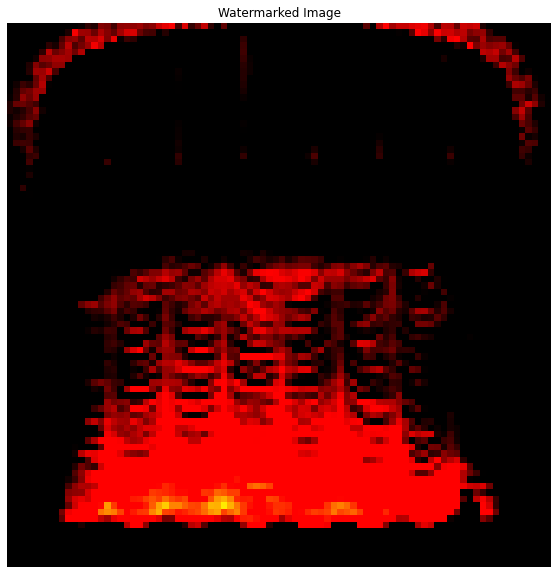

  9%|▉         | 1/11 [00:08<01:21,  8.20s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 21: Target opacity: 0, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: True, Base class predicted: False


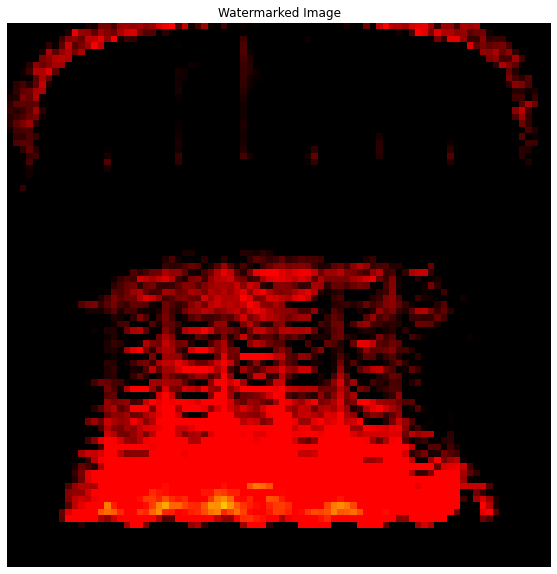

 18%|█▊        | 2/11 [00:16<01:13,  8.21s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 21: Target opacity: 0.05, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: True, Base class predicted: False


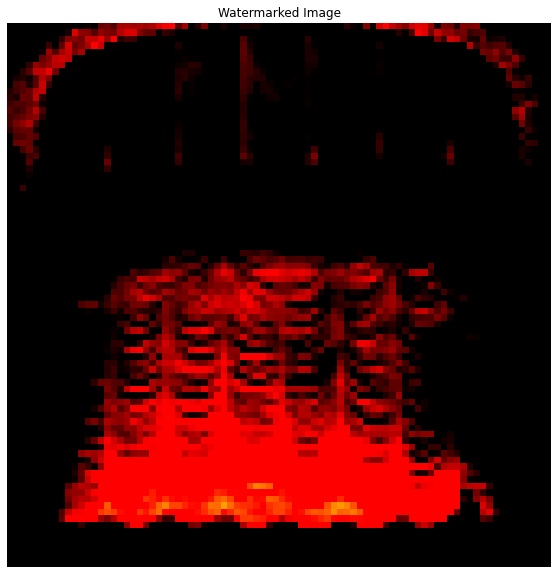

 27%|██▋       | 3/11 [00:24<01:06,  8.31s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 21: Target opacity: 0.1, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: True, Base class predicted: False


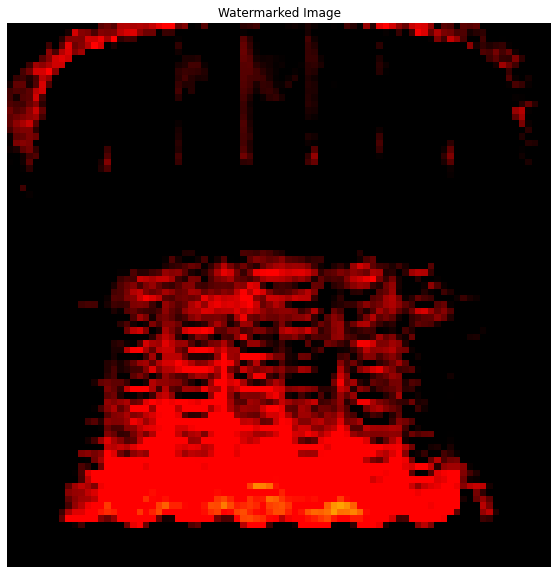

 36%|███▋      | 4/11 [00:33<00:58,  8.34s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 21: Target opacity: 0.15, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: True, Base class predicted: False


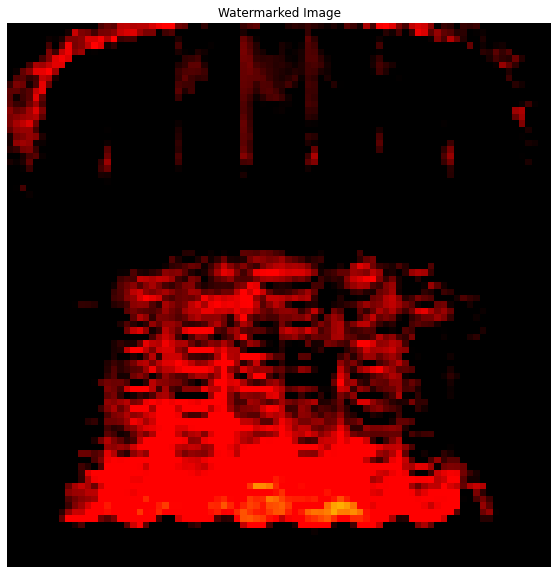

 45%|████▌     | 5/11 [00:41<00:49,  8.30s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 21: Target opacity: 0.2, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: True, Base class predicted: False


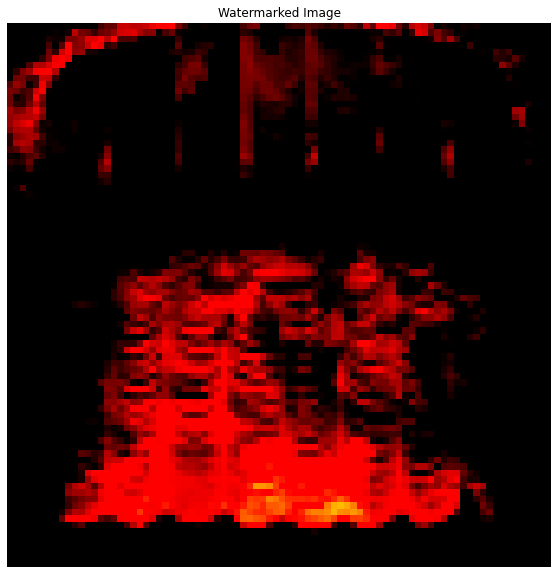

 55%|█████▍    | 6/11 [00:49<00:41,  8.31s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 21: Target opacity: 0.25, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: True, Base class predicted: False


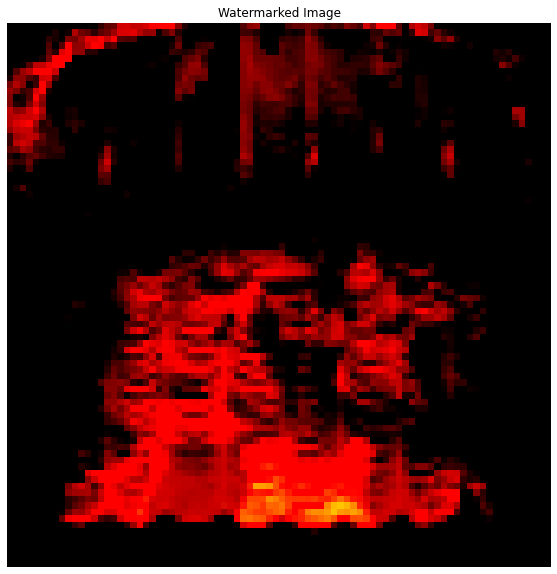

 64%|██████▎   | 7/11 [00:58<00:33,  8.29s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 21: Target opacity: 0.3, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: True, Base class predicted: False


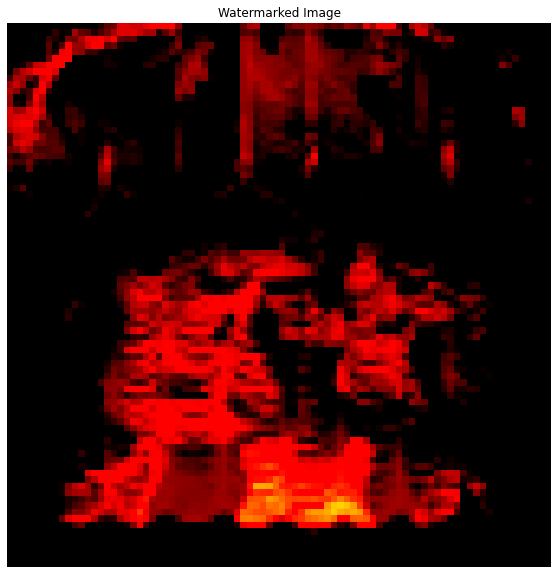

 73%|███████▎  | 8/11 [01:06<00:24,  8.26s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 21: Target opacity: 0.35, Labeled correctly: 0.5466666666666666, Correctly Predicted Target: True, Base class predicted: False


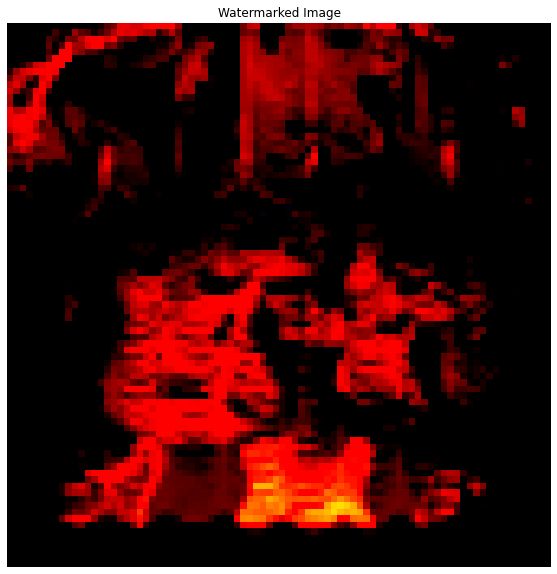

 82%|████████▏ | 9/11 [01:14<00:16,  8.25s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 21: Target opacity: 0.4, Labeled correctly: 0.5333333333333333, Correctly Predicted Target: True, Base class predicted: False


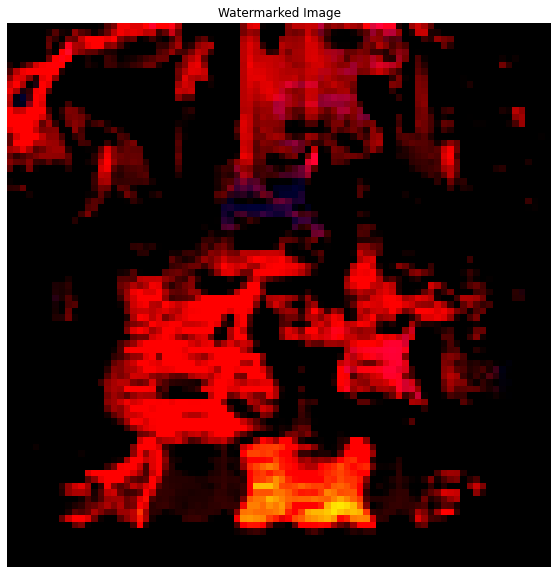

 91%|█████████ | 10/11 [01:22<00:08,  8.21s/it]Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Iteration 21: Target opacity: 0.45, Labeled correctly: 0.5333333333333333, Correctly Predicted Target: True, Base class predicted: False


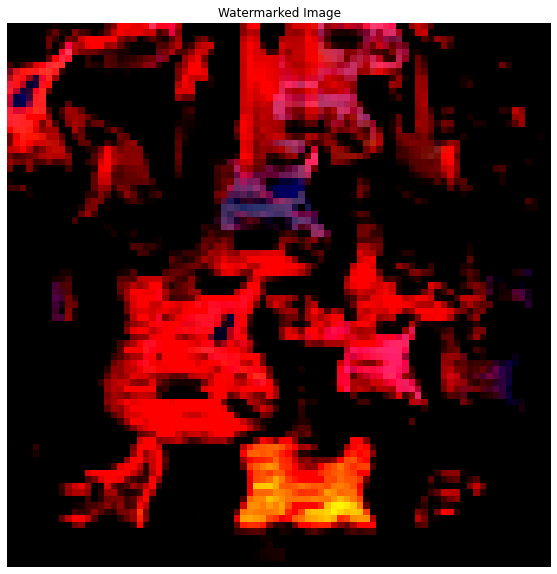

100%|██████████| 11/11 [01:30<00:00,  8.25s/it]

Iteration 21: Target opacity: 0.5, Labeled correctly: 0.5333333333333333, Correctly Predicted Target: True, Base class predicted: False



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


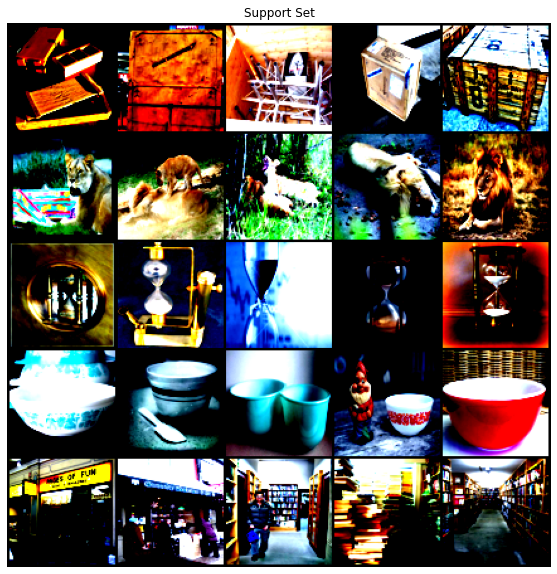

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_spt tensor([[3, 3, 3, 3, 3, 2, 2, 2, 2, 2, 4, 4, 4, 4, 4, 0, 0, 0, 0, 0, 1, 1, 1, 1,
         1]])


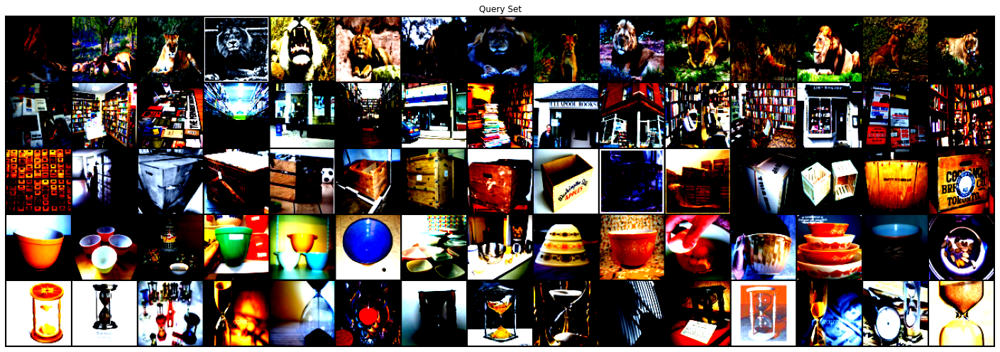

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


y_qry tensor([[2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 2, 1, 1, 1, 1, 1, 1, 1, 1, 1,
         1, 1, 1, 1, 1, 1, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 3, 0, 0, 0,
         0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4, 4,
         4, 4, 4]])
target_class 3
unique_classes [0, 1, 2, 4]
base_class 2
target_indices [30 31 32 33 34 35 36 37 38 39 40 41 42 43 44]
target_index 41
base_indices [5 6 7 8 9]
base_index 9


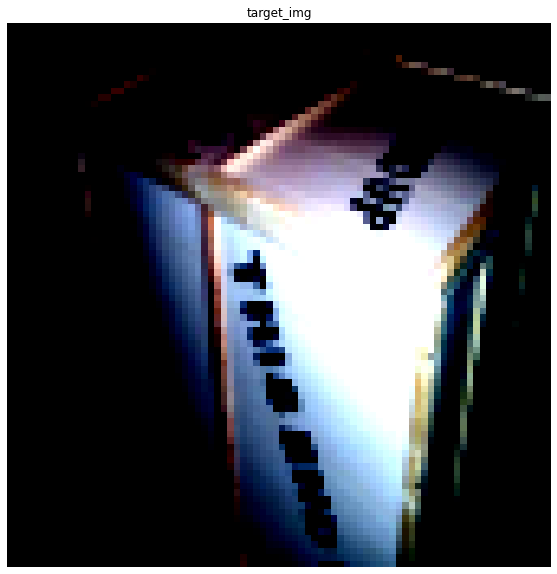

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


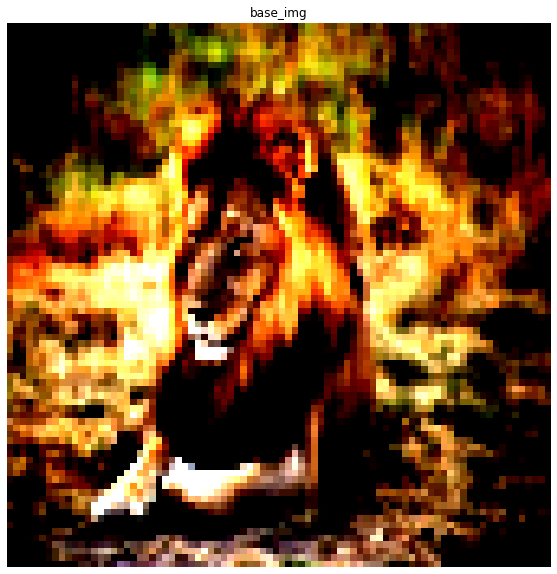

  0%|          | 3/1000 [00:00<00:37, 26.26it/s]

Iteration 0
loss: tensor(5.8558, grad_fn=<PowBackward0>)
Iteration 1
loss: tensor(88.9446, grad_fn=<PowBackward0>)
Iteration 2
loss: tensor(27.2927, grad_fn=<PowBackward0>)
Iteration 3
loss: tensor(31.6967, grad_fn=<PowBackward0>)
Iteration 4
loss: tensor(69.1152, grad_fn=<PowBackward0>)


  1%|          | 9/1000 [00:00<00:41, 23.85it/s]

Iteration 5
loss: tensor(12.7085, grad_fn=<PowBackward0>)
Iteration 6
loss: tensor(33.4231, grad_fn=<PowBackward0>)
Iteration 7
loss: tensor(29.0846, grad_fn=<PowBackward0>)
Iteration 8
loss: tensor(114.6413, grad_fn=<PowBackward0>)
Iteration 9
loss: tensor(9.6910, grad_fn=<PowBackward0>)
Iteration 10


  2%|▏         | 15/1000 [00:00<00:38, 25.30it/s]

loss: tensor(32.8962, grad_fn=<PowBackward0>)
Iteration 11
loss: tensor(20.4214, grad_fn=<PowBackward0>)
Iteration 12
loss: tensor(84.3400, grad_fn=<PowBackward0>)
Iteration 13
loss: tensor(3.8334, grad_fn=<PowBackward0>)
Iteration 14
loss: tensor(18.7339, grad_fn=<PowBackward0>)
Iteration 15
loss: tensor(33.6245, grad_fn=<PowBackward0>)


  2%|▏         | 21/1000 [00:00<00:38, 25.72it/s]

Iteration 16
loss: tensor(103.8747, grad_fn=<PowBackward0>)
Iteration 17
loss: tensor(4.0717, grad_fn=<PowBackward0>)
Iteration 18
loss: tensor(63.8983, grad_fn=<PowBackward0>)
Iteration 19
loss: tensor(29.0777, grad_fn=<PowBackward0>)
Iteration 20
loss: tensor(30.0206, grad_fn=<PowBackward0>)
Iteration 21


  2%|▏         | 24/1000 [00:00<00:38, 25.61it/s]

loss: tensor(8.8622, grad_fn=<PowBackward0>)
Iteration 22
loss: tensor(62.1332, grad_fn=<PowBackward0>)
Iteration 23
loss: tensor(55.9889, grad_fn=<PowBackward0>)
Iteration 24
loss: tensor(35.2802, grad_fn=<PowBackward0>)
Iteration 25
loss: tensor(25.2086, grad_fn=<PowBackward0>)
Iteration 26
loss: tensor(40.9291, grad_fn=<PowBackward0>)


  3%|▎         | 30/1000 [00:01<00:37, 26.07it/s]

Iteration 27
loss: tensor(17.0235, grad_fn=<PowBackward0>)
Iteration 28
loss: tensor(77.2746, grad_fn=<PowBackward0>)
Iteration 29
loss: tensor(10.8026, grad_fn=<PowBackward0>)
Iteration 30
loss: tensor(36.4397, grad_fn=<PowBackward0>)
Iteration 31
loss: tensor(20.6565, grad_fn=<PowBackward0>)
Iteration 32
loss: tensor(48.1940, grad_fn=<PowBackward0>)


  4%|▎         | 36/1000 [00:01<00:37, 25.38it/s]

Iteration 33
loss: tensor(46.3736, grad_fn=<PowBackward0>)
Iteration 34
loss: tensor(65.9611, grad_fn=<PowBackward0>)
Iteration 35
loss: tensor(3.0425, grad_fn=<PowBackward0>)
Iteration 36
loss: tensor(43.8451, grad_fn=<PowBackward0>)
Iteration 37
loss: tensor(16.8195, grad_fn=<PowBackward0>)


  4%|▍         | 42/1000 [00:01<00:38, 25.06it/s]

Iteration 38
loss: tensor(76.3439, grad_fn=<PowBackward0>)
Iteration 39
loss: tensor(9.4939, grad_fn=<PowBackward0>)
Iteration 40
loss: tensor(76.6572, grad_fn=<PowBackward0>)
Iteration 41
loss: tensor(15.6640, grad_fn=<PowBackward0>)
Iteration 42
loss: tensor(55.9824, grad_fn=<PowBackward0>)
Iteration 43


  5%|▍         | 48/1000 [00:01<00:38, 24.73it/s]

loss: tensor(24.8378, grad_fn=<PowBackward0>)
Iteration 44
loss: tensor(111.5323, grad_fn=<PowBackward0>)
Iteration 45
loss: tensor(17.2491, grad_fn=<PowBackward0>)
Iteration 46
loss: tensor(48.8446, grad_fn=<PowBackward0>)
Iteration 47
loss: tensor(5.6137, grad_fn=<PowBackward0>)
Iteration 48


  5%|▌         | 51/1000 [00:02<00:39, 24.32it/s]

loss: tensor(46.9491, grad_fn=<PowBackward0>)
Iteration 49
loss: tensor(39.5214, grad_fn=<PowBackward0>)
Iteration 50
loss: tensor(62.2505, grad_fn=<PowBackward0>)
Iteration 51
loss: tensor(18.8917, grad_fn=<PowBackward0>)
Iteration 52
loss: tensor(107.0057, grad_fn=<PowBackward0>)
Iteration 53
loss: tensor(11.9756, grad_fn=<PowBackward0>)

  6%|▌         | 57/1000 [00:02<00:37, 24.82it/s]


Iteration 54
loss: tensor(12.2428, grad_fn=<PowBackward0>)
Iteration 55
loss: tensor(42.4730, grad_fn=<PowBackward0>)
Iteration 56
loss: tensor(68.1969, grad_fn=<PowBackward0>)
Iteration 57
loss: tensor(10.2063, grad_fn=<PowBackward0>)
Iteration 58


  6%|▋         | 63/1000 [00:02<00:38, 24.22it/s]

loss: tensor(68.3402, grad_fn=<PowBackward0>)
Iteration 59
loss: tensor(11.6654, grad_fn=<PowBackward0>)
Iteration 60
loss: tensor(38.2617, grad_fn=<PowBackward0>)
Iteration 61
loss: tensor(35.0168, grad_fn=<PowBackward0>)
Iteration 62
loss: tensor(62.4608, grad_fn=<PowBackward0>)
Iteration 63


  7%|▋         | 69/1000 [00:02<00:36, 25.63it/s]

loss: tensor(20.6933, grad_fn=<PowBackward0>)
Iteration 64
loss: tensor(58.0406, grad_fn=<PowBackward0>)
Iteration 65
loss: tensor(13.4386, grad_fn=<PowBackward0>)
Iteration 66
loss: tensor(41.6478, grad_fn=<PowBackward0>)
Iteration 67
loss: tensor(43.6370, grad_fn=<PowBackward0>)
Iteration 68
loss: tensor(27.0630, grad_fn=<PowBackward0>)


  7%|▋         | 72/1000 [00:02<00:36, 25.09it/s]

Iteration 69
loss: tensor(13.8508, grad_fn=<PowBackward0>)
Iteration 70
loss: tensor(55.4579, grad_fn=<PowBackward0>)
Iteration 71
loss: tensor(6.0817, grad_fn=<PowBackward0>)
Iteration 72
loss: tensor(74.9711, grad_fn=<PowBackward0>)
Iteration 73
loss: tensor(11.0437, grad_fn=<PowBackward0>)


  8%|▊         | 78/1000 [00:03<00:36, 25.20it/s]

Iteration 74
loss: tensor(53.3337, grad_fn=<PowBackward0>)
Iteration 75
loss: tensor(14.4670, grad_fn=<PowBackward0>)
Iteration 76
loss: tensor(47.9540, grad_fn=<PowBackward0>)
Iteration 77
loss: tensor(3.7750, grad_fn=<PowBackward0>)
Iteration 78
loss: tensor(50.7579, grad_fn=<PowBackward0>)
Iteration 79


  8%|▊         | 84/1000 [00:03<00:38, 24.04it/s]

loss: tensor(20.5769, grad_fn=<PowBackward0>)
Iteration 80
loss: tensor(90.9346, grad_fn=<PowBackward0>)
Iteration 81
loss: tensor(7.1262, grad_fn=<PowBackward0>)
Iteration 82
loss: tensor(57.4430, grad_fn=<PowBackward0>)
Iteration 83
loss: tensor(21.9847, grad_fn=<PowBackward0>)
Iteration 84


  9%|▊         | 87/1000 [00:03<00:37, 24.36it/s]

loss: tensor(82.9066, grad_fn=<PowBackward0>)
Iteration 85
loss: tensor(12.3087, grad_fn=<PowBackward0>)
Iteration 86
loss: tensor(42.6444, grad_fn=<PowBackward0>)
Iteration 87
loss: tensor(8.1550, grad_fn=<PowBackward0>)
Iteration 88
loss: tensor(58.1201, grad_fn=<PowBackward0>)
Iteration 89
loss: tensor(22.7578, grad_fn=<PowBackward0>)

  9%|▉         | 93/1000 [00:03<00:36, 25.13it/s]


Iteration 90
loss: tensor(77.2507, grad_fn=<PowBackward0>)
Iteration 91
loss: tensor(0.5038, grad_fn=<PowBackward0>)
Iteration 92
loss: tensor(0.2208, grad_fn=<PowBackward0>)
Iteration 93
loss: tensor(1.5231, grad_fn=<PowBackward0>)
Iteration 94
loss: tensor(126.2795, grad_fn=<PowBackward0>)


 10%|▉         | 99/1000 [00:03<00:35, 25.38it/s]

Iteration 95
loss: tensor(10.2319, grad_fn=<PowBackward0>)
Iteration 96
loss: tensor(14.6150, grad_fn=<PowBackward0>)
Iteration 97
loss: tensor(27.2590, grad_fn=<PowBackward0>)
Iteration 98
loss: tensor(45.8969, grad_fn=<PowBackward0>)
Iteration 99
loss: tensor(10.1005, grad_fn=<PowBackward0>)
Iteration 100


 10%|█         | 105/1000 [00:04<00:34, 25.69it/s]

loss: tensor(66.3813, grad_fn=<PowBackward0>)
Iteration 101
loss: tensor(25.1282, grad_fn=<PowBackward0>)
Iteration 102
loss: tensor(11.4412, grad_fn=<PowBackward0>)
Iteration 103
loss: tensor(29.0711, grad_fn=<PowBackward0>)
Iteration 104
loss: tensor(33.1407, grad_fn=<PowBackward0>)
Iteration 105
loss: tensor(11.2394, grad_fn=<PowBackward0>)


 11%|█         | 111/1000 [00:04<00:34, 25.68it/s]

Iteration 106
loss: tensor(34.9063, grad_fn=<PowBackward0>)
Iteration 107
loss: tensor(14.9204, grad_fn=<PowBackward0>)
Iteration 108
loss: tensor(58.0543, grad_fn=<PowBackward0>)
Iteration 109
loss: tensor(24.0096, grad_fn=<PowBackward0>)
Iteration 110
loss: tensor(84.6094, grad_fn=<PowBackward0>)
Iteration 111


 11%|█▏        | 114/1000 [00:04<00:34, 25.86it/s]

loss: tensor(8.5912, grad_fn=<PowBackward0>)
Iteration 112
loss: tensor(41.1016, grad_fn=<PowBackward0>)
Iteration 113
loss: tensor(29.8170, grad_fn=<PowBackward0>)
Iteration 114
loss: tensor(53.4478, grad_fn=<PowBackward0>)
Iteration 115
loss: tensor(24.9964, grad_fn=<PowBackward0>)
Iteration 116
loss: tensor(48.7766, grad_fn=<PowBackward0>)


 12%|█▏        | 120/1000 [00:04<00:34, 25.42it/s]

Iteration 117
loss: tensor(13.6125, grad_fn=<PowBackward0>)
Iteration 118
loss: tensor(46.1156, grad_fn=<PowBackward0>)
Iteration 119
loss: tensor(18.6224, grad_fn=<PowBackward0>)
Iteration 120
loss: tensor(44.6031, grad_fn=<PowBackward0>)
Iteration 121
loss: tensor(10.4950, grad_fn=<PowBackward0>)
Iteration 122


 13%|█▎        | 126/1000 [00:05<00:35, 24.31it/s]

loss: tensor(39.1586, grad_fn=<PowBackward0>)
Iteration 123
loss: tensor(36.2568, grad_fn=<PowBackward0>)
Iteration 124
loss: tensor(54.5598, grad_fn=<PowBackward0>)
Iteration 125
loss: tensor(15.3930, grad_fn=<PowBackward0>)
Iteration 126
loss: tensor(28.4243, grad_fn=<PowBackward0>)
Iteration 127


 13%|█▎        | 132/1000 [00:05<00:34, 24.94it/s]

loss: tensor(13.5613, grad_fn=<PowBackward0>)
Iteration 128
loss: tensor(45.5233, grad_fn=<PowBackward0>)
Iteration 129
loss: tensor(15.2857, grad_fn=<PowBackward0>)
Iteration 130
loss: tensor(59.8207, grad_fn=<PowBackward0>)
Iteration 131
loss: tensor(32.1010, grad_fn=<PowBackward0>)
Iteration 132
loss: tensor(67.6727, grad_fn=<PowBackward0>)


 14%|█▍        | 138/1000 [00:05<00:35, 24.57it/s]

Iteration 133
loss: tensor(15.5736, grad_fn=<PowBackward0>)
Iteration 134
loss: tensor(74.2248, grad_fn=<PowBackward0>)
Iteration 135
loss: tensor(8.9536, grad_fn=<PowBackward0>)
Iteration 136
loss: tensor(43.7135, grad_fn=<PowBackward0>)
Iteration 137
loss: tensor(18.3409, grad_fn=<PowBackward0>)


 14%|█▍        | 141/1000 [00:05<00:34, 24.90it/s]

Iteration 138
loss: tensor(40.8194, grad_fn=<PowBackward0>)
Iteration 139
loss: tensor(20.5956, grad_fn=<PowBackward0>)
Iteration 140
loss: tensor(59.7591, grad_fn=<PowBackward0>)
Iteration 141
loss: tensor(10.8754, grad_fn=<PowBackward0>)
Iteration 142
loss: tensor(59.7884, grad_fn=<PowBackward0>)
Iteration 143
loss: tensor(29.6893, grad_fn=<PowBackward0>)

 15%|█▍        | 147/1000 [00:05<00:33, 25.51it/s]


Iteration 144
loss: tensor(51.2372, grad_fn=<PowBackward0>)
Iteration 145
loss: tensor(14.8703, grad_fn=<PowBackward0>)
Iteration 146
loss: tensor(73.1348, grad_fn=<PowBackward0>)
Iteration 147
loss: tensor(24.8287, grad_fn=<PowBackward0>)
Iteration 148
loss: tensor(64.0490, grad_fn=<PowBackward0>)


 15%|█▌        | 153/1000 [00:06<00:33, 25.08it/s]

Iteration 149
loss: tensor(15.9328, grad_fn=<PowBackward0>)
Iteration 150
loss: tensor(52.8137, grad_fn=<PowBackward0>)
Iteration 151
loss: tensor(16.2987, grad_fn=<PowBackward0>)
Iteration 152
loss: tensor(31.8261, grad_fn=<PowBackward0>)
Iteration 153
loss: tensor(16.9449, grad_fn=<PowBackward0>)
Iteration 

 16%|█▌        | 159/1000 [00:06<00:32, 25.61it/s]

154
loss: tensor(57.0559, grad_fn=<PowBackward0>)
Iteration 155
loss: tensor(24.0418, grad_fn=<PowBackward0>)
Iteration 156
loss: tensor(50.8344, grad_fn=<PowBackward0>)
Iteration 157
loss: tensor(18.5808, grad_fn=<PowBackward0>)
Iteration 158
loss: tensor(32.6098, grad_fn=<PowBackward0>)
Iteration 159


 16%|█▌        | 162/1000 [00:06<00:34, 24.24it/s]

loss: tensor(7.1252, grad_fn=<PowBackward0>)
Iteration 160
loss: tensor(61.0382, grad_fn=<PowBackward0>)
Iteration 161
loss: tensor(27.6955, grad_fn=<PowBackward0>)
Iteration 162
loss: tensor(82.7559, grad_fn=<PowBackward0>)
Iteration 163
loss: tensor(9.2243, grad_fn=<PowBackward0>)
Iteration 164


 17%|█▋        | 168/1000 [00:06<00:35, 23.45it/s]

loss: tensor(18.4187, grad_fn=<PowBackward0>)
Iteration 165
loss: tensor(42.2656, grad_fn=<PowBackward0>)
Iteration 166
loss: tensor(73.1193, grad_fn=<PowBackward0>)
Iteration 167
loss: tensor(6.6169, grad_fn=<PowBackward0>)
Iteration 168
loss: tensor(18.2842, grad_fn=<PowBackward0>)


 17%|█▋        | 174/1000 [00:06<00:33, 24.34it/s]

Iteration 169
loss: tensor(26.7347, grad_fn=<PowBackward0>)
Iteration 170
loss: tensor(63.3795, grad_fn=<PowBackward0>)
Iteration 171
loss: tensor(26.5268, grad_fn=<PowBackward0>)
Iteration 172
loss: tensor(37.7021, grad_fn=<PowBackward0>)
Iteration 173
loss: tensor(12.7628, grad_fn=<PowBackward0>)
Iteration 174


 18%|█▊        | 180/1000 [00:07<00:32, 25.40it/s]

loss: tensor(66.2855, grad_fn=<PowBackward0>)
Iteration 175
loss: tensor(27.9755, grad_fn=<PowBackward0>)
Iteration 176
loss: tensor(63.0080, grad_fn=<PowBackward0>)
Iteration 177
loss: tensor(19.0805, grad_fn=<PowBackward0>)
Iteration 178
loss: tensor(37.3556, grad_fn=<PowBackward0>)
Iteration 179
loss: tensor(8.9824, grad_fn=<PowBackward0>)


 18%|█▊        | 183/1000 [00:07<00:32, 25.45it/s]

Iteration 180
loss: tensor(42.1631, grad_fn=<PowBackward0>)
Iteration 181
loss: tensor(16.4502, grad_fn=<PowBackward0>)
Iteration 182
loss: tensor(59.6432, grad_fn=<PowBackward0>)
Iteration 183
loss: tensor(25.9803, grad_fn=<PowBackward0>)
Iteration 184
loss: tensor(52.3681, grad_fn=<PowBackward0>)
Iteration 185


 19%|█▉        | 189/1000 [00:07<00:32, 25.00it/s]

loss: tensor(6.6056, grad_fn=<PowBackward0>)
Iteration 186
loss: tensor(44.0837, grad_fn=<PowBackward0>)
Iteration 187
loss: tensor(24.3634, grad_fn=<PowBackward0>)
Iteration 188
loss: tensor(81.7443, grad_fn=<PowBackward0>)
Iteration 189
loss: tensor(13.9144, grad_fn=<PowBackward0>)
Iteration 190
loss: tensor(64.5512, grad_fn=<PowBackward0>)

 20%|█▉        | 195/1000 [00:07<00:31, 25.68it/s]


Iteration 191
loss: tensor(13.0668, grad_fn=<PowBackward0>)
Iteration 192
loss: tensor(30.8796, grad_fn=<PowBackward0>)
Iteration 193
loss: tensor(30.1642, grad_fn=<PowBackward0>)
Iteration 194
loss: tensor(76.1580, grad_fn=<PowBackward0>)
Iteration 195
loss: tensor(6.4756, grad_fn=<PowBackward0>)


 20%|█▉        | 198/1000 [00:07<00:31, 25.36it/s]

Iteration 196
loss: tensor(21.6873, grad_fn=<PowBackward0>)
Iteration 197
loss: tensor(12.1257, grad_fn=<PowBackward0>)
Iteration 198
loss: tensor(50.5688, grad_fn=<PowBackward0>)
Iteration 199
loss: tensor(27.4591, grad_fn=<PowBackward0>)
Iteration 200
loss: tensor(28.2830, grad_fn=<PowBackward0>)


 20%|██        | 204/1000 [00:08<00:32, 24.53it/s]

Iteration 201
loss: tensor(11.9700, grad_fn=<PowBackward0>)
Iteration 202
loss: tensor(23.1554, grad_fn=<PowBackward0>)
Iteration 203
loss: tensor(24.1170, grad_fn=<PowBackward0>)
Iteration 204
loss: tensor(53.7497, grad_fn=<PowBackward0>)
Iteration 205
loss: tensor(16.6959, grad_fn=<PowBackward0>)
Iteration 206


 21%|██        | 210/1000 [00:08<00:31, 24.83it/s]

loss: tensor(22.1284, grad_fn=<PowBackward0>)
Iteration 207
loss: tensor(17.2592, grad_fn=<PowBackward0>)
Iteration 208
loss: tensor(52.0743, grad_fn=<PowBackward0>)
Iteration 209
loss: tensor(11.1121, grad_fn=<PowBackward0>)
Iteration 210
loss: tensor(29.4397, grad_fn=<PowBackward0>)
Iteration 211


 22%|██▏       | 216/1000 [00:08<00:32, 24.38it/s]

loss: tensor(19.2781, grad_fn=<PowBackward0>)
Iteration 212
loss: tensor(29.2257, grad_fn=<PowBackward0>)
Iteration 213
loss: tensor(18.8330, grad_fn=<PowBackward0>)
Iteration 214
loss: tensor(35.7661, grad_fn=<PowBackward0>)
Iteration 215
loss: tensor(12.9517, grad_fn=<PowBackward0>)
Iteration 216


 22%|██▏       | 219/1000 [00:08<00:31, 24.45it/s]

loss: tensor(43.6641, grad_fn=<PowBackward0>)
Iteration 217
loss: tensor(19.8569, grad_fn=<PowBackward0>)
Iteration 218
loss: tensor(26.4632, grad_fn=<PowBackward0>)
Iteration 219
loss: tensor(8.7027, grad_fn=<PowBackward0>)
Iteration 220
loss: tensor(27.0599, grad_fn=<PowBackward0>)
Iteration 221
loss: tensor(11.5516, grad_fn=<PowBackward0>)

 22%|██▎       | 225/1000 [00:09<00:33, 22.86it/s]


Iteration 222
loss: tensor(26.5511, grad_fn=<PowBackward0>)
Iteration 223
loss: tensor(22.5604, grad_fn=<PowBackward0>)
Iteration 224
loss: tensor(57.0111, grad_fn=<PowBackward0>)
Iteration 225
loss: tensor(27.6813, grad_fn=<PowBackward0>)


 23%|██▎       | 228/1000 [00:09<00:33, 22.95it/s]

Iteration 226
loss: tensor(12.2834, grad_fn=<PowBackward0>)
Iteration 227
loss: tensor(15.9679, grad_fn=<PowBackward0>)
Iteration 228
loss: tensor(45.4987, grad_fn=<PowBackward0>)
Iteration 229
loss: tensor(10.1514, grad_fn=<PowBackward0>)
Iteration 230
loss: tensor(36.2863, grad_fn=<PowBackward0>)


 23%|██▎       | 234/1000 [00:09<00:32, 23.91it/s]

Iteration 231
loss: tensor(33.0388, grad_fn=<PowBackward0>)
Iteration 232
loss: tensor(38.8600, grad_fn=<PowBackward0>)
Iteration 233
loss: tensor(6.5713, grad_fn=<PowBackward0>)
Iteration 234
loss: tensor(22.7159, grad_fn=<PowBackward0>)
Iteration 235
loss: tensor(20.3331, grad_fn=<PowBackward0>)
Iteration 236


 24%|██▍       | 240/1000 [00:09<00:30, 24.79it/s]

loss: tensor(32.1652, grad_fn=<PowBackward0>)
Iteration 237
loss: tensor(7.7543, grad_fn=<PowBackward0>)
Iteration 238
loss: tensor(34.6883, grad_fn=<PowBackward0>)
Iteration 239
loss: tensor(40.1165, grad_fn=<PowBackward0>)
Iteration 240
loss: tensor(39.0949, grad_fn=<PowBackward0>)
Iteration 241
loss: tensor(4.9680, grad_fn=<PowBackward0>)


 25%|██▍       | 246/1000 [00:09<00:30, 24.49it/s]

Iteration 242
loss: tensor(14.7401, grad_fn=<PowBackward0>)
Iteration 243
loss: tensor(9.1459, grad_fn=<PowBackward0>)
Iteration 244
loss: tensor(25.0247, grad_fn=<PowBackward0>)
Iteration 245
loss: tensor(7.8361, grad_fn=<PowBackward0>)
Iteration 246
loss: tensor(29.3912, grad_fn=<PowBackward0>)


 25%|██▌       | 252/1000 [00:10<00:30, 24.80it/s]

Iteration 247
loss: tensor(19.9879, grad_fn=<PowBackward0>)
Iteration 248
loss: tensor(38.3634, grad_fn=<PowBackward0>)
Iteration 249
loss: tensor(16.5665, grad_fn=<PowBackward0>)
Iteration 250
loss: tensor(23.2831, grad_fn=<PowBackward0>)
Iteration 251
loss: tensor(9.7981, grad_fn=<PowBackward0>)
Iteration 252


 26%|██▌       | 255/1000 [00:10<00:29, 25.27it/s]

loss: tensor(34.7411, grad_fn=<PowBackward0>)
Iteration 253
loss: tensor(8.7377, grad_fn=<PowBackward0>)
Iteration 254
loss: tensor(34.0259, grad_fn=<PowBackward0>)
Iteration 255
loss: tensor(17.1372, grad_fn=<PowBackward0>)
Iteration 256
loss: tensor(41.2035, grad_fn=<PowBackward0>)
Iteration 257
loss: tensor(21.6124, grad_fn=<PowBackward0>)


 26%|██▌       | 261/1000 [00:10<00:28, 25.59it/s]

Iteration 258
loss: tensor(28.8111, grad_fn=<PowBackward0>)
Iteration 259
loss: tensor(12.7173, grad_fn=<PowBackward0>)
Iteration 260
loss: tensor(27.6607, grad_fn=<PowBackward0>)
Iteration 261
loss: tensor(26.0726, grad_fn=<PowBackward0>)
Iteration 262
loss: tensor(42.7760, grad_fn=<PowBackward0>)
Iteration 263


 27%|██▋       | 267/1000 [00:10<00:28, 25.37it/s]

loss: tensor(15.3783, grad_fn=<PowBackward0>)
Iteration 264
loss: tensor(10.8481, grad_fn=<PowBackward0>)
Iteration 265
loss: tensor(12.7447, grad_fn=<PowBackward0>)
Iteration 266
loss: tensor(25.6993, grad_fn=<PowBackward0>)
Iteration 267
loss: tensor(18.1377, grad_fn=<PowBackward0>)
Iteration 268
loss: tensor(34.2713, grad_fn=<PowBackward0>)


 27%|██▋       | 273/1000 [00:10<00:28, 25.31it/s]

Iteration 269
loss: tensor(17.4221, grad_fn=<PowBackward0>)
Iteration 270
loss: tensor(43.9282, grad_fn=<PowBackward0>)
Iteration 271
loss: tensor(14.1244, grad_fn=<PowBackward0>)
Iteration 272
loss: tensor(21.5263, grad_fn=<PowBackward0>)
Iteration 273
loss: tensor(14.6033, grad_fn=<PowBackward0>)
Iteration 274


 28%|██▊       | 279/1000 [00:11<00:27, 26.02it/s]

loss: tensor(41.2141, grad_fn=<PowBackward0>)
Iteration 275
loss: tensor(15.2245, grad_fn=<PowBackward0>)
Iteration 276
loss: tensor(12.2357, grad_fn=<PowBackward0>)
Iteration 277
loss: tensor(12.9781, grad_fn=<PowBackward0>)
Iteration 278
loss: tensor(39.1999, grad_fn=<PowBackward0>)
Iteration 279
loss: tensor(12.9481, grad_fn=<PowBackward0>)


 28%|██▊       | 285/1000 [00:11<00:28, 25.47it/s]

Iteration 280
loss: tensor(24.5074, grad_fn=<PowBackward0>)
Iteration 281
loss: tensor(11.0119, grad_fn=<PowBackward0>)
Iteration 282
loss: tensor(41.0657, grad_fn=<PowBackward0>)
Iteration 283
loss: tensor(19.2318, grad_fn=<PowBackward0>)
Iteration 284
loss: tensor(20.7570, grad_fn=<PowBackward0>)
Iteration 285


 29%|██▉       | 288/1000 [00:11<00:28, 24.67it/s]

loss: tensor(9.1099, grad_fn=<PowBackward0>)
Iteration 286
loss: tensor(13.0566, grad_fn=<PowBackward0>)
Iteration 287
loss: tensor(22.1314, grad_fn=<PowBackward0>)
Iteration 288
loss: tensor(53.5465, grad_fn=<PowBackward0>)
Iteration 289
loss: tensor(16.2172, grad_fn=<PowBackward0>)
Iteration 290
loss: tensor(17.1326, grad_fn=<PowBackward0>)


 29%|██▉       | 294/1000 [00:11<00:28, 24.42it/s]

Iteration 291
loss: tensor(10.3017, grad_fn=<PowBackward0>)
Iteration 292
loss: tensor(31.4831, grad_fn=<PowBackward0>)
Iteration 293
loss: tensor(23.6616, grad_fn=<PowBackward0>)
Iteration 294
loss: tensor(26.8904, grad_fn=<PowBackward0>)
Iteration 295


 30%|███       | 300/1000 [00:12<00:28, 24.32it/s]

loss: tensor(25.8961, grad_fn=<PowBackward0>)
Iteration 296
loss: tensor(25.7609, grad_fn=<PowBackward0>)
Iteration 297
loss: tensor(16.1487, grad_fn=<PowBackward0>)
Iteration 298
loss: tensor(35.8827, grad_fn=<PowBackward0>)
Iteration 299
loss: tensor(18.1326, grad_fn=<PowBackward0>)
Iteration 300
loss: tensor(40.6433, grad_fn=<PowBackward0>)


 31%|███       | 306/1000 [00:12<00:28, 24.75it/s]

Iteration 301
loss: tensor(15.4584, grad_fn=<PowBackward0>)
Iteration 302
loss: tensor(9.4663, grad_fn=<PowBackward0>)
Iteration 303
loss: tensor(3.3612, grad_fn=<PowBackward0>)
Iteration 304
loss: tensor(2.8225, grad_fn=<PowBackward0>)
Iteration 305
loss: tensor(4.6823, grad_fn=<PowBackward0>)
Iteration 306


 31%|███       | 309/1000 [00:12<00:27, 24.68it/s]

loss: tensor(13.7183, grad_fn=<PowBackward0>)
Iteration 307
loss: tensor(18.7734, grad_fn=<PowBackward0>)
Iteration 308
loss: tensor(32.9014, grad_fn=<PowBackward0>)
Iteration 309
loss: tensor(9.7125, grad_fn=<PowBackward0>)
Iteration 310
loss: tensor(15.9381, grad_fn=<PowBackward0>)
Iteration 311
loss: tensor(8.0394, grad_fn=<PowBackward0>)


 32%|███▏      | 315/1000 [00:12<00:27, 25.23it/s]

Iteration 312
loss: tensor(12.5569, grad_fn=<PowBackward0>)
Iteration 313
loss: tensor(11.3719, grad_fn=<PowBackward0>)
Iteration 314
loss: tensor(18.6468, grad_fn=<PowBackward0>)
Iteration 315
loss: tensor(13.1993, grad_fn=<PowBackward0>)
Iteration 316
loss: tensor(13.4345, grad_fn=<PowBackward0>)
Iteration 317


 32%|███▏      | 321/1000 [00:12<00:28, 24.07it/s]

loss: tensor(4.8076, grad_fn=<PowBackward0>)
Iteration 318
loss: tensor(8.1953, grad_fn=<PowBackward0>)
Iteration 319
loss: tensor(2.5331, grad_fn=<PowBackward0>)
Iteration 320
loss: tensor(8.6898, grad_fn=<PowBackward0>)
Iteration 321
loss: tensor(9.9724, grad_fn=<PowBackward0>)
Iteration 322


 33%|███▎      | 327/1000 [00:13<00:27, 24.49it/s]

loss: tensor(22.0005, grad_fn=<PowBackward0>)
Iteration 323
loss: tensor(9.5616, grad_fn=<PowBackward0>)
Iteration 324
loss: tensor(36.5599, grad_fn=<PowBackward0>)
Iteration 325
loss: tensor(21.0553, grad_fn=<PowBackward0>)
Iteration 326
loss: tensor(20.7387, grad_fn=<PowBackward0>)
Iteration 327
loss: tensor(6.6805, grad_fn=<PowBackward0>)


 33%|███▎      | 330/1000 [00:13<00:26, 25.16it/s]

Iteration 328
loss: tensor(8.4817, grad_fn=<PowBackward0>)
Iteration 329
loss: tensor(3.6650, grad_fn=<PowBackward0>)
Iteration 330
loss: tensor(9.1457, grad_fn=<PowBackward0>)
Iteration 331
loss: tensor(10.1352, grad_fn=<PowBackward0>)
Iteration 332
loss: tensor(25.1263, grad_fn=<PowBackward0>)


 34%|███▎      | 336/1000 [00:13<00:26, 24.72it/s]

Iteration 333
loss: tensor(10.5199, grad_fn=<PowBackward0>)
Iteration 334
loss: tensor(17.2817, grad_fn=<PowBackward0>)
Iteration 335
loss: tensor(9.7632, grad_fn=<PowBackward0>)
Iteration 336
loss: tensor(7.4969, grad_fn=<PowBackward0>)
Iteration 337
loss: tensor(2.3837, grad_fn=<PowBackward0>)
Iteration 338


 34%|███▍      | 342/1000 [00:13<00:26, 25.03it/s]

loss: tensor(5.6910, grad_fn=<PowBackward0>)
Iteration 339
loss: tensor(7.1883, grad_fn=<PowBackward0>)
Iteration 340
loss: tensor(17.8709, grad_fn=<PowBackward0>)
Iteration 341
loss: tensor(16.0523, grad_fn=<PowBackward0>)
Iteration 342
loss: tensor(29.2023, grad_fn=<PowBackward0>)
Iteration 343
loss: tensor(13.0462, grad_fn=<PowBackward0>)


 35%|███▍      | 348/1000 [00:14<00:26, 24.89it/s]

Iteration 344
loss: tensor(9.8993, grad_fn=<PowBackward0>)
Iteration 345
loss: tensor(4.7438, grad_fn=<PowBackward0>)
Iteration 346
loss: tensor(4.4412, grad_fn=<PowBackward0>)
Iteration 347
loss: tensor(4.5453, grad_fn=<PowBackward0>)
Iteration 348
loss: tensor(12.3240, grad_fn=<PowBackward0>)
Iteration 349


 35%|███▌      | 354/1000 [00:14<00:25, 25.12it/s]

loss: tensor(12.8264, grad_fn=<PowBackward0>)
Iteration 350
loss: tensor(18.8080, grad_fn=<PowBackward0>)
Iteration 351
loss: tensor(17.5970, grad_fn=<PowBackward0>)
Iteration 352
loss: tensor(18.3752, grad_fn=<PowBackward0>)
Iteration 353
loss: tensor(7.3480, grad_fn=<PowBackward0>)
Iteration 354
loss: tensor(9.7896, grad_fn=<PowBackward0>)


 36%|███▌      | 360/1000 [00:14<00:25, 24.94it/s]

Iteration 355
loss: tensor(9.7409, grad_fn=<PowBackward0>)
Iteration 356
loss: tensor(13.5886, grad_fn=<PowBackward0>)
Iteration 357
loss: tensor(4.7908, grad_fn=<PowBackward0>)
Iteration 358
loss: tensor(6.3363, grad_fn=<PowBackward0>)
Iteration 359
loss: tensor(7.3467, grad_fn=<PowBackward0>)
Iteration 360


 36%|███▋      | 363/1000 [00:14<00:25, 25.21it/s]

loss: tensor(8.9982, grad_fn=<PowBackward0>)
Iteration 361
loss: tensor(9.6251, grad_fn=<PowBackward0>)
Iteration 362
loss: tensor(9.5559, grad_fn=<PowBackward0>)
Iteration 363
loss: tensor(9.4354, grad_fn=<PowBackward0>)
Iteration 364
loss: tensor(10.8159, grad_fn=<PowBackward0>)
Iteration 365
loss: tensor(5.1428, grad_fn=<PowBackward0>)


 37%|███▋      | 369/1000 [00:14<00:25, 24.81it/s]

Iteration 366
loss: tensor(9.5534, grad_fn=<PowBackward0>)
Iteration 367
loss: tensor(10.0333, grad_fn=<PowBackward0>)
Iteration 368
loss: tensor(10.4742, grad_fn=<PowBackward0>)
Iteration 369
loss: tensor(9.2147, grad_fn=<PowBackward0>)
Iteration 370
loss: tensor(9.4423, grad_fn=<PowBackward0>)
Iteration 371


 38%|███▊      | 375/1000 [00:15<00:25, 24.64it/s]

loss: tensor(5.7160, grad_fn=<PowBackward0>)
Iteration 372
loss: tensor(9.4251, grad_fn=<PowBackward0>)
Iteration 373
loss: tensor(7.3998, grad_fn=<PowBackward0>)
Iteration 374
loss: tensor(9.8499, grad_fn=<PowBackward0>)
Iteration 375
loss: tensor(7.9215, grad_fn=<PowBackward0>)
Iteration 376
loss: tensor(11.4749, grad_fn=<PowBackward0>)


 38%|███▊      | 381/1000 [00:15<00:24, 25.70it/s]

Iteration 377
loss: tensor(11.7204, grad_fn=<PowBackward0>)
Iteration 378
loss: tensor(9.7144, grad_fn=<PowBackward0>)
Iteration 379
loss: tensor(3.2930, grad_fn=<PowBackward0>)
Iteration 380
loss: tensor(8.7530, grad_fn=<PowBackward0>)
Iteration 381
loss: tensor(7.3723, grad_fn=<PowBackward0>)
Iteration 382
loss: 

 39%|███▊      | 387/1000 [00:15<00:24, 25.16it/s]

tensor(22.7693, grad_fn=<PowBackward0>)
Iteration 383
loss: tensor(17.4485, grad_fn=<PowBackward0>)
Iteration 384
loss: tensor(12.4999, grad_fn=<PowBackward0>)
Iteration 385
loss: tensor(7.3302, grad_fn=<PowBackward0>)
Iteration 386
loss: tensor(6.8847, grad_fn=<PowBackward0>)
Iteration 387


 39%|███▉      | 390/1000 [00:15<00:24, 24.46it/s]

loss: tensor(6.3654, grad_fn=<PowBackward0>)
Iteration 388
loss: tensor(11.3185, grad_fn=<PowBackward0>)
Iteration 389
loss: tensor(11.9968, grad_fn=<PowBackward0>)
Iteration 390
loss: tensor(13.0011, grad_fn=<PowBackward0>)
Iteration 391
loss: tensor(3.6127, grad_fn=<PowBackward0>)
Iteration 392


 40%|███▉      | 396/1000 [00:15<00:23, 25.25it/s]

loss: tensor(13.3719, grad_fn=<PowBackward0>)
Iteration 393
loss: tensor(13.6923, grad_fn=<PowBackward0>)
Iteration 394
loss: tensor(17.0652, grad_fn=<PowBackward0>)
Iteration 395
loss: tensor(8.3674, grad_fn=<PowBackward0>)
Iteration 396
loss: tensor(17.3837, grad_fn=<PowBackward0>)
Iteration 397
loss: tensor(13.4811, grad_fn=<PowBackward0>)


 40%|████      | 402/1000 [00:16<00:23, 25.55it/s]

Iteration 398
loss: tensor(17.9541, grad_fn=<PowBackward0>)
Iteration 399
loss: tensor(17.2050, grad_fn=<PowBackward0>)
Iteration 400
loss: tensor(7.3974, grad_fn=<PowBackward0>)
Iteration 401
loss: tensor(8.4837, grad_fn=<PowBackward0>)
Iteration 402
loss: tensor(0.5637, grad_fn=<PowBackward0>)
Iteration 403


 41%|████      | 408/1000 [00:16<00:23, 25.13it/s]

loss: tensor(0.0283, grad_fn=<PowBackward0>)
Iteration 404
loss: tensor(0.0487, grad_fn=<PowBackward0>)
Iteration 405
loss: tensor(0.0223, grad_fn=<PowBackward0>)
Iteration 406
loss: tensor(0.0498, grad_fn=<PowBackward0>)
Iteration 407
loss: tensor(0.0214, grad_fn=<PowBackward0>)
Iteration 408


 41%|████      | 411/1000 [00:16<00:24, 23.81it/s]

loss: tensor(0.0545, grad_fn=<PowBackward0>)
Iteration 409
loss: tensor(0.0226, grad_fn=<PowBackward0>)
Iteration 410
loss: tensor(0.1387, grad_fn=<PowBackward0>)
Iteration 411
loss: tensor(0.2184, grad_fn=<PowBackward0>)
Iteration 412
loss: tensor(1.4629, grad_fn=<PowBackward0>)
Iteration 413


 42%|████▏     | 417/1000 [00:16<00:24, 24.14it/s]

loss: tensor(4.0968, grad_fn=<PowBackward0>)
Iteration 414
loss: tensor(9.9152, grad_fn=<PowBackward0>)
Iteration 415
loss: tensor(7.7070, grad_fn=<PowBackward0>)
Iteration 416
loss: tensor(6.2670, grad_fn=<PowBackward0>)
Iteration 417
loss: tensor(2.5380, grad_fn=<PowBackward0>)
Iteration 418


 42%|████▏     | 423/1000 [00:17<00:24, 23.88it/s]

loss: tensor(1.5462, grad_fn=<PowBackward0>)
Iteration 419
loss: tensor(0.6834, grad_fn=<PowBackward0>)
Iteration 420
loss: tensor(0.8421, grad_fn=<PowBackward0>)
Iteration 421
loss: tensor(0.5270, grad_fn=<PowBackward0>)
Iteration 422
loss: tensor(0.8189, grad_fn=<PowBackward0>)
Iteration 423


 43%|████▎     | 426/1000 [00:17<00:23, 24.30it/s]

loss: tensor(0.8078, grad_fn=<PowBackward0>)
Iteration 424
loss: tensor(1.9204, grad_fn=<PowBackward0>)
Iteration 425
loss: tensor(2.8345, grad_fn=<PowBackward0>)
Iteration 426
loss: tensor(6.7266, grad_fn=<PowBackward0>)
Iteration 427
loss: tensor(4.6118, grad_fn=<PowBackward0>)
Iteration 428
loss: tensor(11.8729, grad_fn=<PowBackward0>)


 43%|████▎     | 432/1000 [00:17<00:22, 24.90it/s]

Iteration 429
loss: tensor(6.0496, grad_fn=<PowBackward0>)
Iteration 430
loss: tensor(5.2022, grad_fn=<PowBackward0>)
Iteration 431
loss: tensor(3.0743, grad_fn=<PowBackward0>)
Iteration 432
loss: tensor(3.6858, grad_fn=<PowBackward0>)
Iteration 433
loss: tensor(1.5320, grad_fn=<PowBackward0>)
Iteration 434


 44%|████▍     | 438/1000 [00:17<00:21, 25.83it/s]

loss: tensor(1.3604, grad_fn=<PowBackward0>)
Iteration 435
loss: tensor(0.5224, grad_fn=<PowBackward0>)
Iteration 436
loss: tensor(0.7003, grad_fn=<PowBackward0>)
Iteration 437
loss: tensor(0.3568, grad_fn=<PowBackward0>)
Iteration 438
loss: tensor(1.0326, grad_fn=<PowBackward0>)
Iteration 439
loss: tensor(2.4387, grad_fn=<PowBackward0>)


 44%|████▍     | 444/1000 [00:17<00:21, 25.71it/s]

Iteration 440
loss: tensor(8.6890, grad_fn=<PowBackward0>)
Iteration 441
loss: tensor(9.3388, grad_fn=<PowBackward0>)
Iteration 442
loss: tensor(5.2289, grad_fn=<PowBackward0>)
Iteration 443
loss: tensor(2.2003, grad_fn=<PowBackward0>)
Iteration 444
loss: tensor(1.5296, grad_fn=<PowBackward0>)
Iteration 445


 45%|████▌     | 450/1000 [00:18<00:21, 25.11it/s]

loss: tensor(0.6911, grad_fn=<PowBackward0>)
Iteration 446
loss: tensor(0.8226, grad_fn=<PowBackward0>)
Iteration 447
loss: tensor(0.7702, grad_fn=<PowBackward0>)
Iteration 448
loss: tensor(1.5563, grad_fn=<PowBackward0>)
Iteration 449
loss: tensor(1.5052, grad_fn=<PowBackward0>)
Iteration 450


 45%|████▌     | 453/1000 [00:18<00:21, 24.96it/s]

loss: tensor(2.5824, grad_fn=<PowBackward0>)
Iteration 451
loss: tensor(2.2639, grad_fn=<PowBackward0>)
Iteration 452
loss: tensor(7.8219, grad_fn=<PowBackward0>)
Iteration 453
loss: tensor(7.8955, grad_fn=<PowBackward0>)
Iteration 454
loss: tensor(6.8003, grad_fn=<PowBackward0>)
Iteration 455
loss: tensor(3.1741, grad_fn=<PowBackward0>)


 46%|████▌     | 459/1000 [00:18<00:22, 24.29it/s]

Iteration 456
loss: tensor(1.3822, grad_fn=<PowBackward0>)
Iteration 457
loss: tensor(0.2730, grad_fn=<PowBackward0>)
Iteration 458
loss: tensor(0.2010, grad_fn=<PowBackward0>)
Iteration 459
loss: tensor(0.0602, grad_fn=<PowBackward0>)
Iteration 460
loss: tensor(0.1678, grad_fn=<PowBackward0>)


 46%|████▋     | 465/1000 [00:18<00:21, 25.18it/s]

Iteration 461
loss: tensor(0.1531, grad_fn=<PowBackward0>)
Iteration 462
loss: tensor(0.5631, grad_fn=<PowBackward0>)
Iteration 463
loss: tensor(1.2301, grad_fn=<PowBackward0>)
Iteration 464
loss: tensor(4.0545, grad_fn=<PowBackward0>)
Iteration 465
loss: tensor(5.7123, grad_fn=<PowBackward0>)


 47%|████▋     | 471/1000 [00:18<00:21, 24.39it/s]

Iteration 466
loss: tensor(15.9901, grad_fn=<PowBackward0>)
Iteration 467
loss: tensor(11.1141, grad_fn=<PowBackward0>)
Iteration 468
loss: tensor(7.5924, grad_fn=<PowBackward0>)
Iteration 469
loss: tensor(3.0163, grad_fn=<PowBackward0>)
Iteration 470
loss: tensor(1.5449, grad_fn=<PowBackward0>)
Iteration 471


 47%|████▋     | 474/1000 [00:19<00:21, 24.89it/s]

loss: tensor(0.5030, grad_fn=<PowBackward0>)
Iteration 472
loss: tensor(0.4965, grad_fn=<PowBackward0>)
Iteration 473
loss: tensor(0.3725, grad_fn=<PowBackward0>)
Iteration 474
loss: tensor(0.8714, grad_fn=<PowBackward0>)
Iteration 475
loss: tensor(1.1038, grad_fn=<PowBackward0>)


 48%|████▊     | 480/1000 [00:19<00:21, 23.97it/s]

Iteration 476
loss: tensor(3.4308, grad_fn=<PowBackward0>)
Iteration 477
loss: tensor(3.9158, grad_fn=<PowBackward0>)
Iteration 478
loss: tensor(6.3434, grad_fn=<PowBackward0>)
Iteration 479
loss: tensor(6.2222, grad_fn=<PowBackward0>)
Iteration 480
loss: tensor(8.3743, grad_fn=<PowBackward0>)
Iteration 481


 49%|████▊     | 486/1000 [00:19<00:20, 25.24it/s]

loss: tensor(3.7439, grad_fn=<PowBackward0>)
Iteration 482
loss: tensor(3.1042, grad_fn=<PowBackward0>)
Iteration 483
loss: tensor(1.7351, grad_fn=<PowBackward0>)
Iteration 484
loss: tensor(1.9386, grad_fn=<PowBackward0>)
Iteration 485
loss: tensor(1.0662, grad_fn=<PowBackward0>)
Iteration 486
loss: tensor(1.6975, grad_fn=<PowBackward0>)


 49%|████▉     | 489/1000 [00:19<00:20, 24.91it/s]

Iteration 487
loss: tensor(1.4210, grad_fn=<PowBackward0>)
Iteration 488
loss: tensor(2.4749, grad_fn=<PowBackward0>)
Iteration 489
loss: tensor(2.2319, grad_fn=<PowBackward0>)
Iteration 490
loss: tensor(4.1854, grad_fn=<PowBackward0>)
Iteration 491


 50%|████▉     | 495/1000 [00:19<00:21, 23.34it/s]

loss: tensor(4.0781, grad_fn=<PowBackward0>)
Iteration 492
loss: tensor(5.6133, grad_fn=<PowBackward0>)
Iteration 493
loss: tensor(5.3358, grad_fn=<PowBackward0>)
Iteration 494
loss: tensor(6.1857, grad_fn=<PowBackward0>)
Iteration 495
loss: tensor(4.5861, grad_fn=<PowBackward0>)
Iteration 496


 50%|█████     | 501/1000 [00:20<00:20, 24.38it/s]

loss: tensor(5.0209, grad_fn=<PowBackward0>)
Iteration 497
loss: tensor(2.8451, grad_fn=<PowBackward0>)
Iteration 498
loss: tensor(1.9612, grad_fn=<PowBackward0>)
Iteration 499
loss: tensor(0.6104, grad_fn=<PowBackward0>)
Iteration 500
loss: tensor(1.3954, grad_fn=<PowBackward0>)
Iteration 501
loss: tensor(2.1447, grad_fn=<PowBackward0>)


 51%|█████     | 507/1000 [00:20<00:19, 25.21it/s]

Iteration 502
loss: tensor(0.0516, grad_fn=<PowBackward0>)
Iteration 503
loss: tensor(0.0068, grad_fn=<PowBackward0>)
Iteration 504
loss: tensor(0.0097, grad_fn=<PowBackward0>)
Iteration 505
loss: tensor(0.0085, grad_fn=<PowBackward0>)
Iteration 506
loss: tensor(0.0081, grad_fn=<PowBackward0>)
Iteration 507


 51%|█████     | 510/1000 [00:20<00:19, 25.21it/s]

loss: tensor(0.0089, grad_fn=<PowBackward0>)
Iteration 508
loss: tensor(0.0093, grad_fn=<PowBackward0>)
Iteration 509
loss: tensor(0.0104, grad_fn=<PowBackward0>)
Iteration 510
loss: tensor(0.0111, grad_fn=<PowBackward0>)
Iteration 511
loss: tensor(0.0114, grad_fn=<PowBackward0>)
Iteration 512
loss: tensor(0.0121, grad_fn=<PowBackward0>)


 52%|█████▏    | 516/1000 [00:20<00:18, 25.60it/s]

Iteration 513
loss: tensor(0.0104, grad_fn=<PowBackward0>)
Iteration 514
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 515
loss: tensor(0.0100, grad_fn=<PowBackward0>)
Iteration 516
loss: tensor(0.0157, grad_fn=<PowBackward0>)
Iteration 517
loss: tensor(0.0098, grad_fn=<PowBackward0>)
Iteration 518


 52%|█████▏    | 522/1000 [00:21<00:19, 25.02it/s]

loss: tensor(0.0257, grad_fn=<PowBackward0>)
Iteration 519
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 520
loss: tensor(0.0412, grad_fn=<PowBackward0>)
Iteration 521
loss: tensor(0.0245, grad_fn=<PowBackward0>)
Iteration 522
loss: tensor(0.1240, grad_fn=<PowBackward0>)
Iteration 523
loss: tensor(0.1037, grad_fn=<PowBackward0>)


 53%|█████▎    | 528/1000 [00:21<00:18, 25.78it/s]

Iteration 524
loss: tensor(0.3427, grad_fn=<PowBackward0>)
Iteration 525
loss: tensor(0.4605, grad_fn=<PowBackward0>)
Iteration 526
loss: tensor(1.8714, grad_fn=<PowBackward0>)
Iteration 527
loss: tensor(1.8708, grad_fn=<PowBackward0>)
Iteration 528
loss: tensor(2.6724, grad_fn=<PowBackward0>)
Iteration 529


 53%|█████▎    | 534/1000 [00:21<00:18, 25.27it/s]

loss: tensor(2.2876, grad_fn=<PowBackward0>)
Iteration 530
loss: tensor(1.7806, grad_fn=<PowBackward0>)
Iteration 531
loss: tensor(0.8973, grad_fn=<PowBackward0>)
Iteration 532
loss: tensor(0.6704, grad_fn=<PowBackward0>)
Iteration 533
loss: tensor(0.2925, grad_fn=<PowBackward0>)
Iteration 534
loss: tensor(0.2584, grad_fn=<PowBackward0>)


 54%|█████▍    | 540/1000 [00:21<00:18, 24.87it/s]

Iteration 535
loss: tensor(0.0965, grad_fn=<PowBackward0>)
Iteration 536
loss: tensor(0.1386, grad_fn=<PowBackward0>)
Iteration 537
loss: tensor(0.0617, grad_fn=<PowBackward0>)
Iteration 538
loss: tensor(0.1064, grad_fn=<PowBackward0>)
Iteration 539
loss: tensor(0.0425, grad_fn=<PowBackward0>)


 54%|█████▍    | 543/1000 [00:21<00:18, 24.46it/s]

Iteration 540
loss: tensor(0.1591, grad_fn=<PowBackward0>)
Iteration 541
loss: tensor(0.1165, grad_fn=<PowBackward0>)
Iteration 542
loss: tensor(0.2304, grad_fn=<PowBackward0>)
Iteration 543
loss: tensor(0.1360, grad_fn=<PowBackward0>)
Iteration 544


 55%|█████▍    | 549/1000 [00:22<00:18, 24.28it/s]

loss: tensor(0.2914, grad_fn=<PowBackward0>)
Iteration 545
loss: tensor(0.2700, grad_fn=<PowBackward0>)
Iteration 546
loss: tensor(1.1091, grad_fn=<PowBackward0>)
Iteration 547
loss: tensor(0.9630, grad_fn=<PowBackward0>)
Iteration 548
loss: tensor(1.3223, grad_fn=<PowBackward0>)
Iteration 549
loss: tensor(1.2710, grad_fn=<PowBackward0>)


 56%|█████▌    | 555/1000 [00:22<00:17, 25.63it/s]

Iteration 550
loss: tensor(1.6271, grad_fn=<PowBackward0>)
Iteration 551
loss: tensor(1.0225, grad_fn=<PowBackward0>)
Iteration 552
loss: tensor(0.8362, grad_fn=<PowBackward0>)
Iteration 553
loss: tensor(0.6563, grad_fn=<PowBackward0>)
Iteration 554
loss: tensor(0.7172, grad_fn=<PowBackward0>)
Iteration 555
loss:

 56%|█████▌    | 558/1000 [00:22<00:17, 25.51it/s]

 tensor(0.4218, grad_fn=<PowBackward0>)
Iteration 556
loss: tensor(0.6064, grad_fn=<PowBackward0>)
Iteration 557
loss: tensor(0.3800, grad_fn=<PowBackward0>)
Iteration 558
loss: tensor(1.1834, grad_fn=<PowBackward0>)
Iteration 559
loss: tensor(1.0263, grad_fn=<PowBackward0>)
Iteration 560
loss: tensor(1.1920, grad_fn=<PowBackward0>)


 56%|█████▋    | 564/1000 [00:22<00:16, 25.79it/s]

Iteration 561
loss: tensor(1.0529, grad_fn=<PowBackward0>)
Iteration 562
loss: tensor(1.4540, grad_fn=<PowBackward0>)
Iteration 563
loss: tensor(1.0377, grad_fn=<PowBackward0>)
Iteration 564
loss: tensor(1.1300, grad_fn=<PowBackward0>)
Iteration 565
loss: tensor(0.7348, grad_fn=<PowBackward0>)
Iteration 566


 57%|█████▋    | 570/1000 [00:22<00:17, 25.16it/s]

loss: tensor(0.6915, grad_fn=<PowBackward0>)
Iteration 567
loss: tensor(0.3319, grad_fn=<PowBackward0>)
Iteration 568
loss: tensor(0.3976, grad_fn=<PowBackward0>)
Iteration 569
loss: tensor(0.2111, grad_fn=<PowBackward0>)
Iteration 570
loss: tensor(0.2748, grad_fn=<PowBackward0>)
Iteration 571


 58%|█████▊    | 576/1000 [00:23<00:17, 24.73it/s]

loss: tensor(0.1803, grad_fn=<PowBackward0>)
Iteration 572
loss: tensor(0.3007, grad_fn=<PowBackward0>)
Iteration 573
loss: tensor(0.1954, grad_fn=<PowBackward0>)
Iteration 574
loss: tensor(0.2859, grad_fn=<PowBackward0>)
Iteration 575
loss: tensor(0.1830, grad_fn=<PowBackward0>)
Iteration 576


 58%|█████▊    | 579/1000 [00:23<00:17, 23.97it/s]

loss: tensor(0.3289, grad_fn=<PowBackward0>)
Iteration 577
loss: tensor(0.2192, grad_fn=<PowBackward0>)
Iteration 578
loss: tensor(0.3367, grad_fn=<PowBackward0>)
Iteration 579
loss: tensor(0.2288, grad_fn=<PowBackward0>)
Iteration 580
loss: tensor(0.3598, grad_fn=<PowBackward0>)
Iteration 581
loss: tensor(0.2637, grad_fn=<PowBackward0>)


 58%|█████▊    | 585/1000 [00:23<00:16, 24.97it/s]

Iteration 582
loss: tensor(0.3978, grad_fn=<PowBackward0>)
Iteration 583
loss: tensor(0.2686, grad_fn=<PowBackward0>)
Iteration 584
loss: tensor(0.4289, grad_fn=<PowBackward0>)
Iteration 585
loss: tensor(0.3286, grad_fn=<PowBackward0>)
Iteration 586
loss: tensor(0.5697, grad_fn=<PowBackward0>)
Iteration 587
loss: tensor(0.4590, grad_fn=<PowBackward0>)


 59%|█████▉    | 591/1000 [00:23<00:15, 25.91it/s]

Iteration 588
loss: tensor(0.6941, grad_fn=<PowBackward0>)
Iteration 589
loss: tensor(0.5181, grad_fn=<PowBackward0>)
Iteration 590
loss: tensor(1.0067, grad_fn=<PowBackward0>)
Iteration 591
loss: tensor(1.0110, grad_fn=<PowBackward0>)
Iteration 592
loss: tensor(3.3719, grad_fn=<PowBackward0>)
Iteration 593


 60%|█████▉    | 597/1000 [00:24<00:16, 24.98it/s]

loss: tensor(3.2150, grad_fn=<PowBackward0>)
Iteration 594
loss: tensor(2.9334, grad_fn=<PowBackward0>)
Iteration 595
loss: tensor(2.0419, grad_fn=<PowBackward0>)
Iteration 596
loss: tensor(1.3256, grad_fn=<PowBackward0>)
Iteration 597
loss: tensor(0.5167, grad_fn=<PowBackward0>)
Iteration 598


 60%|██████    | 603/1000 [00:24<00:16, 24.65it/s]

loss: tensor(0.3861, grad_fn=<PowBackward0>)
Iteration 599
loss: tensor(0.1270, grad_fn=<PowBackward0>)
Iteration 600
loss: tensor(0.1475, grad_fn=<PowBackward0>)
Iteration 601
loss: tensor(0.0733, grad_fn=<PowBackward0>)
Iteration 602
loss: tensor(0.0086, grad_fn=<PowBackward0>)
Iteration 603
loss: tensor(0.0101, grad_fn=<PowBackward0>)


 61%|██████    | 609/1000 [00:24<00:15, 24.93it/s]

Iteration 604
loss: tensor(0.0106, grad_fn=<PowBackward0>)
Iteration 605
loss: tensor(0.0110, grad_fn=<PowBackward0>)
Iteration 606
loss: tensor(0.0113, grad_fn=<PowBackward0>)
Iteration 607
loss: tensor(0.0118, grad_fn=<PowBackward0>)
Iteration 608
loss: tensor(0.0120, grad_fn=<PowBackward0>)
Iteration 609


 61%|██████    | 612/1000 [00:24<00:15, 25.23it/s]

loss: tensor(0.0122, grad_fn=<PowBackward0>)
Iteration 610
loss: tensor(0.0124, grad_fn=<PowBackward0>)
Iteration 611
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 612
loss: tensor(0.0131, grad_fn=<PowBackward0>)
Iteration 613
loss: tensor(0.0137, grad_fn=<PowBackward0>)
Iteration 614
loss: tensor(0.0139, grad_fn=<PowBackward0>)


 62%|██████▏   | 618/1000 [00:24<00:15, 24.43it/s]

Iteration 615
loss: tensor(0.0141, grad_fn=<PowBackward0>)
Iteration 616
loss: tensor(0.0144, grad_fn=<PowBackward0>)
Iteration 617
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 618
loss: tensor(0.0151, grad_fn=<PowBackward0>)
Iteration 619
loss: tensor(0.0153, grad_fn=<PowBackward0>)
Iteration

 62%|██████▏   | 624/1000 [00:25<00:15, 24.15it/s]

 620
loss: tensor(0.0155, grad_fn=<PowBackward0>)
Iteration 621
loss: tensor(0.0156, grad_fn=<PowBackward0>)
Iteration 622
loss: tensor(0.0161, grad_fn=<PowBackward0>)
Iteration 623
loss: tensor(0.0161, grad_fn=<PowBackward0>)
Iteration 624
loss: tensor(0.0160, grad_fn=<PowBackward0>)


 63%|██████▎   | 630/1000 [00:25<00:14, 25.36it/s]

Iteration 625
loss: tensor(0.0159, grad_fn=<PowBackward0>)
Iteration 626
loss: tensor(0.0154, grad_fn=<PowBackward0>)
Iteration 627
loss: tensor(0.0153, grad_fn=<PowBackward0>)
Iteration 628
loss: tensor(0.0150, grad_fn=<PowBackward0>)
Iteration 629
loss: tensor(0.0148, grad_fn=<PowBackward0>)
Iteration 630


 63%|██████▎   | 633/1000 [00:25<00:14, 25.17it/s]

loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 631
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 632
loss: tensor(0.0146, grad_fn=<PowBackward0>)
Iteration 633
loss: tensor(0.0147, grad_fn=<PowBackward0>)
Iteration 634
loss: tensor(0.0141, grad_fn=<PowBackward0>)
Iteration 635
loss: tensor(0.0138, grad_fn=<PowBackward0>)


 64%|██████▍   | 639/1000 [00:25<00:14, 24.18it/s]

Iteration 636
loss: tensor(0.0138, grad_fn=<PowBackward0>)
Iteration 637
loss: tensor(0.0136, grad_fn=<PowBackward0>)
Iteration 638
loss: tensor(0.0134, grad_fn=<PowBackward0>)
Iteration 639
loss: tensor(0.0134, grad_fn=<PowBackward0>)
Iteration 640
loss: tensor(0.0131, grad_fn=<PowBackward0>)


 64%|██████▍   | 645/1000 [00:26<00:14, 24.10it/s]

Iteration 641
loss: tensor(0.0130, grad_fn=<PowBackward0>)
Iteration 642
loss: tensor(0.0131, grad_fn=<PowBackward0>)
Iteration 643
loss: tensor(0.0130, grad_fn=<PowBackward0>)
Iteration 644
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 645
loss: tensor(0.0129, grad_fn=<PowBackward0>)


 65%|██████▌   | 651/1000 [00:26<00:13, 25.33it/s]

Iteration 646
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 647
loss: tensor(0.0132, grad_fn=<PowBackward0>)
Iteration 648
loss: tensor(0.0133, grad_fn=<PowBackward0>)
Iteration 649
loss: tensor(0.0130, grad_fn=<PowBackward0>)
Iteration 650
loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 651
loss: tensor(0.0132, grad_fn=<PowBackward0>)


 66%|██████▌   | 657/1000 [00:26<00:13, 25.33it/s]

Iteration 652
loss: tensor(0.0132, grad_fn=<PowBackward0>)
Iteration 653
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 654
loss: tensor(0.0130, grad_fn=<PowBackward0>)
Iteration 655
loss: tensor(0.0136, grad_fn=<PowBackward0>)
Iteration 656
loss: tensor(0.0124, grad_fn=<PowBackward0>)
Iteration 657


 66%|██████▋   | 663/1000 [00:26<00:13, 25.83it/s]

loss: tensor(0.0131, grad_fn=<PowBackward0>)
Iteration 658
loss: tensor(0.0138, grad_fn=<PowBackward0>)
Iteration 659
loss: tensor(0.0124, grad_fn=<PowBackward0>)
Iteration 660
loss: tensor(0.0136, grad_fn=<PowBackward0>)
Iteration 661
loss: tensor(0.0131, grad_fn=<PowBackward0>)
Iteration 662
loss: tensor(0.0127, grad_fn=<PowBackward0>)


 67%|██████▋   | 666/1000 [00:26<00:13, 25.60it/s]

Iteration 663
loss: tensor(0.0133, grad_fn=<PowBackward0>)
Iteration 664
loss: tensor(0.0132, grad_fn=<PowBackward0>)
Iteration 665
loss: tensor(0.0134, grad_fn=<PowBackward0>)
Iteration 666
loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 667
loss: tensor(0.0131, grad_fn=<PowBackward0>)
Iteration 668


 67%|██████▋   | 672/1000 [00:27<00:13, 24.71it/s]

loss: tensor(0.0138, grad_fn=<PowBackward0>)
Iteration 669
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 670
loss: tensor(0.0133, grad_fn=<PowBackward0>)
Iteration 671
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 672
loss: tensor(0.0139, grad_fn=<PowBackward0>)
Iteration 673


 68%|██████▊   | 678/1000 [00:27<00:12, 25.38it/s]

loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 674
loss: tensor(0.0133, grad_fn=<PowBackward0>)
Iteration 675
loss: tensor(0.0133, grad_fn=<PowBackward0>)
Iteration 676
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 677
loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 678
loss: tensor(0.0132, grad_fn=<PowBackward0>)


 68%|██████▊   | 684/1000 [00:27<00:12, 24.92it/s]

Iteration 679
loss: tensor(0.0140, grad_fn=<PowBackward0>)
Iteration 680
loss: tensor(0.0124, grad_fn=<PowBackward0>)
Iteration 681
loss: tensor(0.0133, grad_fn=<PowBackward0>)
Iteration 682
loss: tensor(0.0133, grad_fn=<PowBackward0>)
Iteration 683
loss: tensor(0.0131, grad_fn=<PowBackward0>)


 69%|██████▊   | 687/1000 [00:27<00:12, 25.49it/s]

Iteration 684
loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 685
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 686
loss: tensor(0.0141, grad_fn=<PowBackward0>)
Iteration 687
loss: tensor(0.0121, grad_fn=<PowBackward0>)
Iteration 688
loss: tensor(0.0136, grad_fn=<PowBackward0>)
Iteration 689
loss: tensor(0.0130, grad_fn=<PowBackward0>)


 69%|██████▉   | 693/1000 [00:27<00:12, 25.26it/s]

Iteration 690
loss: tensor(0.0138, grad_fn=<PowBackward0>)
Iteration 691
loss: tensor(0.0123, grad_fn=<PowBackward0>)
Iteration 692
loss: tensor(0.0136, grad_fn=<PowBackward0>)
Iteration 693
loss: tensor(0.0133, grad_fn=<PowBackward0>)
Iteration 694
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 695


 70%|██████▉   | 699/1000 [00:28<00:12, 25.06it/s]

loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 696
loss: tensor(0.0133, grad_fn=<PowBackward0>)
Iteration 697
loss: tensor(0.0133, grad_fn=<PowBackward0>)
Iteration 698
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 699
loss: tensor(0.0132, grad_fn=<PowBackward0>)
Iteration 700
loss: tensor(0.0134, grad_fn=<PowBackward0>)


 70%|███████   | 705/1000 [00:28<00:11, 25.68it/s]

Iteration 701
loss: tensor(0.0103, grad_fn=<PowBackward0>)
Iteration 702
loss: tensor(0.0112, grad_fn=<PowBackward0>)
Iteration 703
loss: tensor(0.0116, grad_fn=<PowBackward0>)
Iteration 704
loss: tensor(0.0121, grad_fn=<PowBackward0>)
Iteration 705
loss: tensor(0.0121, grad_fn=<PowBackward0>)


 71%|███████   | 711/1000 [00:28<00:11, 25.85it/s]

Iteration 706
loss: tensor(0.0124, grad_fn=<PowBackward0>)
Iteration 707
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 708
loss: tensor(0.0121, grad_fn=<PowBackward0>)
Iteration 709
loss: tensor(0.0124, grad_fn=<PowBackward0>)
Iteration 710
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 711
loss: tensor(0.0124, grad_fn=<PowBackward0>)


 71%|███████▏  | 714/1000 [00:28<00:11, 25.35it/s]

Iteration 712
loss: tensor(0.0125, grad_fn=<PowBackward0>)
Iteration 713
loss: tensor(0.0124, grad_fn=<PowBackward0>)
Iteration 714
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 715
loss: tensor(0.0125, grad_fn=<PowBackward0>)
Iteration 716
loss: tensor(0.0124, grad_fn=<PowBackward0>)


 72%|███████▏  | 720/1000 [00:29<00:11, 24.13it/s]

Iteration 717
loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 718
loss: tensor(0.0123, grad_fn=<PowBackward0>)
Iteration 719
loss: tensor(0.0125, grad_fn=<PowBackward0>)
Iteration 720
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 721
loss: tensor(0.0130, grad_fn=<PowBackward0>)


 73%|███████▎  | 726/1000 [00:29<00:11, 24.03it/s]

Iteration 722
loss: tensor(0.0124, grad_fn=<PowBackward0>)
Iteration 723
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 724
loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 725
loss: tensor(0.0124, grad_fn=<PowBackward0>)
Iteration 726
loss: tensor(0.0127, grad_fn=<PowBackward0>)


 73%|███████▎  | 732/1000 [00:29<00:11, 23.67it/s]

Iteration 727
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 728
loss: tensor(0.0125, grad_fn=<PowBackward0>)
Iteration 729
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 730
loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 731
loss: tensor(0.0127, grad_fn=<PowBackward0>)


 74%|███████▎  | 735/1000 [00:29<00:10, 24.37it/s]

Iteration 732
loss: tensor(0.0124, grad_fn=<PowBackward0>)
Iteration 733
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 734
loss: tensor(0.0131, grad_fn=<PowBackward0>)
Iteration 735
loss: tensor(0.0124, grad_fn=<PowBackward0>)
Iteration 736
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 737


 74%|███████▍  | 741/1000 [00:29<00:10, 24.85it/s]

loss: tensor(0.0130, grad_fn=<PowBackward0>)
Iteration 738
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 739
loss: tensor(0.0125, grad_fn=<PowBackward0>)
Iteration 740
loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 741
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 742
loss:

 75%|███████▍  | 747/1000 [00:30<00:10, 24.35it/s]

 tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 743
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 744
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 745
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 746
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 747


 75%|███████▌  | 753/1000 [00:30<00:09, 25.39it/s]

loss: tensor(0.0130, grad_fn=<PowBackward0>)
Iteration 748
loss: tensor(0.0130, grad_fn=<PowBackward0>)
Iteration 749
loss: tensor(0.0124, grad_fn=<PowBackward0>)
Iteration 750
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 751
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 752
loss: tensor(0.0126, grad_fn=<PowBackward0>)


 76%|███████▌  | 756/1000 [00:30<00:09, 25.26it/s]

Iteration 753
loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 754
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 755
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 756
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 757
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 758


 76%|███████▌  | 762/1000 [00:30<00:09, 25.22it/s]

loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 759
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 760
loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 761
loss: tensor(0.0130, grad_fn=<PowBackward0>)
Iteration 762
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 763
loss: tensor(0.0127, grad_fn=<PowBackward0>)


 77%|███████▋  | 768/1000 [00:30<00:09, 25.22it/s]

Iteration 764
loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 765
loss: tensor(0.0130, grad_fn=<PowBackward0>)
Iteration 766
loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 767
loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 768
loss: tensor(0.0129, grad_fn=<PowBackward0>)


 77%|███████▋  | 771/1000 [00:31<00:09, 24.50it/s]

Iteration 769
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 770
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 771
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 772
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 773
loss: tensor(0.0126, grad_fn=<PowBackward0>)


 78%|███████▊  | 777/1000 [00:31<00:08, 24.90it/s]

Iteration 774
loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 775
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 776
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 777
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 778
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 779


 78%|███████▊  | 783/1000 [00:31<00:09, 23.84it/s]

loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 780
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 781
loss: tensor(0.0130, grad_fn=<PowBackward0>)
Iteration 782
loss: tensor(0.0131, grad_fn=<PowBackward0>)
Iteration 783
loss: tensor(0.0125, grad_fn=<PowBackward0>)


 79%|███████▉  | 789/1000 [00:31<00:08, 23.76it/s]

Iteration 784
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 785
loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 786
loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 787
loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 788
loss: tensor(0.0127, grad_fn=<PowBackward0>)


 79%|███████▉  | 792/1000 [00:31<00:08, 24.52it/s]

Iteration 789
loss: tensor(0.0131, grad_fn=<PowBackward0>)
Iteration 790
loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 791
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 792
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 793
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 794
loss: tensor(0.0128, grad_fn=<PowBackward0>)

 80%|███████▉  | 798/1000 [00:32<00:08, 24.00it/s]


Iteration 795
loss: tensor(0.0130, grad_fn=<PowBackward0>)
Iteration 796
loss: tensor(0.0129, grad_fn=<PowBackward0>)
Iteration 797
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 798
loss: tensor(0.0125, grad_fn=<PowBackward0>)
Iteration 799


 80%|████████  | 804/1000 [00:32<00:07, 25.41it/s]

loss: tensor(0.0131, grad_fn=<PowBackward0>)
Iteration 800
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 801
loss: tensor(0.0114, grad_fn=<PowBackward0>)
Iteration 802
loss: tensor(0.0116, grad_fn=<PowBackward0>)
Iteration 803
loss: tensor(0.0118, grad_fn=<PowBackward0>)
Iteration 804
loss: tensor(0.0121, grad_fn=<PowBackward0>)


 81%|████████  | 810/1000 [00:32<00:07, 25.43it/s]

Iteration 805
loss: tensor(0.0122, grad_fn=<PowBackward0>)
Iteration 806
loss: tensor(0.0122, grad_fn=<PowBackward0>)
Iteration 807
loss: tensor(0.0122, grad_fn=<PowBackward0>)
Iteration 808
loss: tensor(0.0125, grad_fn=<PowBackward0>)
Iteration 809
loss: tensor(0.0125, grad_fn=<PowBackward0>)


 81%|████████▏ | 813/1000 [00:32<00:07, 25.52it/s]

Iteration 810
loss: tensor(0.0125, grad_fn=<PowBackward0>)
Iteration 811
loss: tensor(0.0125, grad_fn=<PowBackward0>)
Iteration 812
loss: tensor(0.0125, grad_fn=<PowBackward0>)
Iteration 813
loss: tensor(0.0125, grad_fn=<PowBackward0>)
Iteration 814
loss: tensor(0.0124, grad_fn=<PowBackward0>)
Iteration 815
loss: tensor(0.0126, grad_fn=<PowBackward0>)


 82%|████████▏ | 819/1000 [00:33<00:07, 24.46it/s]

Iteration 816
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 817
loss: tensor(0.0124, grad_fn=<PowBackward0>)
Iteration 818
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 819
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 820
loss: tensor(0.0125, grad_fn=<PowBackward0>)


 82%|████████▎ | 825/1000 [00:33<00:07, 24.04it/s]

Iteration 821
loss: tensor(0.0125, grad_fn=<PowBackward0>)
Iteration 822
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 823
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 824
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 825
loss: tensor(0.0126, grad_fn=<PowBackward0>)


 83%|████████▎ | 831/1000 [00:33<00:06, 24.27it/s]

Iteration 826
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 827
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 828
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 829
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 830
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 831


 84%|████████▎ | 837/1000 [00:33<00:06, 25.82it/s]

loss: tensor(0.0125, grad_fn=<PowBackward0>)
Iteration 832
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 833
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 834
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 835
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 836
loss: tensor(0.0127, grad_fn=<PowBackward0>)


 84%|████████▍ | 840/1000 [00:33<00:06, 26.12it/s]

Iteration 837
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 838
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 839
loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 840
loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 841
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 842
loss: tensor(0.0126, grad_fn=<PowBackward0>)


 85%|████████▍ | 846/1000 [00:34<00:05, 26.01it/s]

Iteration 843
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 844
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 845
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 846
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 847
loss: tensor(0.0128, grad_fn=<PowBackward0>)


 85%|████████▌ | 852/1000 [00:34<00:06, 24.36it/s]

Iteration 848
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 849
loss: tensor(0.0125, grad_fn=<PowBackward0>)
Iteration 850
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 851
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 852
loss: tensor(0.0127, grad_fn=<PowBackward0>)


 86%|████████▌ | 858/1000 [00:34<00:05, 25.07it/s]

Iteration 853
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 854
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 855
loss: tensor(0.0127, grad_fn=<PowBackward0>)
Iteration 856
loss: tensor(0.0126, grad_fn=<PowBackward0>)
Iteration 857
loss: tensor(0.0128, grad_fn=<PowBackward0>)
Iteration 858


In [ ]:
from random import randrange
from torch.autograd import Variable
import  numpy as np
from numpy import inf
import copy
from tqdm import tqdm

# Sets seed for reproduciability
torch.manual_seed(42)
torch.cuda.manual_seed_all(42)
np.random.seed(42)

# Creates a dataloader using the MiniImageNet class 
db_test = DataLoader(mini_test, 1, shuffle=True, num_workers=0, pin_memory=True)
baseline_accs_all_test = [] # holds the baseline accuracies for all tasks
clean_accs_all_test = [] # holds the accuracies for all clean tasks
poison_accs_all_test = [] # holds the accuracies for all poisoned tasks
i = 0 # counter for display
# base_and_target_imgs = {}
display = True # Determines if the support and query set should be displayed
opacity = [0, .05, .1, .15, .2, .25, .3, .35, .4, .45, .5] # A list for all opacities
final_accs = {} # A dictionary to hold final accuracies (key = opacity, value = accuracies for task using opacity)
final_target_predictions = {} # A dictionary to hold final predictions for target img
final_base_predictions = {} # A dictionary to hold if the base class was predicted over target class

# Initialize hyperparameters
beta = 16 # Closeness to base image
niters = 1000
momentum = .9 # Momentum

# Initialize all keys (opacities) to an empty list
for o in opacity:
    final_accs[o] = []
    final_target_predictions[o] = []
    final_base_predictions[o] = []
    
# Traverse through dataloader where each iteration is a Task (support set, Query set)
for x_spt, y_spt, x_qry, y_qry in db_test:
  if display: # displays support set and query set
    # plot support set
    show_grid(x_spt, 'Support Set', 5)
    print("y_spt", y_spt)
    # plot query set
    show_grid(x_qry, 'Query Set', 15, fig_dim=[25, 25])
    print("y_qry", y_qry)
  # squeeze - Returns a tensor with all the dimensions of input of size 1 removed.
  x_spt, y_spt, x_qry, y_qry = x_spt.squeeze(0), y_spt.squeeze(0), \
                                x_qry.squeeze(0), y_qry.squeeze(0)
  # Randomly select a class for target image
  unique_classes = list(set([y.item() for y in y_spt])) # creates a set of the unique classes in support set then converts it to a list to be able to index it.
  target_class_idx = randrange(len(unique_classes)) # randomly generate a class index from 0 to len of unique classes
  target_class = unique_classes[target_class_idx] # This is a randomly generated target class
  # Randomly select a class for base image which is can't include target's class
  unique_classes.remove(target_class) # Remove the target class from unique classes so base and target are of different classes.
  base_class_idx = randrange(len(unique_classes)) # randomly generate a class index from 0 to len of unique classes
  base_class = unique_classes[base_class_idx] # This is a randomly generated base class

  # Get a specific target image from the query set of the found target class
  arr = np.array(y_qry) # convert y_qry to a tensor
  def condition(x, class_num): return x == class_num # This define a function to test if the element is the class number
  bool_arr = condition(arr, target_class) # Returns a boolean array where on items of the class number are True
  target_indices = np.where(bool_arr)[0] # Will return the indices where the condition is true, i.e., the indices where the class is equal to the class number.
  target_index = target_indices[randrange(len(target_indices))] # randomly select a class index from 0 to len of unique classes
  target = x_qry[target_index] # The target image which will be used to watermark the base img


  # Get a specific base image from the support set of the found base class
  arr = np.array(y_spt) # convert y_spt to a tensor
  bool_arr = condition(arr, base_class) # Returns a boolean array where on items of the class number are True
  base_indices = np.where(bool_arr)[0] # Will return the indices where the condition is true, i.e., the indices where the class is equal to the class number.
  base_index = base_indices[randrange(len(base_indices))] # randomly select a class index from 0 to len of unique classes
  base = x_spt[base_index] # The base image which will be used to watermark the base img
  if display:
    print("target_class",target_class)
    print("unique_classes",unique_classes)
    print("base_class", base_class)
    print("target_indices", target_indices)
    print("target_index", target_index)
    print("base_indices", base_indices)
    print("base_index", base_index)
    show_img(target, "target_img")
    show_img(base, "base_img")

  # Calculate base line accuracy
  # baseline_accs, target_prediction = maml.finetunning_more_detail(x_spt, y_spt, x_qry, y_qry, target_index, target_class) # Calculate baseline accuracy for Task i
  # baseline_accs_all_test.append(baseline_accs) # Append baseline accuracy for Task i

  # Apply the watermark poison
  deep_base = copy.deepcopy(base) # Make a deep copy of base so it will always have no opacity
  model.eval() # Preparing the model for evaluation
  # get acc and fast weights for the 
  # acc, preq_NP, fast_weights = maml.finetuning_ww(x_spt, y_spt, x_qry, y_qry) 
  i += 1
  
  # Begin optimization
  mod = deep_base # Initialize the modified image as the base image
  # lr = .25 # Set/reset learning rate so learning rate decay can be used
  lr = .25
  prev_grad = 0
  # x_spt[base_index] = mod  # poison the base img in the support set using target and opacity
  # show_img(mod, 'mod')
  for iter in tqdm(range(niters)):
        print("Iteration", iter)
        # print("L2 norm of difference:", torch.norm(mod - target,2))
        # Attack 1
        mod, prev_grad = forward_e2e(mod, target, lr, model, base_class, target_class, momentum, prev_grad, display)
        if iter % 100 == 0:
          lr /= 2 # Decay the learning rate by 2
        mod = backward(mod, deep_base, beta, lr)
        x_spt[base_index] = mod  # poison the base img in the support set using target and opacity
        # curr_acc, target_prediction, actual_prediction, target_probs = maml.finetunning_more_detail(x_spt, y_spt, x_qry, y_qry, target_index, target_class)
        # actual_class_prob = target_probs[target_class]
        # base_class_prob = target_probs[base_class]
        # print("curr_acc", curr_acc)
        # print("target_prediction", target_prediction)
        # print("actual_prediction", actual_prediction)
        # print("actual_class_prob", actual_class_prob)
        # print("base_class_prob", base_class_prob)
        if actual_class_prob < base_class_prob and target_prediction == base_class:
          break
  # End optimization
  # Begin poison
  for o in tqdm(opacity): # for each opacity
    x_spt[base_index] = poison_image(mod, target, o)  # Poison the base image with the target image
        # Attack 2
        # x_spt[base_index] = poison_image(base, target, o)  # Poison the base image with the target image
        # # Variable is a wrapper around the poisoned_base_img and represents a node in a computation graph
        # # poisoned_base_img is a variable so poisoned_base_img.data is a Tensor giving the value, and 
        # # poisoned_base_img.grad is another Variable holding the gradient of x with respect to some scalar value.
        # poisoned_support_set = Variable(x_spt, requires_grad=True) 

        # # Get logits for the poisoned image
        # logits = model(poisoned_support_set, fast_weights, bn_training=True) 
        # print(logits.shape)
        # # Get the log softmax of all images in the support set
        # support_set_log_softmax = torch.nn.functional.log_softmax(logits, dim=1)#[0][target] 
        # print(support_set_log_softmax.shape)
        # # Get the base log softmax from the support set
        # target_log_softmax = target_log_softmax[base_index][:]
        # print(target_log_softmax)
        # break
    if display:
      show_img(x_spt[base_index], "Watermarked Image")
    # Calculate baseline accuracy for Task i and opacity o, returns accuracy and target prediction whether the target prediction was correctly predicted, and the actual prediction.
    curr_acc, target_prediction, actual_prediction, target_prob = maml.finetunning_more_detail(x_spt, y_spt, x_qry, y_qry, target_index, target_class)  
    final_accs[o].append(curr_acc) # Add the final accuracies for the current opacity key
    final_target_predictions[o].append(target_prediction) # Add the final prediction for the current opacity key
    target_result = base_class == actual_prediction # Whether the actual prediction was the base class for the target image
    final_base_predictions[o].append(int(target_result))
    print("Iteration " + str(i) + ": Target opacity: " + str(o) + ", Labeled correctly: " + str(curr_acc[-1]) + ", Correctly Predicted Target: " + str(bool(target_prediction)) + ", Base class predicted: " + str(target_result))
    # if i == 10:
    #   break
  # End poison

for key, item in final_accs.items():
  curr_acc = np.array(item).mean(axis=0).astype(np.float16)
  print("Target opacity:", key, "accuracies:", curr_acc)

for key, item in final_target_predictions.items():
  target_predictions = np.array(item).mean(axis=0).astype(np.float16)
  print("Target opacity:", key, "target_predictions:", target_predictions)

for key, item in final_base_predictions.items():
  base_predictions = np.array(item).mean(axis=0).astype(np.float16)
  print("Target opacity:", key, "base_predictions:", base_predictions)

In [ ]:
    # It seems like since the query set and support set are randomly shuffled this won't work
    # The reason is that it's possible the first img in the support set is of the same class 
    # as the last image in the query set.
    # new_image = poison_image(x_spt[0], x_qry[-1], .8, True)
    # support_idx = randrange(len(x_spt)) # 0 - 24
    # query_idx = randrange(len(x_qry)) # 0 - 74
    # while y_spt[support_idx] == y_qry[query_idx]:
    #   support_idx = randrange(len(x_spt)) # 0 - 24
    #   query_idx = randrange(len(x_qry)) # 0 - 74



    # clean_accs = maml.finetunning(x_spt, y_spt, x_qry, y_qry)
    # clean_accs_all_test.append(clean_accs)
    ############## ADD POISONS TO SUPPORT HERE ##############   
    # spt_idx = np.argsort(y_spt.numpy())[0]
    # qry_idx = np.argsort(y_qry.numpy())[-1]
    # base = x_spt[spt_idx]
    # target = x_qry[qry_idx]
    # x_qry = target
    # y_qry = y_qry[qry_idx]
    # poison_accs = maml.finetunning(x_spt, y_spt, x_qry, y_qry)
    # poison_accs_all_test.append(poison_accs)

    #  base_and_target_imgs[x_spt[support_idx]] = x_qry[query_idx]
    # print(base_and_target_imgs)
    # accs = maml.finetunning(x_spt, y_spt, x_qry, y_qry)
    # accs_all_test.append(accs)
    # i += 1
    # print(i, " clean: ", clean_accs[-1])
    # print(i, " poison: ", poison_accs[-1])


# total_clean_accs = np.array(clean_accs_all_test).mean(axis=0).astype(np.float16)
# total_poison_accs = np.array(poison_accs_all_test).mean(axis=0).astype(np.float16)
# print("Total clean accs: " + str(total_clean_accs))
# print("total_poison_accs: " + str(total_poison_accs))